# Anticiper les besoins en consommation énergétique à Seattle
# Deuxième partie : modélisation

---

**Vérification de l'environnement**

In [ ]:
import sys
IN_COLAB = "google.colab" in sys.modules
PATH_DRIVE = "/content/drive/My Drive/MachineLearning/ML03" # to change according to your Google Drive folders

In [ ]:
if IN_COLAB:
    print("Le notebook est exécuté sur Google Colab")
else:
    print("Le notebook est exécuté en local")

Le notebook est exécuté sur Google Colab


In [ ]:
if IN_COLAB:
    from google.colab import drive, files
    drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


---

## <font color=blue>Sommaire</font>

[1. Fonctions personnelles](#1_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[1.1. Encodage, imputation et gestion des dataframes dans le Pipeline](#1_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[1.2. Analyse des résultats sur le pipeline de transformation des données](#1_2)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[1.3. Analyse des résultats sur l'optimisation des hyperparamètres des estimateurs](#1_3)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[1.4. Evaluation des modèles retenus](#1_4)  
  
[2. Téléchargement des données](#2_0)  
  
[3. Préparation des données](#3_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[3.1. Rappel sur les valeurs manquantes](#3_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[3.2. Définition du pipeline de préparation des données](#3_2)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[3.3. Vérification de l'intérêt d'opérer une ACP](#3_3)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[3.4. Définition du pipeline de régression de base](#3_4)  
  
[4. Modèle pour estimer la consommation](#4_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[4.1. Définition de la fonction objective et de la fonction d'appel pour HyperOpt](#4_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[4.2. Première optimisation : étude des possibilités de préparation de données et d'une sélection d'estimateurs](#4_2)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[4.3. Etude des résultats de la première optimisation, modèle par modèle](#4_3)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[4.4. Deuxième optimisation : sélection des deux modèles les plus prometteurs](#4_4)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[4.5. Etude des résultats de la deuxième optimisation, modèle par modèle](#4_5)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[4.6. Optimisation des hyperparamètres sur les deux estimateurs retenus](#4_6)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[4.7. Choix du modèle pour estimer la consommation](#4_7)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[4.8. Evaluation du modèle retenu : Kernel SVM](#4_8)  
  
[5. Modèle pour estimer les émissions](#5_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[5.1. Première optimisation : étude des possibilités de préparation de données et d'une sélection d'estimateurs](#5_0)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[5.2. Etude des résultats de la première optimisation, modèle par modèle](#5_2)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[5.3. Deuxième optimisation : sélection des deux modèles les plus prometteurs](#5_3)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[5.4. Etude des résultats de la deuxième optimisation, modèle par modèle](#5_4)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[5.5. Optimisation des hyperparamètres sur les deux estimateurs retenus](#5_5)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[5.6. Choix du modèle pour estimer les émissions](#5_6)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[5.7. Evaluation du modèle retenu : XGBoost](#5_7)  
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;[5.8. Amélioration du modèle en ajoutant la consommation estimée](#5_8)  
  
[6. Conclusion finale](#6_0)  

---
## <font color=blue>Set-up du notebook</font>

**Importation des librairies**

In [ ]:
import pkg_resources
if "missingpy" not in [pkg.key for pkg in pkg_resources.working_set]:  # install missingpy if necessary
    if IN_COLAB:
        !pip install missingpy
    else:
        !{sys.executable} -m pip install missingpy

     |████████████████████████████████| 51kB 3.7MB/s 


In [ ]:
if "category_encoders" not in [pkg.key for pkg in pkg_resources.working_set]:  # install category_encoders if necessary
    if IN_COLAB:
        !pip install category_encoders

     |████████████████████████████████| 81kB 4.2MB/s 


In [ ]:
%matplotlib inline
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import missingno as msno
import re
import ast
import csv
from timeit import default_timer as timer
if IN_COLAB:
    import os
else:
    import requests

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [ ]:
import missingpy

/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.neighbors.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.neighbors. Anything that cannot be imported from sklearn.neighbors is now part of the private API.
  warnings.warn(message, FutureWarning)


In [ ]:
import category_encoders as ce
from hyperopt import hp, STATUS_OK, tpe, fmin, Trials, space_eval
from hyperopt.pyll import scope

In [ ]:
from sklearn.pipeline import Pipeline
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.experimental import enable_iterative_imputer  # noqa
from sklearn.impute import SimpleImputer, KNNImputer, IterativeImputer
from sklearn.preprocessing import StandardScaler, power_transform
from sklearn.compose import ColumnTransformer

from sklearn.decomposition import PCA
from sklearn.dummy import DummyRegressor
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor, ExtraTreesRegressor, AdaBoostRegressor
from xgboost import XGBRegressor

from sklearn.model_selection import cross_val_score, cross_validate, KFold, cross_val_predict, GridSearchCV
from sklearn.utils import shuffle
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error, median_absolute_error
from sklearn.inspection import permutation_importance

In [ ]:
if IN_COLAB:
    sys.path.append(PATH_DRIVE)
    import sf_graphiques as sfg
    import sf_reduction_dimension as sfrd
else:
    import modules_perso.sf_graphiques as sfg
    import modules_perso.sf_reduction_dimension as sfrd

**Setup du notebook**

In [ ]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

<IPython.core.display.Javascript object>

In [ ]:
if IN_COLAB:
    os.chdir(PATH_DRIVE)

In [ ]:
def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = fig_id + "." + fig_extension
    if IN_COLAB:
        path = PATH_DRIVE + "/" + path
    #print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, dpi=resolution)

In [ ]:
def mydefault_plt_parameters(figsize=(12,8)):
    plt.rcParams['figure.figsize'] = figsize
    if figsize[0] == 12:
        mult_param = 1.0
        plt.rcParams['font.size'] = 18
        plt.rcParams['axes.titlepad'] = 20
        plt.rcParams['axes.labelpad'] = 15
    else:
        mult_param = np.sqrt(1.0 * figsize[0] / 12)
        plt.rcParams['font.size'] = np.around(18 * mult_param)
        plt.rcParams['axes.titlepad'] = np.around(20 * mult_param)
        plt.rcParams['axes.labelpad'] = np.around(15 * mult_param)
    plt.rcParams['figure.titleweight'] = 'bold'
    plt.rcParams['axes.titleweight'] = 'bold'
    plt.rcParams['legend.framealpha'] = 1
    plt.rcParams['legend.facecolor'] = (0.95,0.95,0.95)
    plt.rcParams['legend.edgecolor'] = (0.95,0.95,0.95)
    plt.rcParams['savefig.orientation'] = 'landscape'
    plt.rcParams['savefig.dpi'] = 300
    plt.rcParams['savefig.bbox'] = 'tight'
mydefault_plt_parameters()

---
<a id="1_0"></a>

## <font color=blue>1. Fonctions personnelles</font>

### 1.1. Encodage, imputation et gestion des dataframes dans le Pipeline

In [ ]:
class CustomOneHotEncoder(BaseEstimator, TransformerMixin):
    '''
    One Hot Encoder :
      special on 3 features : LargestPropertyUseType, SecondLargestPropertyUseType and ThirdLargestPropertyUseType
        Return a one hot encoder with 0, 1, 2 or 3 tags
        if ascending == False, 3 indicates the LargestPropertyUseType
        if ascending == True, 3 indicates the ThirdLargestPropertyUseType
      classic for other features
    '''
    def __init__(self, ascending=False):
        self.ascending = ascending
        self.special_columns = ["LargestPropertyUseType","SecondLargestPropertyUseType","ThirdLargestPropertyUseType"]
        self.unique_values = None
        self.other_columns = None
        self.encoder = ce.OneHotEncoder(use_cat_names=True)
        self.features = "No yet fitted"
        
    def fit(self, X, y=None):
        self.unique_values = np.unique(X[self.special_columns].astype(str)).tolist()
        if 'None' in self.unique_values:
            self.unique_values.remove('None')
        self.other_columns = list(X.columns)
        for col in self.special_columns:
            if col in self.other_columns:
                self.other_columns.remove(col)
        self.encoder.fit(X[self.other_columns])
        temp_X = self.transform(X.iloc[[0]])
        self.features = list(temp_X.columns)
        return self
    
    def transform(self, X, y=None):
        X_special = X[self.special_columns].copy()
        transformed = self.encoder.transform(X[self.other_columns])
        if self.ascending:
            mult = [1, 2, 3]
        else:
            mult = [3, 2, 1]
        for col in self.unique_values:
            new_name = "Use_{}".format(col)
            interdf = X_special == col
            transformed[new_name] = (mult * interdf).sum(axis=1)
        return transformed
    
    def get_feature_names(self):
        return self.features        

In [ ]:
class CustomTargetEncoder(BaseEstimator, TransformerMixin):
    '''
    target_values = NumberofFloors (on train data)
    '''
    def __init__(self, target_values, encoder=ce.TargetEncoder(handle_missing='value', handle_unknown='value', smoothing=1.0)):
        self.target_values = target_values
        self.encoder = encoder
        self.features = "No yet fitted"
        
    def fit(self, X, y=None):
        self.encoder.fit(X, y=self.target_values)
        temp_X = self.transform(X.iloc[[0]])
        self.features = list(temp_X.columns)
        return self
    
    def transform(self, X):
        mask = X == 'None'
        transformed = self.encoder.transform(X)
        transformed[mask] = 0.0   # changing encoded value to 0 for 'None' values in UseType
        return transformed
    
    def get_feature_names(self):
        return self.features

In [ ]:
class AddFeatures(BaseEstimator, TransformerMixin):
    
    def __init__(self, list_name, add_cross=False, keep_all=False):
        self.list_name = list_name
        self.add_cross = add_cross
        self.keep_all = keep_all
        self.features = "No yet fitted"
    
    def fit(self, X, y=None):
        temp_X = self.transform(X.iloc[[0]])
        self.features = list(temp_X.columns)
        return self
    
    def transform(self, X):
        transformed = X.copy()
        transformed["insulation_age"] = transformed.DataYear - transformed.YearBuilt
        transformed["more_than_onebuilding"] = (transformed.NumberofBuildings > 1).astype(int)
        transformed.drop(columns=["DataYear","YearBuilt","NumberofBuildings"], inplace=True)
        self.list_name.add_one_value('transfo_categ', "more_than_onebuilding")
        if self.add_cross:
            transformed["CrossPropertyType"] = transformed["PrimaryPropertyType"] * transformed["PropertyGFATotal"]
            transformed["CrossLargestUse"] = transformed["LargestPropertyUseType"] * transformed["LargestPropertyUseTypeGFA"]
            transformed["CrossSecondUse"] = transformed["SecondLargestPropertyUseType"] * transformed["SecondLargestPropertyUseTypeGFA"]
            transformed["CrossThirdUse"] = transformed["ThirdLargestPropertyUseType"] * transformed["ThirdLargestPropertyUseTypeGFA"]
            self.list_name.add_one_value('log', "CrossPropertyType")
            self.list_name.add_one_value('log', "CrossLargestUse")
            self.list_name.add_one_value('log1p', "CrossSecondUse")
            self.list_name.add_one_value('log1p', "CrossThirdUse")
            if self.keep_all == False:
                transformed.drop(columns=["PrimaryPropertyType", "PropertyGFATotal", 
                                          "LargestPropertyUseType", "LargestPropertyUseTypeGFA", 
                                          "SecondLargestPropertyUseType", "SecondLargestPropertyUseTypeGFA",
                                          "ThirdLargestPropertyUseType", "ThirdLargestPropertyUseTypeGFA"], inplace=True)
                self.list_name.del_one_value('transfo_categ', "PrimaryPropertyType")
                self.list_name.del_one_value('transfo_categ', "LargestPropertyUseType")
                self.list_name.del_one_value('transfo_categ', "SecondLargestPropertyUseType")
                self.list_name.del_one_value('transfo_categ', "ThirdLargestPropertyUseType")
                self.list_name.del_one_value('log', "PropertyGFATotal")
                self.list_name.del_one_value('log', "LargestPropertyUseTypeGFA")
                self.list_name.del_one_value('log1p', "SecondLargestPropertyUseTypeGFA")
                self.list_name.del_one_value('log1p', "ThirdLargestPropertyUseTypeGFA")
        return transformed
    
    def get_feature_names(self):
        return self.features

In [ ]:
class TransformFeatures(BaseEstimator, TransformerMixin):
    
    def __init__(self, list_name, transfo='log'):
        self.transfo = transfo
        self.list_name = list_name
        self.list_columns = None
        self.features = "No yet fitted"

    def fit(self, X, y=None):
        self.list_columns = self.list_name.get_col(self.transfo)
        temp_X = self.transform(X.iloc[[0]])
        self.features = list(temp_X.columns)
        return self
    
    def transform(self, X):
        transformed = X.copy()
        for col in self.list_columns:
            if self.transfo == 'log':
                result = np.log(transformed[col].astype('float'))
                prefix = "ln"
            if self.transfo == 'log1p':
                result = np.log1p(transformed[col].astype('float'))
                prefix = "ln"
            if self.transfo == 'cbrt':
                result = np.cbrt(transformed[[col]])
                prefix = "cbrt"
            if self.transfo == 'boxcox':
                result = power_transform(transformed[[col]], method='box-cox', standardize=False).ravel()
                prefix = "boxcox"
            transformed["{}_{}".format(prefix, col)] = result
            transformed.drop(columns=col, inplace=True)
        return transformed
    
    def get_feature_names(self):
        return self.features

In [ ]:
class PropertyUseImputer(BaseEstimator, TransformerMixin):
    
    def __init__(self):
        self.imputer_nonetype = SimpleImputer(strategy='constant', fill_value='None')
        self.features = "Not yet fitted"
    
    def impute_gfa(self, X, col):
        imputed = X.copy()
        index_to_change = imputed[imputed[col]=='None'].index
        col_to_impute = "{}GFA".format(col)
        imputed.loc[index_to_change, col_to_impute] = 0  # utiliser log1p
        return imputed
        
    def fit(self, X, y=None):
        self.features = list(X.columns)
        return self
    
    def transform(self, X):
        transformed = X.copy()
        for col in ["SecondLargestPropertyUseType", "ThirdLargestPropertyUseType"]:
            transformed[col] = self.imputer_nonetype.fit_transform(transformed[[col]])
            transformed = self.impute_gfa(transformed, col)
        return transformed
    
    def get_feature_names(self):
        return self.features

In [ ]:
class AllImputation(BaseEstimator, TransformerMixin):
    
    def __init__(self, sk_object, categ_cols=None, missforest=True):
        self.sk_object = sk_object
        self.categ_cols = categ_cols
        self.missforest = missforest
        self.features = "Not yet fitted"
        self.categ_idx = None
        self.temp_encoders = ce.OrdinalEncoder(handle_missing='return_nan', cols=categ_cols)
        
    def encode_cat(self, X, fit=False):
        X_coded = X.copy()
        if fit:
            self.temp_encoders.fit(X_coded[self.categ_cols])
        X_coded.loc[:, self.categ_cols] = self.temp_encoders.transform(X_coded[self.categ_cols])
        return X_coded
    
    def fit(self, X, y=None):
        if self.categ_cols is not None:
            self.categ_idx = [i for i in range(len(X.columns)) if X.columns[i] in list(self.categ_cols)]
            X_coded = self.encode_cat(X, fit=True)
        else:
            X_coded = X.copy()
        if (self.missforest) & (self.categ_cols is not None):
            self.sk_object.fit(X_coded, cat_vars=self.categ_idx)
        else:
            self.sk_object.fit(X_coded)
        self.features = list(X.columns)
        return self
        
    def transform(self, X):
        if self.categ_cols is not None:
            X_coded = self.encode_cat(X)
        else:
            X_coded = X.copy()
        transformed = pd.DataFrame(self.sk_object.transform(X_coded), index=X.index, columns=self.features)
        if self.categ_cols is not None:
            transformed.loc[:, self.categ_cols] = self.temp_encoders.inverse_transform(np.around(transformed[self.categ_cols]))
        return transformed
    
    def get_feature_names(self):
        return self.features

In [ ]:
class PassThrough(BaseEstimator, TransformerMixin):
    
    def __init__(self):
        self.features = "Not yet fitted"
    
    def fit(self, X, y=None):
        self.features = list(X.columns)
        return self
    
    def transform(self, X):
        return X
    
    def get_feature_names(self):
        return self.features

In [ ]:
class ListCols:
    
    def __init__(self, num_cols, categ_cols, log_col=None, log1p_col=None):
        self.num = None
        self.categ = None
        self.transfo_num = None
        self.transfo_categ = None
        self.log = None
        self.log1p = None
        self.reset(num_cols, categ_cols, log_col, log1p_col)
    
    def reset(self, num_cols, categ_cols, log_col=None, log1p_col=None):
        self.num = list(num_cols)
        self.categ = list(categ_cols)
        self.transfo_num = list(num_cols)
        self.transfo_categ = list(categ_cols)
        if log_col is not None:
            self.log = list(log_col)
        if log1p_col is not None:
            self.log1p = list(log1p_col)
        
    def set_col(self, col_name, values):
        if col_name == "num":
            self.num = values
        elif col_name == "categ":
            self.categ = values
        elif col_name == "transfo_num":
            self.transfo_num = values
        elif col_name == "transfo_categ":
            self.transfo_categ = values
        else:
            raise ValueError("Class ListCols - Method set_col - Unknown col_name")
            
    def add_one_value(self, col_name, value):
        if col_name == "num":
            if value not in self.num:
                self.num.append(value)
        elif col_name == "categ":
            if value not in self.categ:
                self.categ.append(value)
        elif col_name == "transfo_num":
            if value not in self.transfo_num:
                self.transfo_num.append(value)
        elif col_name == "transfo_categ":
            if value not in self.transfo_categ:
                self.transfo_categ.append(value)
        elif col_name == "log":
            if value not in self.log:
                self.log.append(value)
        elif col_name == "log1p":
            if value not in self.log1p:
                self.log1p.append(value)
        else:
            raise ValueError("Class ListCols - Method add_one_value - Unknown col_name")
        
    def del_one_value(self, col_name, value):
        if col_name == "num":
            if value in self.num:
                self.num.remove(value)
        elif col_name == "categ":
            if value in self.categ:
                self.categ.remove(value)
        elif col_name == "transfo_num":
            if value in self.transfo_num:
                self.transfo_num.remove(value)
        elif col_name == "transfo_categ":
            if value in self.transfo_categ:
                self.transfo_categ.remove(value)
        elif col_name == "log":
            if value in self.log:
                self.log.remove(value)
        elif col_name == "log1p":
            if value in self.log1p:
                self.log1p.remove(value)
        else:
            raise ValueError("Class ListCols - Method del_one_value - Unknown col_name")
        
    def get_col(self, col_name):
        if col_name == "num":
            return list(self.num)
        elif col_name == "categ":
            return list(self.categ)
        elif col_name == "transfo_num":
            return list(self.transfo_num)
        elif col_name == "transfo_categ":
            return list(self.transfo_categ)
        elif col_name == "log":
            return list(self.log)
        elif col_name == "log1p":
            return list(self.log1p)
        else:
            raise ValueError("Class ListCols - Method get_col - Unknown col_name")

In [ ]:
class InitListCols(BaseEstimator, TransformerMixin):
    
    def __init__(self, list_name, num_cols, categ_cols, log_cols=None, log1p_cols=None):
        self.list_name = list_name
        self.num_cols = num_cols
        self.categ_cols = categ_cols
        self.log_cols = log_cols
        self.log1p_cols = log1p_cols
        self.features = "Not yet fitted"
    
    def fit(self, X, y=None):
        self.features = list(X.columns)
        self.list_name.reset(self.num_cols, self.categ_cols, self.log_cols, self.log1p_cols)
        return self
    
    def transform(self, X):
        self.list_name.reset(self.num_cols, self.categ_cols, self.log_cols, self.log1p_cols)
        return X
    
    def get_feature_names(self):
        return self.features

In [ ]:
class UpdateTransfoCols(BaseEstimator, TransformerMixin):
    
    def __init__(self, list_name, col_name):
        self.list_name = list_name
        if (col_name != "transfo_num") & (col_name != "transfo_categ"):
            raise ValueError("Class UpdateTransfoCols - Method __init__ - col_name is not a transformation column")
        self.col_name = col_name
        if (col_name == "transfo_num"):
            self.other_name = "transfo_categ"
        else:
            self.other_name = "transfo_num"
        self.features = "Not yet fitted"
    
    def fit(self, X, y=None):
        self.features = list(X.columns)
        others = self.list_name.get_col(self.other_name)
        mycols = [col for col in self.features if col not in others]
        self.list_name.set_col(self.col_name, mycols)
        return self
    
    def transform(self, X):
        others = self.list_name.get_col(self.other_name)
        mycols = [col for col in self.features if col not in others]
        self.list_name.set_col(self.col_name, mycols)
        return X
    
    def get_feature_names(self):
        return self.features

In [ ]:
class FitToPandas(BaseEstimator, TransformerMixin):
    
    def __init__(self, sk_object, list_name=None, restrict_cols=None):
        self.sk_object = sk_object
        self.list_name = list_name
        self.restrict_cols = restrict_cols
        self.mycols = None
        self.features = "Not yet fitted"
    
    def fit(self, X, y=None):
        if self.restrict_cols is None:
            self.mycols = None
            myX = X.copy()
        else:
            self.mycols = self.list_name.get_col(self.restrict_cols)
            myX = X[self.mycols].copy()
        if y is None:
            self.sk_object.fit(myX)
        else:
            self.sk_object.fit(myX, y)
        if 'get_feature_names' in [method_name for method_name in dir(self.sk_object)]:
            self.features = self.sk_object.get_feature_names()
            self.features = [feature[feature.find("__")+2:] if feature.find("__")>=0 else feature for feature in self.features]  # remove prefix before __
            if self.mycols is not None:
                for col in X.columns:
                    if col not in self.mycols:
                        self.features.append(col)
        else:  # if method get_feature_names() is not available, the object should keep unchanged the columns (features)
            if self.mycols is None:
                self.features = list(X.columns)
            else:
                self.features = self.mycols.copy()
                for col in X.columns:
                    if col not in self.mycols:
                        self.features.append(col)
        return self
    
    def transform(self, X):
        if self.mycols is None:
            transformed = self.sk_object.transform(X)
            if isinstance(transformed, pd.DataFrame) == False:
                transformed = pd.DataFrame(transformed, index=X.index, columns=self.features)    
        else:
            transformed = self.sk_object.transform(X[self.mycols])
            if isinstance(transformed, pd.DataFrame):
                for col in X.columns:
                    if col not in self.mycols:
                        transformed[col] = X[col]
            else:
                for col in X.columns:
                    if col not in self.mycols:
                        transformed = np.c_[transformed, X[col]]
                transformed = pd.DataFrame(transformed, index=X.index, columns=self.features)
        return transformed

    def get_feature_names(self):
        return self.features

In [ ]:
class PandasColumnTransformer(BaseEstimator, TransformerMixin):
    
    def __init__(self, list_name, transformers, remainder='drop', sparse_threshold=0.3, n_jobs=None, transformer_weights=None, verbose=False):
        self.list_name = list_name
        self.ct = None
        self.transformers = transformers
        self.remainder = remainder
        self.sparse_threshold = sparse_threshold
        self.n_jobs = n_jobs
        self.transformer_weights = transformer_weights
        self.verbose = verbose
        self.features = "Not yet fitted"
    
    def get_transformers(self):
        new_transformers = self.transformers.copy()
        for i in range(len(new_transformers)):
            new_transformers[i] = list(new_transformers[i])
            new_transformers[i][2] = self.list_name.get_col(self.transformers[i][2])
            new_transformers[i] = tuple(new_transformers[i])
        return new_transformers
        
    def fit(self, X, y=None):
        adjusted_transformers = self.get_transformers()
        self.ct = ColumnTransformer(adjusted_transformers, remainder=self.remainder, 
                                    sparse_threshold=self.sparse_threshold, n_jobs=self.n_jobs,
                                    transformer_weights=self.transformer_weights, verbose=self.verbose)
        self.ct.fit(X, y)
        if 'get_feature_names' in [method_name for method_name in dir(self.ct)]:
            self.features = self.ct.get_feature_names()
            self.features = [feature[feature.find("__")+2:] if feature.find("__")>=0 else feature for feature in self.features]  # remove prefix before __
        else:  # if method get_feature_names() is not available, the object should keep unchanged the columns (features)
            self.features = list(X.columns)
        return self
    
    def transform(self, X):
        transformed = self.ct.transform(X)
        return pd.DataFrame(transformed, index=X.index, columns=self.features) 
    
    def get_feature_names(self):
        return self.features

<a id="1_2"></a>

### 1.2. Analyse des résultats sur le pipeline de transformation des données

**Analyse des performances**

In [ ]:
def lc_decode_str(decode_name, decode_str):
    try:
        if decode_name == 'Imputer':
            inter = decode_str[decode_str.find("sk_object")+10:] 
            return inter[:inter.find("(")]
        elif decode_name == 'Strategy':
            inter = decode_str[decode_str.find("strategy")+9:] 
            return inter[:inter.find(",")]
        elif decode_name == "Encoder":
            return decode_str[:decode_str.find("Encoder")] 
    except:
        return 'None'

In [ ]:
def gen_df_analyse(file_name):
    df = pd.read_csv(file_name)
    df.sort_values(["valid_score_mean", "train_score_mean"], ascending=False, inplace=True)
    df["Imputer"] = \
        [lc_decode_str("Imputer", imputer) for imputer in df["data_imputers"]]
    df["Strategy"] = \
        [lc_decode_str("Strategy", row["data_imputers"]) if row["Imputer"]=="SimpleImputer" else "" for i, row in df.iterrows()]
    df["Encoder"] = \
        [lc_decode_str("Encoder", encoder) for encoder in df["data_encoders"]]
    df["pca"] = [p[p.find('pca')+6:-1]  for p in df["params_reg"]]
    return df

In [ ]:
def graph_analyse_score(df, model_name, target_name, nb_iterations=50):
    graph = sfg.MyGraph("Modèle {} pour estimer {}".format(model_name, target_name))
    plotdata = df.sort_values("iteration")
    graph.add_plot(plotdata.iteration, plotdata.valid_score_mean, label="Validation R²", 
                   subtitle="Impact du traitement des données sur les scores")
    graph.add_plot(plotdata.iteration, plotdata.train_score_mean, label="Train R²",
                   legend=True, with_grid='both', grid_style=':')
    graph.set_axe_x(label="Iterations", tick_min=0, tick_max=nb_iterations+1)
    graph.set_axe_y(label="R² obtenus".format(target_name), tick_min=0.0, tick_max=1.0)
    graph.set_legend(loc='lower right')
    return graph.fig, graph.ax

In [ ]:
def graph_analyse_imputers(df, model_name, target_name):
    values = []
    medians = []
    labels = []
    for imp in df.data_imputers.unique():
        values.append(df[df.data_imputers == imp].valid_score_mean.max())
        medians.append(df[df.data_imputers == imp].valid_score_mean.median())
        inter_label = lc_decode_str("Imputer", imp)
        if inter_label == "SimpleImputer":
            inter_label = inter_label + " " + lc_decode_str("Strategy", imp)
        inter_nb = len(df[df.data_imputers == imp])
        labels.append("{} ({})".format(inter_label, inter_nb))
    graph = sfg.MyGraph("Modèle {} pour estimer {}".format(model_name, target_name))
    graph.add_barh(labels, values, label="Meilleur R²", color=graph.liste_couleurs[1], 
                   subtitle="Impact de l'imputation sur le score de validation")
    graph.add_barh(labels, medians, label="R² médian", color=graph.liste_couleurs[0], legend=True)
    graph.set_axe_x(label="Meilleur R² et médiane des R² obtenus sur les données de validation", tick_min=0.0, tick_max=1.0)
    graph.set_axe_y(label="Stratégie d'imputation")
    graph.set_legend(loc='lower left')
    return graph.fig, graph.ax

In [ ]:
def graph_analyse_encoders(df, model_name, target_name):
    values = []
    medians = []
    labels = []
    for enc in df.Encoder.unique():
        values.append(df[df.Encoder == enc].valid_score_mean.max())
        medians.append(df[df.Encoder == enc].valid_score_mean.median())
        inter_nb = len(df[df.Encoder == enc])
        labels.append("{} ({})".format(enc, inter_nb))
    graph = sfg.MyGraph("Modèle {} pour estimer {}".format(model_name, target_name))
    graph.add_barh(labels, values, label="Meilleur R²", color=graph.liste_couleurs[1], 
                   subtitle="Impact de l'encodage sur le score de validation")
    graph.add_barh(labels, medians, label="R² médian", color=graph.liste_couleurs[0], legend=True)
    graph.set_axe_x(label="Meilleur R² et médiane des R² obtenus sur les données de validation", tick_min=0.0, tick_max=1.0)
    graph.set_axe_y(label="Stratégie d'encodage")
    graph.set_legend(loc='lower left')
    return graph.fig, graph.ax

In [ ]:
def graph_analyse_others(df, model_name, target_name, corrected=False):
    graph = sfg.MyGraph("Modèle {} pour estimer {}".format(model_name, target_name), nbcol=1, nblin=2, figsize=(12,9))
    
    if corrected:
        values = [df[df.add_cross==True].corrected_score.max(), df[df.add_cross==False].corrected_score.max()]
        medians = [df[df.add_cross==True].corrected_score.median(), df[df.add_cross==False].corrected_score.median()]
    else:
        values = [df[df.add_cross==True].valid_score_mean.max(), df[df.add_cross==False].valid_score_mean.max()]
        medians = [df[df.add_cross==True].valid_score_mean.median(), df[df.add_cross==False].valid_score_mean.median()]
    labels = []
    inter_nb = len(df[df.add_cross==True])
    labels.append("Avec ajout de variables croisées ({})".format(inter_nb))
    inter_nb = len(df[df.add_cross==False])
    labels.append("Sans ajout de variables croisées ({})".format(inter_nb))
    graph.add_barh(labels, values, label="Meilleur R²", color=graph.liste_couleurs[1], 
                   subtitle="Impact des variables croisées sur le score de validation", multi_index=1)
    graph.add_barh(labels, medians, label="R² médian", color=graph.liste_couleurs[0], legend=True, multi_index=1)
    graph.set_legend(loc='lower left', multi_index=1)
    
    if corrected:
        values = [df[df.pca!='None'].corrected_score.max(), df[df.pca=='None'].corrected_score.max()]
        medians = [df[df.pca!='None'].corrected_score.median(), df[df.pca=='None'].corrected_score.median()]
    else:
        values = [df[df.pca!='None'].valid_score_mean.max(), df[df.pca=='None'].valid_score_mean.max()]
        medians = [df[df.pca!='None'].valid_score_mean.median(), df[df.pca=='None'].valid_score_mean.median()]
    labels = []
    inter_nb = len(df[df.pca!='None'])
    labels.append("Avec ACP ({})".format(inter_nb))
    inter_nb = len(df[df.pca=='None'])
    labels.append("Sans ACP ({})".format(inter_nb))
    graph.add_barh(labels, values, label="Meilleur R²", color=graph.liste_couleurs[1], 
                   subtitle="Impact de l'ACP sur le score de validation", multi_index=2)
    graph.add_barh(labels, medians, label="R² médian", color=graph.liste_couleurs[0], legend=True, multi_index=2)
    if corrected:
        graph.set_axe_x(tick_min=-1.0, tick_max=1.0, multi_index=1)
        graph.set_axe_x(label="Meilleur R² et médiane des R² corrigés de la stratégie d'encodage",
                        tick_min=-1.0, tick_max=1.0, multi_index=2)
    else:
        graph.set_axe_x(tick_min=0.0, tick_max=1.0, multi_index=1)
        graph.set_axe_x(label="Meilleur R² et médiane des R² obtenus sur les données de validation",
                        tick_min=0.0, tick_max=1.0, multi_index=2)
    graph.set_legend(loc='lower left', multi_index=2)
    return graph.fig, graph.ax

In [ ]:
def calculate_corrected_score(df):
    index_to_change = df[df.valid_score_mean < 0].index
    df.loc[index_to_change, "valid_score_mean"] = 0.0
    index_to_change = df[df.train_score_mean < 0].index
    df.loc[index_to_change, "train_score_mean"] = 0.0
    moy_encoders = df[df.valid_score_mean>=0][["data_encoders","valid_score_mean"]].groupby("data_encoders").mean()
    df["corrected_score"] = [row["valid_score_mean"] - moy_encoders.loc[row["data_encoders"]].valid_score_mean \
            for i, row in df.iterrows()]
    return df

**Analyse des temps de calcul**

In [ ]:
def graph_model_validtime(df, target_name):
    values = []
    labels = []
    for mod in df.model.unique():
        values.append(df[df.model == mod].valid_time_mean)
        labels.append(mod)
    graph = sfg.MyGraph("Modèles pour estimer {}".format(target_name))
    graph.add_boxplot(values, labels, vertical = False, means=True, subtitle="Temps de calcul de la validation en fonction du modèle")
    graph.set_axe_x(label="Temps en secondes")
    graph.set_axe_y(label="Modèle")
    return graph.fig, graph.ax

In [ ]:
def graph_acp_validtime(df, target_name, corrected=False):
    if corrected:
        values = [df[df.pca!='None'].corrected_valid_time, df[df.pca=='None'].corrected_valid_time]
    else:
        values = [df[df.pca!='None'].valid_time_mean, df[df.pca=='None'].valid_time_mean]
    labels = ["Avec ACP", "Sans ACP"]
    graph = sfg.MyGraph("Modèles pour estimer {}".format(target_name))
    graph.add_boxplot(values, labels, vertical = False, means=True, subtitle="Temps de calcul de la validation en fonction de l'ACP")
    if corrected:
        graph.set_axe_x(label="Temps en secondes (corrigé du temps moyen du modèle)")
    else:
        graph.set_axe_x(label="Temps en secondes")
    return graph.fig, graph.ax

In [ ]:
def graph_imputer_preparetime(df, target_name):
    values = []
    labels = []
    for imp in df.data_imputers.unique():
        values.append(df[df.data_imputers == imp].data_transfo_time)
        inter_label = lc_decode_str("Imputer", imp)
        if inter_label == "SimpleImputer":
            inter_label = inter_label + " " + lc_decode_str("Strategy", imp)
        inter_nb = len(df[df.data_imputers == imp])
        labels.append("{} ({})".format(inter_label, inter_nb))
    graph = sfg.MyGraph("Modèles pour estimer {}".format(target_name))
    graph.add_boxplot(values, labels, vertical = False, means=True, 
                      subtitle="Temps de préparation des données en fonction de l'imputation")
    graph.set_axe_x(label="Temps en secondes")
    graph.set_axe_y(label="Imputation")
    return graph.fig, graph.ax

In [ ]:
def graph_encoder_preparetime(df, target_name, corrected=False):
    values = []
    labels = []
    for enc in df.Encoder.unique():
        if corrected:
            values.append(df[df.Encoder == enc].corrected_transfo_time)
        else:
            values.append(df[df.Encoder == enc].data_transfo_time)
        inter_nb = len(df[df.Encoder == enc])
        labels.append("{} ({})".format(enc, inter_nb))
    graph = sfg.MyGraph("Modèles pour estimer {}".format(target_name))
    graph.add_boxplot(values, labels, vertical=False, means=True,
                      subtitle="Temps de préparation des données en fonction de l'encodage")
    if corrected:
        graph.set_axe_x(label="Temps en secondes (corrigé du temps moyen de l'imputation)")
    else:
        graph.set_axe_x(label="Temps en secondes")
    graph.set_axe_y(label="Encodage")
    return graph.fig, graph.ax

In [ ]:
def graph_addcross_preparetime(df, target_name, corrected=False):
    if corrected:
        values = [df[df.add_cross==True].corrected_transfo_time, df[df.add_cross==False].corrected_transfo_time]
    else:
        values = [df[df.add_cross==True].data_transfo_time, df[df.add_cross==False].data_transfo_time]
    labels = []
    inter_nb = len(df[df.add_cross==True])
    labels.append("Avec ajout de variables croisées ({})".format(inter_nb))
    inter_nb = len(df[df.add_cross==False])
    labels.append("Sans ajout de variables croisées ({})".format(inter_nb))
    graph = sfg.MyGraph("Modèles pour estimer {}".format(target_name))
    graph.add_boxplot(values, labels, vertical=False, means=True, 
                      subtitle="Temps de préparation des données en fonction de l'ajout de variables croisées")
    if corrected:
        graph.set_axe_x(label="Temps en secondes (corrigé du temps moyen de l'imputation)")
    else:
        graph.set_axe_x(label="Temps en secondes")
    return graph.fig, graph.ax

In [ ]:
def calculate_corrected_transfo_time(df):
    moy_imputers = df[["data_imputers","data_transfo_time"]].groupby("data_imputers").mean()
    return [row["data_transfo_time"] - moy_imputers.loc[row["data_imputers"]].data_transfo_time \
            for i, row in df.iterrows()]

In [ ]:
def calculate_corrected_valid_time(df):
    moy_models = df[["model","valid_time_mean"]].groupby("model").mean()
    return [row["valid_time_mean"] - moy_models.loc[row["model"]].valid_time_mean \
            for i, row in df.iterrows()]

<a id="1_3"></a>

### 1.3. Analyse des résultats sur l'optimisation des hyperparamètres des estimateurs

In [ ]:
def remove_negative_scores(df):
    index_to_change = df[df.valid_score_mean < 0].index
    df.loc[index_to_change, "valid_score_mean"] = 0.0
    index_to_change = df[df.train_score_mean < 0].index
    df.loc[index_to_change, "train_score_mean"] = 0.0
    return df

In [ ]:
def graph_modele_score(df, attribut, model_name, attribut_name, target_name, ymin=None, ymax=None, rotation=0, tick_step=1):
    values = []
    labels = []
    for cl in np.unique(df[attribut]):
        values.append(df[df[attribut]==cl].valid_score_mean.max())
        labels.append(cl)
    graph = sfg.MyGraph("Modèle {} pour estimer {}".format(model_name, target_name))
    graph.add_barv(np.arange(len(labels)), values, subtitle="Score de validation en fonction de {}".format(attribut_name))
    graph.ax[0].set_xticks(np.arange(0, len(labels), tick_step))
    graph.set_axe_x(label=attribut_name, tick_labels=labels[::tick_step], rotation=rotation, tick_dash=True)
    graph.set_axe_y(label="R² du modèle", tick_min=ymin, tick_max=ymax)
    ymin, ymax = graph.ax[0].get_ylim()
    idx_max = np.argmax(values)
    graph.add_fleches(idx_max, ymax, 0, values[idx_max]-ymax, units='xy', color="dimgrey")
    return graph.fig, graph.ax

In [ ]:
def graph_modele_time(df, attribut, model_name, attribut_name, target_name, ymin=None, ymax=None, rotation=0, tick_step=1,
                     with_bars=False):
    prodtime = []
    validtime = []
    traintime = []
    prepatime = []
    labels = []
    for cl in np.unique(df[attribut]):
        prodtime.append(df[df[attribut]==cl].total_time.mean())
        validtime.append(df[df[attribut]==cl].valid_time_mean.mean())
        traintime.append(df[df[attribut]==cl].train_time_mean.mean())
        prepatime.append(df[df[attribut]==cl].data_transfo_time.mean())
        labels.append(cl)
    graph = sfg.MyGraph("Modèle {} pour estimer {}".format(model_name, target_name))
    if with_bars:
        graph.add_barv(np.arange(len(labels))-0.3, traintime, label="Temps d'entraînement", bar_width=0.2)
        graph.add_barv(np.arange(len(labels))-0.1, validtime, label="Temps de validation", bar_width=0.2)
        graph.add_barv(np.arange(len(labels))+0.1, prepatime, label="Temps de préparation des données", bar_width=0.2)
        graph.add_barv(np.arange(len(labels))+0.3, prodtime, label="Temps de traitement en production", bar_width=0.2,
                       legend=True, subtitle="Temps moyen en fonction de {}".format(attribut_name))
    else:
        graph.add_plot(np.arange(len(labels)), traintime, marker='o', label="Temps d'entraînement")
        graph.add_plot(np.arange(len(labels)), validtime, marker='o', label="Temps de validation")
        graph.add_plot(np.arange(len(labels)), prepatime, marker='o', label="Temps de préparation des données")
        graph.add_plot(np.arange(len(labels)), prodtime, marker='o', label="Temps de traitement en production", legend=True,
                       with_grid='both', grid_style=':', subtitle="Temps moyen en fonction de {}".format(attribut_name))
    graph.ax[0].set_xticks(np.arange(0, len(labels), tick_step))
    graph.set_axe_x(label=attribut_name, tick_labels=labels[::tick_step], rotation=rotation, tick_dash=True)
    graph.set_axe_y(label="Temps moyen (en secondes)", tick_min=ymin, tick_max=ymax)
    return graph.fig, graph.ax

In [ ]:
def graph_compar_train_valid(df, attribut, model_name, attribut_name, target_name,
                             ymin=0.5, ymax=1, rotation=0, tick_step=1, with_bars=False):
    graph = sfg.MyGraph("Modèle {} pour estimer {}".format(model_name, target_name))
    labels = []
    valid_best = []
    train_best = []
    for att in np.unique(df[attribut]):
        labels.append(att)
        max_valid = df[df[attribut] == att].valid_score_mean.max()
        max_train = df[(df[attribut] == att) & (df.valid_score_mean == max_valid)].train_score_mean.max()
        valid_best.append(max_valid)
        train_best.append(max_train)
    idx_max = np.argmax(valid_best)
    if with_bars:
        width = 0.35
        graph.add_barv(np.arange(len(labels))-(width/2), train_best, bar_width=width,  label="Score d'entraînement",
                   subtitle="Scores de validation et d'entraînement en fonction de {}".format(attribut_name))
        graph.add_barv(np.arange(len(labels))+(width/2), valid_best, bar_width=width, label="Score de validation", legend=True)
        graph.add_fleches(idx_max+(width/2), ymax, 0, valid_best[idx_max]-ymax, units='xy', color='dimgrey')
    else:
        graph.add_plot(np.arange(len(labels)), train_best, label="Score d'entraînement", with_grid='both', grid_style=':')
        graph.add_plot(np.arange(len(labels)), valid_best, label="score de validation", with_grid='both',  grid_style=':',
                       subtitle="Scores de validation et d'entraînement en fonction de {}".format(attribut_name), legend=True)
        graph.add_fleches(idx_max, ymax, 0, valid_best[idx_max]-ymax, units='xy', color="dimgrey")
    graph.ax[0].set_xticks(np.arange(0, len(labels), tick_step))
    graph.set_axe_x(label=attribut_name, tick_labels=labels[::tick_step], rotation=rotation)
    graph.set_axe_y(label="R² du modèle", tick_min=ymin, tick_max=ymax)
    return graph.fig, graph.ax

In [ ]:
def graph_compar_continu(df, attribut, model_name, attribut_name, target_name,
                         ymin=0.5, ymax=1, nb_steps=10, xticks_format=':.3f', rotation=0):
    graph = sfg.MyGraph("Modèle {} pour estimer {}".format(model_name, target_name))
    labels = []
    valid_best = []
    train_best = []
    for att in np.unique(df[attribut]):
        labels.append(att)
        max_valid = df[df[attribut] == att].valid_score_mean.max()
        max_train = df[(df[attribut] == att) & (df.valid_score_mean == max_valid)].train_score_mean.max()
        valid_best.append(max_valid)
        train_best.append(max_train)
    idx_max = np.argmax(valid_best)
    graph.add_plot(labels, train_best, label="Score d'entraînement", with_grid='both', grid_style=':')
    graph.add_plot(labels, valid_best, label="Score de validation", with_grid='both', grid_style=':',
                   subtitle="Scores de validation et d'entraînement en fonction de {}".format(attribut_name), legend=True)
    graph.add_fleches(labels[idx_max], ymax, 0, valid_best[idx_max]-ymax, units='xy', color="dimgrey")
    tickmin, tickmax = graph.ax[0].get_xlim()
    tickstep = (tickmax - tickmin) / nb_steps
    graph.set_axe_x(label=attribut_name, tick_min=tickmin, tick_max=tickmax, tick_step=tickstep,
                    tick_labels_format=xticks_format, rotation=rotation)
    graph.set_axe_y(label="R² du modèle", tick_min=ymin, tick_max=ymax)
    return graph.fig, graph.ax

In [ ]:
def graph_continu_score(df, attribut, model_name, attribut_name, target_name, alpha=0.8,
                        ymin=None, ymax=None, nb_steps=10, xticks_format=':.3f', rotation=0):
    values = []
    labels = []
    for att in np.unique(df[attribut]):
        values.append(df[df[attribut]==att].valid_score_mean.max())
        labels.append(att)
    graph = sfg.MyGraph("Modèle {} pour estimer {}".format(model_name, target_name))
    graph.add_area(labels, values, ymin, alpha=alpha, subtitle="Score de validation en fonction de {}".format(attribut_name),
                   with_grid='both', grid_style=':')
    tickmin, tickmax = graph.ax[0].get_xlim()
    tickstep = (tickmax - tickmin) / nb_steps
    graph.set_axe_x(label=attribut_name, tick_min=tickmin, tick_max=tickmax, tick_step=tickstep,
                    tick_labels_format=xticks_format, rotation=rotation)
    graph.set_axe_y(label="R² du modèle", tick_min=ymin, tick_max=ymax)
    ymin, ymax = graph.ax[0].get_ylim()
    idx_max = np.argmax(values)
    graph.add_fleches(labels[idx_max], ymax, 0, values[idx_max]-ymax, units='xy', color="dimgrey")
    return graph.fig, graph.ax

In [ ]:
def graph_continu_preview(df, attribut, model_name, attribut_name, target_name,
                        ymin=None, ymax=None, nb_steps=10, xticks_format=':.3f', rotation=0):
    graph = sfg.MyGraph("Modèle {} pour estimer {}".format(model_name, target_name))
    graph.add_plot(df[attribut], df.valid_score_mean, marker='o', linestyle='', with_grid='both', grid_style=':',
                   subtitle="Score de validation en fonction de {}".format(attribut_name))
    tickmin, tickmax = graph.ax[0].get_xlim()
    tickstep = (tickmax - tickmin) / nb_steps
    graph.set_axe_x(label=attribut_name, tick_min=tickmin, tick_max=tickmax, tick_step=tickstep,
                    tick_labels_format=xticks_format, rotation=rotation)
    graph.set_axe_y(label="R² du modèle", tick_min=ymin, tick_max=ymax)
    ymin, ymax = graph.ax[0].get_ylim()
    idx_max = np.argmax(np.array(df.valid_score_mean))
    graph.add_fleches(df.iloc[idx_max][attribut], ymax, 0, df.iloc[idx_max].valid_score_mean-ymax, units='xy', color="dimgrey")
    return graph.fig, graph.ax

In [ ]:
def graph_cross_score(df, attributx, attributy, model_name, target_name, vmin=None, cmap ='RdYlGn', size=None,
                      xmin=None, xmax=None, ymin=None, ymax=None, rotation=0, figsize=(12,8)):
    if vmin is None:
        vmin = np.NINF
    xlabels = []
    ylabels = []
    values = []
    for attx in np.unique(df[attributx]):
        for atty in np.unique(df[df[attributx]==attx][attributy]):
            max_score = df[(df[attributx]==attx) & (df[attributy]==atty)].valid_score_mean.max()
            if max_score > vmin:
                values.append(max_score)
                xlabels.append(attx)
                ylabels.append(atty)
    graph = sfg.MyGraph("Modèle {} pour estimer {}".format(model_name, target_name), figsize=figsize)
    graph.add_scatter(xlabels, ylabels, color=values, cmap=cmap, size=size,
                      subtitle="Score R² de validation en fonction de {} et {}".format(attributx, attributy))
    graph.set_axe_x(label=attributx, tick_min=xmin, tick_max=xmax, rotation=rotation)
    graph.set_axe_y(label=attributy, tick_min=ymin, tick_max=ymax)
    scat = graph.objets[0]
    cb = graph.fig.colorbar(scat)
    cb.set_label("R²", rotation=0)
    return graph.fig, graph.ax

<a id="1_4"></a>

### 1.4. Evaluation des modèles retenus

**Analyse de la performance de généralisation**

In [ ]:
def calcul_reg_scores(y_true, y_pred):
    scores = [r2_score(y_true, y_pred),
              mean_squared_error(y_true, y_pred, squared=False),
              mean_absolute_error(y_true, y_pred),
              median_absolute_error(y_true, y_pred)]
    return scores

In [ ]:
def get_regmodel_analysis(data_pipeline, reg, xtrain, ytrain, inverse_transfo_y=None, xdesc=None):
    transformed_data = data_pipeline.fit_transform(xtrain, ytrain)
    myshuffle = KFold(n_splits=5, shuffle=True, random_state=42)
    cv_estim_y = cross_val_predict(reg, transformed_data, ytrain, cv=myshuffle, n_jobs=-1)
    reg.fit(transformed_data, ytrain)
    train_estim_y = reg.predict(transformed_data)
    if xdesc is None:
        df_analysis = pd.DataFrame({'true_values': ytrain, 'crossed_predictions': cv_estim_y, 
                                    'train_predictions': train_estim_y}, index=xtrain.index)
    else:
        df_analysis = xdesc.copy()
        df_analysis["true_values"] = ytrain
        df_analysis["crossed_predictions"] = cv_estim_y
        df_analysis["train_predictions"] = train_estim_y
    df_scores = pd.DataFrame({"names": ['R²','RMSE','Mean AE','Median AE'],
                              "valid_scores": calcul_reg_scores(ytrain, cv_estim_y),
                              "train_scores": calcul_reg_scores(ytrain, train_estim_y)},
                             index=['r2','rmse','meanae','medianae'])
    if inverse_transfo_y is not None:
        if inverse_transfo_y == 'exp':
            cv_estim_transfo = np.exp(cv_estim_y)
            train_estim_transfo = np.exp(train_estim_y)
            y_transfo = np.exp(ytrain)
        df_analysis["transfo_true_values"] = y_transfo
        df_analysis["transfo_crossed_predictions"] = cv_estim_transfo
        df_analysis["transfo_train_predictions"] = train_estim_transfo
        df_scores["transfo_valid_scores"] = calcul_reg_scores(y_transfo, cv_estim_transfo)
        df_scores["transfo_train_scores"] = calcul_reg_scores(y_transfo, train_estim_transfo)
    return df_analysis, df_scores

In [ ]:
def get_reg_scores(df_scores, cv=True, inverse_transfo_y=False, ticks_format=None):
    if ticks_format is None:
        ticks_format = ':.3f'
    txt_scores = "Scores\n"
    if inverse_transfo_y:
        if cv:
            for i, row in df_scores.iterrows():
                if row.names == "R²":
                    intertxt = "\n {} = {:.2%} "
                else:
                    intertxt = "\n {} = {" + ticks_format + "} "
                txt_scores += intertxt.format(row.names, row.transfo_valid_scores)
        else:
            for i, row in df_scores.iterrows():
                if row.names == "R²":
                    intertxt = "\n {} = {:.2%} "
                else:
                    intertxt = "\n {} = {" + ticks_format + "} "
                txt_scores += intertxt.format(row.names, row.transfo_train_scores)
    else:
        if cv:
            for i, row in df_scores.iterrows():
                if row.names == "R²":
                    intertxt = "\n {} = {:.2%} "
                else:
                    intertxt = "\n {} = {" + ticks_format + "} "
                txt_scores += intertxt.format(row.names, row.valid_scores)
        else:
            for i, row in df_scores.iterrows():
                if row.names == "R²":
                    intertxt = "\n {} = {:.2%} "
                else:
                    intertxt = "\n {} = {" + ticks_format + "} "
                txt_scores += intertxt.format(row.names, row.train_scores)
    return txt_scores

In [ ]:
def graph_verif_estimations(df_analysis, df_scores, cv=True, inverse_transfo_y=False, hue=None, title=None,
                            ticks_format=None, coord_scores=(0.8,0.3), figsize=(12,8)):
    if title is None:
        title = "Estimations du modèle"
    if cv:
        subtitle = "Validation croisée sur les valeurs d'entraînement"
    else:
        subtitle = "Calcul sur toutes les valeurs d'entraînement"
    graph = sfg.MyGraph(title, figsize=figsize)
    txt_scores = get_reg_scores(df_scores, cv, inverse_transfo_y, ticks_format)
    if inverse_transfo_y:
        ytrue_full = df_analysis.transfo_true_values
        if cv:
            ypred_full = df_analysis.transfo_crossed_predictions
        else:
            ypred_full = df_analysis.transfo_train_predictions
    else:
        ytrue_full = df_analysis.true_values
        if cv:
            ypred_full = df_analysis.crossed_predictions
        else:
            ypred_full = df_analysis.train_predictions
    if hue is None:
        graph.add_plot(ypred_full, ytrue_full, marker='o', linestyle='', label="Prédictions du modèle")
        graph.add_plot(ytrue_full, ytrue_full, label="Droite des prédictions parfaites", 
                       with_grid='both', grid_style=':', subtitle=subtitle, legend=True)
    else:
        for cl in df_analysis[hue].unique():
            if inverse_transfo_y:
                ytrue = df_analysis[df_analysis[hue]==cl].transfo_true_values
                if cv:
                    ypred = df_analysis[df_analysis[hue]==cl].transfo_crossed_predictions
                else:
                    ypred = df_analysis[df_analysis[hue]==cl].transfo_train_predictions
            else:
                ytrue = df_analysis[df_analysis[hue]==cl].true_values
                if cv:
                    ypred = df_analysis[df_analysis[hue]==cl].crossed_predictions
                else:
                    ypred = df_analysis[df_analysis[hue]==cl].train_predictions
            graph.add_plot(ypred, ytrue, marker='o', linestyle='', label=cl, legend=True)
        graph.set_legend(title=hue)
        graph.add_plot(ytrue_full, ytrue_full, color='dimgrey', label="Droite des prédictions parfaites",
                       with_grid='both', grid_style=':', subtitle=subtitle)
    graph.set_axe_x(label="Estimations du modèle", tick_labels_format=ticks_format)
    graph.set_axe_y(label="Valeurs réelles", tick_labels_format=ticks_format)
    xmin, xmax = graph.ax[0].get_xlim()
    ymin, ymax = graph.ax[0].get_ylim()
    graph.add_text(xmin + coord_scores[0]*(xmax-xmin), ymin + coord_scores[1]*(ymax-ymin), txt_scores,
                   backgroundcolor='black', backgroundalpha=0.2)
    return graph.fig, graph.ax

In [ ]:
def get_regtest_analysis(data_pipeline, reg, xtrain, ytrain, xtest, ytest, inverse_transfo_y=None, xdesc=None, hue=None):
    transformed_data = data_pipeline.fit_transform(xtrain, ytrain)
    reg.fit(transformed_data, ytrain)
    test_data = data_pipeline.transform(xtest)
    pred_y = reg.predict(test_data)
    if xdesc is None:
        df_analysis = pd.DataFrame({'true_values': ytest, 'predictions': pred_y}, index=xtrain.index)
    else:
        df_analysis = xdesc.copy()
        df_analysis["true_values"] = ytest
        df_analysis["predictions"] = pred_y
    df_scores = pd.DataFrame({"names": ['R²','RMSE','Mean AE','Median AE'],
                              "test_scores": calcul_reg_scores(ytest, pred_y)},
                             index=['r2','rmse','meanae','medianae'])
    if inverse_transfo_y is not None:
        if inverse_transfo_y == 'exp':
            pred_transfo = np.exp(pred_y)
            y_transfo = np.exp(ytest)
        df_analysis["transfo_true_values"] = y_transfo
        df_analysis["transfo_predictions"] = pred_transfo
        df_scores["transfo_test_scores"] = calcul_reg_scores(y_transfo, pred_transfo)
    if hue is not None:
        df_analysis[hue] = xtest[hue]
        df_scores = pd.DataFrame(columns= ['R²','RMSE','Mean AE','Median AE'])
        for cl in xtest[hue].unique():
            classname = "{} ({})".format(cl, len(df_analysis[df_analysis[hue]==cl]))
            df_scores.loc[classname] = calcul_reg_scores(df_analysis[df_analysis[hue]==cl].true_values,
                                                  df_analysis[df_analysis[hue]==cl].predictions)
            if inverse_transfo_y:
                df_scores.loc["transfo_{}".format(classname)] = \
                calcul_reg_scores(df_analysis[df_analysis[hue]==cl].transfo_true_values,
                                  df_analysis[df_analysis[hue]==cl].transfo_predictions)
    return df_analysis, df_scores

In [ ]:
def get_test_scores(df_scores, inverse_transfo_y=False, ticks_format=None):
    if ticks_format is None:
        ticks_format = ':.3f'
    txt_scores = "Scores\n"
    if inverse_transfo_y:
        for i, row in df_scores.iterrows():
            if row.names == "R²":
                intertxt = "\n {} = {:.2%} "
            else:
                intertxt = "\n {} = {" + ticks_format + "} "
            txt_scores += intertxt.format(row.names, row.transfo_test_scores)
    else:
        for i, row in df_scores.iterrows():
            if row.names == "R²":
                intertxt = "\n {} = {:.2%} "
            else:
                intertxt = "\n {} = {" + ticks_format + "} "
            txt_scores += intertxt.format(row.names, row.test_scores)
    return txt_scores

In [ ]:
def graph_verif_test(df_analysis, df_scores, inverse_transfo_y=False, hue=None, title=None,
                        ticks_format=None, coord_scores=(0.8,0.3), figsize=(12,8)):
    if title is None:
        title = "Généralisation du modèle sur les données de test"
    graph = sfg.MyGraph(title, figsize=figsize)
    txt_scores = get_test_scores(df_scores, inverse_transfo_y, ticks_format)
    if inverse_transfo_y:
        ytrue_full = df_analysis.transfo_true_values
        ypred_full = df_analysis.transfo_predictions
    else:
        ytrue_full = df_analysis.true_values
        ypred_full = df_analysis.predictions
    if hue is None:
        graph.add_plot(ypred_full, ytrue_full, marker='o', linestyle='', label="Prédictions du modèle")
        graph.add_plot(ytrue_full, ytrue_full, label="Droite des prédictions parfaites", 
                       with_grid='both', grid_style=':', legend=True)
    else:
        for cl in df_analysis[hue].unique():
            if inverse_transfo_y:
                ytrue = df_analysis[df_analysis[hue]==cl].transfo_true_values
                ypred = df_analysis[df_analysis[hue]==cl].transfo_predictions
            else:
                ytrue = df_analysis[df_analysis[hue]==cl].true_values
                ypred = df_analysis[df_analysis[hue]==cl].predictions
            graph.add_plot(ypred, ytrue, marker='o', linestyle='', label=cl, legend=True)
        graph.set_legend(title=hue)
        graph.add_plot(ytrue_full, ytrue_full, color='dimgrey', label="Droite des prédictions parfaites",
                       with_grid='both', grid_style=':')
    graph.set_axe_x(label="Estimations du modèle", tick_labels_format=ticks_format)
    graph.set_axe_y(label="Valeurs réelles", tick_labels_format=ticks_format)
    xmin, xmax = graph.ax[0].get_xlim()
    ymin, ymax = graph.ax[0].get_ylim()
    graph.add_text(xmin + coord_scores[0]*(xmax-xmin), ymin + coord_scores[1]*(ymax-ymin), txt_scores,
                   backgroundcolor='black', backgroundalpha=0.2)
    return graph.fig, graph.ax

In [ ]:
def graph_generalisation_hue(df_scores, score=0, inverse_transfo_y=False, title=None, ticks_format=None, ymin=None, ymax=None,
                             rotation=0, ha='center', figsize=(12,8)):
    if title is None:
        title = "Généralisation du modèle sur les données de test"
    indexes = df_scores.index.str.startswith("transfo") == inverse_transfo_y
    graph = sfg.MyGraph(title, figsize=figsize)
    graph.add_barv(df_scores[indexes].index, df_scores[indexes][df_scores.columns[score]])
    graph.set_axe_y(label=df_scores.columns[score], tick_min=ymin, tick_max=ymax)
    graph.set_axe_x(rotation=rotation, ha=ha)
    return graph.fig, graph.ax

In [ ]:
def get_outliers(values, iq_mult=1.5):
    values = np.array(values)
    q1 = np.quantile(values, 0.25)
    q3 = np.quantile(values, 0.75)
    bornes_ref = [q1 - iq_mult*(q3-q1), q3 + iq_mult*(q3-q1)]
    return np.array([True if (v < bornes_ref[0]) or (v > bornes_ref[1]) else False for v in values])

In [ ]:
def add_outliers_flag(df_analysis, inverse_transfo_y=False, iq_mult=1.5):
    df = df_analysis.copy()
    df["flag_outlier"] = get_outliers(df.true_values, iq_mult=iq_mult)
    if inverse_transfo_y:
        df["flag_transfo_outlier"] = get_outliers(df.transfo_true_values, iq_mult=iq_mult)
    return df

**Analyse de la feature importance**

In [ ]:
def eval_feature_importance(data_pipeline, model_pipeline, xtrain, ytrain, nrepeats=10):
    transformed_data = data_pipeline.fit_transform(xtrain, ytrain)
    model_pipeline.fit(transformed_data, ytrain)
    result = permutation_importance(model_pipeline, transformed_data, ytrain, scoring='r2', n_repeats=nrepeats,
                                    random_state=42)
    df = pd.DataFrame({'importance': result.importances_mean, 'importance_stability': result.importances_std},
                      index=transformed_data.columns)
    return df

In [ ]:
def graph_importance(df_feature_importance, measure, measure_name, model_name, target_name,
                     fontsize=None, percentile=0.5, horizontal=True, rotation=90, ha='center', figsize=(12,8)):
    graph = sfg.MyGraph("Modèle {} pour estimer {} - Features Importance".format(model_name, target_name), figsize=figsize)
    threshold = df_feature_importance[measure].quantile(percentile)
    data = df_feature_importance[df_feature_importance[measure]>=threshold].sort_values(measure, ascending=False)
    if horizontal:
        graph.add_barh(data.index, data[measure], subtitle="{} ({:.0%} des variables)".format(measure_name, 1-percentile))
        if fontsize is not None:
            graph.ax[0].tick_params(axis="y", labelsize=fontsize)
    else:
        graph.add_barv(data.index, data[measure], subtitle="{} ({:.0%} des variables)".format(measure_name, 1-percentile))
        graph.set_axe_x(rotation=rotation, ha=ha)
        if fontsize is not None:
            graph.ax[0].tick_params(axis="x", labelsize=fontsize)
    return graph.fig, graph.ax

In [ ]:
def graph_check_negative(df_feature_importance, measure, measure_name, model_name, target_name,
                         fontsize=None, horizontal=True, figsize=(12,8)):
    graph = sfg.MyGraph("Modèle {} pour estimer {} - Negative Features".format(model_name, target_name), figsize=figsize)
    data = df_feature_importance[df_feature_importance[measure]<=0.0].sort_values(measure)
    if horizontal:
        graph.add_barh(data.index, data[measure], subtitle=measure_name)
        if fontsize is not None:
            graph.ax[0].tick_params(axis="y", labelsize=fontsize)
    else:
        graph.add_barv(data.index, data[measure], subtitle=measure_name)
        graph.set_axe_x(rotation=90)
        if fontsize is not None:
            graph.ax[0].tick_params(axis="x", labelsize=fontsize)
    return graph.fig, graph.ax

---
<a id='2_0'></a>

## <font color=blue>2. Téléchargement des données</font>

In [ ]:
data_train = pd.read_csv("data_train.csv")
data_test =  pd.read_csv("data_test.csv")

In [ ]:
data_train.columns

Index(['OSEBuildingID', 'DataYear', 'BuildingType', 'PrimaryPropertyType',
       'PropertyName', 'ZipCode', 'CouncilDistrictCode', 'Neighborhood',
       'Latitude', 'Longitude', 'YearBuilt', 'NumberofBuildings',
       'NumberofFloors', 'PropertyGFATotal', 'PropertyGFAParking',
       'PropertyGFABuilding(s)', 'LargestPropertyUseType',
       'LargestPropertyUseTypeGFA', 'SecondLargestPropertyUseType',
       'SecondLargestPropertyUseTypeGFA', 'ThirdLargestPropertyUseType',
       'ThirdLargestPropertyUseTypeGFA', 'ENERGYSTARScore',
       'SiteEnergyUse(kBtu)', 'Outlier', 'TotalGHGEmissions'],
      dtype='object')

In [ ]:
data_train.index = ["{}_{}".format(row.DataYear, row.OSEBuildingID) for i, row in data_train.iterrows()]
data_test.index = ["{}_{}".format(row.DataYear, row.OSEBuildingID) for i, row in data_test.iterrows()]

In [ ]:
desc_columns = ["OSEBuildingID", "DataYear", "PropertyName", "CouncilDistrictCode", "Neighborhood", "Outlier"]
X_columns = ["DataYear", "Latitude", "Longitude", "YearBuilt", "NumberofBuildings", "NumberofFloors",
             "BuildingType", "PrimaryPropertyType", "PropertyGFATotal", "PropertyGFAParking", "PropertyGFABuilding(s)",
             "LargestPropertyUseType", "LargestPropertyUseTypeGFA", "SecondLargestPropertyUseType",
             "SecondLargestPropertyUseTypeGFA", "ThirdLargestPropertyUseType", "ThirdLargestPropertyUseTypeGFA",
             "ENERGYSTARScore"]
y_conso = "SiteEnergyUse(kBtu)"
y_emissions = "TotalGHGEmissions"

In [ ]:
desc_train_conso = data_train[data_train[y_conso].notna()][desc_columns].copy()
X_train_conso = data_train[data_train[y_conso].notna()][X_columns].copy()
y_train_conso = data_train[data_train[y_conso].notna()][y_conso].copy()
ln_y_train_conso = np.log(y_train_conso)
desc_train_emissions =  data_train[data_train[y_emissions].notna()][desc_columns].copy()
X_train_emissions = data_train[data_train[y_emissions].notna()][X_columns].copy()
y_train_emissions = data_train[data_train[y_emissions].notna()][y_emissions].copy()
ln_y_train_emissions = np.log(y_train_emissions)

---
<a id='3_0'></a>

## <font color=blue>3. Préparation des données</font>

### 3.1. Rappel sur les valeurs manquantes

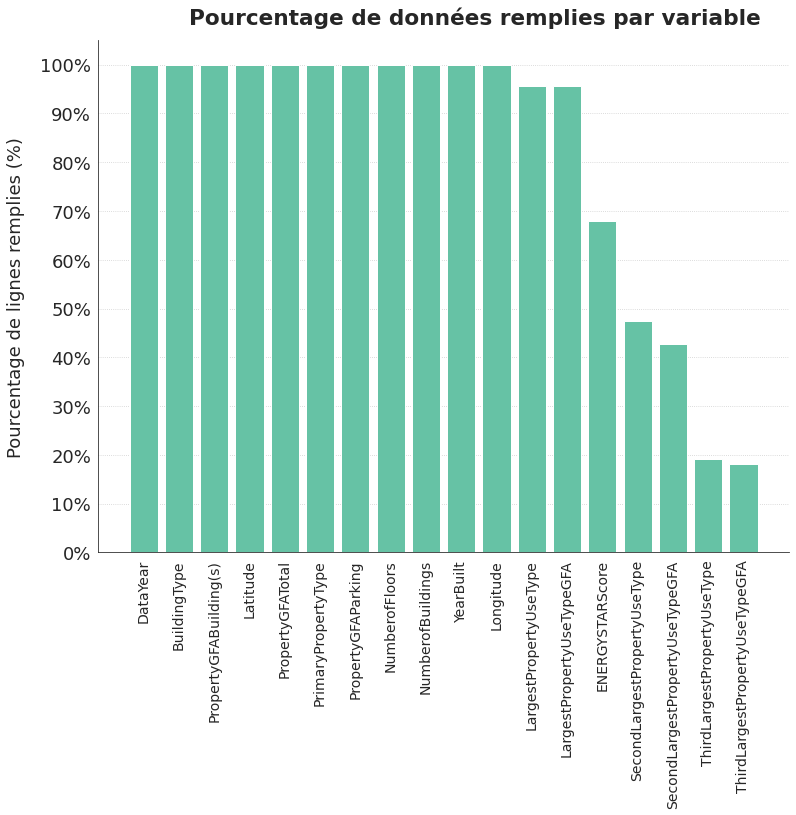

In [ ]:
percent_filled = pd.DataFrame(1.0 - (X_train_conso.isna().sum() / len(X_train_conso)), index=X_train_conso.columns, columns=["percent"])
percent_filled.sort_values(by="percent", ascending=False, inplace=True)

graph = sfg.MyGraph("Pourcentage de données remplies par variable")
graph.add_barv(percent_filled.index, percent_filled.percent)
graph.set_axe_x(rotation=90)
graph.set_axe_y(label="Pourcentage de lignes remplies (%)", tick_min=0, tick_max=1.0, tick_step=0.1, tick_labels_format=':.0%')
fig, ax = graph.fig, graph.ax
ax[0].tick_params(axis="x", labelsize=14)
plt.show()

<a id="3_2"></a>

### 3.2. Définition du pipeline de préparation des données

Je définis le pipeline de préparation des données, avec notamment 5 possibilités d'imputation et 5 possibilités d'encodage. Le pipeline fait appel à beaucoup d'objets personnalisés pour gérer les dataframes pandas et garder ainsi facilement la trace des noms des variables.

L'imputation commence par une opération spécifique pour les colonnes où les valeurs manquantes correspondent à une valeur nulle et non pas à une valeur manquante :
- si SecondLargestPropertyUseType ou ThirdLargestPropertyUseType est manquant, cela signifie qu'il n'y pas de deuxième et/ou troisième utilisation. J'impute le type par le string 'None' et les superficies des lignes correspondantes par 0.
- si Outlier est manquant, c'est que le bâtiment n'est pas un outlier. Je l'impute par le string 'Inlier'.

Les 5 possibilités d'imputation sont :
- simple imputer mean / simple imputer most frequent ;
- simple imputer median / simple imputer most frequent ;
- iterative imputer / simple imputer most frequent ;
- knn imputer ;
- Miss Forest imputer.

Les 5 possibilités d'encodage sont :
- hashing ;
- ordinal ;
- leaveoneout ;
- target personnalisé : la target utilisée n'est pas la consommation ou les émissions (notre cible d'estimation) mais le log du nombre d'étages de la propriété;
- one hot personnalisé : les 3 variables catégorielles LargestPropertyUseType, SecondLargestPropertyUseType et ThirdLargestPropertyUseType sont encodées sur les mêmes colonnes. Si l'activité est la principale, la colonne reçoit la valeur 3. Si c'est la deuxième activité, la colonne reçoit la valeur 2. Si c'est la troisième activité, la colonne reçoit la valeur 1. Les deux autres variables catégorielles sont encodées selon la méthode one hot traditionnelle.

Le pipeline de préparation des données comporte les étapes suivantes :
- imputation des valeurs manquantes ;
- encodage des variables catégorielles ;
- ajout de nouvelles variables calculées ;
- transformation des variables numériques ;
- standardisation des données.

In [ ]:
num_col = ["DataYear", "Latitude", "Longitude", "YearBuilt", "NumberofBuildings", "NumberofFloors",
           "PropertyGFATotal", "PropertyGFAParking", "PropertyGFABuilding(s)",
           "LargestPropertyUseTypeGFA", "SecondLargestPropertyUseTypeGFA",
           "ThirdLargestPropertyUseTypeGFA", "ENERGYSTARScore"]
categ_col = ["BuildingType", "PrimaryPropertyType", 
             "LargestPropertyUseType", "SecondLargestPropertyUseType", "ThirdLargestPropertyUseType"]
log_col = ["NumberofFloors","PropertyGFATotal","PropertyGFABuilding(s)","LargestPropertyUseTypeGFA"]
log1p_col = ["PropertyGFAParking","SecondLargestPropertyUseTypeGFA","ThirdLargestPropertyUseTypeGFA"]

In [ ]:
imputer_outlier = SimpleImputer(strategy='constant', fill_value='Inlier')
desc_train_conso["Outlier"] = imputer_outlier.fit_transform(desc_train_conso[["Outlier"]])
desc_train_emissions["Outlier"] = imputer_outlier.fit_transform(desc_train_emissions[["Outlier"]])

In [ ]:
imputer_mean = SimpleImputer(strategy='mean')
imputer_median = SimpleImputer(strategy='median')
imputer_iterative = IterativeImputer(sample_posterior=True, min_value=0,
                                     initial_strategy='mean', skip_complete=True, random_state=42)
imputer_mostfrequent = SimpleImputer(strategy='most_frequent')
imputer_knn = AllImputation(KNNImputer(), categ_cols=categ_col, missforest=False)
imputer_missforest = AllImputation(missingpy.MissForest(random_state=42), categ_cols=categ_col, missforest=True)

In [ ]:
encoder_hashing = ce.HashingEncoder(n_components=20, max_process=1)
encoder_ordinal = ce.OrdinalEncoder(handle_missing='value', handle_unknown='value')
encoder_target_conso = CustomTargetEncoder(X_train_conso["NumberofFloors"])
encoder_target_emissions = CustomTargetEncoder(X_train_emissions["NumberofFloors"])
encoder_leaveoneout = ce.LeaveOneOutEncoder(handle_missing='value', handle_unknown='value', sigma=0.5, random_state=42)
encoder_perso_onehot = CustomOneHotEncoder(ascending=False)

In [ ]:
transfo_col = ListCols(num_col, categ_col, log_col, log1p_col)

In [ ]:
data_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', PandasColumnTransformer(transfo_col, [
        ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ'),
        ('num_imputer', FitToPandas(imputer_median), 'num')
        ], n_jobs=-1)),
    ('data_encoders', FitToPandas(encoder_target_conso, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=True, keep_all=True)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler()))
])

<a id='3_3'></a>

### 3.3. Vérification de l'intérêt d'opérer une ACP

J'analyse quatre cas différents d'encodage.

In [ ]:
acp_pipe1 = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', PandasColumnTransformer(transfo_col, [
        ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ'),
        ('num_imputer', FitToPandas(imputer_median), 'num')
        ], n_jobs=-1)),
    ('data_encoders', FitToPandas(encoder_target_conso, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=True, keep_all=True)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler()))
])

In [ ]:
acp_pipe2 = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', PandasColumnTransformer(transfo_col, [
        ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ'),
        ('num_imputer', FitToPandas(imputer_median), 'num')
        ], n_jobs=-1)),
    ('data_encoders', FitToPandas(encoder_leaveoneout, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=True, keep_all=True)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler()))
])

In [ ]:
acp_pipe3 = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', PandasColumnTransformer(transfo_col, [
        ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ'),
        ('num_imputer', FitToPandas(imputer_median), 'num')
        ], n_jobs=-1)),
    ('data_encoders', FitToPandas(encoder_hashing, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=False, keep_all=False)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler(), transfo_col, 'transfo_num'))
])

In [ ]:
acp_pipe4 = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', PandasColumnTransformer(transfo_col, [
        ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ'),
        ('num_imputer', FitToPandas(imputer_median), 'num')
        ], n_jobs=-1)),
    ('data_encoders', FitToPandas(encoder_perso_onehot, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=False, keep_all=False)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler(), transfo_col, 'transfo_num'))
])

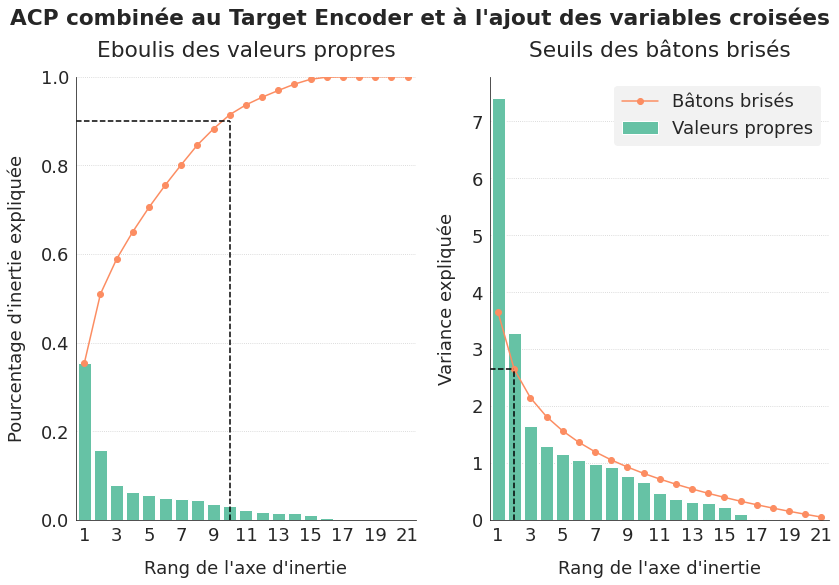

In [ ]:
acp1_data = acp_pipe1.fit_transform(X_train_conso, ln_y_train_conso)
acp1_data = acp1_data.astype(np.number)
acp1 = sfrd.ACP(acp1_data, with_reduction=False)
fig, ax = acp1.graphique_choix_n(seuil_inertie=0.90,
                                 title="ACP combinée au Target Encoder et à l'ajout des variables croisées")
save_fig("ml03_2_01_ACP1", tight_layout=False)
plt.show()

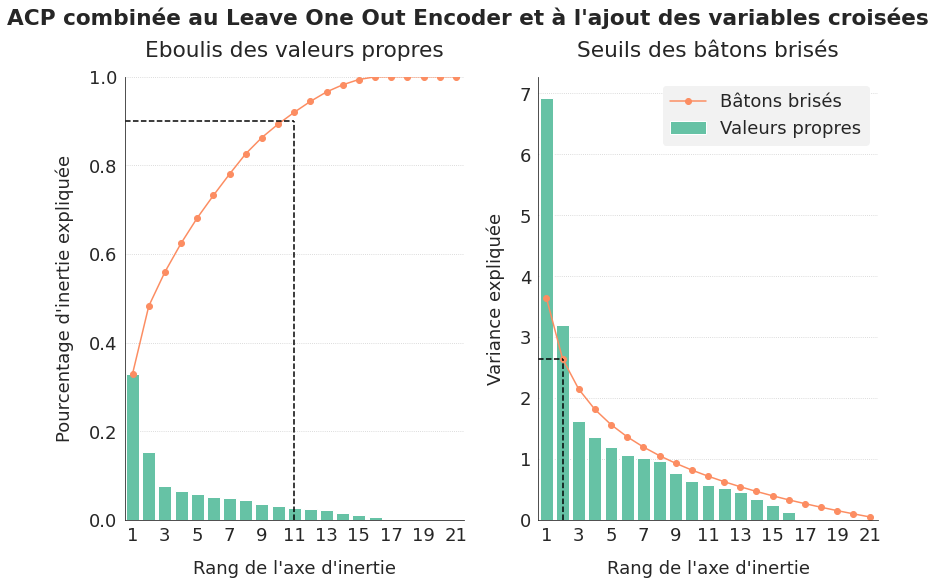

In [ ]:
acp2_data = acp_pipe2.fit_transform(X_train_conso, ln_y_train_conso)
acp2_data = acp2_data.astype(np.number)
acp2 = sfrd.ACP(acp2_data, with_reduction=False)
fig, ax = acp2.graphique_choix_n(seuil_inertie=0.90,
                                 title="ACP combinée au Leave One Out Encoder et à l'ajout des variables croisées")
save_fig("ml03_2_02_ACP2", tight_layout=False)
plt.show()

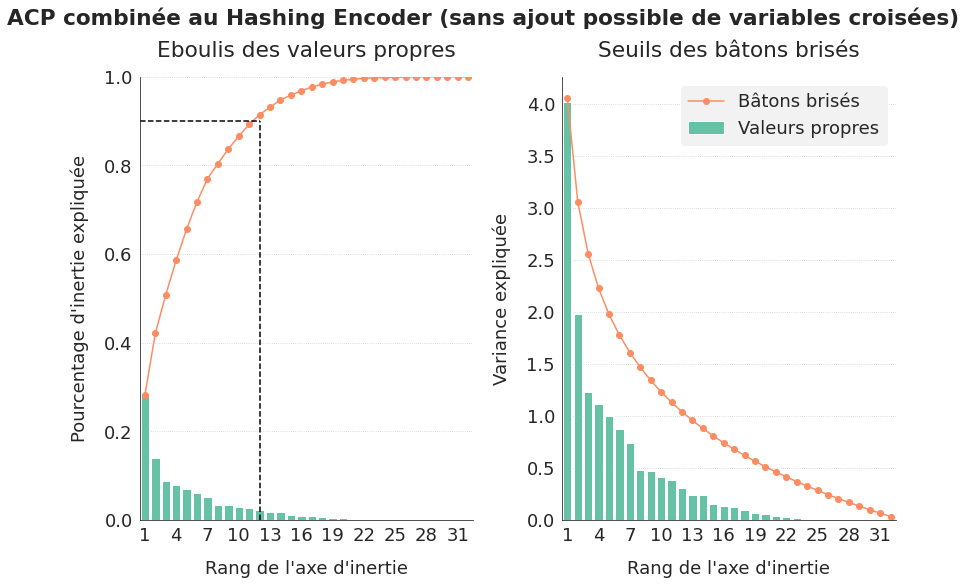

In [ ]:
acp3_data = acp_pipe3.fit_transform(X_train_conso, ln_y_train_conso)
acp3_data = acp3_data.astype(np.number)
acp3 = sfrd.ACP(acp3_data, with_reduction=False)
fig, ax = acp3.graphique_choix_n(seuil_inertie=0.90,
                                 title="ACP combinée au Hashing Encoder (sans ajout possible de variables croisées)")
save_fig("ml03_2_03_ACP3", tight_layout=False)
plt.show()

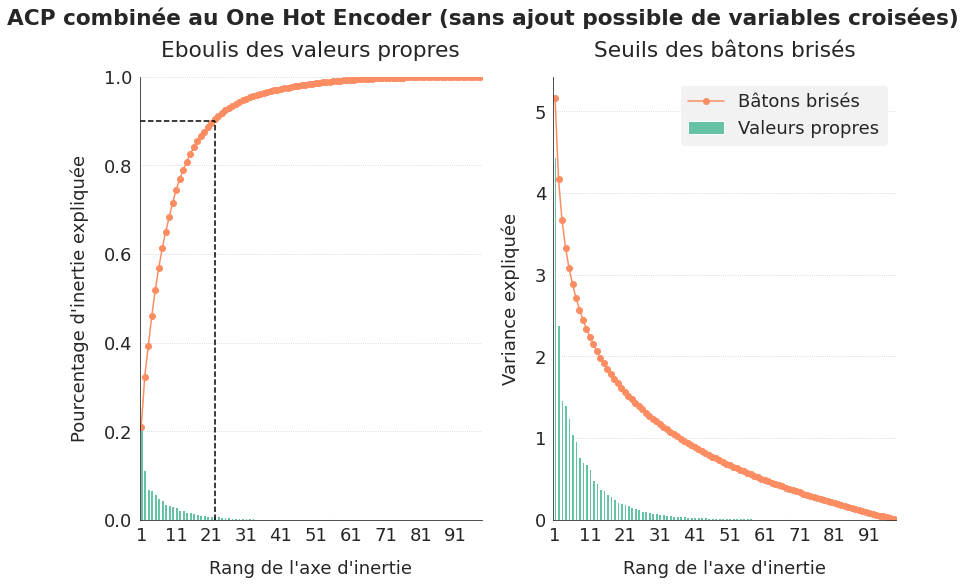

In [ ]:
acp4_data = acp_pipe4.fit_transform(X_train_conso, ln_y_train_conso)
acp4_data = acp4_data.astype(np.number)
acp4 = sfrd.ACP(acp4_data, with_reduction=False)
fig, ax = acp4.graphique_choix_n(seuil_inertie=0.90,
                                 title="ACP combinée au One Hot Encoder (sans ajout possible de variables croisées)")
save_fig("ml03_2_04_ACP4", tight_layout=False)
plt.show()

L'ACP est plus pertinente quand l'encodage ne crée pas de nouvelles variables (leaveoneout et target encoding). Son intérêt dépend en fait surtout des estimateurs. Pour les modèles linéaires non régularisés, il est préférable d'effectuer une ACP pour éviter tout problème de colinéarité.

<a id='3_4'></a>

### 3.4. Définition du pipeline de régression de base

Le pipeline de régression est simplement composé d'une ACP (facultative) et de l'estimateur. On lui appliquera les données transformées par le pipeline de transformation des données.

In [ ]:
reg_pipeline = Pipeline([('pca', PCA(n_components=4)),
    ('estimator', DummyRegressor(strategy='median'))
])

In [ ]:
reg_pipeline.get_params().keys()

dict_keys(['memory', 'steps', 'verbose', 'pca', 'estimator', 'pca__copy', 'pca__iterated_power', 'pca__n_components', 'pca__random_state', 'pca__svd_solver', 'pca__tol', 'pca__whiten', 'estimator__constant', 'estimator__quantile', 'estimator__strategy'])

In [ ]:
data_pipeline.get_params().keys()

dict_keys(['memory', 'steps', 'verbose', 'data_init_tranfo', 'data_propertyuse_imputer', 'data_imputers', 'data_encoders', 'data_transfo_categ', 'data_add_features', 'data_log_transfo', 'data_log1p_transfo', 'data_transfo_num', 'data_scalers', 'data_init_tranfo__categ_cols', 'data_init_tranfo__list_name', 'data_init_tranfo__log1p_cols', 'data_init_tranfo__log_cols', 'data_init_tranfo__num_cols', 'data_imputers__list_name', 'data_imputers__n_jobs', 'data_imputers__remainder', 'data_imputers__sparse_threshold', 'data_imputers__transformer_weights', 'data_imputers__transformers', 'data_imputers__verbose', 'data_encoders__list_name', 'data_encoders__restrict_cols', 'data_encoders__sk_object__encoder__cols', 'data_encoders__sk_object__encoder__drop_invariant', 'data_encoders__sk_object__encoder__handle_missing', 'data_encoders__sk_object__encoder__handle_unknown', 'data_encoders__sk_object__encoder__min_samples_leaf', 'data_encoders__sk_object__encoder__return_df', 'data_encoders__sk_object

<a id='4_0'></a>

## 4. Modèle pour estimer la consommation

### 4.1. Définition de la fonction objective et de la fonction d'appel pour HyperOpt

In [ ]:
N_FOLDS = 5
ITERATION = 0
OUT_FILE = None
DATA_ESTIMATED = 'conso'

In [ ]:
def objective(params, n_folds=N_FOLDS):
    global ITERATION, OUT_FILE, DATA_ESTIMATED
    ITERATION += 1
    
    params_data = {k:v for (k,v) in params.items() if k.startswith("data")}
    params_data['data_encoders__sk_object'] = params_data['data_case']['encoders']
    params_data['data_add_features__add_cross'] = params_data['data_case']['add_cross']
    params_data['data_add_features__keep_all'] = params_data['data_case']['keep_all']
    params_data['data_scalers__list_name'] = params_data['data_case']['list_name']
    params_data['data_scalers__restrict_cols'] = params_data['data_case']['restrict_cols']
    delcase = params_data.pop("data_case", None)
    data_pipeline.set_params(**params_data)
    
    params_reg = {k:v for (k,v) in params.items() if k.startswith("data")==False}
    reg_pipeline.set_params(**params_reg)
    
    if DATA_ESTIMATED == 'conso':
        trainX = X_train_conso.copy()
        trainy = ln_y_train_conso.copy()
    elif DATA_ESTIMATED == 'emissions':
        trainX = X_train_emissions.copy()
        trainy = ln_y_train_emissions.copy()
        
    start_time = timer()
    transformed_data = data_pipeline.fit_transform(trainX, trainy)
    transformed_data = transformed_data.astype(np.number)
    data_transfo_time = timer() - start_time
    
    myshuffle = KFold(n_splits=n_folds, shuffle=True, random_state=42)
    cv_results = cross_validate(reg_pipeline, transformed_data, trainy, cv=myshuffle, scoring='r2', return_train_score=True, n_jobs=-1)
    
    valid_score = cv_results['test_score']   #r2 between 0 and 1
    if np.any(np.isnan(valid_score)):
        valid_score = np.array([-1.0 for i in range(n_folds)])  # any error in score calculation gives a -1 score
    valid_score_mean = valid_score.mean()
    valid_score_std = valid_score.std()
    
    train_score = cv_results['train_score']   #r2 between 0 and 1
    if np.any(np.isnan(train_score)):
        train_score = np.array([-1.0 for i in range(n_folds)])  # any error in score calculation gives a -1 score
    train_score_mean = train_score.mean()
    train_score_std = train_score.std()

    valid_time = cv_results['score_time']
    if np.any(np.isnan(valid_time)):
        valid_time_mean = 1000
        #valid_time_std = 1000
    else:
        valid_time_mean = valid_time.mean()
        #valid_time_std = valid_time.std()
    
    train_time = cv_results['fit_time']
    if np.any(np.isnan(train_time)):
        train_time_mean = 1000
        #train_time_std = 1000
    else:
        train_time_mean = train_time.mean()
        #train_time_std = train_time.std()

    of_connection = open(OUT_FILE, 'a')  # Write to the csv file ('a' means append)
    writer = csv.writer(of_connection)
    writer.writerow([valid_score_mean, valid_score_std, valid_time_mean, train_score_mean, train_score_std, train_time_mean,
                     data_transfo_time, params_data['data_imputers'], params_data['data_encoders__sk_object'],
                     params_data['data_add_features__add_cross'], params_data['data_add_features__keep_all'],
                     params_data['data_scalers__restrict_cols'], params_reg, ITERATION])
    of_connection.close()
    
    loss = -valid_score_mean
    return {'loss': loss, 'valid_score_std': valid_score_std, 'valid_time_mean': valid_time_mean,
            'train_score_mean': train_score_mean, 'train_score_std': train_score_std, 'train_time_mean': train_time_mean,
            'params_data': params_data, 'params_reg': params_reg, 'data_transfo_time': data_transfo_time,
            'iteration': ITERATION, 'status': STATUS_OK}

In [ ]:
def run_optimization(estimator_name, estimator_object, n_folds=5, max_evals=100, reg_target='conso', prefix_name='first', keep_nresults=1):
    global OUT_FILE
    OUT_FILE = 'hyperopt_{}_{}_{}.csv'.format(prefix_name, reg_target, estimator_name)
    of_connection = open(OUT_FILE, 'w')  # Write the headers to the file
    writer = csv.writer(of_connection)
    writer.writerow(['valid_score_mean', 'valid_score_std', 'valid_time_mean',
                     'train_score_mean', 'train_score_std', 'train_time_mean', 'data_transfo_time',
                     'data_imputers', 'data_encoders', 'add_cross', 'keep_all', 'restrict_scaler', 'params_reg', 'iteration'])
    of_connection.close()
    
    global N_FOLDS, ITERATION, DATA_ESTIMATED
    N_FOLDS = n_folds
    ITERATION = 0
    DATA_ESTIMATED = reg_target
    
    trials = Trials()

    estim_space = space.copy()
    estim_space['estimator'] = estimator_object
    
    best_param = fmin(objective, estim_space, algo=tpe.suggest, trials=trials, max_evals=max_evals, rstate=np.random.RandomState(42))
    
    list_losses = [t['result']['loss'] for t in trials.trials]
    idx_min = np.argmin(list_losses)
    if keep_nresults <= 1:
        list_best_results.append(trials.trials[idx_min]['result'])
    else:
        list_idx = np.argsort(list_losses)[:keep_nresults]
        for idx in list_idx:
            list_best_results.append(trials.trials[idx]['result'])
    
    print("Estimateur : {} - Done".format(estimator_name))
    print("Best cross-validation mean score = {}".format(-trials.trials[idx_min]['result']['loss']))
    print("Associated standard deviation = {}".format(trials.trials[idx_min]['result']['valid_score_std']))
    print("Calculation time = {}".format(trials.trials[idx_min]['result']['valid_time_mean']))
    print("Data preparation time = {}".format(trials.trials[idx_min]['result']['data_transfo_time']))
    print("Best cv score obtained after {} iterations".format(trials.trials[idx_min]['result']['iteration']))
    print("")

<a id='4_2'></a>

### 4.2. Première optimisation : étude des possibilités de préparation de données et d'une sélection d'estimateurs

Je fais une première optimisation, restreinte en terme de nombre d'évaluations (50 pour chaque estimateur), afin d'avoir une première approche sur les imputations et encodages (et autres étapes de préparation de données) et sur les 10 régresseurs pré-sélectionnés (Dummy régresseur pour la baseline, régression linéaire, Ridge, Lasso, SVM, kNN, Random Forest, Extra Trees, Ada Boost et XGBoost).  
L'objectif est de ne conserver que les meilleurs pour une recherche plus approfondie.

In [ ]:
space = {
    'data_imputers': hp.choice('data_imputers', [imputer_missforest, imputer_knn,
        PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_mean), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1),
        PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_median), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1),
        PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_iterative), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1)]),
    'data_case': hp.choice('data_case', [
        {'encoders': hp.choice('encoders1', [encoder_target_conso, encoder_leaveoneout]),
         'add_cross': hp.choice('add_cross1', [True,False]),
         'keep_all': hp.choice('keep_all1', [True,False]),
         'list_name': None,
         'restrict_cols': None},
        {'encoders': hp.choice('encoders2', [encoder_hashing, encoder_perso_onehot, encoder_ordinal]),
         'add_cross': False,
         'keep_all': False,
         'list_name': transfo_col,
         'restrict_cols': 'transfo_num'}]),
    'pca': hp.choice('pca', [None, PCA(n_components=0.90), PCA(n_components=0.99)])}

In [ ]:
list_best_results = []

In [ ]:
scope.define(DummyRegressor)
estimator_name = 'dummy_reg'
estimator_object = scope.DummyRegressor(strategy='median')
run_optimization(estimator_name, estimator_object, max_evals=1)

100%|██████████| 1/1 [00:00<00:00,  3.34it/s, best loss: 0.016215320250750363]
Estimateur : dummy_reg - Done
Best cross-validation mean score = -0.016215320250750363
Associated standard deviation = 0.022898270582446048
Calculation time = 0.0018470287322998047
Data preparation time = 0.222184091000031
Best cv score obtained after 1 iterations



In [ ]:
scope.define(LinearRegression)
estimator_name = 'linear_reg'
estimator_object = scope.LinearRegression()
run_optimization(estimator_name, estimator_object, max_evals=50)

Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6

In [ ]:
scope.define(Ridge)
estimator_name = 'ridge_reg'
estimator_object = scope.Ridge(random_state=42)
run_optimization(estimator_name, estimator_object, max_evals=50)

Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6

In [ ]:
scope.define(Lasso)
estimator_name = 'lasso_reg'
estimator_object = scope.Lasso(random_state=42)
run_optimization(estimator_name, estimator_object, max_evals=50)

Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
100%|██████████| 50/50 [03:01<00:00,  3.63s/it, best loss: -0.485156729792279]
Estimateur : lasso_reg - Done
Best cross-validation mean score = 0.485156729792279
Associated standard deviation = 0.020383665397829417
Calculation time = 0.001809978485107422
Data preparation time = 0.35718626899983974
Best cv score obtained after 3 iterations



In [ ]:
scope.define(KNeighborsRegressor)
estimator_name = 'knn_reg'
estimator_object = scope.KNeighborsRegressor(n_jobs=-1)
run_optimization(estimator_name, estimator_object, max_evals=50)

Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6

In [ ]:
scope.define(SVR)
estimator_name = 'svm_reg'
estimator_object = scope.SVR()
run_optimization(estimator_name, estimator_object, max_evals=50)

Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6

In [ ]:
scope.define(RandomForestRegressor)
estimator_name = 'randomforest_reg'
estimator_object = scope.RandomForestRegressor(n_jobs=-1, random_state=42)
run_optimization(estimator_name, estimator_object, max_evals=50)

Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6

In [ ]:
scope.define(ExtraTreesRegressor)
estimator_name = 'extratrees_reg'
estimator_object = scope.ExtraTreesRegressor(n_jobs=-1, random_state=42)
run_optimization(estimator_name, estimator_object, max_evals=50)

Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6

In [ ]:
scope.define(AdaBoostRegressor)
estimator_name = 'adaboost_reg'
estimator_object = scope.AdaBoostRegressor(random_state=42)
run_optimization(estimator_name, estimator_object, max_evals=50)

Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
100%|██████████| 50/50 [03:42<00:00,  4.45s/it, best loss: -0.655483910050121]
Estimateur : adaboost_reg - Done
Best cross-validation mean score = 0.655483910050121
Associated standard deviation = 0.028667658545058327
Calculation time = 0.00943741798400879
Data preparation time = 0.21975879699948564
Best cv score obtained after 5 iterations



In [ ]:
scope.define(XGBRegressor)
estimator_name = 'xgboost_reg'
estimator_object = scope.XGBRegressor(objective='reg:squarederror', n_jobs=-1, random_state=42)
run_optimization(estimator_name, estimator_object, max_evals=50)

Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6

**Résumé des résultats**

In [ ]:
first_conso_best_results = pd.DataFrame(list_best_results)

In [ ]:
def get_details(df):
    inter = ["{}".format(param["estimator"]) for param in df["params_reg"]]
    df["estimator"] = [param[:param.find('(')] for param in inter]
    inter = ["{}".format(param["pca"]) for param in df["params_reg"]]
    df["pca"] = [param[:param.find('(')] for param in inter]
    inter = ["{}".format(param["data_imputers"]) for param in df["params_data"]]
    inter1 = [param[param.find('sk_object')+10:] for param in inter]
    df["imputer"] = [param[:param.find('(')] for param in inter1]
    inter1 = [param[param.find('strategy')+9:] for param in inter]
    inter2 = [param[:param.find(',')] for param in inter1]
    df["strategy"] = [param if (param.startswith("'mean'") | param.startswith("'median'")) else "" for param in inter2]
    inter = ["{}".format(param["data_encoders__sk_object"]) for param in df["params_data"]]
    df["encoder"] = [param[:param.find('(')] for param in inter]
    df["add_cross"] = [param["data_add_features__add_cross"] for param in df["params_data"]]
    df["keep_all"] = [param["data_add_features__keep_all"] for param in df["params_data"]]
    return df

In [ ]:
first_conso_best_results = get_details(first_conso_best_results)
first_conso_best_results.sort_values("loss", inplace=True)
first_conso_best_results

,loss,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,params_data,params_reg,data_transfo_time,iteration,status,estimator,pca,imputer,strategy,encoder,add_cross,keep_all
5,-0.757956,0.012551,0.060494,0.854245,2.071880e-03,0.322293,{'data_imputers': AllImputation(categ_cols=['B...,"{'estimator': SVR(C=1.0, cache_size=200, coef0...",26.045886,10,ok,SVR,Non,MissForest,,CustomOneHotEncoder,False,False
7,-0.753186,0.027368,0.103303,1.000000,1.503292e-12,0.700008,{'data_imputers': AllImputation(categ_cols=['B...,{'estimator': ExtraTreesRegressor(bootstrap=Fa...,25.603485,18,ok,ExtraTreesRegressor,Non,MissForest,,LeaveOneOutEncoder,False,True
9,-0.750036,0.035079,0.003353,0.852400,4.059915e-03,0.170405,{'data_imputers': AllImputation(categ_cols=['B...,"{'estimator': XGBRegressor(base_score=0.5, boo...",0.348291,32,ok,XGBRegressor,Non,KNNImputer,,LeaveOneOutEncoder,False,True
2,-0.749101,0.017156,0.002474,0.783640,5.226262e-03,0.024504,{'data_imputers': AllImputation(categ_cols=['B...,"{'estimator': Ridge(alpha=1.0, copy_X=True, fi...",25.851426,21,ok,Ridge,PCA,MissForest,,CustomOneHotEncoder,False,False
1,-0.748748,0.017010,0.002455,0.783654,5.225763e-03,0.028140,{'data_imputers': AllImputation(categ_cols=['B...,"{'estimator': LinearRegression(copy_X=True, fi...",25.929695,21,ok,LinearRegression,PCA,MissForest,,CustomOneHotEncoder,False,False
6,-0.746920,0.033033,0.103378,0.964874,1.635236e-03,1.324865,{'data_imputers': AllImputation(categ_cols=['B...,{'estimator': RandomForestRegressor(bootstrap=...,25.496342,18,ok,RandomForestRegressor,Non,MissForest,,LeaveOneOutEncoder,False,True
4,-0.668686,0.026067,0.103988,0.785668,4.909245e-03,0.006626,{'data_imputers': PandasColumnTransformer(list...,{'estimator': KNeighborsRegressor(algorithm='a...,0.609646,49,ok,KNeighborsRegressor,Non,IterativeImputer,'mean',LeaveOneOutEncoder,True,True
8,-0.655484,0.028668,0.009437,0.722638,9.240338e-03,0.250922,{'data_imputers': PandasColumnTransformer(list...,{'estimator': AdaBoostRegressor(base_estimator...,0.219759,5,ok,AdaBoostRegressor,PCA,SimpleImputer,'median',LeaveOneOutEncoder,False,True
3,-0.485157,0.020384,0.001810,0.488952,1.062982e-02,0.006367,{'data_imputers': AllImputation(categ_cols=['B...,"{'estimator': Lasso(alpha=1.0, copy_X=True, fi...",0.357186,3,ok,Lasso,PCA,KNNImputer,,LeaveOneOutEncoder,True,True
0,0.016215,0.022898,0.001847,-0.010847,1.878427e-03,0.006280,{'data_imputers': PandasColumnTransformer(list...,"{'estimator': DummyRegressor(constant=None, qu...",0.222184,1,ok,DummyRegressor,PCA,SimpleImputer,'mean',CustomTargetEncoder,False,True


In [ ]:
first_conso_best_results[["estimator","loss","train_score_mean","imputer","strategy","encoder","pca","add_cross","keep_all"]]

,estimator,loss,train_score_mean,imputer,strategy,encoder,pca,add_cross,keep_all
5,SVR,-0.757956,0.854245,MissForest,,CustomOneHotEncoder,Non,False,False
7,ExtraTreesRegressor,-0.753186,1.000000,MissForest,,LeaveOneOutEncoder,Non,False,True
9,XGBRegressor,-0.750036,0.852400,KNNImputer,,LeaveOneOutEncoder,Non,False,True
2,Ridge,-0.749101,0.783640,MissForest,,CustomOneHotEncoder,PCA,False,False
1,LinearRegression,-0.748748,0.783654,MissForest,,CustomOneHotEncoder,PCA,False,False
6,RandomForestRegressor,-0.746920,0.964874,MissForest,,LeaveOneOutEncoder,Non,False,True
4,KNeighborsRegressor,-0.668686,0.785668,IterativeImputer,'mean',LeaveOneOutEncoder,Non,True,True
8,AdaBoostRegressor,-0.655484,0.722638,SimpleImputer,'median',LeaveOneOutEncoder,PCA,False,True
3,Lasso,-0.485157,0.488952,KNNImputer,,LeaveOneOutEncoder,PCA,True,True
0,DummyRegressor,0.016215,-0.010847,SimpleImputer,'mean',CustomTargetEncoder,PCA,False,True


Les modèles les plus performants présentent un overfitting marqué. Les modèles Ridge et de régression linéaire obtiennent un R² légèrement inférieur mais plus stable entre le jeu d'entraînement et le jeu de test.  
L'imputation la plus fréquente est MissForest. Les deux encodeurs les plus performants sont le Custom One Hot et le Leave One Out.  
Regardons plus en détail les résultats par modèle.

<a id='4_3'></a>

### 4.3. Etude des résultats de la première optimisation, modèle par modèle

**SVM**

In [ ]:
svm_analyse = gen_df_analyse('hyperopt_first_conso_svm_reg.csv')
svm_analyse[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
9,0.757956,0.854245,MissForest,,CustomOneHot,False,None
20,0.757956,0.854245,MissForest,,CustomOneHot,False,None
21,0.757956,0.854245,MissForest,,CustomOneHot,False,None
22,0.757956,0.854245,MissForest,,CustomOneHot,False,None
23,0.757956,0.854245,MissForest,,CustomOneHot,False,None


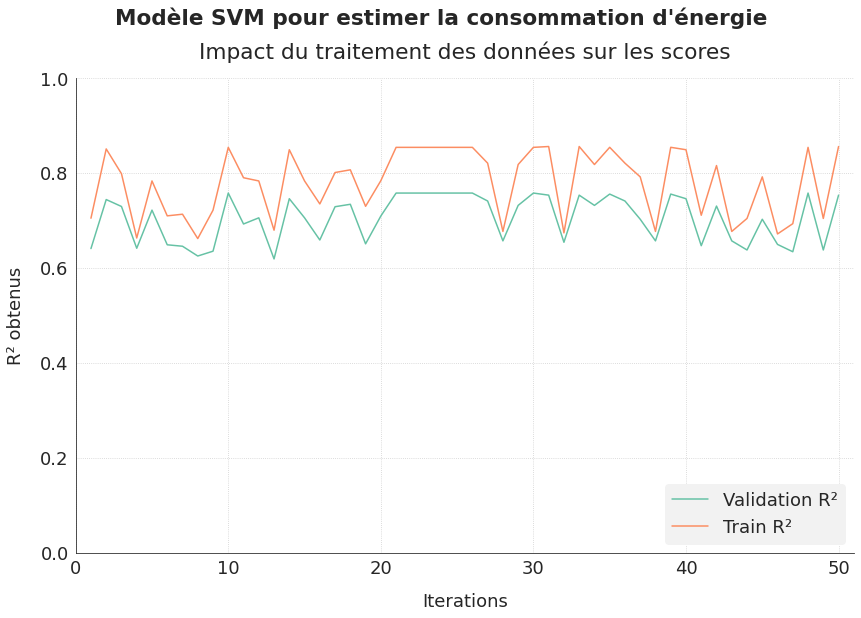

In [ ]:
fig, ax = graph_analyse_score(svm_analyse, "SVM", "la consommation d'énergie")
plt.show()

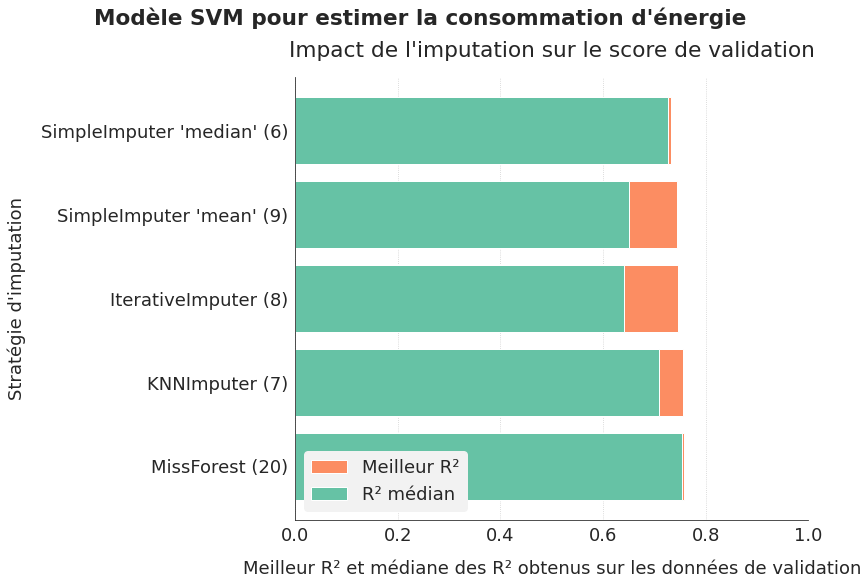

In [ ]:
fig, ax = graph_analyse_imputers(svm_analyse, "SVM", "la consommation d'énergie")
save_fig("ml03_2_05_conso11")
plt.show()

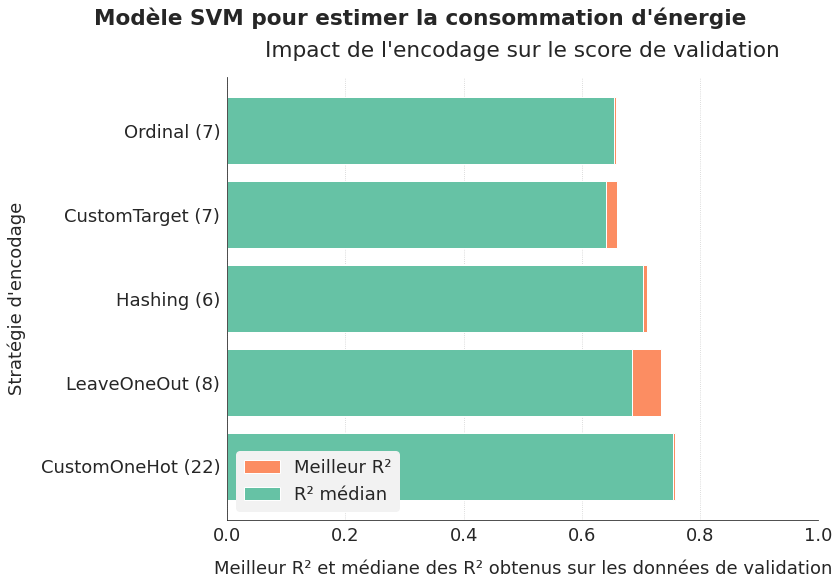

In [ ]:
fig, ax = graph_analyse_encoders(svm_analyse, "SVM", "la consommation d'énergie")
save_fig("ml03_2_05_conso12")
plt.show()

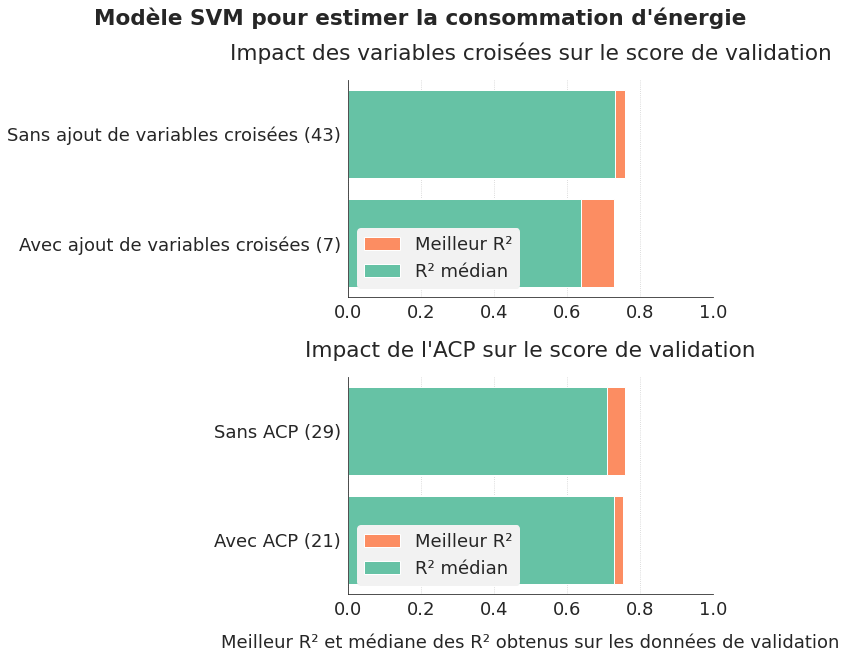

In [ ]:
fig, ax = graph_analyse_others(svm_analyse, "SVM", "la consommation d'énergie")
save_fig("ml03_2_05_conso13")
plt.show()

L'imputation MissForest semble aboutir aux meilleures performances. L'encodage et l'ACP peuvent jouer sur la stabilité des scores lors de la généralisation.

**Extra trees**

In [ ]:
ext_analyse = gen_df_analyse('hyperopt_first_conso_extratrees_reg.csv')
ext_analyse[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
17,0.753186,1.0,MissForest,,LeaveOneOut,False,None
23,0.753186,1.0,MissForest,,LeaveOneOut,False,None
24,0.753186,1.0,MissForest,,LeaveOneOut,False,None
25,0.753186,1.0,MissForest,,LeaveOneOut,False,None
27,0.753186,1.0,MissForest,,LeaveOneOut,False,None


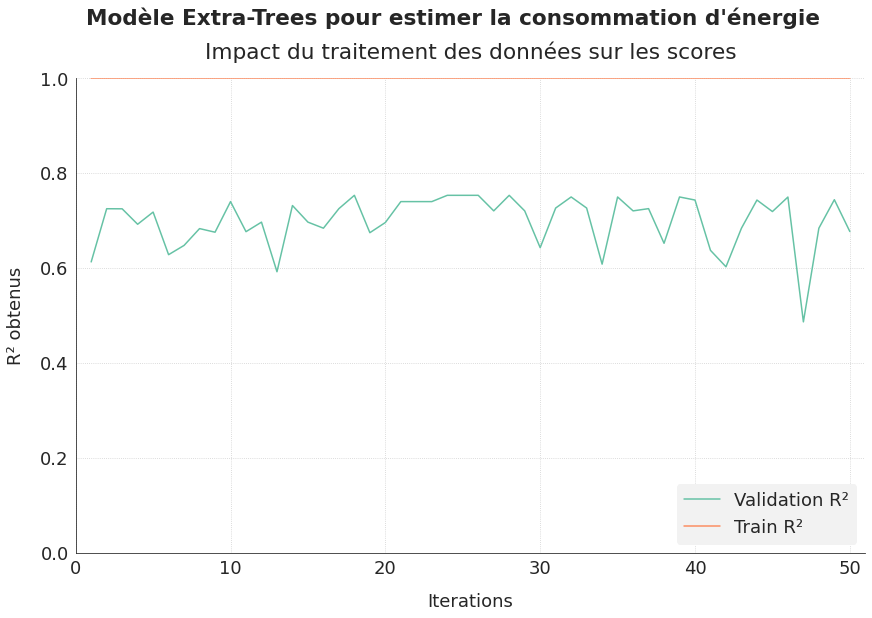

In [ ]:
fig, ax = graph_analyse_score(ext_analyse, "Extra-Trees", "la consommation d'énergie")
plt.show()

Le modèle extra-trees souffre d'un fort problème de sur-optimisation. A voir si l'optimisation des hyperparamètres permet de réduire ce problème.

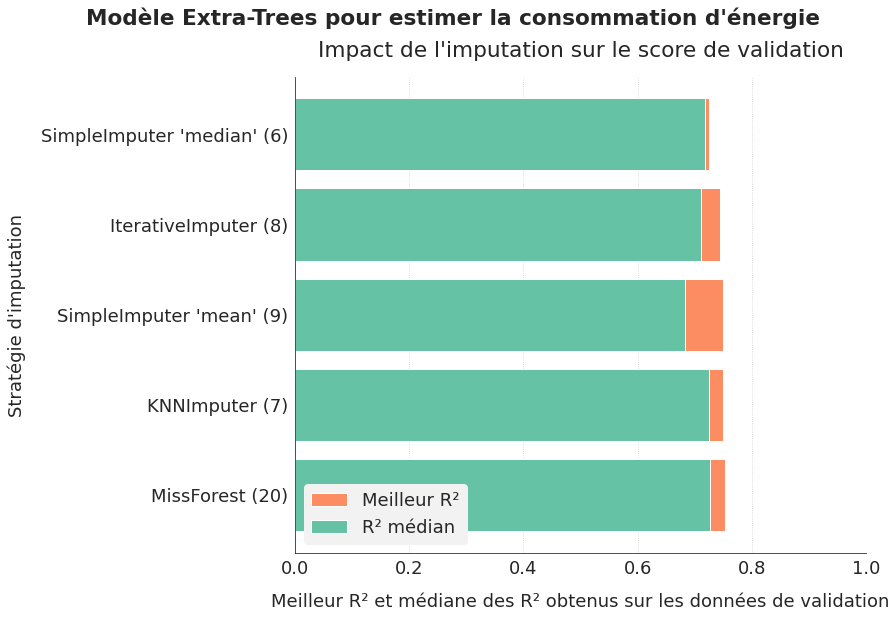

In [ ]:
fig, ax = graph_analyse_imputers(ext_analyse, "Extra-Trees", "la consommation d'énergie")
plt.show()

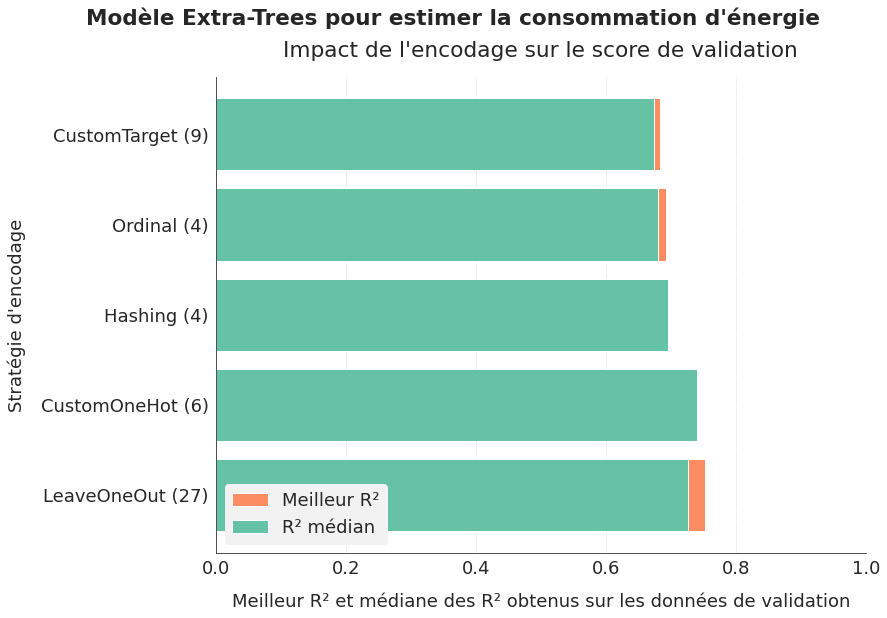

In [ ]:
fig, ax = graph_analyse_encoders(ext_analyse, "Extra-Trees", "la consommation d'énergie")
plt.show()

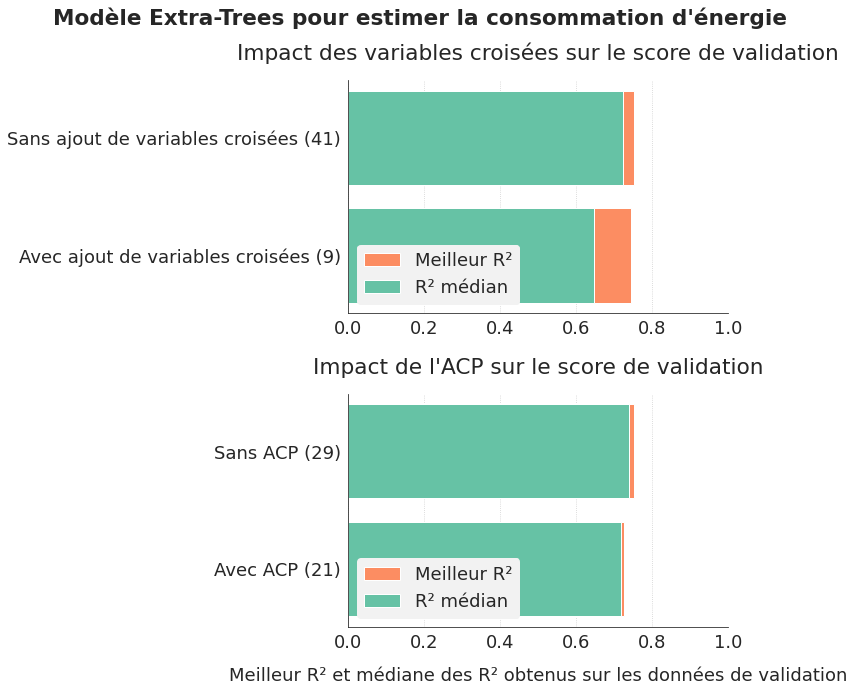

In [ ]:
fig, ax = graph_analyse_others(ext_analyse, "Extra-Trees", "la consommation d'énergie")
plt.show()

**XGBoost**

In [ ]:
xgb_analyse = gen_df_analyse('hyperopt_first_conso_xgboost_reg.csv')
xgb_analyse[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
31,0.750036,0.8524,KNNImputer,,LeaveOneOut,False,None
34,0.750036,0.8524,KNNImputer,,LeaveOneOut,False,None
38,0.750036,0.8524,KNNImputer,,LeaveOneOut,False,None
39,0.750036,0.8524,KNNImputer,,LeaveOneOut,False,None
43,0.750036,0.8524,KNNImputer,,LeaveOneOut,False,None


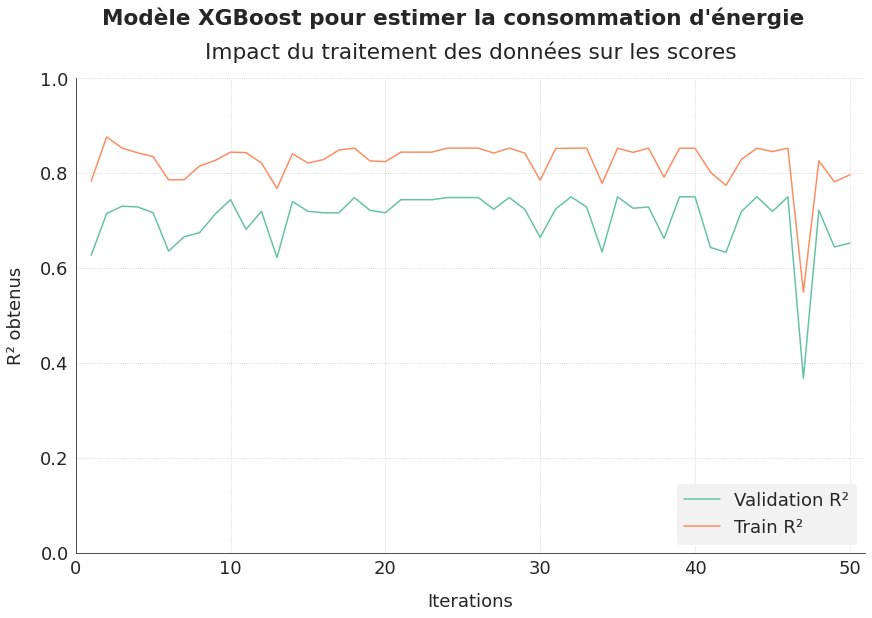

In [ ]:
fig, ax = graph_analyse_score(xgb_analyse, "XGBoost", "la consommation d'énergie")
plt.show()

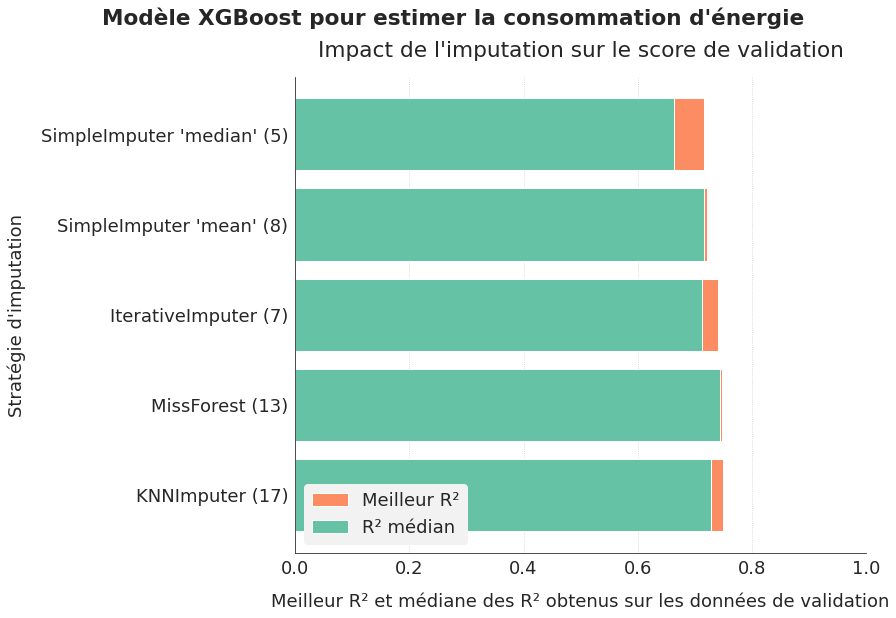

In [ ]:
fig, ax = graph_analyse_imputers(xgb_analyse, "XGBoost", "la consommation d'énergie")
plt.show()

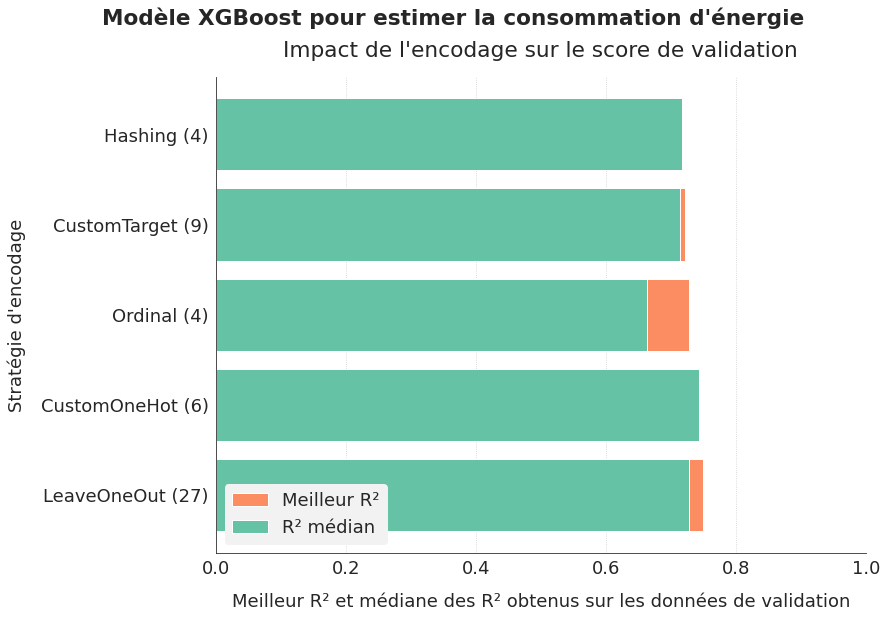

In [ ]:
fig, ax = graph_analyse_encoders(xgb_analyse, "XGBoost", "la consommation d'énergie")
plt.show()

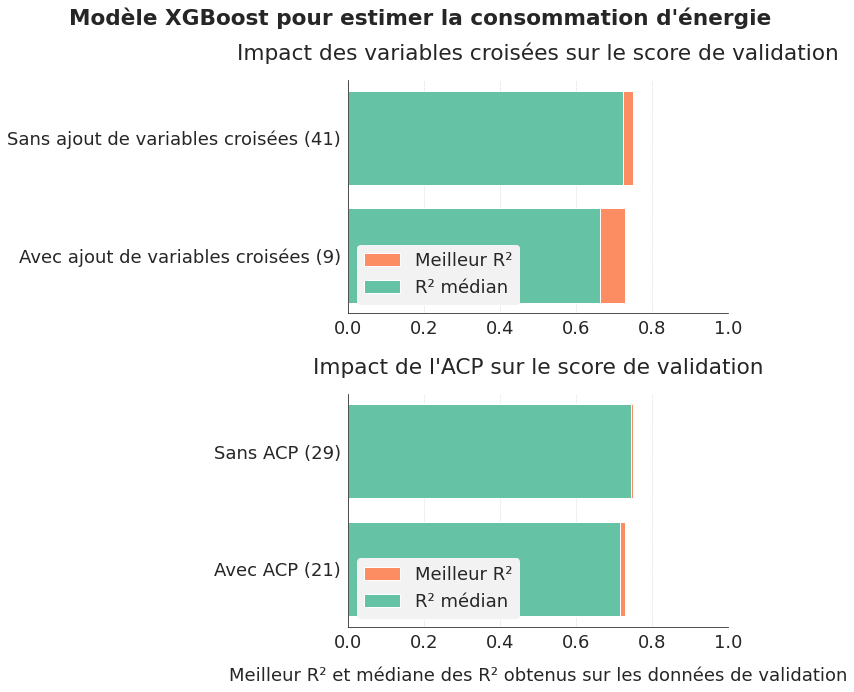

In [ ]:
fig, ax = graph_analyse_others(xgb_analyse, "XGBoost", "la consommation d'énergie")
plt.show()

**Ridge**

In [ ]:
ridge_analyse = gen_df_analyse('hyperopt_first_conso_ridge_reg.csv')
ridge_analyse[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
20,0.749101,0.78364,MissForest,,CustomOneHot,False,"PCA(copy=True, iterated_power='auto', n_compon..."
21,0.749101,0.78364,MissForest,,CustomOneHot,False,"PCA(copy=True, iterated_power='auto', n_compon..."
22,0.749101,0.78364,MissForest,,CustomOneHot,False,"PCA(copy=True, iterated_power='auto', n_compon..."
23,0.749101,0.78364,MissForest,,CustomOneHot,False,"PCA(copy=True, iterated_power='auto', n_compon..."
24,0.749101,0.78364,MissForest,,CustomOneHot,False,"PCA(copy=True, iterated_power='auto', n_compon..."


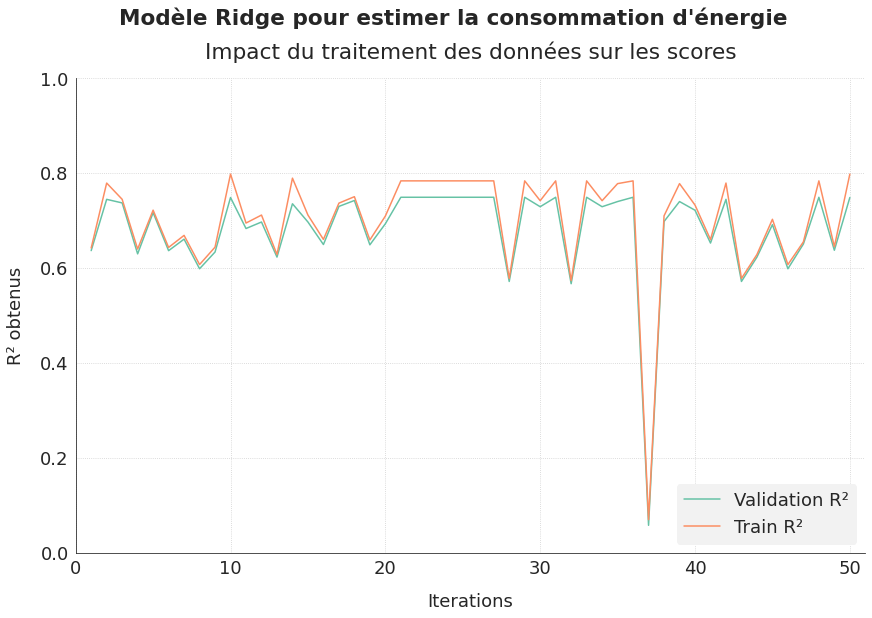

In [ ]:
fig, ax = graph_analyse_score(ridge_analyse, "Ridge", "la consommation d'énergie")
plt.show()

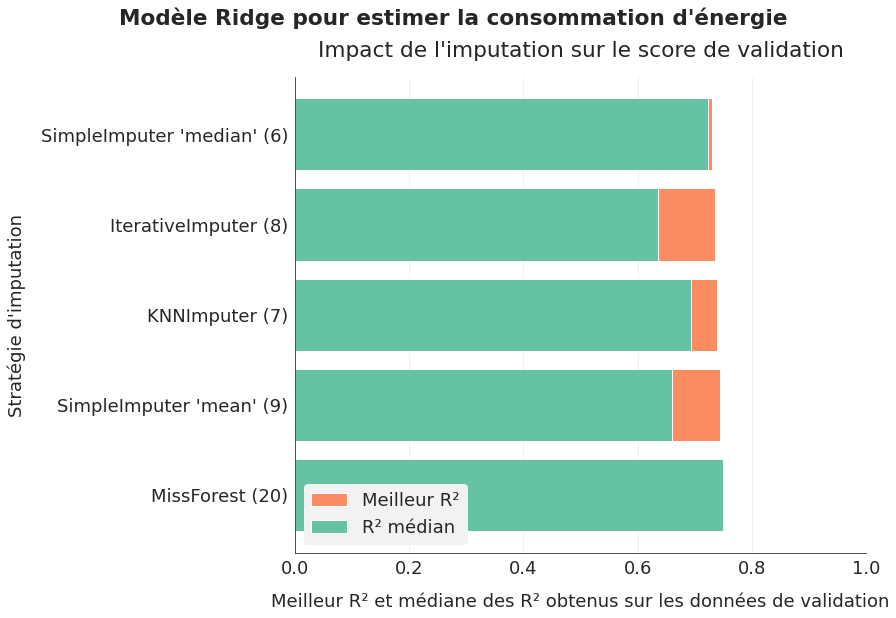

In [ ]:
fig, ax = graph_analyse_imputers(ridge_analyse, "Ridge", "la consommation d'énergie")
plt.show()

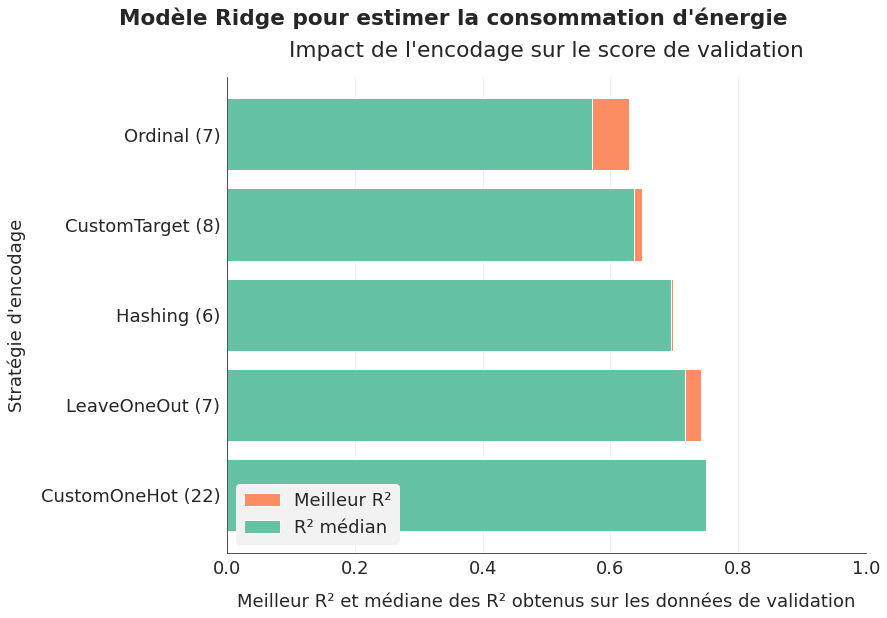

In [ ]:
fig, ax = graph_analyse_encoders(ridge_analyse, "Ridge", "la consommation d'énergie")
plt.show()

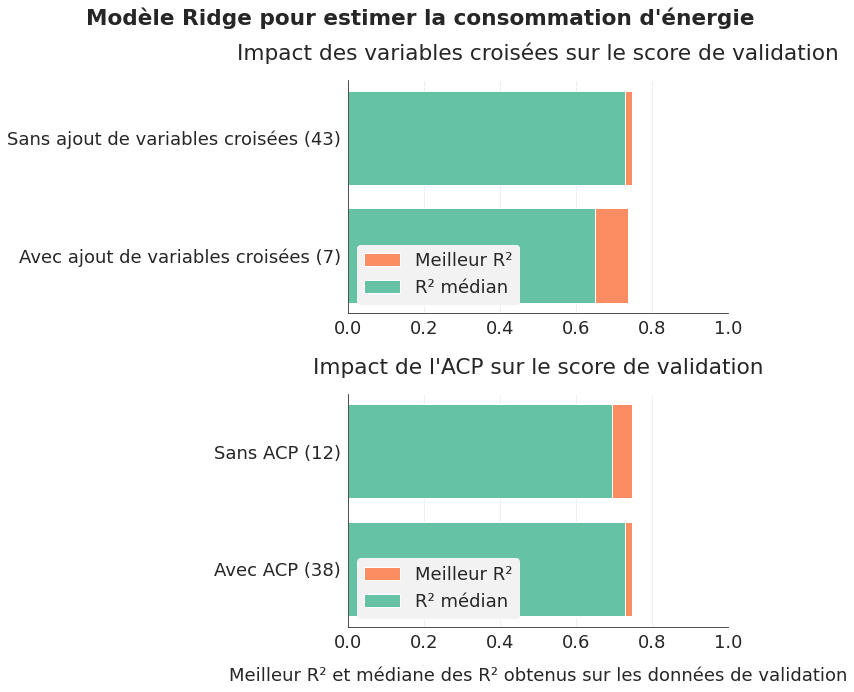

In [ ]:
fig, ax = graph_analyse_others(ridge_analyse, "Ridge", "la consommation d'énergie")
plt.show()

**Random Forest**

In [ ]:
rf_analyse = gen_df_analyse('hyperopt_first_conso_randomforest_reg.csv')
rf_analyse[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
17,0.74692,0.964874,MissForest,,LeaveOneOut,False,None
23,0.74692,0.964874,MissForest,,LeaveOneOut,False,None
24,0.74692,0.964874,MissForest,,LeaveOneOut,False,None
25,0.74692,0.964874,MissForest,,LeaveOneOut,False,None
27,0.74692,0.964874,MissForest,,LeaveOneOut,False,None


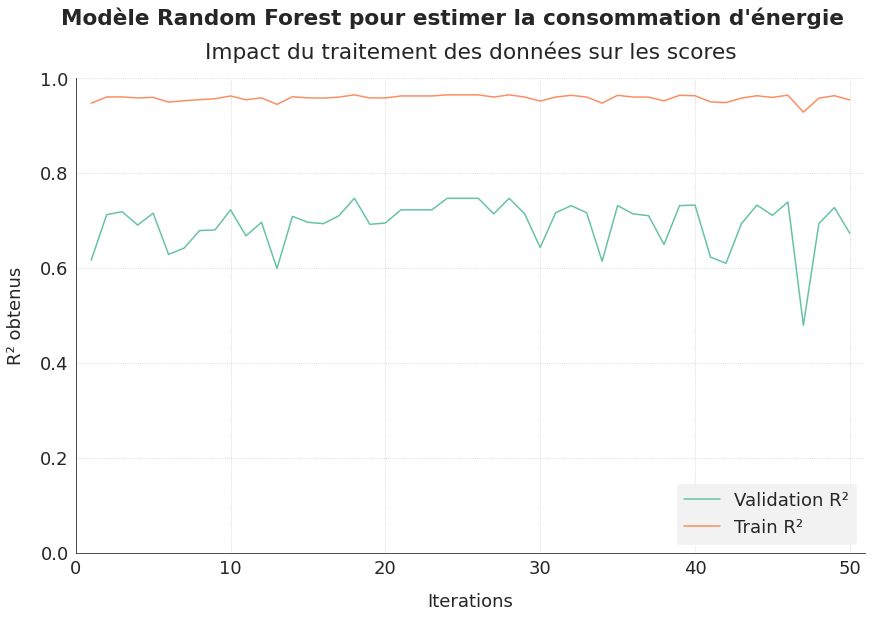

In [ ]:
fig, ax = graph_analyse_score(rf_analyse, "Random Forest", "la consommation d'énergie")
plt.show()

Le modèle Random Forest souffre d'un fort problème de sur-optimisation. A voir si l'optimisation des hyperparamètres permet de réduire ce problème.

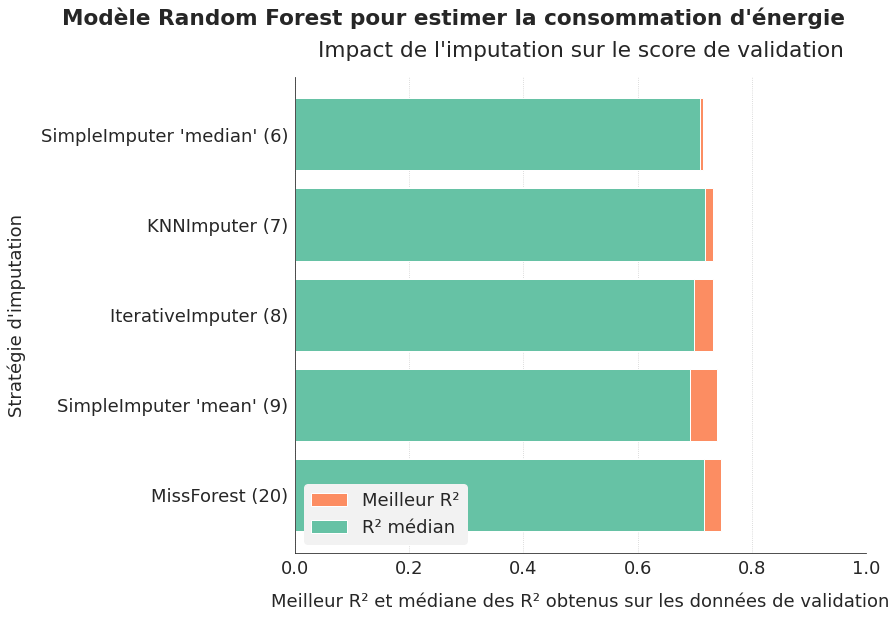

In [ ]:
fig, ax = graph_analyse_imputers(rf_analyse, "Random Forest", "la consommation d'énergie")
plt.show()

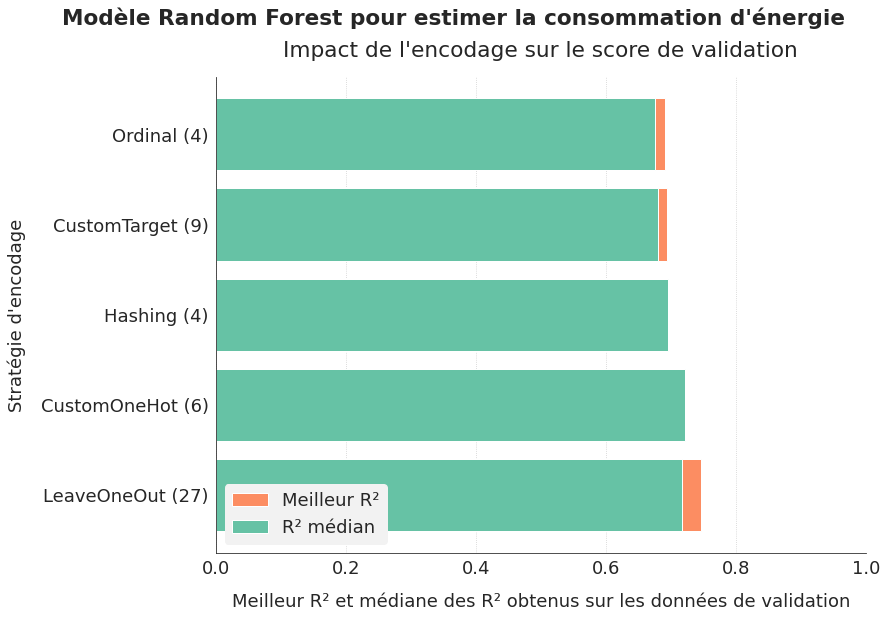

In [ ]:
fig, ax = graph_analyse_encoders(rf_analyse, "Random Forest", "la consommation d'énergie")
plt.show()

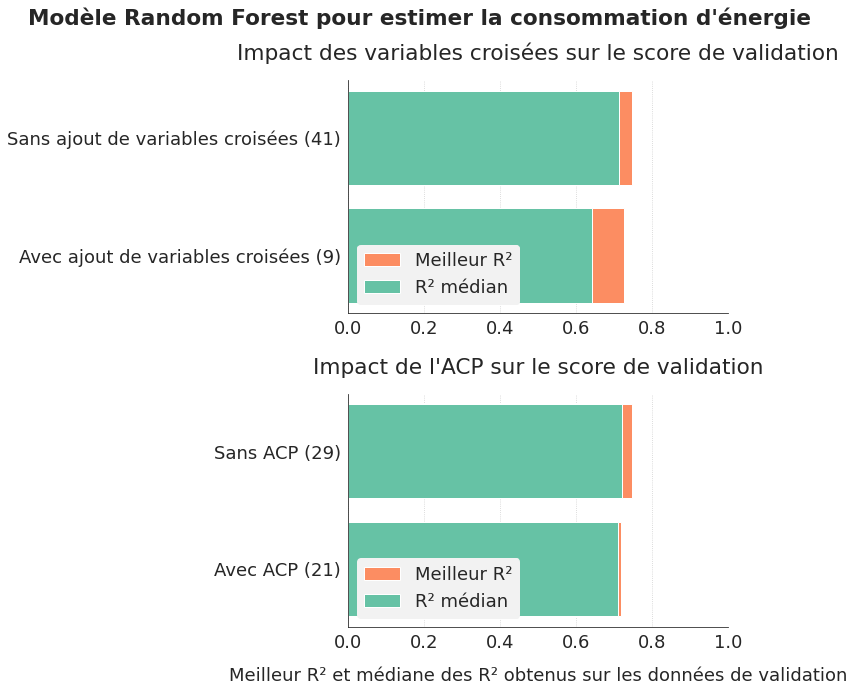

In [ ]:
fig, ax = graph_analyse_others(rf_analyse, "Random Forest", "la consommation d'énergie")
plt.show()

**Linear Regression**

In [ ]:
lr_analyse = gen_df_analyse('hyperopt_first_conso_linear_reg.csv')
lr_analyse[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
20,0.748748,0.783654,MissForest,,CustomOneHot,False,"PCA(copy=True, iterated_power='auto', n_compon..."
21,0.748748,0.783654,MissForest,,CustomOneHot,False,"PCA(copy=True, iterated_power='auto', n_compon..."
22,0.748748,0.783654,MissForest,,CustomOneHot,False,"PCA(copy=True, iterated_power='auto', n_compon..."
23,0.748748,0.783654,MissForest,,CustomOneHot,False,"PCA(copy=True, iterated_power='auto', n_compon..."
24,0.748748,0.783654,MissForest,,CustomOneHot,False,"PCA(copy=True, iterated_power='auto', n_compon..."


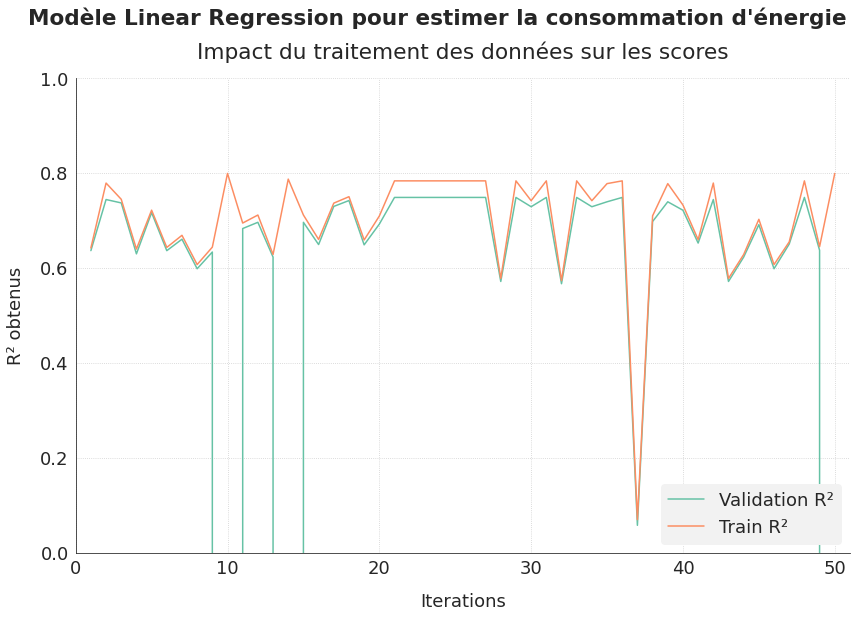

In [ ]:
fig, ax = graph_analyse_score(lr_analyse, "Linear Regression", "la consommation d'énergie")
plt.show()

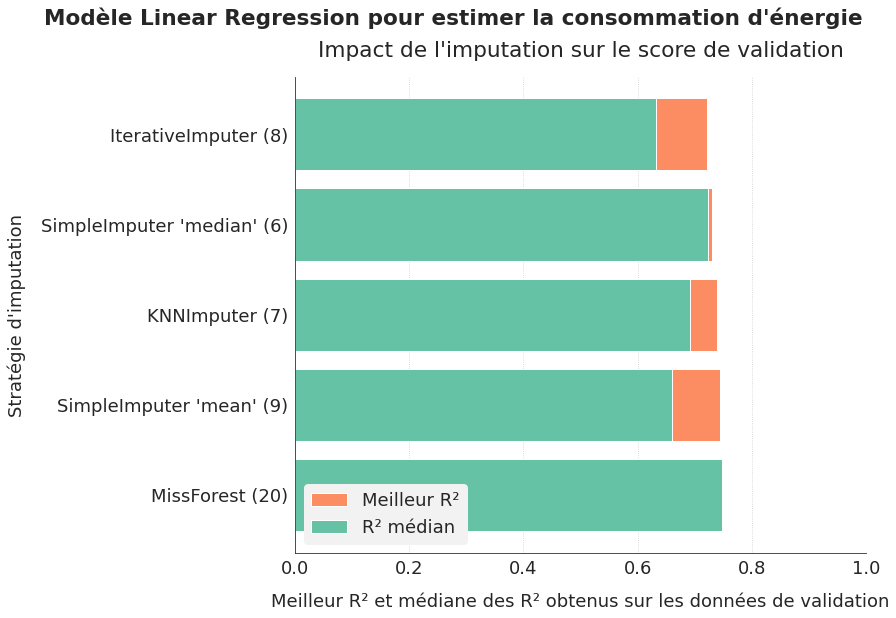

In [ ]:
fig, ax = graph_analyse_imputers(lr_analyse, "Linear Regression", "la consommation d'énergie")
plt.show()

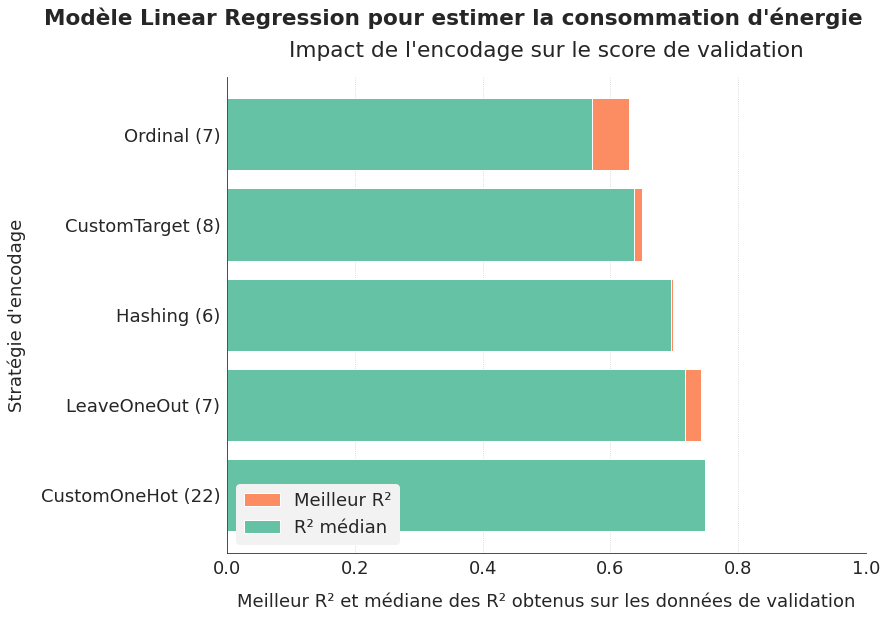

In [ ]:
fig, ax = graph_analyse_encoders(lr_analyse, "Linear Regression", "la consommation d'énergie")
plt.show()

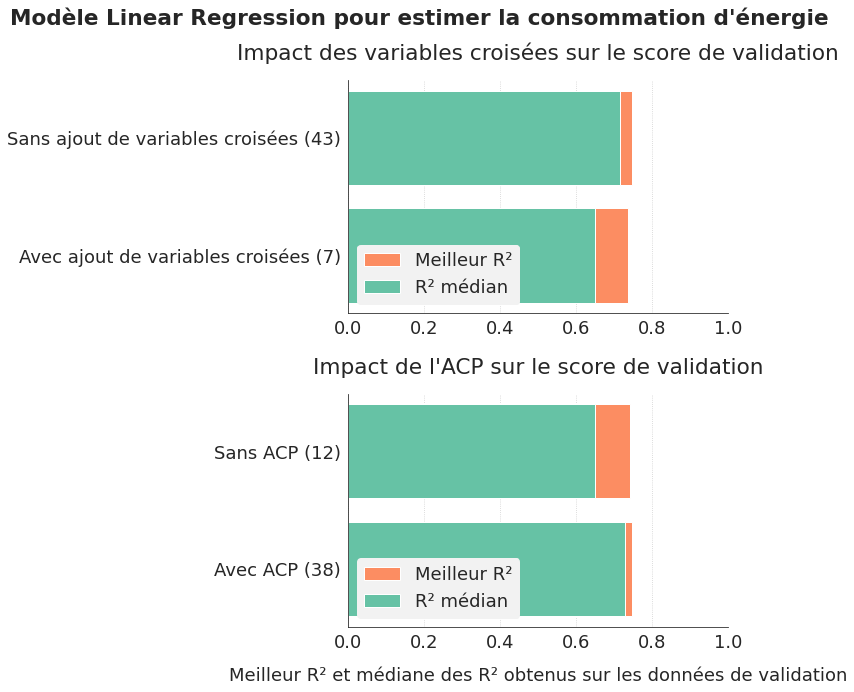

In [ ]:
fig, ax = graph_analyse_others(lr_analyse, "Linear Regression", "la consommation d'énergie")
plt.show()

De façon logique, les meilleurs scores sont obtenus avec ACP. Il y a de manière évidente des problèmes de colinéarité entre certaines variables et l'ACP permet donc de résoudre les problèmes d'instabilité et de convergence liés à cette colinéarité. A tester en forçant l'ACP.

**kNN**

In [ ]:
knn_analyse = gen_df_analyse('hyperopt_first_conso_knn_reg.csv')
knn_analyse[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
48,0.668686,0.785668,IterativeImputer,,LeaveOneOut,True,None
17,0.668392,0.785544,MissForest,,LeaveOneOut,False,None
23,0.668392,0.785544,MissForest,,LeaveOneOut,False,None
24,0.668392,0.785544,MissForest,,LeaveOneOut,False,None
25,0.668392,0.785544,MissForest,,LeaveOneOut,False,None


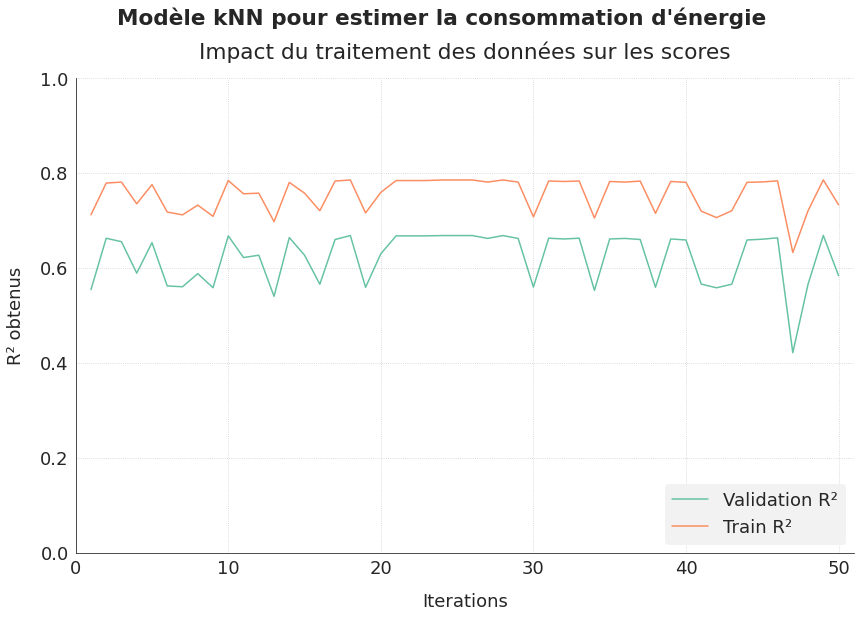

In [ ]:
fig, ax = graph_analyse_score(knn_analyse, "kNN", "la consommation d'énergie")
plt.show()

Les résultats semblent moins prometteurs avec le modèle kNN.

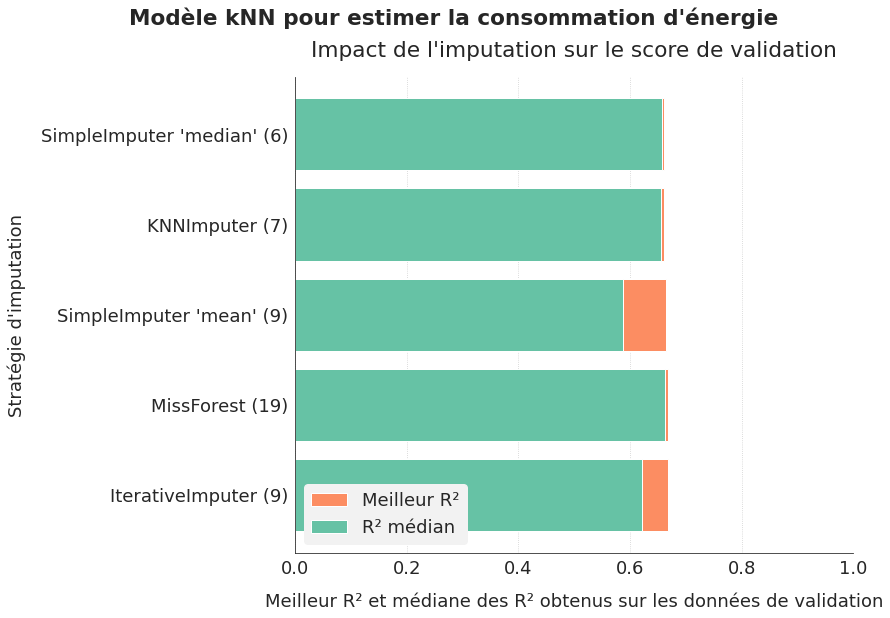

In [ ]:
fig, ax = graph_analyse_imputers(knn_analyse, "kNN", "la consommation d'énergie")
plt.show()

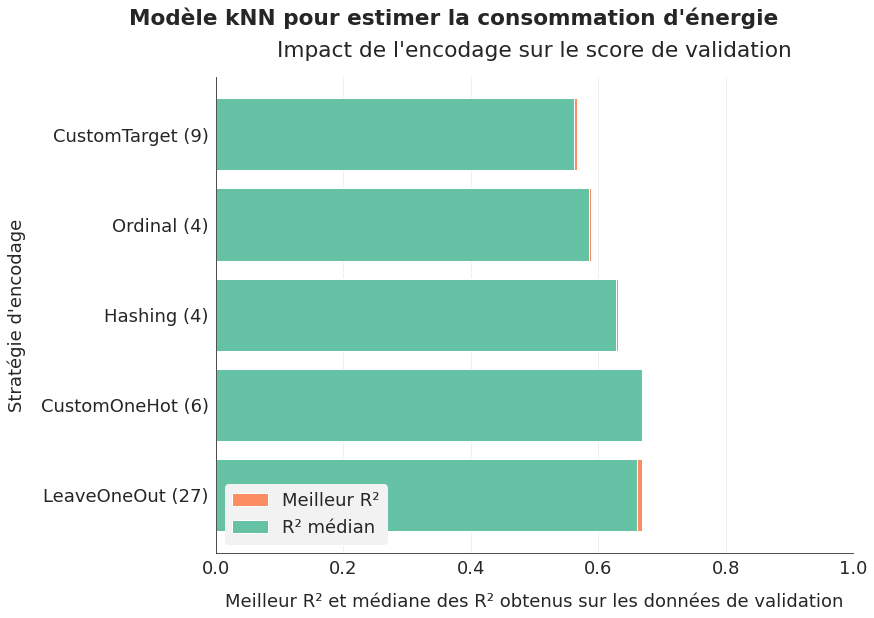

In [ ]:
fig, ax = graph_analyse_encoders(knn_analyse, "kNN", "la consommation d'énergie")
plt.show()

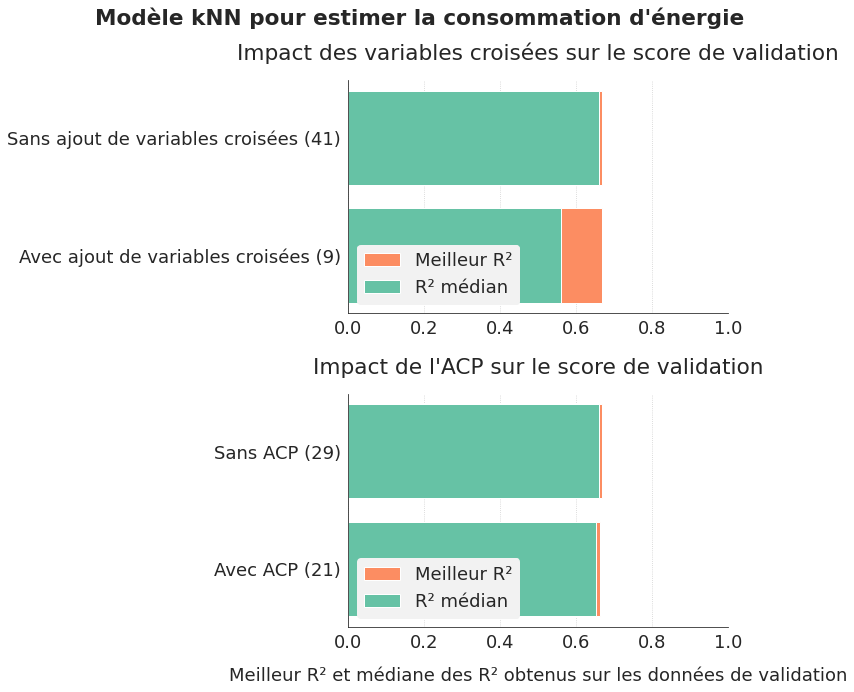

In [ ]:
fig, ax = graph_analyse_others(knn_analyse, "kNN", "la consommation d'énergie")
plt.show()

**AdaBoost**

In [ ]:
ada_analyse = gen_df_analyse('hyperopt_first_conso_adaboost_reg.csv')
ada_analyse[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
4,0.655484,0.722638,SimpleImputer,'median',LeaveOneOut,False,"PCA(copy=True, iterated_power='auto', n_compon..."
20,0.655484,0.722638,SimpleImputer,'median',LeaveOneOut,False,"PCA(copy=True, iterated_power='auto', n_compon..."
21,0.655484,0.722638,SimpleImputer,'median',LeaveOneOut,False,"PCA(copy=True, iterated_power='auto', n_compon..."
22,0.655484,0.722638,SimpleImputer,'median',LeaveOneOut,False,"PCA(copy=True, iterated_power='auto', n_compon..."
23,0.655484,0.722638,SimpleImputer,'median',LeaveOneOut,False,"PCA(copy=True, iterated_power='auto', n_compon..."


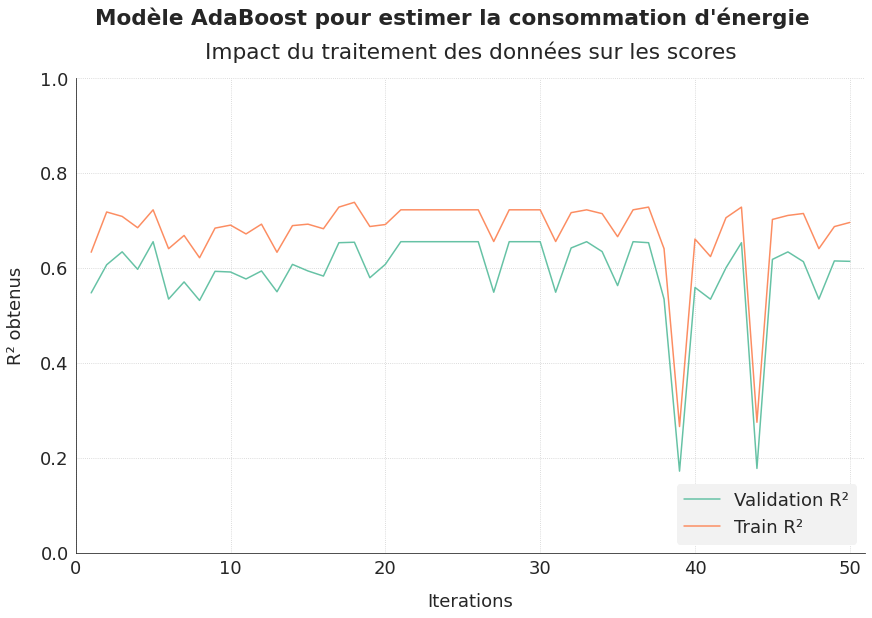

In [ ]:
fig, ax = graph_analyse_score(ada_analyse, "AdaBoost", "la consommation d'énergie")
plt.show()

Le modèle AdaBoost obtient un score à peu près équivalent au modèle kNN, mais avec des scores de validation plus proches des scores d'entraînement.

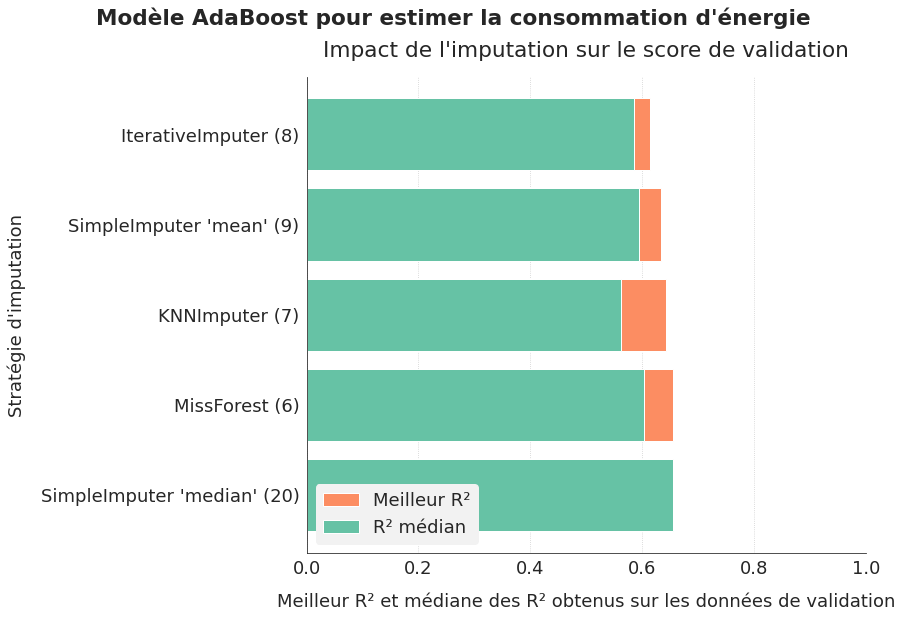

In [ ]:
fig, ax = graph_analyse_imputers(ada_analyse, "AdaBoost", "la consommation d'énergie")
plt.show()

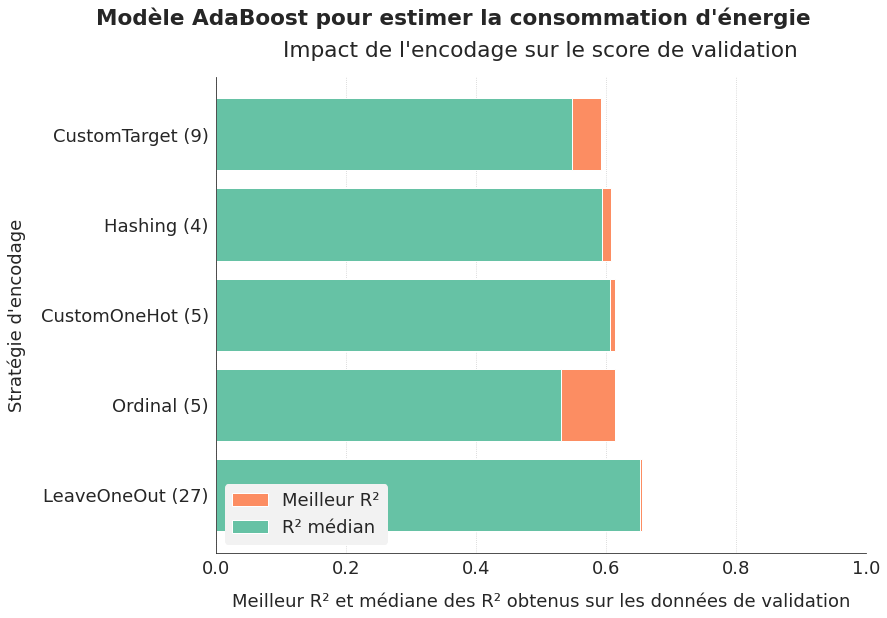

In [ ]:
fig, ax = graph_analyse_encoders(ada_analyse, "AdaBoost", "la consommation d'énergie")
plt.show()

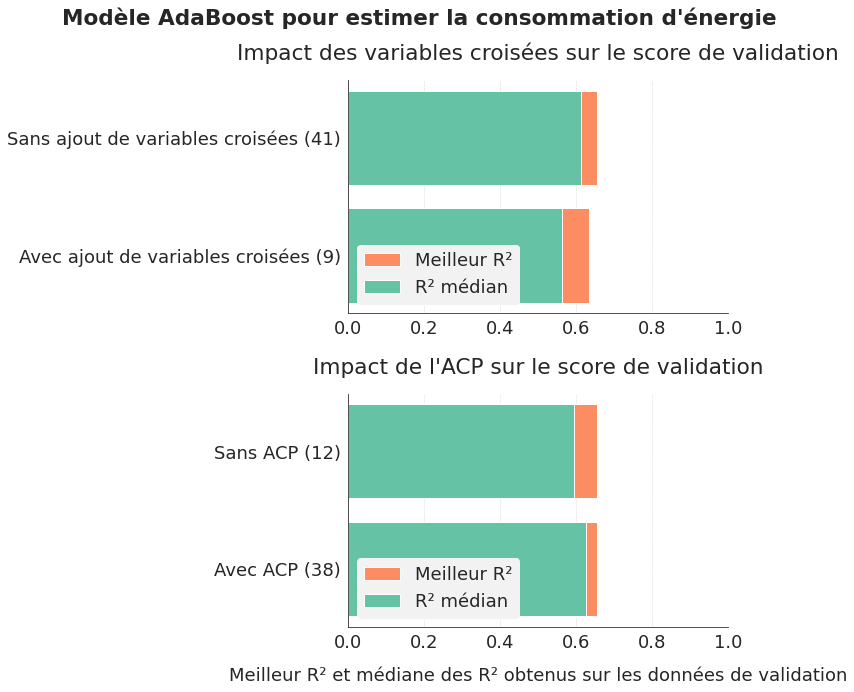

In [ ]:
fig, ax = graph_analyse_others(ada_analyse, "AdaBoost", "la consommation d'énergie")
plt.show()

**Premières conclusions**

Les différentes stratégies d'imputation présentent des performances assez proches.  
Deux stratégies d'encodage se démarquent des autres : One Hot (personnalisé) et LeaveOneOut. Je ne garde que ces deux encodeurs pour la suite de l'étude.  
Les conclusions sur l'ajout de variables croisées et l'intérêt de l'ACP varient selon les modèles. Je garde les différentes possibilités.

En terme de niveau de performance, tous les modèles surpassent le dummy regressor et apportent donc une valeur ajoutée. Je délaisse les modèles kNN, Lasso et AdaBoost qui sous-performent les autres modèles.

**Analyse groupée des temps de calcul**

In [ ]:
svm_analyse["model"] = "SVM"
ext_analyse["model"] = "Extra Trees"
xgb_analyse["model"] = "XGBoost"
ridge_analyse["model"] = "Ridge"
rf_analyse["model"] = "Random Forest"
lr_analyse["model"] = "Linear Regression"
knn_analyse["model"] = "kNN"
ada_analyse["model"] = "AdaBoost"

In [ ]:
first_conso_grouped = pd.concat([svm_analyse, ext_analyse, xgb_analyse, ridge_analyse, 
                                 rf_analyse, lr_analyse, knn_analyse, ada_analyse], ignore_index=True)

In [ ]:
first_conso_grouped["corrected_transfo_time"] = calculate_corrected_transfo_time(first_conso_grouped)
first_conso_grouped["corrected_valid_time"] = calculate_corrected_valid_time(first_conso_grouped)

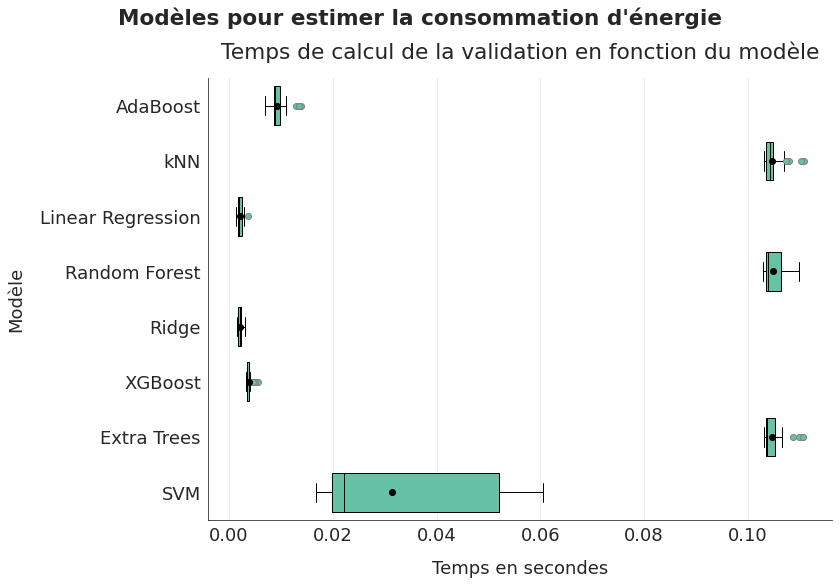

In [ ]:
fig, ax = graph_model_validtime(first_conso_grouped, "la consommation d'énergie")
save_fig("ml03_2_06_conso14")
plt.show()

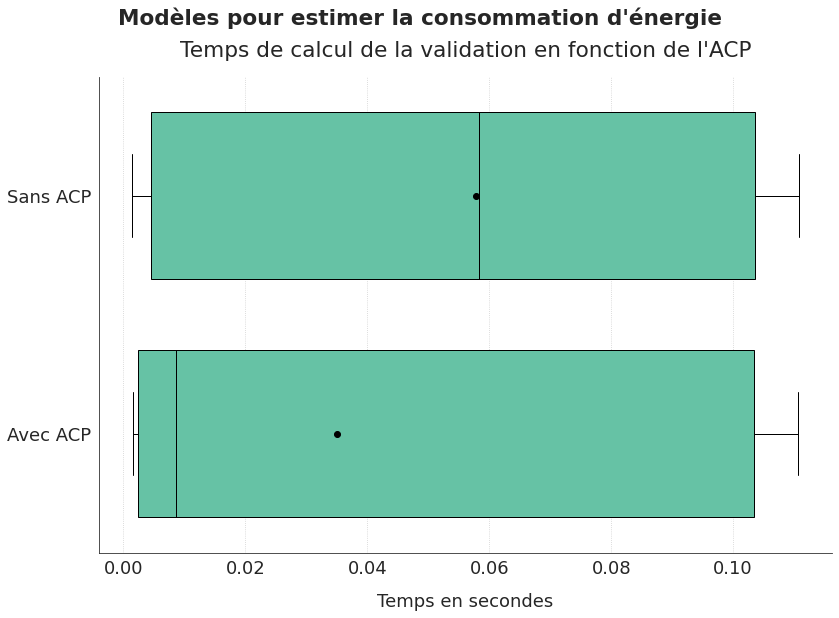

In [ ]:
fig, ax = graph_acp_validtime(first_conso_grouped, "la consommation d'énergie")
plt.show()

Le temps affiché en fonction de l'ACP semble surtout dépendre du modèle utilisé. J'analyse le temps corrigé du temps moyen du modèle.

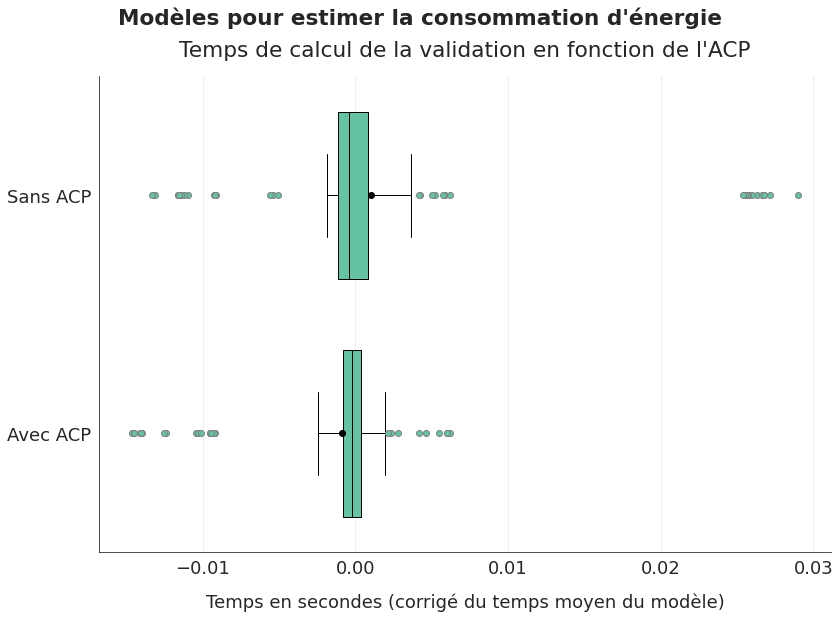

In [ ]:
fig, ax = graph_acp_validtime(first_conso_grouped, "la consommation d'énergie", corrected=True)
plt.show()

Le temps de calcul ne dépend pas de la présence ou non d'une ACP.

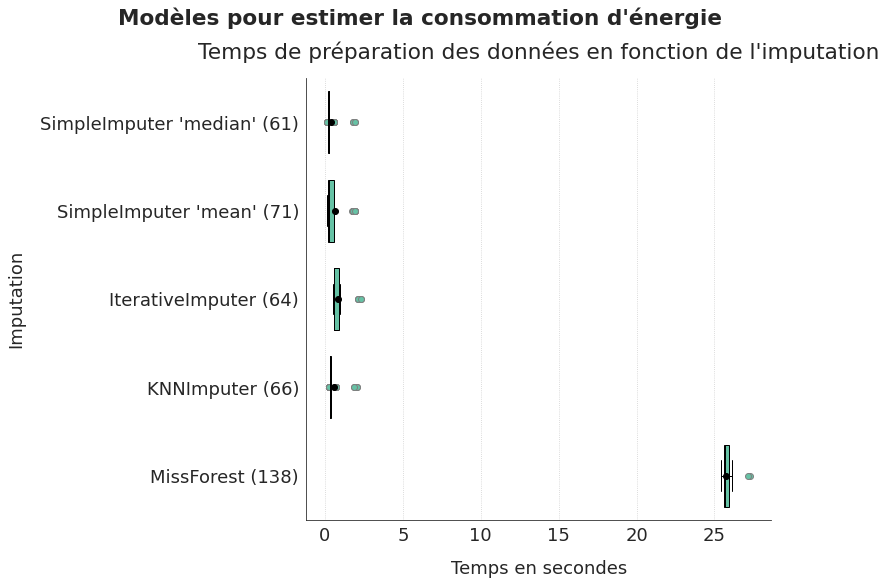

In [ ]:
fig, ax = graph_imputer_preparetime(first_conso_grouped, "la consommation d'énergie")
save_fig("ml03_2_06_conso15")
plt.show()

L'imputation par Miss Forest est efficace mais prend beaucoup de temps. Selon l'importance portée au temps de calcul, on utilisera Miss Forest ou une alternative proche en performance mais plus rapide.

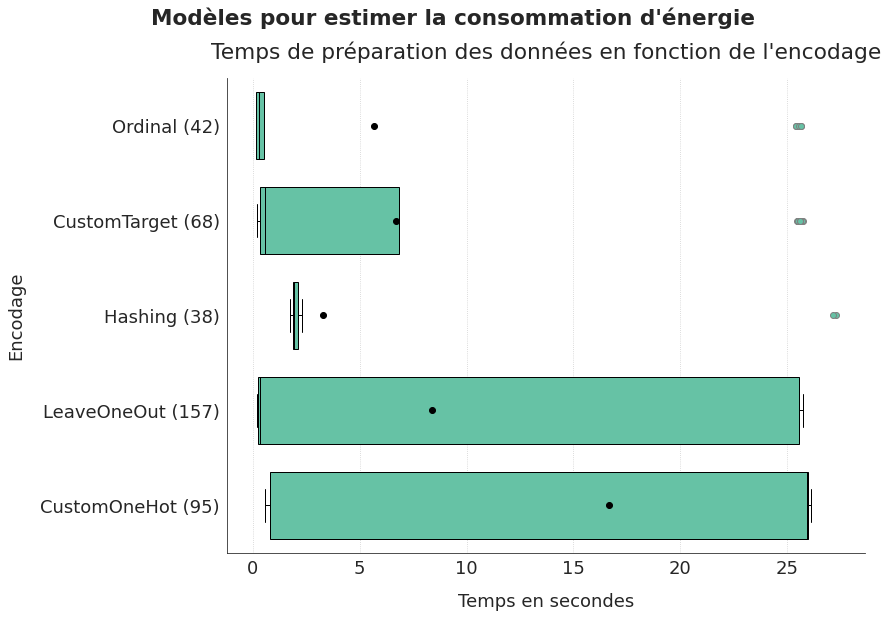

In [ ]:
fig, ax = graph_encoder_preparetime(first_conso_grouped, "la consommation d'énergie")
plt.show()

Il est difficile d'estimer l'impact de l'encodage sur le temps de traitement car ce temps de traitement est fortement biaisé lors d'une imputation par MissForest. Afin d'isoler plus efficacement l'impact de l'encodage, je calcule un temps de traitement des données corrigé de la moyenne de temps de traitement lié à l'imputation.

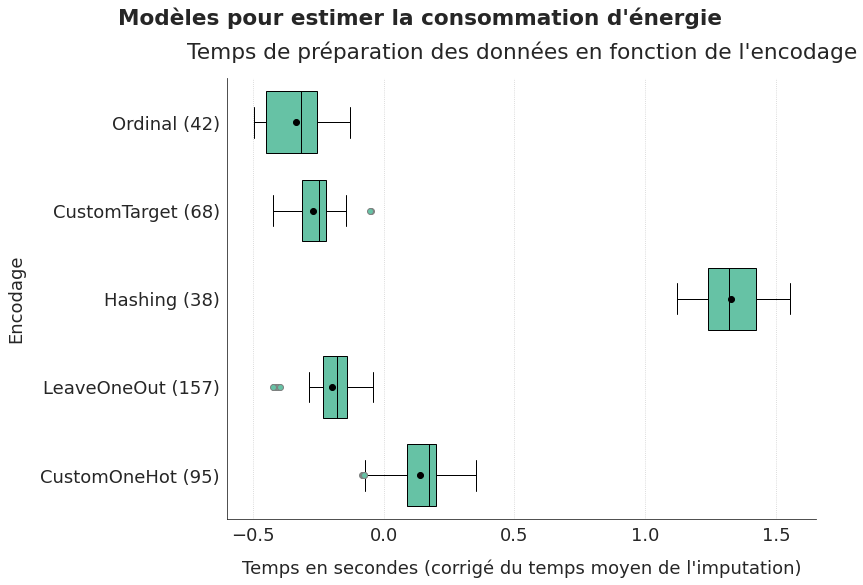

In [ ]:
fig, ax = graph_encoder_preparetime(first_conso_grouped, "la consommation d'énergie", corrected=True)
save_fig("ml03_2_06_conso16")
plt.show()

Les deux encodages les plus performants dans notre cas (CustomOneHot et LeaveOneOut) sont assez rapides pour être conservés.

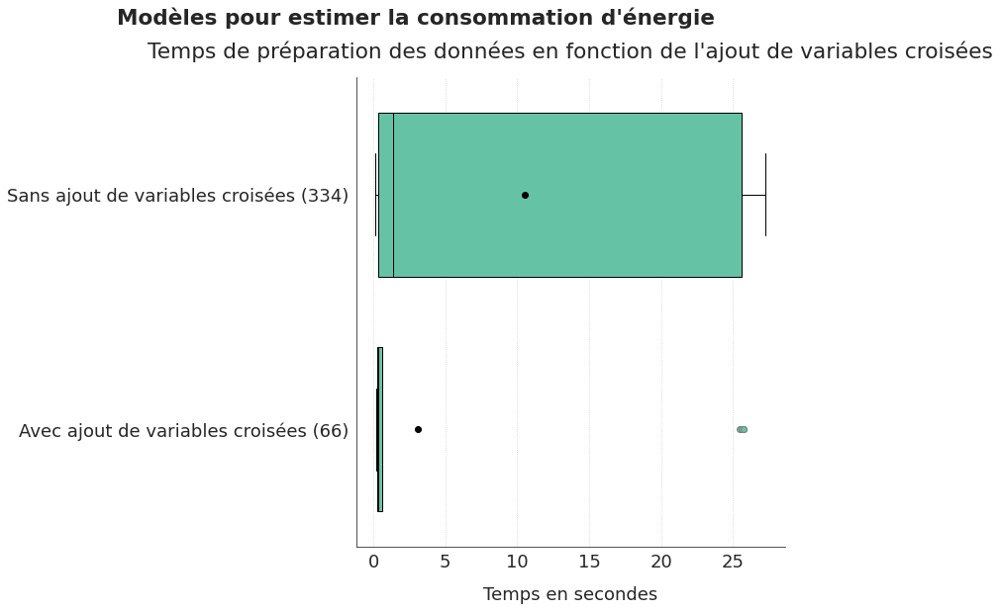

In [ ]:
fig, ax = graph_addcross_preparetime(first_conso_grouped, "la consommation d'énergie")
plt.show()

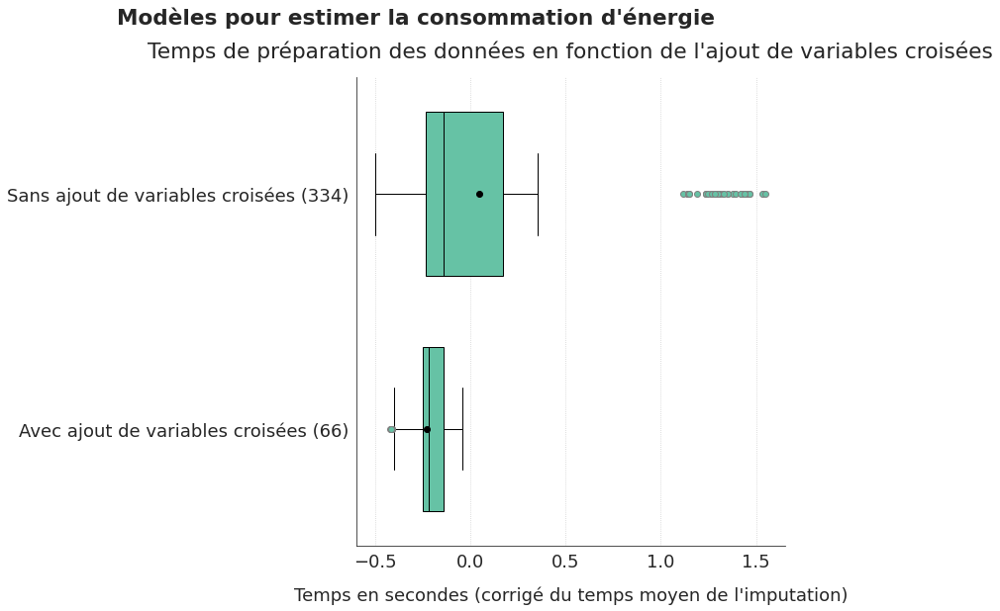

In [ ]:
fig, ax = graph_addcross_preparetime(first_conso_grouped, "la consommation d'énergie", corrected=True)
plt.show()

L'ajout de variables croisées ne semble pas impacter le temps de préparation.

**A retenir**

L'imputation MissForest est bien plus longue que les autres imputations. Comme les performances entre les différentes imputations sont assez proches, j'abandonne la possibilité d'imputer avec MissForest.  
Les deux encodeurs de variables catégorielles les plus prometteurs sont : LeaveOneOut et le OneHotEncoder personnalisé.  
Il faut continuer de tester l'ajout des variables croisées et l'exécution d'une ACP. A noter qu'il faut sans doute forcer l'ACP pour la régression linéaire sans régularisation, pour éviter tout problème d'instabilité liée à la colinéarité.

Je sauvegarde le résumé de ces premières analyses.

In [ ]:
first_conso_best_results.to_csv("conso_first_summary.csv")
first_conso_grouped.to_csv("conso_grouped_first_summary.csv")

<a id='4_4'></a>

### 4.4. Deuxième optimisation : sélection des deux modèles les plus prometteurs

Je recentre ma recherche autour des réglages les plus rapides et prometteurs :  
- imputation : j'enlève MissForest pour la rapidité ;  
- encodage : je ne conserve que LeaveOneOut et le OneHotEncoder personnalisé ;  
- ajout ou non des variables croisées en cas de LeaveOneOut (cette option n'est pas compatible avec le OneHotEncoder personnalisé).
- ACP : pas d'ACP, ou ACP avec 90%, 95% ou 99% de l'inertie.

Je rajoute une première couche d'optimisation sur les 6 modèles retenus afin de mieux cerner leur potentiel de performance.  
Je me contente d'optimiser un ou deux hyperparamètres pour avoir une idée plus précise de la performance et de pouvoir les comparer de manière plus précise :  
- SVM : C et kernel ;  
- ExtraTrees et RandomForest : min_samples_split et min_samples_leaf pour contenir la sur-optimisation ;  
- XGBoost : n_estimators et learning_rate ;
- Ridge : alpha ;
- LinearRegression : pas de paramètre - forcer ACP.

In [ ]:
list_best_results = []

In [ ]:
# space spécifique pour linear reg : forcer ACP
space = {
    'data_imputers': hp.choice('data_imputers', [imputer_knn,
        PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_mean), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1),
        PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_median), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1),
        PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_iterative), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1)]),
    'data_case': hp.choice('data_case', [
        {'encoders': encoder_leaveoneout,
         'add_cross': hp.choice('add_cross1', [True,False]),
         'keep_all': hp.choice('keep_all1', [True,False]),
         'list_name': None,
         'restrict_cols': None},
        {'encoders': encoder_perso_onehot,
         'add_cross': False,
         'keep_all': False,
         'list_name': transfo_col,
         'restrict_cols': 'transfo_num'}]),
    'pca': hp.choice('pca', [PCA(n_components=0.90), PCA(n_components=0.95), PCA(n_components=0.99)])}

In [ ]:
#scope.define(LinearRegression)
estimator_name = 'linear_reg'
estimator_object = scope.LinearRegression()
run_optimization(estimator_name, estimator_object, max_evals=25, prefix_name='second', reg_target='conso')

100%|██████████| 25/25 [00:17<00:00,  1.47it/s, best loss: -0.7407734597470673]
Estimateur : linear_reg - Done
Best cross-validation mean score = 0.7407734597470673
Associated standard deviation = 0.018169661192269607
Calculation time = 0.0024947166442871095
Data preparation time = 0.5724298309996811
Best cv score obtained after 8 iterations



In [ ]:
space = {
    'data_imputers': hp.choice('data_imputers', [imputer_knn,
        PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_mean), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1),
        PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_median), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1),
        PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_iterative), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1)]),
    'data_case': hp.choice('data_case', [
        {'encoders': encoder_leaveoneout,
         'add_cross': hp.choice('add_cross1', [True,False]),
         'keep_all': hp.choice('keep_all1', [True,False]),
         'list_name': None,
         'restrict_cols': None},
        {'encoders': encoder_perso_onehot,
         'add_cross': False,
         'keep_all': False,
         'list_name': transfo_col,
         'restrict_cols': 'transfo_num'}]),
    'pca': hp.choice('pca', [None, PCA(n_components=0.90), PCA(n_components=0.95), PCA(n_components=0.99)])}

In [ ]:
#scope.define(Ridge)
estimator_name = 'ridge_reg'
estimator_object = scope.Ridge(random_state=42,
                              alpha = hp.uniform('alpha', 0.2, 1.8))
run_optimization(estimator_name, estimator_object, max_evals=100, prefix_name='second', reg_target='conso')

100%|██████████| 100/100 [01:16<00:00,  1.31it/s, best loss: -0.7497725039727554]
Estimateur : ridge_reg - Done
Best cross-validation mean score = 0.7497725039727554
Associated standard deviation = 0.01808086751508507
Calculation time = 0.0017017364501953126
Data preparation time = 0.5646329820001483
Best cv score obtained after 76 iterations



In [ ]:
scope.define(ElasticNet)
estimator_name = 'elasticnet_reg'
estimator_object = scope.ElasticNet(random_state=42,
                                    alpha = hp.uniform('alpha', 0.2, 1.8),
                                    l1_ratio = hp.uniform('l1_ratio', 0.0, 1.0))
run_optimization(estimator_name, estimator_object, max_evals=200, prefix_name='second', reg_target='conso')

100%|██████████| 200/200 [02:22<00:00,  1.40it/s, best loss: -0.724175278191467]
Estimateur : elasticnet_reg - Done
Best cross-validation mean score = 0.724175278191467
Associated standard deviation = 0.03741824256766762
Calculation time = 0.0017364501953125
Data preparation time = 0.33724670999981754
Best cv score obtained after 200 iterations



In [ ]:
#scope.define(SVR)
estimator_name = 'svm_reg'
estimator_object = scope.SVR(kernel = hp.choice('kernel', ['linear', 'poly', 'rbf', 'sigmoid']),
                            C = hp.loguniform('C', np.log(0.001), np.log(100)))
run_optimization(estimator_name, estimator_object, max_evals=200, prefix_name='second', reg_target='conso')

100%|██████████| 200/200 [15:25<00:00,  4.63s/it, best loss: -0.7566036735416104]
Estimateur : svm_reg - Done
Best cross-validation mean score = 0.7566036735416104
Associated standard deviation = 0.010482762955816696
Calculation time = 0.05783743858337402
Data preparation time = 0.7075617610007612
Best cv score obtained after 153 iterations



In [ ]:
#scope.define(RandomForestRegressor)
estimator_name = 'randomforest_reg'
estimator_object = scope.RandomForestRegressor(n_jobs=-1, random_state=42,
                                               min_samples_split = hp.choice('min_samples_split', np.arange(2, 21, 2, dtype=int)),
                                               min_samples_leaf = hp.choice('min_samples_leaf', np.arange(1, 11, 1, dtype=int)))
run_optimization(estimator_name, estimator_object, max_evals=200, prefix_name='second', reg_target='conso')

100%|██████████| 200/200 [14:23<00:00,  4.32s/it, best loss: -0.7401465917354377]
Estimateur : randomforest_reg - Done
Best cross-validation mean score = 0.7401465917354377
Associated standard deviation = 0.02747291825885829
Calculation time = 0.10339770317077637
Data preparation time = 0.22260564899988822
Best cv score obtained after 127 iterations



In [ ]:
#scope.define(ExtraTreesRegressor)
estimator_name = 'extratrees_reg'
estimator_object = scope.ExtraTreesRegressor(n_jobs=-1, random_state=42,
                                             min_samples_split = hp.choice('min_samples_split', np.arange(2, 21, 2, dtype=int)),
                                             min_samples_leaf = hp.choice('min_samples_leaf', np.arange(1, 11, 1, dtype=int)))
run_optimization(estimator_name, estimator_object, max_evals=200, prefix_name='second', reg_target='conso')

100%|██████████| 200/200 [08:01<00:00,  2.41s/it, best loss: -0.7554540650572321]
Estimateur : extratrees_reg - Done
Best cross-validation mean score = 0.7554540650572321
Associated standard deviation = 0.028383547579891335
Calculation time = 0.10378384590148926
Data preparation time = 0.21918508599992492
Best cv score obtained after 40 iterations



In [ ]:
#scope.define(XGBRegressor)
estimator_name = 'xgboost_reg'
estimator_object = scope.XGBRegressor(objective='reg:squarederror', n_jobs=-1, random_state=42,
                                      n_estimators = hp.choice('n_estimators', np.arange(25, 501, 25, dtype=int)),
                                      learning_rate = hp.loguniform('learning_rate', np.log(0.001), np.log(1)))
run_optimization(estimator_name, estimator_object, max_evals=200, prefix_name='second', reg_target='conso')

100%|██████████| 200/200 [12:28<00:00,  3.74s/it, best loss: -0.7582331029687641]
Estimateur : xgboost_reg - Done
Best cross-validation mean score = 0.7582331029687641
Associated standard deviation = 0.02004074393105011
Calculation time = 0.007964181900024413
Data preparation time = 0.6874882470001467
Best cv score obtained after 69 iterations



SVM : C (100 -> 0.001) logscale et kernel [‘linear’, ‘poly’, ‘rbf’, ‘sigmoid’];
ExtraTrees et RandomForest : min_samples_split et min_samples_leaf pour contenir la sur-optimisation ;
XGBoost : n_estimators (10 - 100 - 1000) et learning_rate (0.001 - 0.01 - 1.0) logscale ;
Ridge : alpha (0.2 à 1.8 - pas de 0.2);
LinearRegression : pas de paramètre - forcer ACP
kNN : n_neighbors : 3 à 30
AdaBoost: n_estimators (10 - 100 - 1000) et learning_rate (0.001 - 0.01 - 1.0) logscale ;

In [ ]:
second_conso_best_results = pd.DataFrame(list_best_results)

In [ ]:
second_conso_best_results = get_details(second_conso_best_results)
second_conso_best_results.sort_values("loss", inplace=True)
second_conso_best_results

,loss,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,params_data,params_reg,data_transfo_time,iteration,status,estimator,pca,imputer,strategy,encoder,add_cross,keep_all
6,-0.758233,0.020041,0.007964,0.895952,0.002868,1.589573,{'data_imputers': AllImputation(categ_cols=['B...,"{'estimator': XGBRegressor(base_score=0.5, boo...",0.687488,69,ok,XGBRegressor,Non,KNNImputer,,CustomOneHotEncoder,False,False
3,-0.756604,0.010483,0.057837,0.873061,0.002162,0.344219,{'data_imputers': AllImputation(categ_cols=['B...,"{'estimator': SVR(C=1.4973185678679177, cache_...",0.707562,153,ok,SVR,Non,KNNImputer,,CustomOneHotEncoder,False,False
5,-0.755454,0.028384,0.103784,0.917853,0.003289,0.423638,{'data_imputers': PandasColumnTransformer(list...,{'estimator': ExtraTreesRegressor(bootstrap=Fa...,0.219185,40,ok,ExtraTreesRegressor,Non,SimpleImputer,'mean',LeaveOneOutEncoder,False,False
1,-0.749773,0.018081,0.001702,0.797270,0.006392,0.007834,{'data_imputers': PandasColumnTransformer(list...,"{'estimator': Ridge(alpha=1.7603290408997045, ...",0.564633,76,ok,Ridge,Non,SimpleImputer,'mean',CustomOneHotEncoder,False,False
0,-0.740773,0.018170,0.002495,0.776211,0.005742,0.026910,{'data_imputers': PandasColumnTransformer(list...,"{'estimator': LinearRegression(copy_X=True, fi...",0.572430,8,ok,LinearRegression,PCA,SimpleImputer,'median',CustomOneHotEncoder,False,False
4,-0.740147,0.027473,0.103398,0.932451,0.003416,1.068762,{'data_imputers': PandasColumnTransformer(list...,{'estimator': RandomForestRegressor(bootstrap=...,0.222606,127,ok,RandomForestRegressor,Non,SimpleImputer,'mean',LeaveOneOutEncoder,False,True
2,-0.724175,0.037418,0.001736,0.727854,0.010302,0.005140,{'data_imputers': AllImputation(categ_cols=['B...,{'estimator': ElasticNet(alpha=0.2072688516301...,0.337247,200,ok,ElasticNet,Non,KNNImputer,,LeaveOneOutEncoder,False,True


In [ ]:
second_conso_best_results[["estimator","loss","train_score_mean","imputer","strategy","encoder","pca","add_cross","keep_all"]]

,estimator,loss,train_score_mean,imputer,strategy,encoder,pca,add_cross,keep_all
6,XGBRegressor,-0.758233,0.895952,KNNImputer,,CustomOneHotEncoder,Non,False,False
3,SVR,-0.756604,0.873061,KNNImputer,,CustomOneHotEncoder,Non,False,False
5,ExtraTreesRegressor,-0.755454,0.917853,SimpleImputer,'mean',LeaveOneOutEncoder,Non,False,False
1,Ridge,-0.749773,0.797270,SimpleImputer,'mean',CustomOneHotEncoder,Non,False,False
0,LinearRegression,-0.740773,0.776211,SimpleImputer,'median',CustomOneHotEncoder,PCA,False,False
4,RandomForestRegressor,-0.740147,0.932451,SimpleImputer,'mean',LeaveOneOutEncoder,Non,False,True
2,ElasticNet,-0.724175,0.727854,KNNImputer,,LeaveOneOutEncoder,Non,False,True


<a id='4_5'></a>

### 4.5. Etude des résultats de la deuxième optimisation, modèle par modèle

**XGBoost**

In [ ]:
xgb_second_conso = gen_df_analyse('hyperopt_second_conso_xgboost_reg.csv')
xgb_second_conso = calculate_corrected_score(xgb_second_conso)
xgb_second_conso[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
68,0.758233,0.895952,KNNImputer,,CustomOneHot,False,None
181,0.757622,0.882822,KNNImputer,,CustomOneHot,False,None
117,0.757546,0.917505,SimpleImputer,'median',CustomOneHot,False,None
47,0.757490,0.878850,KNNImputer,,CustomOneHot,False,None
11,0.757417,0.897685,KNNImputer,,CustomOneHot,False,None


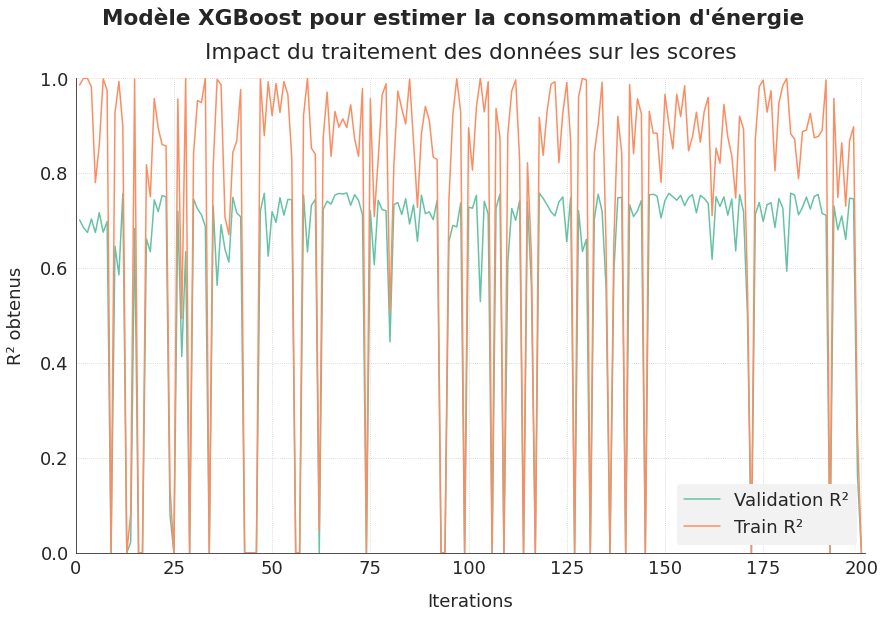

In [ ]:
fig, ax = graph_analyse_score(xgb_second_conso, "XGBoost", "la consommation d'énergie", nb_iterations=200)
plt.show()

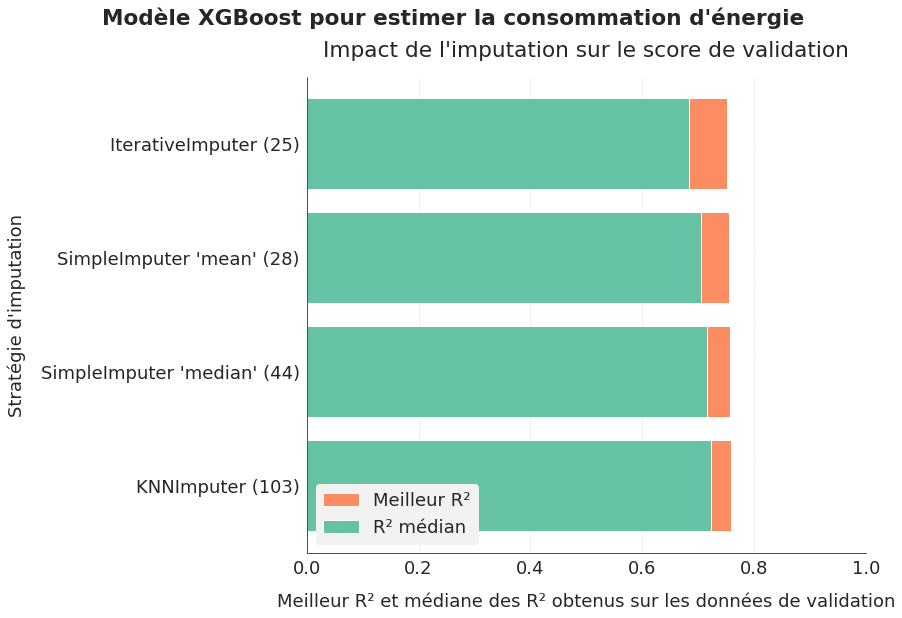

In [ ]:
fig, ax = graph_analyse_imputers(xgb_second_conso, "XGBoost", "la consommation d'énergie")
plt.show()

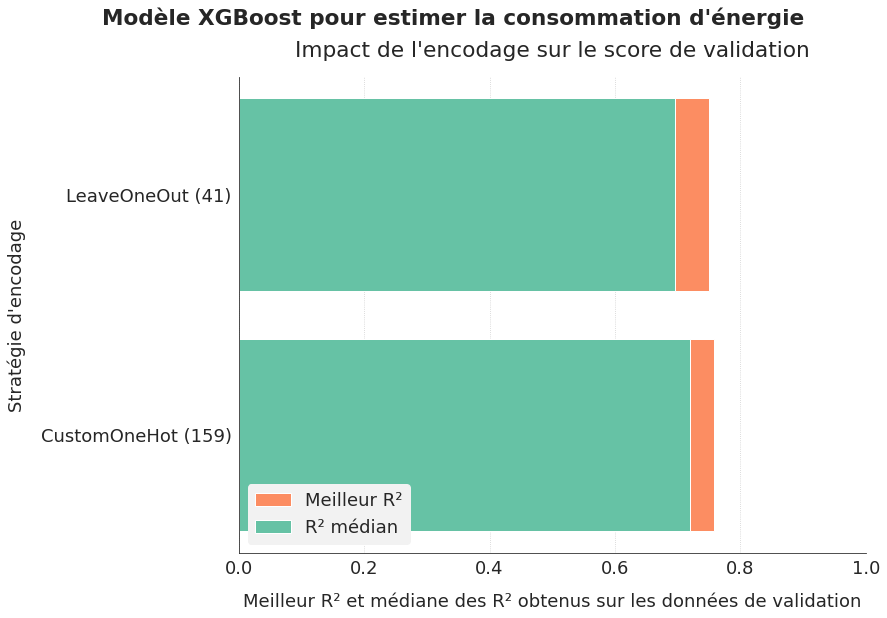

In [ ]:
fig, ax = graph_analyse_encoders(xgb_second_conso, "XGBoost", "la consommation d'énergie")
plt.show()

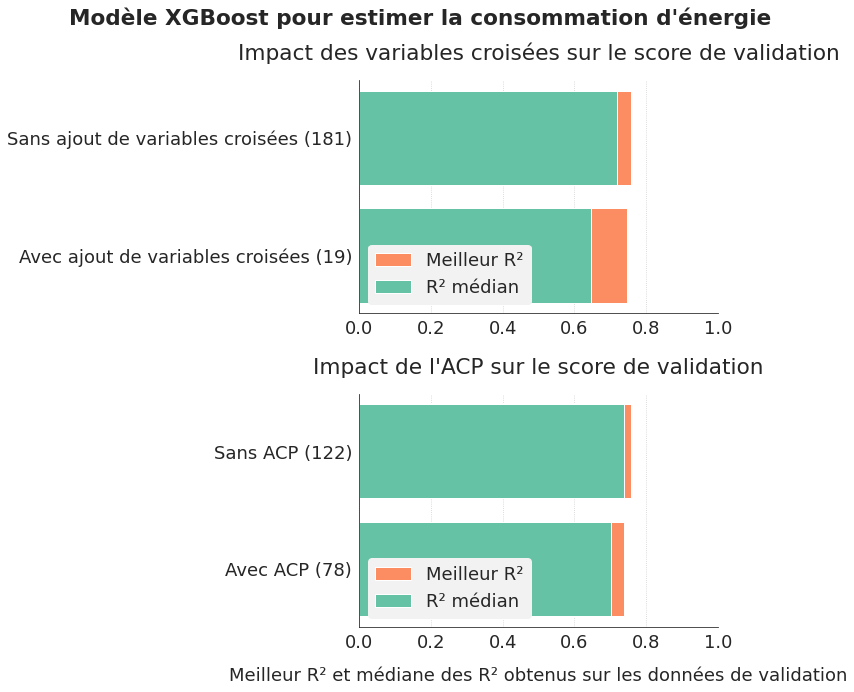

In [ ]:
fig, ax = graph_analyse_others(xgb_second_conso, "XGBoost", "la consommation d'énergie")
plt.show()

**SVM**

In [ ]:
svm_second_conso = gen_df_analyse('hyperopt_second_conso_svm_reg.csv')
svm_second_conso = calculate_corrected_score(svm_second_conso)
svm_second_conso[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
152,0.756604,0.873061,KNNImputer,,CustomOneHot,False,None
147,0.756570,0.874745,KNNImputer,,CustomOneHot,False,None
155,0.756565,0.875932,KNNImputer,,CustomOneHot,False,None
106,0.756564,0.875291,KNNImputer,,CustomOneHot,False,None
149,0.756552,0.871628,KNNImputer,,CustomOneHot,False,None


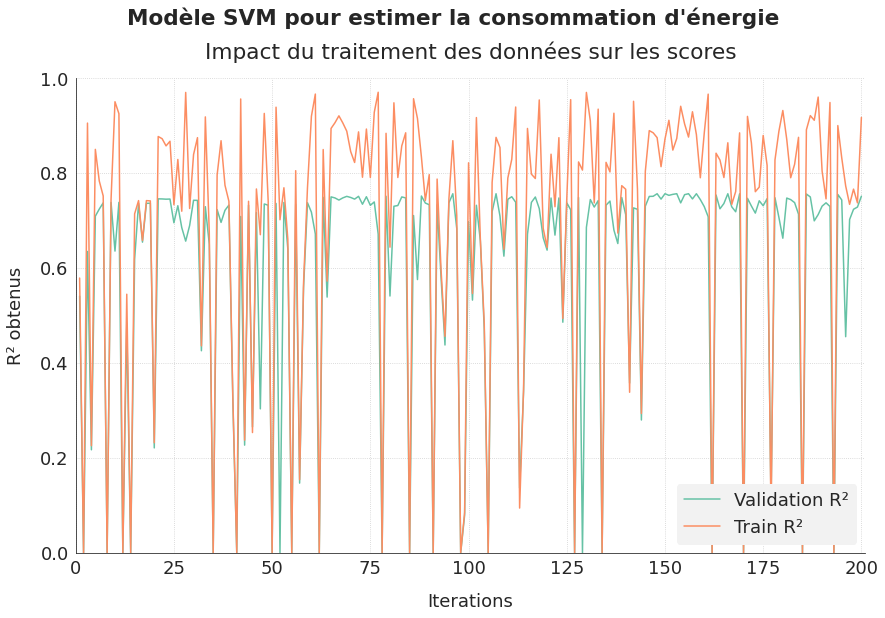

In [ ]:
fig, ax = graph_analyse_score(svm_second_conso, "SVM", "la consommation d'énergie", nb_iterations=200)
plt.show()

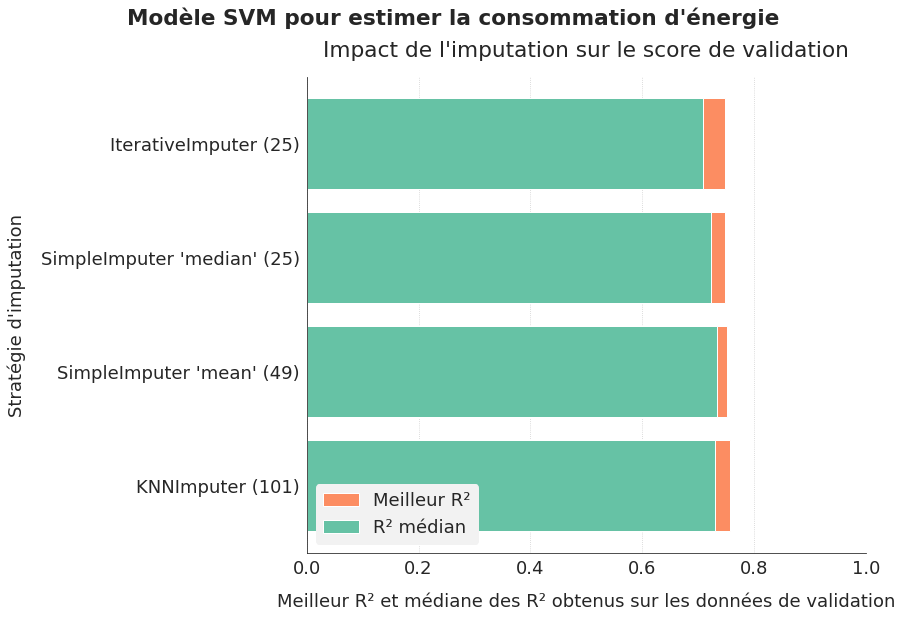

In [ ]:
fig, ax = graph_analyse_imputers(svm_second_conso, "SVM", "la consommation d'énergie")
plt.show()

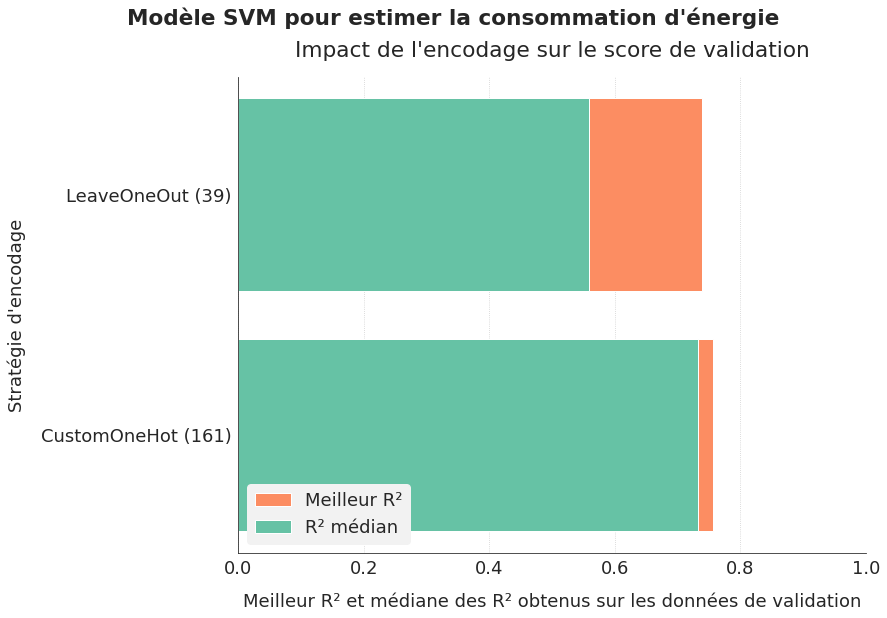

In [ ]:
fig, ax = graph_analyse_encoders(svm_second_conso, "SVM", "la consommation d'énergie")
plt.show()

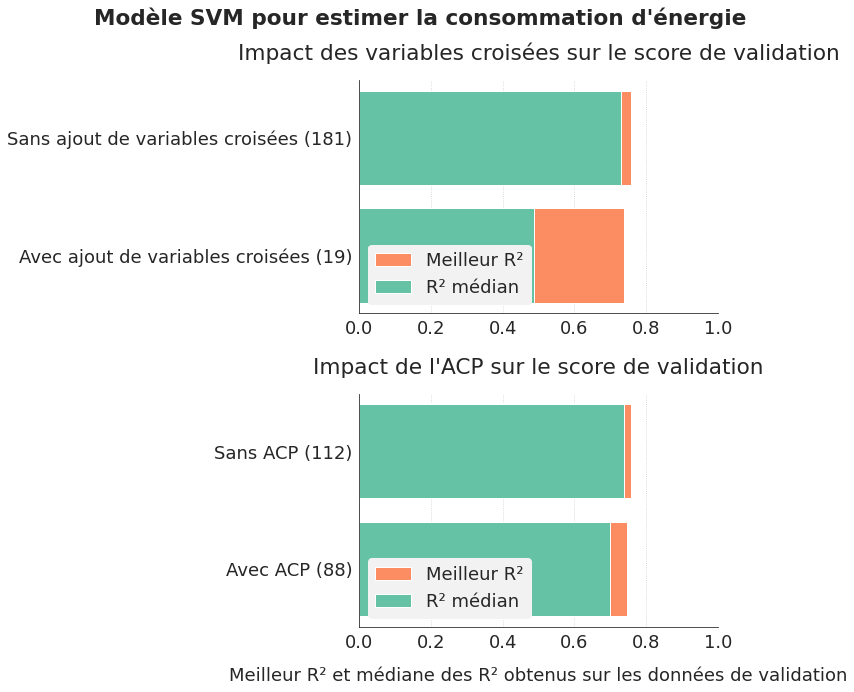

In [ ]:
fig, ax = graph_analyse_others(svm_second_conso, "SVM", "la consommation d'énergie")
plt.show()

**Extra trees**

In [ ]:
ext_second_conso = gen_df_analyse('hyperopt_second_conso_extratrees_reg.csv')
ext_second_conso = calculate_corrected_score(ext_second_conso)
ext_second_conso[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
39,0.755454,0.917853,SimpleImputer,'mean',LeaveOneOut,False,None
184,0.754528,0.908237,KNNImputer,,LeaveOneOut,False,None
71,0.754248,0.931621,KNNImputer,,LeaveOneOut,False,None
72,0.754248,0.931621,KNNImputer,,LeaveOneOut,False,None
74,0.754248,0.931621,KNNImputer,,LeaveOneOut,False,None


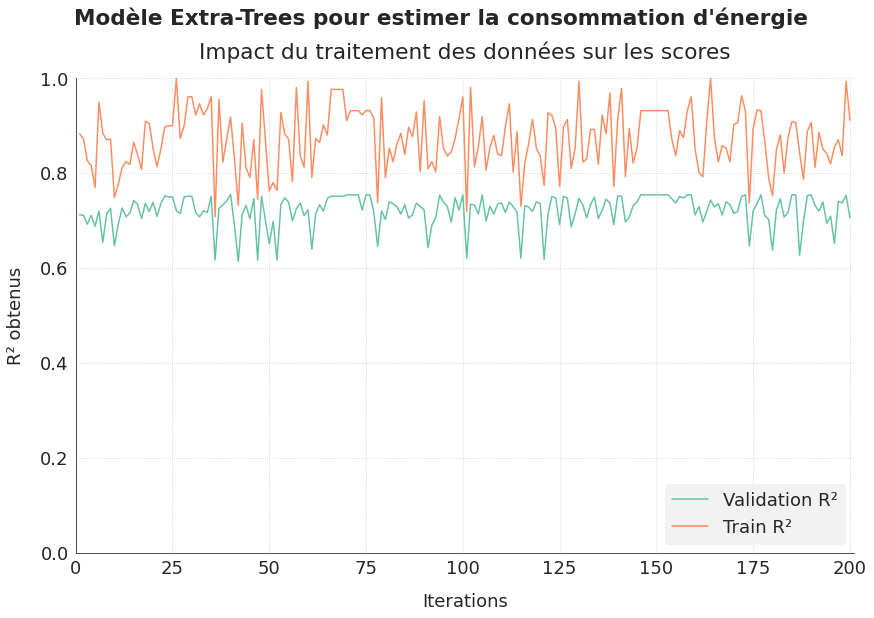

In [ ]:
fig, ax = graph_analyse_score(ext_second_conso, "Extra-Trees", "la consommation d'énergie", nb_iterations=200)
plt.show()

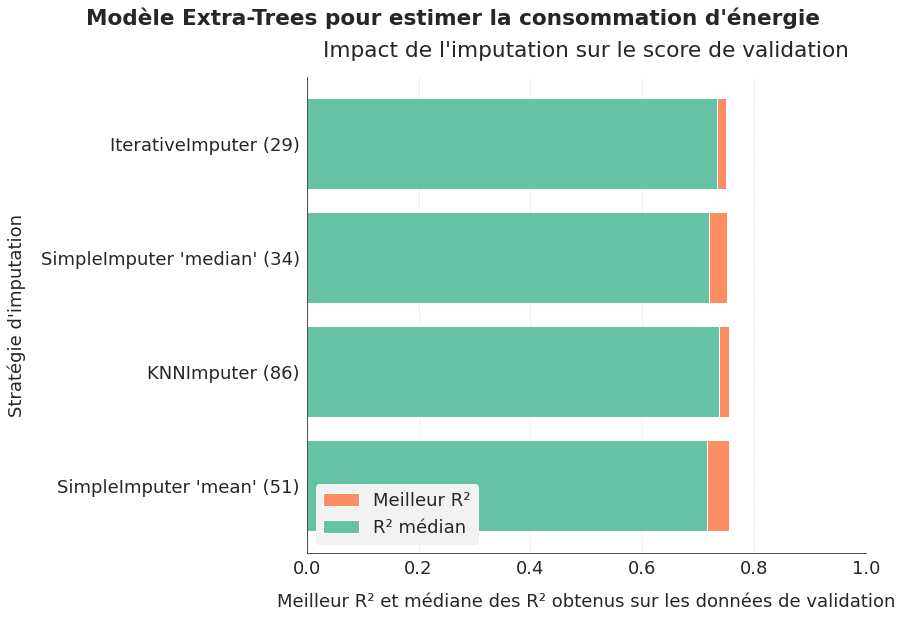

In [ ]:
fig, ax = graph_analyse_imputers(ext_second_conso, "Extra-Trees", "la consommation d'énergie")
plt.show()

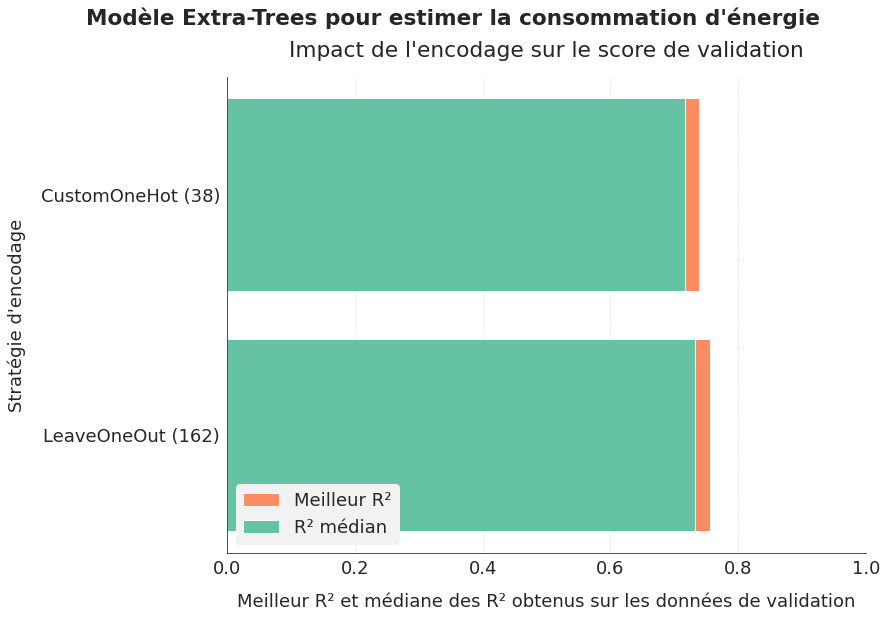

In [ ]:
fig, ax = graph_analyse_encoders(ext_second_conso, "Extra-Trees", "la consommation d'énergie")
plt.show()

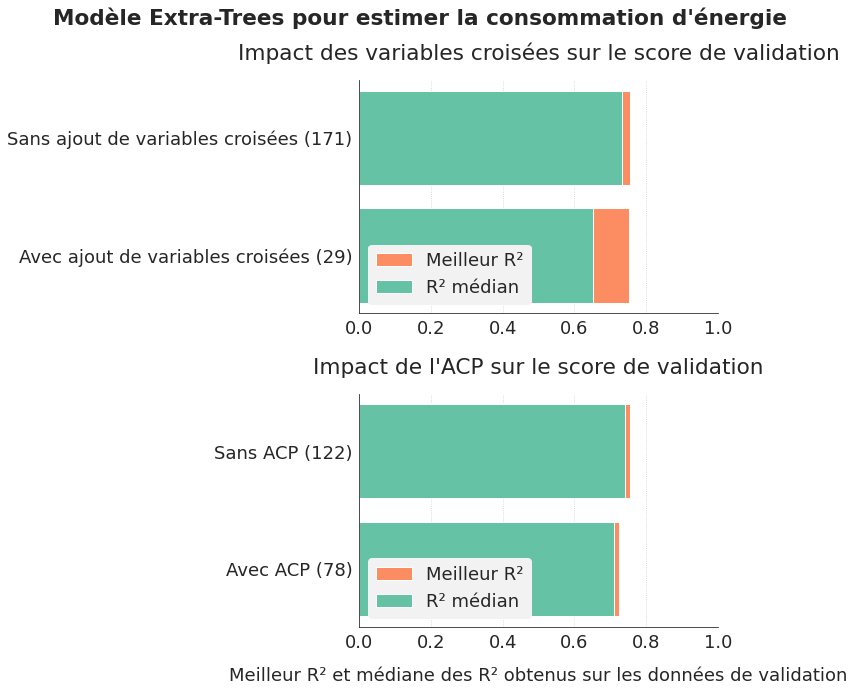

In [ ]:
fig, ax = graph_analyse_others(ext_second_conso, "Extra-Trees", "la consommation d'énergie")
plt.show()

**Ridge**

In [ ]:
ridge_second_conso = gen_df_analyse('hyperopt_second_conso_ridge_reg.csv')
ridge_second_conso = calculate_corrected_score(ridge_second_conso)
ridge_second_conso[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
75,0.749773,0.797270,SimpleImputer,'mean',CustomOneHot,False,None
99,0.749732,0.797310,SimpleImputer,'mean',CustomOneHot,False,None
65,0.749722,0.797320,SimpleImputer,'mean',CustomOneHot,False,None
72,0.749721,0.797321,SimpleImputer,'mean',CustomOneHot,False,None
71,0.749693,0.797348,SimpleImputer,'mean',CustomOneHot,False,None


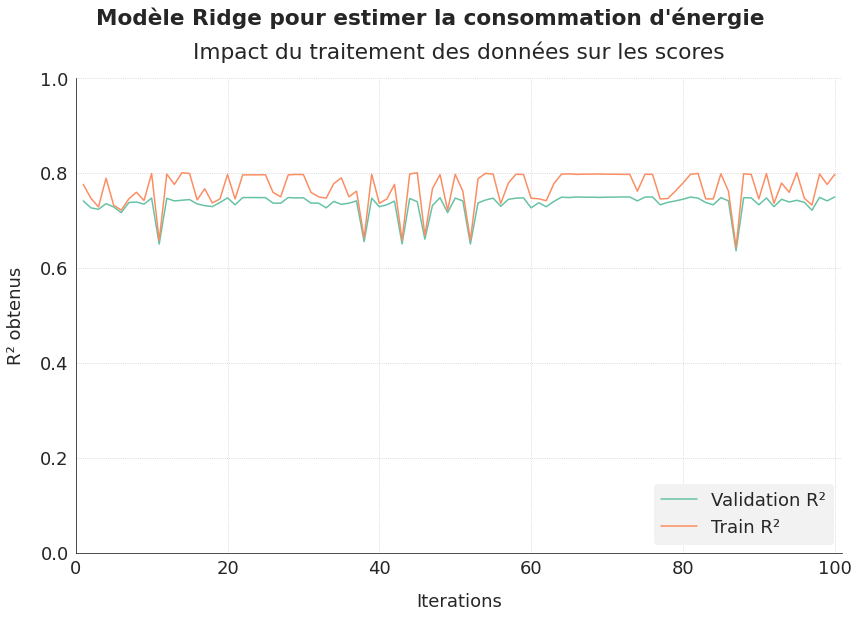

In [ ]:
fig, ax = graph_analyse_score(ridge_second_conso, "Ridge", "la consommation d'énergie", nb_iterations=100)
plt.show()

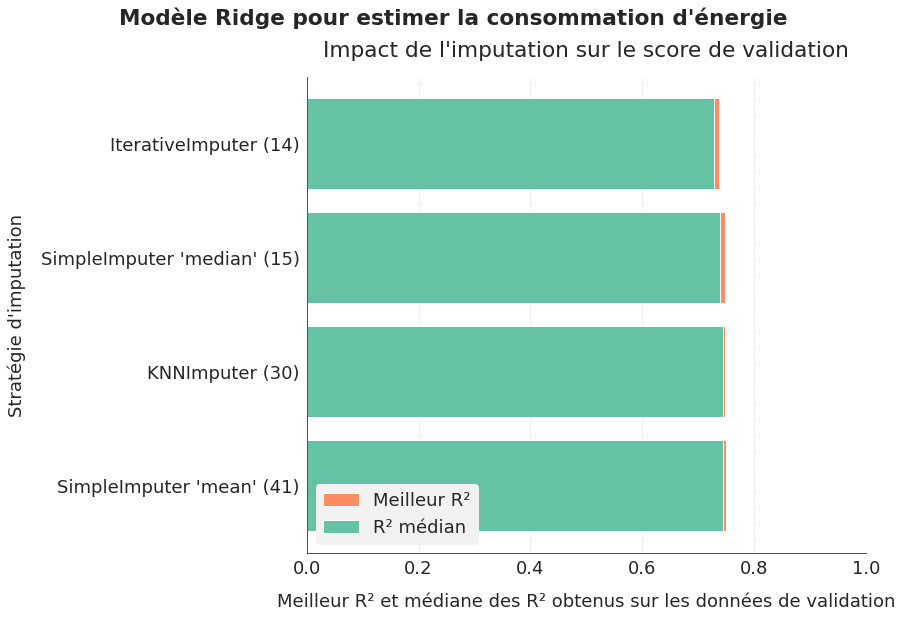

In [ ]:
fig, ax = graph_analyse_imputers(ridge_second_conso, "Ridge", "la consommation d'énergie")
plt.show()

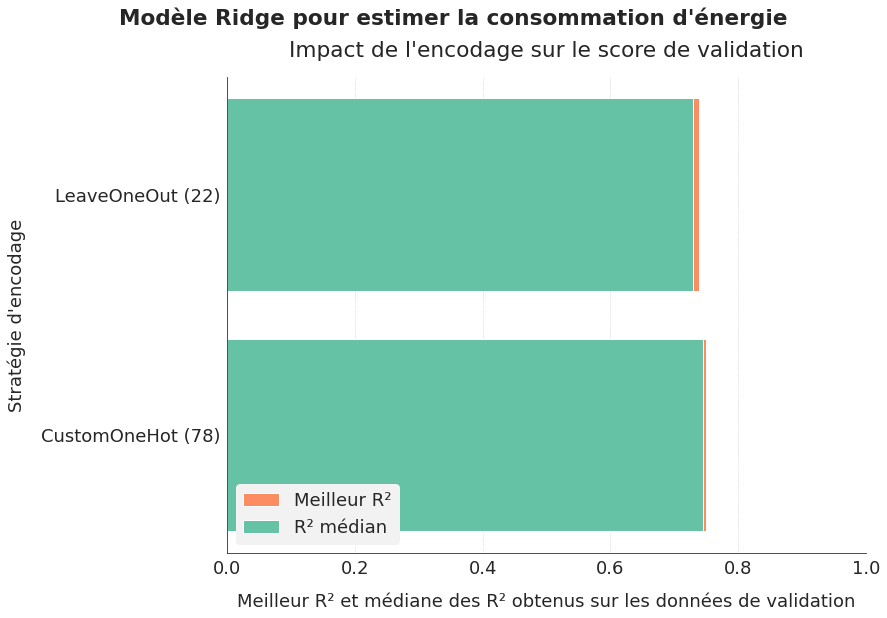

In [ ]:
fig, ax = graph_analyse_encoders(ridge_second_conso, "Ridge", "la consommation d'énergie")
plt.show()

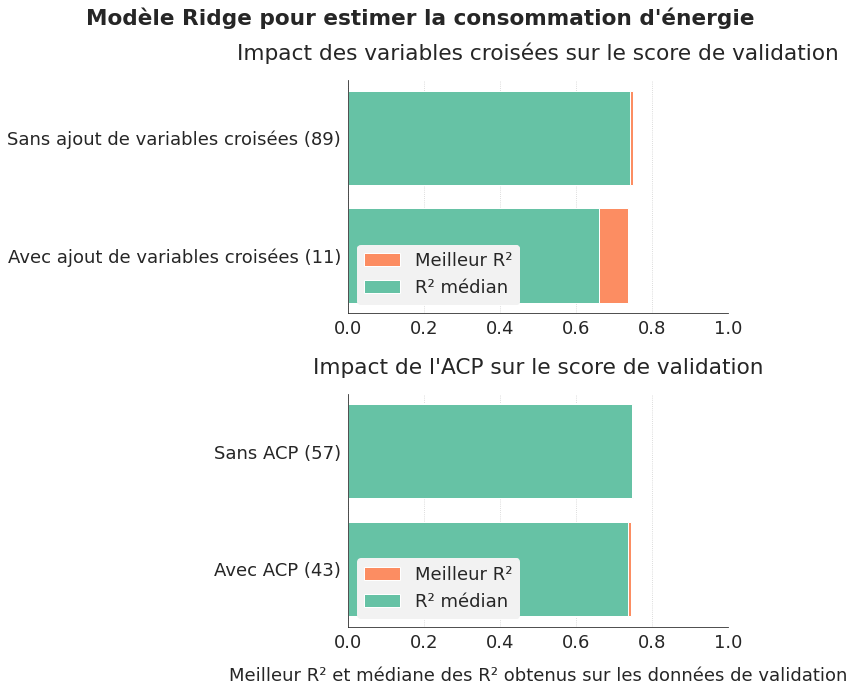

In [ ]:
fig, ax = graph_analyse_others(ridge_second_conso, "Ridge", "la consommation d'énergie")
plt.show()

**Linear Regression**

In [ ]:
lr_second_conso = gen_df_analyse('hyperopt_second_conso_linear_reg.csv')
lr_second_conso = calculate_corrected_score(lr_second_conso)
lr_second_conso[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
7,0.740773,0.776211,SimpleImputer,'median',CustomOneHot,False,"PCA(copy=True, iterated_power='auto', n_compon..."
20,0.740773,0.776211,SimpleImputer,'median',CustomOneHot,False,"PCA(copy=True, iterated_power='auto', n_compon..."
21,0.740773,0.776211,SimpleImputer,'median',CustomOneHot,False,"PCA(copy=True, iterated_power='auto', n_compon..."
22,0.740773,0.776211,SimpleImputer,'median',CustomOneHot,False,"PCA(copy=True, iterated_power='auto', n_compon..."
23,0.740773,0.776211,SimpleImputer,'median',CustomOneHot,False,"PCA(copy=True, iterated_power='auto', n_compon..."


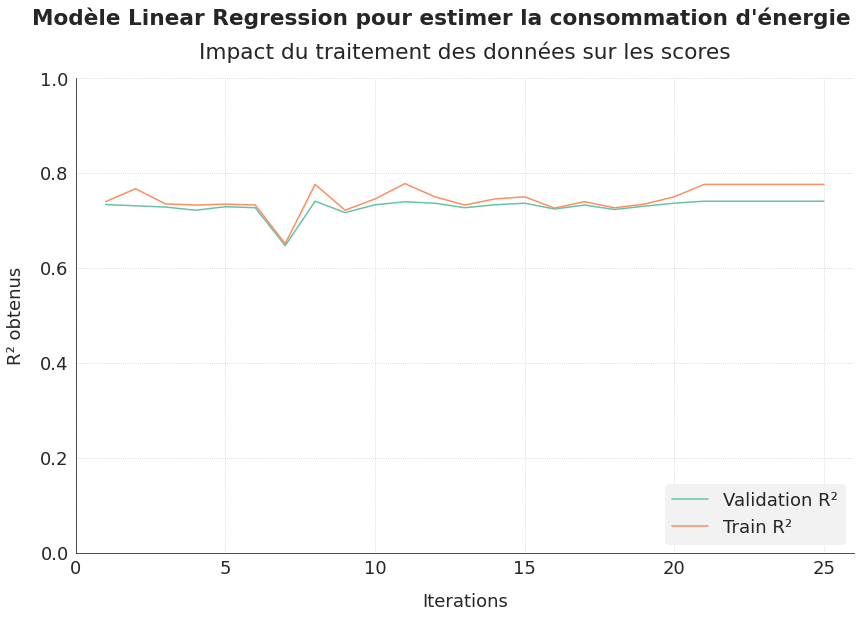

In [ ]:
fig, ax = graph_analyse_score(lr_second_conso, "Linear Regression", "la consommation d'énergie", nb_iterations=25)
plt.show()

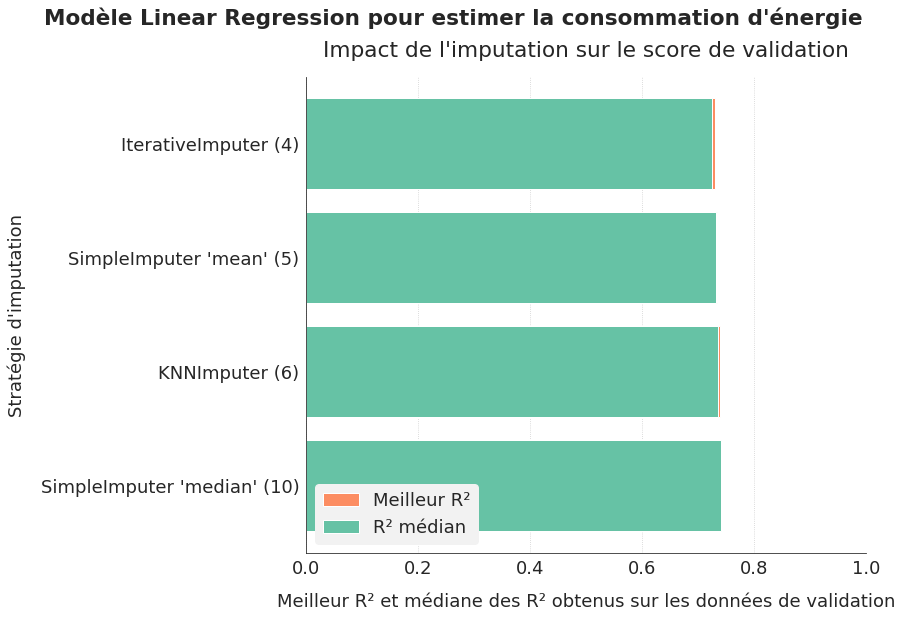

In [ ]:
fig, ax = graph_analyse_imputers(lr_second_conso, "Linear Regression", "la consommation d'énergie")
plt.show()

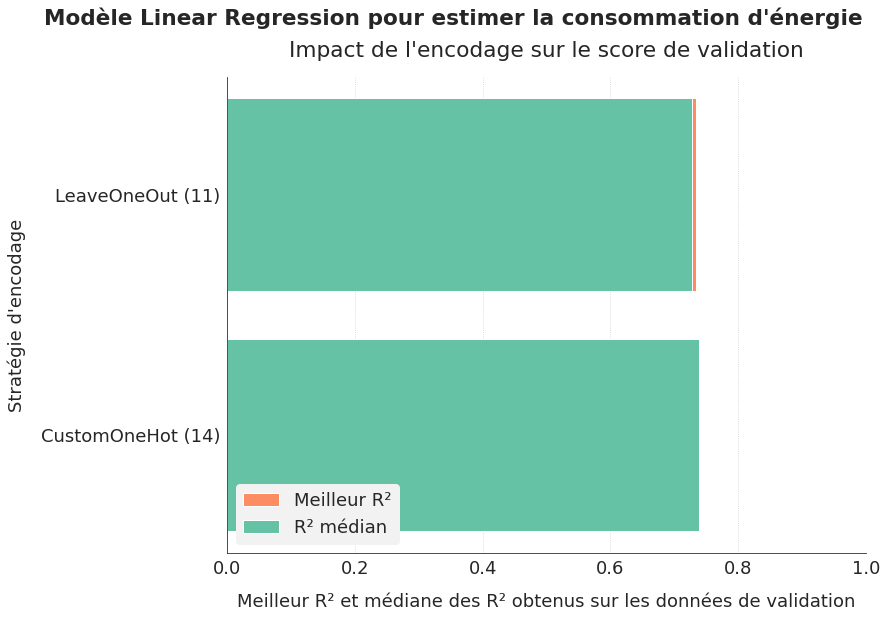

In [ ]:
fig, ax = graph_analyse_encoders(lr_second_conso, "Linear Regression", "la consommation d'énergie")
plt.show()

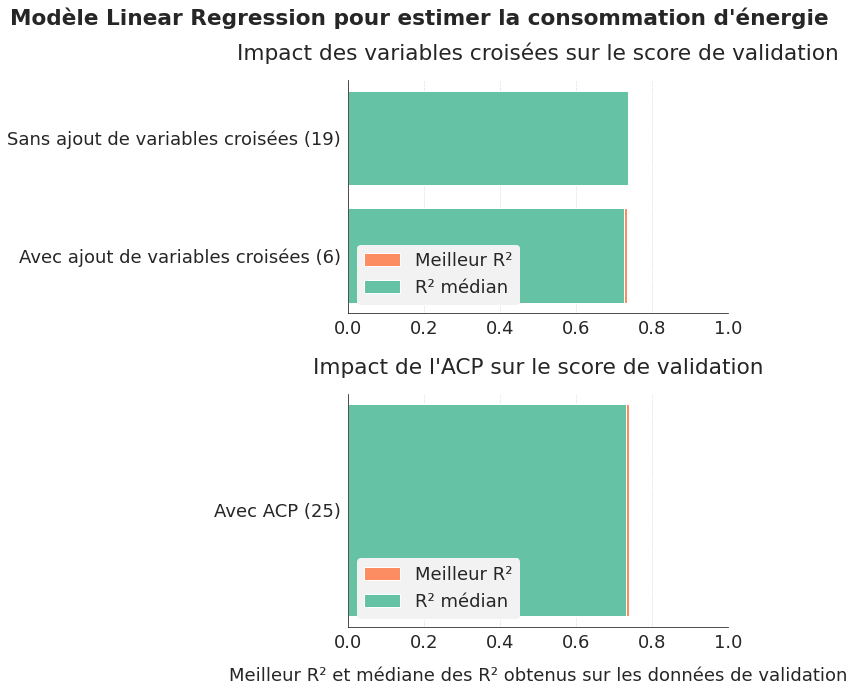

In [ ]:
fig, ax = graph_analyse_others(lr_second_conso, "Linear Regression", "la consommation d'énergie")
plt.show()

**Random Forest**

In [ ]:
rf_second_conso = gen_df_analyse('hyperopt_second_conso_randomforest_reg.csv')
rf_second_conso = calculate_corrected_score(rf_second_conso)
rf_second_conso[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
126,0.740147,0.932451,SimpleImputer,'mean',LeaveOneOut,False,None
146,0.740147,0.932451,SimpleImputer,'mean',LeaveOneOut,False,None
148,0.740147,0.932451,SimpleImputer,'mean',LeaveOneOut,False,None
149,0.740147,0.932451,SimpleImputer,'mean',LeaveOneOut,False,None
150,0.740147,0.932451,SimpleImputer,'mean',LeaveOneOut,False,None


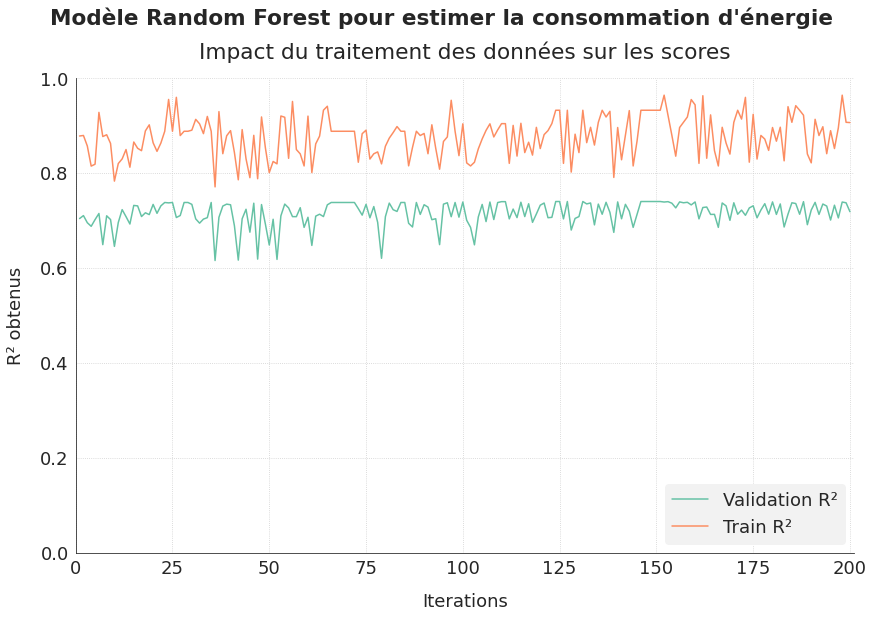

In [ ]:
fig, ax = graph_analyse_score(rf_second_conso, "Random Forest", "la consommation d'énergie", nb_iterations=200)
plt.show()

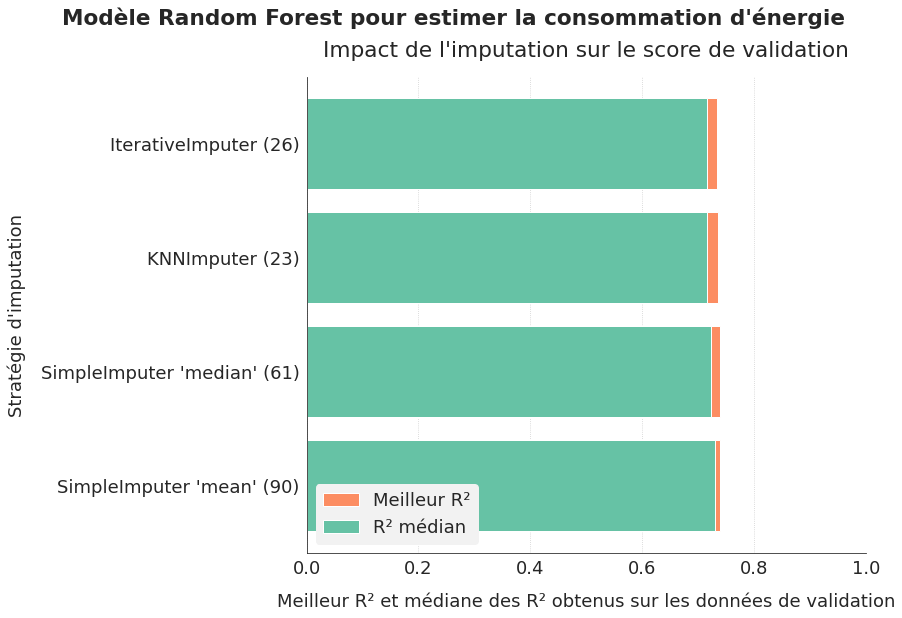

In [ ]:
fig, ax = graph_analyse_imputers(rf_second_conso, "Random Forest", "la consommation d'énergie")
plt.show()

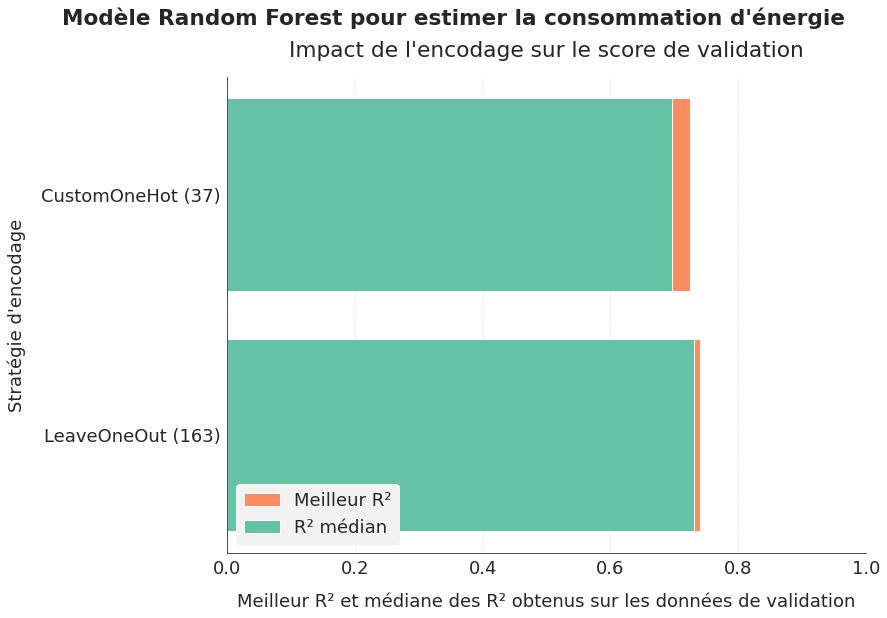

In [ ]:
fig, ax = graph_analyse_encoders(rf_second_conso, "Random Forest", "la consommation d'énergie")
plt.show()

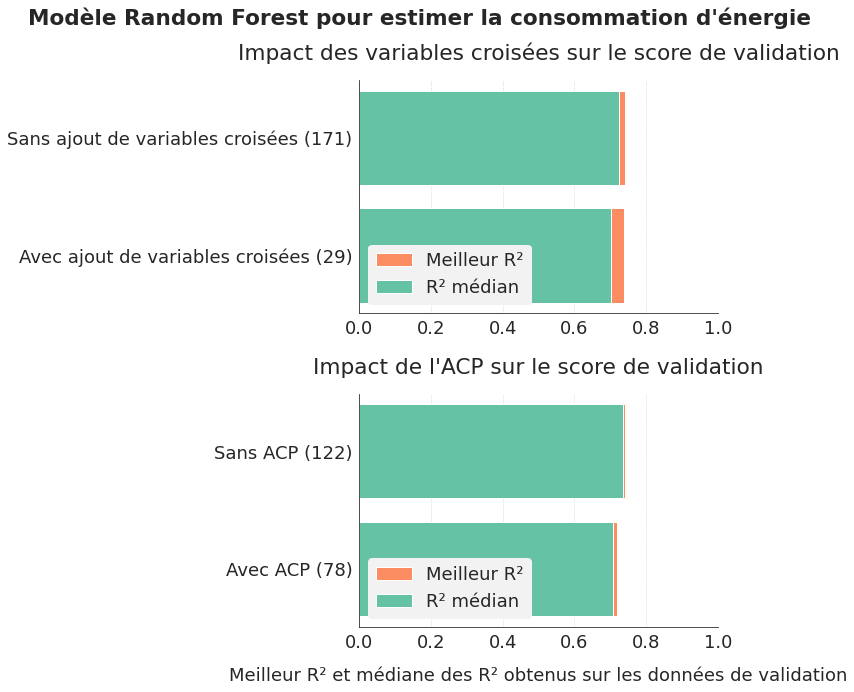

In [ ]:
fig, ax = graph_analyse_others(rf_second_conso, "Random Forest", "la consommation d'énergie")
plt.show()

**ElasticNet**

In [ ]:
en_second_conso = gen_df_analyse('hyperopt_second_conso_elasticnet_reg.csv')
en_second_conso = calculate_corrected_score(en_second_conso)
en_second_conso[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
199,0.724175,0.727854,KNNImputer,,LeaveOneOut,False,None
189,0.723336,0.727024,KNNImputer,,LeaveOneOut,False,None
171,0.720780,0.724647,KNNImputer,,LeaveOneOut,False,"PCA(copy=True, iterated_power='auto', n_compon..."
186,0.717811,0.721731,KNNImputer,,LeaveOneOut,False,None
66,0.717691,0.728220,KNNImputer,,CustomOneHot,False,"PCA(copy=True, iterated_power='auto', n_compon..."


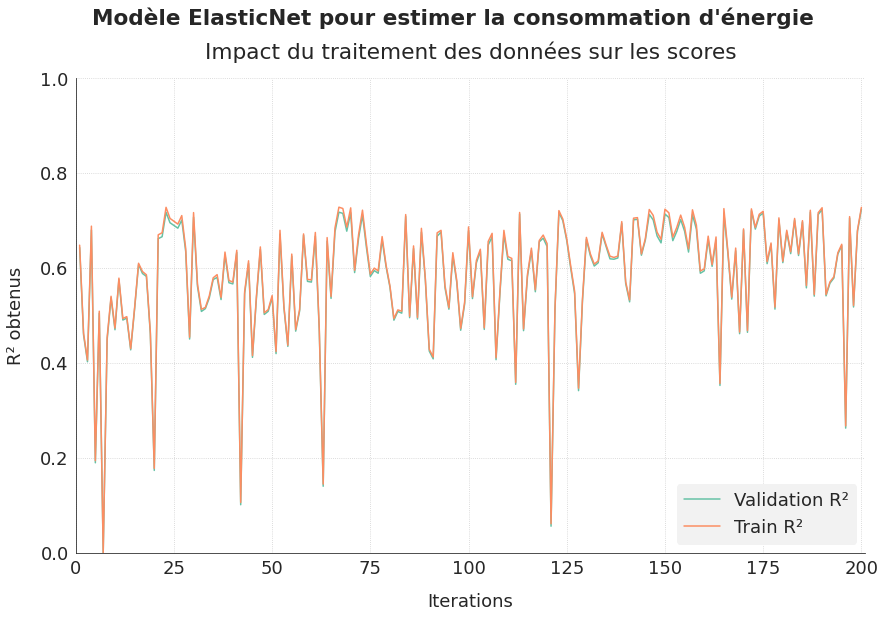

In [ ]:
fig, ax = graph_analyse_score(en_second_conso, "ElasticNet", "la consommation d'énergie", nb_iterations=200)
plt.show()

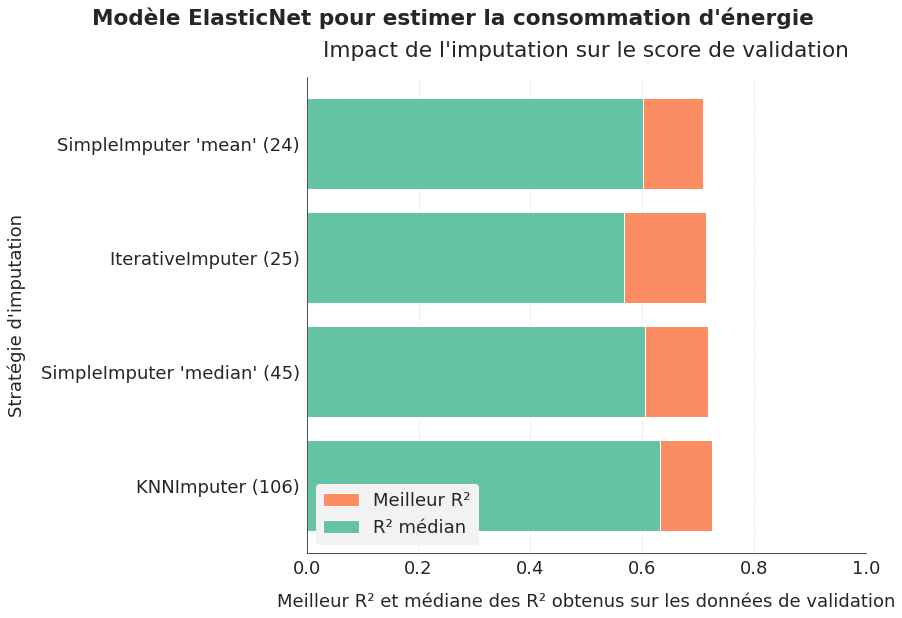

In [ ]:
fig, ax = graph_analyse_imputers(en_second_conso, "ElasticNet", "la consommation d'énergie")
plt.show()

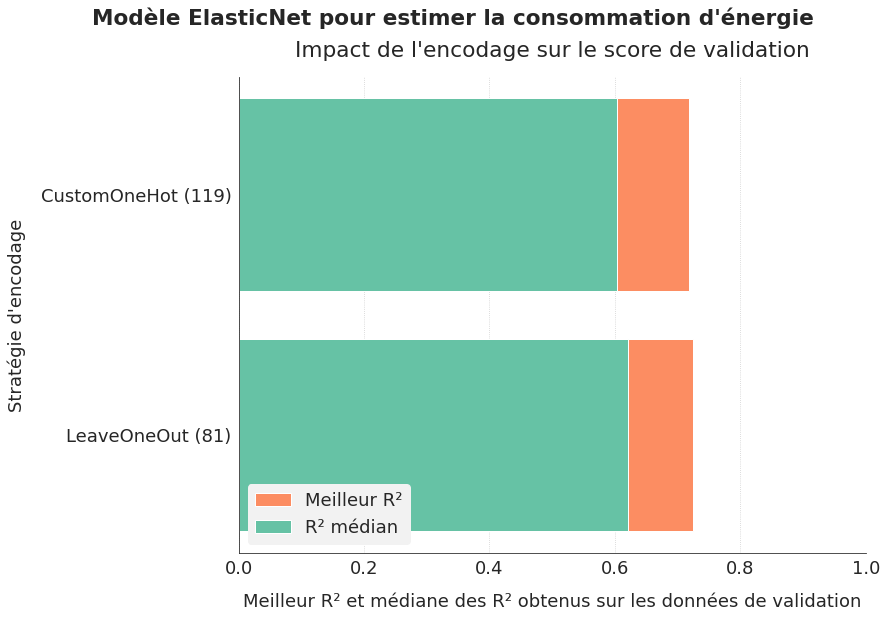

In [ ]:
fig, ax = graph_analyse_encoders(en_second_conso, "ElasticNet", "la consommation d'énergie")
plt.show()

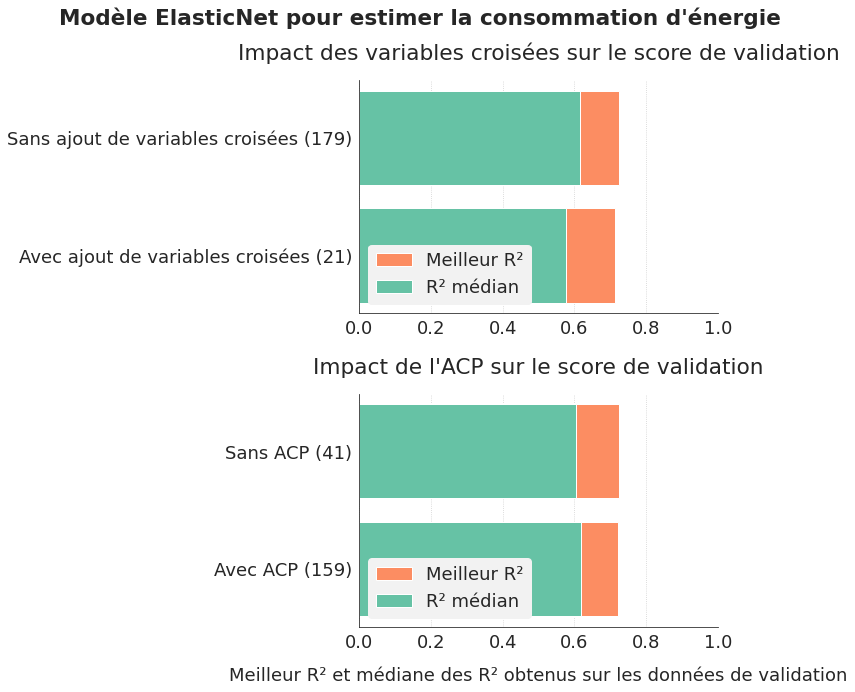

In [ ]:
fig, ax = graph_analyse_others(en_second_conso, "ElasticNet", "la consommation d'énergie")
plt.show()

**Analyse groupée des temps de calcul**

In [ ]:
xgb_second_conso["model"] = "XGBoost"
svm_second_conso["model"] = "SVM"
ext_second_conso["model"] = "Extra Trees"
ridge_second_conso["model"] = "Ridge"
lr_second_conso["model"] = "Linear Regression"
rf_second_conso["model"] = "Random Forest"
en_second_conso["model"] = "Elastic Net"

In [ ]:
second_conso_grouped = pd.concat([xgb_second_conso, svm_second_conso, ext_second_conso, ridge_second_conso, 
                                 lr_second_conso, rf_second_conso, en_second_conso], ignore_index=True)

In [ ]:
second_conso_grouped["corrected_transfo_time"] = calculate_corrected_transfo_time(second_conso_grouped)
second_conso_grouped["corrected_valid_time"] = calculate_corrected_valid_time(second_conso_grouped)

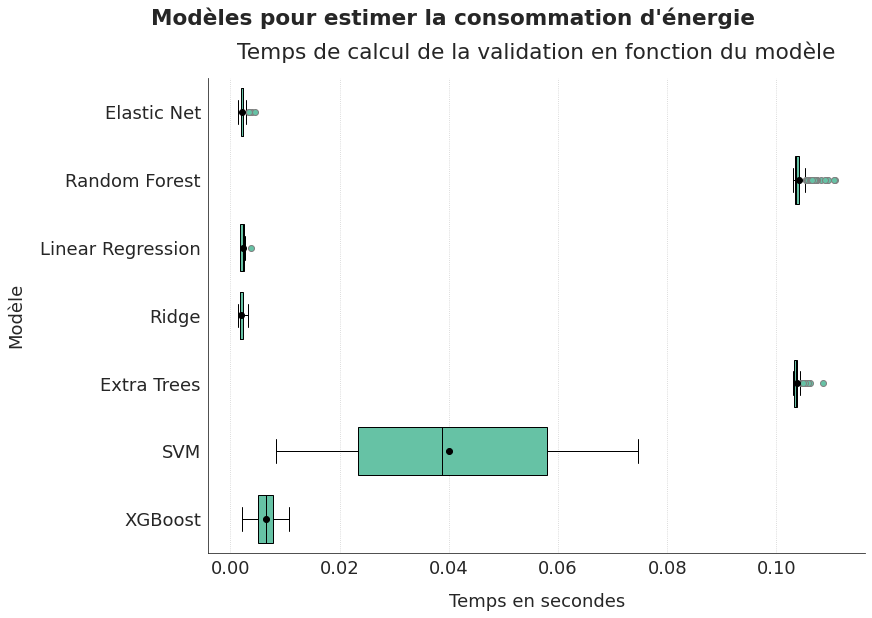

In [ ]:
fig, ax = graph_model_validtime(second_conso_grouped, "la consommation d'énergie")
plt.show()

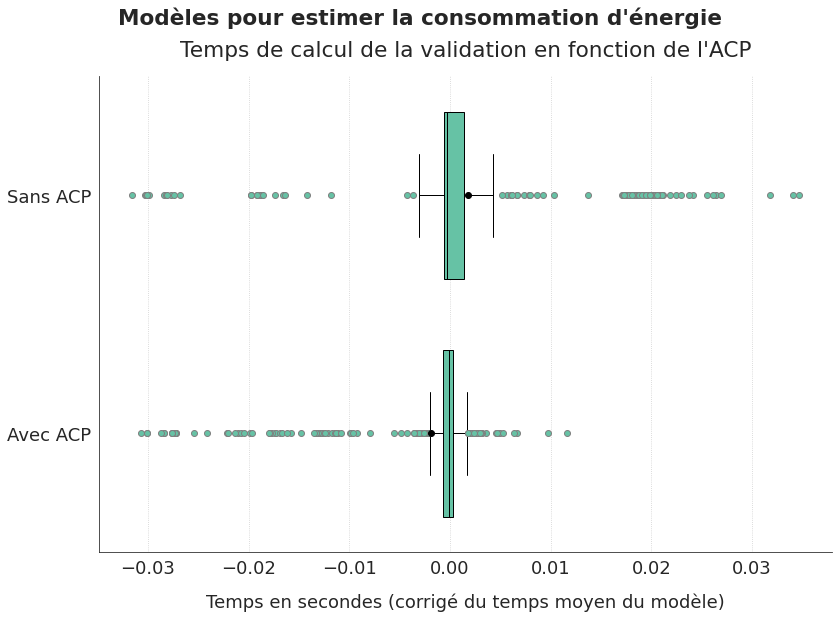

In [ ]:
fig, ax = graph_acp_validtime(second_conso_grouped, "la consommation d'énergie", corrected=True)
plt.show()

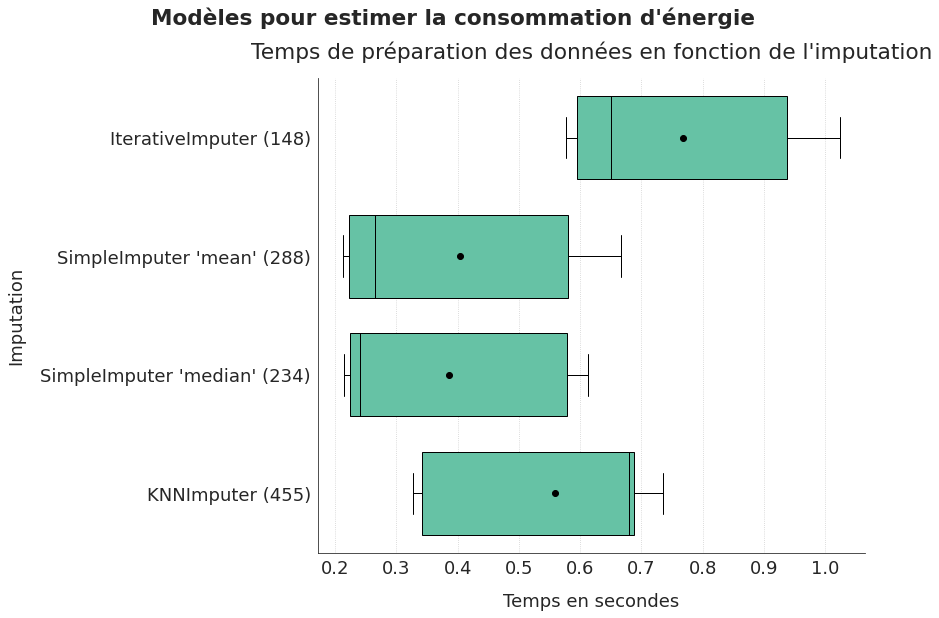

In [ ]:
fig, ax = graph_imputer_preparetime(second_conso_grouped, "la consommation d'énergie")
plt.show()

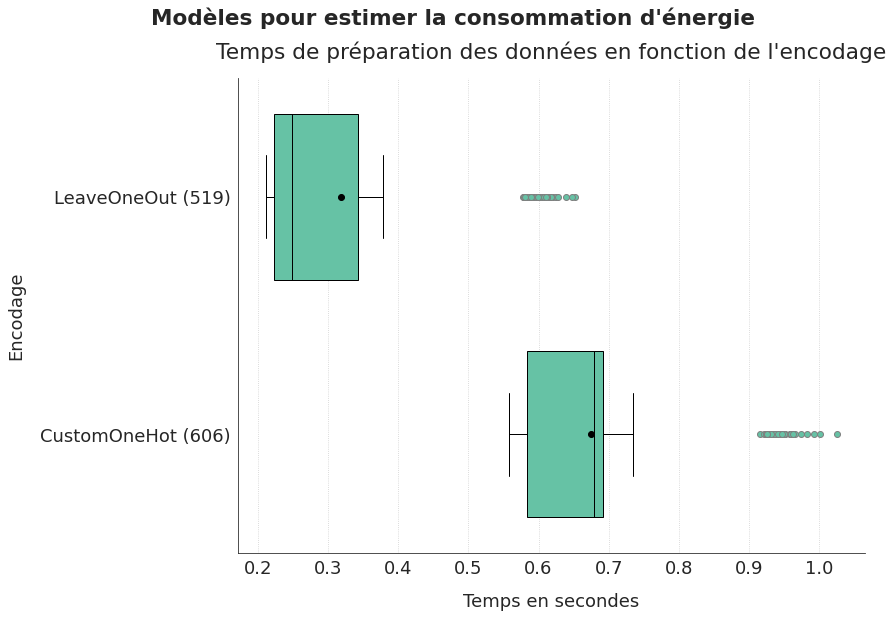

In [ ]:
fig, ax = graph_encoder_preparetime(second_conso_grouped, "la consommation d'énergie")
plt.show()

L'encodage One Hot est légèrement plus long que le LeaveOneOut, sans que la différence de temps ne soit vraiment pénalisante (une demi seconde pour traiter toutes les données d'entraînement).

**A retenir**

Les deux modèles les plus prometteurs sont le XGBoost et le SVM. Ces deux modèles obtiennent leur meilleure performance avec le même traitement des données : imputation par kNN imputer, encodage par One Hot personnalisé, pas d'ajout de variables croisées et pas d'ACP.

In [ ]:
second_conso_best_results.to_csv("conso_second_summary.csv")
second_conso_grouped.to_csv("conso_grouped_second_summary.csv")

---
<a id='4_6'></a>

### 4.6. Optimisation des hyperparamètres sur les deux estimateurs retenus

J'effectue une recherche plus approfondie sur les deux modèles qui ont obtenu les meilleurs score : XGBoost et SVM.

**Définition de la fonction objective et de la fonction d'appel d'hyperopt**

In [ ]:
def objective_conso(params, n_folds=N_FOLDS):
    global ITERATION, OUT_FILE
    ITERATION += 1
    
    params_data = {k:v for (k,v) in params.items() if k.startswith("data")}
    params_data['data_encoders__sk_object'] = params_data['data_case']['encoders']
    params_data['data_scalers__list_name'] = params_data['data_case']['list_name']
    params_data['data_scalers__restrict_cols'] = params_data['data_case']['restrict_cols']
    delcase = params_data.pop("data_case", None)
    conso_pipeline.set_params(**params_data)
    
    params_reg = {k:v for (k,v) in params.items() if k.startswith("data")==False}
    reg_pipeline.set_params(**params_reg)
    
    start_time = timer()
    transformed_data = conso_pipeline.fit_transform(X_train_conso, ln_y_train_conso)
    transformed_data = transformed_data.astype(np.number)
    data_transfo_time = timer() - start_time
    
    myshuffle = KFold(n_splits=n_folds, shuffle=True, random_state=42)
    cv_results = cross_validate(reg_pipeline, transformed_data, ln_y_train_conso, cv=myshuffle, scoring='r2', return_train_score=True, n_jobs=-1)
    
    valid_score = cv_results['test_score']   #r2 between 0 and 1
    if np.any(np.isnan(valid_score)):
        valid_score = np.array([-1.0 for i in range(n_folds)])  # any error in score calculation gives a -1 score
    valid_score_mean = valid_score.mean()
    valid_score_std = valid_score.std()
    
    train_score = cv_results['train_score']   #r2 between 0 and 1
    if np.any(np.isnan(train_score)):
        train_score = np.array([-1.0 for i in range(n_folds)])  # any error in score calculation gives a -1 score
    train_score_mean = train_score.mean()
    train_score_std = train_score.std()

    valid_time = cv_results['score_time']
    if np.any(np.isnan(valid_time)):
        valid_time_mean = 1000
    else:
        valid_time_mean = valid_time.mean()
    
    train_time = cv_results['fit_time']
    if np.any(np.isnan(train_time)):
        train_time_mean = 1000
    else:
        train_time_mean = train_time.mean()

    of_connection = open(OUT_FILE, 'a')  # Write to the csv file ('a' means append)
    writer = csv.writer(of_connection)
    writer.writerow([valid_score_mean, valid_score_std, valid_time_mean, train_score_mean, train_score_std, train_time_mean,
                     data_transfo_time, conso_pipeline['data_imputers'], params_data['data_encoders__sk_object'],
                     reg_pipeline['estimator'], ITERATION])
    of_connection.close()
    
    loss = -valid_score_mean
    return {'loss': loss, 'valid_score_std': valid_score_std, 'valid_time_mean': valid_time_mean,
            'train_score_mean': train_score_mean, 'train_score_std': train_score_std, 'train_time_mean': train_time_mean,
            'data_transfo_time': data_transfo_time, 'params_data': params_data,
            'params_reg': params_reg, 'iteration': ITERATION, 'status': STATUS_OK}

In [ ]:
def run_conso_optimization(n_folds=5, max_evals=100, keep_nresults=10, prefix='final1', estimator_name='xgboost'):
    global OUT_FILE
    OUT_FILE = 'hyperopt_conso_{}_{}.csv'.format(estimator_name, prefix)
    of_connection = open(OUT_FILE, 'w')  # Write the headers to the file
    writer = csv.writer(of_connection)
    writer.writerow(['valid_score_mean', 'valid_score_std', 'valid_time_mean',
                     'train_score_mean', 'train_score_std', 'train_time_mean', 'data_transfo_time',
                     'data_imputer', 'data_encoder', 'estimator', 'iteration'])
    of_connection.close()
    
    global N_FOLDS, ITERATION
    N_FOLDS = n_folds
    ITERATION = 0
    
    trials = Trials()
    
    best_param = fmin(objective_conso, space, algo=tpe.suggest, trials=trials, max_evals=max_evals, rstate=np.random.RandomState(42))
    
    list_losses = [t['result']['loss'] for t in trials.trials]
    idx_min = np.argmin(list_losses)
    if keep_nresults <= 1:
        list_best_results.append(trials.trials[idx_min]['result'])
    else:
        list_idx = np.argsort(list_losses)[:keep_nresults]
        for idx in list_idx:
            list_best_results.append(trials.trials[idx]['result'])
    
    print("Estimateur : {} - Done".format(estimator_name))
    print("Best cross-validation mean score = {}".format(-trials.trials[idx_min]['result']['loss']))
    print("Associated standard deviation = {}".format(trials.trials[idx_min]['result']['valid_score_std']))
    print("Calculation time = {}".format(trials.trials[idx_min]['result']['valid_time_mean']))
    print("Data preparation time = {}".format(trials.trials[idx_min]['result']['data_transfo_time']))
    print("Best cv score obtained after {} iterations".format(trials.trials[idx_min]['result']['iteration']))
    print("")

<a id='4_6_1'></a>

#### 4.6.1. XGBoost : première étape

Pour commencer, je cherche à optimiser le knn imputer en même temps que les hyperparamètres de XGBoost liés à la descente de gradient (objective, n_estimators et learning_rate).

In [ ]:
# conso_pipeline for XGBRegressor
conso_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', AllImputation(KNNImputer(), categ_cols=categ_col, missforest=False)),
    ('data_encoders', FitToPandas(encoder_perso_onehot, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=False, keep_all=False)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler(), transfo_col, 'transfo_num'))
])
reg_pipeline = Pipeline([('estimator', XGBRegressor(n_jobs=-1, random_state=42))])

In [ ]:
space = {
    'data_imputers__sk_object__n_neighbors': hp.choice('data_imputers__sk_object__n_neighbors', np.arange(3, 30, 2, dtype=int)),
    'data_imputers__sk_object__weights': hp.choice('data_imputers__sk_object__weights', ['uniform','distance']),
    'data_case': {'encoders': encoder_perso_onehot,
                  'list_name': transfo_col,
                  'restrict_cols': 'transfo_num'},
    'estimator__objective': hp.choice('estimator__objective', ['reg:squarederror','reg:gamma','reg:tweedie']),
    'estimator__n_estimators': hp.choice('estimator__n_estimators', np.arange(10, 201, 10, dtype=int)),
    'estimator__learning_rate': hp.choice('estimator__learning_rate', np.arange(0.05, 0.31, 0.01))}

In [ ]:
list_best_results = []

In [ ]:
estimator_name = 'xgboost'
step = 'final1a'
run_conso_optimization(max_evals=400, prefix=step, estimator_name=estimator_name)

100%|██████████| 400/400 [15:58<00:00,  2.40s/it, best loss: -0.7632159233546545]
Estimateur : xgboost - Done
Best cross-validation mean score = 0.7632159233546545
Associated standard deviation = 0.02578690698861131
Calculation time = 0.006771278381347656
Data preparation time = 0.7309909660016274
Best cv score obtained after 275 iterations



In [ ]:
xgb_conso_first_stepa = pd.read_csv("hyperopt_conso_xgboost_final1a.csv")
xgb_conso_first_stepa.head()

,valid_score_mean,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,data_transfo_time,data_imputer,data_encoder,estimator,iteration
0,0.756032,0.027873,0.005052,0.870023,0.004658,0.453236,0.678098,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",1
1,0.742980,0.022879,0.006328,0.961288,0.001119,0.881449,0.718638,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",2
2,0.735315,0.026057,0.005804,0.820742,0.004738,0.619143,0.684254,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",3
3,0.746923,0.020854,0.004874,0.875821,0.003207,0.275667,0.719266,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",4
4,0.745218,0.027378,0.004739,0.879548,0.005234,0.299828,0.675613,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",5


In [ ]:
xgb_conso_first_stepa = remove_negative_scores(xgb_conso_first_stepa)
xgb_conso_first_stepa["knn_n_neighbors"] = [np.int(inter[inter.find('n_neighbors')+12:inter.find('weights')-2]) \
                                           for inter in xgb_conso_first_stepa.data_imputer]
xgb_conso_first_stepa["knn_weights"] = [inter[inter.find('weights')+9:-3] \
                                           for inter in xgb_conso_first_stepa.data_imputer]
xgb_conso_first_stepa["encoder"] = [inter[:inter.find('(')] for inter in xgb_conso_first_stepa.data_encoder]
inter_str = [inter[inter.find('objective')+11:] for inter in xgb_conso_first_stepa.estimator]
xgb_conso_first_stepa["xgb_objective"] = [inter[:inter.find(',')-1] for inter in inter_str]
inter_str = [inter[inter.find('n_estimators')+13:] for inter in xgb_conso_first_stepa.estimator]
xgb_conso_first_stepa["xgb_n_estimators"] = [np.int(inter[:inter.find(',')]) for inter in inter_str]
inter_str = [inter[inter.find('learning_rate')+14:] for inter in xgb_conso_first_stepa.estimator]
xgb_conso_first_stepa["xgb_learning_rate"] = [np.around(np.float(inter[:inter.find(',')]),2) for inter in inter_str]
xgb_conso_first_stepa["total_time"] = xgb_conso_first_stepa.valid_time_mean + xgb_conso_first_stepa.data_transfo_time

In [ ]:
xgb_conso_first_stepa[["valid_score_mean","train_score_mean","iteration","knn_n_neighbors","knn_weights","encoder",
                      "xgb_objective","xgb_n_estimators","xgb_learning_rate","total_time"]].\
                    sort_values("valid_score_mean", ascending=False).head(10)

,valid_score_mean,train_score_mean,iteration,knn_n_neighbors,knn_weights,encoder,xgb_objective,xgb_n_estimators,xgb_learning_rate,total_time
274,0.763216,0.892178,275,29,distance,CustomOneHotEncoder,reg:squarederror,160,0.14,0.737762
313,0.763215,0.899075,314,29,distance,CustomOneHotEncoder,reg:squarederror,180,0.14,0.681561
262,0.763215,0.899075,263,29,distance,CustomOneHotEncoder,reg:squarederror,180,0.14,0.694480
230,0.763215,0.899075,231,29,distance,CustomOneHotEncoder,reg:squarederror,180,0.14,0.696754
320,0.763215,0.899075,321,29,distance,CustomOneHotEncoder,reg:squarederror,180,0.14,0.686514
226,0.763215,0.899075,227,29,distance,CustomOneHotEncoder,reg:squarederror,180,0.14,0.689350
232,0.763215,0.899075,233,29,distance,CustomOneHotEncoder,reg:squarederror,180,0.14,0.701257
261,0.763215,0.899075,262,29,distance,CustomOneHotEncoder,reg:squarederror,180,0.14,0.698344
260,0.763215,0.899075,261,29,distance,CustomOneHotEncoder,reg:squarederror,180,0.14,0.690067
224,0.763215,0.899075,225,29,distance,CustomOneHotEncoder,reg:squarederror,180,0.14,0.698648


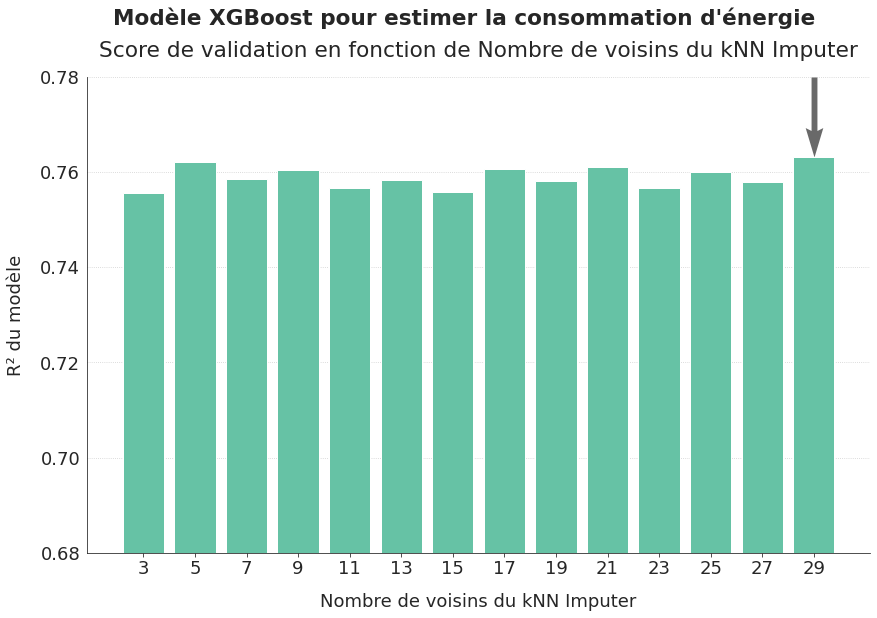

In [ ]:
fig, ax = graph_modele_score(xgb_conso_first_stepa, "knn_n_neighbors", "XGBoost", "Nombre de voisins du kNN Imputer", 
                             "la consommation d'énergie", ymin=0.68, ymax=0.78)
plt.show()

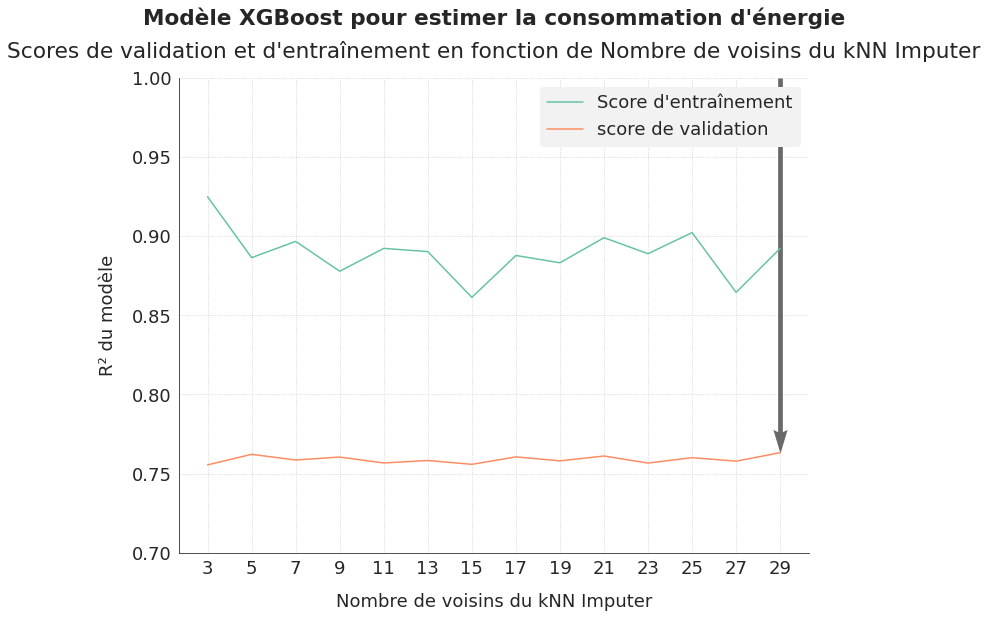

In [ ]:
fig, ax = graph_compar_train_valid(xgb_conso_first_stepa, "knn_n_neighbors", "XGBoost", "Nombre de voisins du kNN Imputer",
                                   "la consommation d'énergie", ymin=0.7, rotation=0)
plt.show()

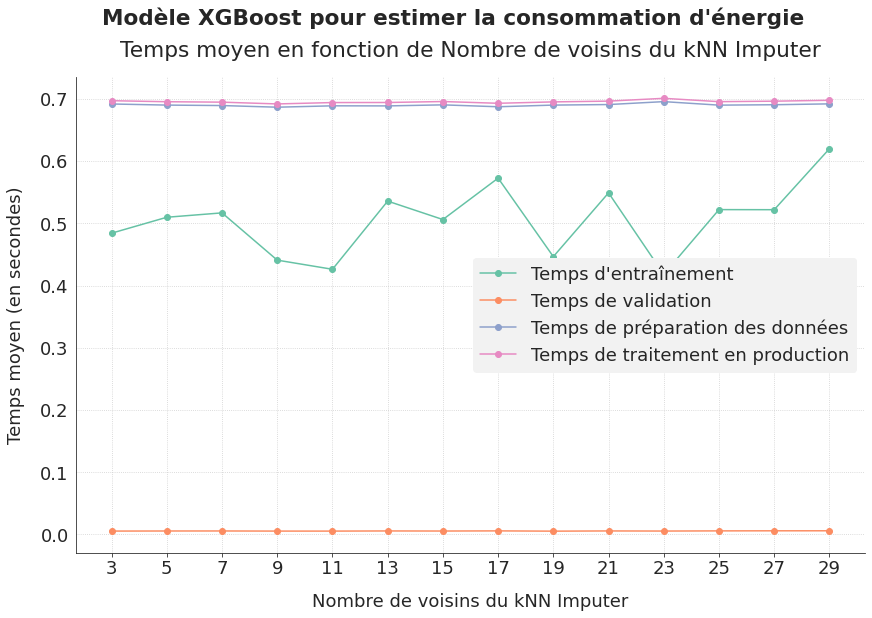

In [ ]:
fig, ax = graph_modele_time(xgb_conso_first_stepa, "knn_n_neighbors", "XGBoost", "Nombre de voisins du kNN Imputer",
                           "la consommation d'énergie")
plt.show()

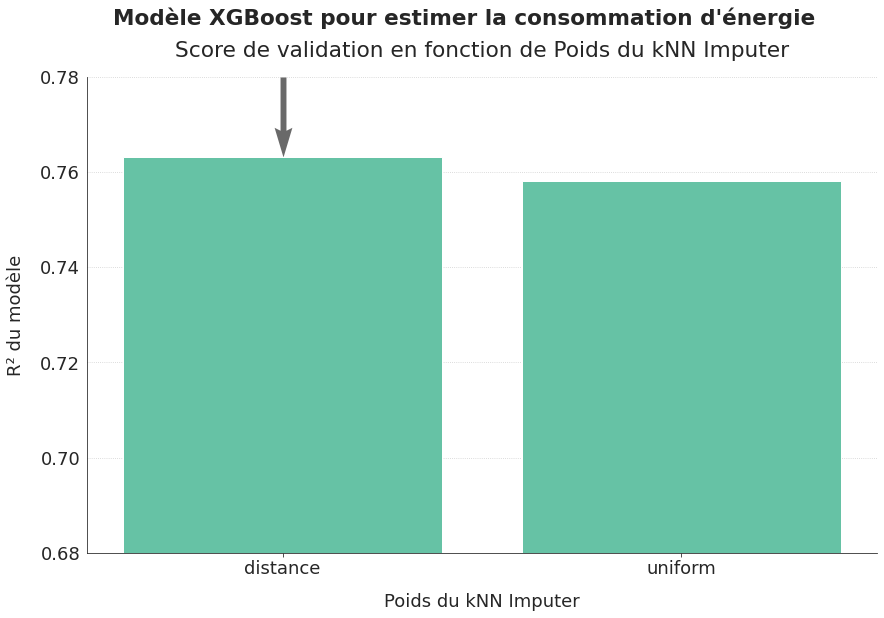

In [ ]:
fig, ax = graph_modele_score(xgb_conso_first_stepa, "knn_weights", "XGBoost", "Poids du kNN Imputer",
                             "la consommation d'énergie", ymin=0.68, ymax=0.78)
plt.show()

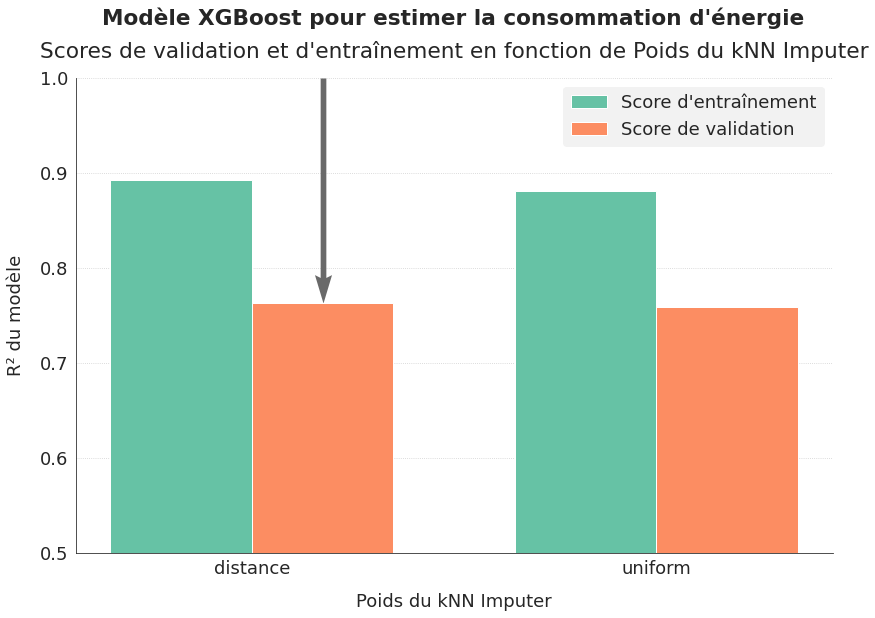

In [ ]:
fig, ax = graph_compar_train_valid(xgb_conso_first_stepa, "knn_weights", "XGBoost", "Poids du kNN Imputer",
                                   "la consommation d'énergie", rotation=0, with_bars=True)
plt.show()

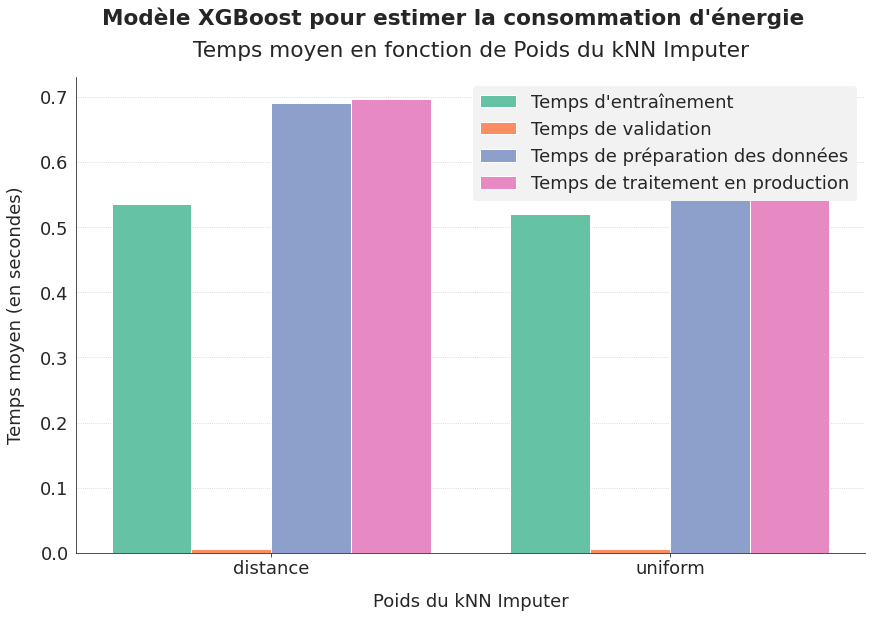

In [ ]:
fig, ax = graph_modele_time(xgb_conso_first_stepa, "knn_weights", "XGBoost", "Poids du kNN Imputer",
                           "la consommation d'énergie", with_bars=True)
plt.show()

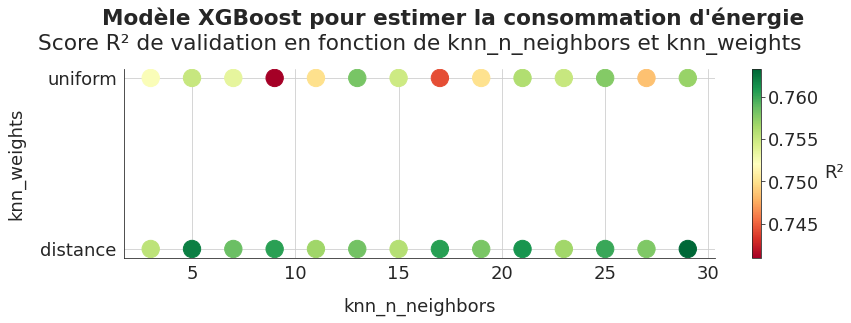

In [ ]:
fig, ax = graph_cross_score(xgb_conso_first_stepa, "knn_n_neighbors", "knn_weights", "XGBoost",
                            "la consommation d'énergie", size=300, figsize=(12,4))

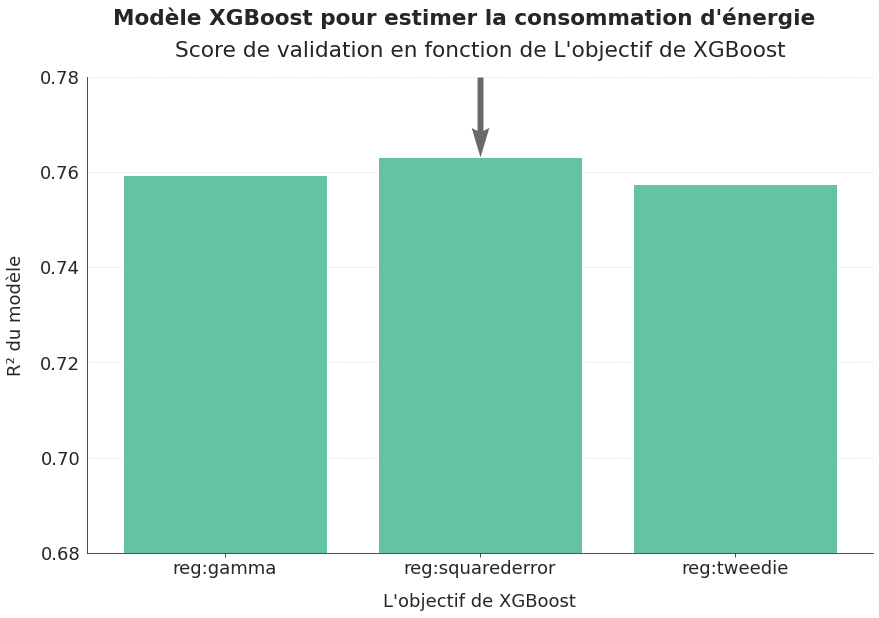

In [ ]:
fig, ax = graph_modele_score(xgb_conso_first_stepa, "xgb_objective", "XGBoost", "L'objectif de XGBoost",
                             "la consommation d'énergie", ymin=0.68, ymax=0.78)
plt.show()

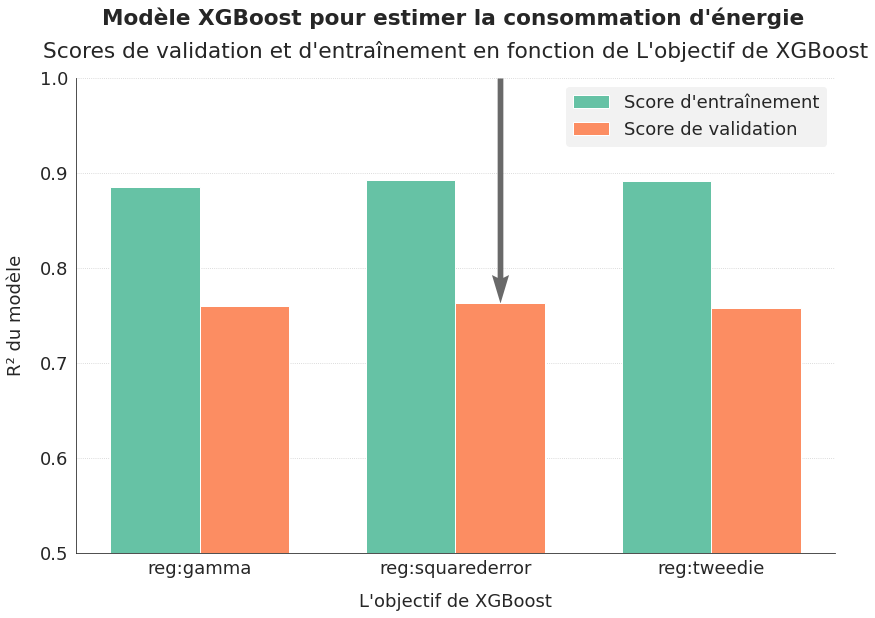

In [ ]:
fig, ax = graph_compar_train_valid(xgb_conso_first_stepa, "xgb_objective", "XGBoost", "L'objectif de XGBoost", 
                                   "la consommation d'énergie", rotation=0, with_bars=True)
plt.show()

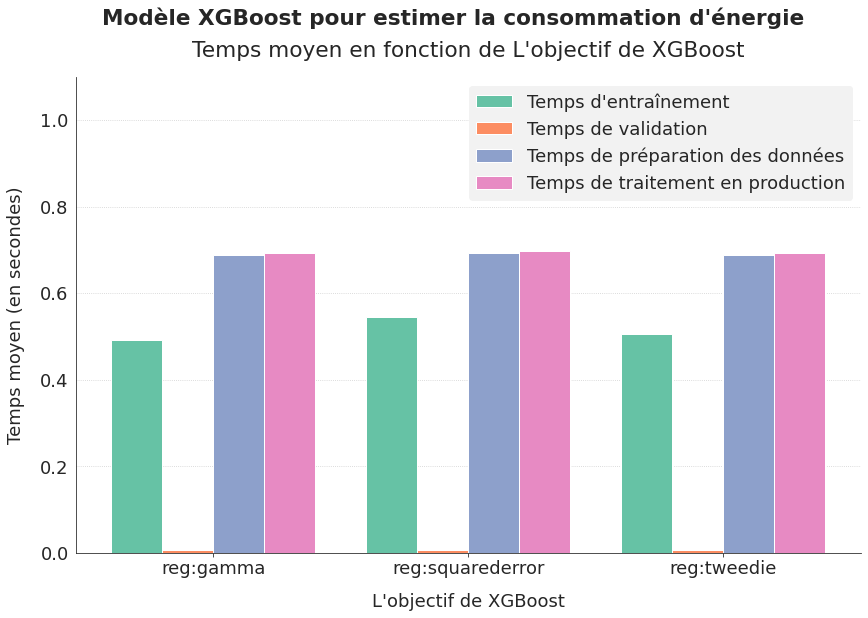

In [ ]:
fig, ax = graph_modele_time(xgb_conso_first_stepa, "xgb_objective", "XGBoost", "L'objectif de XGBoost", 
                           "la consommation d'énergie", ymax=1.1, with_bars=True)
plt.show()

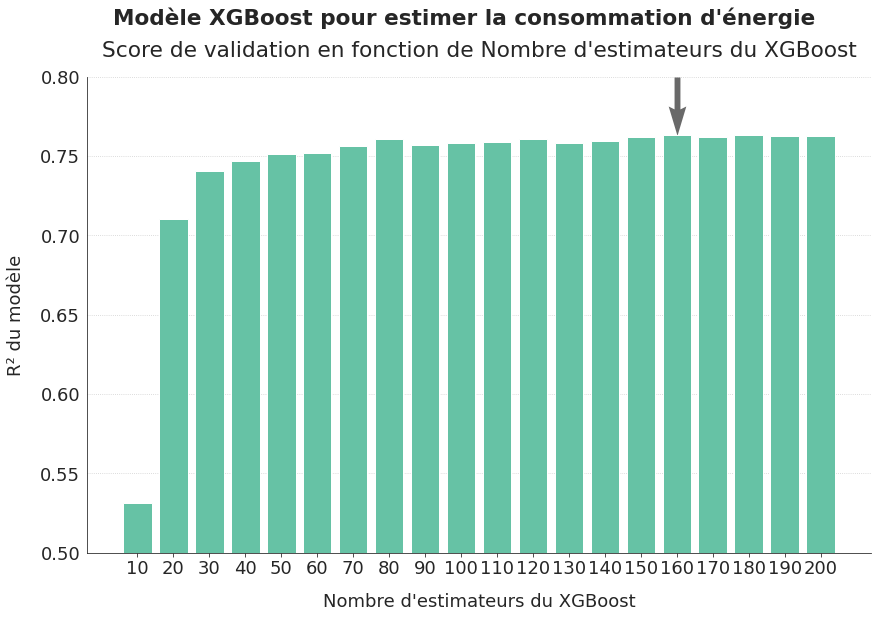

In [ ]:
fig, ax = graph_modele_score(xgb_conso_first_stepa, "xgb_n_estimators", "XGBoost", "Nombre d'estimateurs du XGBoost",
                             "la consommation d'énergie", ymin=0.50, ymax=0.8)
plt.show()

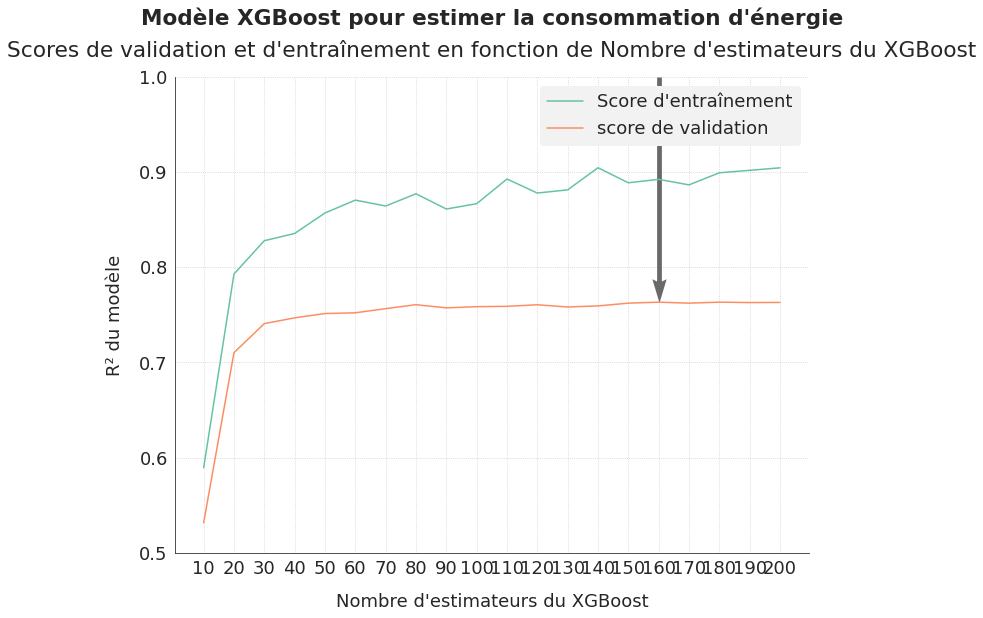

In [ ]:
fig, ax = graph_compar_train_valid(xgb_conso_first_stepa, "xgb_n_estimators", "XGBoost", "Nombre d'estimateurs du XGBoost", 
                                   "la consommation d'énergie", ymin=0.5, rotation=0)
plt.show()

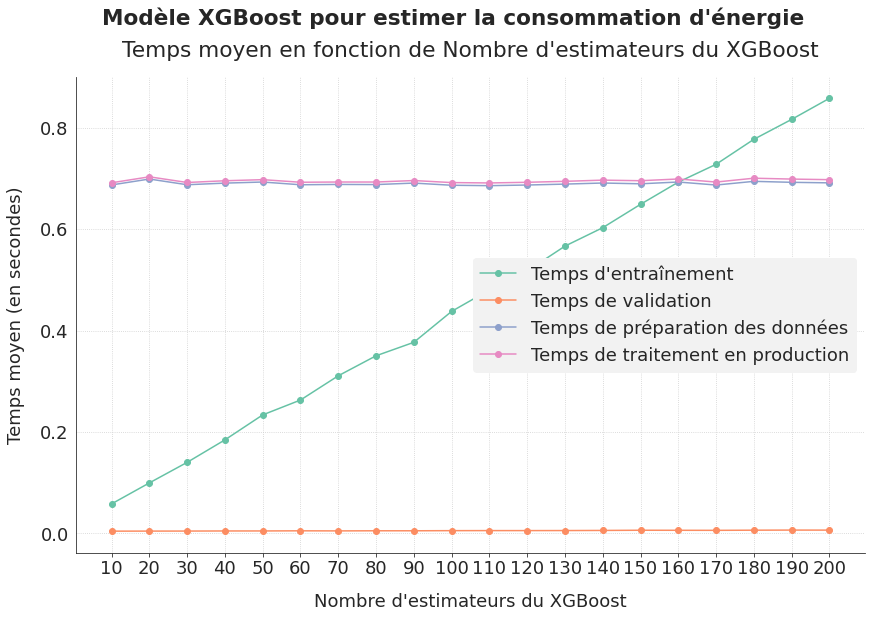

In [ ]:
fig, ax = graph_modele_time(xgb_conso_first_stepa, "xgb_n_estimators", "XGBoost", "Nombre d'estimateurs du XGBoost",
                           "la consommation d'énergie")
plt.show()

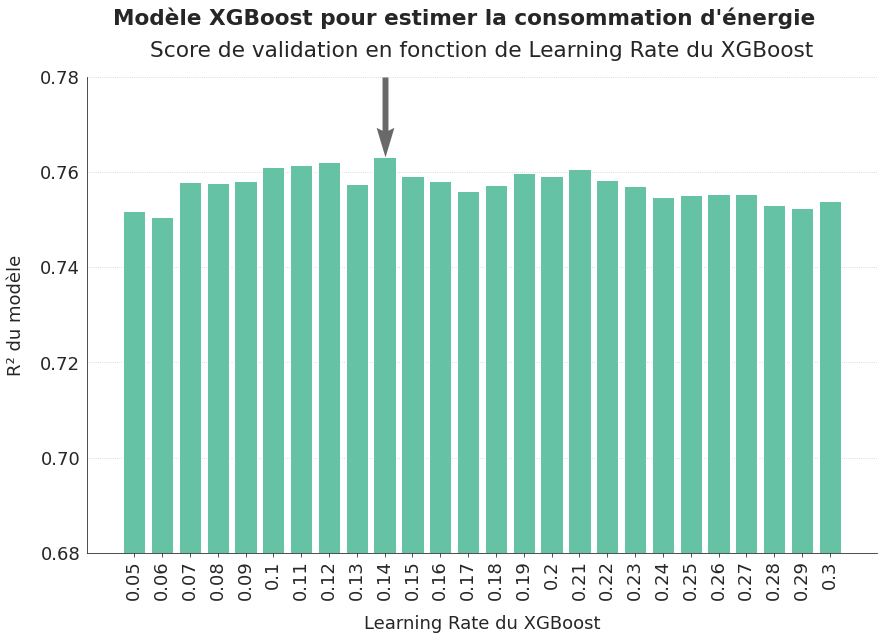

In [ ]:
fig, ax = graph_modele_score(xgb_conso_first_stepa, "xgb_learning_rate", "XGBoost", "Learning Rate du XGBoost",
                             "la consommation d'énergie", ymin=0.68, ymax=0.78, rotation=90)
plt.show()

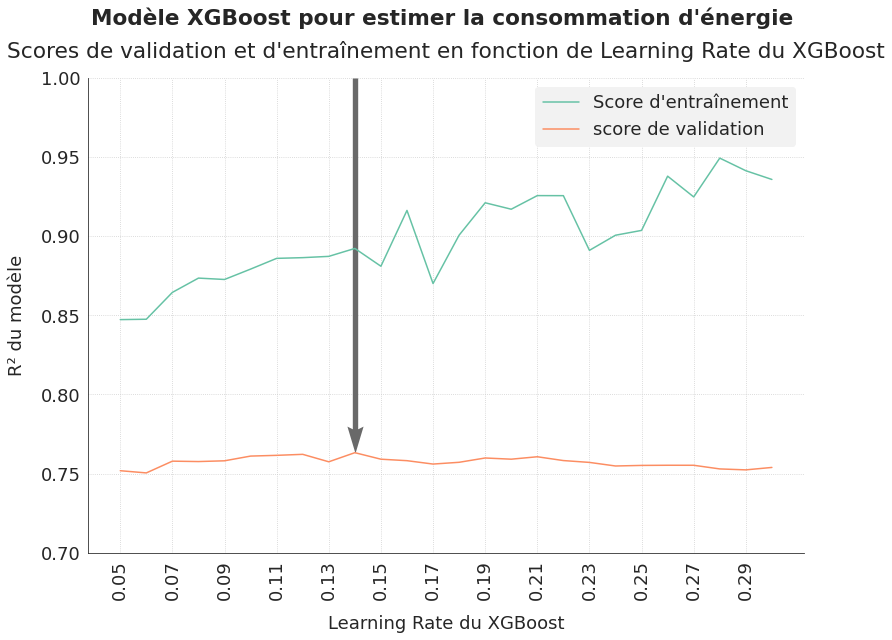

In [ ]:
fig, ax = graph_compar_train_valid(xgb_conso_first_stepa, "xgb_learning_rate", "XGBoost", "Learning Rate du XGBoost", 
                                   "la consommation d'énergie", ymin=0.7, tick_step=2, rotation=90)
plt.show()

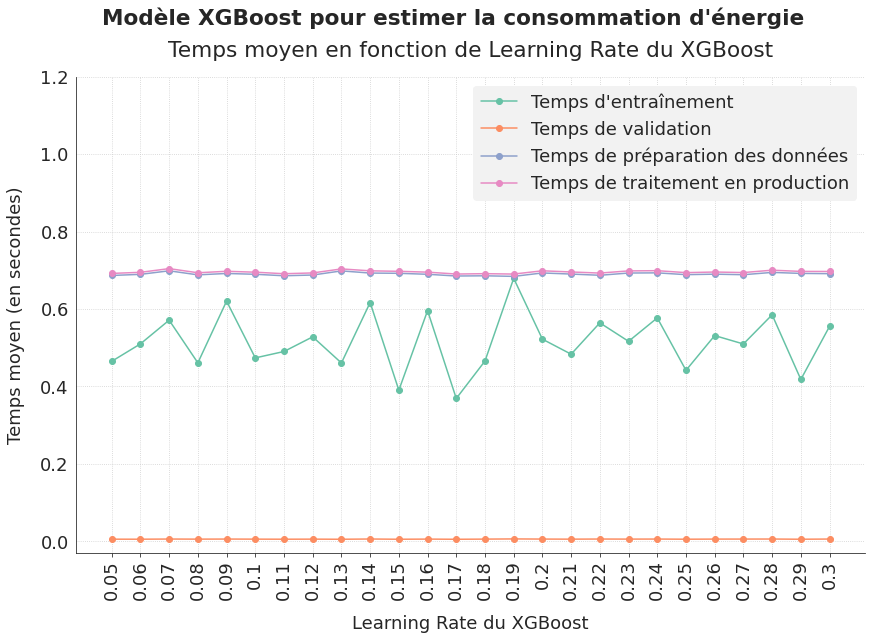

In [ ]:
fig, ax = graph_modele_time(xgb_conso_first_stepa, "xgb_learning_rate", "XGBoost", "Learning Rate du XGBoost", 
                           "la consommation d'énergie", ymax=1.2, rotation=90)
plt.show()

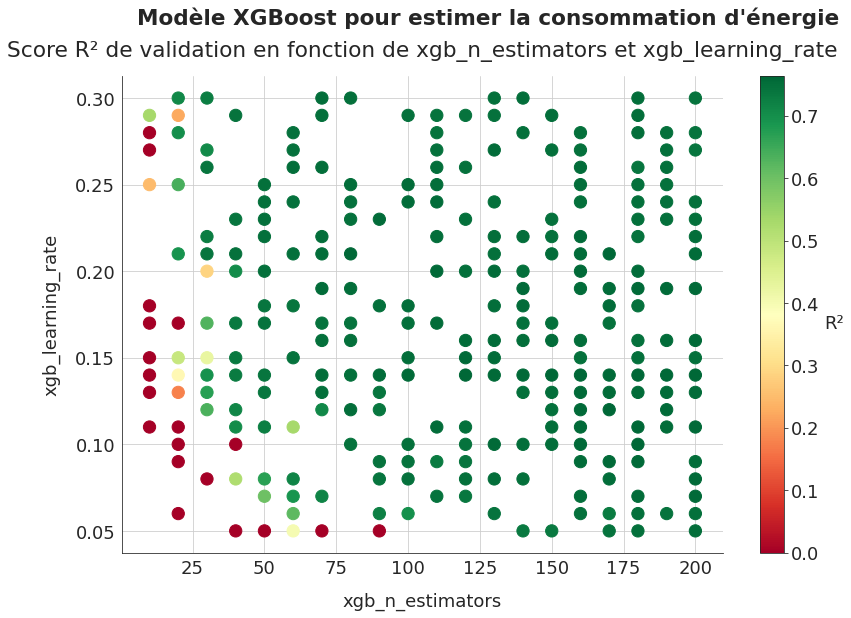

In [ ]:
fig, ax = graph_cross_score(xgb_conso_first_stepa, "xgb_n_estimators", "xgb_learning_rate", "XGBoost",
                            "la consommation d'énergie", size=150)

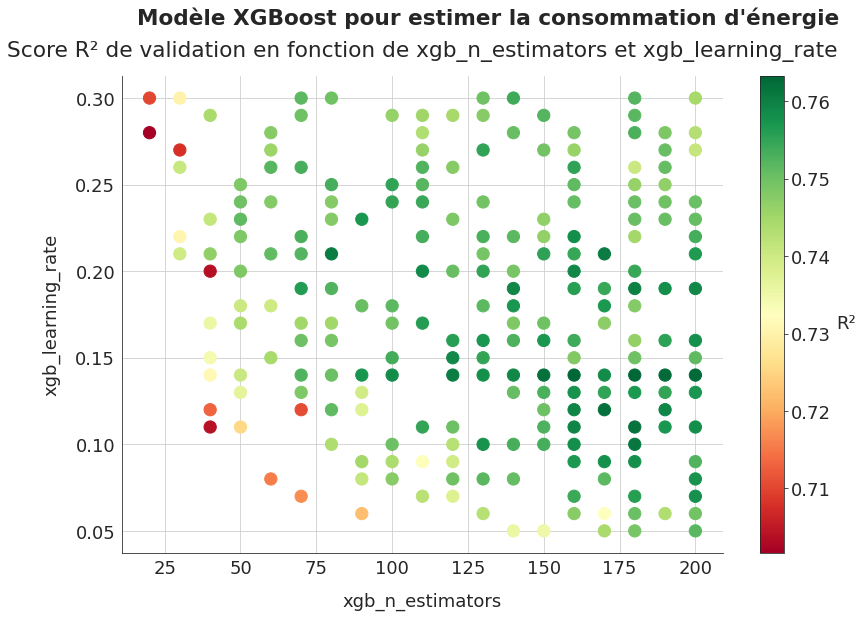

In [ ]:
fig, ax = graph_cross_score(xgb_conso_first_stepa, "xgb_n_estimators", "xgb_learning_rate", "XGBoost",
                            "la consommation d'énergie", size=150, vmin=0.7)

Je recommence en élargissant les possibilités pour le nombre de voisins du knn Imputer, car mon optimum est sur le maximum de mon intervalle de recherche.

In [ ]:
# conso_pipeline for XGBRegressor
conso_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', AllImputation(KNNImputer(), categ_cols=categ_col, missforest=False)),
    ('data_encoders', FitToPandas(encoder_perso_onehot, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=False, keep_all=False)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler(), transfo_col, 'transfo_num'))
])
reg_pipeline = Pipeline([('estimator', XGBRegressor(n_jobs=-1, random_state=42))])

In [ ]:
space = {
    'data_imputers__sk_object__n_neighbors': hp.choice('data_imputers__sk_object__n_neighbors', np.arange(3, 40, 2, dtype=int)),
    'data_imputers__sk_object__weights': hp.choice('data_imputers__sk_object__weights', ['uniform','distance']),
    'data_case': {'encoders': encoder_perso_onehot,
                  'list_name': transfo_col,
                  'restrict_cols': 'transfo_num'},
    'estimator__objective': hp.choice('estimator__objective', ['reg:squarederror','reg:gamma','reg:tweedie']),
    'estimator__n_estimators': hp.choice('estimator__n_estimators', np.arange(10, 201, 10, dtype=int)),
    'estimator__learning_rate': hp.choice('estimator__learning_rate', np.arange(0.05, 0.31, 0.01))}

In [ ]:
list_best_results = []

In [ ]:
estimator_name = 'xgboost'
step = 'final1b'
run_conso_optimization(max_evals=400, prefix=step, estimator_name=estimator_name)

100%|██████████| 400/400 [15:39<00:00,  2.35s/it, best loss: -0.7663516180784389]
Estimateur : xgboost - Done
Best cross-validation mean score = 0.7663516180784389
Associated standard deviation = 0.020513570940864895
Calculation time = 0.005966901779174805
Data preparation time = 0.6757576580002933
Best cv score obtained after 150 iterations



In [ ]:
xgb_conso_first_stepb = pd.read_csv("hyperopt_conso_xgboost_final1b.csv")
xgb_conso_first_stepb.head()

,valid_score_mean,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,data_transfo_time,data_imputer,data_encoder,estimator,iteration
0,0.756032,0.027873,0.005046,0.870023,0.004658,0.454294,0.701723,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",1
1,0.735385,0.029138,0.006643,0.959671,0.003688,0.882478,0.685893,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",2
2,0.735315,0.026057,0.006474,0.820742,0.004738,0.634356,0.690965,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",3
3,0.746923,0.020854,0.005691,0.875821,0.003207,0.271299,0.689288,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",4
4,0.745218,0.027378,0.004730,0.879548,0.005234,0.301208,0.701856,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",5


In [ ]:
xgb_conso_first_stepb = remove_negative_scores(xgb_conso_first_stepb)
xgb_conso_first_stepb["knn_n_neighbors"] = [np.int(inter[inter.find('n_neighbors')+12:inter.find('weights')-2]) \
                                           for inter in xgb_conso_first_stepb.data_imputer]
xgb_conso_first_stepb["knn_weights"] = [inter[inter.find('weights')+9:-3] \
                                           for inter in xgb_conso_first_stepb.data_imputer]
xgb_conso_first_stepb["encoder"] = [inter[:inter.find('(')] for inter in xgb_conso_first_stepb.data_encoder]
inter_str = [inter[inter.find('objective')+11:] for inter in xgb_conso_first_stepb.estimator]
xgb_conso_first_stepb["xgb_objective"] = [inter[:inter.find(',')-1] for inter in inter_str]
inter_str = [inter[inter.find('n_estimators')+13:] for inter in xgb_conso_first_stepb.estimator]
xgb_conso_first_stepb["xgb_n_estimators"] = [np.int(inter[:inter.find(',')]) for inter in inter_str]
inter_str = [inter[inter.find('learning_rate')+14:] for inter in xgb_conso_first_stepb.estimator]
xgb_conso_first_stepb["xgb_learning_rate"] = [np.around(np.float(inter[:inter.find(',')]),2) for inter in inter_str]
xgb_conso_first_stepb["total_time"] = xgb_conso_first_stepb.valid_time_mean + xgb_conso_first_stepb.data_transfo_time

In [ ]:
xgb_conso_first_stepb[["valid_score_mean","train_score_mean","iteration","knn_n_neighbors","knn_weights","encoder",
                      "xgb_objective","xgb_n_estimators","xgb_learning_rate","total_time"]].\
                    sort_values("valid_score_mean", ascending=False).head(10)

,valid_score_mean,train_score_mean,iteration,knn_n_neighbors,knn_weights,encoder,xgb_objective,xgb_n_estimators,xgb_learning_rate,total_time
267,0.766352,0.893176,268,37,distance,CustomOneHotEncoder,reg:squarederror,170,0.13,0.686720
153,0.766352,0.893176,154,37,distance,CustomOneHotEncoder,reg:squarederror,170,0.13,0.697367
149,0.766352,0.893176,150,37,distance,CustomOneHotEncoder,reg:squarederror,170,0.13,0.681725
150,0.766352,0.893176,151,37,distance,CustomOneHotEncoder,reg:squarederror,170,0.13,0.690512
361,0.766352,0.893176,362,37,distance,CustomOneHotEncoder,reg:squarederror,170,0.13,0.680645
158,0.766352,0.893176,159,37,distance,CustomOneHotEncoder,reg:squarederror,170,0.13,0.682532
263,0.766352,0.893176,264,37,distance,CustomOneHotEncoder,reg:squarederror,170,0.13,0.678464
265,0.766352,0.893176,266,37,distance,CustomOneHotEncoder,reg:squarederror,170,0.13,0.692007
139,0.766293,0.896606,140,37,distance,CustomOneHotEncoder,reg:squarederror,170,0.14,0.678692
146,0.766293,0.896606,147,37,distance,CustomOneHotEncoder,reg:squarederror,170,0.14,0.701112


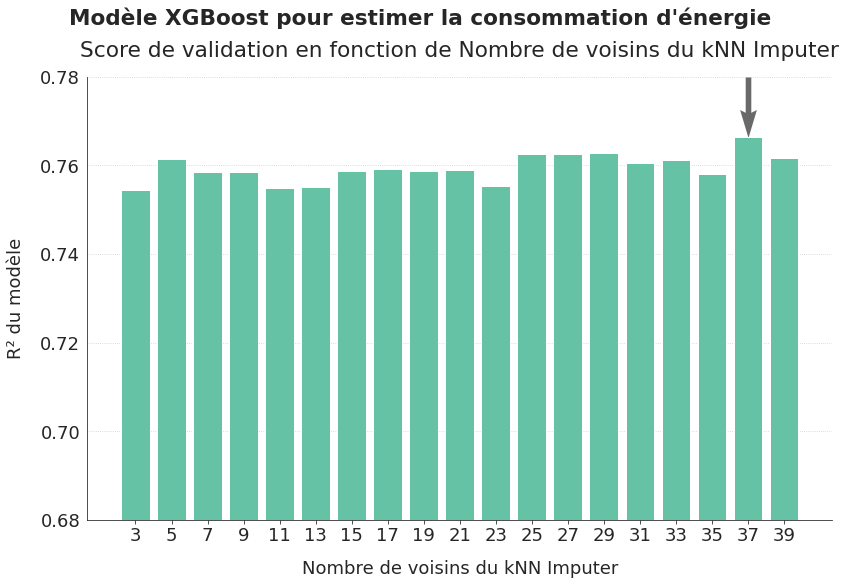

In [ ]:
fig, ax = graph_modele_score(xgb_conso_first_stepb, "knn_n_neighbors", "XGBoost", "Nombre de voisins du kNN Imputer", 
                             "la consommation d'énergie", ymin=0.68, ymax=0.78)
save_fig("ml03_2_11_xgb1a")
plt.show()

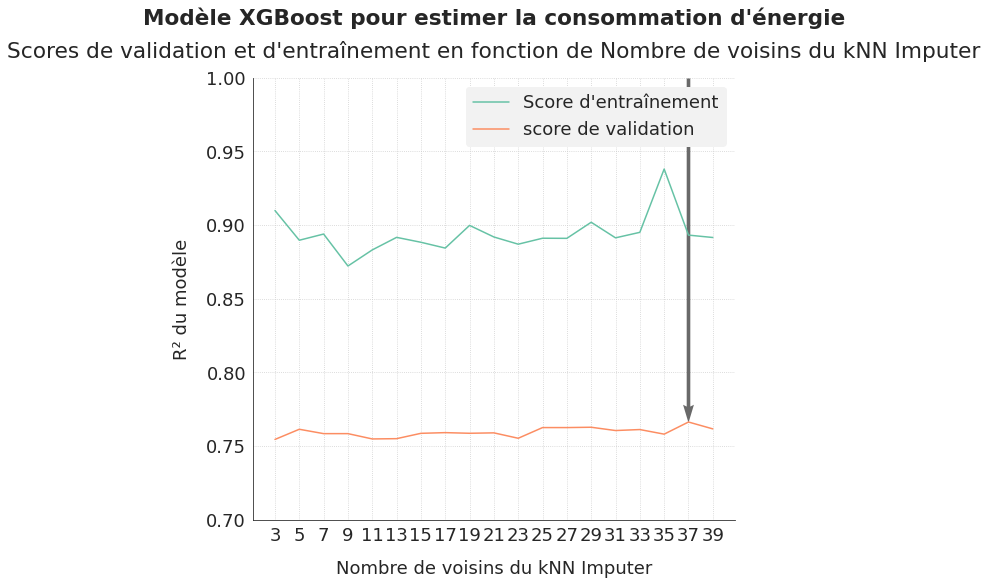

In [ ]:
fig, ax = graph_compar_train_valid(xgb_conso_first_stepb, "knn_n_neighbors", "XGBoost", "Nombre de voisins du kNN Imputer",
                                   "la consommation d'énergie", ymin=0.7, rotation=0)
save_fig("ml03_2_11_xgb1b")
plt.show()

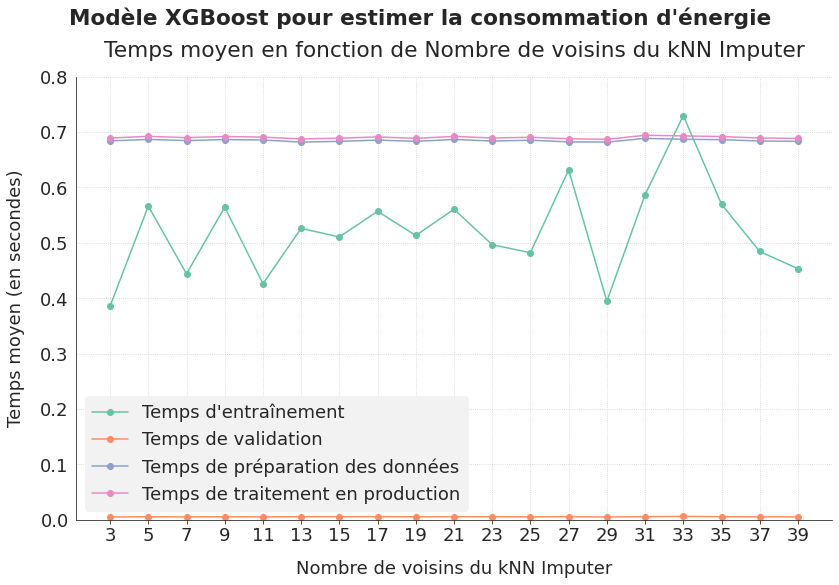

In [ ]:
fig, ax = graph_modele_time(xgb_conso_first_stepb, "knn_n_neighbors", "XGBoost", "Nombre de voisins du kNN Imputer",
                           "la consommation d'énergie", ymin=0.0, ymax=0.8)
save_fig("ml03_2_11_xgb1c")
plt.show()

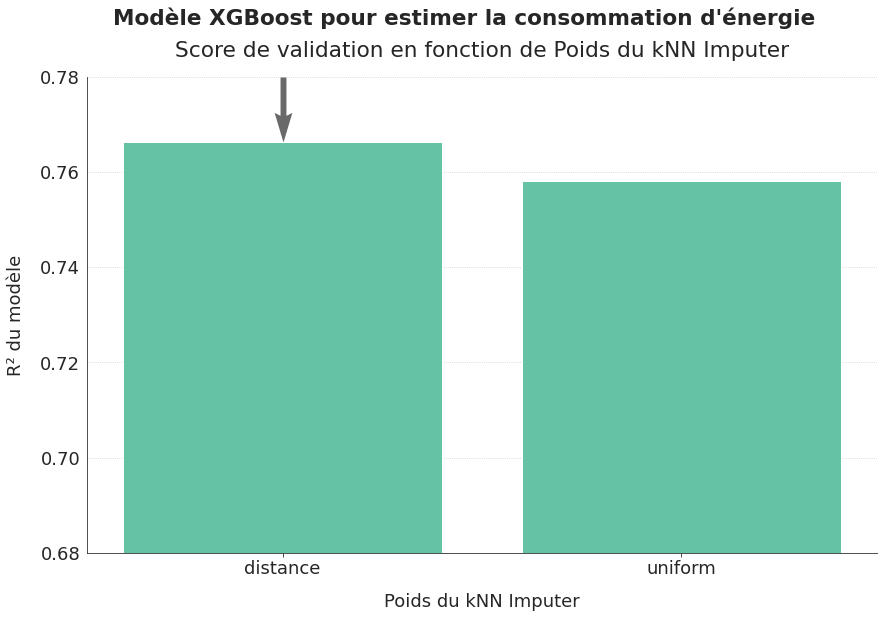

In [ ]:
fig, ax = graph_modele_score(xgb_conso_first_stepb, "knn_weights", "XGBoost", "Poids du kNN Imputer",
                             "la consommation d'énergie", ymin=0.68, ymax=0.78)
plt.show()

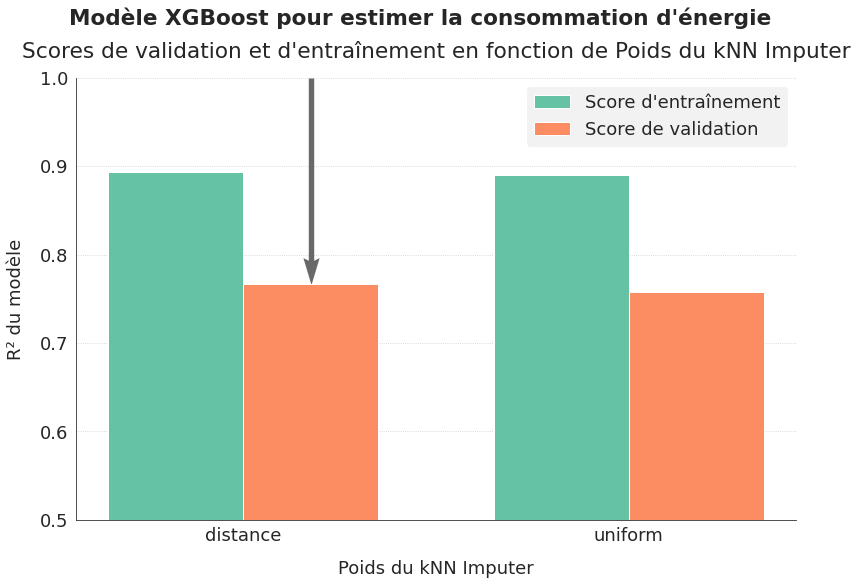

In [ ]:
fig, ax = graph_compar_train_valid(xgb_conso_first_stepb, "knn_weights", "XGBoost", "Poids du kNN Imputer",
                                   "la consommation d'énergie", rotation=0, with_bars=True)
save_fig("ml03_2_12_xgb2a")
plt.show()

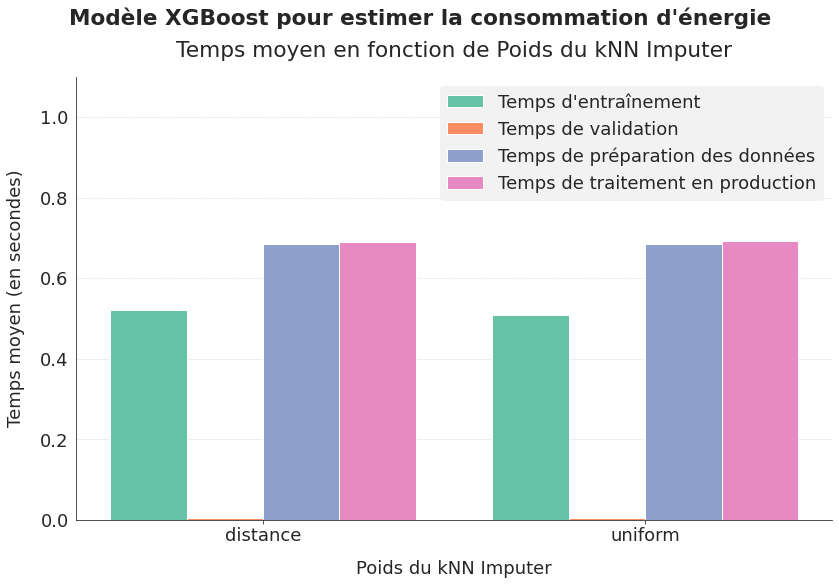

In [ ]:
fig, ax = graph_modele_time(xgb_conso_first_stepb, "knn_weights", "XGBoost", "Poids du kNN Imputer",
                           "la consommation d'énergie", ymax=1.1, with_bars=True)
save_fig("ml03_2_12_xgb2b")
plt.show()

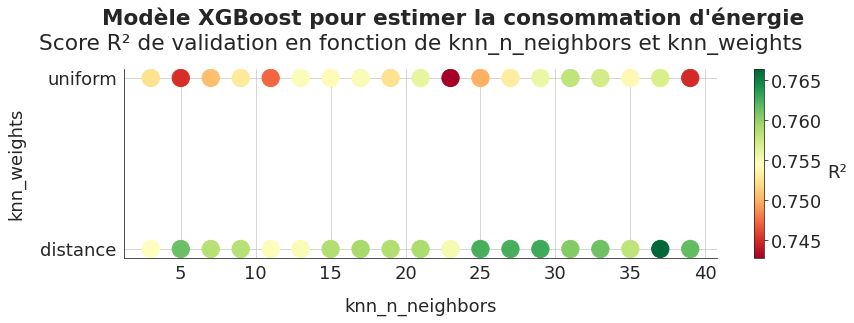

In [ ]:
fig, ax = graph_cross_score(xgb_conso_first_stepb, "knn_n_neighbors", "knn_weights", "XGBoost",
                            "la consommation d'énergie", size=300, figsize=(12,4))
save_fig("ml03_2_12_xgb2c", tight_layout=False)
plt.show()

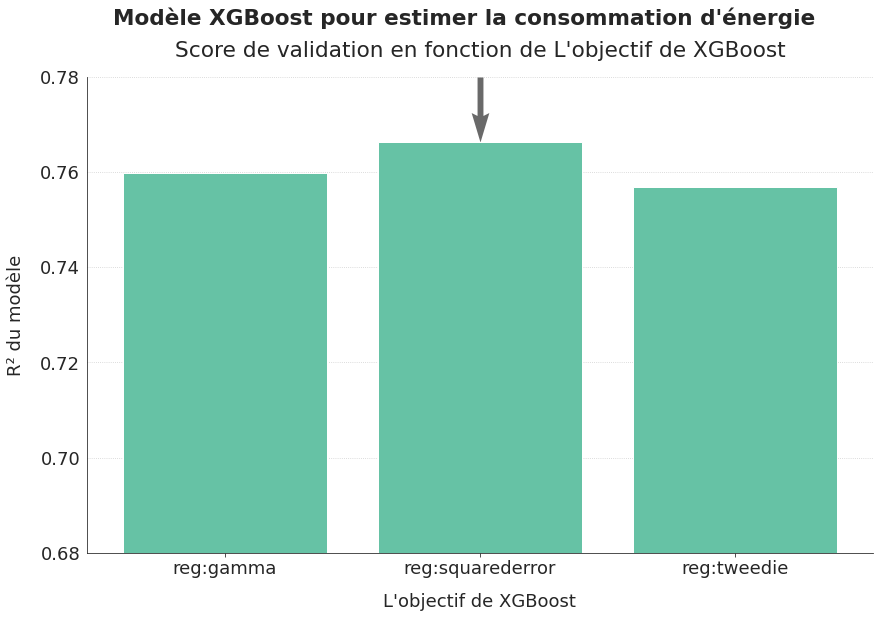

In [ ]:
fig, ax = graph_modele_score(xgb_conso_first_stepb, "xgb_objective", "XGBoost", "L'objectif de XGBoost",
                             "la consommation d'énergie", ymin=0.68, ymax=0.78)
plt.show()

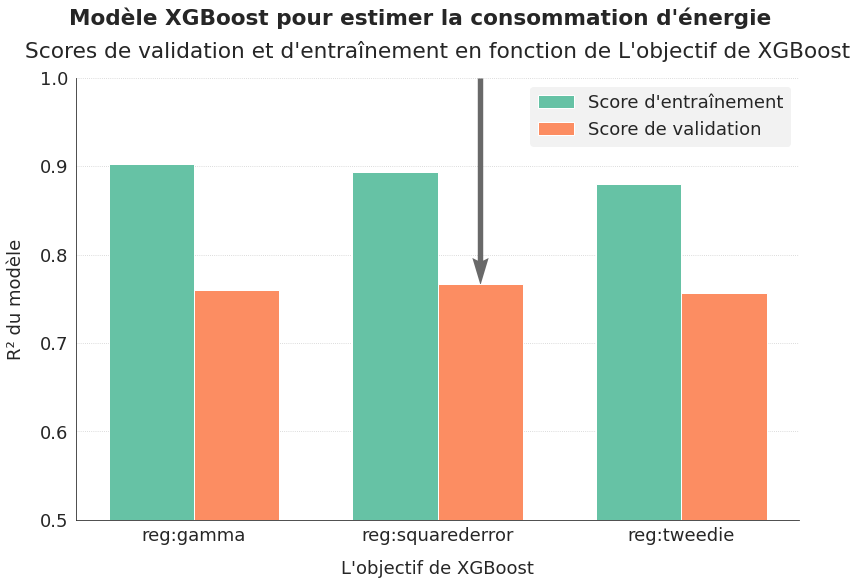

In [ ]:
fig, ax = graph_compar_train_valid(xgb_conso_first_stepb, "xgb_objective", "XGBoost", "L'objectif de XGBoost", 
                                   "la consommation d'énergie", rotation=0, with_bars=True)
save_fig("ml03_2_13_xgb3a")
plt.show()

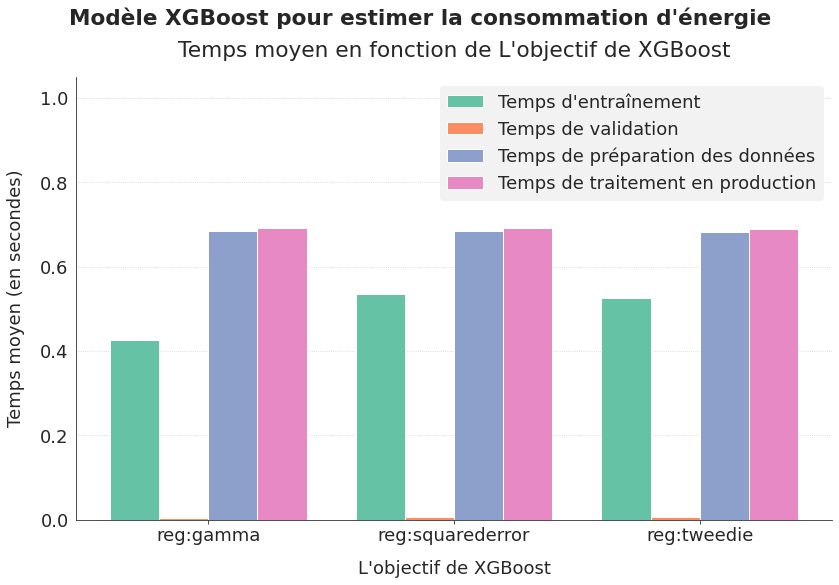

In [ ]:
fig, ax = graph_modele_time(xgb_conso_first_stepb, "xgb_objective", "XGBoost", "L'objectif de XGBoost", 
                           "la consommation d'énergie", ymax=1.05, with_bars=True)
save_fig("ml03_2_13_xgb3b")
plt.show()

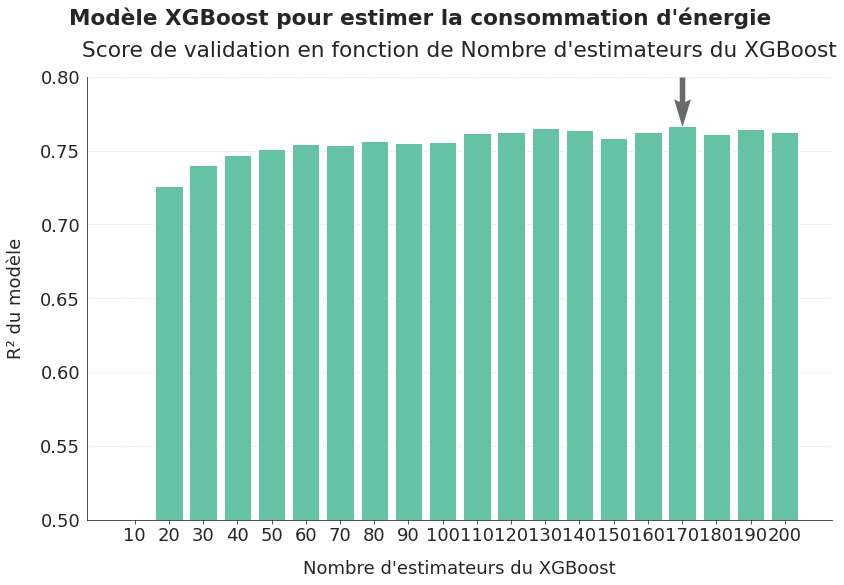

In [ ]:
fig, ax = graph_modele_score(xgb_conso_first_stepb, "xgb_n_estimators", "XGBoost", "Nombre d'estimateurs du XGBoost",
                             "la consommation d'énergie", ymin=0.50, ymax=0.8)
save_fig("ml03_2_14_xgb4a")
plt.show()

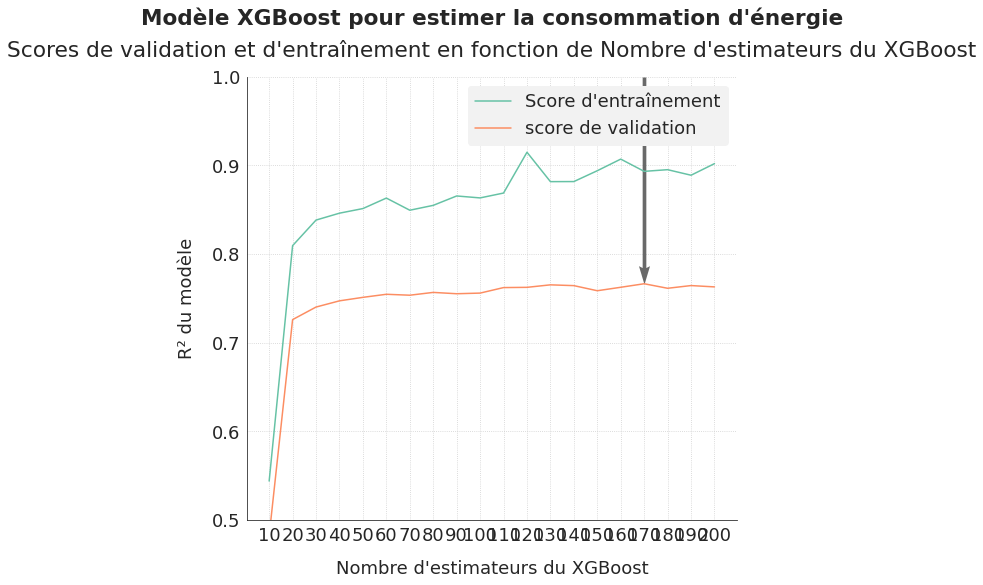

In [ ]:
fig, ax = graph_compar_train_valid(xgb_conso_first_stepb, "xgb_n_estimators", "XGBoost", "Nombre d'estimateurs du XGBoost", 
                                   "la consommation d'énergie", ymin=0.5, rotation=0)
save_fig("ml03_2_14_xgb4b")
plt.show()

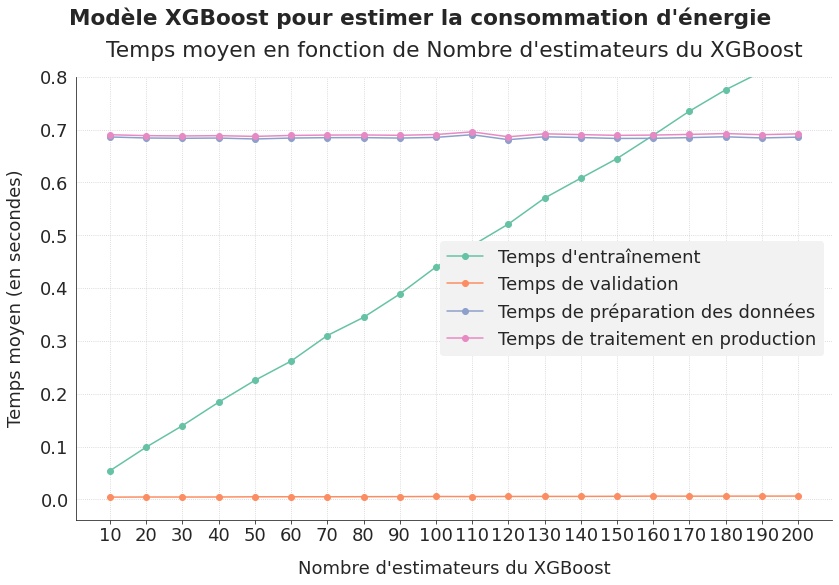

In [ ]:
fig, ax = graph_modele_time(xgb_conso_first_stepb, "xgb_n_estimators", "XGBoost", "Nombre d'estimateurs du XGBoost",
                           "la consommation d'énergie", ymax=0.8)
save_fig("ml03_2_14_xgb4c")
plt.show()

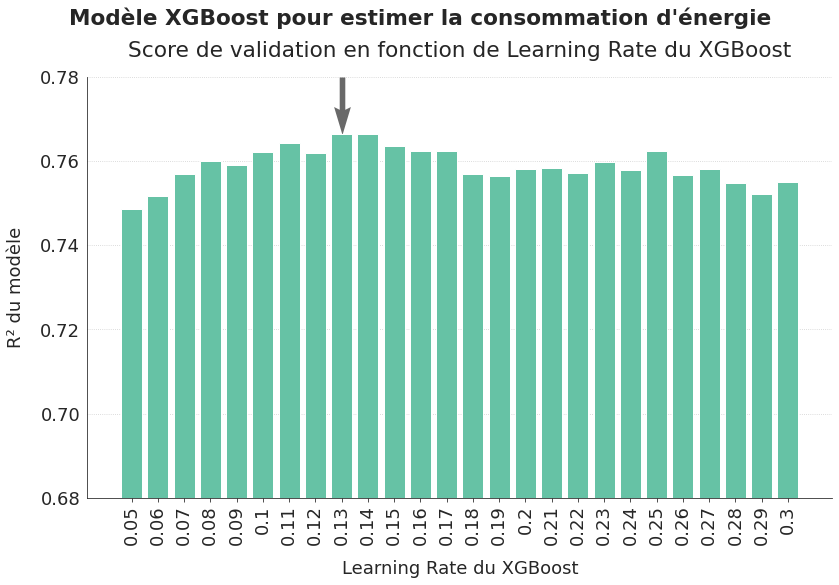

In [ ]:
fig, ax = graph_modele_score(xgb_conso_first_stepb, "xgb_learning_rate", "XGBoost", "Learning Rate du XGBoost",
                             "la consommation d'énergie", ymin=0.68, ymax=0.78, rotation=90)
save_fig("ml03_2_15_xgb5a")
plt.show()

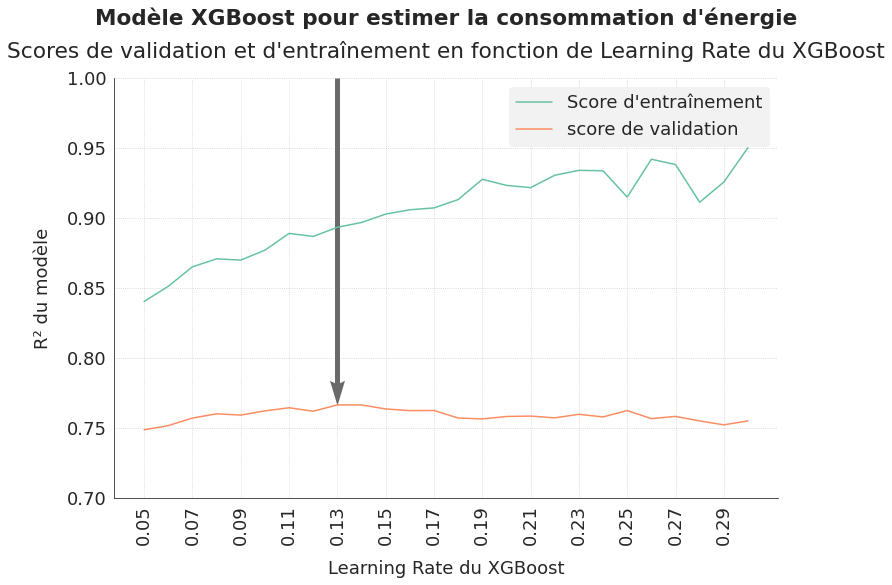

In [ ]:
fig, ax = graph_compar_train_valid(xgb_conso_first_stepb, "xgb_learning_rate", "XGBoost", "Learning Rate du XGBoost", 
                                   "la consommation d'énergie", ymin=0.7, tick_step=2, rotation=90)
save_fig("ml03_2_15_xgb5b")
plt.show()

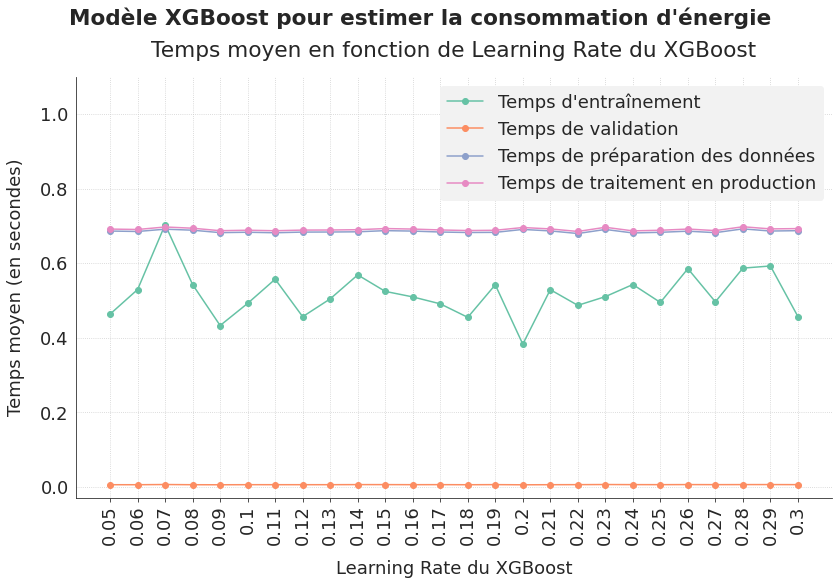

In [ ]:
fig, ax = graph_modele_time(xgb_conso_first_stepb, "xgb_learning_rate", "XGBoost", "Learning Rate du XGBoost", 
                           "la consommation d'énergie", ymax=1.1, rotation=90)
save_fig("ml03_2_15_xgb5c")
plt.show()

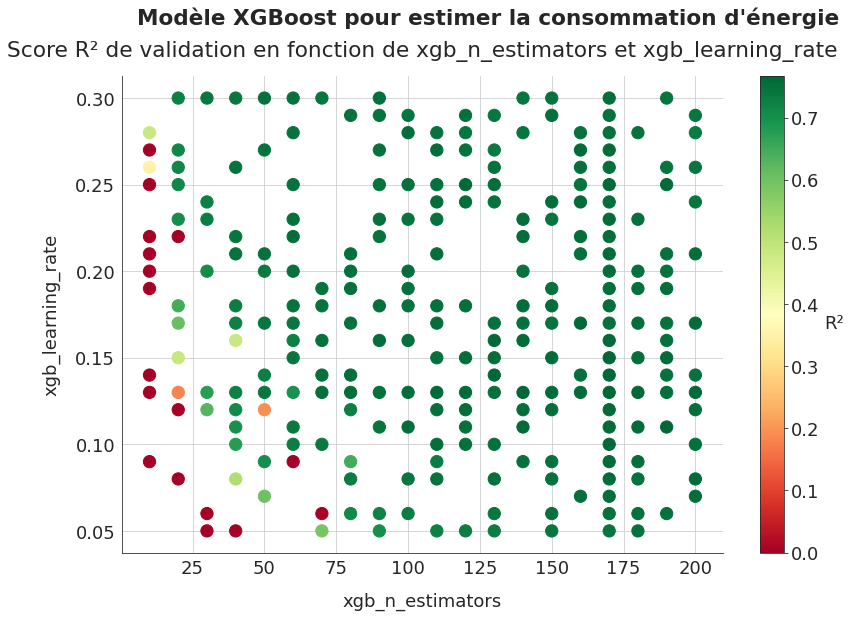

In [ ]:
fig, ax = graph_cross_score(xgb_conso_first_stepb, "xgb_n_estimators", "xgb_learning_rate", "XGBoost",
                            "la consommation d'énergie", size=150)
plt.show()

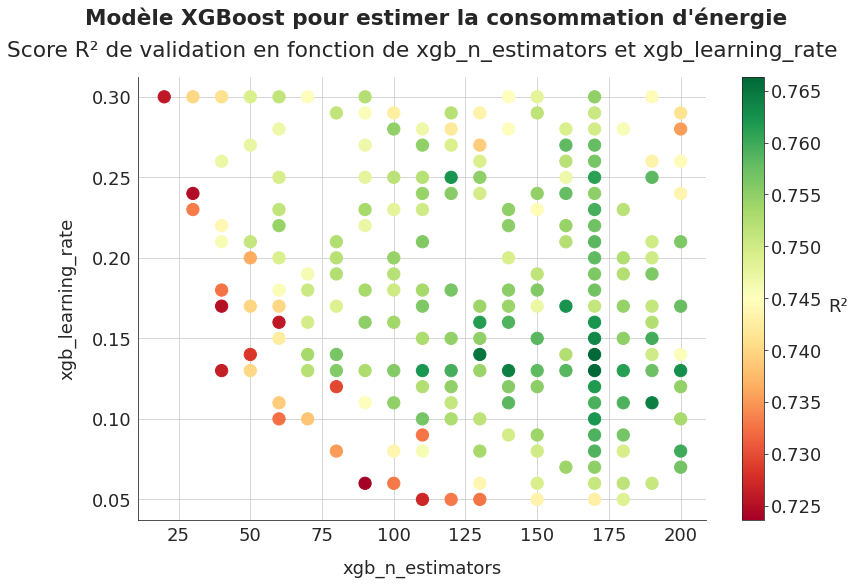

In [ ]:
fig, ax = graph_cross_score(xgb_conso_first_stepb, "xgb_n_estimators", "xgb_learning_rate", "XGBoost",
                            "la consommation d'énergie", vmin=0.72, size=150)
save_fig("ml03_2_15_xgb5d")
plt.show()

<a id='4_6_2'></a>

#### 4.6.2. XGBoost : deuxième étape

J'optimise les hyperparamètres de XGBoost liés aux arbres de décision : max_depth, min_child_weight, colsample_bytree, subsample et gamma.

In [ ]:
# conso_pipeline for XGBRegressor
conso_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', AllImputation(KNNImputer(), categ_cols=categ_col, missforest=False)),
    ('data_encoders', FitToPandas(encoder_perso_onehot, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=False, keep_all=False)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler(), transfo_col, 'transfo_num'))
])
reg_pipeline = Pipeline([('estimator', XGBRegressor(n_jobs=-1, random_state=42))])

In [ ]:
space = {
    'data_imputers__sk_object__n_neighbors': 37,
    'data_imputers__sk_object__weights': 'distance',
    'data_case': {'encoders': encoder_perso_onehot,
         'list_name': transfo_col,
         'restrict_cols': 'transfo_num'},
    'estimator__objective': 'reg:squarederror',
    'estimator__n_estimators': 170,
    'estimator__learning_rate': 0.13,
    'estimator__max_depth': hp.choice('estimator__max_depth', np.arange(3, 16, 1, dtype=int)),
    'estimator__min_child_weight': hp.choice('estimator__min_child_weight', np.arange(0, 11, 1, dtype=int)),
    'estimator__colsample_bytree': hp.uniform('estimator__colsample_bytree', 0.3, 1),
    'estimator__subsample': hp.uniform('estimator__subsample', 0.5, 1),
    'estimator__gamma': hp.uniform('estimator__gamma', 0.0, 0.5)
}

In [ ]:
list_best_results = []

In [ ]:
estimator_name = 'xgboost'
step = 'final2a'
run_conso_optimization(max_evals=400, prefix=step, estimator_name=estimator_name)

100%|██████████| 400/400 [27:35<00:00,  4.14s/it, best loss: -0.7752496774828546]
Estimateur : xgboost - Done
Best cross-validation mean score = 0.7752496774828546
Associated standard deviation = 0.02147110774152079
Calculation time = 0.006349706649780273
Data preparation time = 0.6780848969992803
Best cv score obtained after 228 iterations



In [ ]:
xgb_conso_second_stepa = pd.read_csv("hyperopt_conso_xgboost_final2a.csv")
xgb_conso_second_stepa.head()

,valid_score_mean,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,data_transfo_time,data_imputer,data_encoder,estimator,iteration
0,0.743279,0.019531,0.011648,0.994198,0.000164,1.836235,0.678125,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",1
1,0.750808,0.022851,0.007981,0.969507,0.000411,1.552709,0.683502,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",2
2,0.759552,0.020568,0.008045,0.988762,0.000246,2.358816,0.701108,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",3
3,0.737778,0.026252,0.013156,0.996921,0.000231,1.480379,0.679346,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",4
4,0.755689,0.018090,0.008333,0.979884,0.000644,2.474004,0.678059,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",5


In [ ]:
xgb_conso_second_stepa = remove_negative_scores(xgb_conso_second_stepa)
inter_str = [inter[inter.find('max_depth')+10:] for inter in xgb_conso_second_stepa.estimator]
xgb_conso_second_stepa["xgb_max_depth"] = [np.int(inter[:inter.find(',')]) for inter in inter_str]
inter_str = [inter[inter.find('child_weight')+13:] for inter in xgb_conso_second_stepa.estimator]
xgb_conso_second_stepa["xgb_min_child_weight"] = [np.int(inter[:inter.find(',')]) for inter in inter_str]
inter_str = [inter[inter.find('colsample_bytree')+17:] for inter in xgb_conso_second_stepa.estimator]
xgb_conso_second_stepa["xgb_colsample_bytree"] = [np.around(np.float(inter[:inter.find(',')]),5) for inter in inter_str]
inter_str = [inter[inter.find('subsample')+10:] for inter in xgb_conso_second_stepa.estimator]
xgb_conso_second_stepa["xgb_subsample"] = [np.around(np.float(inter[:inter.find(',')]),5) for inter in inter_str]
inter_str = [inter[inter.find('gamma')+6:] for inter in xgb_conso_second_stepa.estimator]
xgb_conso_second_stepa["xgb_gamma"] = [np.around(np.float(inter[:inter.find(',')]),5) for inter in inter_str]
xgb_conso_second_stepa["total_time"] = xgb_conso_second_stepa.valid_time_mean + xgb_conso_second_stepa.data_transfo_time

In [ ]:
xgb_conso_second_stepa[["valid_score_mean","train_score_mean","iteration", "xgb_max_depth",
                       "xgb_min_child_weight","xgb_colsample_bytree","xgb_subsample","xgb_gamma","total_time"]].\
                    sort_values("valid_score_mean", ascending=False).head(10)

,valid_score_mean,train_score_mean,iteration,xgb_max_depth,xgb_min_child_weight,xgb_colsample_bytree,xgb_subsample,xgb_gamma,total_time
227,0.775250,0.934596,228,4,1,0.51346,0.95383,0.12404,0.684435
285,0.770868,0.931923,286,4,2,0.36462,0.95817,0.10465,0.685695
224,0.770621,0.926875,225,4,1,0.37845,0.94313,0.27163,0.687590
165,0.769935,0.926072,166,4,1,0.31611,0.83010,0.33398,0.707285
43,0.769846,0.926680,44,4,1,0.30027,0.78753,0.31492,0.682882
292,0.769668,0.929257,293,4,2,0.31466,0.95613,0.04292,0.682351
345,0.769622,0.909865,346,4,6,0.35345,0.92214,0.44382,0.680277
342,0.768576,0.928333,343,4,1,0.37337,0.99964,0.11609,0.720056
357,0.768418,0.915415,358,4,6,0.32332,0.90891,0.23146,0.683386
284,0.768328,0.927213,285,4,2,0.35431,0.95918,0.24288,0.696449


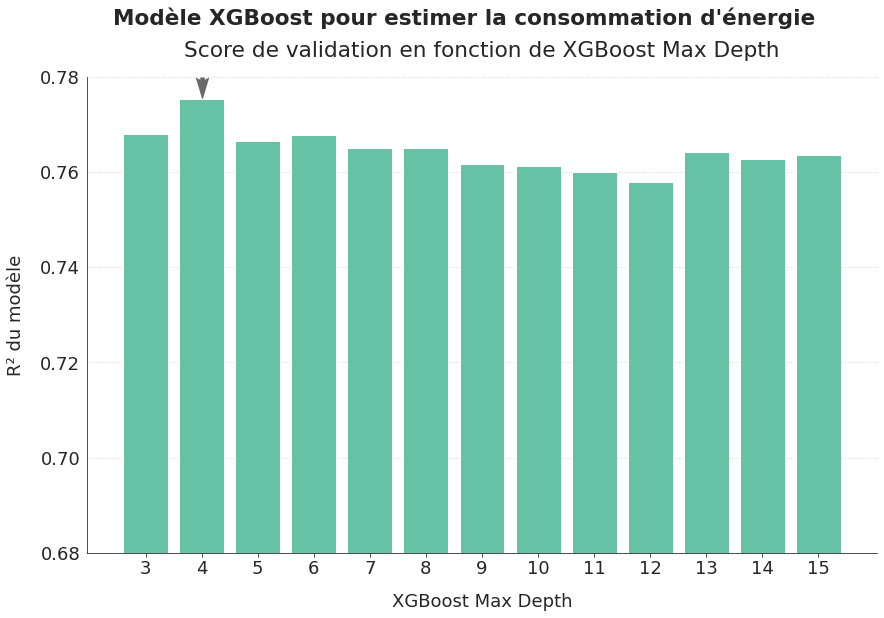

In [ ]:
fig, ax = graph_modele_score(xgb_conso_second_stepa, "xgb_max_depth", "XGBoost", "XGBoost Max Depth",
                             "la consommation d'énergie", ymin=0.68, ymax=0.78)
plt.show()

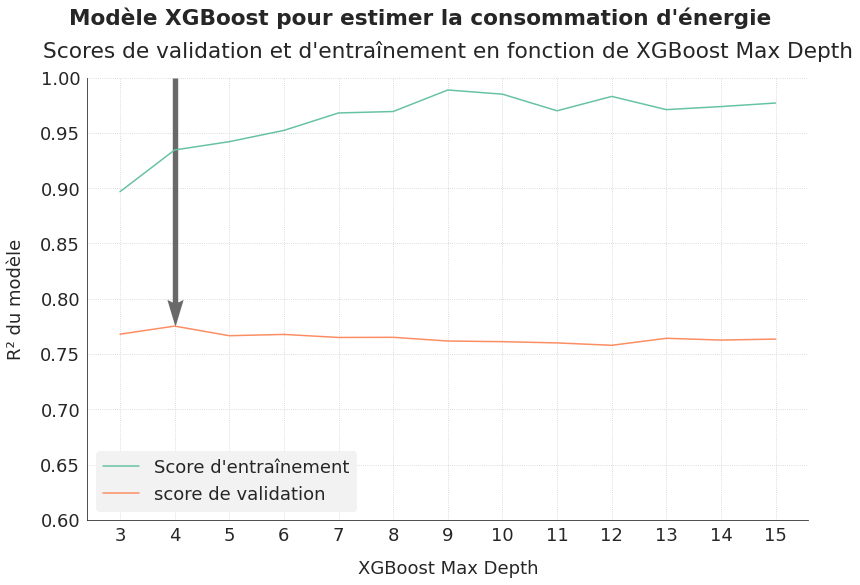

In [ ]:
fig, ax = graph_compar_train_valid(xgb_conso_second_stepa, "xgb_max_depth", "XGBoost", "XGBoost Max Depth", 
                                   "la consommation d'énergie", ymin=0.6, rotation=0)
save_fig("ml03_2_16_xgb6a")
plt.show()

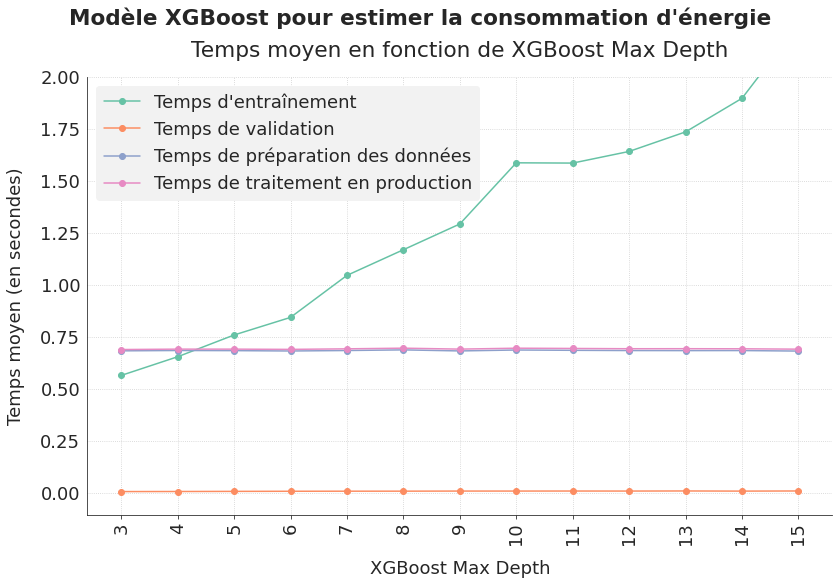

In [ ]:
fig, ax = graph_modele_time(xgb_conso_second_stepa, "xgb_max_depth", "XGBoost", "XGBoost Max Depth", 
                           "la consommation d'énergie", ymax=2, rotation=90)
save_fig("ml03_2_16_xgb6b")
plt.show()

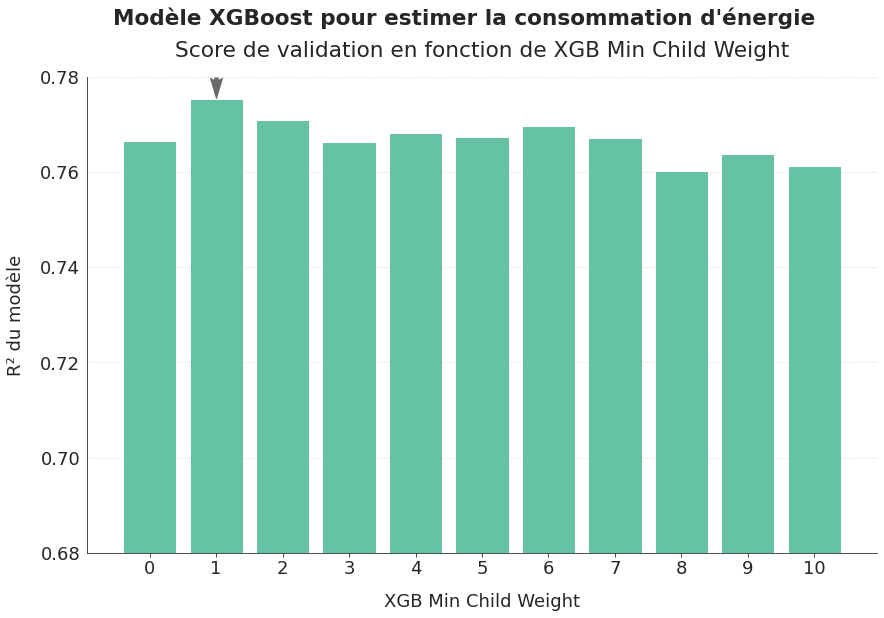

In [ ]:
fig, ax = graph_modele_score(xgb_conso_second_stepa, "xgb_min_child_weight", "XGBoost", "XGB Min Child Weight",
                             "la consommation d'énergie", ymin=0.68, ymax=0.78)
plt.show()

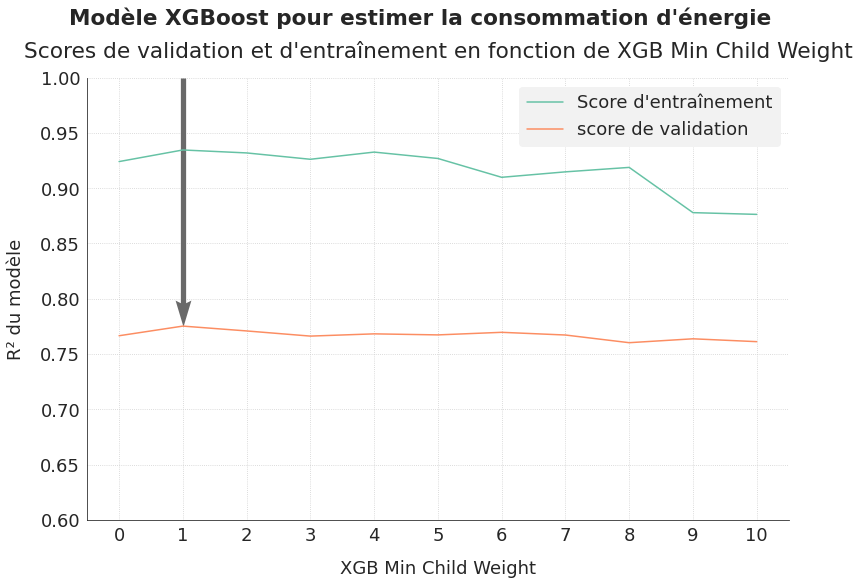

In [ ]:
fig, ax = graph_compar_train_valid(xgb_conso_second_stepa, "xgb_min_child_weight", "XGBoost", "XGB Min Child Weight", 
                                   "la consommation d'énergie", ymin=0.6, rotation=0)
save_fig("ml03_2_16_xgb6c")
plt.show()

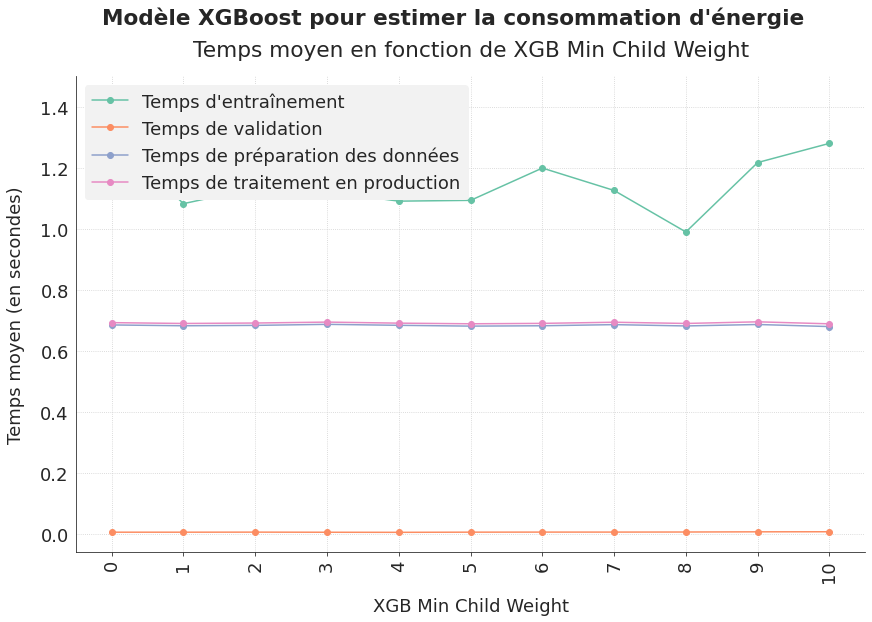

In [ ]:
fig, ax = graph_modele_time(xgb_conso_second_stepa, "xgb_min_child_weight", "XGBoost", "XGB Min Child Weight", 
                           "la consommation d'énergie", ymax=1.5, rotation=90)
plt.show()

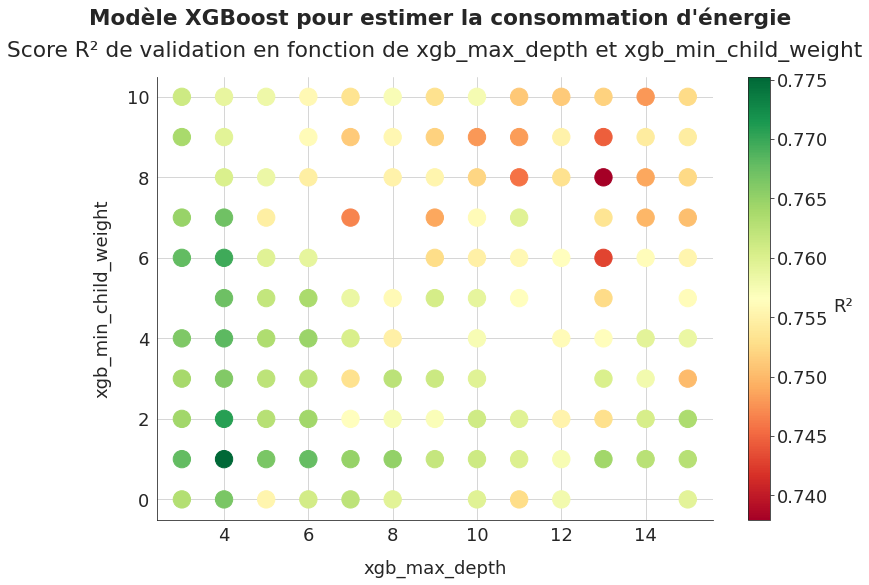

In [ ]:
fig, ax = graph_cross_score(xgb_conso_second_stepa, "xgb_max_depth", "xgb_min_child_weight", "XGBoost",
                            "la consommation d'énergie", size=300)
save_fig("ml03_2_16_xgb6d")
plt.show()

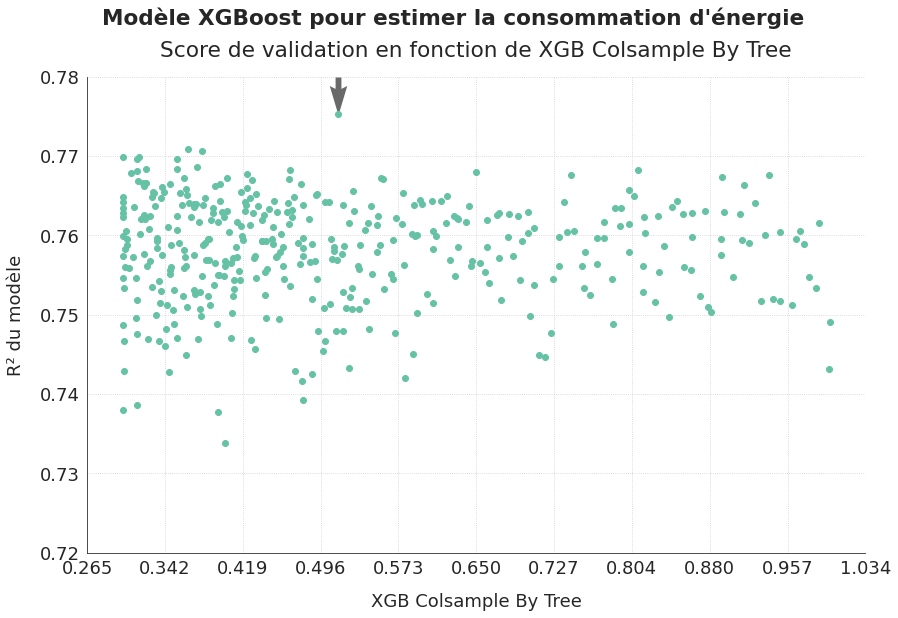

In [ ]:
fig, ax = graph_continu_preview(xgb_conso_second_stepa, "xgb_colsample_bytree", "XGBoost", "XGB Colsample By Tree",
                              "la consommation d'énergie", ymin=0.72, ymax=0.78)
plt.show()

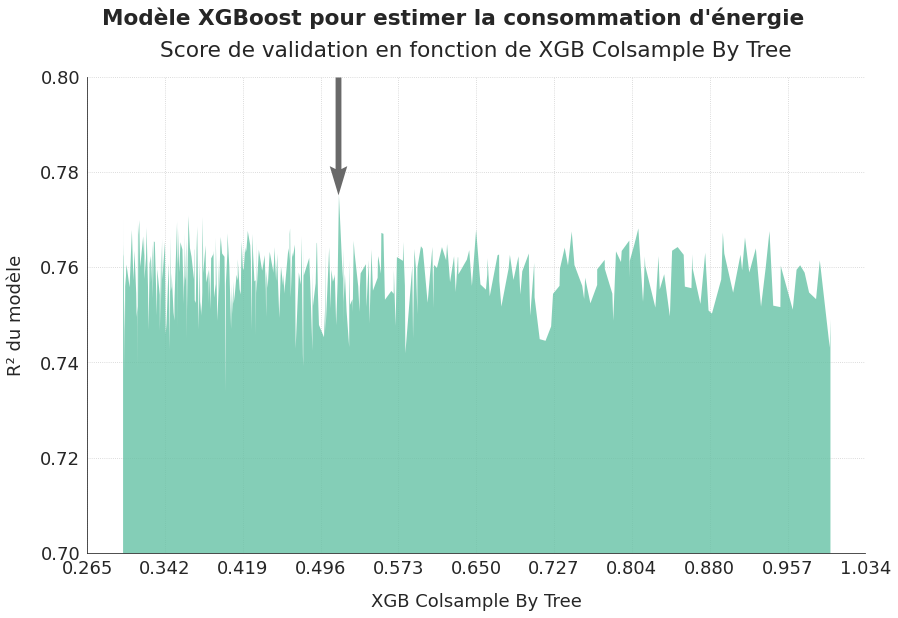

In [ ]:
fig, ax = graph_continu_score(xgb_conso_second_stepa, "xgb_colsample_bytree", "XGBoost", "XGB Colsample By Tree",
                              "la consommation d'énergie", ymin=0.7, ymax=0.8)
plt.show()

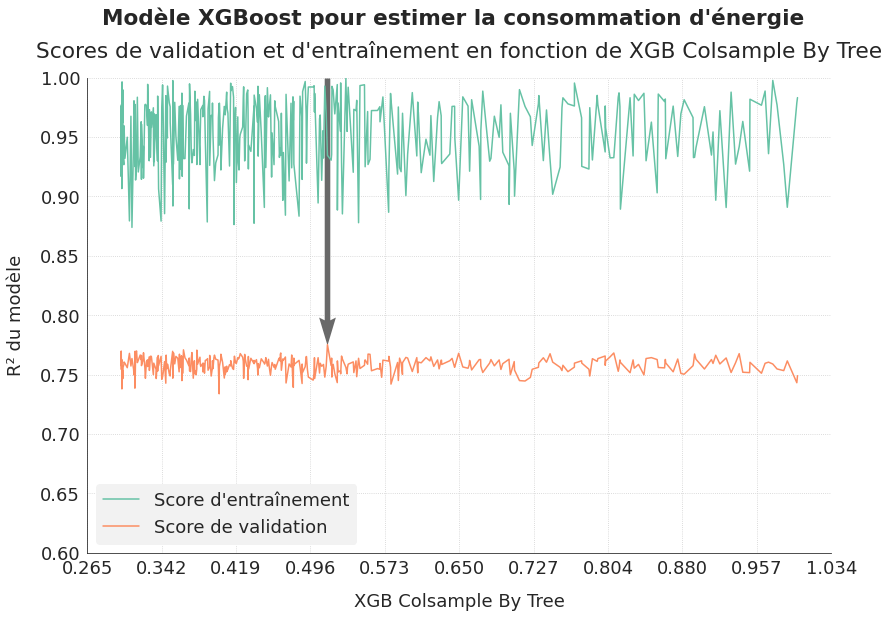

In [ ]:
fig, ax = graph_compar_continu(xgb_conso_second_stepa, "xgb_colsample_bytree", "XGBoost", "XGB Colsample By Tree",
                                "la consommation d'énergie", ymin=0.6)
plt.show()

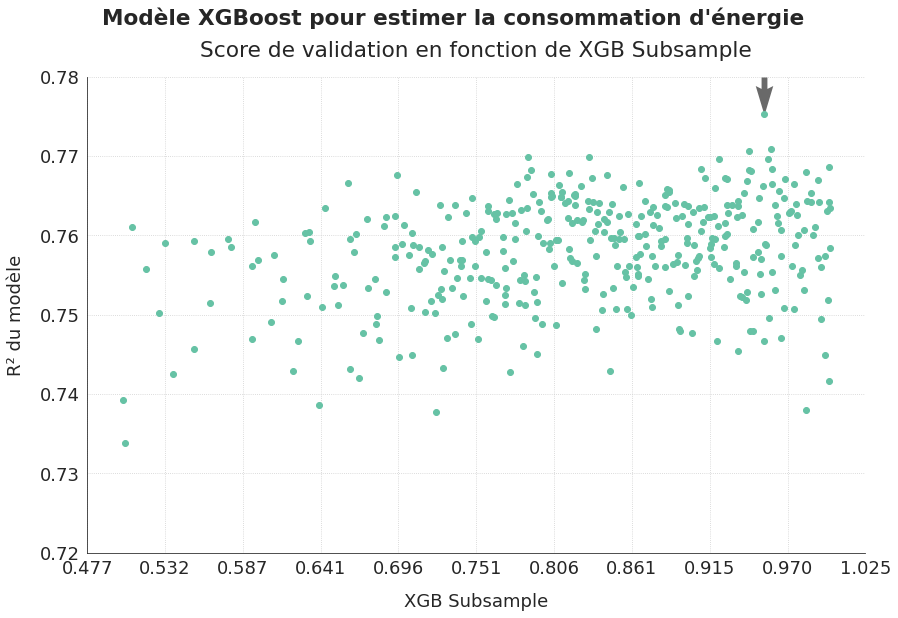

In [ ]:
fig, ax = graph_continu_preview(xgb_conso_second_stepa, "xgb_subsample", "XGBoost", "XGB Subsample",
                              "la consommation d'énergie", ymin=0.72, ymax=0.78)
plt.show()

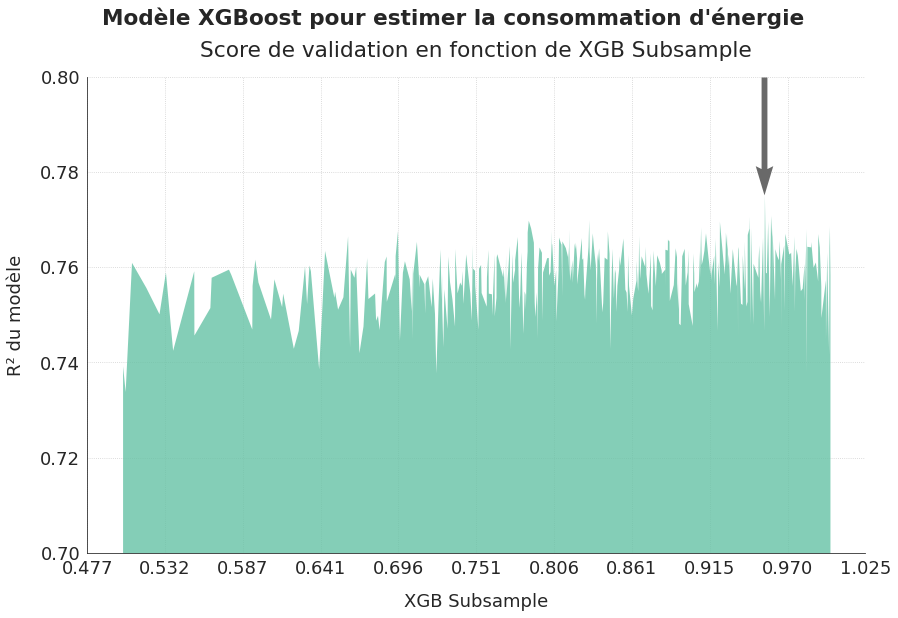

In [ ]:
fig, ax = graph_continu_score(xgb_conso_second_stepa, "xgb_subsample", "XGBoost", "XGB Subsample",
                              "la consommation d'énergie", ymin=0.7, ymax=0.8)
plt.show()

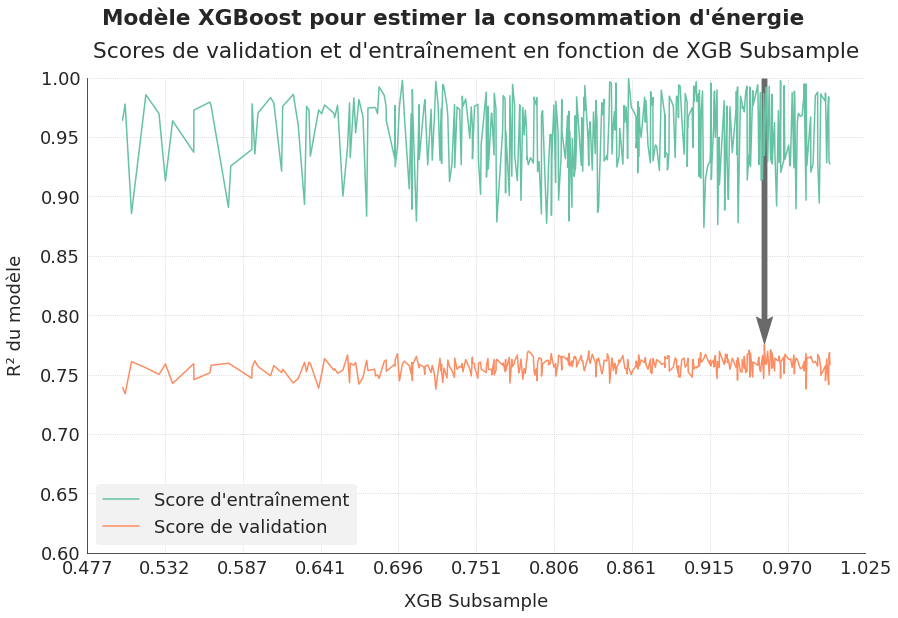

In [ ]:
fig, ax = graph_compar_continu(xgb_conso_second_stepa, "xgb_subsample", "XGBoost", "XGB Subsample",
                               "la consommation d'énergie", ymin=0.6)
plt.show()

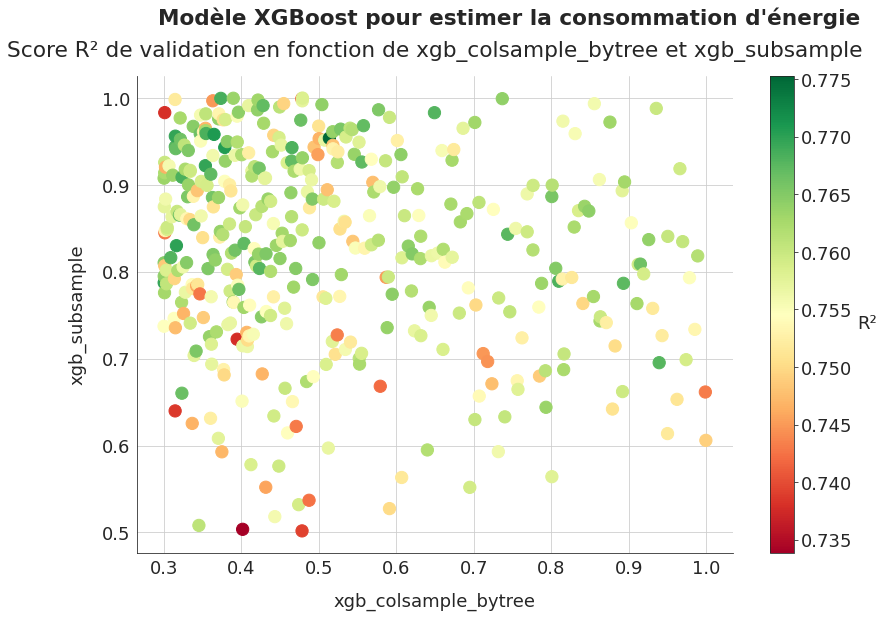

In [ ]:
fig, ax = graph_cross_score(xgb_conso_second_stepa, "xgb_colsample_bytree", "xgb_subsample", "XGBoost",
                            "la consommation d'énergie", size=150)

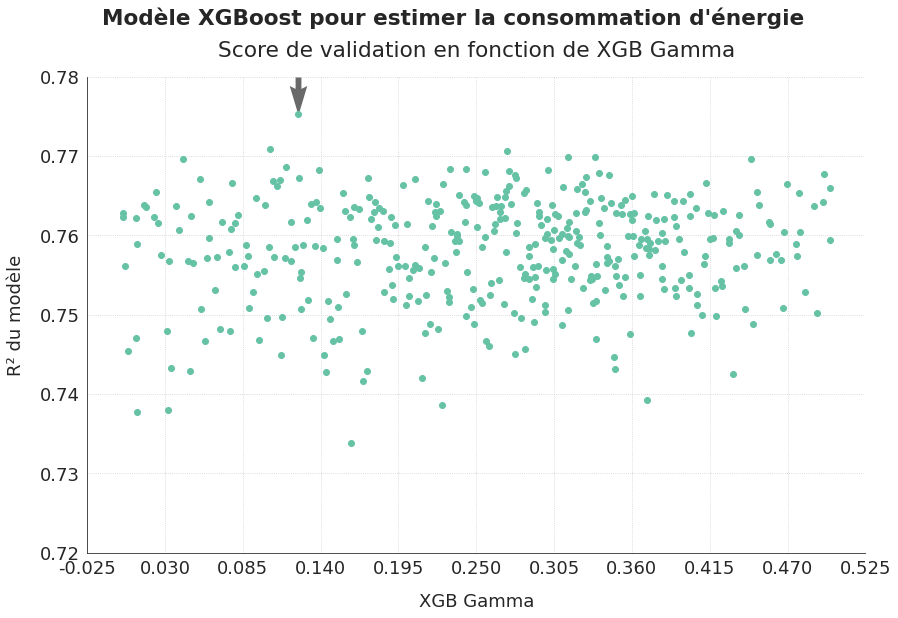

In [ ]:
fig, ax = graph_continu_preview(xgb_conso_second_stepa, "xgb_gamma", "XGBoost", "XGB Gamma",
                              "la consommation d'énergie", ymin=0.72, ymax=0.78)
plt.show()

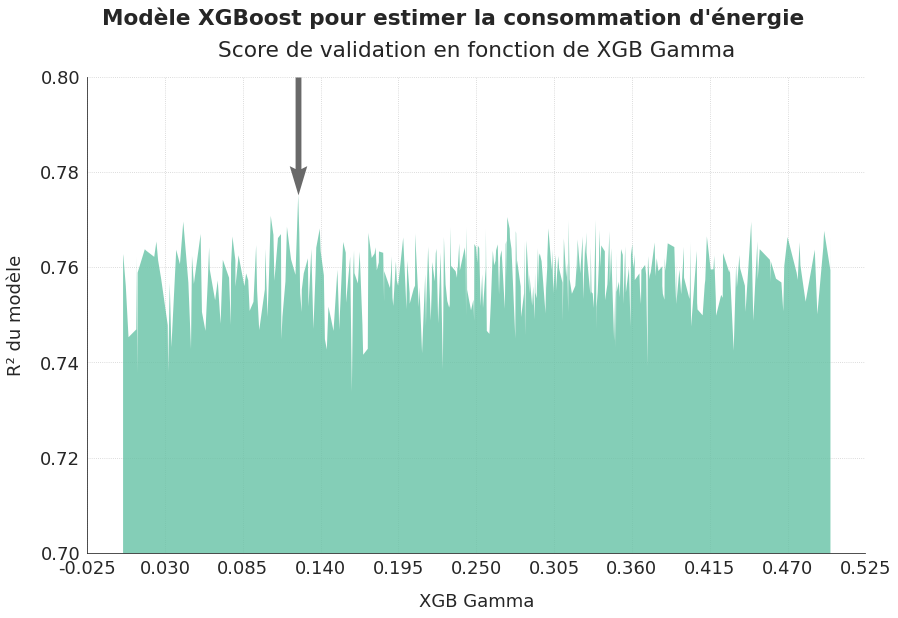

In [ ]:
fig, ax = graph_continu_score(xgb_conso_second_stepa, "xgb_gamma", "XGBoost", "XGB Gamma",
                              "la consommation d'énergie", ymin=0.7, ymax=0.8)
plt.show()

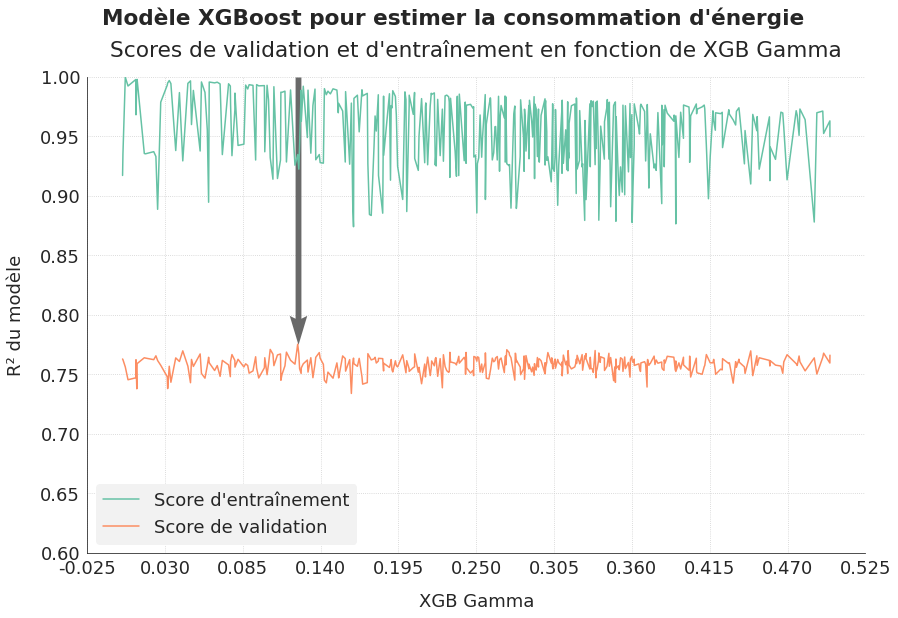

In [ ]:
fig, ax = graph_compar_continu(xgb_conso_second_stepa, "xgb_gamma", "XGBoost", "XGB Gamma",
                               "la consommation d'énergie", ymin=0.6)
plt.show()

J'affine les hyperparamètres colsample_bytree, subsample et gamma.

In [ ]:
# conso_pipeline for XGBRegressor
conso_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', AllImputation(KNNImputer(), categ_cols=categ_col, missforest=False)),
    ('data_encoders', FitToPandas(encoder_perso_onehot, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=False, keep_all=False)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler(), transfo_col, 'transfo_num'))
])
reg_pipeline = Pipeline([('estimator', XGBRegressor(n_jobs=-1, random_state=42))])

In [ ]:
space = {
    'data_imputers__sk_object__n_neighbors': 37,
    'data_imputers__sk_object__weights': 'distance',
    'data_case': {'encoders': encoder_perso_onehot,
         'list_name': transfo_col,
         'restrict_cols': 'transfo_num'},
    'estimator__objective': 'reg:squarederror',
    'estimator__n_estimators': 170,
    'estimator__learning_rate': 0.13,
    'estimator__max_depth': 4,
    'estimator__min_child_weight': 1,
    'estimator__colsample_bytree': hp.choice('estimator__colsample_bytree', np.arange(0.45, 0.555, 0.01)),
    'estimator__subsample': hp.choice('estimator__subsample', np.arange(0.9, 1.005, 0.01)),
    'estimator__gamma': hp.choice('estimator__gamma', np.arange(0.07, 0.175, 0.01))
}

In [ ]:
list_best_results = []

In [ ]:
estimator_name = 'xgboost'
step = 'final2b'
run_conso_optimization(max_evals=200, prefix=step, estimator_name=estimator_name)

100%|██████████| 200/200 [08:44<00:00,  2.62s/it, best loss: -0.7722383826300245]
Estimateur : xgboost - Done
Best cross-validation mean score = 0.7722383826300245
Associated standard deviation = 0.01989403615720322
Calculation time = 0.006410074234008789
Data preparation time = 0.6969910850002634
Best cv score obtained after 8 iterations



In [ ]:
xgb_conso_second_stepb = pd.read_csv("hyperopt_conso_xgboost_final2b.csv")
xgb_conso_second_stepb.head()

,valid_score_mean,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,data_transfo_time,data_imputer,data_encoder,estimator,iteration
0,0.765449,0.021440,0.006214,0.931261,0.002409,0.645292,0.681992,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",1
1,0.767063,0.021934,0.006358,0.934015,0.002294,0.608517,0.695838,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",2
2,0.765770,0.021995,0.006452,0.935765,0.002330,0.619661,0.675168,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",3
3,0.761697,0.021267,0.006505,0.938172,0.002299,0.636522,0.680457,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",4
4,0.768141,0.021447,0.006353,0.934100,0.001977,0.601002,0.714392,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",5


In [ ]:
xgb_conso_second_stepb = remove_negative_scores(xgb_conso_second_stepb)
inter_str = [inter[inter.find('max_depth')+10:] for inter in xgb_conso_second_stepb.estimator]
xgb_conso_second_stepb["xgb_max_depth"] = [np.int(inter[:inter.find(',')]) for inter in inter_str]
inter_str = [inter[inter.find('child_weight')+13:] for inter in xgb_conso_second_stepb.estimator]
xgb_conso_second_stepb["xgb_min_child_weight"] = [np.int(inter[:inter.find(',')]) for inter in inter_str]
inter_str = [inter[inter.find('colsample_bytree')+17:] for inter in xgb_conso_second_stepb.estimator]
xgb_conso_second_stepb["xgb_colsample_bytree"] = [np.around(np.float(inter[:inter.find(',')]),5) for inter in inter_str]
inter_str = [inter[inter.find('subsample')+10:] for inter in xgb_conso_second_stepb.estimator]
xgb_conso_second_stepb["xgb_subsample"] = [np.around(np.float(inter[:inter.find(',')]),5) for inter in inter_str]
inter_str = [inter[inter.find('gamma')+6:] for inter in xgb_conso_second_stepb.estimator]
xgb_conso_second_stepb["xgb_gamma"] = [np.around(np.float(inter[:inter.find(',')]),5) for inter in inter_str]
xgb_conso_second_stepb["total_time"] = xgb_conso_second_stepb.valid_time_mean + xgb_conso_second_stepb.data_transfo_time

In [ ]:
xgb_conso_second_stepb[["valid_score_mean","train_score_mean","iteration", "xgb_max_depth",
                       "xgb_min_child_weight","xgb_colsample_bytree","xgb_subsample","xgb_gamma","total_time"]].\
                    sort_values("valid_score_mean", ascending=False).head(10)

,valid_score_mean,train_score_mean,iteration,xgb_max_depth,xgb_min_child_weight,xgb_colsample_bytree,xgb_subsample,xgb_gamma,total_time
83,0.772238,0.933568,84,4,1,0.53,0.96,0.09,0.700686
114,0.772238,0.933568,115,4,1,0.53,0.96,0.09,0.690887
34,0.772238,0.933568,35,4,1,0.53,0.96,0.09,0.706855
151,0.772238,0.933568,152,4,1,0.53,0.96,0.09,0.718508
35,0.772238,0.933568,36,4,1,0.53,0.96,0.09,0.688529
148,0.772238,0.933568,149,4,1,0.53,0.96,0.09,0.702654
147,0.772238,0.933568,148,4,1,0.53,0.96,0.09,0.720880
146,0.772238,0.933568,147,4,1,0.53,0.96,0.09,0.686462
145,0.772238,0.933568,146,4,1,0.53,0.96,0.09,0.701951
143,0.772238,0.933568,144,4,1,0.53,0.96,0.09,0.689559


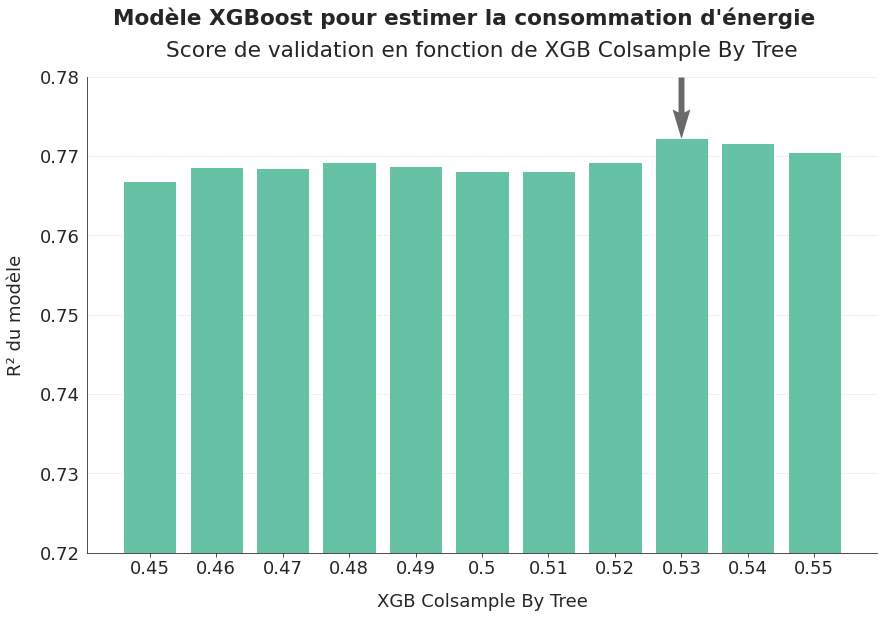

In [ ]:
fig, ax = graph_modele_score(xgb_conso_second_stepb, "xgb_colsample_bytree", "XGBoost", "XGB Colsample By Tree",
                              "la consommation d'énergie", ymin=0.72, ymax=0.78)
plt.show()

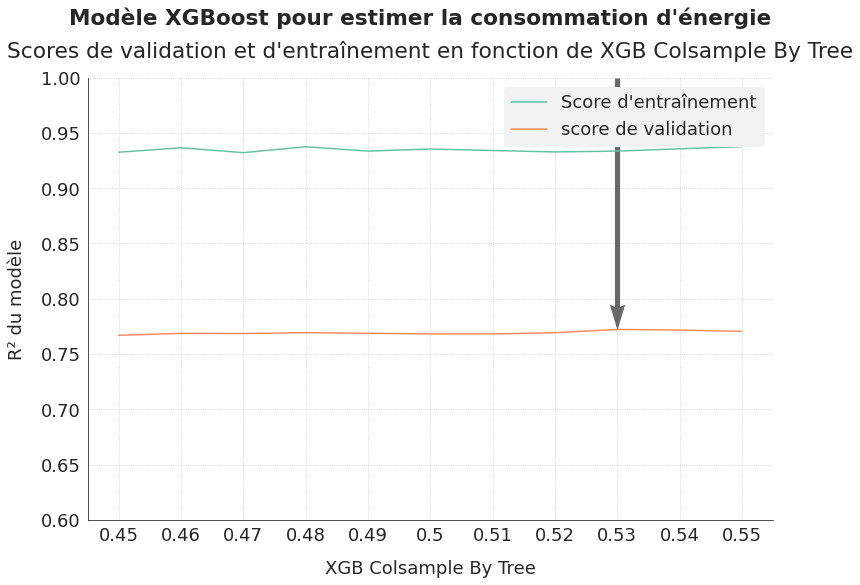

In [ ]:
fig, ax = graph_compar_train_valid(xgb_conso_second_stepb, "xgb_colsample_bytree", "XGBoost", "XGB Colsample By Tree",
                                "la consommation d'énergie", ymin=0.6)
save_fig("ml03_2_17_xgb7a")
plt.show()

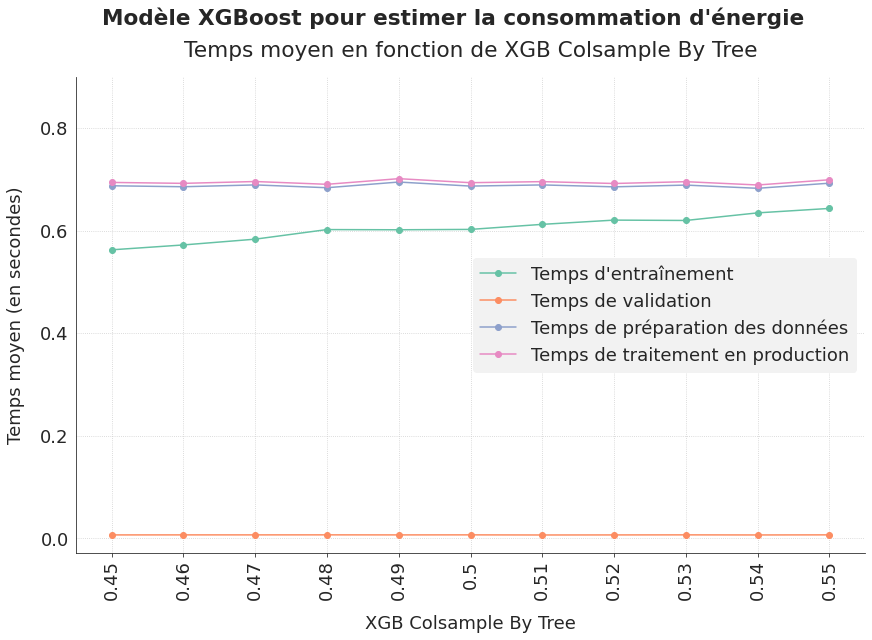

In [ ]:
fig, ax = graph_modele_time(xgb_conso_second_stepb, "xgb_colsample_bytree", "XGBoost", "XGB Colsample By Tree",
                           "la consommation d'énergie", ymax=0.9, rotation=90)
plt.show()

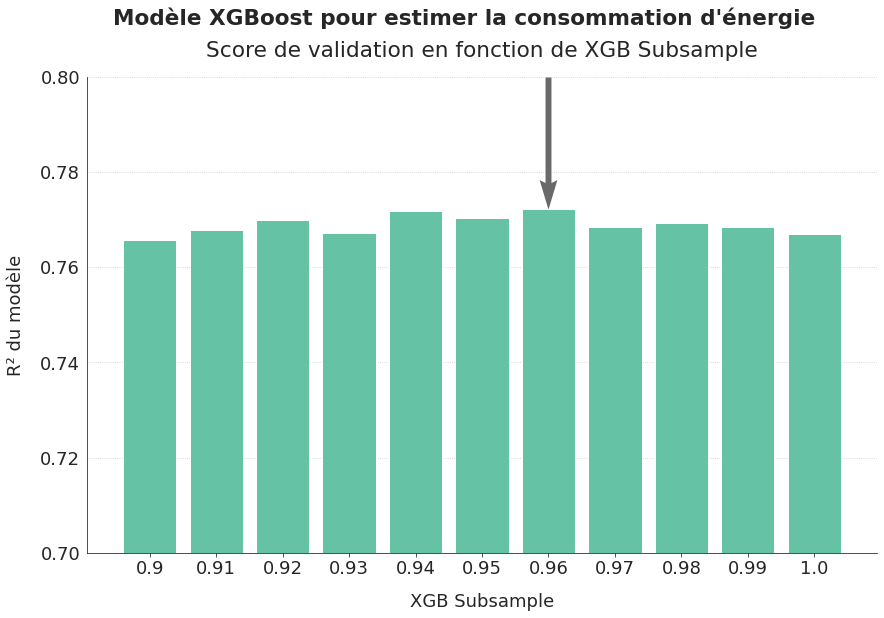

In [ ]:
fig, ax = graph_modele_score(xgb_conso_second_stepb, "xgb_subsample", "XGBoost", "XGB Subsample",
                              "la consommation d'énergie", ymin=0.7, ymax=0.8)
plt.show()

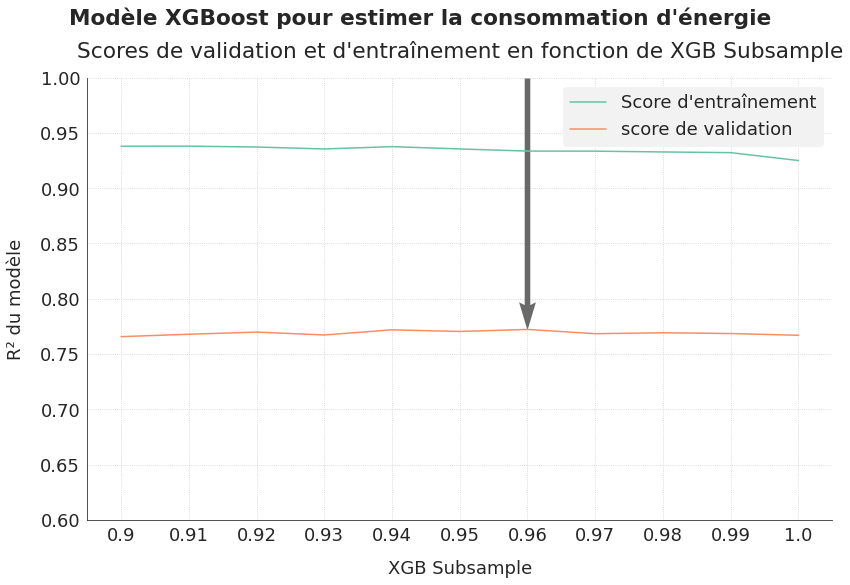

In [ ]:
fig, ax = graph_compar_train_valid(xgb_conso_second_stepb, "xgb_subsample", "XGBoost", "XGB Subsample",
                               "la consommation d'énergie", ymin=0.6)
save_fig("ml03_2_17_xgb7b")
plt.show()

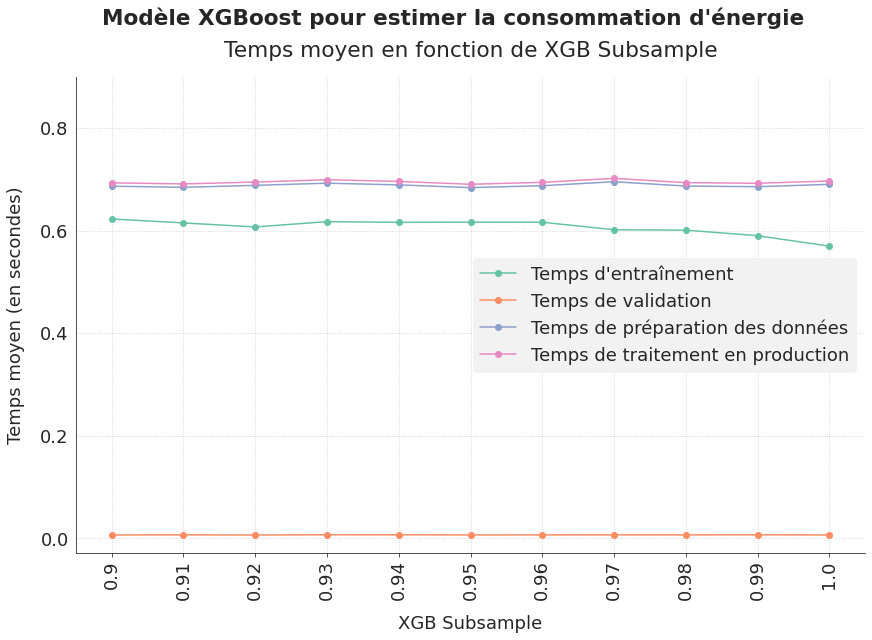

In [ ]:
fig, ax = graph_modele_time(xgb_conso_second_stepb, "xgb_subsample", "XGBoost", "XGB Subsample",
                           "la consommation d'énergie", ymax=0.9, rotation=90)
plt.show()

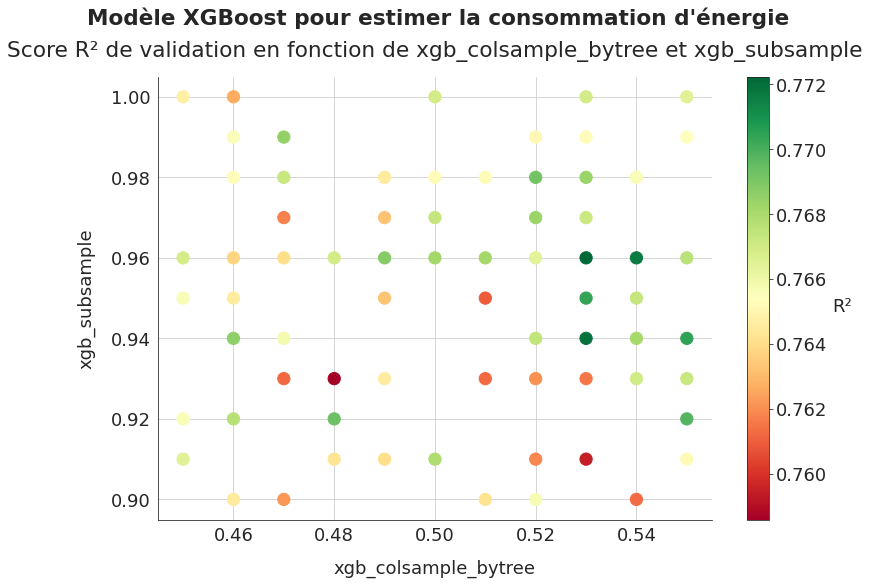

In [ ]:
fig, ax = graph_cross_score(xgb_conso_second_stepb, "xgb_colsample_bytree", "xgb_subsample", "XGBoost",
                            "la consommation d'énergie", size=150)
save_fig("ml03_2_17_xgb7c")
plt.show()

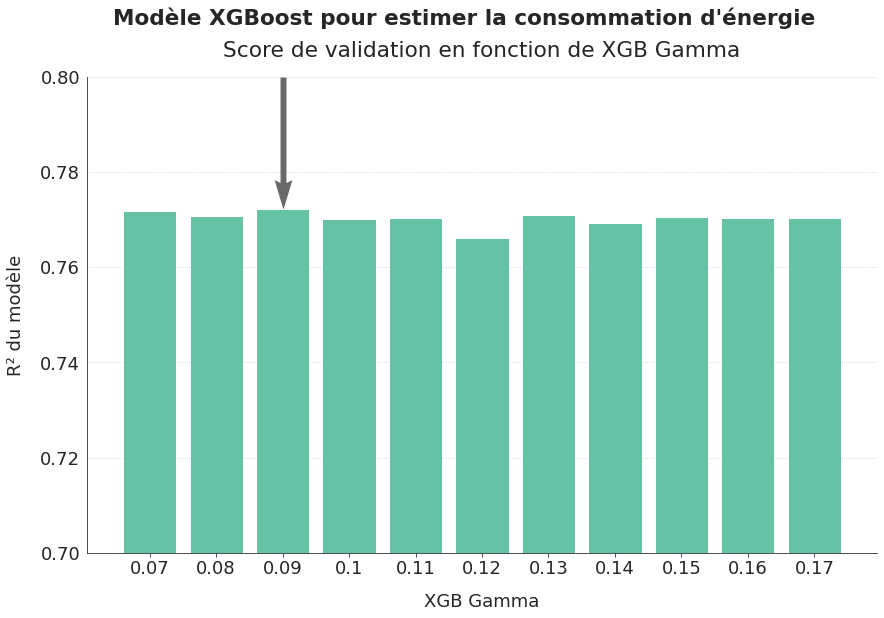

In [ ]:
fig, ax = graph_modele_score(xgb_conso_second_stepb, "xgb_gamma", "XGBoost", "XGB Gamma",
                              "la consommation d'énergie", ymin=0.7, ymax=0.8)
plt.show()

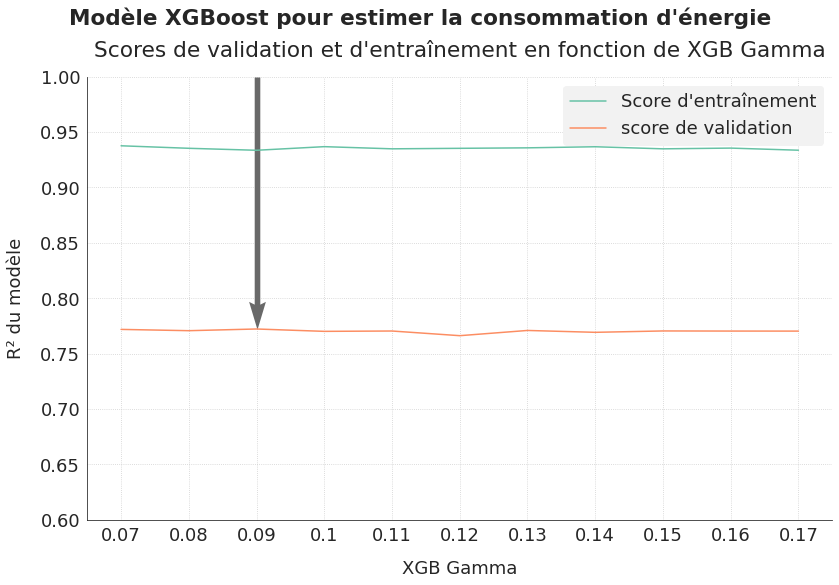

In [ ]:
fig, ax = graph_compar_train_valid(xgb_conso_second_stepb, "xgb_gamma", "XGBoost", "XGB Gamma",
                               "la consommation d'énergie", ymin=0.6)
save_fig("ml03_2_17_xgb7d")
plt.show()

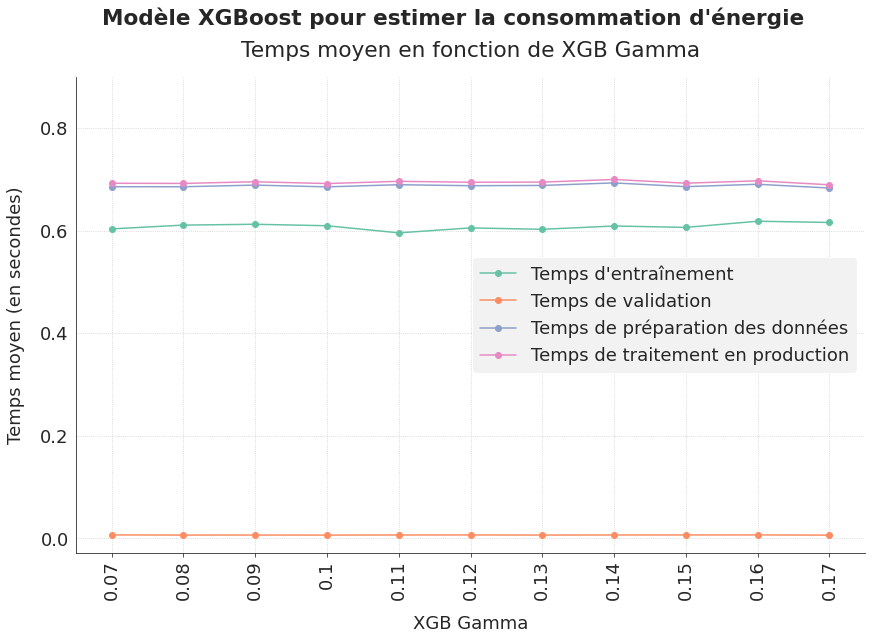

In [ ]:
fig, ax = graph_modele_time(xgb_conso_second_stepb, "xgb_gamma", "XGBoost", "XGB Gamma",
                           "la consommation d'énergie", ymax=0.9, rotation=90)
plt.show()

<a id='4_6_3'></a>

#### 4.6.3. XGBoost : troisième étape

J'optimise les hyperparamètres de XGBoost liés à la régularisation : reg_alpha et reg_lambda.

In [ ]:
# conso_pipeline for XGBRegressor
conso_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', AllImputation(KNNImputer(), categ_cols=categ_col, missforest=False)),
    ('data_encoders', FitToPandas(encoder_perso_onehot, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=False, keep_all=False)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler(), transfo_col, 'transfo_num'))
])
reg_pipeline = Pipeline([('estimator', XGBRegressor(n_jobs=-1, random_state=42))])

In [ ]:
space = {
    'data_imputers__sk_object__n_neighbors': 37,
    'data_imputers__sk_object__weights': 'distance',
    'data_case': {'encoders': encoder_perso_onehot,
         'list_name': transfo_col,
         'restrict_cols': 'transfo_num'},
    'estimator__objective': 'reg:squarederror',
    'estimator__n_estimators': 170,
    'estimator__learning_rate': 0.13,
    'estimator__max_depth': 4,
    'estimator__min_child_weight': 1,
    'estimator__colsample_bytree': 0.53,
    'estimator__subsample': 0.96,
    'estimator__gamma': 0.09,
    'estimator__reg_alpha': hp.choice('estimator__reg_alpha', np.arange(0.0, 2.0, 0.1)),
    'estimator__reg_lambda': hp.choice('estimator__reg_lambda', np.arange(0.0, 2.0, 0.1))
}

In [ ]:
list_best_results = []

In [ ]:
estimator_name = 'xgboost'
step = 'final3a'
run_conso_optimization(max_evals=200, prefix=step, estimator_name=estimator_name)

100%|██████████| 200/200 [08:56<00:00,  2.68s/it, best loss: -0.7723210712723526]
Estimateur : xgboost - Done
Best cross-validation mean score = 0.7723210712723526
Associated standard deviation = 0.024499412625954578
Calculation time = 0.006431198120117188
Data preparation time = 0.691570855999089
Best cv score obtained after 92 iterations



In [ ]:
xgb_conso_third_stepa = pd.read_csv("hyperopt_conso_xgboost_final3a.csv")
xgb_conso_third_stepa.head()

,valid_score_mean,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,data_transfo_time,data_imputer,data_encoder,estimator,iteration
0,0.767483,0.022155,0.006704,0.933740,0.001985,0.642416,0.694327,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",1
1,0.761228,0.025081,0.006704,0.921694,0.001933,0.632633,0.671528,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",2
2,0.767167,0.018146,0.006520,0.933394,0.002076,0.619906,0.692422,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",3
3,0.767271,0.026289,0.006636,0.946392,0.002209,0.631061,0.706689,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",4
4,0.767308,0.023173,0.006422,0.931618,0.001673,0.626704,0.688272,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",5


In [ ]:
xgb_conso_third_stepa = remove_negative_scores(xgb_conso_third_stepa)
inter_str = [inter[inter.find('reg_alpha')+10:] for inter in xgb_conso_third_stepa.estimator]
xgb_conso_third_stepa["xgb_reg_alpha"] = [np.around(np.float(inter[:inter.find(',')]),2) for inter in inter_str]
inter_str = [inter[inter.find('reg_lambda')+11:] for inter in xgb_conso_third_stepa.estimator]
xgb_conso_third_stepa["xgb_reg_lambda"] = [np.around(np.float(inter[:inter.find(',')]),2) for inter in inter_str]
xgb_conso_third_stepa["total_time"] = xgb_conso_third_stepa.valid_time_mean + xgb_conso_third_stepa.data_transfo_time

In [ ]:
xgb_conso_third_stepa[["valid_score_mean","train_score_mean","iteration", 
                      "xgb_reg_alpha","xgb_reg_lambda","total_time"]].\
                    sort_values("valid_score_mean", ascending=False).head(10)

,valid_score_mean,train_score_mean,iteration,xgb_reg_alpha,xgb_reg_lambda,total_time
100,0.772321,0.934735,101,0.1,1.2,0.701344
98,0.772321,0.934735,99,0.1,1.2,0.693623
99,0.772321,0.934735,100,0.1,1.2,0.687476
101,0.772321,0.934735,102,0.1,1.2,0.708883
97,0.772321,0.934735,98,0.1,1.2,0.692318
96,0.772321,0.934735,97,0.1,1.2,0.681614
102,0.772321,0.934735,103,0.1,1.2,0.696179
95,0.772321,0.934735,96,0.1,1.2,0.695371
94,0.772321,0.934735,95,0.1,1.2,0.688854
93,0.772321,0.934735,94,0.1,1.2,0.687246


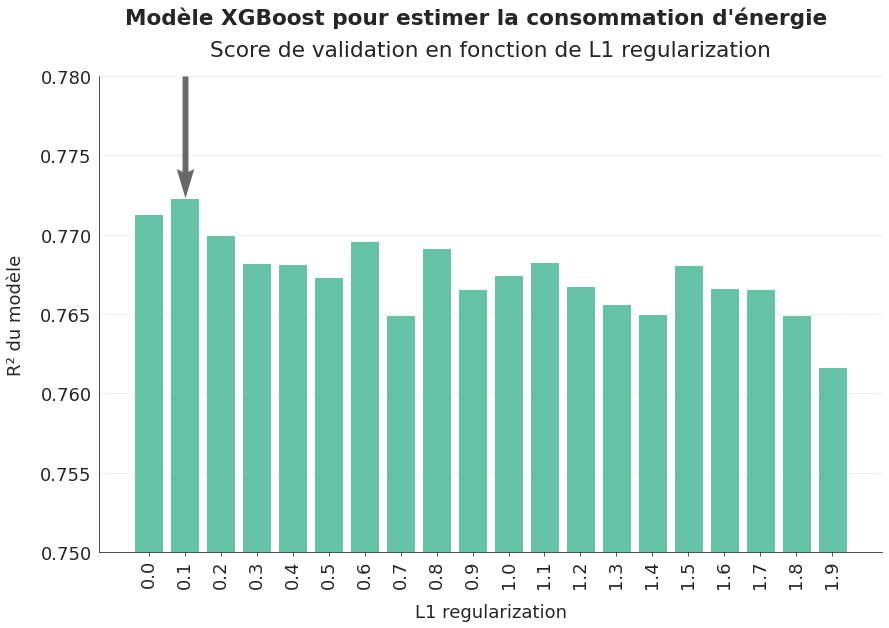

In [ ]:
fig, ax = graph_modele_score(xgb_conso_third_stepa, "xgb_reg_alpha", "XGBoost", "L1 regularization",
                             "la consommation d'énergie", ymin=0.75, ymax=0.78, rotation=90)
plt.show()

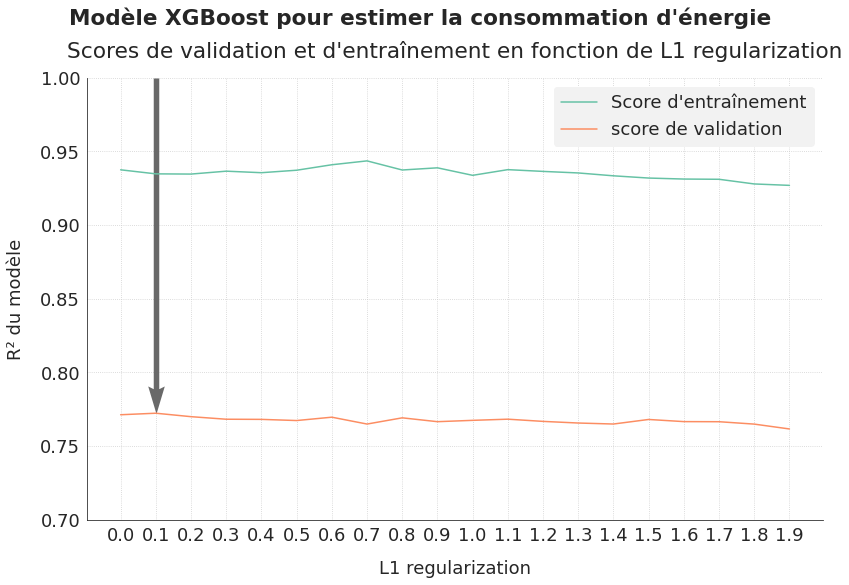

In [ ]:
fig, ax = graph_compar_train_valid(xgb_conso_third_stepa, "xgb_reg_alpha", "XGBoost", "L1 regularization", 
                                   "la consommation d'énergie", ymin=0.7, rotation=0)
save_fig("ml03_2_18_xgb8a")
plt.show()

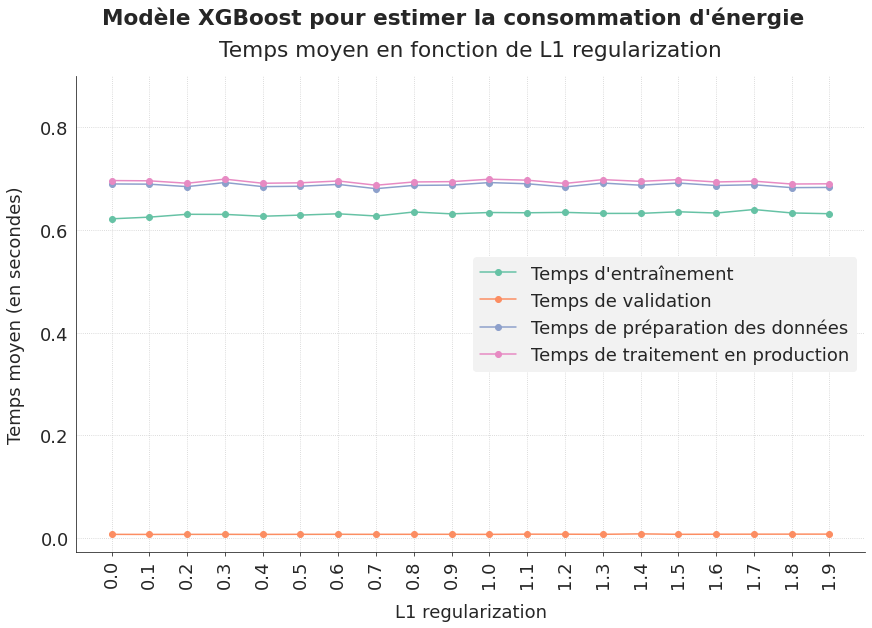

In [ ]:
fig, ax = graph_modele_time(xgb_conso_third_stepa, "xgb_reg_alpha", "XGBoost", "L1 regularization", 
                           "la consommation d'énergie", ymax=0.90, rotation=90)
plt.show()

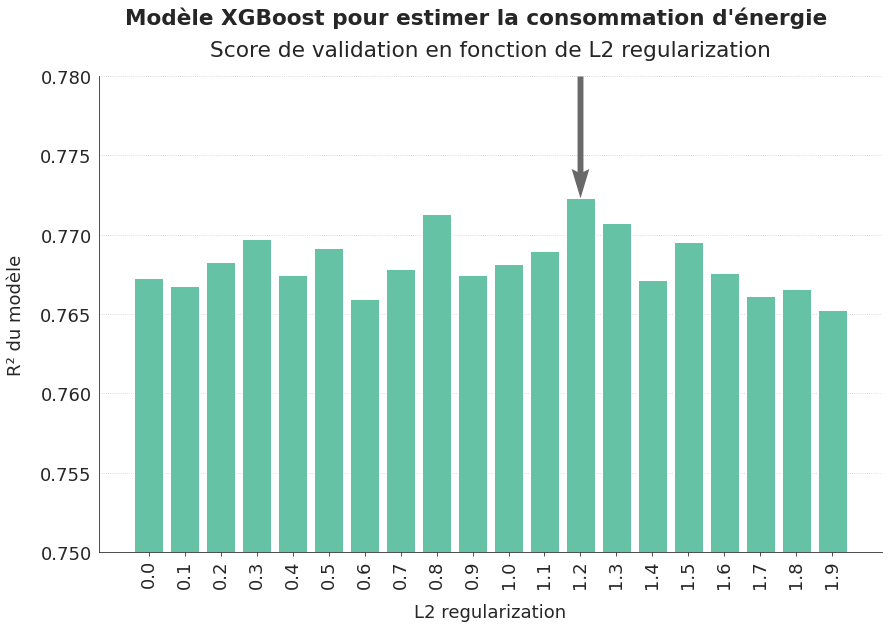

In [ ]:
fig, ax = graph_modele_score(xgb_conso_third_stepa, "xgb_reg_lambda", "XGBoost", "L2 regularization",
                             "la consommation d'énergie", ymin=0.75, ymax=0.78, rotation=90)
plt.show()

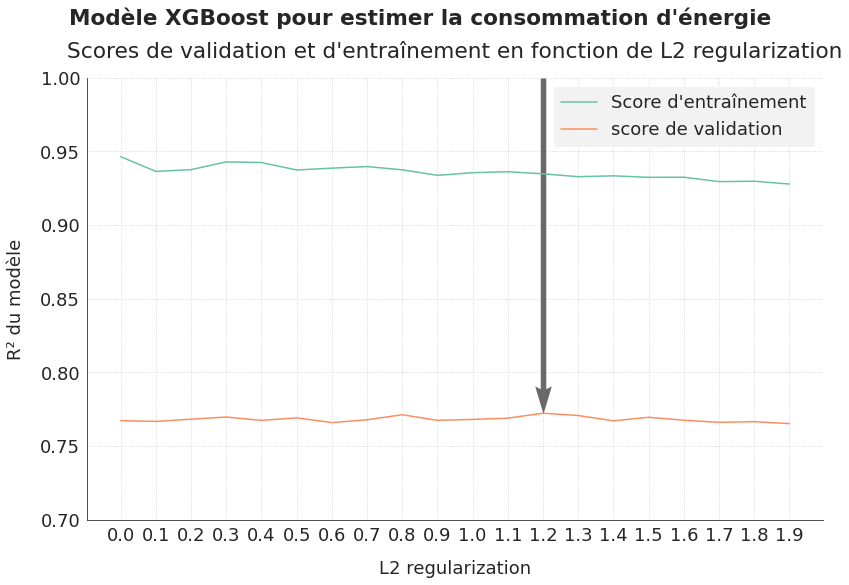

In [ ]:
fig, ax = graph_compar_train_valid(xgb_conso_third_stepa, "xgb_reg_lambda", "XGBoost", "L2 regularization", 
                                   "la consommation d'énergie", ymin=0.7, rotation=0)
save_fig("ml03_2_18_xgb8b")
plt.show()

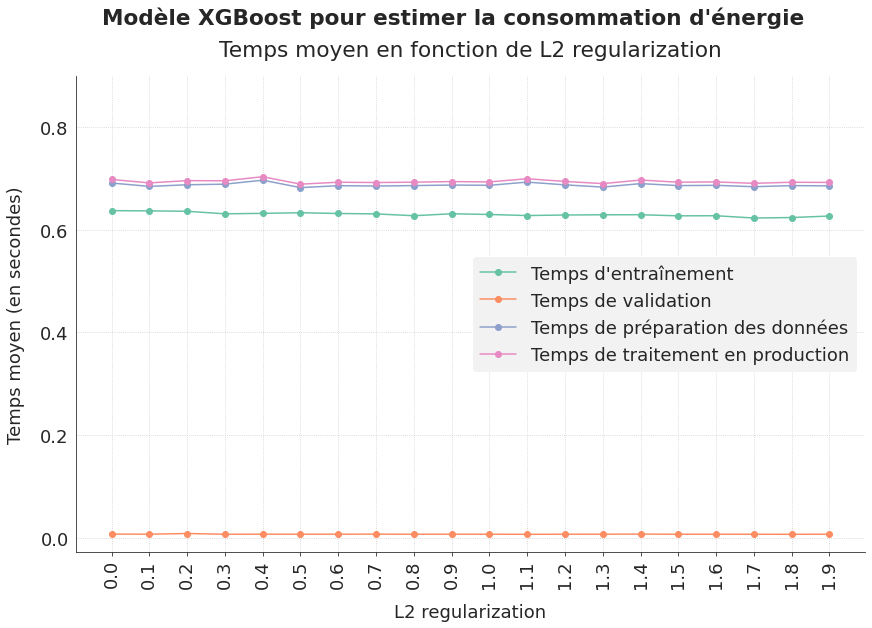

In [ ]:
fig, ax = graph_modele_time(xgb_conso_third_stepa, "xgb_reg_lambda", "XGBoost", "L2 regularization", 
                           "la consommation d'énergie", ymax=0.90, rotation=90)
plt.show()

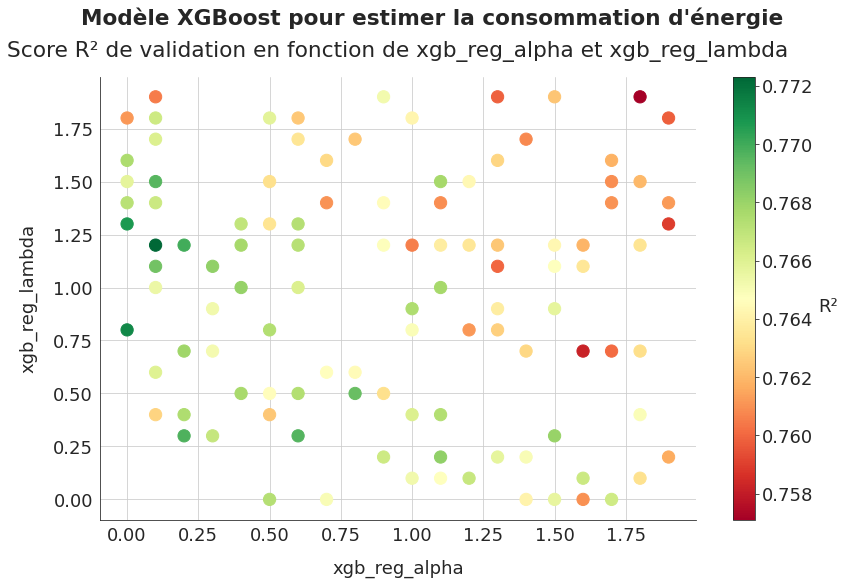

In [ ]:
fig, ax = graph_cross_score(xgb_conso_third_stepa, "xgb_reg_alpha", "xgb_reg_lambda", "XGBoost",
                            "la consommation d'énergie", size=150)
save_fig("ml03_2_18_xgb8c")
plt.show()

<a id='4_6_4'></a>

#### 4.6.4. XGBoost : feature importances

In [ ]:
# conso_pipeline for XGBRegressor
conso_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', AllImputation(KNNImputer(), categ_cols=categ_col, missforest=False)),
    ('data_encoders', FitToPandas(encoder_perso_onehot, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=False, keep_all=False)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler(), transfo_col, 'transfo_num'))
])
reg_pipeline = Pipeline([('estimator', XGBRegressor(n_jobs=-1, random_state=42))])

In [ ]:
space = {
    'data_imputers__sk_object__n_neighbors': 37,
    'data_imputers__sk_object__weights': 'distance',
    'data_case': {'encoders': encoder_perso_onehot,
         'list_name': transfo_col,
         'restrict_cols': 'transfo_num'},
    'estimator__objective': 'reg:squarederror',
    'estimator__n_estimators': 170,
    'estimator__learning_rate': 0.13,
    'estimator__max_depth': 4,
    'estimator__min_child_weight': 1,
    'estimator__colsample_bytree': 0.53,
    'estimator__subsample': 0.96,
    'estimator__gamma': 0.09,
    'estimator__reg_alpha': 0.1,
    'estimator__reg_lambda': 1.2
}

In [ ]:
list_best_results = []

In [ ]:
estimator_name = 'xgboost'
step = 'finalverif'
run_conso_optimization(max_evals=1, prefix=step, estimator_name=estimator_name)

100%|██████████| 1/1 [00:02<00:00,  2.67s/it, best loss: -0.7723210712723526]
Estimateur : xgboost - Done
Best cross-validation mean score = 0.7723210712723526
Associated standard deviation = 0.024499412625954578
Calculation time = 0.006378602981567383
Data preparation time = 0.6788960399990174
Best cv score obtained after 1 iterations



In [ ]:
xgb_final_step = pd.read_csv("hyperopt_conso_xgboost_finalverif.csv")
xgb_final_step

,valid_score_mean,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,data_transfo_time,data_imputer,data_encoder,estimator,iteration
0,0.772321,0.024499,0.006379,0.934735,0.003418,0.631148,0.678896,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",1


**Importance des variables obtenue par permutation aléatoire des données**

In [ ]:
# conso_pipeline for XGBRegressor
conso_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', AllImputation(KNNImputer(n_neighbors=37, weights='distance'), categ_cols=categ_col, missforest=False)),
    ('data_encoders', FitToPandas(encoder_perso_onehot, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=False, keep_all=False)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler(), transfo_col, 'transfo_num'))
])
reg = XGBRegressor(n_jobs=-1, random_state=42,
                   objective='reg:squarederror', n_estimators=170, learning_rate=0.13,
                   max_depth=4, min_child_weight=1, colsample_bytree=0.53, subsample=0.96, gamma=0.09,
                   reg_alpha=0.1, reg_lambda=1.2)

In [ ]:
feat_imp3 = eval_feature_importance(conso_pipeline, reg, X_train_conso, ln_y_train_conso)
feat_imp3.describe()

,importance,importance_stability
count,98.000000,98.000000
mean,0.009997,0.000629
std,0.039897,0.001598
min,0.000000,0.000000
25%,0.000015,0.000001
50%,0.000676,0.000144
75%,0.004416,0.000541
max,0.345611,0.012277


In [ ]:
feat_imp3.sort_values("importance", ascending=False)

,importance,importance_stability
ln_PropertyGFATotal,0.345611,0.012277
ENERGYSTARScore,0.153798,0.005676
ln_LargestPropertyUseTypeGFA,0.113158,0.007036
PrimaryPropertyType_Warehouse,0.051357,0.003716
ln_PropertyGFABuilding(s),0.048790,0.002378
...,...,...
Use_Fitness Center/Health Club/Gym,0.000000,0.000000
Use_Lifestyle Center,0.000000,0.000000
Use_Other - Lodging/Residential,0.000000,0.000000
Use_Medical Office,0.000000,0.000000


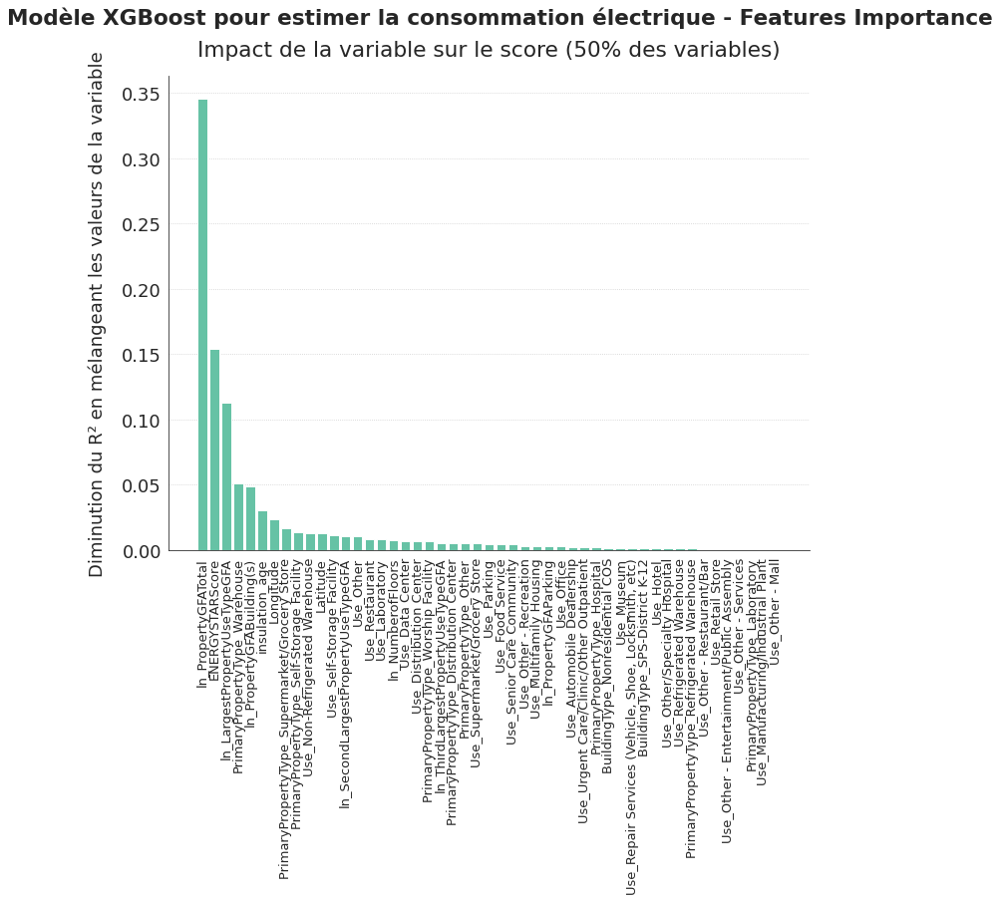

In [ ]:
fig, ax = graph_importance(feat_imp3, "importance", "Impact de la variable sur le score", "XGBoost", 
                           "la consommation électrique", horizontal=False, fontsize=13)
ax[0].set_ylabel("Diminution du R² en mélangeant les valeurs de la variable")
plt.show()

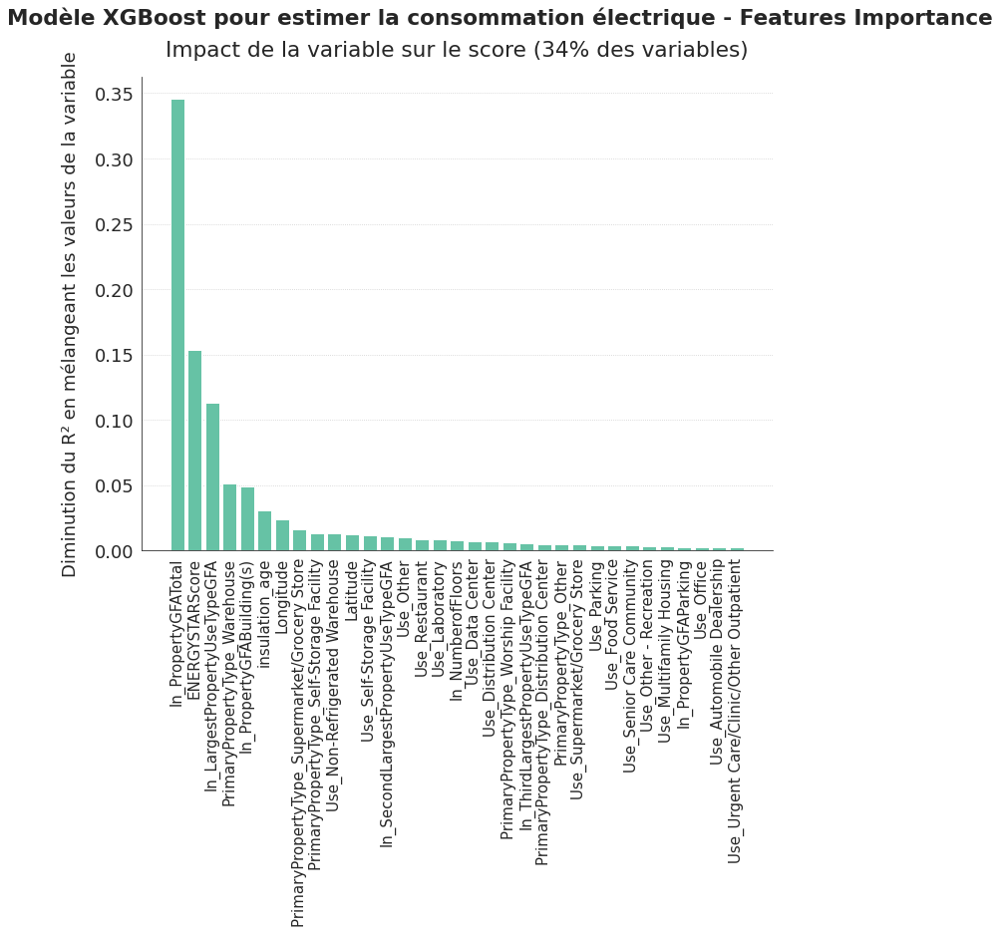

In [ ]:
fig, ax = graph_importance(feat_imp3, "importance", "Impact de la variable sur le score", "XGBoost", 
                           "la consommation électrique", percentile=0.66, horizontal=False, fontsize=15)
ax[0].set_ylabel("Diminution du R² en mélangeant les valeurs de la variable")
plt.show()

**Importance des variables calculée par l'algorithme de XGBoost**

In [ ]:
# conso_pipeline for XGBRegressor
conso_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', AllImputation(KNNImputer(n_neighbors=37, weights='distance'), categ_cols=categ_col, missforest=False)),
    ('data_encoders', FitToPandas(encoder_perso_onehot, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=False, keep_all=False)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler(), transfo_col, 'transfo_num'))
])
reg = XGBRegressor(n_jobs=-1, random_state=42,
                   objective='reg:squarederror', n_estimators=170, learning_rate=0.13,
                   max_depth=4, min_child_weight=1, colsample_bytree=0.53, subsample=0.96, gamma=0.09,
                   reg_alpha=0.1, reg_lambda=1.2)

In [ ]:
transformed_data = conso_pipeline.fit_transform(X_train_conso, ln_y_train_conso)
reg.fit(transformed_data, ln_y_train_conso)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=0.53, gamma=0.09,
             importance_type='gain', learning_rate=0.13, max_delta_step=0,
             max_depth=4, min_child_weight=1, missing=None, n_estimators=170,
             n_jobs=-1, nthread=None, objective='reg:squarederror',
             random_state=42, reg_alpha=0.1, reg_lambda=1.2, scale_pos_weight=1,
             seed=None, silent=None, subsample=0.96, verbosity=1)

In [ ]:
boost = reg.get_booster()

In [ ]:
feature_importance = pd.DataFrame({'weight': boost.get_score(importance_type='weight'),
                                   'gain': boost.get_score(importance_type='gain'),
                                   'total_gain': boost.get_score(importance_type='total_gain')},
                                  index = transformed_data.columns)
feature_importance.head()

,weight,gain,total_gain
Latitude,114.0,0.912413,104.015076
Longitude,164.0,0.797355,130.766210
ENERGYSTARScore,167.0,3.656470,610.630448
insulation_age,132.0,1.220123,161.056212
ln_NumberofFloors,36.0,3.261662,117.419835


In [ ]:
feature_importance.describe()

,weight,gain,total_gain
count,75.000000,75.000000,75.000000
mean,20.946667,2.137353,89.531640
std,36.275184,3.270338,328.264218
min,1.000000,0.203554,0.203554
25%,3.500000,0.712790,3.040902
50%,9.000000,1.101439,9.656515
75%,16.000000,2.518116,46.352212
max,167.000000,25.093229,2584.602595


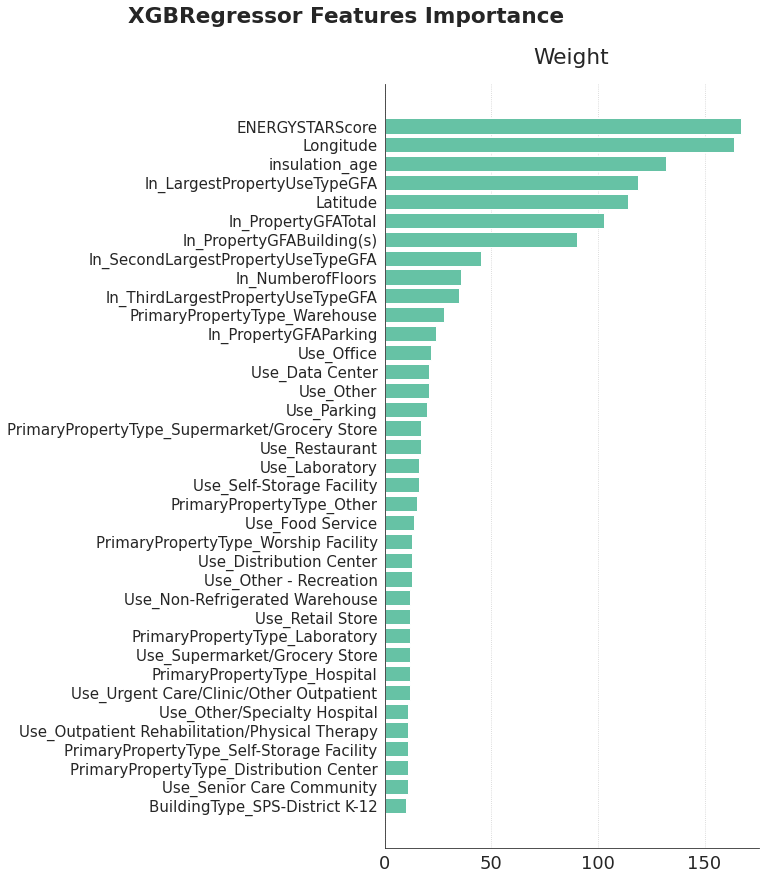

In [ ]:
feat = feature_importance[feature_importance.weight>9].sort_values("weight")
graph = sfg.MyGraph("XGBRegressor Features Importance", figsize=(12,12))
graph.add_barh(feat.index, feat.weight, subtitle='Weight')
fig, ax = graph.fig, graph.ax
ax[0].tick_params(axis="y", labelsize=15)
plt.show()

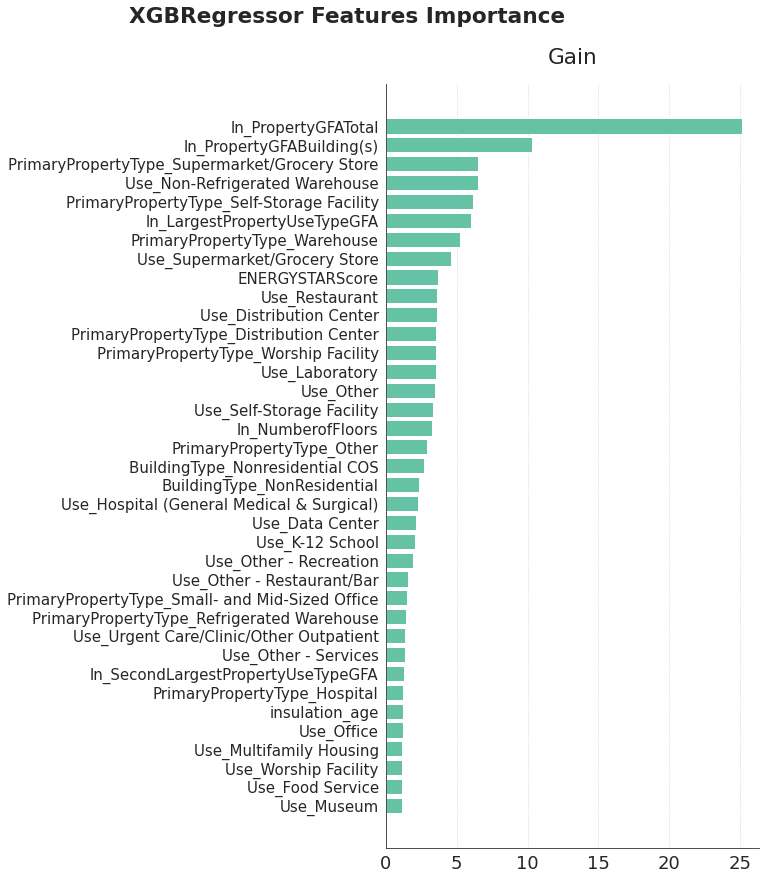

In [ ]:
feat = feature_importance[feature_importance.gain>1.10144].sort_values("gain")
graph = sfg.MyGraph("XGBRegressor Features Importance", figsize=(12,12))
graph.add_barh(feat.index, feat.gain, subtitle='Gain')
fig, ax = graph.fig, graph.ax
ax[0].tick_params(axis="y", labelsize=15)
plt.show()

L'importance la plus significative est 'Gain' : elle représente le gain moyen lorsqu'une variable détermine la décision à un noeud.  
'Weight' décompte simplement le nombre de noeuds où la variable détermine la décision, sans regarder le gain qui en découle.

<a id='4_6_5'></a>

#### 4.6.5. Kernel SVM : première étape

1ère étape SVR : déterminer les hyperparamètres du knn imputer en même temps que le Kernel et le C du SVM.

In [ ]:
# conso_pipeline for SVR
conso_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', AllImputation(KNNImputer(), categ_cols=categ_col, missforest=False)),
    ('data_encoders', FitToPandas(encoder_perso_onehot, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=False, keep_all=False)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler(), transfo_col, 'transfo_num'))
])
reg_pipeline = Pipeline([('estimator', SVR())])

In [ ]:
space = {
    'data_imputers__sk_object__n_neighbors': hp.choice('data_imputers__sk_object__n_neighbors', np.arange(3, 30, 2, dtype=int)),
    'data_imputers__sk_object__weights': hp.choice('data_imputers__sk_object__weights', ['uniform','distance']),
    'data_case': {'encoders': encoder_perso_onehot,
                  'list_name': transfo_col,
                  'restrict_cols': 'transfo_num'},
    'estimator__kernel': hp.choice('estimator__kernel', ['linear', 'poly', 'rbf', 'sigmoid']),
    'estimator__C': hp.loguniform('estimator__C', np.log(0.001), np.log(100))
}

In [ ]:
list_best_results = []

In [ ]:
estimator_name = 'svr'
step = 'final1'
run_conso_optimization(max_evals=400, prefix=step, estimator_name=estimator_name)

100%|██████████| 400/400 [28:50<00:00,  4.33s/it, best loss: -0.7633159651961796]
Estimateur : svr - Done
Best cross-validation mean score = 0.7633159651961796
Associated standard deviation = 0.016078033945062197
Calculation time = 0.05831866264343262
Data preparation time = 0.6753873430006934
Best cv score obtained after 275 iterations



In [ ]:
svr_conso_first_step = pd.read_csv("hyperopt_conso_svr_final1.csv")
svr_conso_first_step.head()

,valid_score_mean,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,data_transfo_time,data_imputer,data_encoder,estimator,iteration
0,0.444236,0.019058,0.066292,0.447108,0.006345,0.329359,0.686260,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"SVR(C=0.00551835549917125, cache_size=200, coe...",1
1,0.756932,0.016339,0.057376,0.855695,0.003320,0.320813,0.683230,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"SVR(C=1.0127128178046512, cache_size=200, coef...",2
2,0.748932,0.018055,0.057337,0.817942,0.003727,0.310800,0.687376,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"SVR(C=0.4787292803761848, cache_size=200, coef...",3
3,0.731567,0.030299,0.045685,0.745415,0.008493,0.256922,0.681495,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"SVR(C=0.005104617649596701, cache_size=200, co...",4
4,0.698308,0.023021,0.048499,0.939649,0.004838,0.862672,0.717410,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"SVR(C=9.29391461770375, cache_size=200, coef0=...",5


In [ ]:
svr_conso_first_step = remove_negative_scores(svr_conso_first_step)
svr_conso_first_step["knn_n_neighbors"] = [np.int(inter[inter.find('n_neighbors')+12:inter.find('weights')-2]) \
                                           for inter in svr_conso_first_step.data_imputer]
svr_conso_first_step["knn_weights"] = [inter[inter.find('weights')+9:-3] \
                                           for inter in svr_conso_first_step.data_imputer]
svr_conso_first_step["encoder"] = [inter[:inter.find('(')] for inter in svr_conso_first_step.data_encoder]
inter_str = [inter[inter.find('kernel')+8:] for inter in svr_conso_first_step.estimator]
svr_conso_first_step["svr_kernel"] = [inter[:inter.find(',')-1] for inter in inter_str]
inter_str = [inter[inter.find('C=')+2:] for inter in svr_conso_first_step.estimator]
svr_conso_first_step["svr_C"] = [np.around(np.float(inter[:inter.find(',')]),5) for inter in inter_str]
svr_conso_first_step["total_time"] = svr_conso_first_step.valid_time_mean + svr_conso_first_step.data_transfo_time

In [ ]:
svr_conso_first_step[["valid_score_mean","train_score_mean","iteration","knn_n_neighbors","knn_weights","encoder",
                      "svr_kernel","svr_C","total_time"]].sort_values("valid_score_mean", ascending=False).head(10)

,valid_score_mean,train_score_mean,iteration,knn_n_neighbors,knn_weights,encoder,svr_kernel,svr_C,total_time
274,0.763316,0.894386,275,7,distance,CustomOneHotEncoder,rbf,2.27217,0.733706
343,0.762958,0.880272,344,21,distance,CustomOneHotEncoder,rbf,1.69590,0.744000
259,0.762720,0.891950,260,19,distance,CustomOneHotEncoder,rbf,2.16412,0.731197
262,0.762709,0.892356,263,19,distance,CustomOneHotEncoder,rbf,2.18451,0.739430
346,0.762679,0.877820,347,21,distance,CustomOneHotEncoder,rbf,1.60752,0.734755
234,0.762660,0.887950,235,19,distance,CustomOneHotEncoder,rbf,1.97619,0.758200
257,0.762649,0.887492,258,19,distance,CustomOneHotEncoder,rbf,1.95618,0.736949
357,0.762599,0.877188,358,21,distance,CustomOneHotEncoder,rbf,1.58556,0.735749
260,0.762564,0.894916,261,19,distance,CustomOneHotEncoder,rbf,2.31857,0.739469
185,0.762500,0.884134,186,19,distance,CustomOneHotEncoder,rbf,1.81609,0.737388


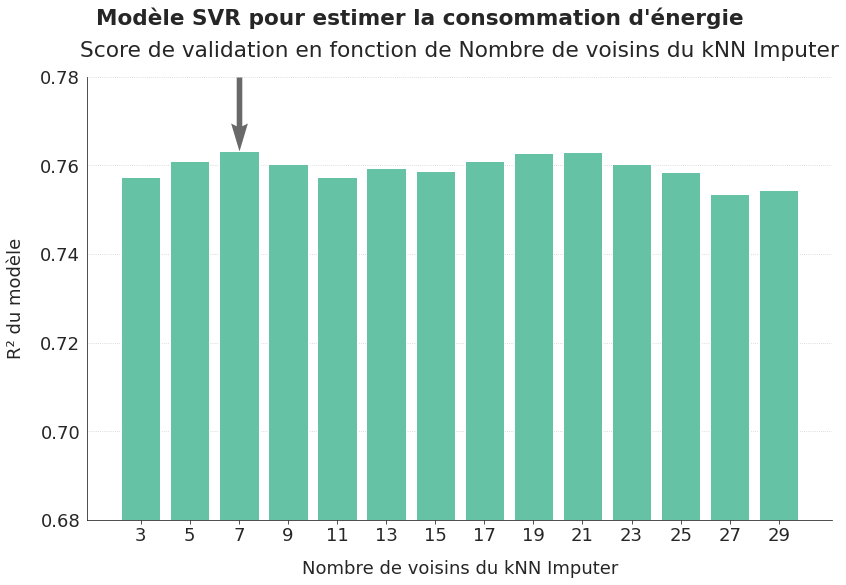

In [ ]:
fig, ax = graph_modele_score(svr_conso_first_step, "knn_n_neighbors", "SVR", "Nombre de voisins du kNN Imputer",
                             "la consommation d'énergie", ymin=0.68, ymax=0.78)
save_fig("ml03_2_21_svm1a")
plt.show()

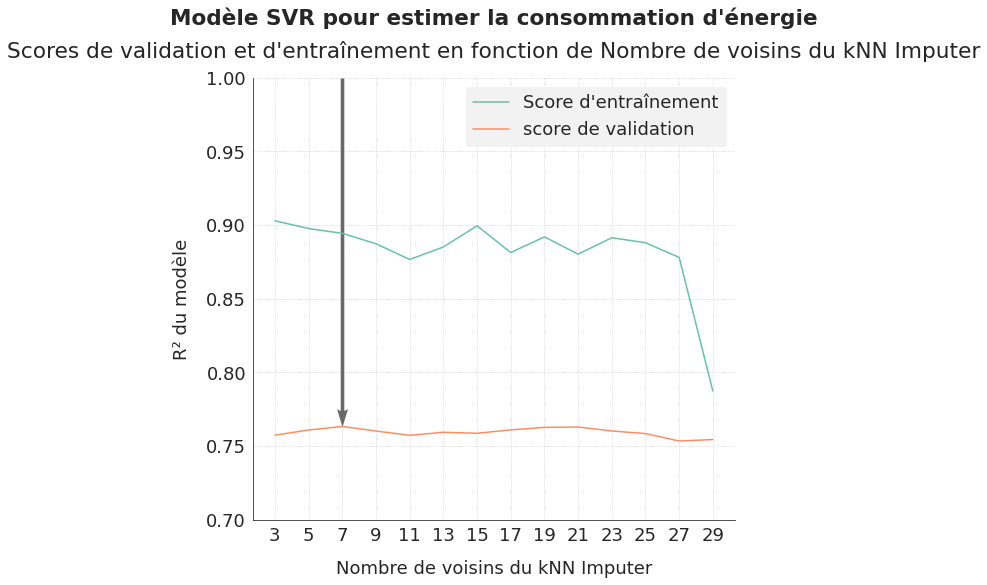

In [ ]:
fig, ax = graph_compar_train_valid(svr_conso_first_step, "knn_n_neighbors", "SVR", "Nombre de voisins du kNN Imputer", 
                                   "la consommation d'énergie", ymin=0.7, ymax=1)
save_fig("ml03_2_21_svm1b")
plt.show()

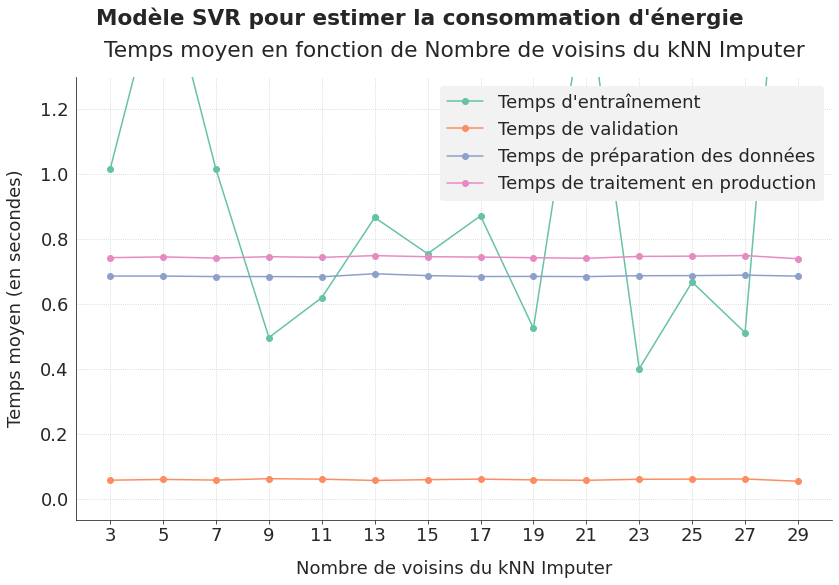

In [ ]:
fig, ax = graph_modele_time(svr_conso_first_step, "knn_n_neighbors", "SVR", "Nombre de voisins du kNN Imputer",
                             "la consommation d'énergie", ymax=1.3)
save_fig("ml03_2_21_svm1c")
plt.show()

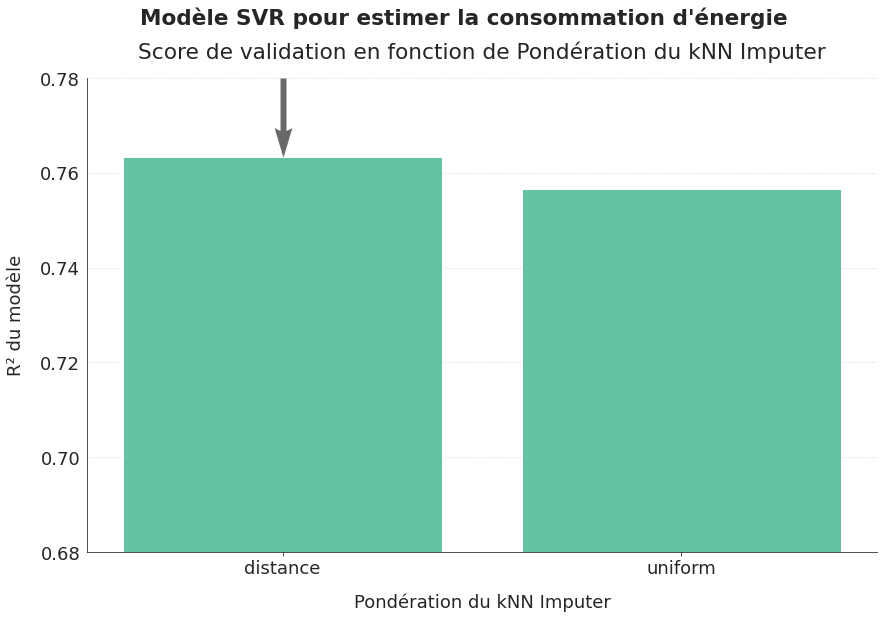

In [ ]:
fig, ax = graph_modele_score(svr_conso_first_step, "knn_weights", "SVR", "Pondération du kNN Imputer",
                             "la consommation d'énergie", ymin=0.68, ymax=0.78)
plt.show()

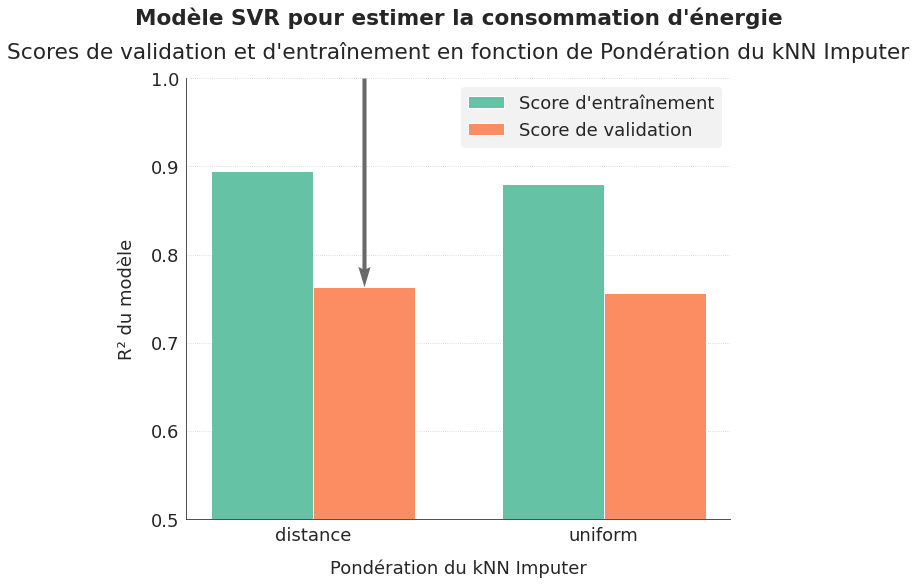

In [ ]:
fig, ax = graph_compar_train_valid(svr_conso_first_step, "knn_weights", "SVR", "Pondération du kNN Imputer", 
                                   "la consommation d'énergie", ymin=0.5, ymax=1, with_bars=True)
save_fig("ml03_2_22_svm2a")
plt.show()

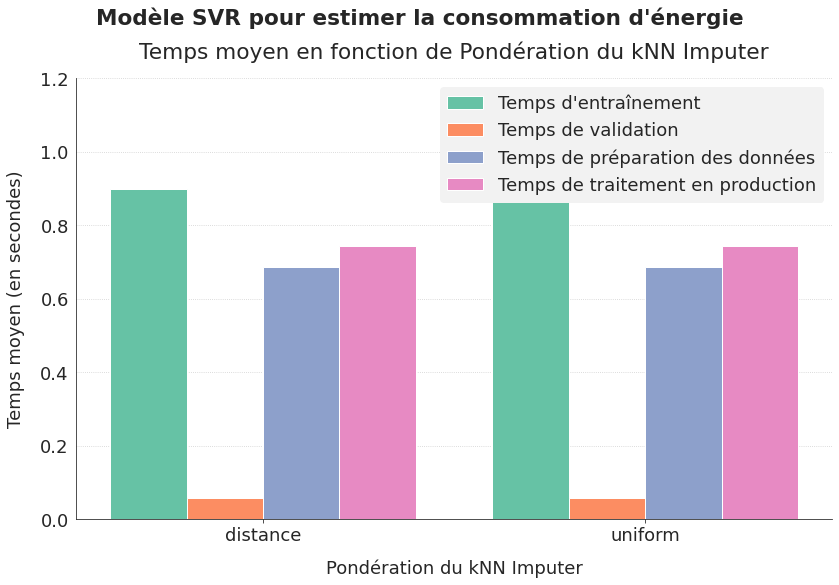

In [ ]:
fig, ax = graph_modele_time(svr_conso_first_step, "knn_weights", "SVR", "Pondération du kNN Imputer", 
                             "la consommation d'énergie", ymax=1.2, with_bars=True)
save_fig("ml03_2_22_svm2b")
plt.show()

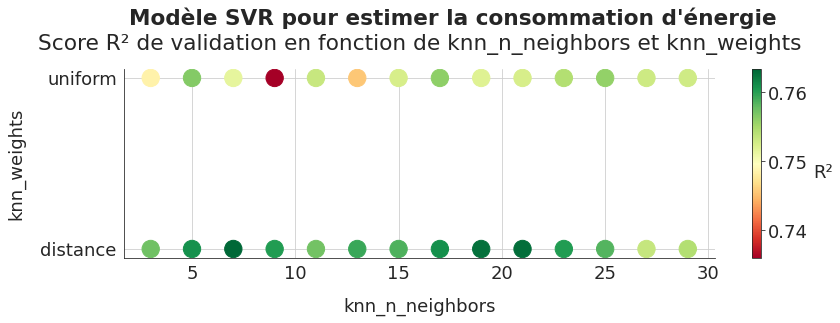

In [ ]:
fig, ax = graph_cross_score(svr_conso_first_step, "knn_n_neighbors", "knn_weights", "SVR",
                            "la consommation d'énergie", size=300, figsize=(12,4))
save_fig("ml03_2_22_svm2c", tight_layout=False)
plt.show()

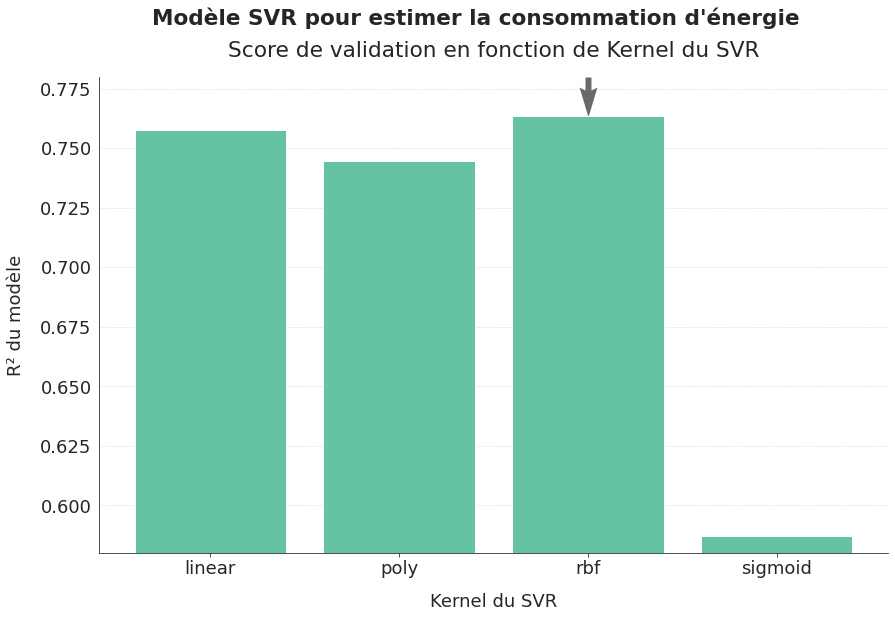

In [ ]:
fig, ax = graph_modele_score(svr_conso_first_step, "svr_kernel", "SVR", "Kernel du SVR",
                             "la consommation d'énergie", ymin=0.58, ymax=0.78)
plt.show()

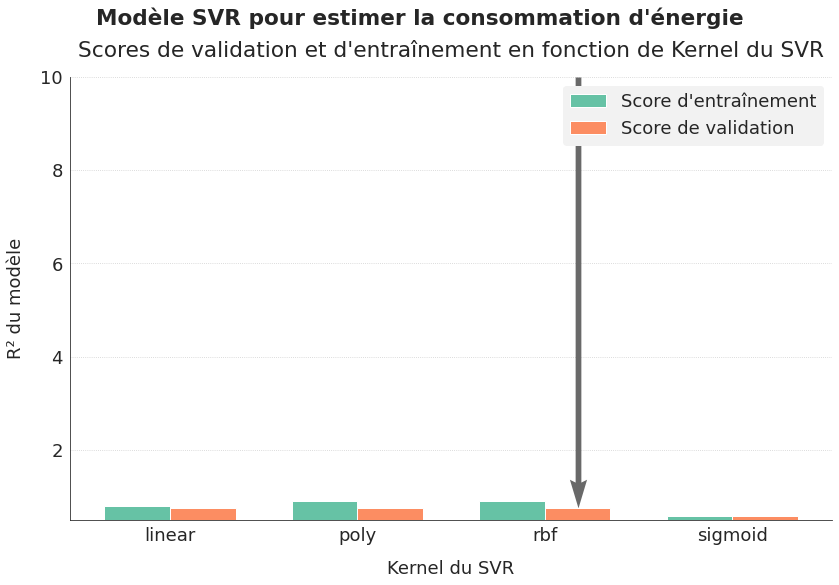

In [ ]:
fig, ax = graph_compar_train_valid(svr_conso_first_step, "svr_kernel", "SVR", "Kernel du SVR", 
                                   "la consommation d'énergie", ymin=0.5, ymax=10., with_bars=True)
save_fig("ml03_2_23_svm3a")
plt.show()

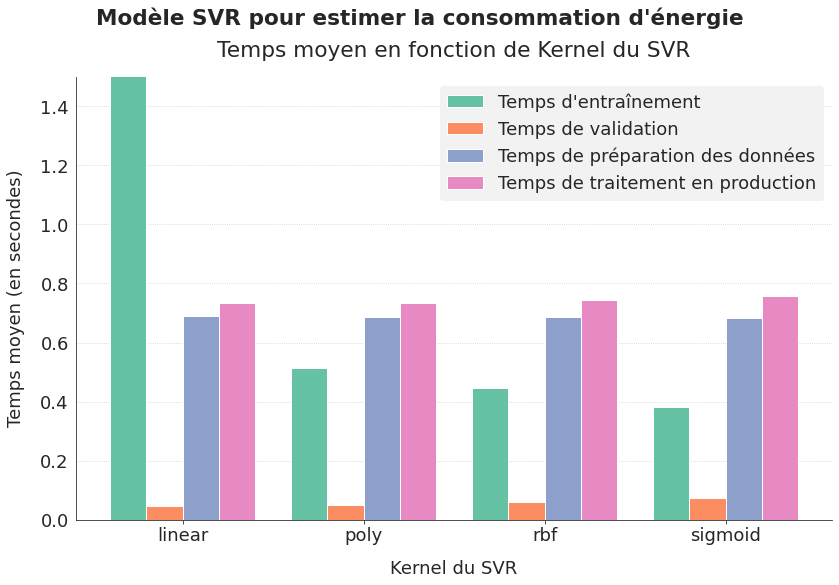

In [ ]:
fig, ax = graph_modele_time(svr_conso_first_step, "svr_kernel", "SVR", "Kernel du SVR",
                           "la consommation d'énergie", ymax=1.5, with_bars=True)
save_fig("ml03_2_23_svm3b")
plt.show()

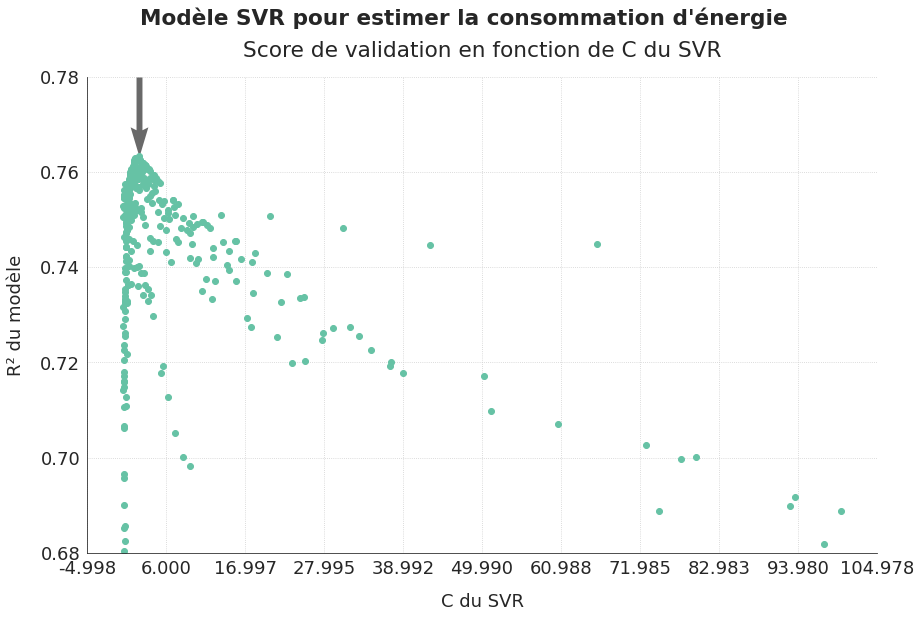

In [ ]:
fig, ax = graph_continu_preview(svr_conso_first_step, "svr_C", "SVR", "C du SVR",
                               "la consommation d'énergie", ymin=0.68, ymax=0.78)
plt.show()

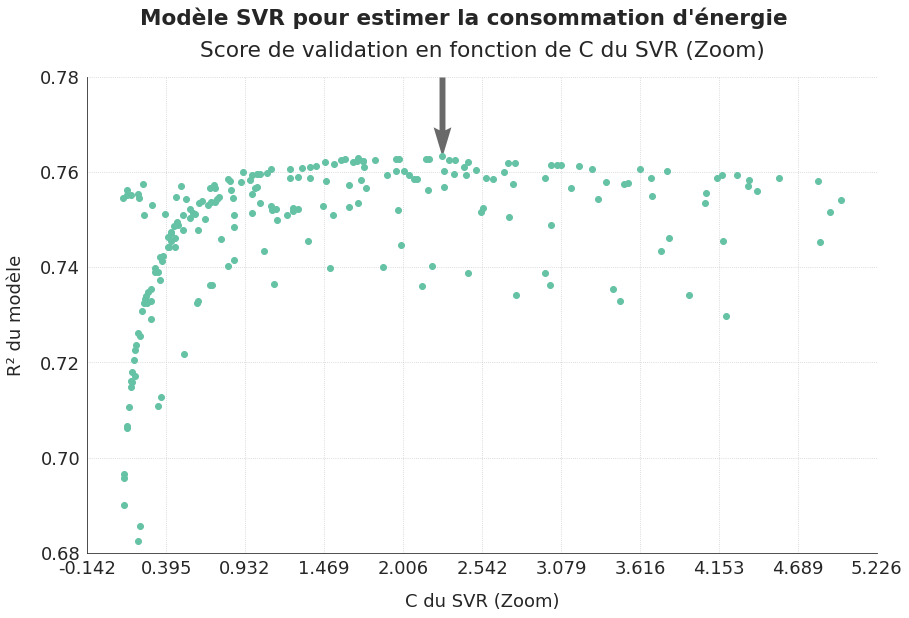

In [ ]:
fig, ax = graph_continu_preview(svr_conso_first_step[svr_conso_first_step.svr_C.between(0.1,5)], "svr_C", "SVR",
                                "C du SVR (Zoom)", "la consommation d'énergie", ymin=0.68, ymax=0.78)
plt.show()

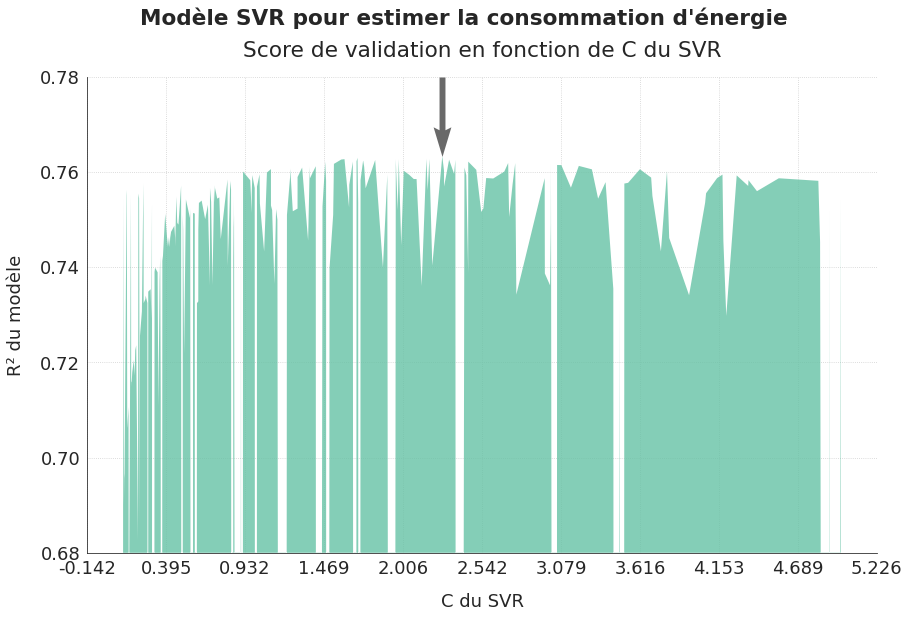

In [ ]:
fig, ax = graph_continu_score(svr_conso_first_step[svr_conso_first_step.svr_C.between(0.1,5)], "svr_C", "SVR", "C du SVR",
                               "la consommation d'énergie", ymin=0.68, ymax=0.78)
plt.show()

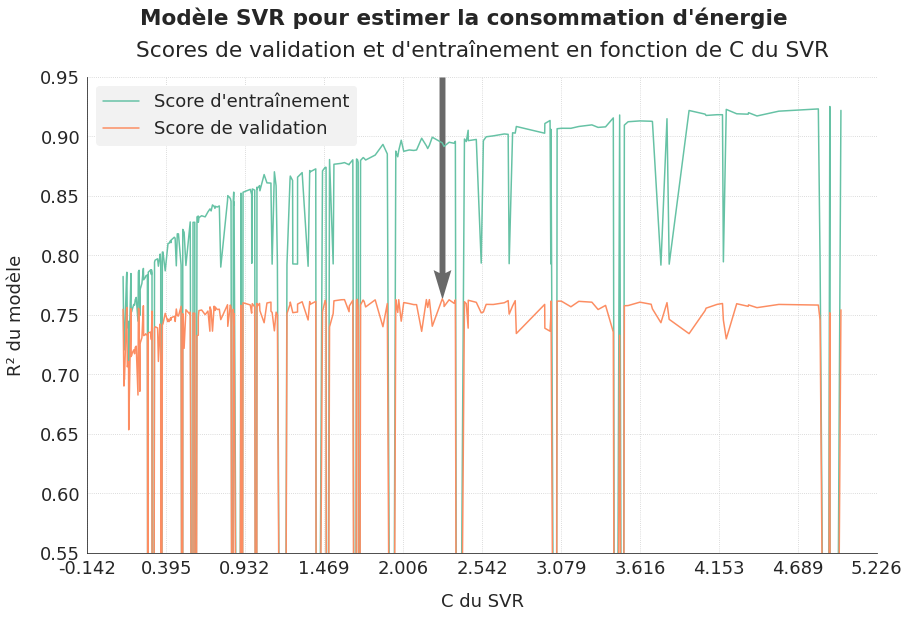

In [ ]:
fig, ax = graph_compar_continu(svr_conso_first_step[svr_conso_first_step.svr_C.between(0.1,5)], "svr_C", "SVR", "C du SVR",
                               "la consommation d'énergie", ymin=0.55, ymax=0.95)
plt.show()

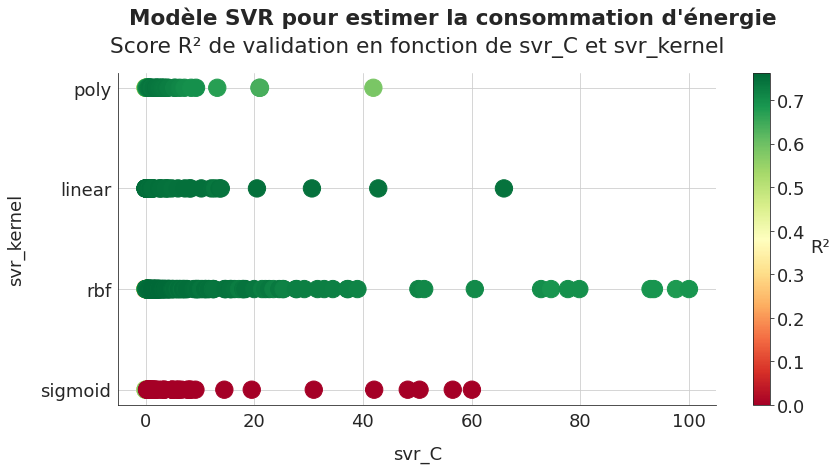

In [ ]:
fig, ax = graph_cross_score(svr_conso_first_step, "svr_C", "svr_kernel", "SVR",
                            "la consommation d'énergie", size=300, figsize=(12,6))
save_fig("ml03_2_23_svm3c", tight_layout=False)
plt.show()

<a id='4_6_6'></a>

#### 4.6.6. Kernel SVM : deuxième étape

J'affine les hyperparamètres du SVM, sachant que j'ai opté pour le noyau rbf qui est le plus prometteur, à la vue de la première étape.

In [ ]:
# conso_pipeline for SVR
conso_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', AllImputation(KNNImputer(), categ_cols=categ_col, missforest=False)),
    ('data_encoders', FitToPandas(encoder_perso_onehot, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=False, keep_all=False)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler(), transfo_col, 'transfo_num'))
])
reg_pipeline = Pipeline([('estimator', SVR())])

In [ ]:
space = {
    'data_imputers__sk_object__n_neighbors': 7,
    'data_imputers__sk_object__weights': 'distance',
    'data_case': {'encoders': encoder_perso_onehot,
                  'list_name': transfo_col,
                  'restrict_cols': 'transfo_num'},
    'estimator__kernel': 'rbf',
    'estimator__C': hp.choice('estimator__C', np.arange(1, 3.005, 0.05)),
    'estimator__gamma': hp.loguniform('estimator__gamma', np.log(0.01), np.log(100)),
    'estimator__epsilon': hp.loguniform('estimator__epsilon', np.log(0.01), np.log(100))
}

In [ ]:
list_best_results = []

In [ ]:
estimator_name = 'svr'
step = 'final2a'
run_conso_optimization(max_evals=400, prefix=step, estimator_name=estimator_name)

100%|██████████| 400/400 [13:52<00:00,  2.08s/it, best loss: -0.7736420550266577]
Estimateur : svr - Done
Best cross-validation mean score = 0.7736420550266577
Associated standard deviation = 0.0162302019598687
Calculation time = 0.0384552001953125
Data preparation time = 0.7176179399993998
Best cv score obtained after 216 iterations



In [ ]:
svr_conso_second_stepa = pd.read_csv("hyperopt_conso_svr_final2a.csv")
svr_conso_second_stepa.head()

,valid_score_mean,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,data_transfo_time,data_imputer,data_encoder,estimator,iteration
0,-0.101736,0.046979,0.001951,-0.097685,0.024615,0.005819,0.677982,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"SVR(C=1.6000000000000005, cache_size=200, coef...",1
1,-0.101736,0.046979,0.001854,-0.097685,0.024615,0.007103,0.703201,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"SVR(C=2.5500000000000016, cache_size=200, coef...",2
2,-0.101736,0.046979,0.002099,-0.097685,0.024615,0.005959,0.688209,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"SVR(C=2.950000000000002, cache_size=200, coef0...",3
3,-0.101736,0.046979,0.001936,-0.097685,0.024615,0.006390,0.706597,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"SVR(C=1.5000000000000004, cache_size=200, coef...",4
4,0.002251,0.008830,0.079617,0.986424,0.002053,0.419463,0.691559,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"SVR(C=2.9000000000000017, cache_size=200, coef...",5


In [ ]:
svr_conso_second_stepa = remove_negative_scores(svr_conso_second_stepa)
inter_str = [inter[inter.find('kernel')+8:] for inter in svr_conso_second_stepa.estimator]
svr_conso_second_stepa["svr_kernel"] = [inter[:inter.find(',')-1] for inter in inter_str]
inter_str = [inter[inter.find('C=')+2:] for inter in svr_conso_second_stepa.estimator]
svr_conso_second_stepa["svr_C"] = [np.around(np.float(inter[:inter.find(',')]),5) for inter in inter_str]
inter_str = [inter[inter.find('gamma')+6:] for inter in svr_conso_second_stepa.estimator]
svr_conso_second_stepa["svr_gamma"] = [np.around(np.float(inter[:inter.find(',')]),5) for inter in inter_str]
inter_str = [inter[inter.find('degree')+7:] for inter in svr_conso_second_stepa.estimator]
svr_conso_second_stepa["svr_degree"] = [np.int(inter[:inter.find(',')]) for inter in inter_str]
inter_str = [inter[inter.find('coef0')+6:] for inter in svr_conso_second_stepa.estimator]
svr_conso_second_stepa["svr_coef0"] = [np.around(np.float(inter[:inter.find(',')]),5) for inter in inter_str]
inter_str = [inter[inter.find('epsilon')+8:] for inter in svr_conso_second_stepa.estimator]
svr_conso_second_stepa["svr_epsilon"] = [np.around(np.float(inter[:inter.find(',')]),5) for inter in inter_str]
svr_conso_second_stepa["total_time"] = svr_conso_second_stepa.valid_time_mean + svr_conso_second_stepa.data_transfo_time

In [ ]:
svr_conso_second_stepa[["valid_score_mean", "train_score_mean", "iteration", "svr_kernel", "svr_C", "svr_gamma", "svr_degree",
                       "svr_coef0","svr_epsilon","total_time"]].sort_values("valid_score_mean", ascending=False).head(20)

,valid_score_mean,train_score_mean,iteration,svr_kernel,svr_C,svr_gamma,svr_degree,svr_coef0,svr_epsilon,total_time
215,0.773642,0.837387,216,rbf,2.90,0.01413,3,0.0,0.26921,0.756073
298,0.773385,0.819715,299,rbf,2.60,0.01014,3,0.0,0.30745,0.715278
146,0.773102,0.835902,147,rbf,2.75,0.01372,3,0.0,0.20131,0.730058
108,0.773093,0.823063,109,rbf,2.90,0.01006,3,0.0,0.23185,0.723606
276,0.772913,0.817309,277,rbf,2.40,0.01004,3,0.0,0.30302,0.711791
110,0.772838,0.834223,111,rbf,2.90,0.01282,3,0.0,0.18066,0.721553
259,0.772408,0.844107,260,rbf,2.90,0.01623,3,0.0,0.26725,0.730279
109,0.772228,0.825409,110,rbf,2.90,0.01061,3,0.0,0.18499,0.726392
257,0.772125,0.824075,258,rbf,2.90,0.01030,3,0.0,0.17925,0.733354
103,0.771739,0.821983,104,rbf,2.75,0.01015,3,0.0,0.17590,0.733678


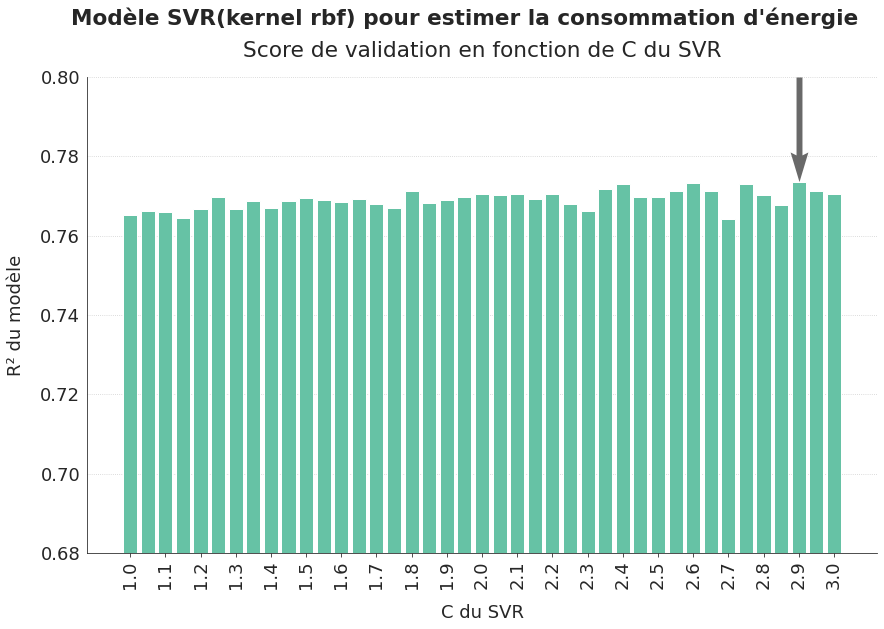

In [ ]:
fig, ax = graph_modele_score(svr_conso_second_stepa, "svr_C", "SVR(kernel rbf)", "C du SVR",
                             "la consommation d'énergie", ymin=0.68, ymax=0.8, tick_step=2, rotation=90)
plt.show()

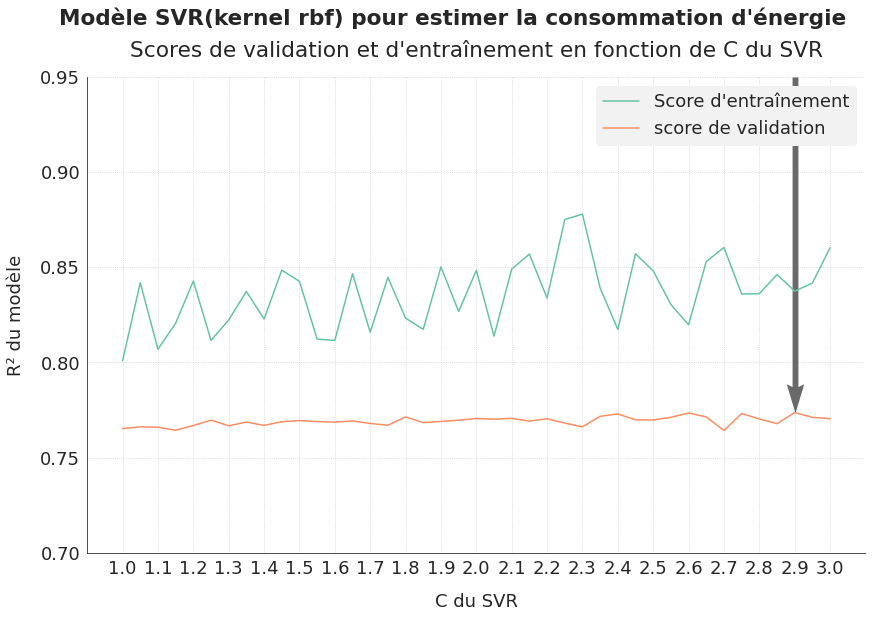

In [ ]:
fig, ax = graph_compar_train_valid(svr_conso_second_stepa, "svr_C", "SVR(kernel rbf)", "C du SVR",
                                "la consommation d'énergie", ymin=0.7, ymax=0.95, tick_step=2)
plt.show()

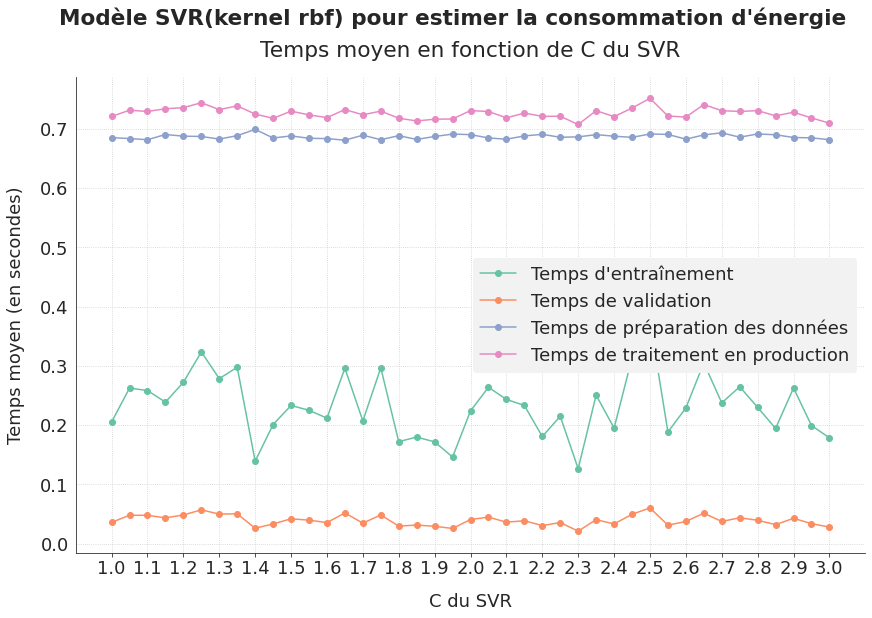

In [ ]:
fig, ax = graph_modele_time(svr_conso_second_stepa, "svr_C", "SVR(kernel rbf)", "C du SVR",
                            "la consommation d'énergie", tick_step=2)
plt.show()

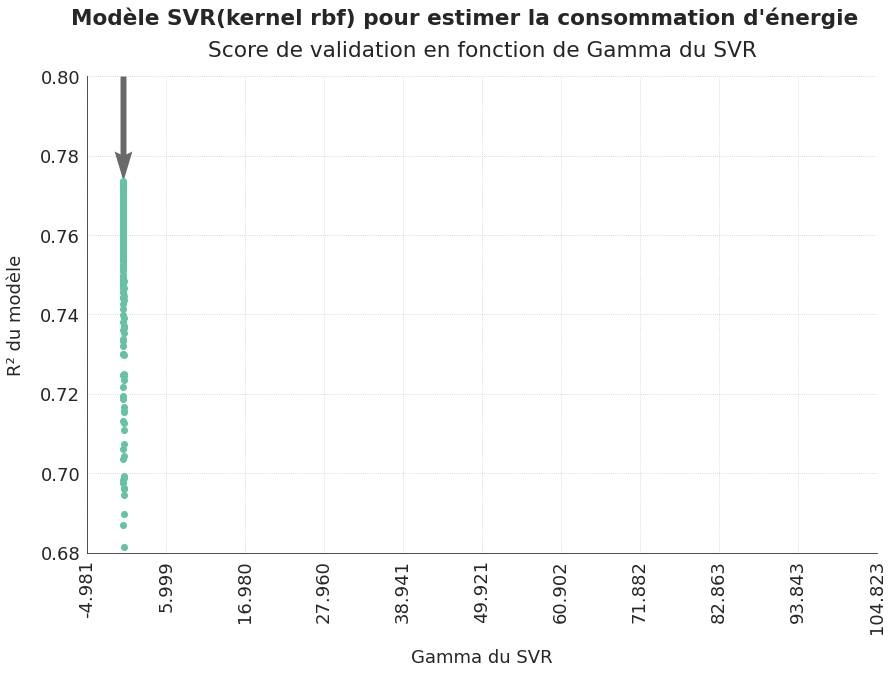

In [ ]:
fig, ax = graph_continu_preview(svr_conso_second_stepa, "svr_gamma", "SVR(kernel rbf)", "Gamma du SVR",
                                "la consommation d'énergie", ymin=0.68, ymax=0.8, rotation=90)
plt.show()

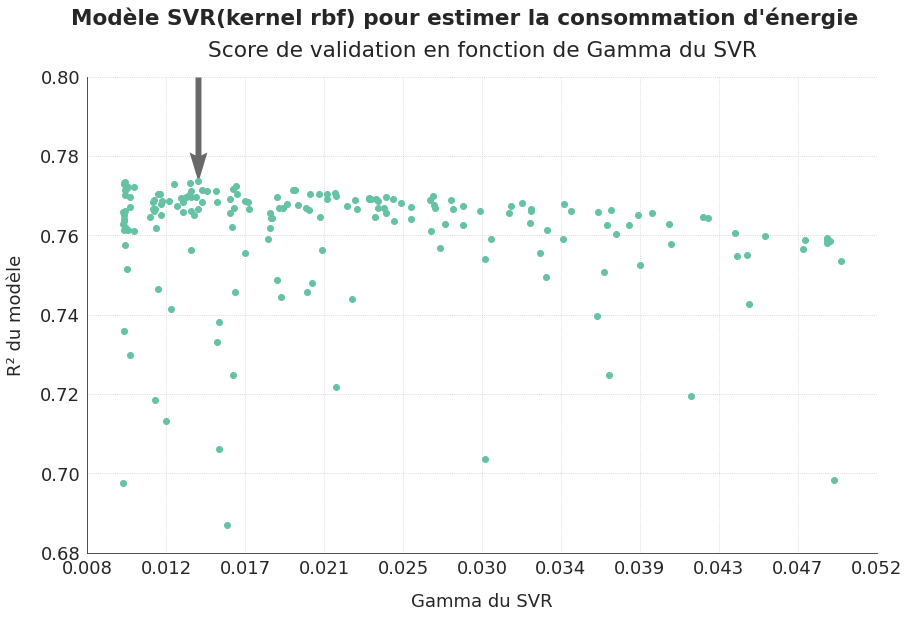

In [ ]:
fig, ax = graph_continu_preview(svr_conso_second_stepa[svr_conso_second_stepa.svr_gamma<0.05], "svr_gamma", "SVR(kernel rbf)",
                                "Gamma du SVR", "la consommation d'énergie", ymin=0.68, ymax=0.8)
plt.show()

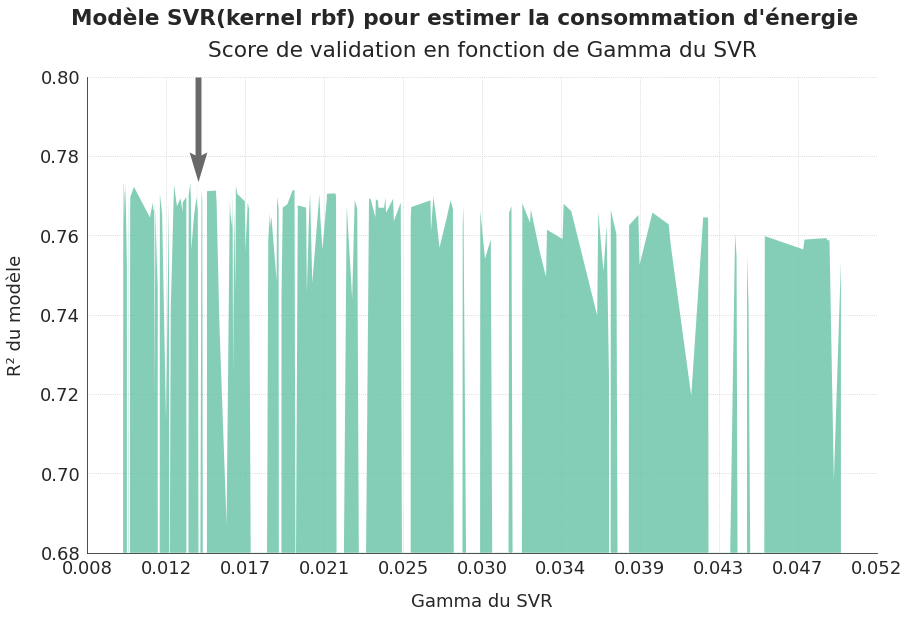

In [ ]:
fig, ax = graph_continu_score(svr_conso_second_stepa[svr_conso_second_stepa.svr_gamma<0.05], "svr_gamma", "SVR(kernel rbf)",
                              "Gamma du SVR", "la consommation d'énergie", ymin=0.68, ymax=0.8)
plt.show()

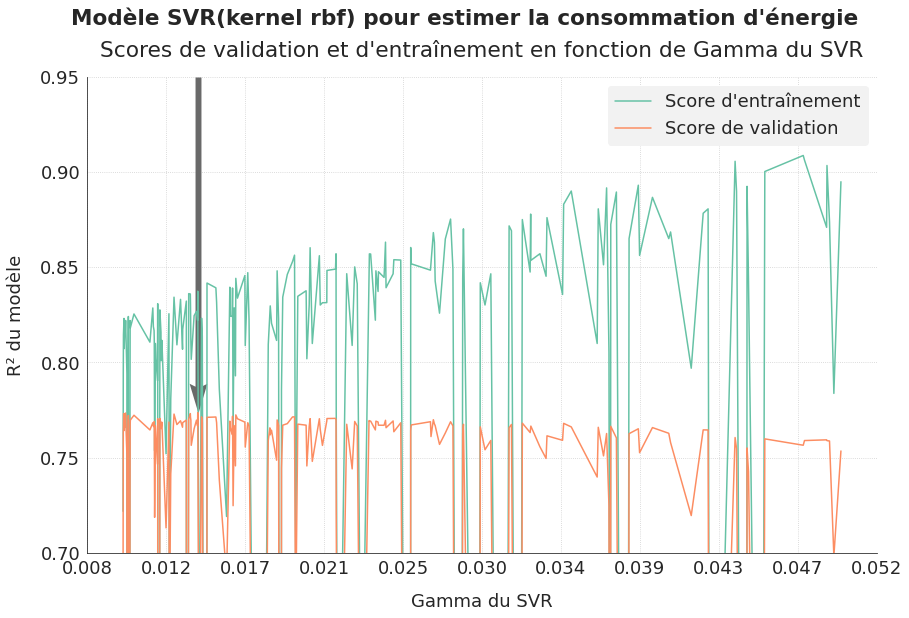

In [ ]:
fig, ax = graph_compar_continu(svr_conso_second_stepa[svr_conso_second_stepa.svr_gamma<0.05], "svr_gamma", "SVR(kernel rbf)",
                              "Gamma du SVR", "la consommation d'énergie", ymin=0.7, ymax=0.95)
plt.show()

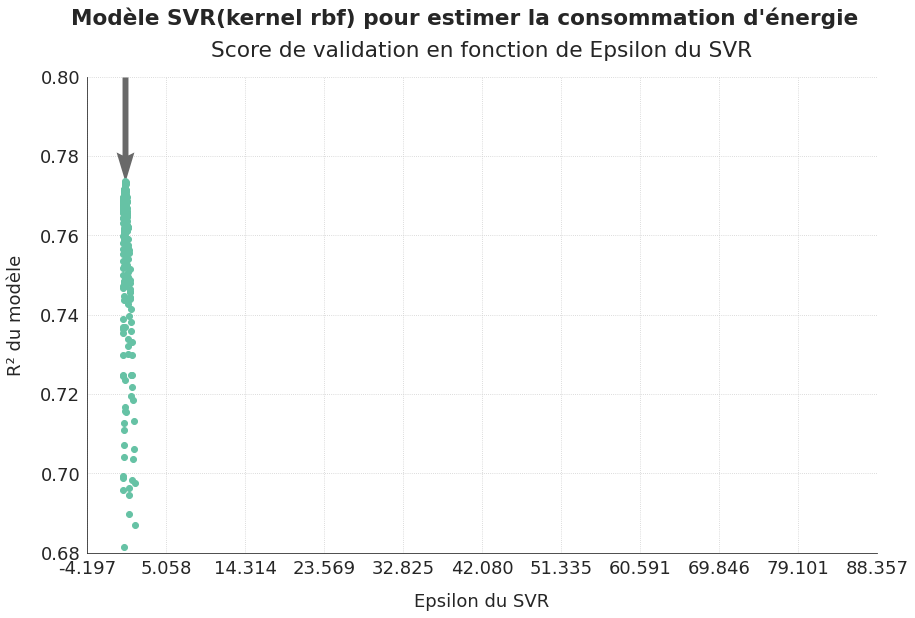

In [ ]:
fig, ax = graph_continu_preview(svr_conso_second_stepa, "svr_epsilon", "SVR(kernel rbf)", "Epsilon du SVR",
                                "la consommation d'énergie", ymin=0.68, ymax=0.8)
plt.show()

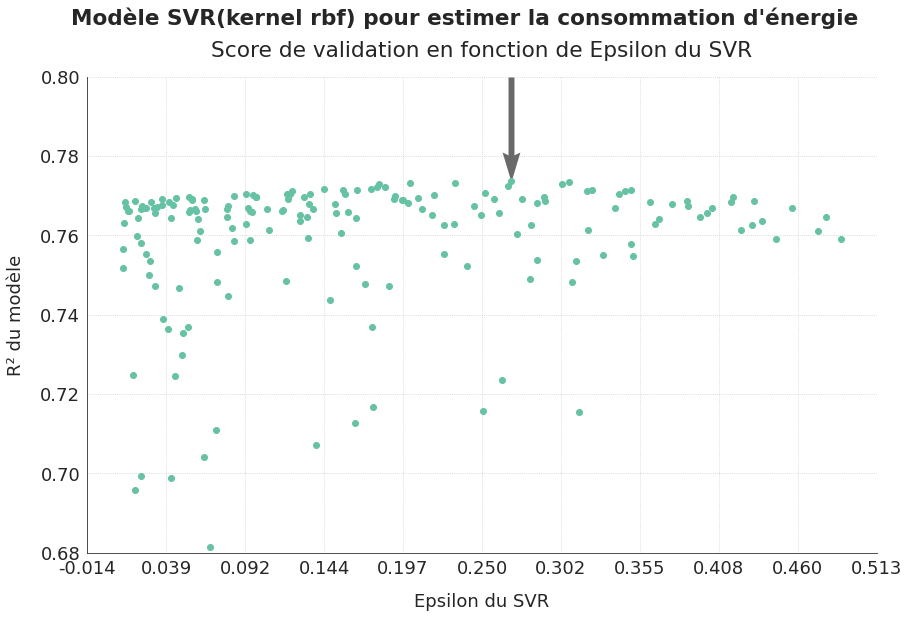

In [ ]:
fig, ax = graph_continu_preview(svr_conso_second_stepa[svr_conso_second_stepa.svr_epsilon<0.5], "svr_epsilon", "SVR(kernel rbf)",
                                "Epsilon du SVR", "la consommation d'énergie", ymin=0.68, ymax=0.8)
plt.show()

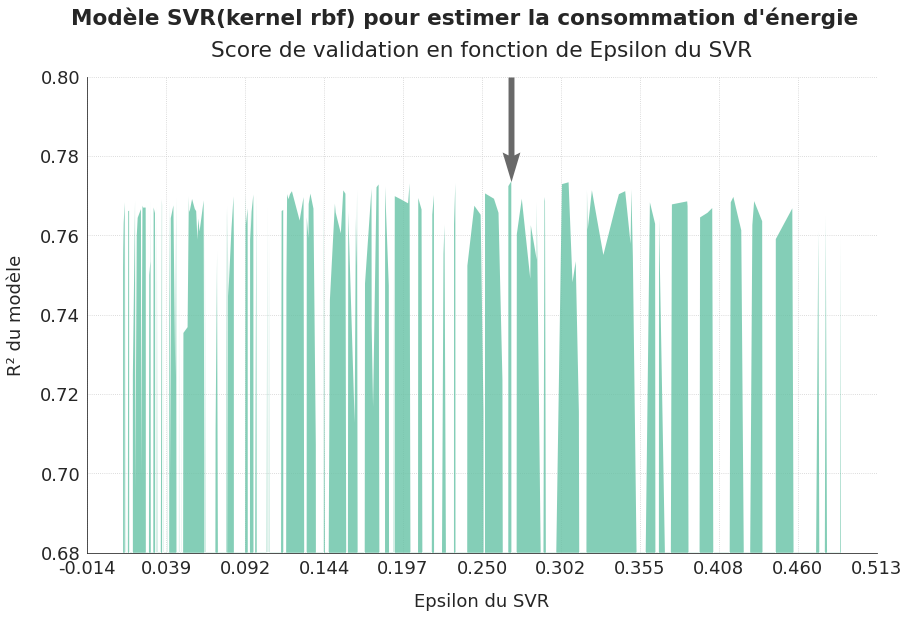

In [ ]:
fig, ax = graph_continu_score(svr_conso_second_stepa[svr_conso_second_stepa.svr_epsilon<0.5], "svr_epsilon", "SVR(kernel rbf)",
                                "Epsilon du SVR", "la consommation d'énergie", ymin=0.68, ymax=0.8)
plt.show()

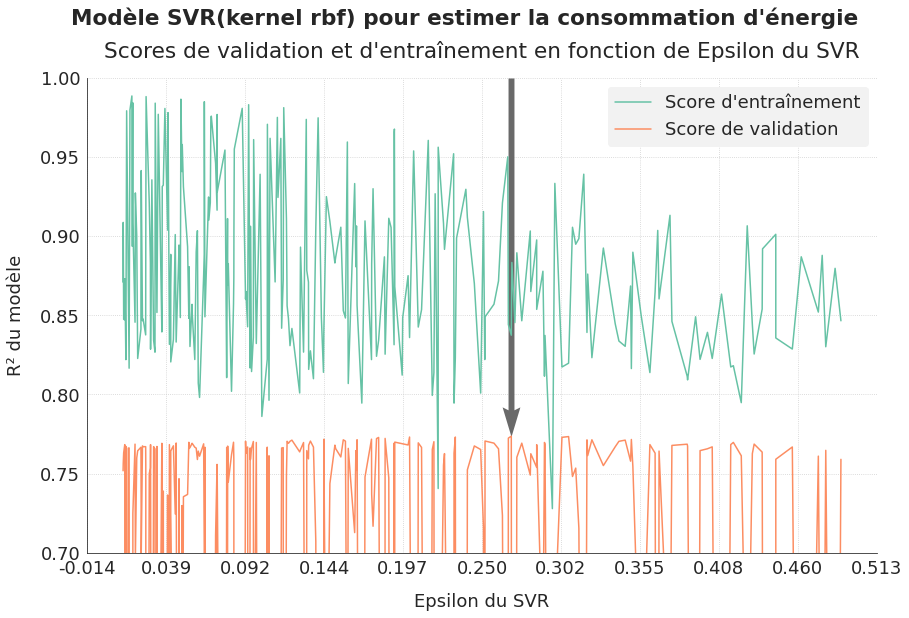

In [ ]:
fig, ax = graph_compar_continu(svr_conso_second_stepa[svr_conso_second_stepa.svr_epsilon<0.5], "svr_epsilon", "SVR(kernel rbf)",
                               "Epsilon du SVR", "la consommation d'énergie", ymin=0.7, ymax=1)
plt.show()

J'affine les résultats de la deuxième étape.

In [ ]:
# conso_pipeline for SVR
conso_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', AllImputation(KNNImputer(), categ_cols=categ_col, missforest=False)),
    ('data_encoders', FitToPandas(encoder_perso_onehot, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=False, keep_all=False)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler(), transfo_col, 'transfo_num'))
])
reg_pipeline = Pipeline([('estimator', SVR())])

In [ ]:
space = {
    'data_imputers__sk_object__n_neighbors': 7,
    'data_imputers__sk_object__weights': 'distance',
    'data_case': {'encoders': encoder_perso_onehot,
                  'list_name': transfo_col,
                  'restrict_cols': 'transfo_num'},
    'estimator__kernel': 'rbf',
    'estimator__C': hp.choice('estimator__C', np.arange(2, 4.005, 0.05)),
    'estimator__gamma': hp.choice('estimator__gamma',np.arange(0.008, 0.0201, 0.0005)),
    'estimator__epsilon': hp.choice('estimator__epsilon', np.arange(0.15, 0.401, 0.005))
}

In [ ]:
list_best_results = []

In [ ]:
estimator_name = 'svr'
step = 'final2b'
run_conso_optimization(max_evals=400, prefix=step, estimator_name=estimator_name)

100%|██████████| 400/400 [13:57<00:00,  2.09s/it, best loss: -0.7744099201582605]
Estimateur : svr - Done
Best cross-validation mean score = 0.7744099201582605
Associated standard deviation = 0.017660033500966867
Calculation time = 0.03927679061889648
Data preparation time = 0.689846593002585
Best cv score obtained after 297 iterations



In [ ]:
svr_conso_second_stepb = pd.read_csv("hyperopt_conso_svr_final2b.csv")
svr_conso_second_stepb.head()

,valid_score_mean,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,data_transfo_time,data_imputer,data_encoder,estimator,iteration
0,0.773059,0.019713,0.051566,0.829757,0.003877,0.273685,0.682694,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"SVR(C=2.599999999999998, cache_size=200, coef0...",1
1,0.772810,0.015460,0.038730,0.842789,0.003406,0.242106,0.678795,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"SVR(C=3.149999999999996, cache_size=200, coef0...",2
2,0.767256,0.012655,0.030874,0.852742,0.003444,0.208130,0.688646,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"SVR(C=3.5999999999999943, cache_size=200, coef...",3
3,0.769299,0.024009,0.050916,0.809869,0.005110,0.277642,0.698991,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"SVR(C=2.4999999999999982, cache_size=200, coef...",4
4,0.773080,0.017177,0.036233,0.831203,0.003769,0.223613,0.688406,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"SVR(C=2.299999999999999, cache_size=200, coef0...",5


In [ ]:
svr_conso_second_stepb = remove_negative_scores(svr_conso_second_stepb)
inter_str = [inter[inter.find('kernel')+8:] for inter in svr_conso_second_stepb.estimator]
svr_conso_second_stepb["svr_kernel"] = [inter[:inter.find(',')-1] for inter in inter_str]
inter_str = [inter[inter.find('C=')+2:] for inter in svr_conso_second_stepb.estimator]
svr_conso_second_stepb["svr_C"] = [np.around(np.float(inter[:inter.find(',')]),5) for inter in inter_str]
inter_str = [inter[inter.find('gamma')+6:] for inter in svr_conso_second_stepb.estimator]
svr_conso_second_stepb["svr_gamma"] = [np.around(np.float(inter[:inter.find(',')]),5) for inter in inter_str]
inter_str = [inter[inter.find('degree')+7:] for inter in svr_conso_second_stepb.estimator]
svr_conso_second_stepb["svr_degree"] = [np.int(inter[:inter.find(',')]) for inter in inter_str]
inter_str = [inter[inter.find('coef0')+6:] for inter in svr_conso_second_stepb.estimator]
svr_conso_second_stepb["svr_coef0"] = [np.around(np.float(inter[:inter.find(',')]),5) for inter in inter_str]
inter_str = [inter[inter.find('epsilon')+8:] for inter in svr_conso_second_stepb.estimator]
svr_conso_second_stepb["svr_epsilon"] = [np.around(np.float(inter[:inter.find(',')]),5) for inter in inter_str]
svr_conso_second_stepb["total_time"] = svr_conso_second_stepb.valid_time_mean + svr_conso_second_stepb.data_transfo_time

In [ ]:
svr_conso_second_stepb[["valid_score_mean", "train_score_mean", "iteration", "svr_kernel", "svr_C", "svr_gamma", "svr_degree",
                       "svr_coef0","svr_epsilon","total_time"]].sort_values("valid_score_mean", ascending=False).head(20)

,valid_score_mean,train_score_mean,iteration,svr_kernel,svr_C,svr_gamma,svr_degree,svr_coef0,svr_epsilon,total_time
296,0.774410,0.830918,297,rbf,4.0,0.0100,3,0.0,0.26,0.729123
145,0.774406,0.830978,146,rbf,3.7,0.0105,3,0.0,0.26,0.745945
349,0.774406,0.830978,350,rbf,3.7,0.0105,3,0.0,0.26,0.720891
259,0.774406,0.830978,260,rbf,3.7,0.0105,3,0.0,0.26,0.718087
260,0.774406,0.830978,261,rbf,3.7,0.0105,3,0.0,0.26,0.718990
289,0.774406,0.830978,290,rbf,3.7,0.0105,3,0.0,0.26,0.717974
149,0.774406,0.830978,150,rbf,3.7,0.0105,3,0.0,0.26,0.712998
148,0.774406,0.830978,149,rbf,3.7,0.0105,3,0.0,0.26,0.728618
147,0.774406,0.830978,148,rbf,3.7,0.0105,3,0.0,0.26,0.713058
146,0.774406,0.830978,147,rbf,3.7,0.0105,3,0.0,0.26,0.728303


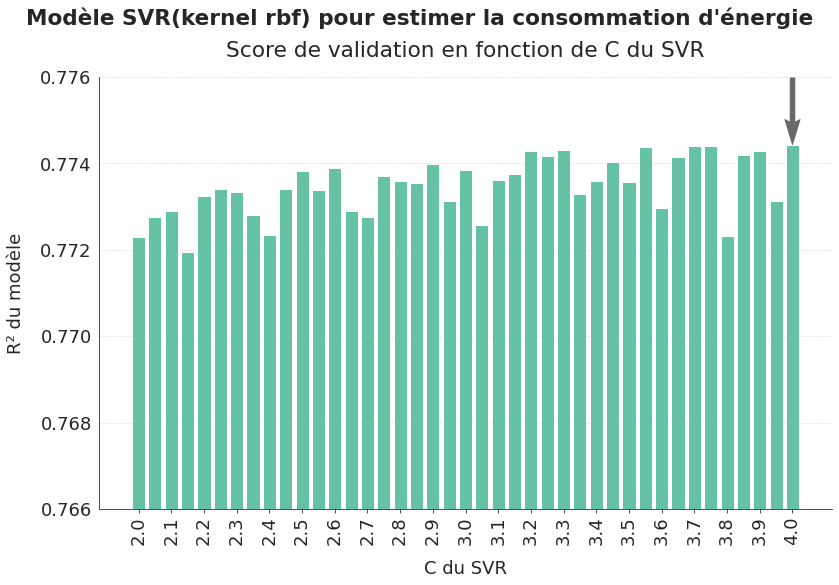

In [ ]:
fig, ax = graph_modele_score(svr_conso_second_stepb, "svr_C", "SVR(kernel rbf)", "C du SVR",
                             "la consommation d'énergie", ymin=0.766, ymax=0.776, tick_step=2, rotation=90)
save_fig("ml03_2_24_svm4a")
plt.show()

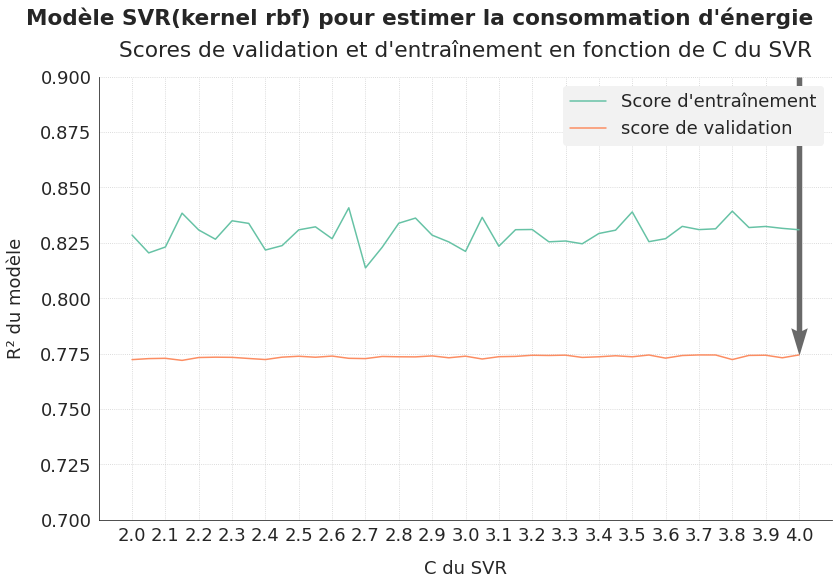

In [ ]:
fig, ax = graph_compar_train_valid(svr_conso_second_stepb, "svr_C", "SVR(kernel rbf)", "C du SVR", 
                                   "la consommation d'énergie", ymin=0.7, ymax=0.9, tick_step=2)
save_fig("ml03_2_24_svm4b")
plt.show()

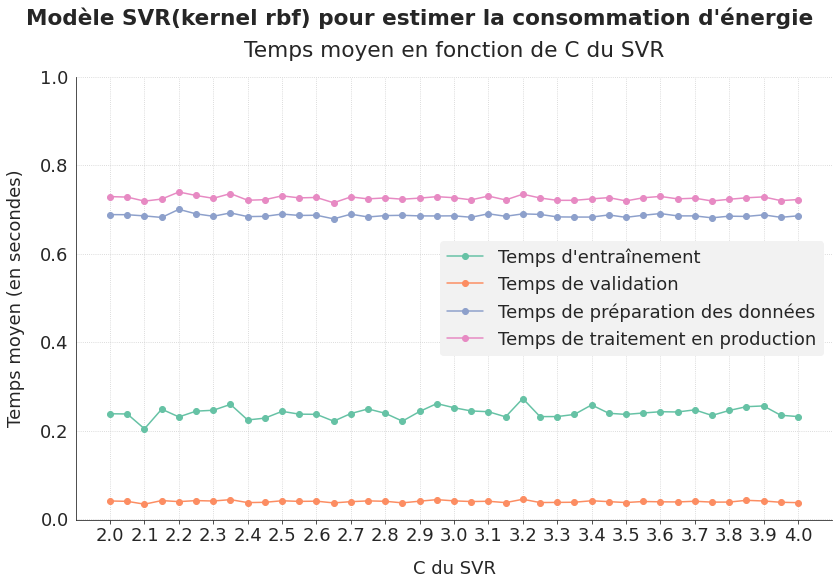

In [ ]:
fig, ax = graph_modele_time(svr_conso_second_stepb, "svr_C", "SVR(kernel rbf)", "C du SVR",
                            "la consommation d'énergie", ymax=1.0, tick_step=2)
save_fig("ml03_2_24_svm4c")
plt.show()

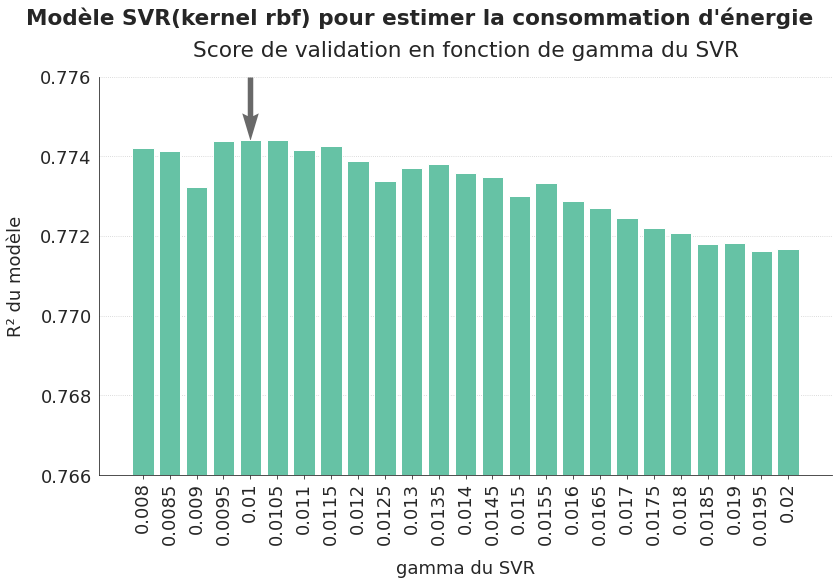

In [ ]:
fig, ax = graph_modele_score(svr_conso_second_stepb, "svr_gamma", "SVR(kernel rbf)", "gamma du SVR",
                             "la consommation d'énergie", ymin=0.766, ymax=0.776, rotation=90)
save_fig("ml03_2_25_svm5a")
plt.show()

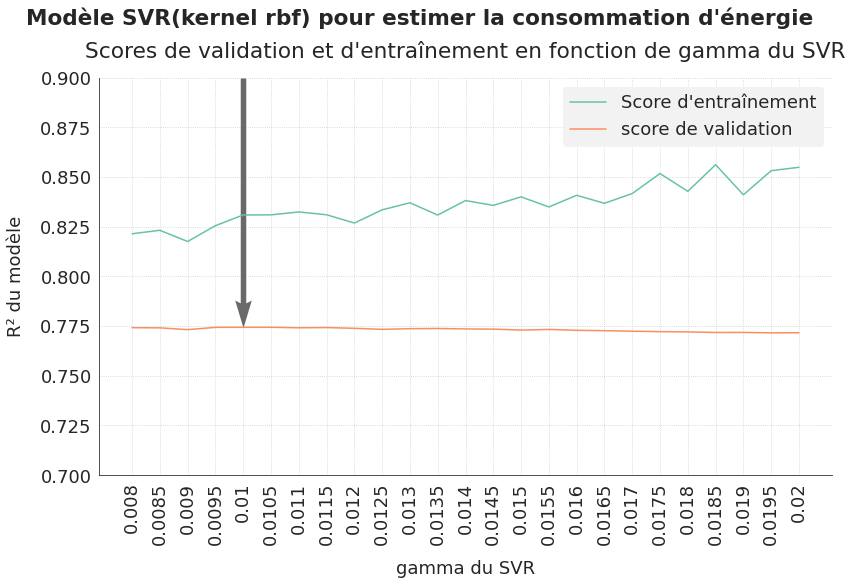

In [ ]:
fig, ax = graph_compar_train_valid(svr_conso_second_stepb, "svr_gamma", "SVR(kernel rbf)", "gamma du SVR", 
                                   "la consommation d'énergie", ymin=0.7, ymax=0.9, rotation=90)
save_fig("ml03_2_25_svm5b")
plt.show()

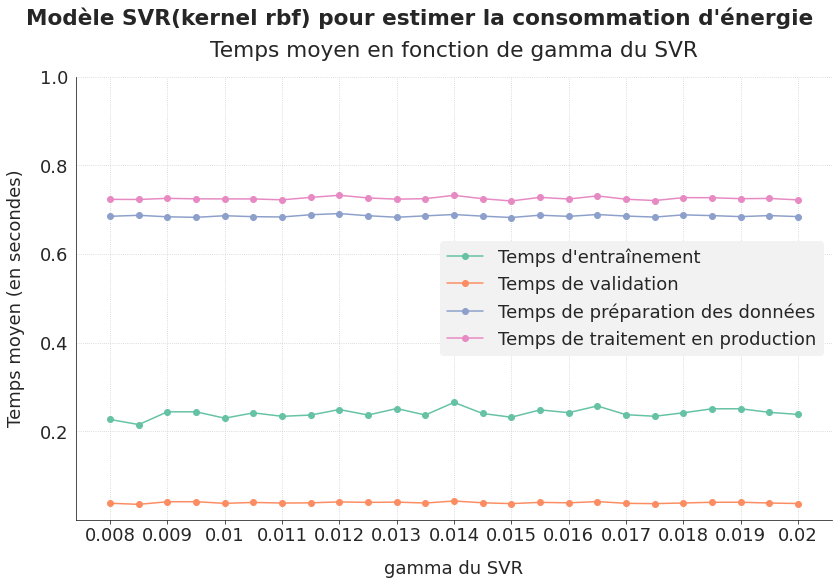

In [ ]:
fig, ax = graph_modele_time(svr_conso_second_stepb, "svr_gamma", "SVR(kernel rbf)", "gamma du SVR", 
                            "la consommation d'énergie", ymax=1.0, tick_step=2)
save_fig("ml03_2_25_svm5c")
plt.show()

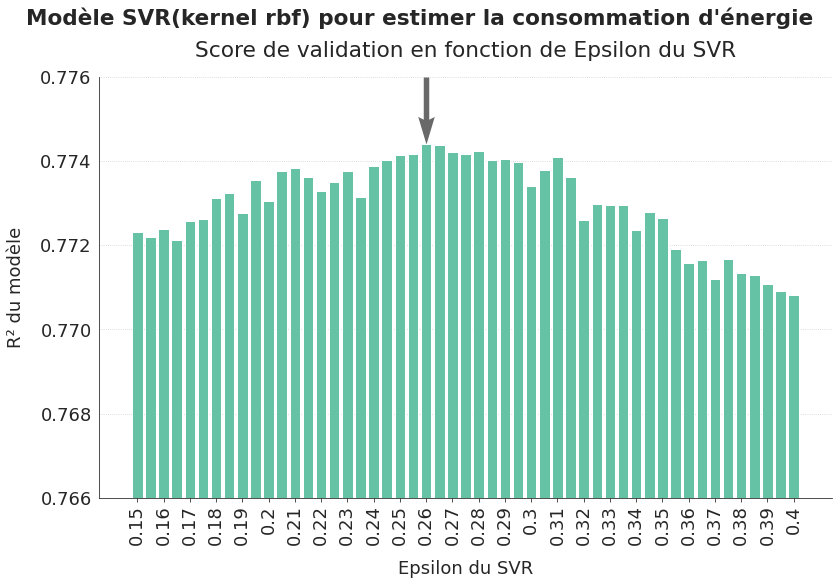

In [ ]:
fig, ax = graph_modele_score(svr_conso_second_stepb, "svr_epsilon", "SVR(kernel rbf)", "Epsilon du SVR",
                             "la consommation d'énergie", ymin=0.766, ymax=0.776, rotation=90, tick_step=2)
save_fig("ml03_2_26_svm6a")
plt.show()

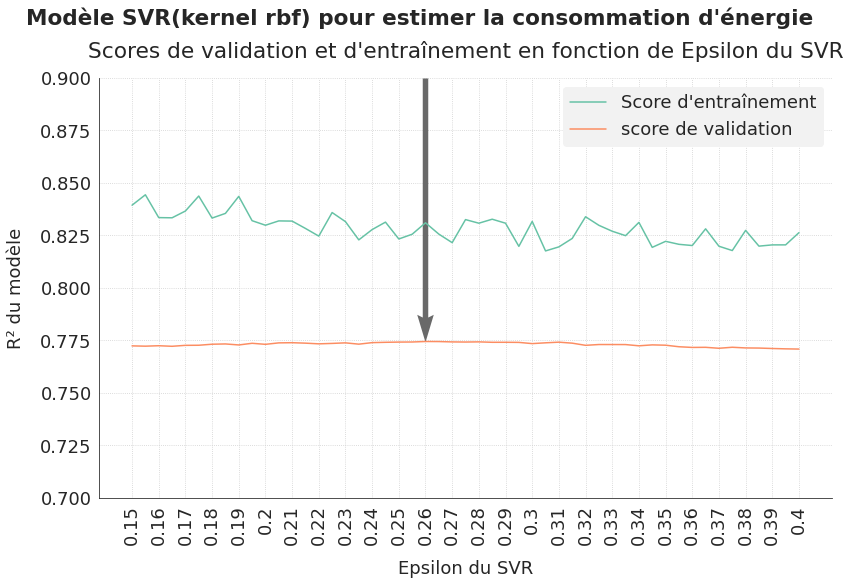

In [ ]:
fig, ax = graph_compar_train_valid(svr_conso_second_stepb, "svr_epsilon", "SVR(kernel rbf)", "Epsilon du SVR", 
                                   "la consommation d'énergie", ymin=0.7, ymax=0.9, tick_step=2, rotation=90)
save_fig("ml03_2_26_svm6b")
plt.show()

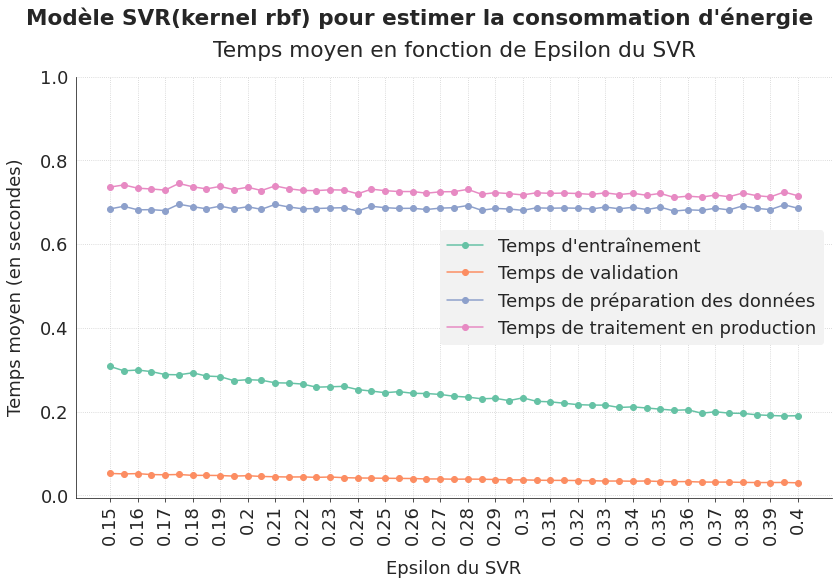

In [ ]:
fig, ax = graph_modele_time(svr_conso_second_stepb, "svr_epsilon", "SVR(kernel rbf)", "Epsilon du SVR", 
                            "la consommation d'énergie", ymax=1.0, tick_step=2, rotation=90)
save_fig("ml03_2_26_svm6c")
plt.show()

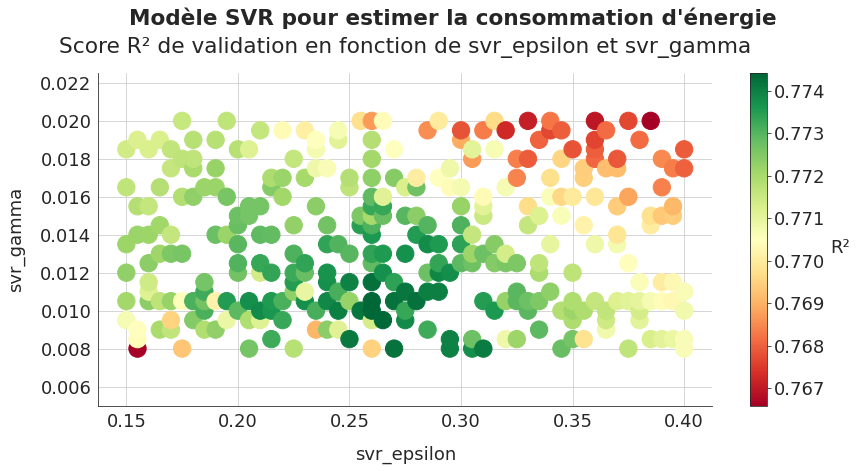

In [ ]:
fig, ax = graph_cross_score(svr_conso_second_stepb, "svr_epsilon", "svr_gamma", "SVR",
                            "la consommation d'énergie", size=300, ymin=0.005, ymax=0.0225, figsize=(12,6))
save_fig("ml03_2_26_svm6d", tight_layout=False)
plt.show()

<a id='4_6_7'></a>

#### 4.6.7. Kernel SVM : feature importances

In [ ]:
# conso_pipeline for SVM
conso_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', AllImputation(KNNImputer(), categ_cols=categ_col, missforest=False)),
    ('data_encoders', FitToPandas(encoder_perso_onehot, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=False, keep_all=False)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler(), transfo_col, 'transfo_num'))
])
reg_pipeline = Pipeline([('estimator', SVR())])

In [ ]:
space = {
    'data_imputers__sk_object__n_neighbors': 7,
    'data_imputers__sk_object__weights': 'distance',
    'data_case': {'encoders': encoder_perso_onehot,
                  'list_name': transfo_col,
                  'restrict_cols': 'transfo_num'},
    'estimator__kernel': 'rbf',
    'estimator__C': 3.75,
    'estimator__gamma': 0.0095,
    'estimator__epsilon': 0.27
}

In [ ]:
list_best_results = []

In [ ]:
estimator_name = 'svr'
step = 'finalone'
run_conso_optimization(max_evals=1, prefix=step, estimator_name=estimator_name)

100%|██████████| 1/1 [00:02<00:00,  2.07s/it, best loss: -0.7744754317364734]
Estimateur : svr - Done
Best cross-validation mean score = 0.7744754317364734
Associated standard deviation = 0.018656652616777913
Calculation time = 0.03813042640686035
Data preparation time = 0.6842135679980856
Best cv score obtained after 1 iterations



In [ ]:
svr_final_step = pd.read_csv("hyperopt_conso_svr_finalone.csv")
svr_final_step

,valid_score_mean,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,data_transfo_time,data_imputer,data_encoder,estimator,iteration
0,0.774475,0.018657,0.03813,0.826886,0.003998,0.236147,0.684214,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"SVR(C=3.75, cache_size=200, coef0=0.0, degree=...",1


Pour le Kernel SVM, la seule méthode de calcul de l'importance des variables est la permutation aléatoire des données.

In [ ]:
# SVR final
conso_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', AllImputation(KNNImputer(n_neighbors=7, weights='distance'), categ_cols=categ_col, missforest=False)),
    ('data_encoders', FitToPandas(encoder_perso_onehot, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=False, keep_all=False)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler(), transfo_col, 'transfo_num'))
])
reg = SVR(kernel='rbf', C=3.75, gamma=0.0095, epsilon=0.27)

In [ ]:
feat_imp3 = eval_feature_importance(conso_pipeline, reg, X_train_conso, ln_y_train_conso)
feat_imp3.describe()

,importance,importance_stability
count,98.000000,98.000000
mean,0.008448,0.000789
std,0.026603,0.001526
min,-0.000020,0.000013
25%,0.000188,0.000086
50%,0.000596,0.000269
75%,0.003917,0.000727
max,0.141865,0.007947


In [ ]:
feat_imp3.sort_values("importance", ascending=False)

,importance,importance_stability
ln_PropertyGFABuilding(s),1.418650e-01,0.007947
ln_LargestPropertyUseTypeGFA,1.344681e-01,0.007765
ENERGYSTARScore,1.280497e-01,0.006370
ln_PropertyGFATotal,1.236953e-01,0.007152
Use_Non-Refrigerated Warehouse,5.690014e-02,0.004822
...,...,...
Use_Enclosed Mall,8.153623e-06,0.000022
Use_Adult Education,6.425203e-06,0.000055
Use_Courthouse,6.028868e-06,0.000030
Use_Residential Care Facility,-1.839746e-07,0.000025


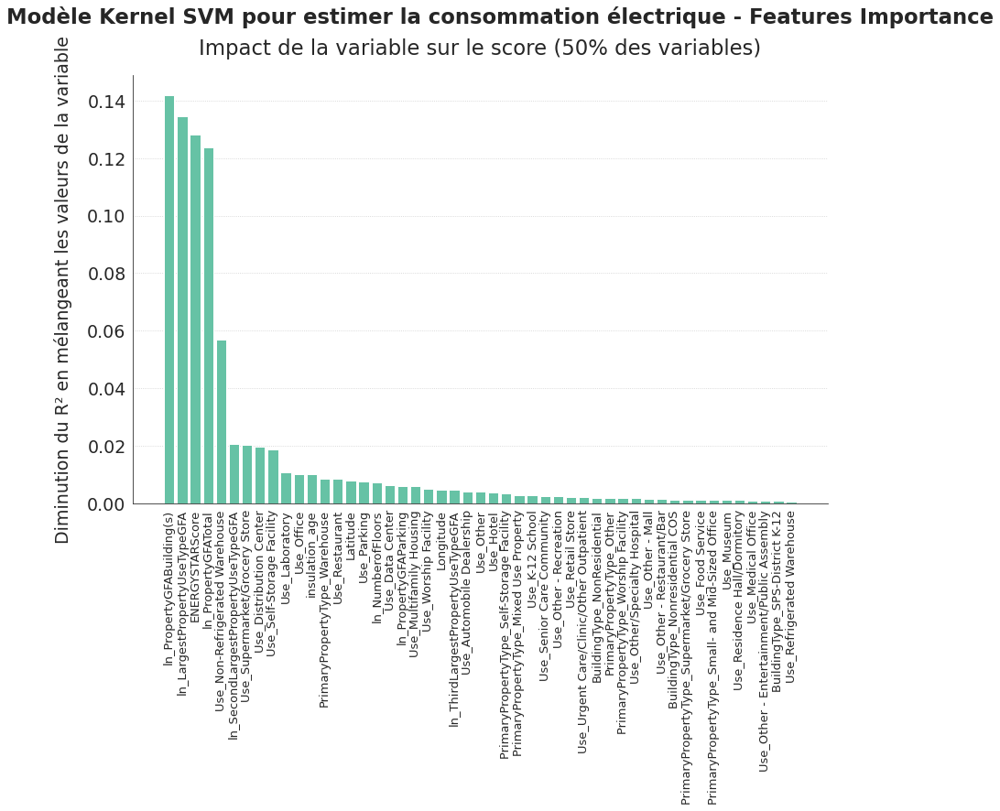

In [ ]:
fig, ax = graph_importance(feat_imp3, "importance", "Impact de la variable sur le score", "Kernel SVM", 
                           "la consommation électrique", horizontal=False, fontsize=13, figsize=(14,8))
ax[0].set_ylabel("Diminution du R² en mélangeant les valeurs de la variable")
save_fig("ml03_2_53_conso3a", tight_layout=False)
plt.show()

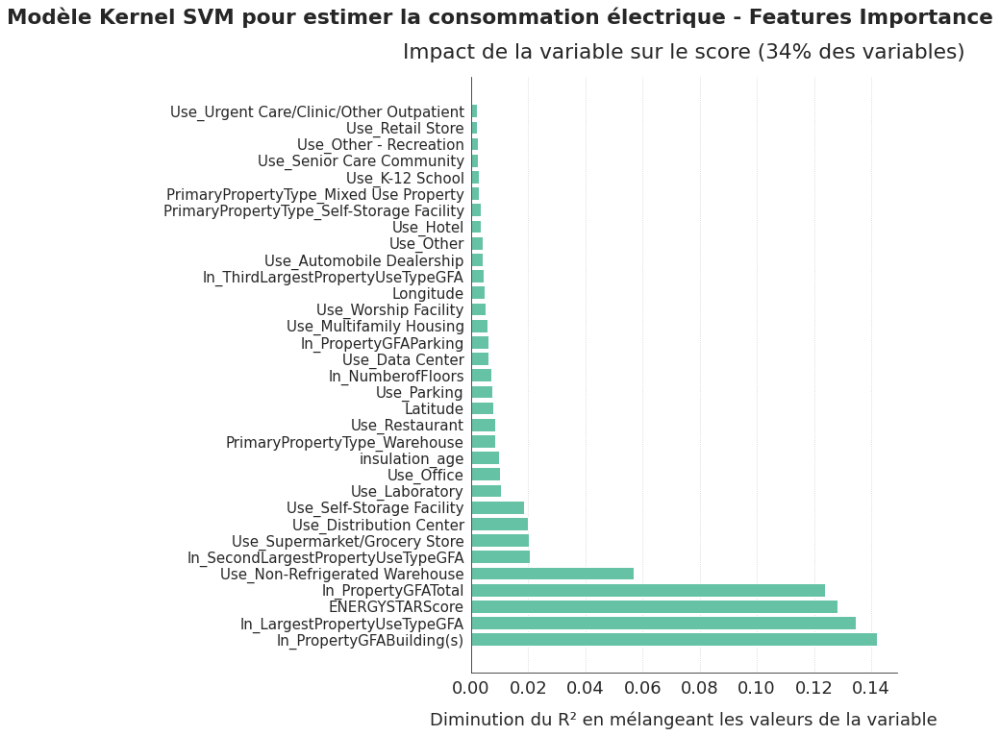

In [ ]:
fig, ax = graph_importance(feat_imp3, "importance", "Impact de la variable sur le score", "Kernel SVM", 
                           "la consommation électrique", percentile=0.66, horizontal=True, fontsize=15, figsize=(12,10))
ax[0].set_xlabel("Diminution du R² en mélangeant les valeurs de la variable")
save_fig("ml03_2_53_conso3b", tight_layout=False)
plt.show()

Maintenant que les deux modèles les plus prometteurs sont optimisés, il convient de les comparer pour choisir le modèle le plus performant.

<a id='4_7'></a>

### 4.7. Choix du modèle pour estimer la consommation

In [ ]:
xgb_final_step = pd.read_csv("hyperopt_conso_xgboost_finalverif.csv")
xgb_final_step

,valid_score_mean,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,data_transfo_time,data_imputer,data_encoder,estimator,iteration
0,0.772321,0.024499,0.006379,0.934735,0.003418,0.631148,0.678896,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"XGBRegressor(base_score=0.5, booster='gbtree',...",1


In [ ]:
svr_final_step = pd.read_csv("hyperopt_conso_svr_finalone.csv")
svr_final_step

,valid_score_mean,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,data_transfo_time,data_imputer,data_encoder,estimator,iteration
0,0.774475,0.018657,0.03813,0.826886,0.003998,0.236147,0.684214,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),"SVR(C=3.75, cache_size=200, coef0=0.0, degree=...",1


In [ ]:
conso_compar_final = pd.concat([xgb_final_step, svr_final_step], ignore_index=True)
conso_compar_final["total_time"] = conso_compar_final.valid_time_mean + conso_compar_final.data_transfo_time
conso_compar_final["estimator"] = [inter[:inter.find('(')] for inter in conso_compar_final["estimator"]]
conso_compar_final

,valid_score_mean,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,data_transfo_time,data_imputer,data_encoder,estimator,iteration,total_time
0,0.772321,0.024499,0.006379,0.934735,0.003418,0.631148,0.678896,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),XGBRegressor,1,0.685275
1,0.774475,0.018657,0.038130,0.826886,0.003998,0.236147,0.684214,"AllImputation(categ_cols=['BuildingType', 'Pri...",CustomOneHotEncoder(ascending=False),SVR,1,0.722344


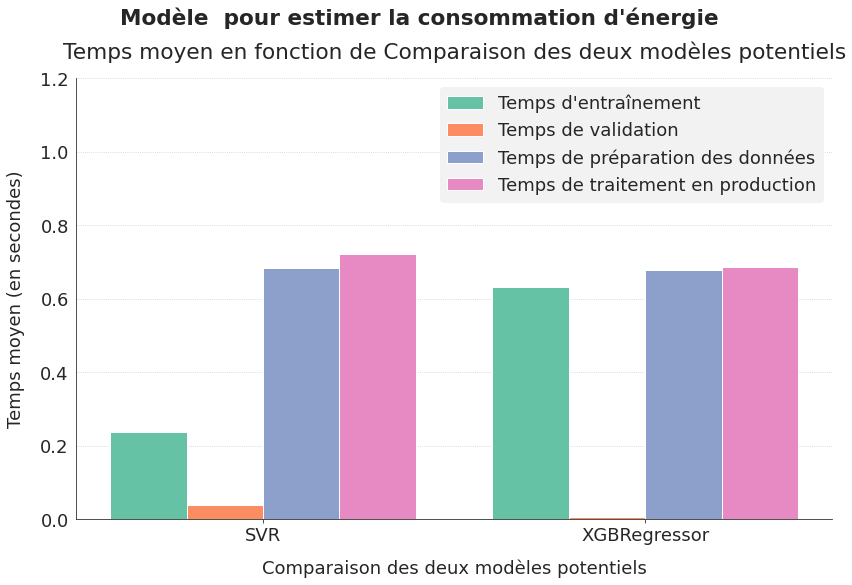

In [ ]:
fig, ax = graph_modele_time(conso_compar_final, "estimator", "", "Comparaison des deux modèles potentiels", 
                            "la consommation d'énergie", ymax=1.2, with_bars=True)
save_fig("ml03_2_51_conso1a")
plt.show()

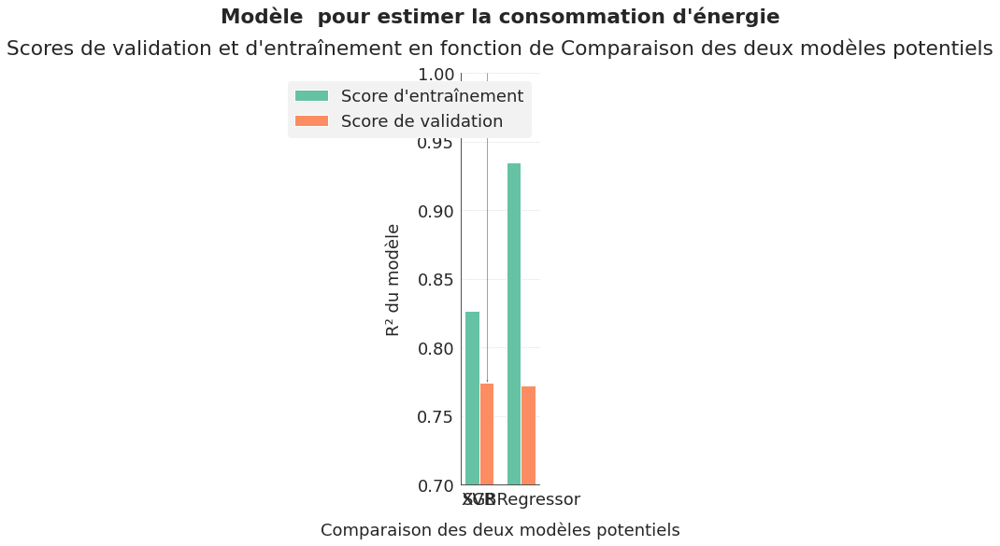

In [ ]:
fig, ax = graph_compar_train_valid(conso_compar_final, "estimator", "", "Comparaison des deux modèles potentiels", 
                                   "la consommation d'énergie", ymin=0.7, ymax=1.0, with_bars=True)
save_fig("ml03_2_51_conso1b", tight_layout=False)
plt.show()

Le modèle SVM est légèrement plus rapide, obtient un meilleur score de validation et présente moins d'overfitting. Je vais donc privilégier ce modèle.

In [ ]:
# SVR final
conso_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', AllImputation(KNNImputer(n_neighbors=7, weights='distance'), categ_cols=categ_col, missforest=False)),
    ('data_encoders', FitToPandas(encoder_perso_onehot, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=False, keep_all=False)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler(), transfo_col, 'transfo_num'))
])
reg = SVR(kernel='rbf', C=3.75, gamma=0.0095, epsilon=0.27)

In [ ]:
data_transformed = conso_pipeline.fit_transform(X_train_conso, ln_y_train_conso)
reg.fit(data_transformed, ln_y_train_conso)
estimate_conso_train = pd.Series(reg.predict(data_transformed), index=data_transformed.index, name="consommation_estimate")

In [ ]:
desc_test_conso = data_test[data_test[y_conso].notna()][desc_columns].copy()
X_test_conso = data_test[data_test[y_conso].notna()][X_columns].copy()
y_test_conso = data_test[data_test[y_conso].notna()][y_conso].copy()
ln_y_test_conso = np.log(y_test_conso)

In [ ]:
test_transformed = conso_pipeline.transform(X_test_conso)
estimate_conso_test = pd.Series(reg.predict(test_transformed), index=test_transformed.index, name="consommation_estimate")

/usr/local/lib/python3.6/dist-packages/category_encoders/ordinal.py:258: UserWarning: inverse_transform is not supported because transform impute the unknown category -1 when encode BuildingType
  "the unknown category -1 when encode %s" % (col,))
/usr/local/lib/python3.6/dist-packages/category_encoders/ordinal.py:258: UserWarning: inverse_transform is not supported because transform impute the unknown category -1 when encode PrimaryPropertyType
  "the unknown category -1 when encode %s" % (col,))
/usr/local/lib/python3.6/dist-packages/category_encoders/ordinal.py:258: UserWarning: inverse_transform is not supported because transform impute the unknown category -1 when encode LargestPropertyUseType
  "the unknown category -1 when encode %s" % (col,))
/usr/local/lib/python3.6/dist-packages/category_encoders/ordinal.py:258: UserWarning: inverse_transform is not supported because transform impute the unknown category -1 when encode SecondLargestPropertyUseType
  "the unknown category -1 w

<a id='4_8'></a>

### 4.8. Evaluation du modèle retenu : Kernel SVM

In [ ]:
# SVR final
conso_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', AllImputation(KNNImputer(n_neighbors=7, weights='distance'), categ_cols=categ_col, missforest=False)),
    ('data_encoders', FitToPandas(encoder_perso_onehot, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=False, keep_all=False)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler(), transfo_col, 'transfo_num'))
])
reg = SVR(kernel='rbf', C=3.75, gamma=0.0095, epsilon=0.27)

In [ ]:
df_analysis, df_scores = get_regmodel_analysis(conso_pipeline, reg, X_train_conso, ln_y_train_conso, inverse_transfo_y='exp',
                                          xdesc=desc_train_conso)
df_analysis = add_outliers_flag(df_analysis, inverse_transfo_y=True)
df_analysis.head()

,OSEBuildingID,DataYear,PropertyName,CouncilDistrictCode,Neighborhood,Outlier,true_values,crossed_predictions,train_predictions,transfo_true_values,transfo_crossed_predictions,transfo_train_predictions,flag_outlier,flag_transfo_outlier
2015_1,1,2015,Mayflower Park Hotel,7,Downtown,Inlier,15.758764,15.587796,15.588987,6981428.0,5.884287e+06,5.891300e+06,False,False
2015_2,2,2015,Paramount Hotel,7,Downtown,Inlier,15.938279,15.819973,15.922657,8354235.0,7.422106e+06,8.224741e+06,False,False
2015_3,3,2015,Westin Hotel,7,Downtown,Inlier,18.107758,17.760619,17.978097,73130656.0,5.168196e+07,6.423748e+07,False,True
2015_5,5,2015,Hotel Max,7,Downtown,High Outlier,17.155872,15.616153,15.777392,28229320.0,6.053538e+06,7.112696e+06,False,True
2015_9,9,2015,West Precinct (Seattle Police),7,Downtown,Inlier,16.304740,15.479627,16.034918,12051984.0,5.281005e+06,9.201875e+06,False,False


**Performance de validation sur les données d'entraînement**

In [ ]:
print("Validation croisée sur le log de la consommation :")
print(get_reg_scores(df_scores, cv=True, inverse_transfo_y=False))

Validation croisée sur le log de la consommation :
Scores

 R² = 77.47% 
 RMSE = 0.610 
 Mean AE = 0.421 
 Median AE = 0.281 


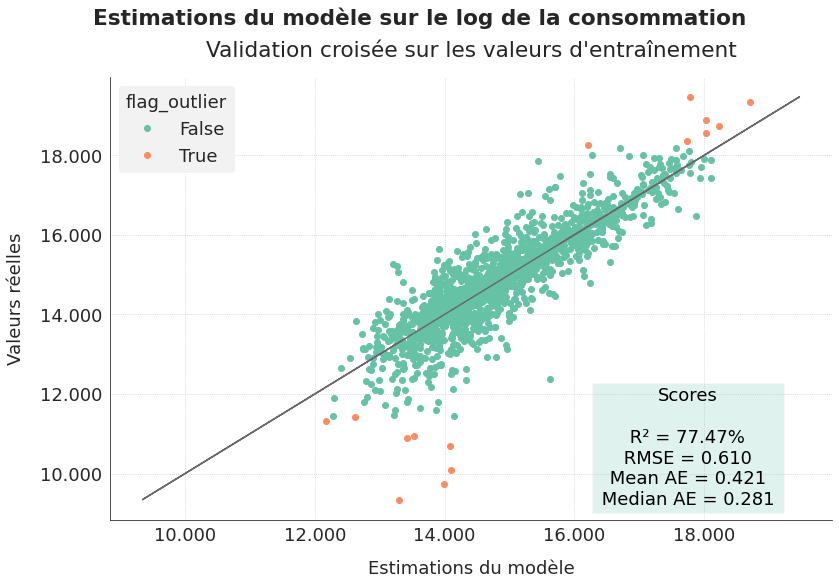

In [ ]:
fig, ax = graph_verif_estimations(df_analysis, df_scores, cv=True, inverse_transfo_y=False, ticks_format=':.3f',
                                  hue='flag_outlier', title="Estimations du modèle sur le log de la consommation")
save_fig("ml03_2_52_conso2a")
plt.show()

**Performance de validation sur les données d'entraînement, sans les outliers**

In [ ]:
outliers = get_outliers(ln_y_train_conso)
xtrain = X_train_conso[~outliers].copy()
ytrain = ln_y_train_conso[~outliers].copy()
xdesc = desc_train_conso[~outliers].copy()

In [ ]:
df_analysis_corrected, df_scores_corrected = get_regmodel_analysis(conso_pipeline, reg, xtrain, ytrain,
                                                              inverse_transfo_y='exp', xdesc=xdesc)
df_analysis_corrected = add_outliers_flag(df_analysis_corrected, inverse_transfo_y=True)
df_analysis_corrected.head()

,OSEBuildingID,DataYear,PropertyName,CouncilDistrictCode,Neighborhood,Outlier,true_values,crossed_predictions,train_predictions,transfo_true_values,transfo_crossed_predictions,transfo_train_predictions,flag_outlier,flag_transfo_outlier
2015_1,1,2015,Mayflower Park Hotel,7,Downtown,Inlier,15.758764,15.622472,15.607666,6981428.0,6.091911e+06,6.002378e+06,False,False
2015_2,2,2015,Paramount Hotel,7,Downtown,Inlier,15.938279,15.898676,15.929253,8354235.0,8.029843e+06,8.279169e+06,False,False
2015_3,3,2015,Westin Hotel,7,Downtown,Inlier,18.107758,17.736575,17.886479,73130656.0,5.045412e+07,5.861373e+07,False,True
2015_5,5,2015,Hotel Max,7,Downtown,High Outlier,17.155872,15.634678,15.774211,28229320.0,6.166723e+06,7.090110e+06,False,True
2015_9,9,2015,West Precinct (Seattle Police),7,Downtown,Inlier,16.304740,15.428921,16.034367,12051984.0,5.019901e+06,9.196810e+06,False,False


In [ ]:
print("Validation croisée sur le log de la consommation - Sans les outliers:")
print(get_reg_scores(df_scores_corrected, cv=True, inverse_transfo_y=False))

Validation croisée sur le log de la consommation - Sans les outliers:
Scores

 R² = 78.51% 
 RMSE = 0.566 
 Mean AE = 0.407 
 Median AE = 0.283 


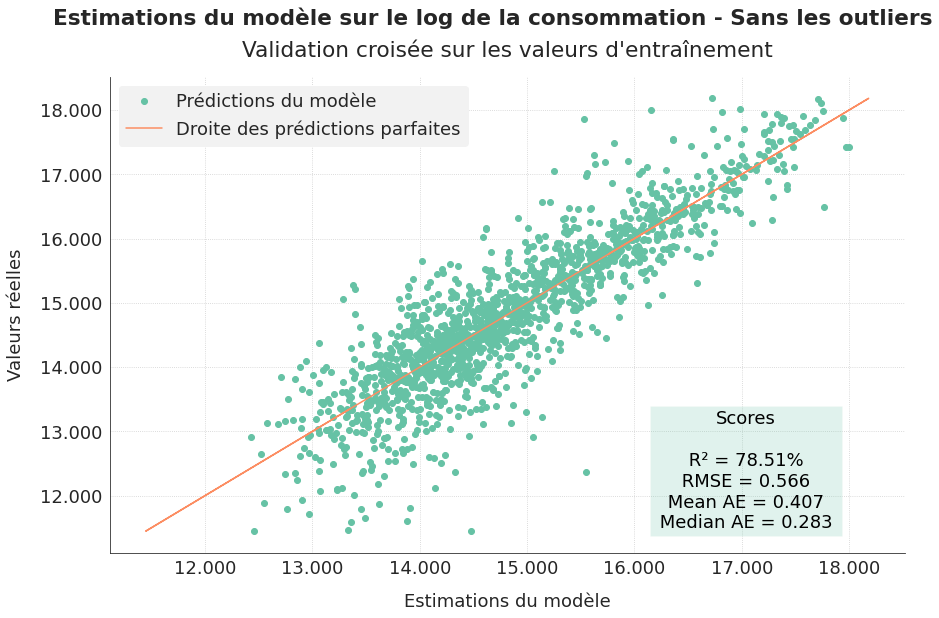

In [ ]:
fig, ax = graph_verif_estimations(df_analysis_corrected, df_scores_corrected, cv=True, inverse_transfo_y=False, ticks_format=':.3f',
                                  title="Estimations du modèle sur le log de la consommation - Sans les outliers")
plt.show()

**Performance de généralisation sur les données de test**

J'analyse désormais la performance des prédictions sur les données de test, que je n'ai jamais utilisées jusqu'ici.

In [ ]:
# SVR final
conso_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', AllImputation(KNNImputer(n_neighbors=7, weights='distance'), categ_cols=categ_col, missforest=False)),
    ('data_encoders', FitToPandas(encoder_perso_onehot, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=False, keep_all=False)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler(), transfo_col, 'transfo_num'))
])
reg = SVR(kernel='rbf', C=3.75, gamma=0.0095, epsilon=0.27)

In [ ]:
test_analysis, test_scores = get_regtest_analysis(conso_pipeline, reg, X_train_conso, ln_y_train_conso, X_test_conso,
                                              ln_y_test_conso, inverse_transfo_y='exp', xdesc=desc_test_conso)
test_analysis = add_outliers_flag(test_analysis, inverse_transfo_y=True)
test_analysis.head()

/usr/local/lib/python3.6/dist-packages/category_encoders/ordinal.py:258: UserWarning: inverse_transform is not supported because transform impute the unknown category -1 when encode BuildingType
  "the unknown category -1 when encode %s" % (col,))
/usr/local/lib/python3.6/dist-packages/category_encoders/ordinal.py:258: UserWarning: inverse_transform is not supported because transform impute the unknown category -1 when encode PrimaryPropertyType
  "the unknown category -1 when encode %s" % (col,))
/usr/local/lib/python3.6/dist-packages/category_encoders/ordinal.py:258: UserWarning: inverse_transform is not supported because transform impute the unknown category -1 when encode LargestPropertyUseType
  "the unknown category -1 when encode %s" % (col,))
/usr/local/lib/python3.6/dist-packages/category_encoders/ordinal.py:258: UserWarning: inverse_transform is not supported because transform impute the unknown category -1 when encode SecondLargestPropertyUseType
  "the unknown category -1 w

,OSEBuildingID,DataYear,PropertyName,CouncilDistrictCode,Neighborhood,Outlier,true_values,predictions,transfo_true_values,transfo_predictions,flag_outlier,flag_transfo_outlier
2016_1,1,2016,Mayflower Park Hotel,7,Downtown,NaN,15.793246,15.640886,7226362.5,6.205127e+06,False,False
2016_2,2,2016,Paramount Hotel,7,Downtown,NaN,15.942305,15.848390,8387933.0,7.636046e+06,False,False
2016_3,3,2016,5673-The Westin Seattle,7,Downtown,NaN,18.100297,17.868232,72587024.0,5.755387e+07,False,True
2016_5,5,2016,Hotel Max,7,Downtown,NaN,15.731636,15.275345,6794584.0,4.305247e+06,False,False
2016_8,8,2016,Warwick Seattle Hotel (Id8),7,Downtown,NaN,16.466822,16.042492,14172606.0,9.271837e+06,False,False


In [ ]:
print("Généralisation du modèle sur les données de test - log de la consommation :")
print(get_test_scores(test_scores, inverse_transfo_y=False))

Généralisation du modèle sur les données de test - log de la consommation :
Scores

 R² = 82.29% 
 RMSE = 0.536 
 Mean AE = 0.370 
 Median AE = 0.257 


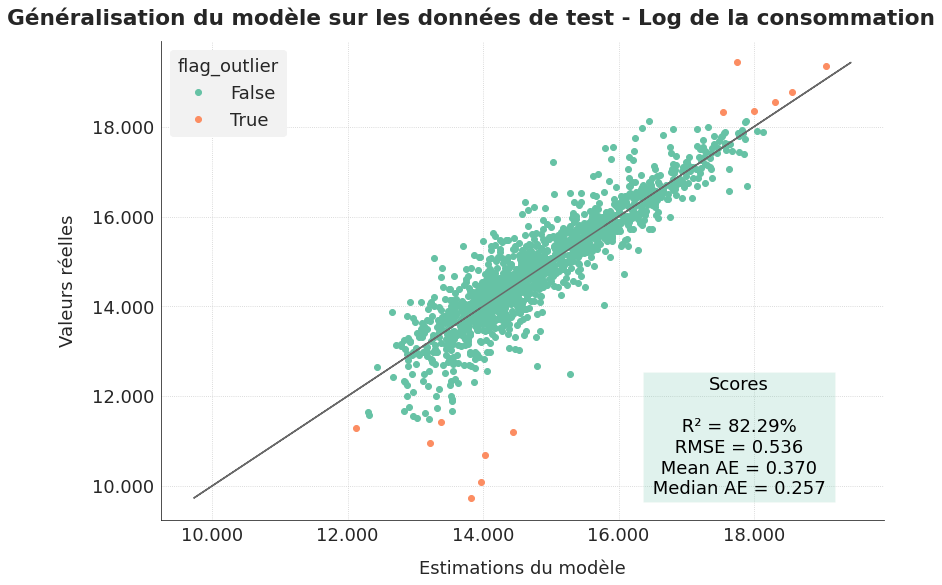

In [ ]:
fig, ax = graph_verif_test(test_analysis, test_scores, inverse_transfo_y=False, ticks_format=':.3f', hue='flag_outlier',
                           title="Généralisation du modèle sur les données de test - Log de la consommation")
save_fig("ml03_2_52_conso2b")
plt.show()

La généralisation obtient de meilleurs scores que la validation. Je vais regarder si j'obtiens la même chose sans les outliers.

**Performance de généralisation sur les données de test, sans les outliers**

In [ ]:
outliers = get_outliers(ln_y_test_conso)
xtest = X_test_conso[~outliers].copy()
ytest = ln_y_test_conso[~outliers].copy()
xdesc = desc_test_conso[~outliers].copy()

In [ ]:
df_analysis_corrected, df_scores_corrected = get_regtest_analysis(conso_pipeline, reg, xtrain, ytrain, xtest, ytest,
                                                              inverse_transfo_y='exp', xdesc=xdesc)
df_analysis_corrected = add_outliers_flag(df_analysis_corrected, inverse_transfo_y=True)
df_analysis_corrected.head()

/usr/local/lib/python3.6/dist-packages/category_encoders/ordinal.py:258: UserWarning: inverse_transform is not supported because transform impute the unknown category -1 when encode BuildingType
  "the unknown category -1 when encode %s" % (col,))
/usr/local/lib/python3.6/dist-packages/category_encoders/ordinal.py:258: UserWarning: inverse_transform is not supported because transform impute the unknown category -1 when encode PrimaryPropertyType
  "the unknown category -1 when encode %s" % (col,))
/usr/local/lib/python3.6/dist-packages/category_encoders/ordinal.py:258: UserWarning: inverse_transform is not supported because transform impute the unknown category -1 when encode LargestPropertyUseType
  "the unknown category -1 when encode %s" % (col,))
/usr/local/lib/python3.6/dist-packages/category_encoders/ordinal.py:258: UserWarning: inverse_transform is not supported because transform impute the unknown category -1 when encode SecondLargestPropertyUseType
  "the unknown category -1 w

,OSEBuildingID,DataYear,PropertyName,CouncilDistrictCode,Neighborhood,Outlier,true_values,predictions,transfo_true_values,transfo_predictions,flag_outlier,flag_transfo_outlier
2016_1,1,2016,Mayflower Park Hotel,7,Downtown,NaN,15.793246,15.657298,7226362.5,6.307805e+06,False,False
2016_2,2,2016,Paramount Hotel,7,Downtown,NaN,15.942305,15.850115,8387933.0,7.649229e+06,False,False
2016_3,3,2016,5673-The Westin Seattle,7,Downtown,NaN,18.100297,17.773680,72587024.0,5.236141e+07,False,True
2016_5,5,2016,Hotel Max,7,Downtown,NaN,15.731636,15.284314,6794584.0,4.344034e+06,False,False
2016_8,8,2016,Warwick Seattle Hotel (Id8),7,Downtown,NaN,16.466822,16.032576,14172606.0,9.180349e+06,False,False


In [ ]:
print("Généralisation du modèle sur les données de test - Log de la consommation - Sans les outliers :")
print(get_test_scores(df_scores_corrected, inverse_transfo_y=False))

Généralisation du modèle sur les données de test - Log de la consommation - Sans les outliers :
Scores

 R² = 83.50% 
 RMSE = 0.497 
 Mean AE = 0.358 
 Median AE = 0.258 


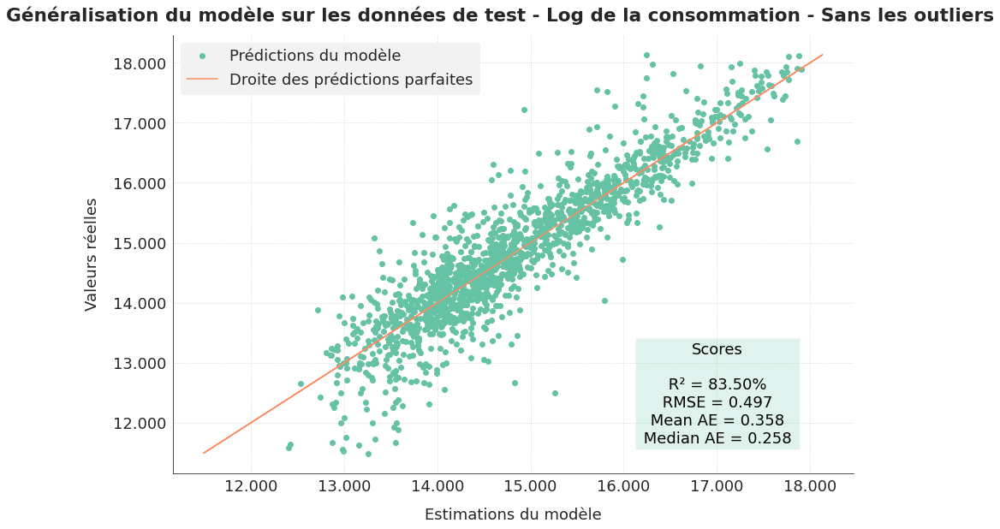

In [ ]:
fig, ax = graph_verif_test(df_analysis_corrected, df_scores_corrected, inverse_transfo_y=False, ticks_format=':.3f',
                      title="Généralisation du modèle sur les données de test - Log de la consommation - Sans les outliers")
plt.show()

**Comparaison de la généralisation de la performance sur les différents groupes de type principal de propriété**

In [ ]:
propertytype_analysis, propertytype_scores = get_regtest_analysis(conso_pipeline, reg, X_train_conso, ln_y_train_conso,
                                                                  X_test_conso, ln_y_test_conso, inverse_transfo_y='exp', 
                                                                  xdesc=desc_test_conso, hue="PrimaryPropertyType")
propertytype_analysis = add_outliers_flag(propertytype_analysis, inverse_transfo_y=True)
propertytype_analysis.head()

/usr/local/lib/python3.6/dist-packages/category_encoders/ordinal.py:258: UserWarning: inverse_transform is not supported because transform impute the unknown category -1 when encode BuildingType
  "the unknown category -1 when encode %s" % (col,))
/usr/local/lib/python3.6/dist-packages/category_encoders/ordinal.py:258: UserWarning: inverse_transform is not supported because transform impute the unknown category -1 when encode PrimaryPropertyType
  "the unknown category -1 when encode %s" % (col,))
/usr/local/lib/python3.6/dist-packages/category_encoders/ordinal.py:258: UserWarning: inverse_transform is not supported because transform impute the unknown category -1 when encode LargestPropertyUseType
  "the unknown category -1 when encode %s" % (col,))
/usr/local/lib/python3.6/dist-packages/category_encoders/ordinal.py:258: UserWarning: inverse_transform is not supported because transform impute the unknown category -1 when encode SecondLargestPropertyUseType
  "the unknown category -1 w

,OSEBuildingID,DataYear,PropertyName,CouncilDistrictCode,Neighborhood,Outlier,true_values,predictions,transfo_true_values,transfo_predictions,PrimaryPropertyType,flag_outlier,flag_transfo_outlier
2016_1,1,2016,Mayflower Park Hotel,7,Downtown,NaN,15.793246,15.640886,7226362.5,6.205127e+06,Hotel,False,False
2016_2,2,2016,Paramount Hotel,7,Downtown,NaN,15.942305,15.848390,8387933.0,7.636046e+06,Hotel,False,False
2016_3,3,2016,5673-The Westin Seattle,7,Downtown,NaN,18.100297,17.868232,72587024.0,5.755387e+07,Hotel,False,True
2016_5,5,2016,Hotel Max,7,Downtown,NaN,15.731636,15.275345,6794584.0,4.305247e+06,Hotel,False,False
2016_8,8,2016,Warwick Seattle Hotel (Id8),7,Downtown,NaN,16.466822,16.042492,14172606.0,9.271837e+06,Hotel,False,False


In [ ]:
print("Généralisation du modèle sur les données de test - log de la consommation :")
indexes = propertytype_scores.index.str.startswith("transfo") == False
print(propertytype_scores[indexes])

Généralisation du modèle sur les données de test - log de la consommation :
                                         R²      RMSE   Mean AE  Median AE
Hotel (68)                         0.901265  0.304080  0.247833   0.206917
Other (221)                        0.655322  0.796251  0.577240   0.440926
Mixed Use Property (111)           0.724031  0.641777  0.483711   0.354364
K-12 School (114)                  0.862611  0.262236  0.183826   0.138458
University (22)                    0.823626  0.684399  0.567649   0.462261
Small- and Mid-Sized Office (255)  0.707223  0.415970  0.264553   0.193254
Self-Storage Facility (28)         0.187155  0.880808  0.674569   0.466569
Large Office (158)                 0.871360  0.279842  0.205663   0.178507
Senior Care Community (35)         0.461202  0.507662  0.380283   0.311016
Medical Office (31)                0.928672  0.294144  0.250211   0.262074
Residence Hall (17)                0.846027  0.333126  0.289991   0.251386
Retail Store (81)       

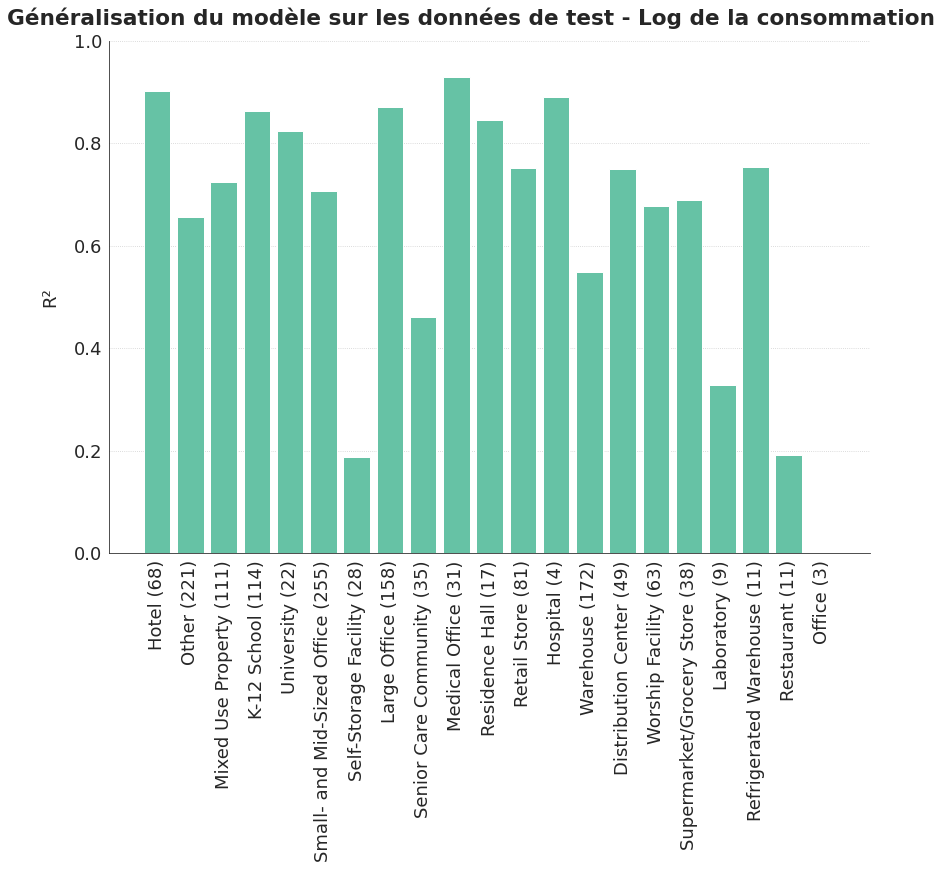

In [ ]:
fig, ax = graph_generalisation_hue(propertytype_scores, score=0, inverse_transfo_y=False, ticks_format=None, 
                                   title="Généralisation du modèle sur les données de test - Log de la consommation",
                                   ymin=0, ymax=1, rotation=90)
save_fig("ml03_2_52_conso2c", tight_layout=False)
plt.show()

La performance varie considérablement d'un groupe à l'autre. Il semble que les groupes les plus homogènes obtiennent les meilleures performances (cf Hotel, Hospital, Medical Office ou Large Office).

**Comparaison de la performance de généralisation entre les propriétés déjà présentes en 2015 et les nouvelles propriétés de 2016**

In [ ]:
index2015 = desc_train_conso["OSEBuildingID"]
samebuilding_index = desc_test_conso.OSEBuildingID.isin(index2015)

In [ ]:
xtest = X_test_conso[samebuilding_index].copy()
ytest = ln_y_test_conso[samebuilding_index].copy()
xdesc = desc_test_conso[samebuilding_index].copy()

In [ ]:
samebuilding_analysis, samebuilding_scores = get_regtest_analysis(conso_pipeline, reg, X_train_conso, ln_y_train_conso,
                                                                  xtest, ytest, xdesc=xdesc)

/usr/local/lib/python3.6/dist-packages/category_encoders/ordinal.py:258: UserWarning: inverse_transform is not supported because transform impute the unknown category -1 when encode SecondLargestPropertyUseType
  "the unknown category -1 when encode %s" % (col,))
/usr/local/lib/python3.6/dist-packages/category_encoders/ordinal.py:258: UserWarning: inverse_transform is not supported because transform impute the unknown category -1 when encode ThirdLargestPropertyUseType
  "the unknown category -1 when encode %s" % (col,))


In [ ]:
print("Généralisation du modèle sur les données de test - Log de la consommation - Mêmes buildings qu'en 2015 :")
print(get_test_scores(samebuilding_scores, inverse_transfo_y=False))

Généralisation du modèle sur les données de test - Log de la consommation - Mêmes buildings qu'en 2015 :
Scores

 R² = 83.12% 
 RMSE = 0.521 
 Mean AE = 0.361 
 Median AE = 0.253 


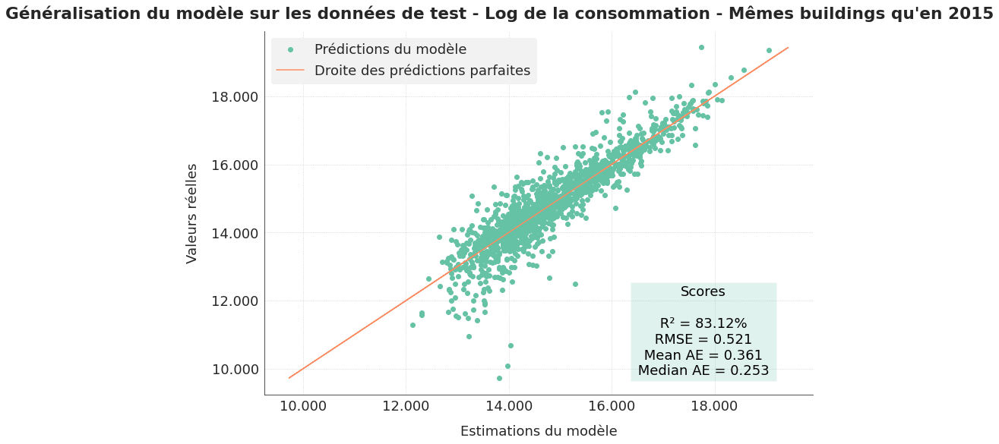

In [ ]:
fig, ax = graph_verif_test(samebuilding_analysis, samebuilding_scores, inverse_transfo_y=False, ticks_format=':.3f',
              title="Généralisation du modèle sur les données de test - Log de la consommation - Mêmes buildings qu'en 2015")
save_fig("ml03_2_52_conso2d")
plt.show()

In [ ]:
xtest = X_test_conso[samebuilding_index==False].copy()
ytest = ln_y_test_conso[samebuilding_index==False].copy()
xdesc = desc_test_conso[samebuilding_index==False].copy()

In [ ]:
newbuilding_analysis, newbuilding_scores = get_regtest_analysis(conso_pipeline, reg, X_train_conso, ln_y_train_conso,
                                                                  xtest, ytest, xdesc=xdesc)

/usr/local/lib/python3.6/dist-packages/category_encoders/ordinal.py:258: UserWarning: inverse_transform is not supported because transform impute the unknown category -1 when encode BuildingType
  "the unknown category -1 when encode %s" % (col,))
/usr/local/lib/python3.6/dist-packages/category_encoders/ordinal.py:258: UserWarning: inverse_transform is not supported because transform impute the unknown category -1 when encode PrimaryPropertyType
  "the unknown category -1 when encode %s" % (col,))
/usr/local/lib/python3.6/dist-packages/category_encoders/ordinal.py:258: UserWarning: inverse_transform is not supported because transform impute the unknown category -1 when encode LargestPropertyUseType
  "the unknown category -1 when encode %s" % (col,))
/usr/local/lib/python3.6/dist-packages/category_encoders/ordinal.py:258: UserWarning: inverse_transform is not supported because transform impute the unknown category -1 when encode SecondLargestPropertyUseType
  "the unknown category -1 w

In [ ]:
print("Généralisation du modèle sur les données de test - Log de la consommation - Nouveaux buildings :")
print(get_test_scores(newbuilding_scores, inverse_transfo_y=False))

Généralisation du modèle sur les données de test - Log de la consommation - Nouveaux buildings :
Scores

 R² = 65.04% 
 RMSE = 0.833 
 Mean AE = 0.592 
 Median AE = 0.406 


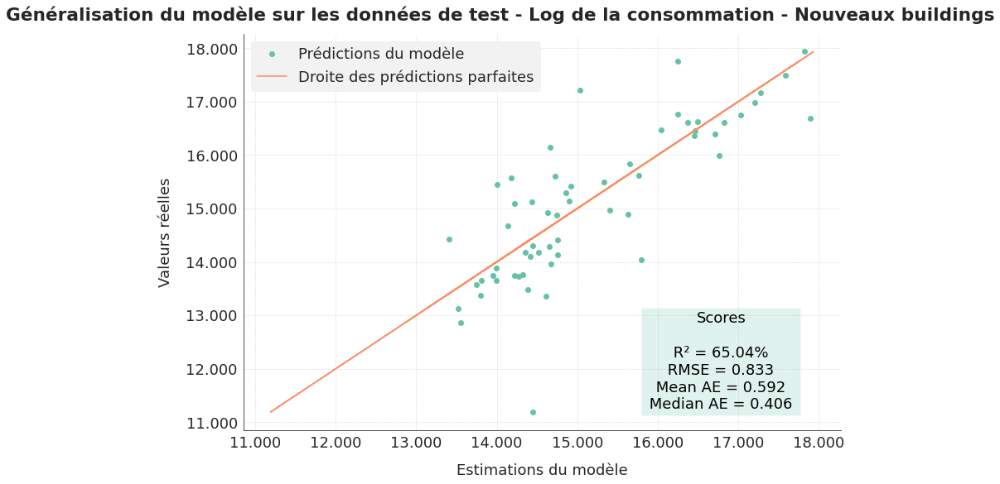

In [ ]:
fig, ax = graph_verif_test(newbuilding_analysis, newbuilding_scores, inverse_transfo_y=False, ticks_format=':.3f',
              title="Généralisation du modèle sur les données de test - Log de la consommation - Nouveaux buildings")
save_fig("ml03_2_52_conso2e")
plt.show()

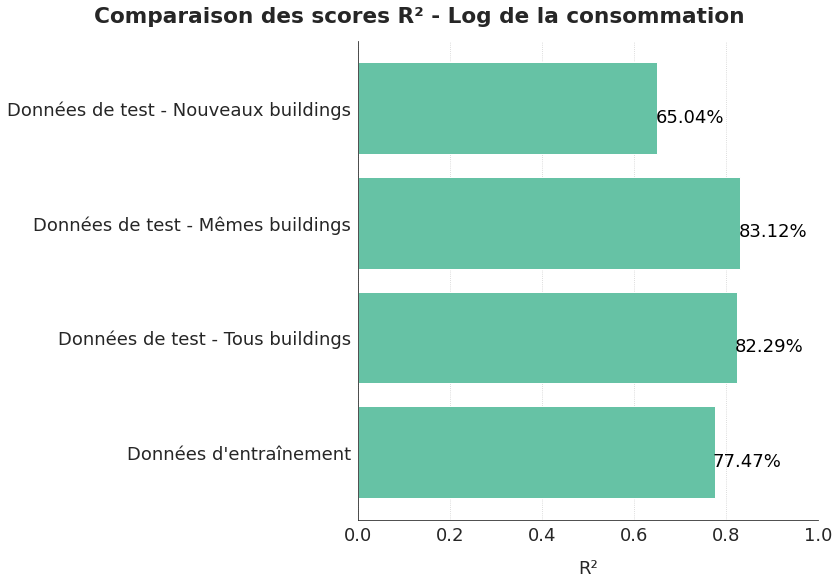

In [ ]:
labels = ["Données d'entraînement", "Données de test - Tous buildings",
                "Données de test - Mêmes buildings", "Données de test - Nouveaux buildings"]
values = [0.7747, 0.8229, 0.8312, 0.6504]
graph = sfg.MyGraph("Comparaison des scores R² - Log de la consommation")
graph.add_barh(labels, values)
for i, v in enumerate(values):
    graph.add_text(v+0.07, i, "{:.2%}".format(v), backgroundalpha=0)
graph.set_axe_x(label="R²", tick_min=0, tick_max=1)
fig, ax = graph.fig, graph.ax
save_fig("ml03_2_52_conso2f")
plt.show()

Les scores de généralisation sur les propriétés déjà existantes sont meilleurs que les scores de validation. Par contre, les scores de généralisation sur les nouvelles propriétés sont bien moins bons, ce qui laisse supposer un problème de généralisation qui peut notamment être dû à un problème d'obsolescence rapide du modèle : les progrès réalisés chaque année sur l'isolation et les énergies vertes ne sont pas intégrés dans notre modèle.

<a id='5_0'></a>

## 5. Modèle pour estimer les émissions

J'effectue les mêmes étapes que pour l'estimation de la consommation.

### 5.1. Première optimisation : étude des possibilités de préparation de données et d'une sélection d'estimateurs

In [ ]:
data_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', PandasColumnTransformer(transfo_col, [
        ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ'),
        ('num_imputer', FitToPandas(imputer_median), 'num')
        ], n_jobs=-1)),
    ('data_encoders', FitToPandas(encoder_target_conso, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=True, keep_all=True)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler()))
])

In [ ]:
reg_pipeline = Pipeline([('pca', PCA(n_components=4)),
    ('estimator', DummyRegressor(strategy='median'))
])

In [ ]:
space = {
    'data_imputers': hp.choice('data_imputers', [imputer_missforest, imputer_knn,
        PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_mean), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1),
        PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_median), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1),
        PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_iterative), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1)]),
    'data_case': hp.choice('data_case', [
        {'encoders': hp.choice('encoders1', [encoder_target_emissions, encoder_leaveoneout]),
         'add_cross': hp.choice('add_cross1', [True,False]),
         'keep_all': hp.choice('keep_all1', [True,False]),
         'list_name': None,
         'restrict_cols': None},
        {'encoders': hp.choice('encoders2', [encoder_hashing, encoder_perso_onehot, encoder_ordinal]),
         'add_cross': False,
         'keep_all': False,
         'list_name': transfo_col,
         'restrict_cols': 'transfo_num'}]),
    'pca': hp.choice('pca', [None, PCA(n_components=0.90), PCA(n_components=0.99)])}

In [ ]:
list_best_results = []

In [ ]:
#scope.define(DummyRegressor)
estimator_name = 'dummy_reg'
estimator_object = scope.DummyRegressor(strategy='median')
run_optimization(estimator_name, estimator_object, max_evals=1, reg_target='emissions')

100%|██████████| 1/1 [00:01<00:00,  1.53s/it, best loss: 0.003314493669601637]
Estimateur : dummy_reg - Done
Best cross-validation mean score = -0.003314493669601637
Associated standard deviation = 0.0027531136239684686
Calculation time = 0.0016092777252197266
Data preparation time = 1.4518114279999281
Best cv score obtained after 1 iterations



In [ ]:
#scope.define(LinearRegression)
estimator_name = 'linear_reg'
estimator_object = scope.LinearRegression()
run_optimization(estimator_name, estimator_object, max_evals=50, reg_target='emissions')

Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6

In [ ]:
#scope.define(Ridge)
estimator_name = 'ridge_reg'
estimator_object = scope.Ridge(random_state=42)
run_optimization(estimator_name, estimator_object, max_evals=50, reg_target='emissions')

Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6

In [ ]:
#scope.define(Lasso)
estimator_name = 'lasso_reg'
estimator_object = scope.Lasso(random_state=42)
run_optimization(estimator_name, estimator_object, max_evals=50, reg_target='emissions')

Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
100%|██████████| 50/50 [03:02<00:00,  3.64s/it, best loss: -0.29352115742601564]
Estimateur : lasso_reg - Done
Best cross-validation mean score = 0.29352115742601564
Associated standard deviation = 0.01566418637431639
Calculation time = 0.0019641399383544924
Data preparation time = 0.3794386689987732
Best cv score obtained after 3 iterations



In [ ]:
#scope.define(KNeighborsRegressor)
estimator_name = 'knn_reg'
estimator_object = scope.KNeighborsRegressor(n_jobs=-1)
run_optimization(estimator_name, estimator_object, max_evals=50, reg_target='emissions')

Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6

In [ ]:
#scope.define(SVR)
estimator_name = 'svm_reg'
estimator_object = scope.SVR()
run_optimization(estimator_name, estimator_object, max_evals=50, reg_target='emissions')

Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6

In [ ]:
#scope.define(RandomForestRegressor)
estimator_name = 'randomforest_reg'
estimator_object = scope.RandomForestRegressor(n_jobs=-1, random_state=42)
run_optimization(estimator_name, estimator_object, max_evals=50, reg_target='emissions')

Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6

In [ ]:
#scope.define(ExtraTreesRegressor)
estimator_name = 'extratrees_reg'
estimator_object = scope.ExtraTreesRegressor(n_jobs=-1, random_state=42)
run_optimization(estimator_name, estimator_object, max_evals=50, reg_target='emissions')

Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6

In [ ]:
#scope.define(AdaBoostRegressor)
estimator_name = 'adaboost_reg'
estimator_object = scope.AdaBoostRegressor(random_state=42)
run_optimization(estimator_name, estimator_object, max_evals=50, reg_target='emissions')

Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
100%|██████████| 50/50 [03:48<00:00,  4.57s/it, best loss: -0.4472849006513292]
Estimateur : adaboost_reg - Done
Best cross-validation mean score = 0.4472849006513292
Associated standard deviation = 0.06281495782709516
Calculation time = 0.009157037734985352
Data preparation time = 0.23414900100033265
Best cv score obtained after 17 iterations



In [ ]:
#scope.define(XGBRegressor)
estimator_name = 'xgboost_reg'
estimator_object = scope.XGBRegressor(objective='reg:squarederror', n_jobs=-1, random_state=42)
run_optimization(estimator_name, estimator_object, max_evals=50, reg_target='emissions')

Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6
Iteration:
0
Iteration:
1
Iteration:
2
Iteration:
3
Iteration:
4
Iteration:
5
Iteration:
6

In [ ]:
first_emissions_best_results = pd.DataFrame(list_best_results)

In [ ]:
first_emissions_best_results = get_details(first_emissions_best_results)
first_emissions_best_results.sort_values("loss", inplace=True)
first_emissions_best_results

,loss,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,params_data,params_reg,data_transfo_time,iteration,status,estimator,pca,imputer,strategy,encoder,add_cross,keep_all
2,-0.547141,0.054180,0.002297,0.562697,1.457452e-02,0.003878,{'data_imputers': AllImputation(categ_cols=['B...,"{'estimator': Ridge(alpha=1.0, copy_X=True, fi...",25.611408,28,ok,Ridge,Non,MissForest,,LeaveOneOutEncoder,True,True
9,-0.547023,0.043494,0.003733,0.727393,8.325332e-03,0.209828,{'data_imputers': PandasColumnTransformer(list...,"{'estimator': XGBRegressor(base_score=0.5, boo...",0.628653,49,ok,XGBRegressor,Non,IterativeImputer,'mean',LeaveOneOutEncoder,True,True
1,-0.546991,0.054387,0.001855,0.561826,1.468635e-02,0.005067,{'data_imputers': AllImputation(categ_cols=['B...,"{'estimator': LinearRegression(copy_X=True, fi...",25.532385,18,ok,LinearRegression,Non,MissForest,,LeaveOneOutEncoder,False,True
7,-0.543747,0.050968,0.103773,1.000000,8.821179e-13,0.705822,{'data_imputers': PandasColumnTransformer(list...,{'estimator': ExtraTreesRegressor(bootstrap=Fa...,0.229395,43,ok,ExtraTreesRegressor,Non,SimpleImputer,'mean',LeaveOneOutEncoder,False,False
6,-0.542834,0.055253,0.103613,0.937577,1.349637e-03,1.330585,{'data_imputers': AllImputation(categ_cols=['B...,{'estimator': RandomForestRegressor(bootstrap=...,25.603465,29,ok,RandomForestRegressor,Non,MissForest,,LeaveOneOutEncoder,False,True
5,-0.530228,0.030934,0.064842,0.681810,8.048748e-03,0.348885,{'data_imputers': AllImputation(categ_cols=['B...,"{'estimator': SVR(C=1.0, cache_size=200, coef0...",25.953205,10,ok,SVR,Non,MissForest,,CustomOneHotEncoder,False,False
8,-0.447285,0.062815,0.009157,0.550094,8.031581e-03,0.333424,{'data_imputers': PandasColumnTransformer(list...,{'estimator': AdaBoostRegressor(base_estimator...,0.234149,17,ok,AdaBoostRegressor,PCA,SimpleImputer,'median',LeaveOneOutEncoder,False,True
4,-0.444431,0.063381,0.104890,0.634375,1.158398e-02,0.035059,{'data_imputers': AllImputation(categ_cols=['B...,{'estimator': KNeighborsRegressor(algorithm='a...,25.954551,31,ok,KNeighborsRegressor,PCA,MissForest,,CustomOneHotEncoder,False,False
3,-0.293521,0.015664,0.001964,0.299356,1.538463e-02,0.008146,{'data_imputers': AllImputation(categ_cols=['B...,"{'estimator': Lasso(alpha=1.0, copy_X=True, fi...",0.379439,3,ok,Lasso,PCA,KNNImputer,,LeaveOneOutEncoder,True,True
0,0.003314,0.002753,0.001609,-0.000088,6.866143e-05,0.005207,{'data_imputers': PandasColumnTransformer(list...,"{'estimator': DummyRegressor(constant=None, qu...",1.451811,1,ok,DummyRegressor,PCA,SimpleImputer,'mean',CustomTargetEncoder,False,True


In [ ]:
first_emissions_best_results[["estimator","loss","train_score_mean","imputer","strategy","encoder","pca","add_cross","keep_all"]]

,estimator,loss,train_score_mean,imputer,strategy,encoder,pca,add_cross,keep_all
2,Ridge,-0.547141,0.562697,MissForest,,LeaveOneOutEncoder,Non,True,True
9,XGBRegressor,-0.547023,0.727393,IterativeImputer,'mean',LeaveOneOutEncoder,Non,True,True
1,LinearRegression,-0.546991,0.561826,MissForest,,LeaveOneOutEncoder,Non,False,True
7,ExtraTreesRegressor,-0.543747,1.000000,SimpleImputer,'mean',LeaveOneOutEncoder,Non,False,False
6,RandomForestRegressor,-0.542834,0.937577,MissForest,,LeaveOneOutEncoder,Non,False,True
5,SVR,-0.530228,0.681810,MissForest,,CustomOneHotEncoder,Non,False,False
8,AdaBoostRegressor,-0.447285,0.550094,SimpleImputer,'median',LeaveOneOutEncoder,PCA,False,True
4,KNeighborsRegressor,-0.444431,0.634375,MissForest,,CustomOneHotEncoder,PCA,False,False
3,Lasso,-0.293521,0.299356,KNNImputer,,LeaveOneOutEncoder,PCA,True,True
0,DummyRegressor,0.003314,-0.000088,SimpleImputer,'mean',CustomTargetEncoder,PCA,False,True


Les imputations et les encodages les plus performantes semblent être les mêmes que pour la consommation.  
Les scores obtenus par les modèles sont plus faibles sur l'estimation des émissions que sur l'estimation de la consommation.

<a id='5_2'></a>

### 5.2. Etude des résultats de la première optimisation, modèle par modèle

**Ridge**

In [ ]:
ridge_emissions = gen_df_analyse('hyperopt_first_emissions_ridge_reg.csv')
ridge_emissions[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
27,0.547141,0.562697,MissForest,,LeaveOneOut,True,None
31,0.547141,0.562697,MissForest,,LeaveOneOut,True,None
32,0.547141,0.562697,MissForest,,LeaveOneOut,True,None
42,0.547141,0.562697,MissForest,,LeaveOneOut,True,None
17,0.547028,0.561810,MissForest,,LeaveOneOut,False,None


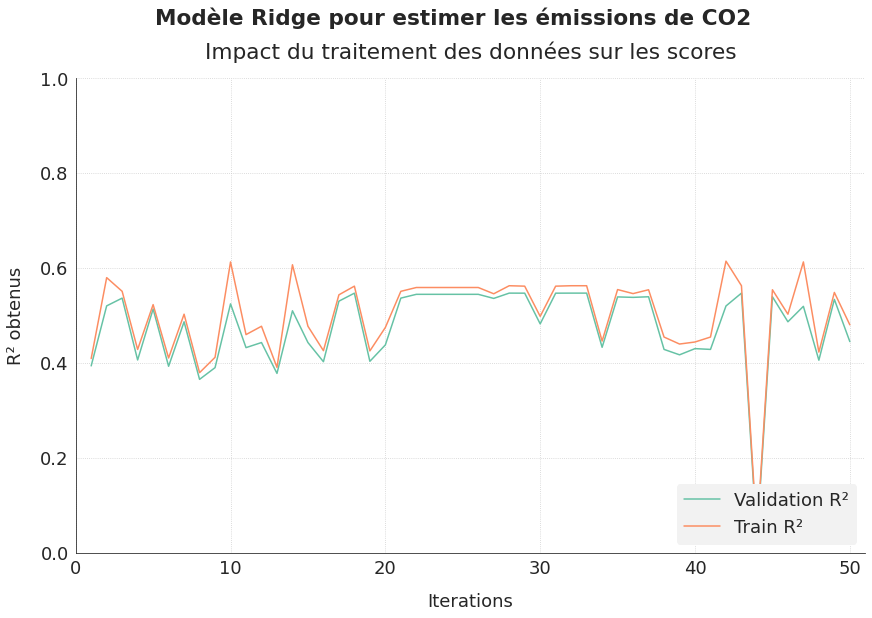

In [ ]:
fig, ax = graph_analyse_score(ridge_emissions, "Ridge", "les émissions de CO2")
plt.show()

La régression ridge aboutit à des résultats très stables entre les scores d'entraînement et les scores de validation.

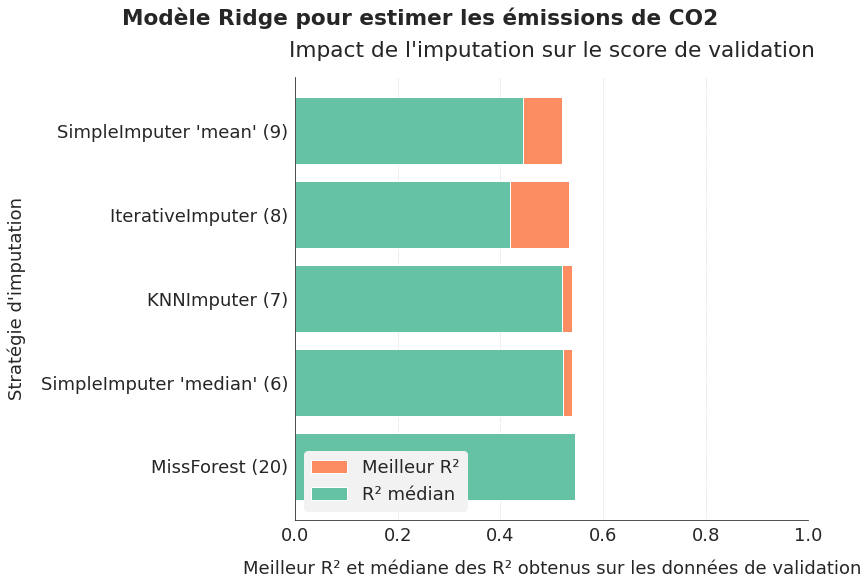

In [ ]:
fig, ax = graph_analyse_imputers(ridge_emissions, "Ridge", "les émissions de CO2")
save_fig("ml03_2_31_co2")
plt.show()

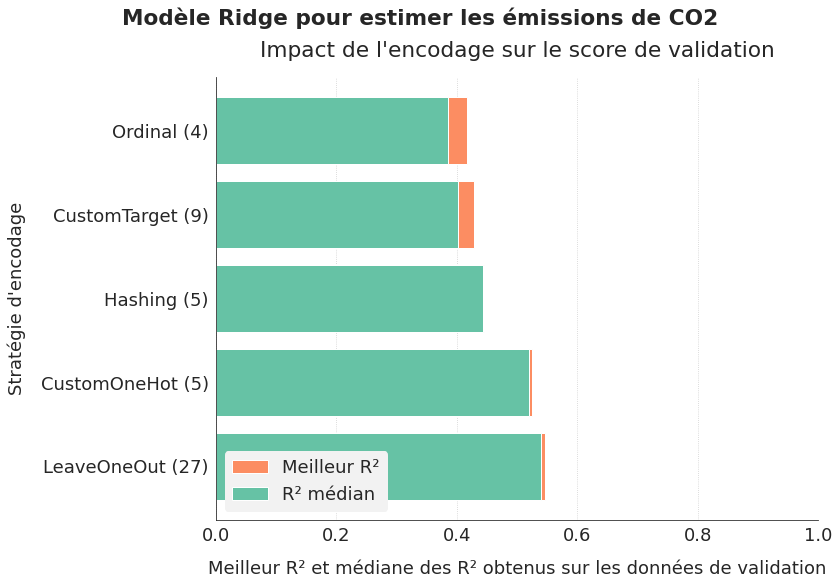

In [ ]:
fig, ax = graph_analyse_encoders(ridge_emissions, "Ridge", "les émissions de CO2")
save_fig("ml03_2_32_co2")
plt.show()

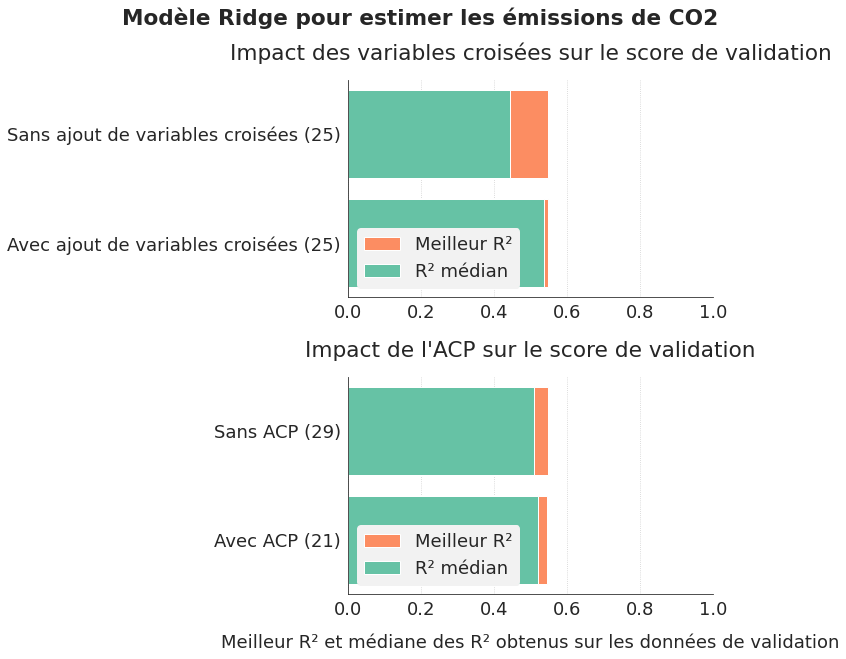

In [ ]:
fig, ax = graph_analyse_others(ridge_emissions, "Ridge", "les émissions de CO2")
save_fig("ml03_2_33_co2")
plt.show()

**XGBoost**

In [ ]:
xgb_emissions = gen_df_analyse('hyperopt_first_emissions_xgboost_reg.csv')
xgb_emissions[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
48,0.547023,0.727393,IterativeImputer,,LeaveOneOut,True,None
17,0.546253,0.724010,MissForest,,LeaveOneOut,False,None
23,0.546253,0.724010,MissForest,,LeaveOneOut,False,None
24,0.546253,0.724010,MissForest,,LeaveOneOut,False,None
25,0.546253,0.724010,MissForest,,LeaveOneOut,False,None


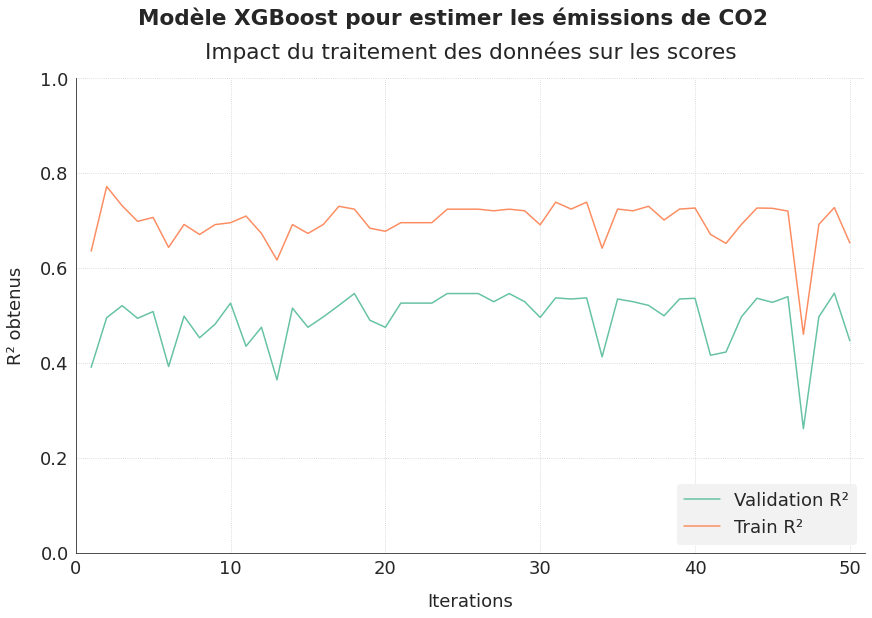

In [ ]:
fig, ax = graph_analyse_score(xgb_emissions, "XGBoost", "les émissions de CO2")
plt.show()

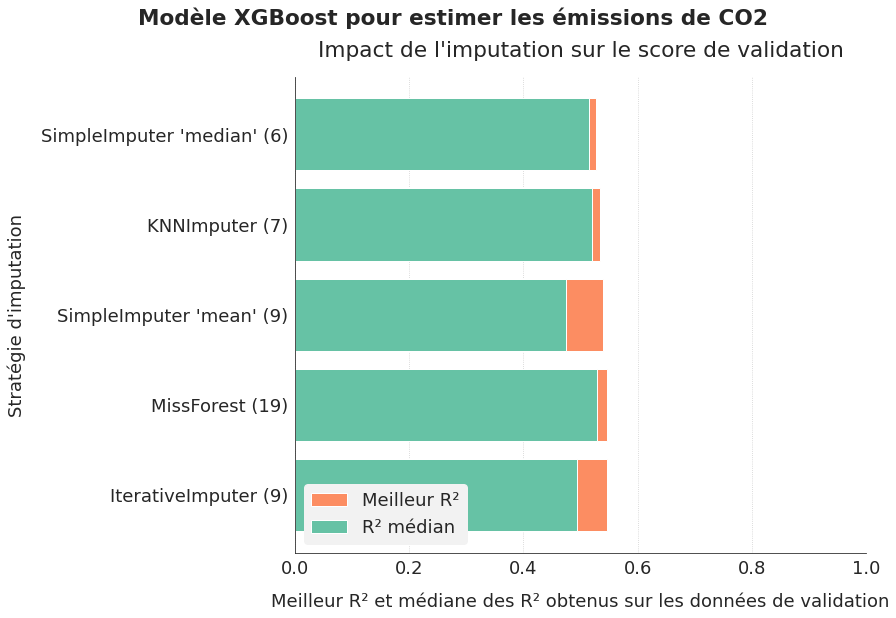

In [ ]:
fig, ax = graph_analyse_imputers(xgb_emissions, "XGBoost", "les émissions de CO2")
plt.show()

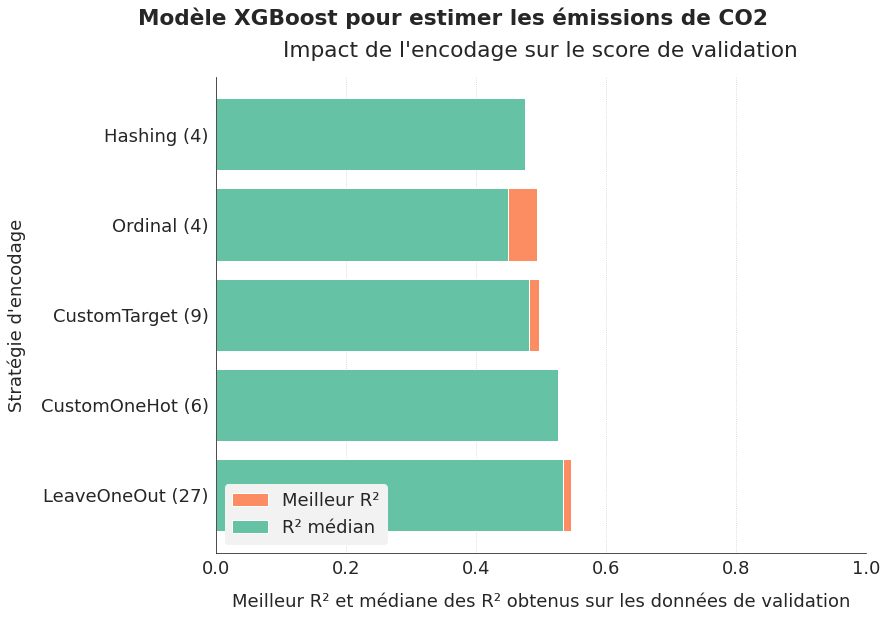

In [ ]:
fig, ax = graph_analyse_encoders(xgb_emissions, "XGBoost", "les émissions de CO2")
plt.show()

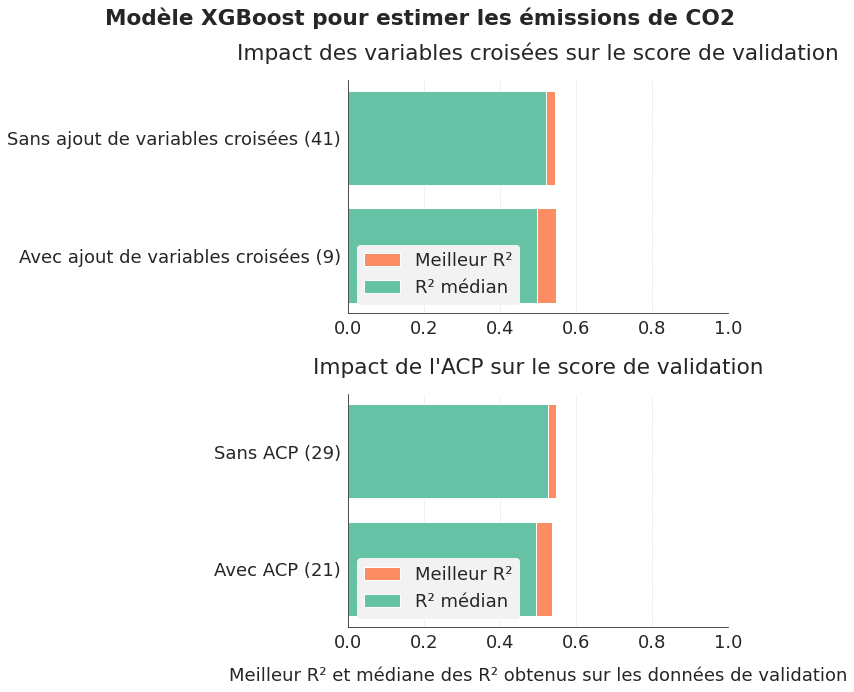

In [ ]:
fig, ax = graph_analyse_others(xgb_emissions, "XGBoost", "les émissions de CO2")
plt.show()

**Linear Regression**

In [ ]:
lr_emissions = gen_df_analyse('hyperopt_first_emissions_linear_reg.csv')
lr_emissions[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
17,0.546991,0.561826,MissForest,,LeaveOneOut,False,None
31,0.546991,0.561826,MissForest,,LeaveOneOut,False,None
32,0.546991,0.561826,MissForest,,LeaveOneOut,False,None
35,0.546991,0.561826,MissForest,,LeaveOneOut,False,None
42,0.546991,0.561826,MissForest,,LeaveOneOut,False,None


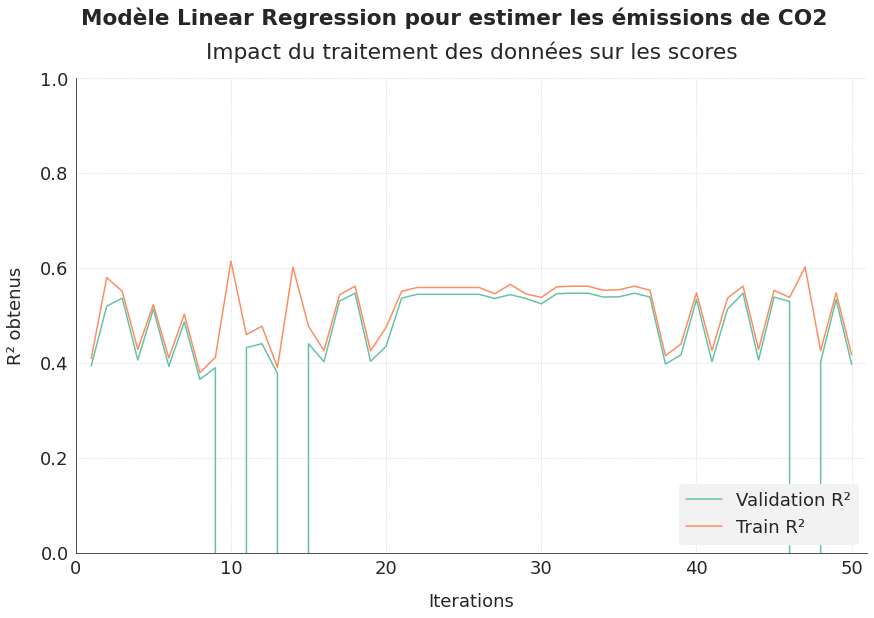

In [ ]:
fig, ax = graph_analyse_score(lr_emissions, "Linear Regression", "les émissions de CO2")
plt.show()

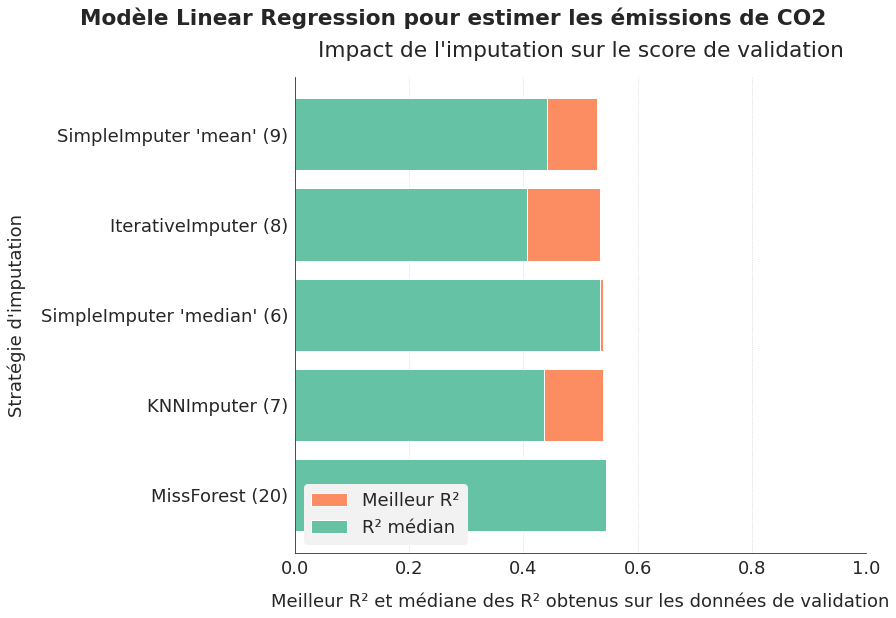

In [ ]:
fig, ax = graph_analyse_imputers(lr_emissions, "Linear Regression", "les émissions de CO2")
plt.show()

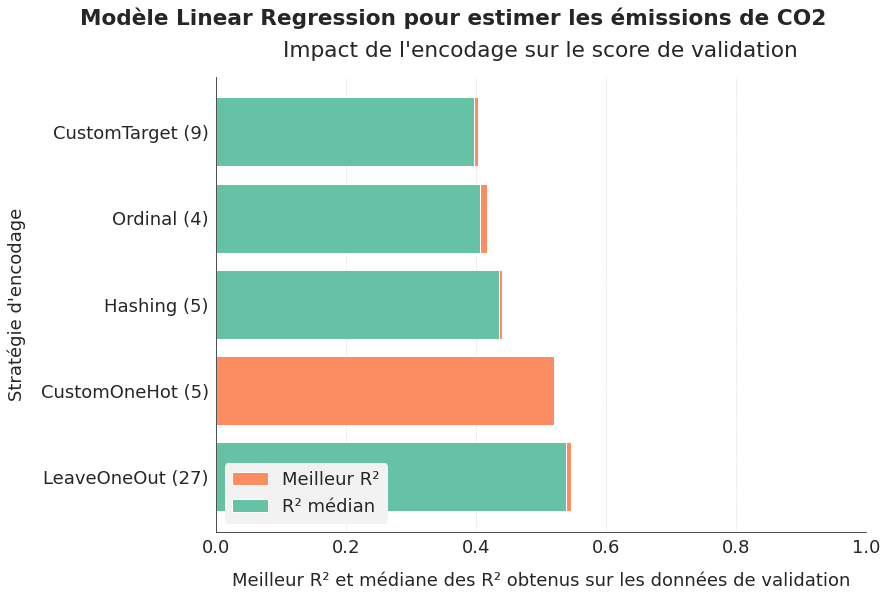

In [ ]:
fig, ax = graph_analyse_encoders(lr_emissions, "Linear Regression", "les émissions de CO2")
plt.show()

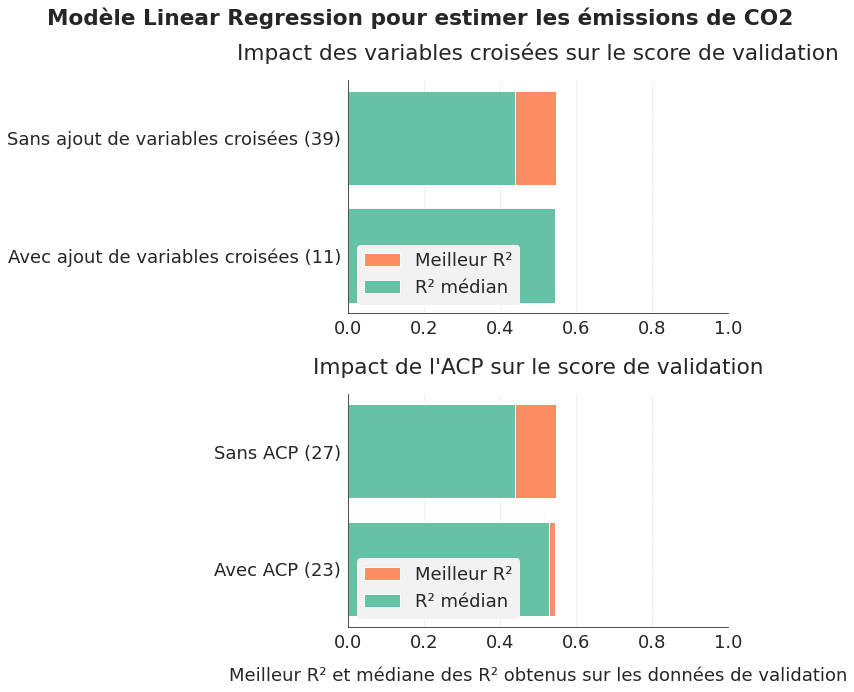

In [ ]:
fig, ax = graph_analyse_others(lr_emissions, "Linear Regression", "les émissions de CO2")
plt.show()

**Extra trees**

In [ ]:
ext_emissions = gen_df_analyse('hyperopt_first_emissions_extratrees_reg.csv')
ext_emissions[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
42,0.543747,1.0,SimpleImputer,'mean',LeaveOneOut,False,None
44,0.543747,1.0,SimpleImputer,'mean',LeaveOneOut,False,None
45,0.543747,1.0,SimpleImputer,'mean',LeaveOneOut,False,None
48,0.543747,1.0,SimpleImputer,'mean',LeaveOneOut,False,None
17,0.541759,1.0,MissForest,,LeaveOneOut,False,None


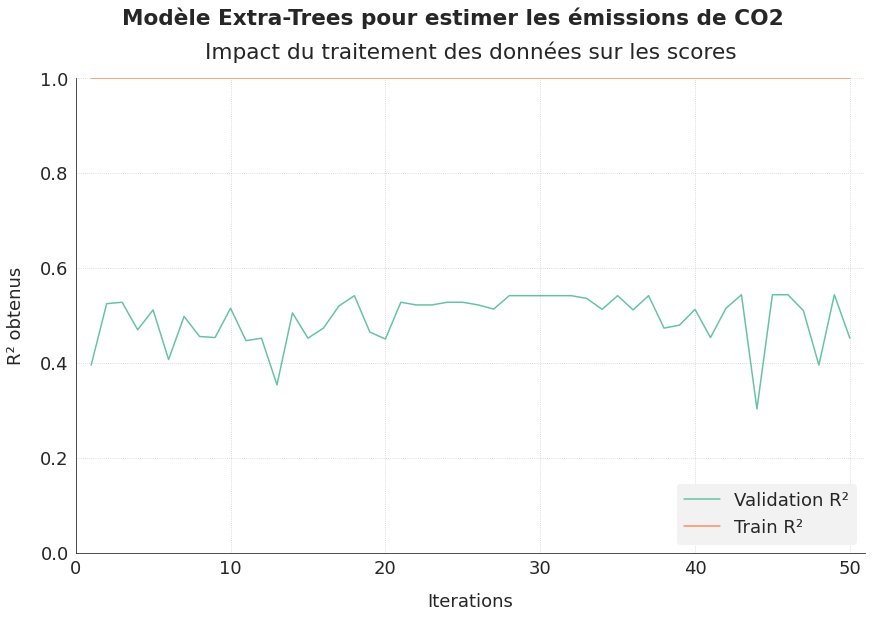

In [ ]:
fig, ax = graph_analyse_score(ext_emissions, "Extra-Trees", "les émissions de CO2")
plt.show()

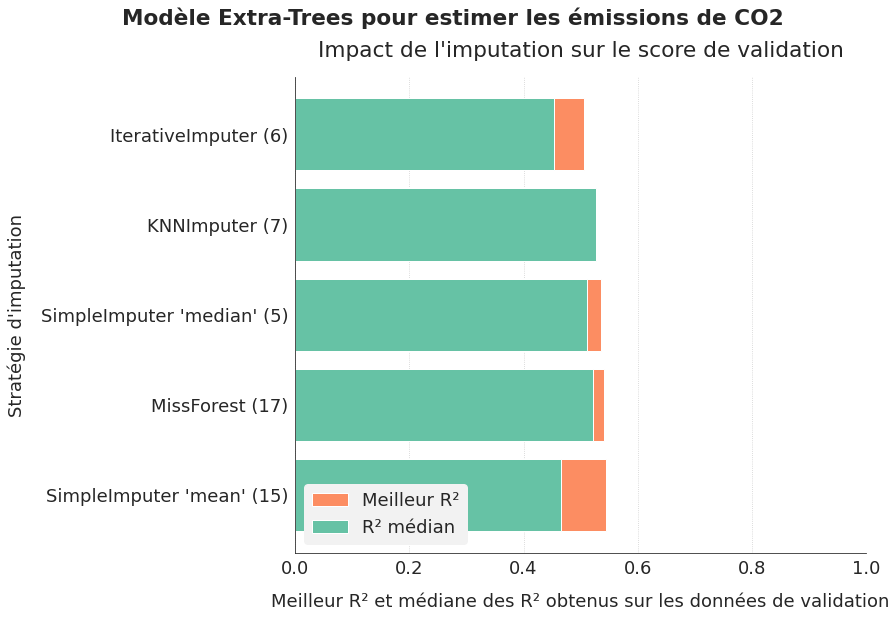

In [ ]:
fig, ax = graph_analyse_imputers(ext_emissions, "Extra-Trees", "les émissions de CO2")
plt.show()

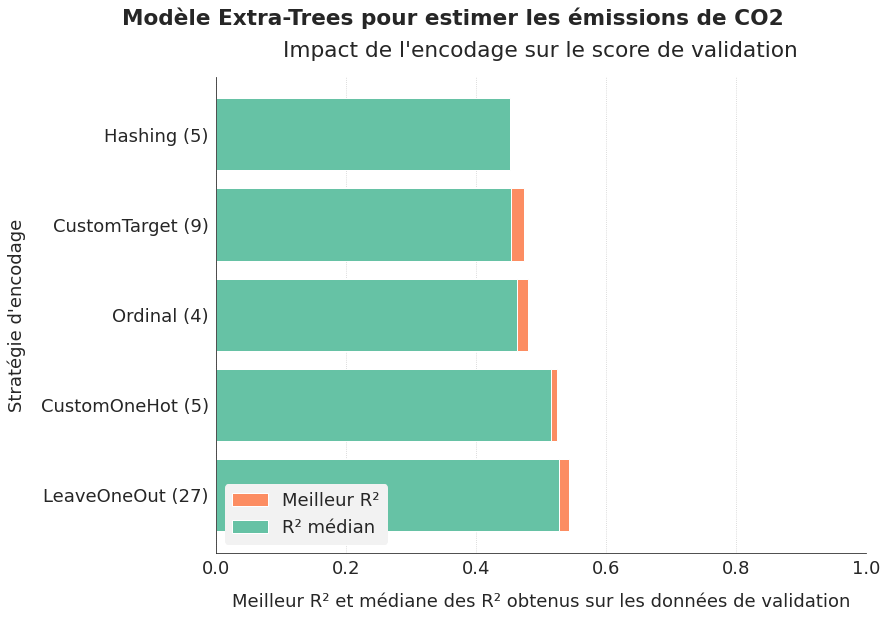

In [ ]:
fig, ax = graph_analyse_encoders(ext_emissions, "Extra-Trees", "les émissions de CO2")
plt.show()

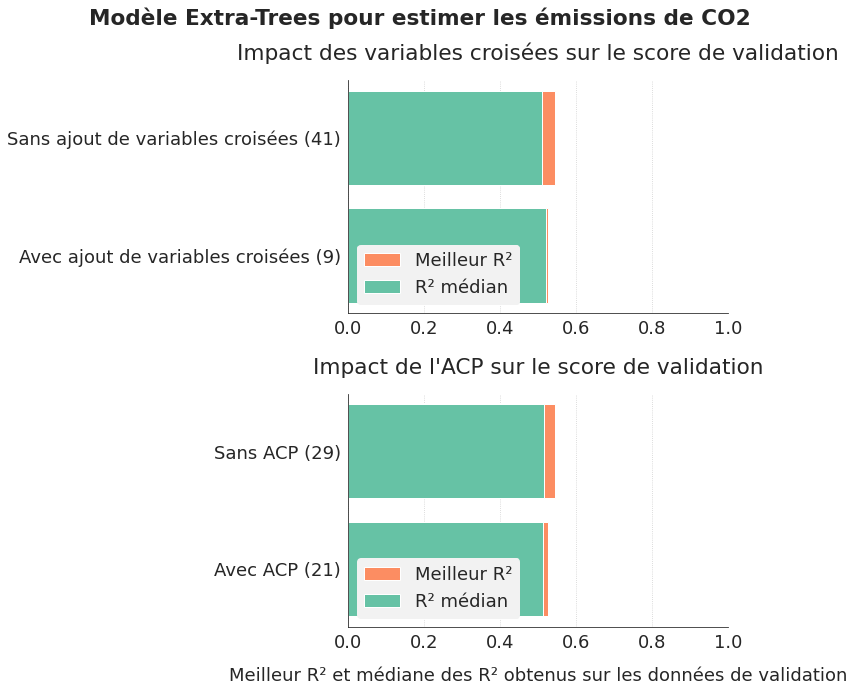

In [ ]:
fig, ax = graph_analyse_others(ext_emissions, "Extra-Trees", "les émissions de CO2")
plt.show()

**Random Forest**

In [ ]:
rf_emissions = gen_df_analyse('hyperopt_first_emissions_randomforest_reg.csv')
rf_emissions[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
28,0.542834,0.937577,MissForest,,LeaveOneOut,False,None
30,0.542834,0.937577,MissForest,,LeaveOneOut,False,None
42,0.542834,0.937577,MissForest,,LeaveOneOut,False,None
17,0.542834,0.937577,MissForest,,LeaveOneOut,False,None
31,0.542834,0.937577,MissForest,,LeaveOneOut,False,None


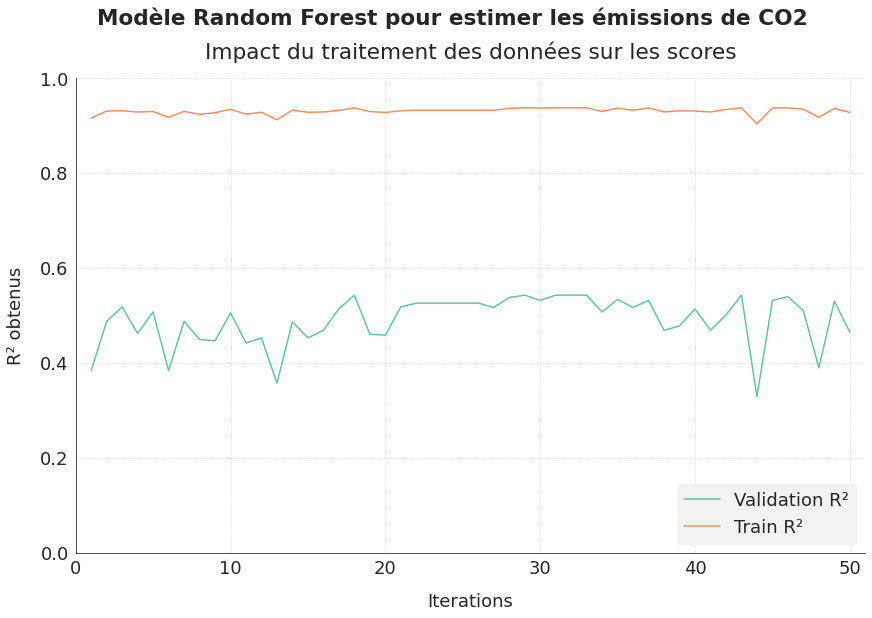

In [ ]:
fig, ax = graph_analyse_score(rf_emissions, "Random Forest", "les émissions de CO2")
plt.show()

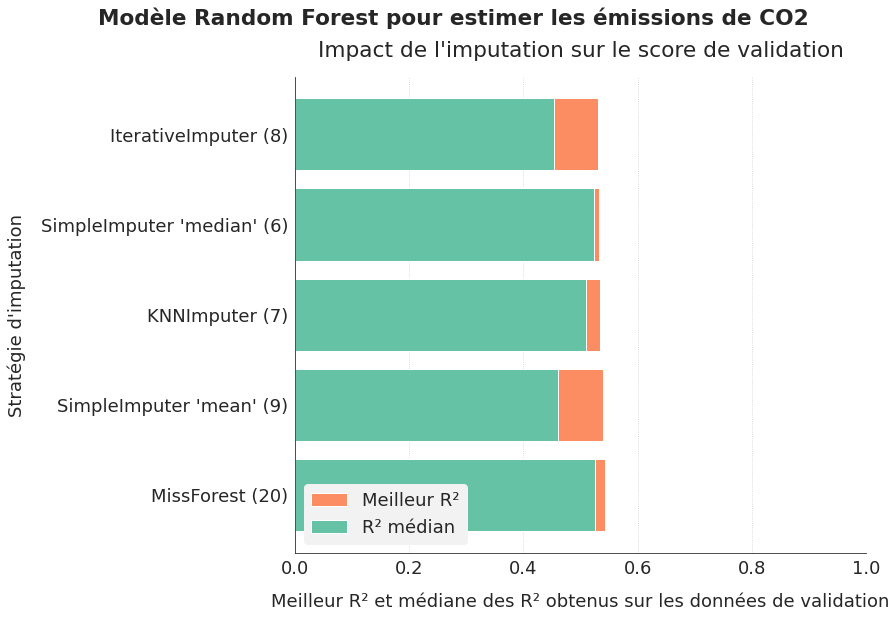

In [ ]:
fig, ax = graph_analyse_imputers(rf_emissions, "Random Forest", "les émissions de CO2")
plt.show()

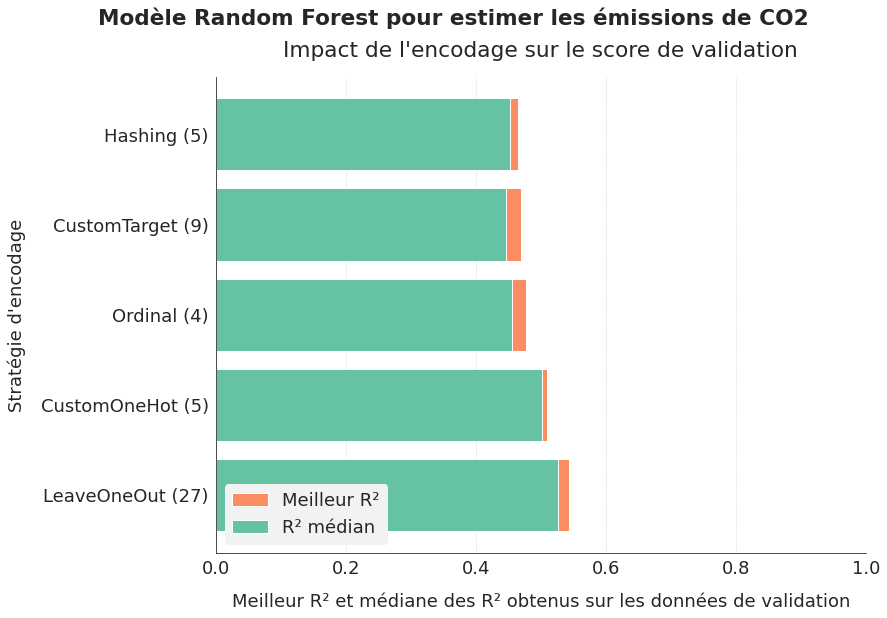

In [ ]:
fig, ax = graph_analyse_encoders(rf_emissions, "Random Forest", "les émissions de CO2")
plt.show()

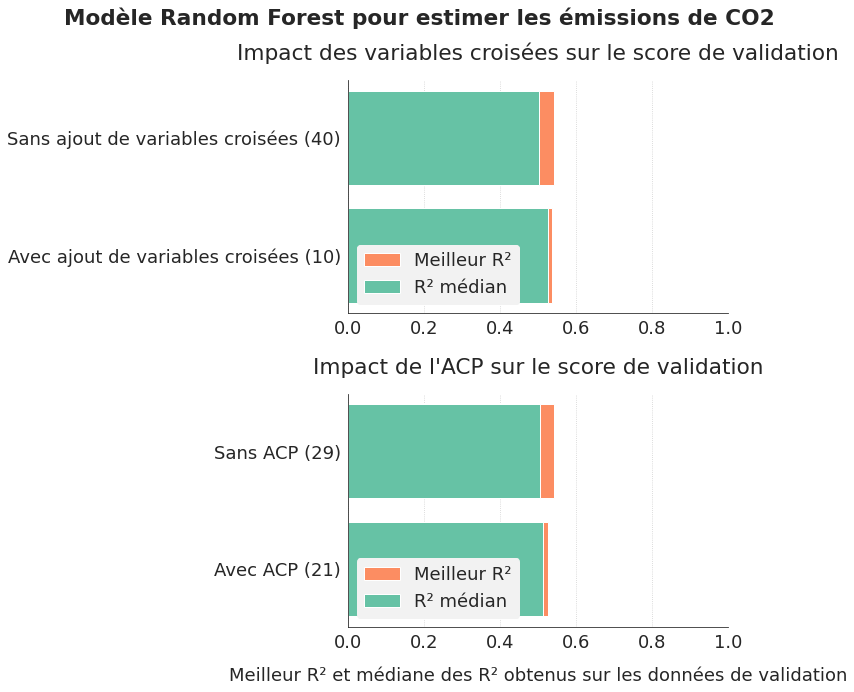

In [ ]:
fig, ax = graph_analyse_others(rf_emissions, "Random Forest", "les émissions de CO2")
plt.show()

**SVM**

In [ ]:
svm_emissions = gen_df_analyse('hyperopt_first_emissions_svm_reg.csv')
svm_emissions[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
9,0.530228,0.68181,MissForest,,CustomOneHot,False,None
20,0.530228,0.68181,MissForest,,CustomOneHot,False,None
21,0.530228,0.68181,MissForest,,CustomOneHot,False,None
22,0.530228,0.68181,MissForest,,CustomOneHot,False,None
23,0.530228,0.68181,MissForest,,CustomOneHot,False,None


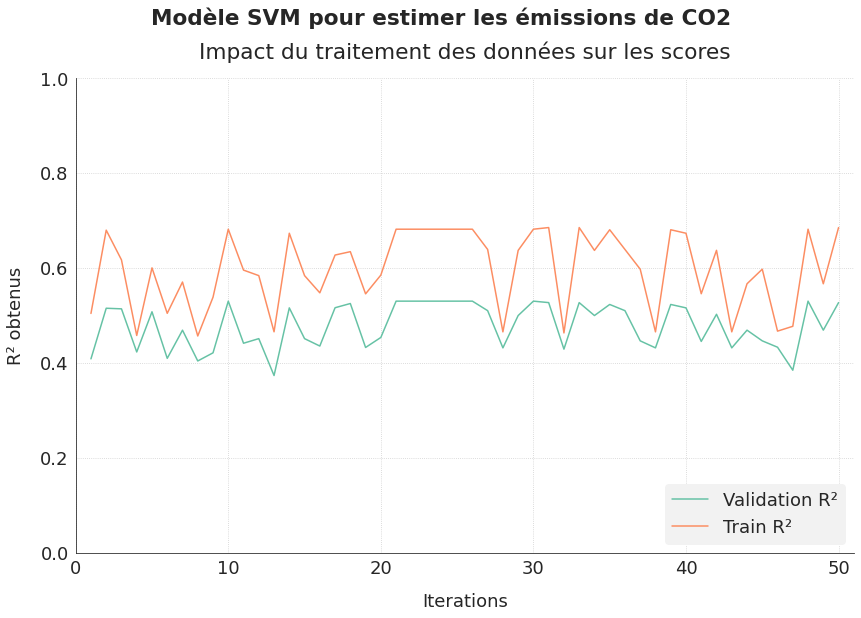

In [ ]:
fig, ax = graph_analyse_score(svm_emissions, "SVM", "les émissions de CO2")
plt.show()

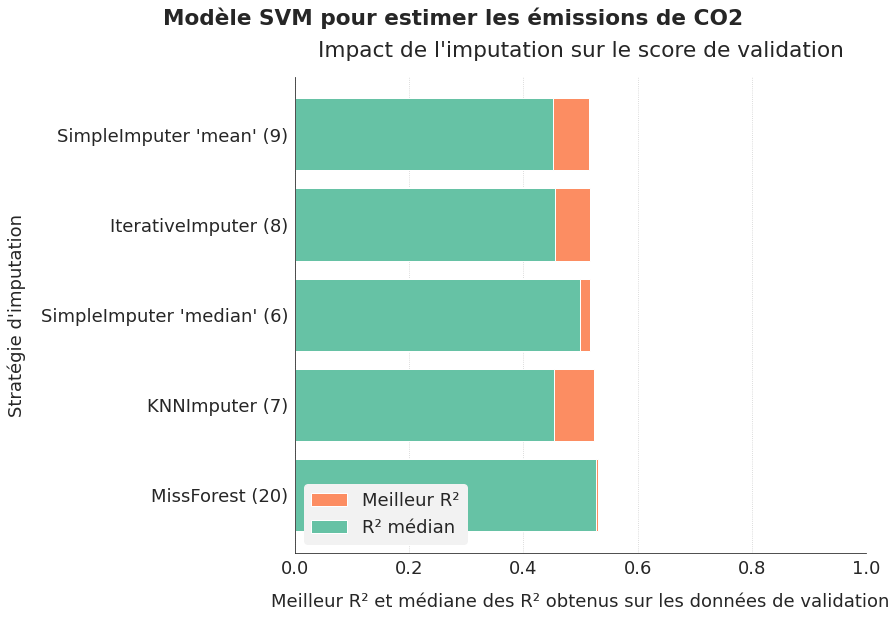

In [ ]:
fig, ax = graph_analyse_imputers(svm_emissions, "SVM", "les émissions de CO2")
plt.show()

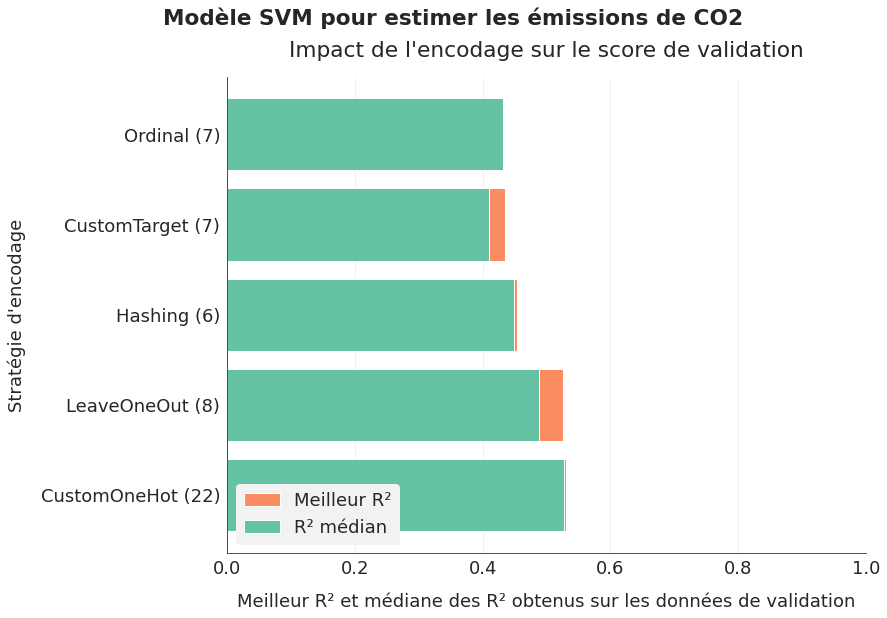

In [ ]:
fig, ax = graph_analyse_encoders(svm_emissions, "SVM", "les émissions de CO2")
plt.show()

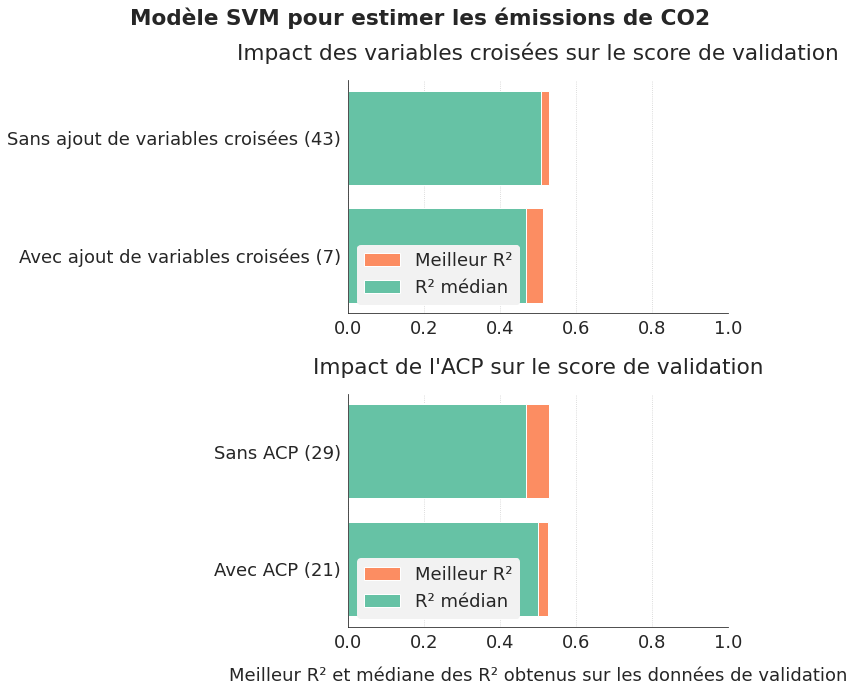

In [ ]:
fig, ax = graph_analyse_others(svm_emissions, "SVM", "les émissions de CO2")
plt.show()

**AdaBoost**

In [ ]:
ada_emissions = gen_df_analyse('hyperopt_first_emissions_adaboost_reg.csv')
ada_emissions[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
16,0.447285,0.550094,SimpleImputer,'median',LeaveOneOut,False,"PCA(copy=True, iterated_power='auto', n_compon..."
20,0.447285,0.550094,SimpleImputer,'median',LeaveOneOut,False,"PCA(copy=True, iterated_power='auto', n_compon..."
21,0.447285,0.550094,SimpleImputer,'median',LeaveOneOut,False,"PCA(copy=True, iterated_power='auto', n_compon..."
22,0.447285,0.550094,SimpleImputer,'median',LeaveOneOut,False,"PCA(copy=True, iterated_power='auto', n_compon..."
23,0.447285,0.550094,SimpleImputer,'median',LeaveOneOut,False,"PCA(copy=True, iterated_power='auto', n_compon..."


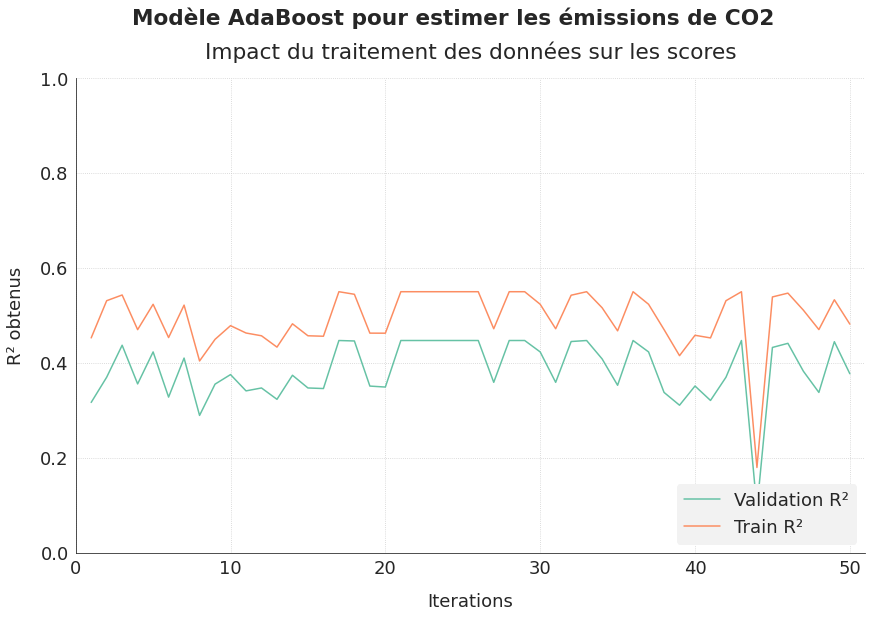

In [ ]:
fig, ax = graph_analyse_score(ada_emissions, "AdaBoost", "les émissions de CO2")
plt.show()

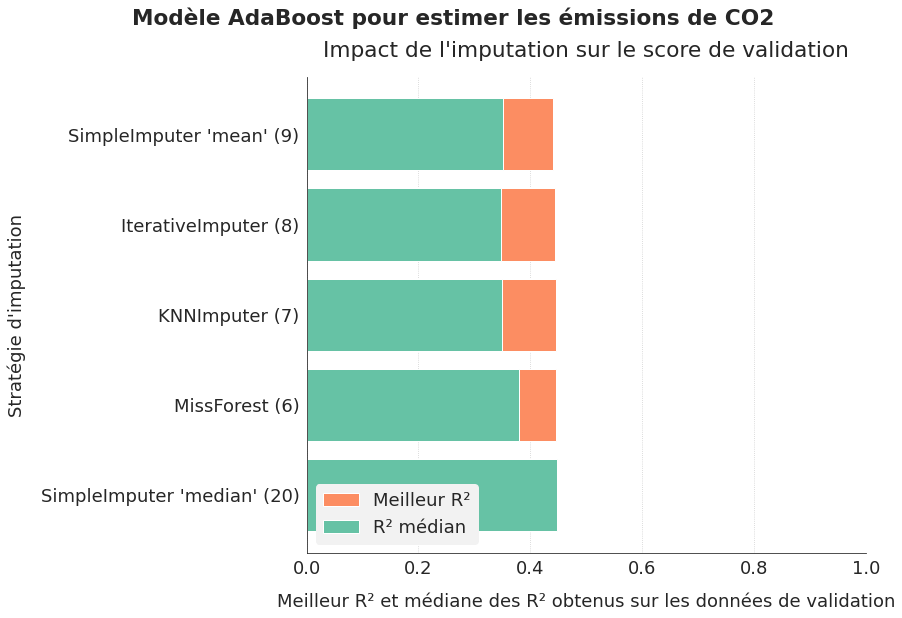

In [ ]:
fig, ax = graph_analyse_imputers(ada_emissions, "AdaBoost", "les émissions de CO2")
plt.show()

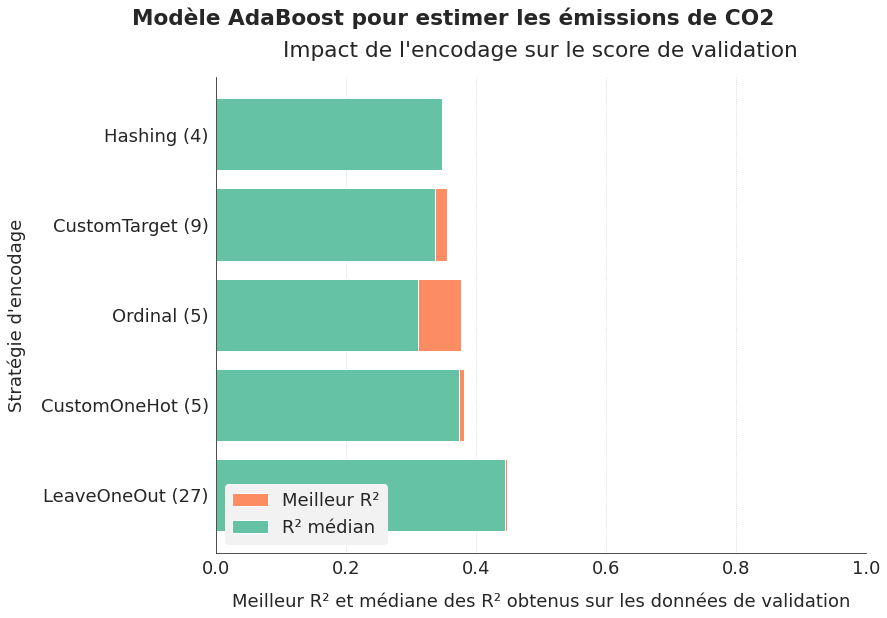

In [ ]:
fig, ax = graph_analyse_encoders(ada_emissions, "AdaBoost", "les émissions de CO2")
plt.show()

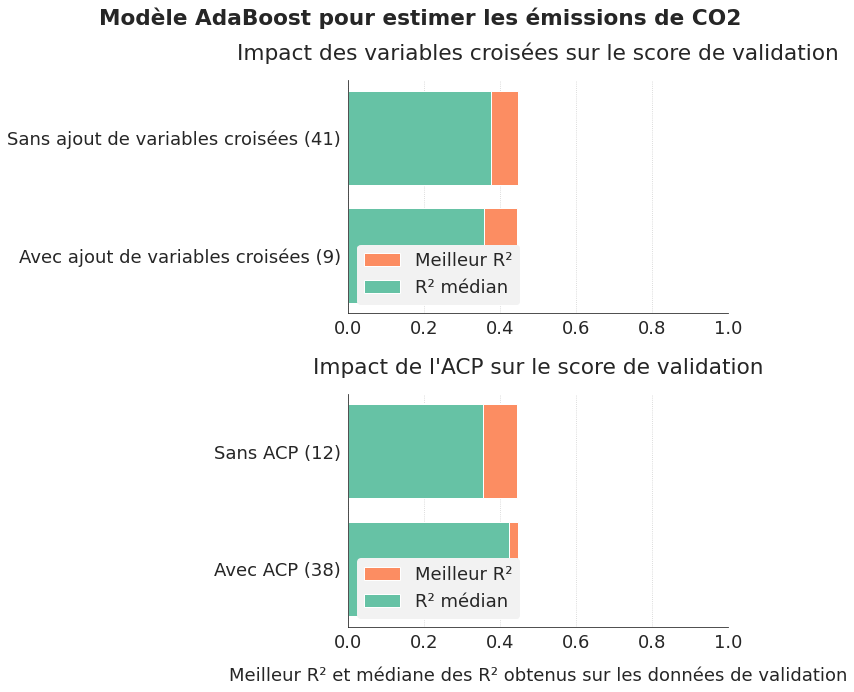

In [ ]:
fig, ax = graph_analyse_others(ada_emissions, "AdaBoost", "les émissions de CO2")
plt.show()

**kNN**

In [ ]:
knn_emissions = gen_df_analyse('hyperopt_first_emissions_knn_reg.csv')
knn_emissions[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
30,0.444431,0.634375,MissForest,,CustomOneHot,False,"PCA(copy=True, iterated_power='auto', n_compon..."
32,0.444431,0.634375,MissForest,,CustomOneHot,False,"PCA(copy=True, iterated_power='auto', n_compon..."
35,0.444431,0.634375,MissForest,,CustomOneHot,False,"PCA(copy=True, iterated_power='auto', n_compon..."
47,0.444431,0.634375,MissForest,,CustomOneHot,False,"PCA(copy=True, iterated_power='auto', n_compon..."
49,0.444431,0.634375,MissForest,,CustomOneHot,False,"PCA(copy=True, iterated_power='auto', n_compon..."


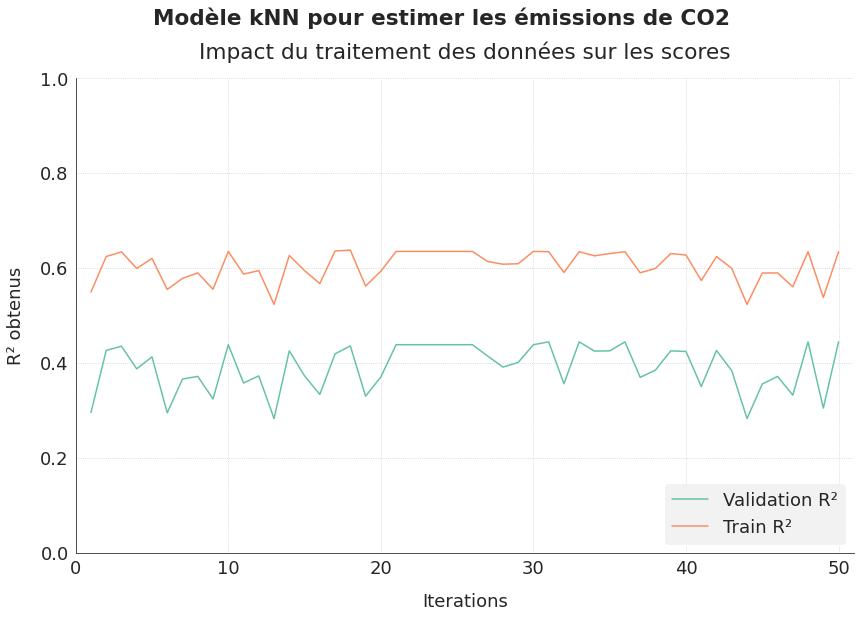

In [ ]:
fig, ax = graph_analyse_score(knn_emissions, "kNN", "les émissions de CO2")
plt.show()

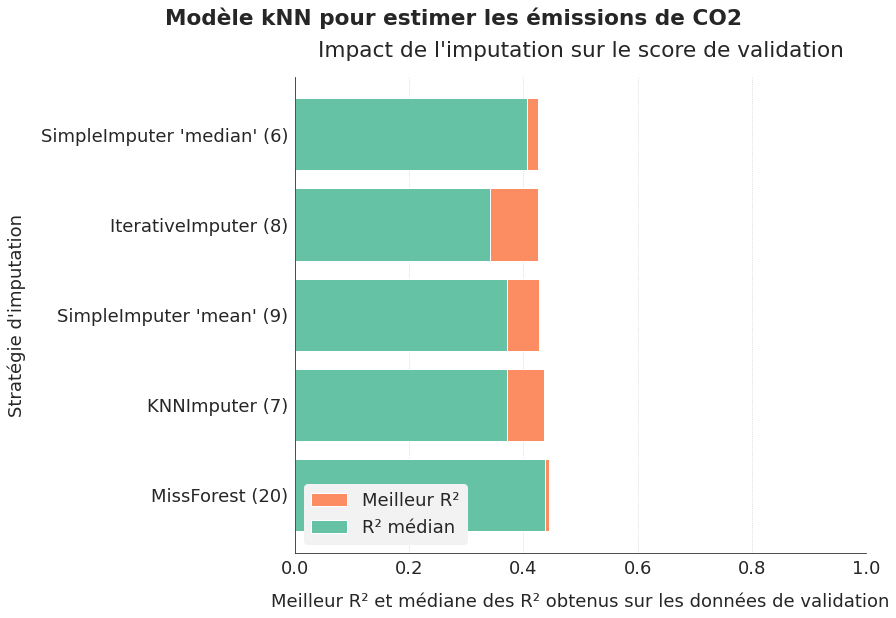

In [ ]:
fig, ax = graph_analyse_imputers(knn_emissions, "kNN", "les émissions de CO2")
plt.show()

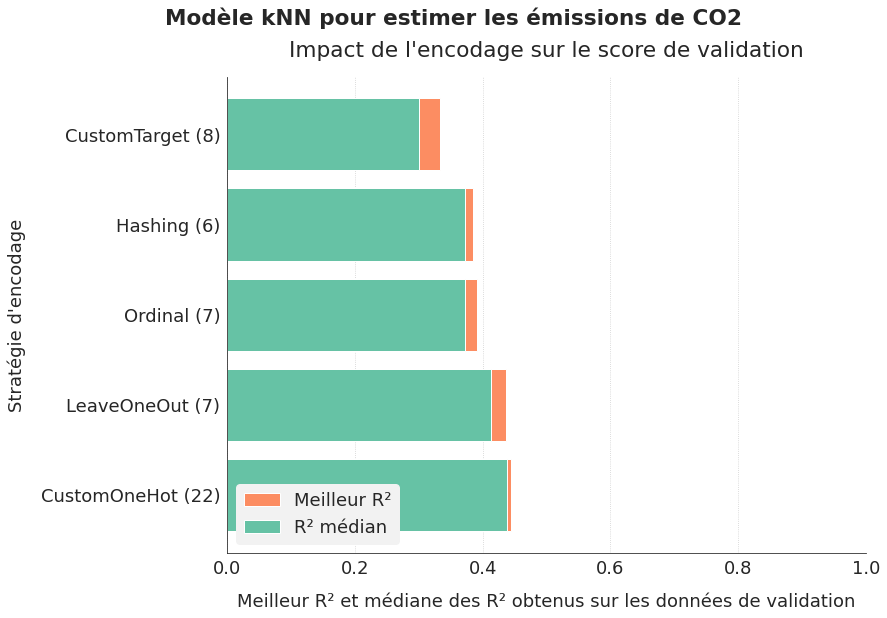

In [ ]:
fig, ax = graph_analyse_encoders(knn_emissions, "kNN", "les émissions de CO2")
plt.show()

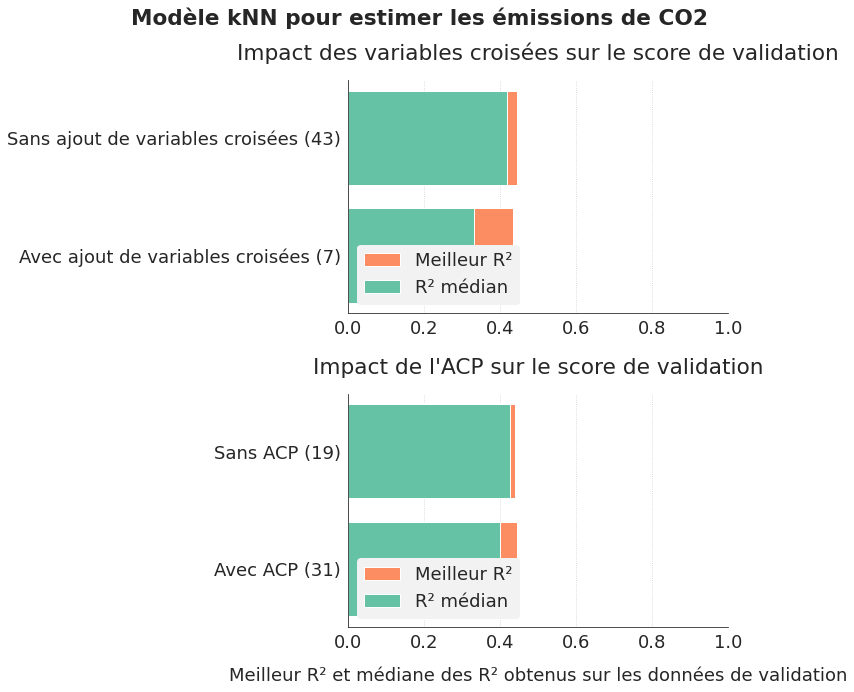

In [ ]:
fig, ax = graph_analyse_others(knn_emissions, "kNN", "les émissions de CO2")
plt.show()

**Analyse groupée des temps de calcul**

In [ ]:
svm_emissions["model"] = "SVM"
ext_emissions["model"] = "Extra Trees"
xgb_emissions["model"] = "XGBoost"
ridge_emissions["model"] = "Ridge"
rf_emissions["model"] = "Random Forest"
lr_emissions["model"] = "Linear Regression"
knn_emissions["model"] = "kNN"
ada_emissions["model"] = "AdaBoost"

In [ ]:
first_emissions_grouped = pd.concat([svm_emissions, ext_emissions, xgb_emissions, ridge_emissions, 
                                 rf_emissions, lr_emissions, knn_emissions, ada_emissions], ignore_index=True)

In [ ]:
first_emissions_grouped["corrected_transfo_time"] = calculate_corrected_transfo_time(first_emissions_grouped)

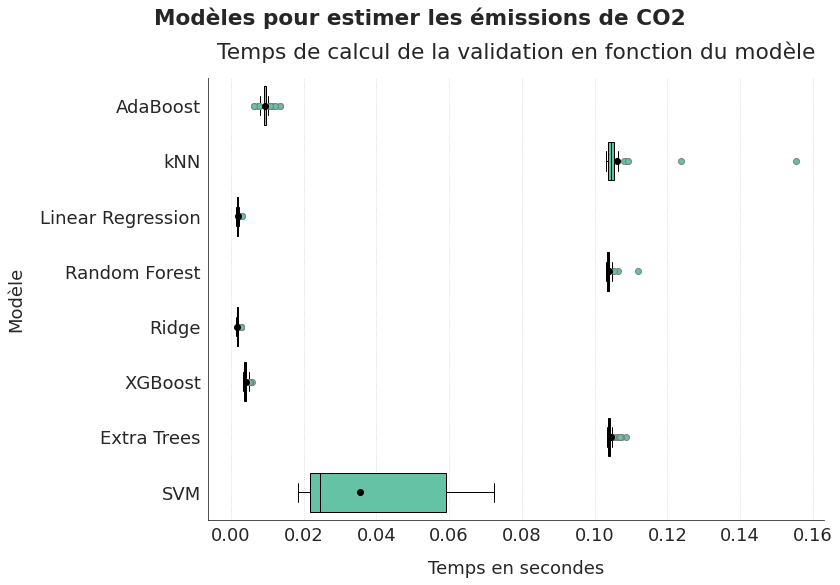

In [ ]:
fig, ax = graph_model_validtime(first_emissions_grouped, "les émissions de CO2")
save_fig("ml03_2_34_co2")
plt.show()

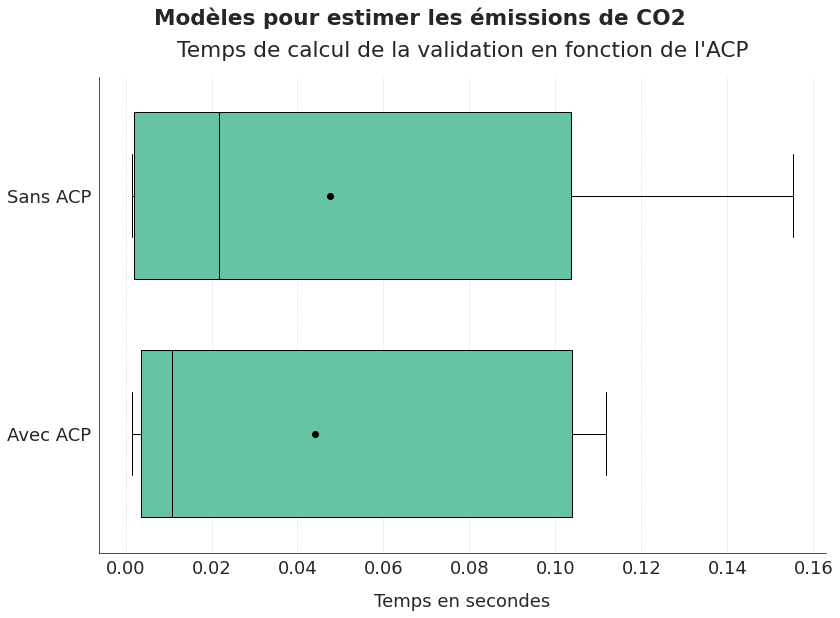

In [ ]:
fig, ax = graph_acp_validtime(first_emissions_grouped, "les émissions de CO2")
plt.show()

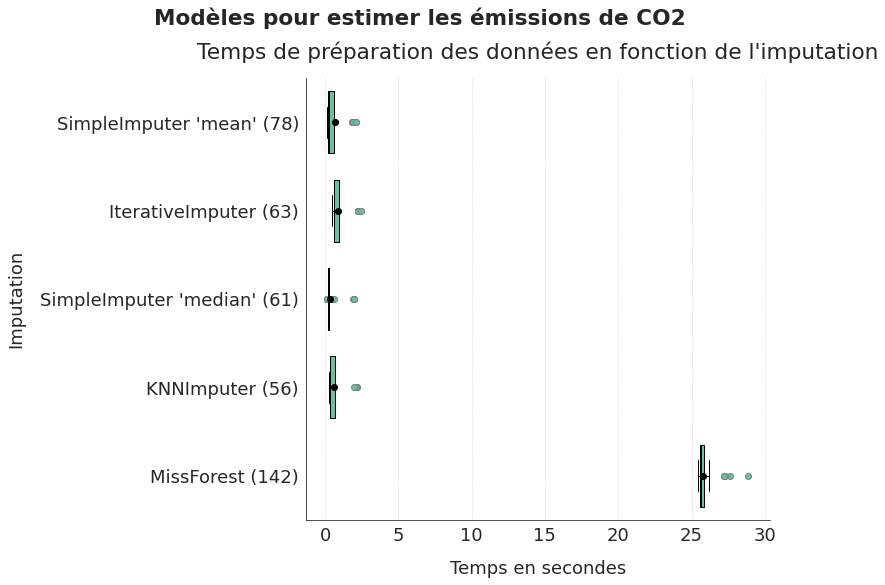

In [ ]:
fig, ax = graph_imputer_preparetime(first_emissions_grouped, "les émissions de CO2")
save_fig("ml03_2_35_co2")
plt.show()

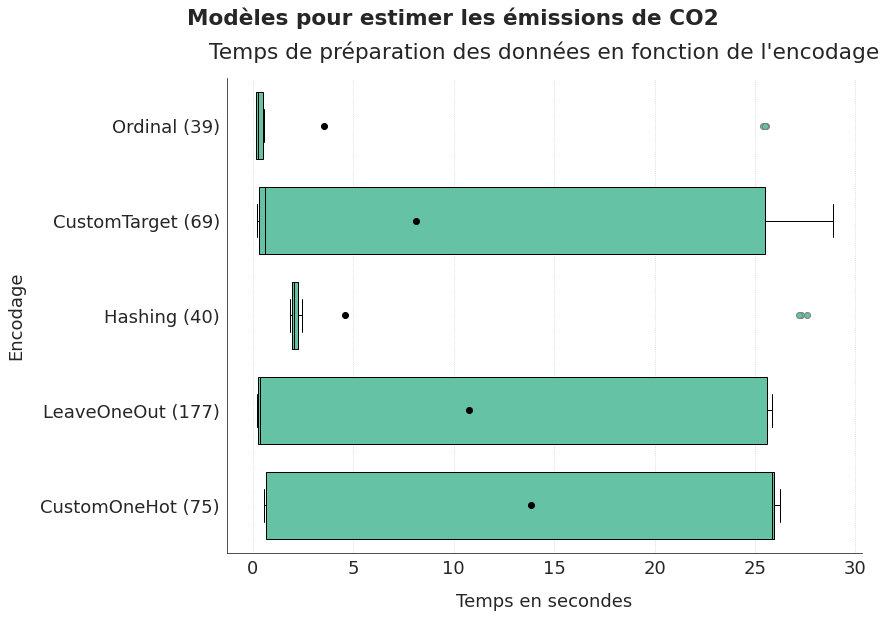

In [ ]:
fig, ax = graph_encoder_preparetime(first_emissions_grouped, "les émissions de CO2")
plt.show()

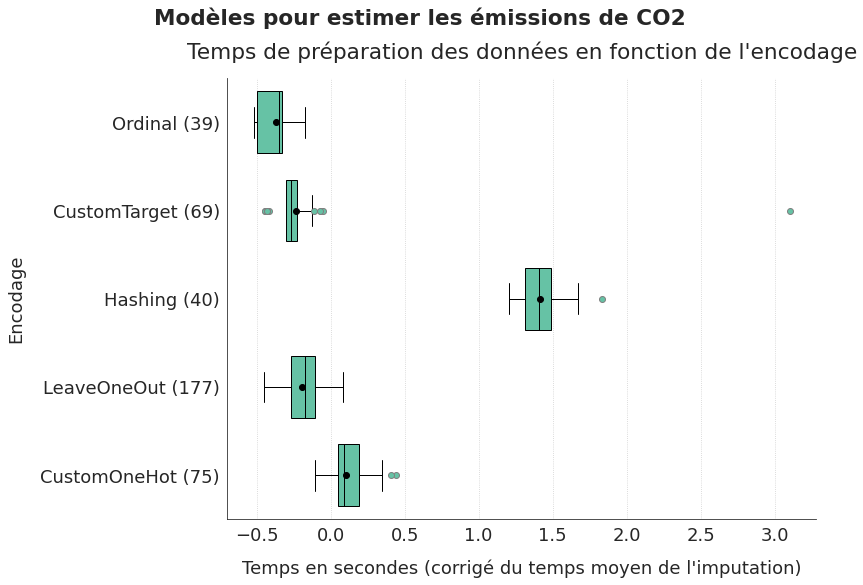

In [ ]:
fig, ax = graph_encoder_preparetime(first_emissions_grouped, "les émissions de CO2", corrected=True)
save_fig("ml03_2_36_co2")
plt.show()

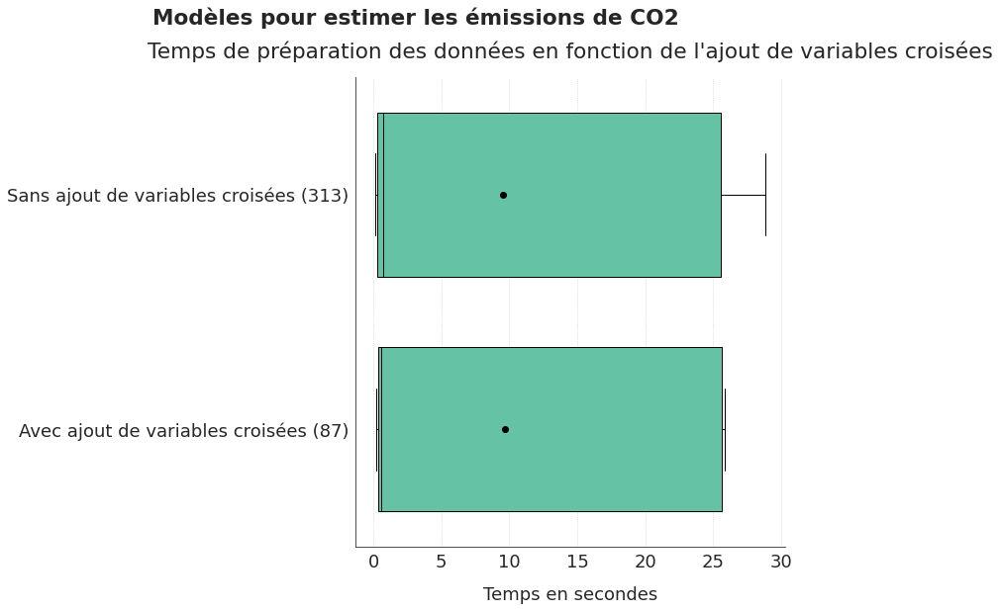

In [ ]:
fig, ax = graph_addcross_preparetime(first_emissions_grouped, "les émissions de CO2")
plt.show()

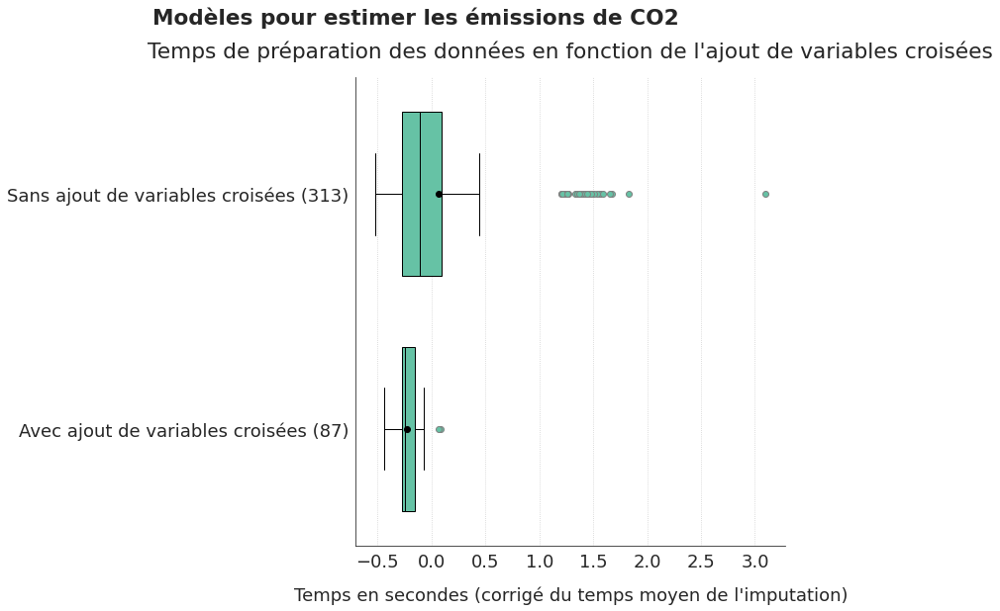

In [ ]:
fig, ax = graph_addcross_preparetime(first_emissions_grouped, "les émissions de CO2", corrected=True)
plt.show()

**A retenir**

Les conclusions sont très similaires à celles issues des modèles d'estimation de la consommation énergétique, à ceci près que les scores obtenus pour l'estimation des émissions sont sensiblement plus bas.  
Il pourrait être opportun d'estimer d'abord la consommation, puis d'intégrer cette estimation dans le modèle d'estimation des émissions (étant donné que les émissions dépendent de la consommation). Ce sera à étudier si les scores restent similaires dans nos analyses futures.

Tout comme pour la consommation, j'abandonne l'imputation par MissForest, je ne garde l'encodage que par One Hot personnalisé et LeaveOneOut, et je ne retiens pas les estimateurs kNN, AdaBoost et Lasso.

Je sauvegarde le résumé de ces premières analyses.

In [ ]:
first_emissions_best_results.to_csv("emissions_first_summary.csv")
first_emissions_grouped.to_csv("emissions_grouped_first_summary.csv")

<a id='5_3'></a>

### 5.3. Deuxième optimisation : sélection des deux modèles les plus prometteurs

Je recentre ma recherche autour des réglages les plus rapides et prometteurs :  
- imputation : j'enlève MissForest pour la rapidité ;  
- encodage : je ne conserve que LeaveOneOut et le OneHotEncoder personnalisé ;  
- ajout ou non des variables croisées en cas de LeaveOneOut (cette option n'est pas compatible avec le OneHotEncoder personnalisé).
- ACP : pas d'ACP, ou ACP avec 90%, 95% ou 99% de l'inertie.

Je rajoute une première couche d'optimisation sur les 6 modèles retenus afin de mieux cerner leur potentiel de performance.  
Je me contente d'optimiser un ou deux hyperparamètres pour avoir une idée plus précise de la performance et de pouvoir les comparer de manière plus précise :  
- SVM : C et kernel ;  
- ExtraTrees et RandomForest : min_samples_split et min_samples_leaf pour contenir la sur-optimisation ;  
- XGBoost : n_estimators et learning_rate ;
- Ridge : alpha ;
- LinearRegression : pas de paramètre - forcer ACP.

In [ ]:
list_best_results = []

In [ ]:
# space spécifique pour linear reg : forcer ACP
space = {
    'data_imputers': hp.choice('data_imputers', [imputer_knn,
        PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_mean), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1),
        PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_median), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1),
        PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_iterative), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1)]),
    'data_case': hp.choice('data_case', [
        {'encoders': encoder_leaveoneout,
         'add_cross': hp.choice('add_cross1', [True,False]),
         'keep_all': hp.choice('keep_all1', [True,False]),
         'list_name': None,
         'restrict_cols': None
        },
        {'encoders': encoder_perso_onehot,
         'add_cross': False,
         'keep_all': False,
         'list_name': transfo_col,
         'restrict_cols': 'transfo_num'
        }]),
    'pca': hp.choice('pca', [PCA(n_components=0.90), PCA(n_components=0.95), PCA(n_components=0.99)])}

In [ ]:
#scope.define(LinearRegression)
estimator_name = 'linear_reg'
estimator_object = scope.LinearRegression()
run_optimization(estimator_name, estimator_object, max_evals=25, prefix_name='second', reg_target='emissions')

100%|██████████| 25/25 [00:14<00:00,  1.69it/s, best loss: -0.5332990686675018]
Estimateur : linear_reg - Done
Best cross-validation mean score = 0.5332990686675018
Associated standard deviation = 0.05416804480263606
Calculation time = 0.0018954277038574219
Data preparation time = 0.24490005699772155
Best cv score obtained after 17 iterations



In [ ]:
space = {
    'data_imputers': hp.choice('data_imputers', [imputer_knn,
        PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_mean), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1),
        PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_median), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1),
        PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_iterative), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1)]),
    'data_case': hp.choice('data_case', [
        {'encoders': encoder_leaveoneout,
         'add_cross': hp.choice('add_cross1', [True,False]),
         'keep_all': hp.choice('keep_all1', [True,False]),
         'list_name': None,
         'restrict_cols': None
        },
        {'encoders': encoder_perso_onehot,
         'add_cross': False,
         'keep_all': False,
         'list_name': transfo_col,
         'restrict_cols': 'transfo_num'
        }]),
    'pca': hp.choice('pca', [None, PCA(n_components=0.90), PCA(n_components=0.95), PCA(n_components=0.99)])}

In [ ]:
#scope.define(Ridge)
estimator_name = 'ridge_reg'
estimator_object = scope.Ridge(random_state=42,
                              alpha = hp.uniform('alpha', 0.2, 1.8))
run_optimization(estimator_name, estimator_object, max_evals=100, prefix_name='second', reg_target='emissions')

100%|██████████| 100/100 [00:51<00:00,  1.95it/s, best loss: -0.542156843458677]
Estimateur : ridge_reg - Done
Best cross-validation mean score = 0.542156843458677
Associated standard deviation = 0.05344615567238567
Calculation time = 0.0017527103424072265
Data preparation time = 0.26038429999971413
Best cv score obtained after 98 iterations



In [ ]:
#scope.define(ElasticNet)
estimator_name = 'elasticnet_reg'
estimator_object = scope.ElasticNet(random_state=42,
                                    alpha = hp.uniform('alpha', 0.2, 1.8),
                                    l1_ratio = hp.uniform('l1_ratio', 0.0, 1.0))
run_optimization(estimator_name, estimator_object, max_evals=200, prefix_name='second', reg_target='emissions')

100%|██████████| 200/200 [01:57<00:00,  1.71it/s, best loss: -0.5340915860993306]
Estimateur : elasticnet_reg - Done
Best cross-validation mean score = 0.5340915860993306
Associated standard deviation = 0.051893312163768926
Calculation time = 0.001930570602416992
Data preparation time = 0.35714982300123665
Best cv score obtained after 68 iterations



In [ ]:
#scope.define(SVR)
estimator_name = 'svm_reg'
estimator_object = scope.SVR(kernel = hp.choice('kernel', ['linear', 'poly', 'rbf', 'sigmoid']),
                            C = hp.loguniform('C', np.log(0.001), np.log(100)))
run_optimization(estimator_name, estimator_object, max_evals=200, prefix_name='second', reg_target='emissions')

100%|██████████| 200/200 [06:35<00:00,  1.98s/it, best loss: -0.5305238615276794]
Estimateur : svm_reg - Done
Best cross-validation mean score = 0.5305238615276794
Associated standard deviation = 0.05266296540338393
Calculation time = 0.011557674407958985
Data preparation time = 0.22609145599926705
Best cv score obtained after 157 iterations



In [ ]:
#scope.define(RandomForestRegressor)
estimator_name = 'randomforest_reg'
estimator_object = scope.RandomForestRegressor(n_jobs=-1, random_state=42,
                                               min_samples_split = hp.choice('min_samples_split', np.arange(2, 21, 2, dtype=int)),
                                               min_samples_leaf = hp.choice('min_samples_leaf', np.arange(1, 11, 1, dtype=int)))
run_optimization(estimator_name, estimator_object, max_evals=200, prefix_name='second', reg_target='emissions')

100%|██████████| 200/200 [14:30<00:00,  4.35s/it, best loss: -0.5438486883398005]
Estimateur : randomforest_reg - Done
Best cross-validation mean score = 0.5438486883398005
Associated standard deviation = 0.0464120020115272
Calculation time = 0.10343899726867675
Data preparation time = 0.22175512399917352
Best cv score obtained after 154 iterations



In [ ]:
#scope.define(ExtraTreesRegressor)
estimator_name = 'extratrees_reg'
estimator_object = scope.ExtraTreesRegressor(n_jobs=-1, random_state=42,
                                             min_samples_split = hp.choice('min_samples_split', np.arange(2, 21, 2, dtype=int)),
                                             min_samples_leaf = hp.choice('min_samples_leaf', np.arange(1, 11, 1, dtype=int)))
run_optimization(estimator_name, estimator_object, max_evals=200, prefix_name='second', reg_target='emissions')

100%|██████████| 200/200 [08:13<00:00,  2.47s/it, best loss: -0.5549375343146032]
Estimateur : extratrees_reg - Done
Best cross-validation mean score = 0.5549375343146032
Associated standard deviation = 0.04225959777509519
Calculation time = 0.103877592086792
Data preparation time = 0.2560215880002943
Best cv score obtained after 111 iterations



In [ ]:
#scope.define(XGBRegressor)
estimator_name = 'xgboost_reg'
estimator_object = scope.XGBRegressor(objective='reg:squarederror', n_jobs=-1, random_state=42,
                                      n_estimators = hp.choice('n_estimators', np.arange(25, 501, 25, dtype=int)),
                                      learning_rate = hp.loguniform('learning_rate', np.log(0.001), np.log(1)))
run_optimization(estimator_name, estimator_object, max_evals=200, prefix_name='second', reg_target='emissions')

100%|██████████| 200/200 [07:58<00:00,  2.39s/it, best loss: -0.5523565582008719]
Estimateur : xgboost_reg - Done
Best cross-validation mean score = 0.5523565582008719
Associated standard deviation = 0.056437777494850724
Calculation time = 0.004648876190185547
Data preparation time = 0.258967361998657
Best cv score obtained after 157 iterations



In [ ]:
second_emissions_best_results = pd.DataFrame(list_best_results)

In [ ]:
second_emissions_best_results = get_details(second_emissions_best_results)
second_emissions_best_results.sort_values("loss", inplace=True)
second_emissions_best_results

,loss,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,params_data,params_reg,data_transfo_time,iteration,status,estimator,pca,imputer,strategy,encoder,add_cross,keep_all
5,-0.554938,0.042260,0.103878,0.882953,0.003566,0.524156,{'data_imputers': PandasColumnTransformer(list...,{'estimator': ExtraTreesRegressor(bootstrap=Fa...,0.256022,111,ok,ExtraTreesRegressor,Non,SimpleImputer,'mean',LeaveOneOutEncoder,True,True
6,-0.552357,0.056438,0.004649,0.722289,0.008583,0.349365,{'data_imputers': PandasColumnTransformer(list...,"{'estimator': XGBRegressor(base_score=0.5, boo...",0.258967,157,ok,XGBRegressor,Non,SimpleImputer,'mean',LeaveOneOutEncoder,True,True
4,-0.543849,0.046412,0.103439,0.863021,0.005002,1.069213,{'data_imputers': PandasColumnTransformer(list...,{'estimator': RandomForestRegressor(bootstrap=...,0.221755,154,ok,RandomForestRegressor,Non,SimpleImputer,'mean',LeaveOneOutEncoder,False,False
1,-0.542157,0.053446,0.001753,0.557462,0.014476,0.004360,{'data_imputers': PandasColumnTransformer(list...,"{'estimator': Ridge(alpha=0.5632866786440176, ...",0.260384,98,ok,Ridge,Non,SimpleImputer,'mean',LeaveOneOutEncoder,True,True
2,-0.534092,0.051893,0.001931,0.545146,0.015147,0.009035,{'data_imputers': AllImputation(categ_cols=['B...,{'estimator': ElasticNet(alpha=0.2007654278372...,0.357150,68,ok,ElasticNet,PCA,KNNImputer,,LeaveOneOutEncoder,True,True
0,-0.533299,0.054168,0.001895,0.547235,0.014661,0.007826,{'data_imputers': PandasColumnTransformer(list...,"{'estimator': LinearRegression(copy_X=True, fi...",0.244900,17,ok,LinearRegression,PCA,SimpleImputer,'mean',LeaveOneOutEncoder,False,True
3,-0.530524,0.052663,0.011558,0.542369,0.016283,0.125803,{'data_imputers': PandasColumnTransformer(list...,"{'estimator': SVR(C=0.028016140249015463, cach...",0.226091,157,ok,SVR,Non,SimpleImputer,'mean',LeaveOneOutEncoder,False,False


In [ ]:
second_emissions_best_results[["estimator","loss","train_score_mean","imputer","strategy","encoder","pca","add_cross","keep_all"]]

,estimator,loss,train_score_mean,imputer,strategy,encoder,pca,add_cross,keep_all
5,ExtraTreesRegressor,-0.554938,0.882953,SimpleImputer,'mean',LeaveOneOutEncoder,Non,True,True
6,XGBRegressor,-0.552357,0.722289,SimpleImputer,'mean',LeaveOneOutEncoder,Non,True,True
4,RandomForestRegressor,-0.543849,0.863021,SimpleImputer,'mean',LeaveOneOutEncoder,Non,False,False
1,Ridge,-0.542157,0.557462,SimpleImputer,'mean',LeaveOneOutEncoder,Non,True,True
2,ElasticNet,-0.534092,0.545146,KNNImputer,,LeaveOneOutEncoder,PCA,True,True
0,LinearRegression,-0.533299,0.547235,SimpleImputer,'mean',LeaveOneOutEncoder,PCA,False,True
3,SVR,-0.530524,0.542369,SimpleImputer,'mean',LeaveOneOutEncoder,Non,False,False


<a id='5_4'></a>

### 5.4. Etude des résultats de la deuxième optimisation, modèle par modèle

**Extra trees**

In [ ]:
ext_second_emissions = gen_df_analyse('hyperopt_second_emissions_extratrees_reg.csv')
ext_second_emissions = calculate_corrected_score(ext_second_emissions)
ext_second_emissions[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
110,0.554938,0.882953,SimpleImputer,'mean',LeaveOneOut,True,None
146,0.554938,0.882953,SimpleImputer,'mean',LeaveOneOut,True,None
147,0.554938,0.882953,SimpleImputer,'mean',LeaveOneOut,True,None
151,0.554938,0.882953,SimpleImputer,'mean',LeaveOneOut,True,None
103,0.554938,0.882953,SimpleImputer,'mean',LeaveOneOut,True,None


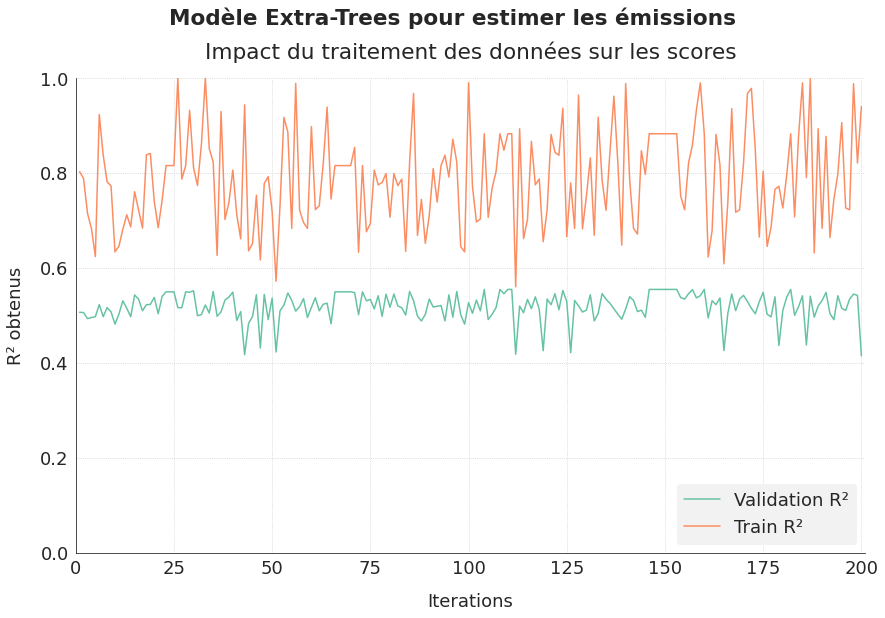

In [ ]:
fig, ax = graph_analyse_score(ext_second_emissions, "Extra-Trees", "les émissions", nb_iterations=200)
plt.show()

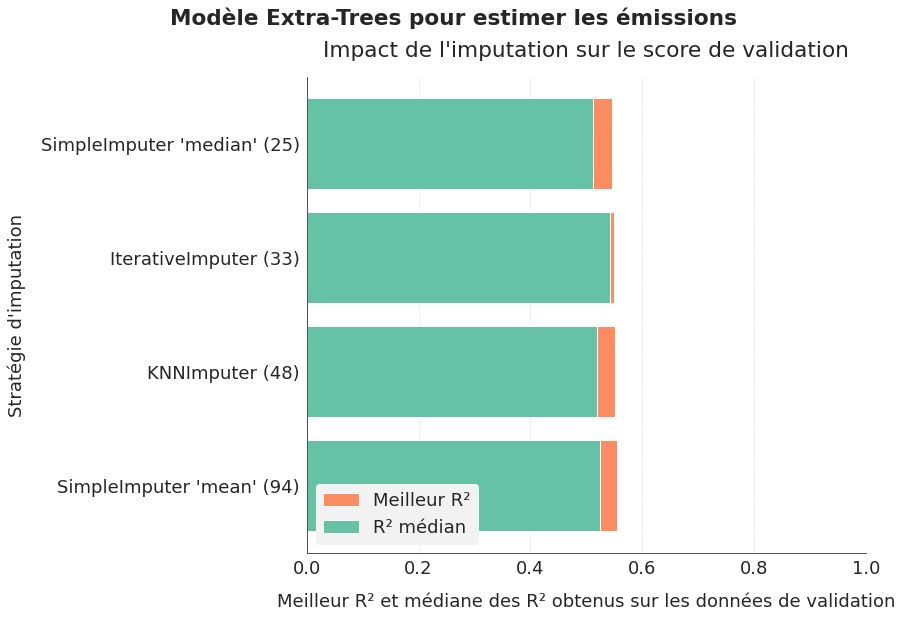

In [ ]:
fig, ax = graph_analyse_imputers(ext_second_emissions, "Extra-Trees", "les émissions")
plt.show()

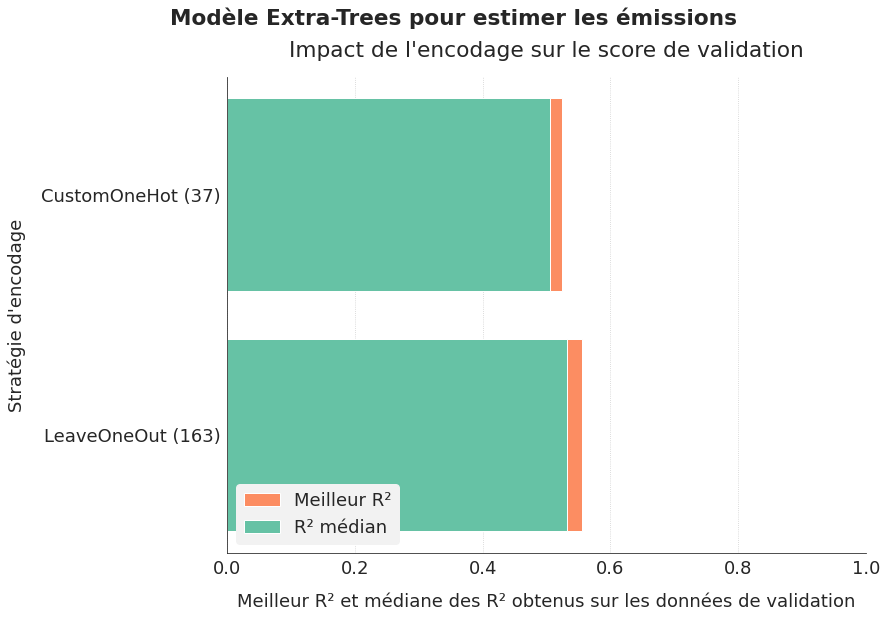

In [ ]:
fig, ax = graph_analyse_encoders(ext_second_emissions, "Extra-Trees", "les émissions")
plt.show()

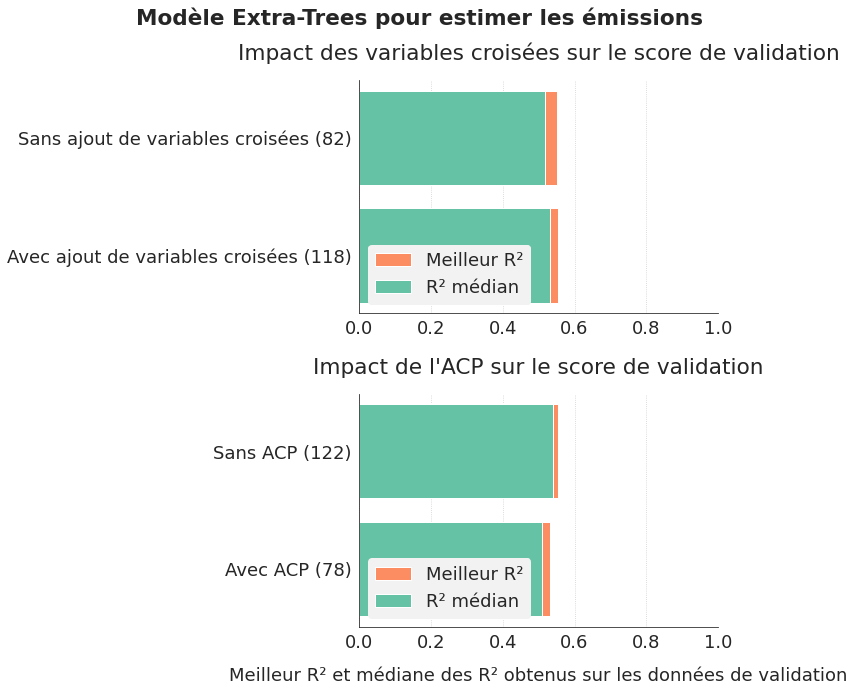

In [ ]:
fig, ax = graph_analyse_others(ext_second_emissions, "Extra-Trees", "les émissions")
plt.show()

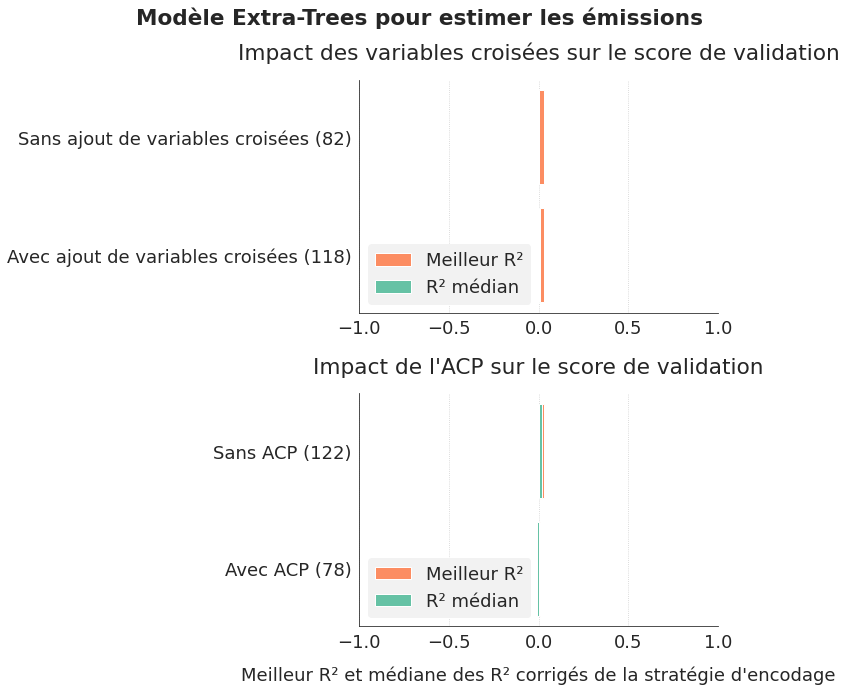

In [ ]:
fig, ax = graph_analyse_others(ext_second_emissions, "Extra-Trees", "les émissions", corrected=True)
plt.show()

**XGBoost**

In [ ]:
xgb_second_emissions = gen_df_analyse('hyperopt_second_emissions_xgboost_reg.csv')
xgb_second_emissions = calculate_corrected_score(xgb_second_emissions)
xgb_second_emissions[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
156,0.552357,0.722289,SimpleImputer,'mean',LeaveOneOut,True,None
197,0.551729,0.703381,SimpleImputer,'mean',LeaveOneOut,True,None
153,0.551289,0.712971,SimpleImputer,'mean',LeaveOneOut,True,None
150,0.551035,0.743817,SimpleImputer,'mean',LeaveOneOut,True,None
157,0.550759,0.713691,SimpleImputer,'mean',LeaveOneOut,True,None


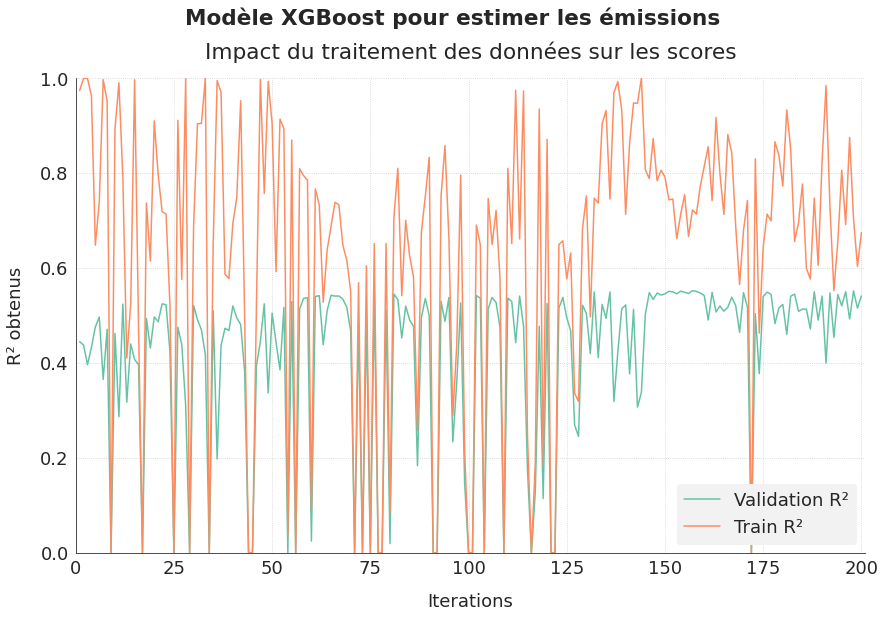

In [ ]:
fig, ax = graph_analyse_score(xgb_second_emissions, "XGBoost", "les émissions", nb_iterations=200)
plt.show()

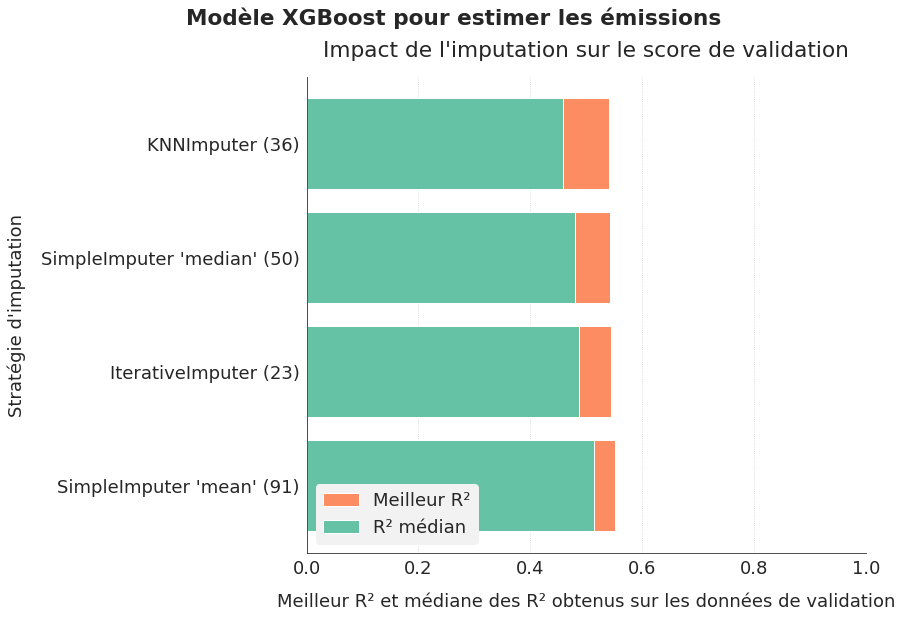

In [ ]:
fig, ax = graph_analyse_imputers(xgb_second_emissions, "XGBoost", "les émissions")
plt.show()

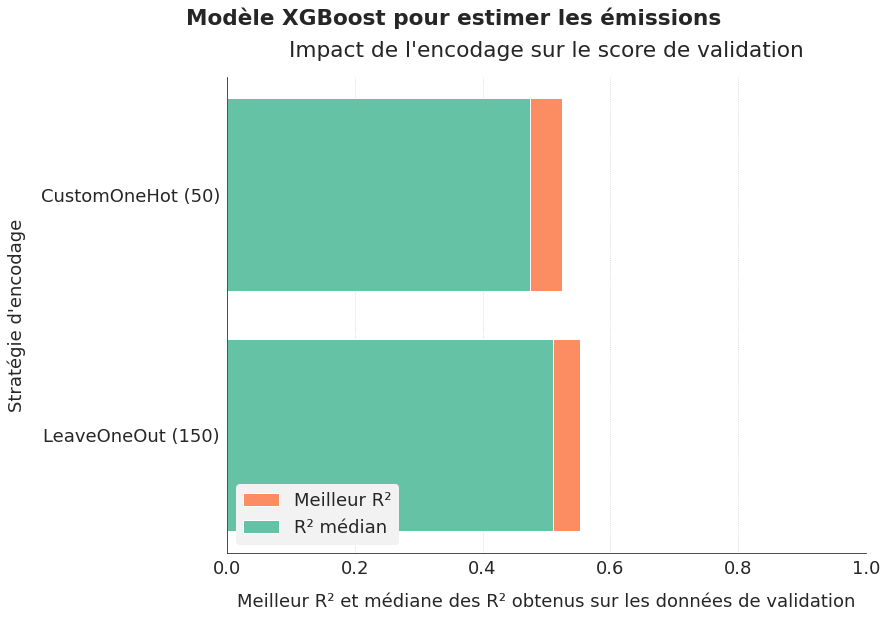

In [ ]:
fig, ax = graph_analyse_encoders(xgb_second_emissions, "XGBoost", "les émissions")
plt.show()

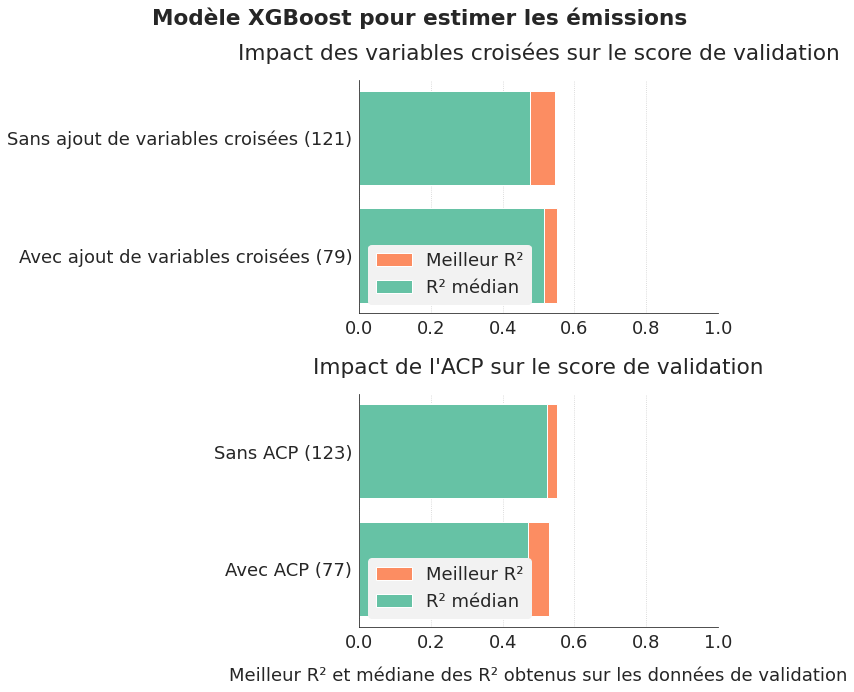

In [ ]:
fig, ax = graph_analyse_others(xgb_second_emissions, "XGBoost", "les émissions")
plt.show()

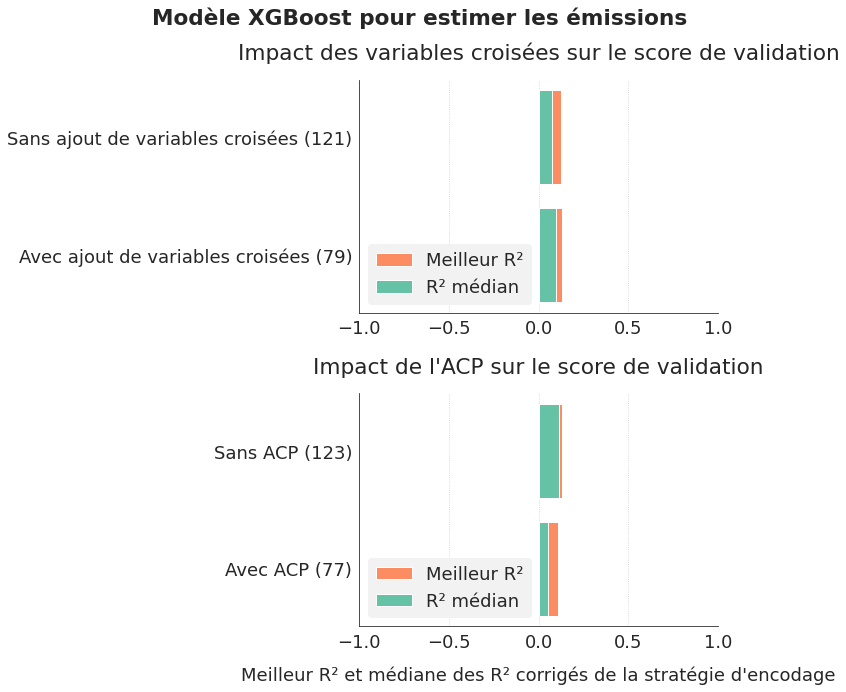

In [ ]:
fig, ax = graph_analyse_others(xgb_second_emissions, "XGBoost", "les émissions", corrected=True)
plt.show()

**Random Forest**

In [ ]:
rf_second_emissions = gen_df_analyse('hyperopt_second_emissions_randomforest_reg.csv')
rf_second_emissions = calculate_corrected_score(rf_second_emissions)
rf_second_emissions[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
153,0.543849,0.863021,SimpleImputer,'mean',LeaveOneOut,False,None
159,0.543849,0.863021,SimpleImputer,'mean',LeaveOneOut,False,None
54,0.543849,0.863021,SimpleImputer,'mean',LeaveOneOut,False,None
133,0.543849,0.863021,SimpleImputer,'mean',LeaveOneOut,False,None
145,0.543849,0.863021,SimpleImputer,'mean',LeaveOneOut,False,None


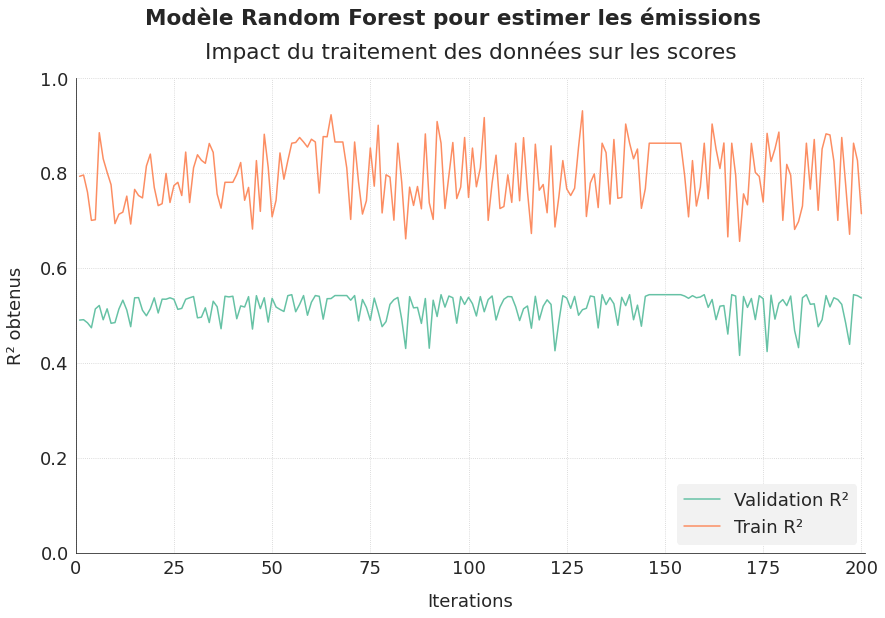

In [ ]:
fig, ax = graph_analyse_score(rf_second_emissions, "Random Forest", "les émissions", nb_iterations=200)
plt.show()

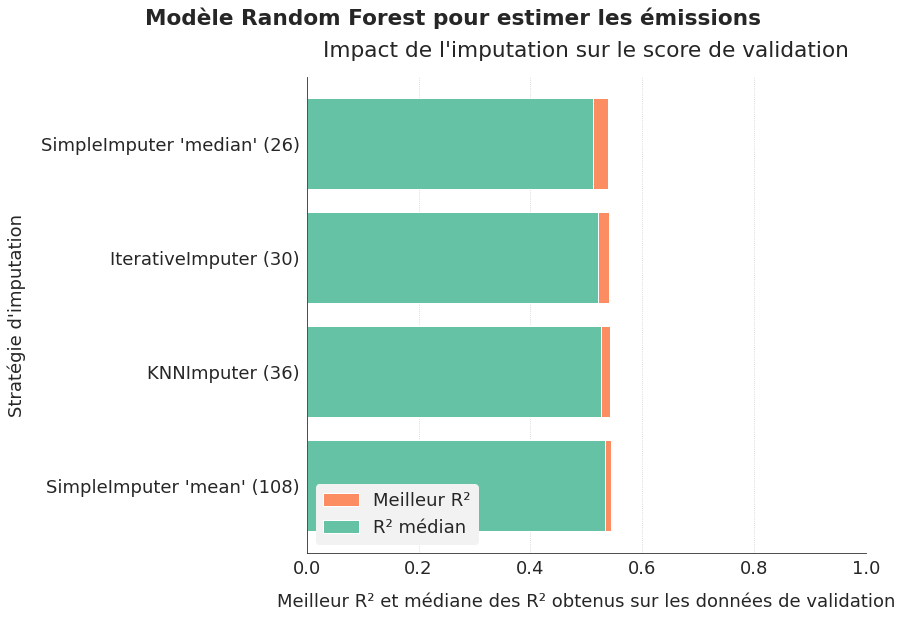

In [ ]:
fig, ax = graph_analyse_imputers(rf_second_emissions, "Random Forest", "les émissions")
plt.show()

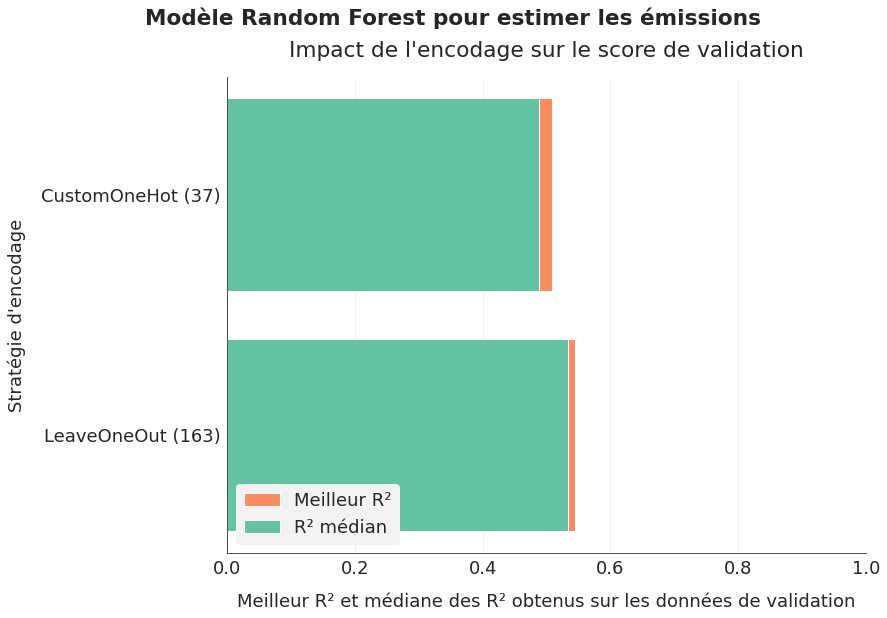

In [ ]:
fig, ax = graph_analyse_encoders(rf_second_emissions, "Random Forest", "les émissions")
plt.show()

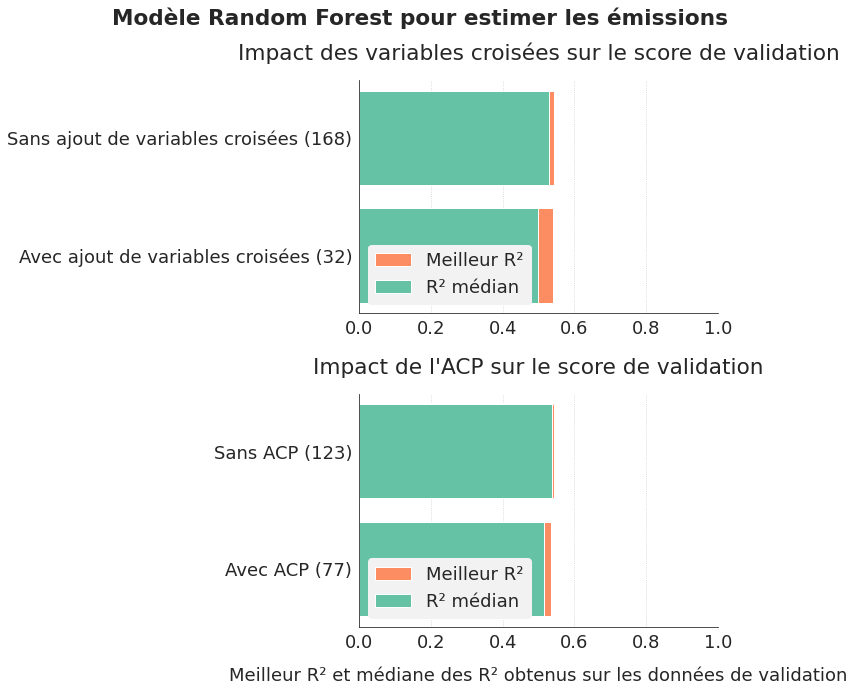

In [ ]:
fig, ax = graph_analyse_others(rf_second_emissions, "Random Forest", "les émissions")
plt.show()

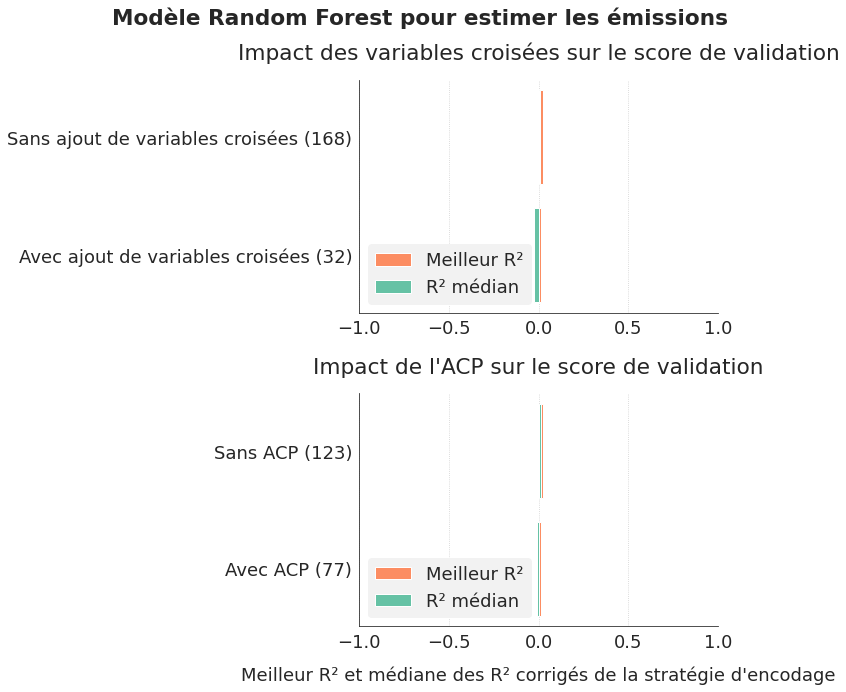

In [ ]:
fig, ax = graph_analyse_others(rf_second_emissions, "Random Forest", "les émissions", corrected=True)
plt.show()

**Ridge**

In [ ]:
ridge_second_emissions = gen_df_analyse('hyperopt_second_emissions_ridge_reg.csv')
ridge_second_emissions = calculate_corrected_score(ridge_second_emissions)
ridge_second_emissions[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
97,0.542157,0.557462,SimpleImputer,'mean',LeaveOneOut,True,None
95,0.541988,0.557183,SimpleImputer,'mean',LeaveOneOut,True,None
90,0.541770,0.556816,SimpleImputer,'mean',LeaveOneOut,True,None
82,0.541732,0.556751,SimpleImputer,'mean',LeaveOneOut,True,None
75,0.541726,0.556740,SimpleImputer,'mean',LeaveOneOut,True,None


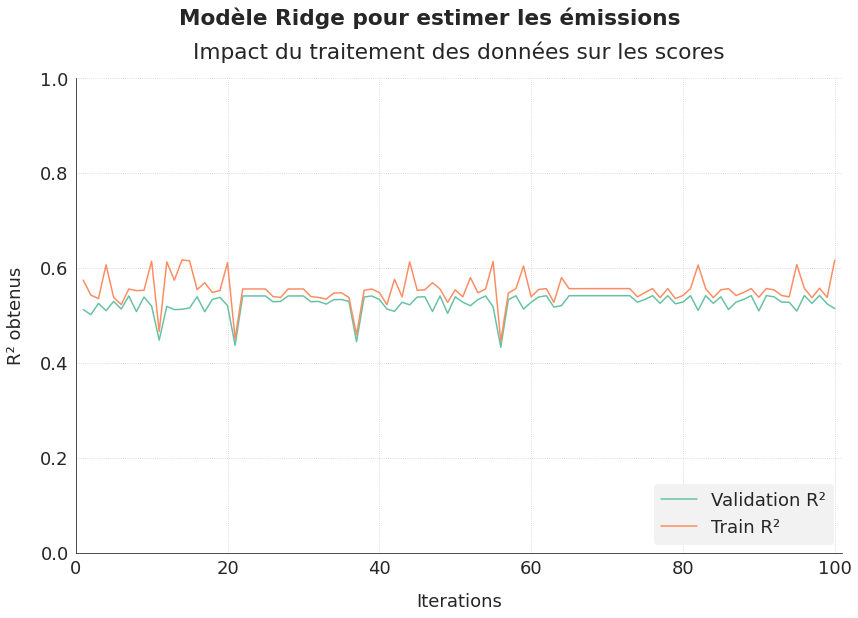

In [ ]:
fig, ax = graph_analyse_score(ridge_second_emissions, "Ridge", "les émissions", nb_iterations=100)
plt.show()

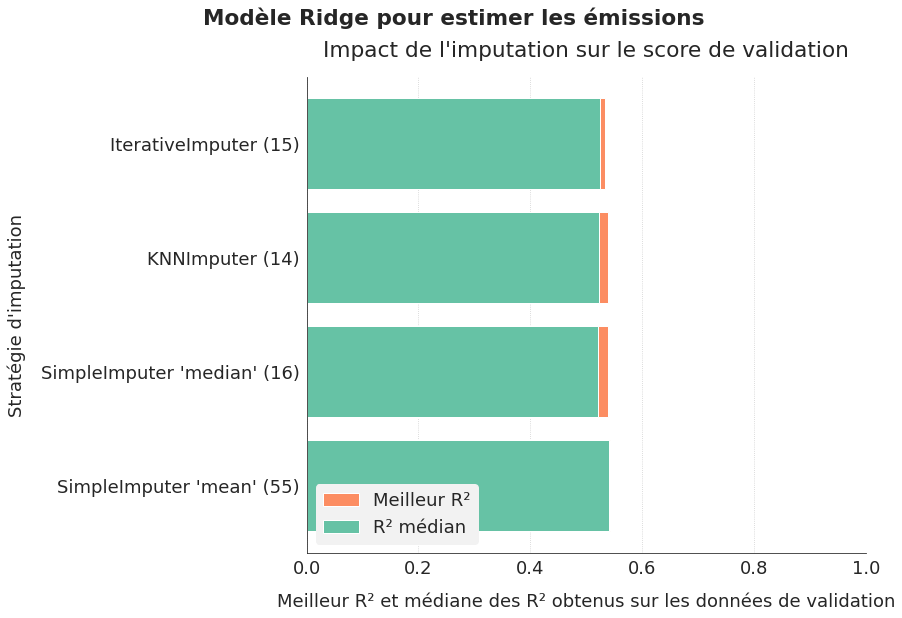

In [ ]:
fig, ax = graph_analyse_imputers(ridge_second_emissions, "Ridge", "les émissions")
plt.show()

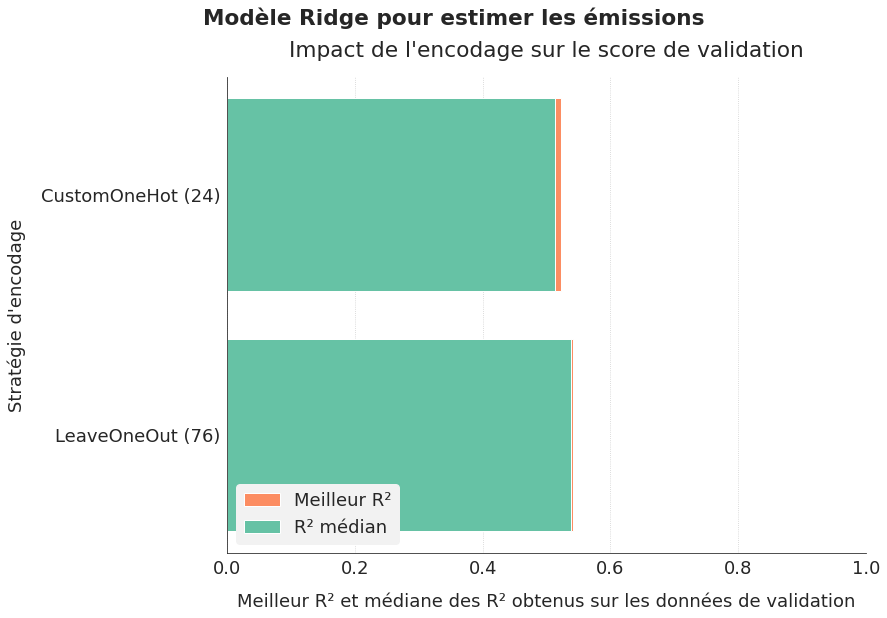

In [ ]:
fig, ax = graph_analyse_encoders(ridge_second_emissions, "Ridge", "les émissions")
plt.show()

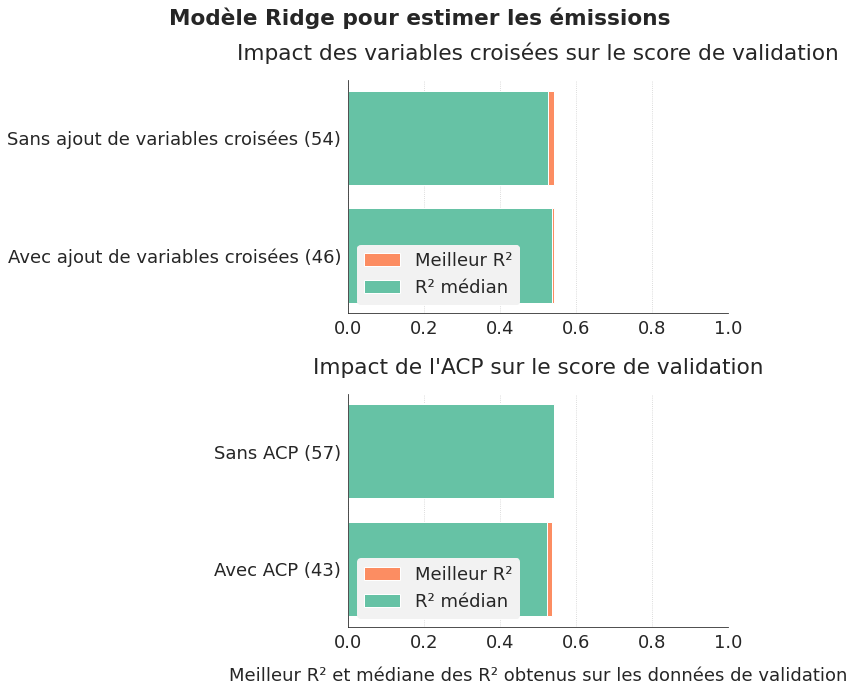

In [ ]:
fig, ax = graph_analyse_others(ridge_second_emissions, "Ridge", "les émissions")
plt.show()

**ElasticNet**

In [ ]:
en_second_emissions = gen_df_analyse('hyperopt_second_emissions_elasticnet_reg.csv')
en_second_emissions = calculate_corrected_score(en_second_emissions)
en_second_emissions[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
67,0.534092,0.545146,KNNImputer,,LeaveOneOut,True,"PCA(copy=True, iterated_power='auto', n_compon..."
158,0.526738,0.535891,IterativeImputer,,LeaveOneOut,True,None
157,0.526084,0.535438,IterativeImputer,,LeaveOneOut,True,"PCA(copy=True, iterated_power='auto', n_compon..."
162,0.524175,0.532524,IterativeImputer,,LeaveOneOut,True,None
112,0.523912,0.531521,KNNImputer,,LeaveOneOut,True,None


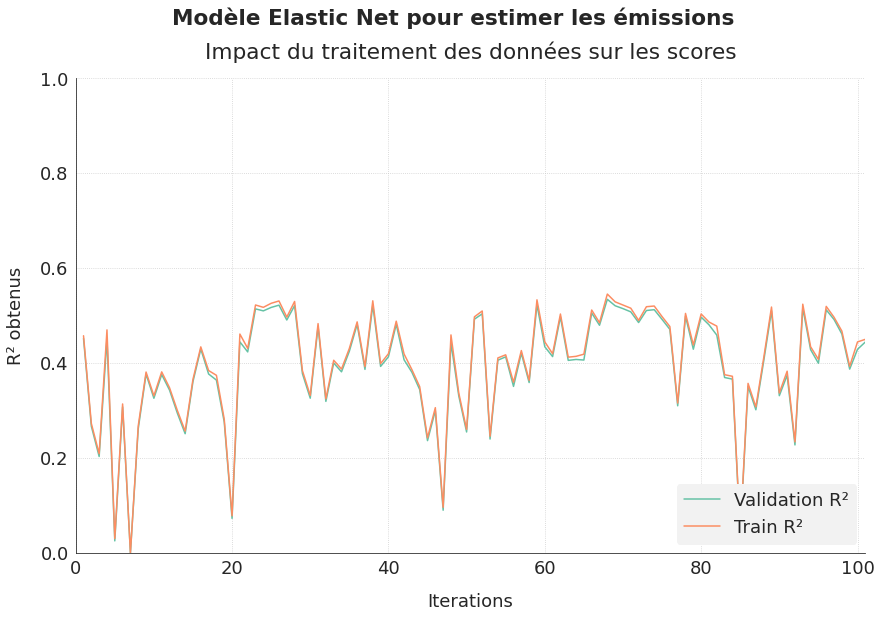

In [ ]:
fig, ax = graph_analyse_score(en_second_emissions, "Elastic Net", "les émissions", nb_iterations=100)
plt.show()

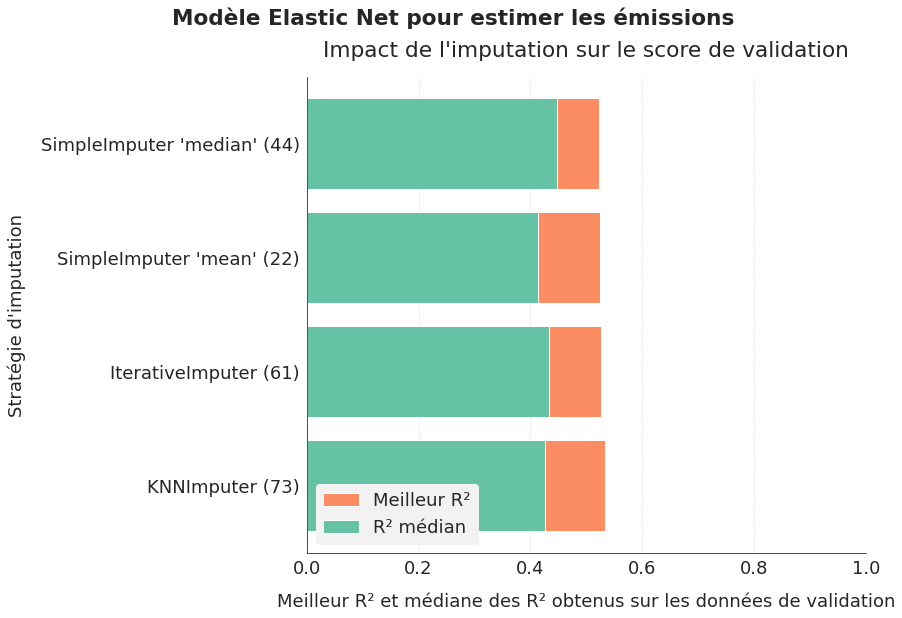

In [ ]:
fig, ax = graph_analyse_imputers(en_second_emissions, "Elastic Net", "les émissions")
plt.show()

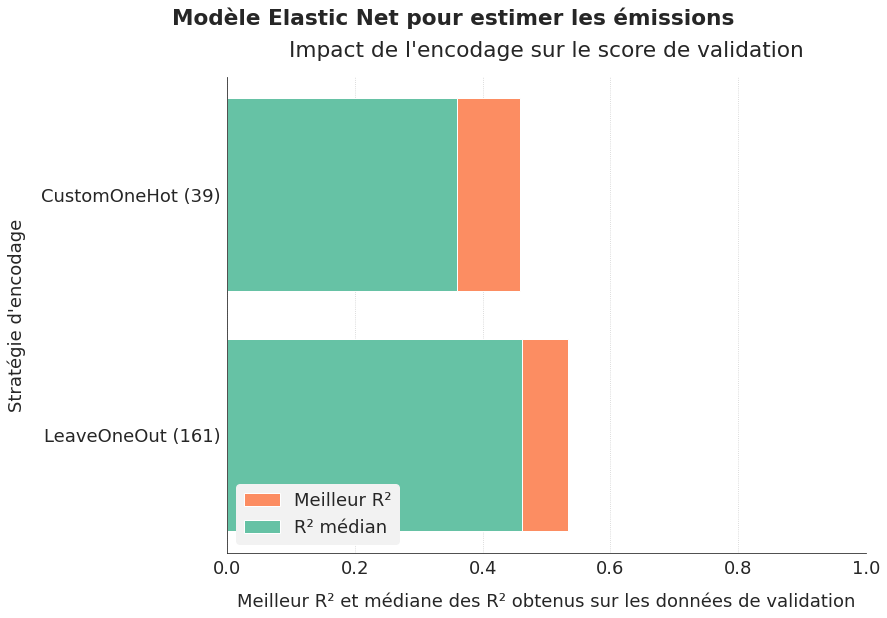

In [ ]:
fig, ax = graph_analyse_encoders(en_second_emissions, "Elastic Net", "les émissions")
plt.show()

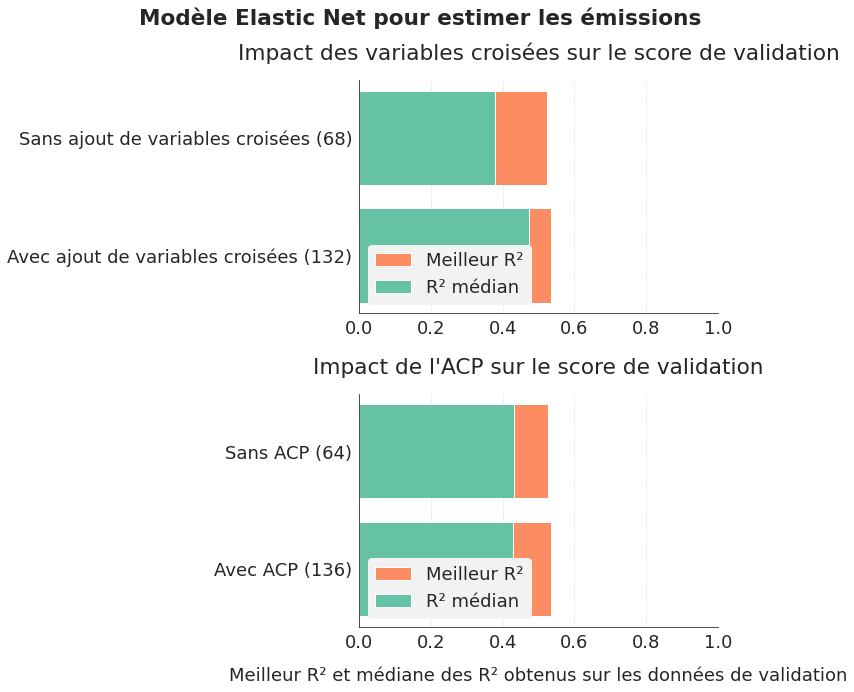

In [ ]:
fig, ax = graph_analyse_others(en_second_emissions, "Elastic Net", "les émissions")
plt.show()

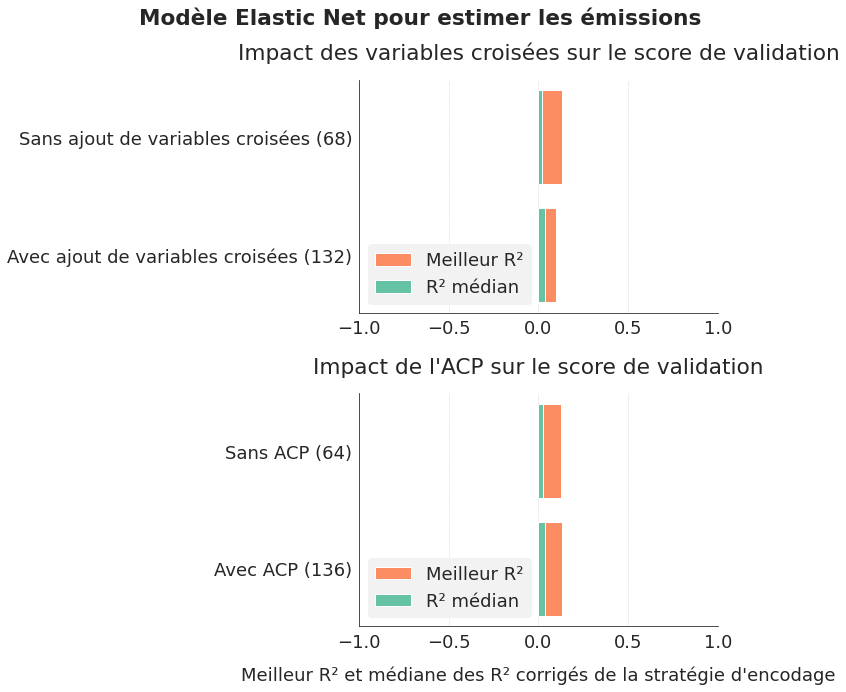

In [ ]:
fig, ax = graph_analyse_others(en_second_emissions, "Elastic Net", "les émissions", corrected=True)
plt.show()

**Linear Regression**

In [ ]:
lr_second_emissions = gen_df_analyse('hyperopt_second_emissions_linear_reg.csv')
lr_second_emissions = calculate_corrected_score(lr_second_emissions)
lr_second_emissions[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
16,0.533299,0.547235,SimpleImputer,'mean',LeaveOneOut,False,"PCA(copy=True, iterated_power='auto', n_compon..."
21,0.533299,0.547235,SimpleImputer,'mean',LeaveOneOut,False,"PCA(copy=True, iterated_power='auto', n_compon..."
22,0.533299,0.547235,SimpleImputer,'mean',LeaveOneOut,False,"PCA(copy=True, iterated_power='auto', n_compon..."
23,0.533299,0.547235,SimpleImputer,'mean',LeaveOneOut,False,"PCA(copy=True, iterated_power='auto', n_compon..."
24,0.533299,0.547235,SimpleImputer,'mean',LeaveOneOut,False,"PCA(copy=True, iterated_power='auto', n_compon..."


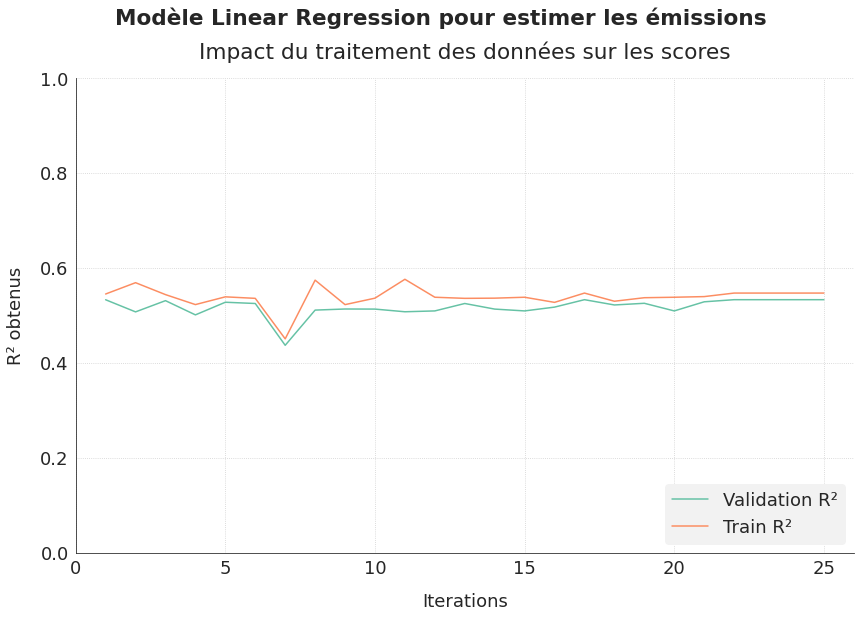

In [ ]:
fig, ax = graph_analyse_score(lr_second_emissions, "Linear Regression", "les émissions", nb_iterations=25)
plt.show()

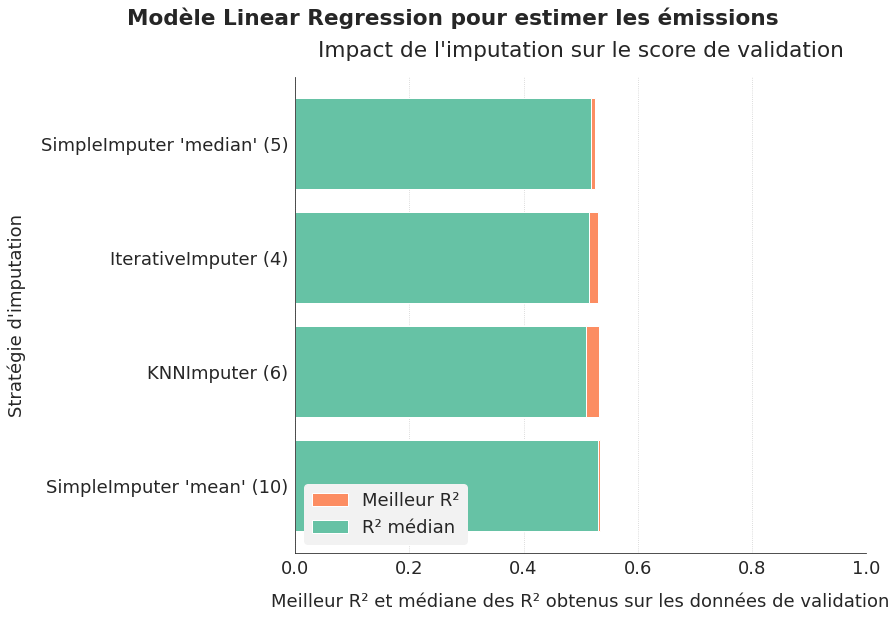

In [ ]:
fig, ax = graph_analyse_imputers(lr_second_emissions, "Linear Regression", "les émissions")
plt.show()

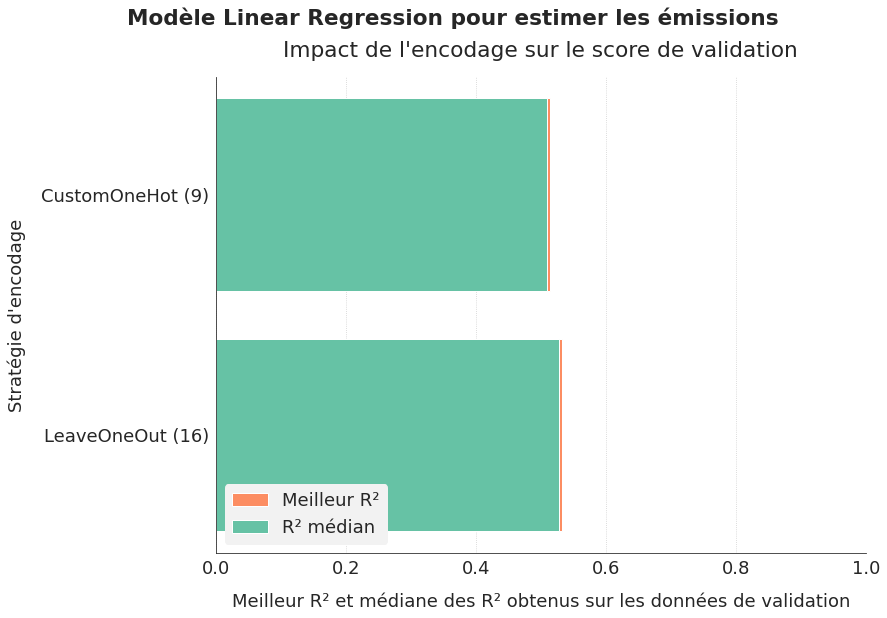

In [ ]:
fig, ax = graph_analyse_encoders(lr_second_emissions, "Linear Regression", "les émissions")
plt.show()

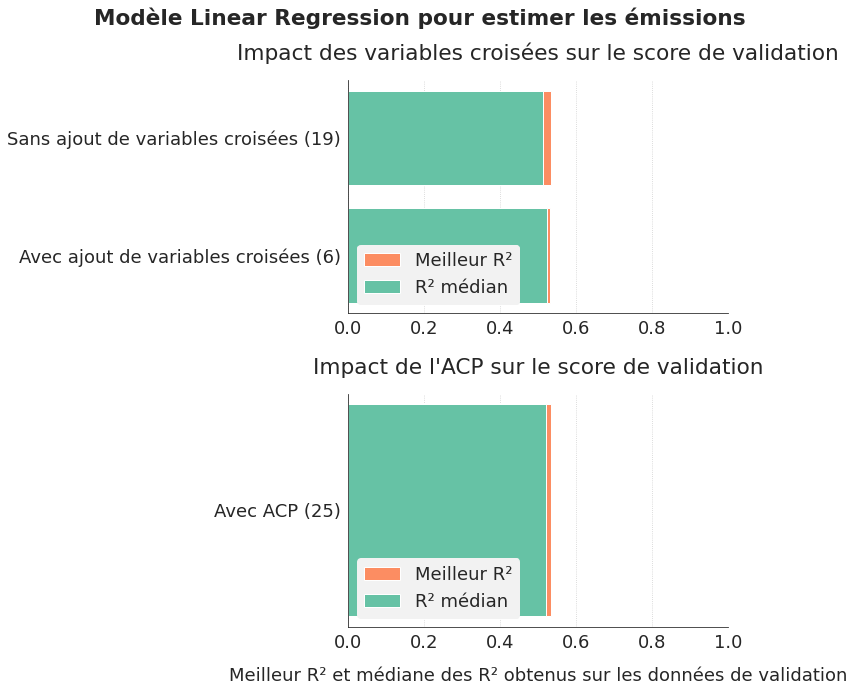

In [ ]:
fig, ax = graph_analyse_others(lr_second_emissions, "Linear Regression", "les émissions")
plt.show()

**SVM**

In [ ]:
svm_second_emissions = gen_df_analyse('hyperopt_second_emissions_svm_reg.csv')
svm_second_emissions = calculate_corrected_score(svm_second_emissions)
svm_second_emissions[["valid_score_mean","train_score_mean","Imputer","Strategy",
               "Encoder","add_cross","pca"]].head()

,valid_score_mean,train_score_mean,Imputer,Strategy,Encoder,add_cross,pca
156,0.530524,0.542369,SimpleImputer,'mean',LeaveOneOut,False,None
150,0.530490,0.542642,SimpleImputer,'mean',LeaveOneOut,False,None
149,0.530490,0.542682,SimpleImputer,'mean',LeaveOneOut,False,None
152,0.530465,0.542665,SimpleImputer,'mean',LeaveOneOut,False,None
123,0.530456,0.542398,SimpleImputer,'mean',LeaveOneOut,False,None


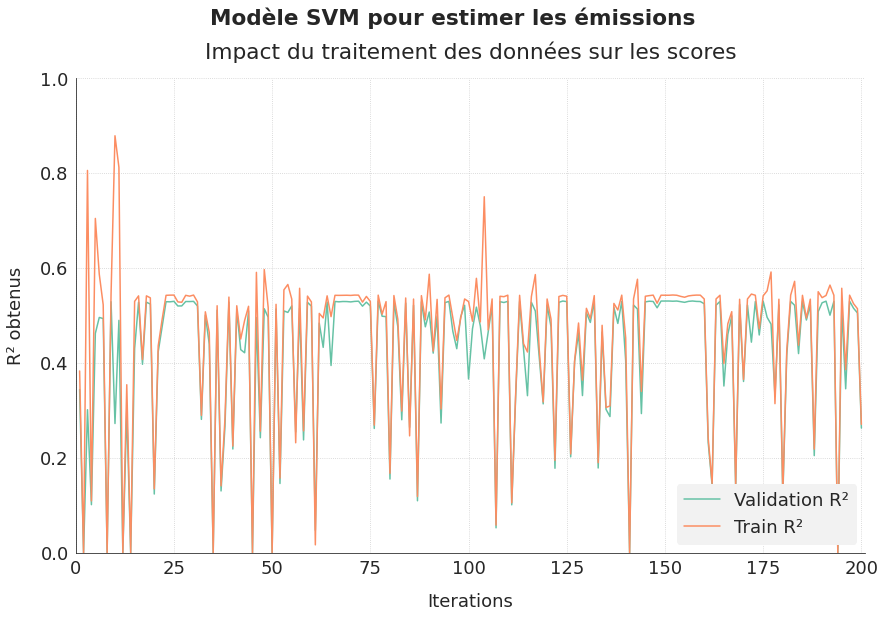

In [ ]:
fig, ax = graph_analyse_score(svm_second_emissions, "SVM", "les émissions", nb_iterations=200)
plt.show()

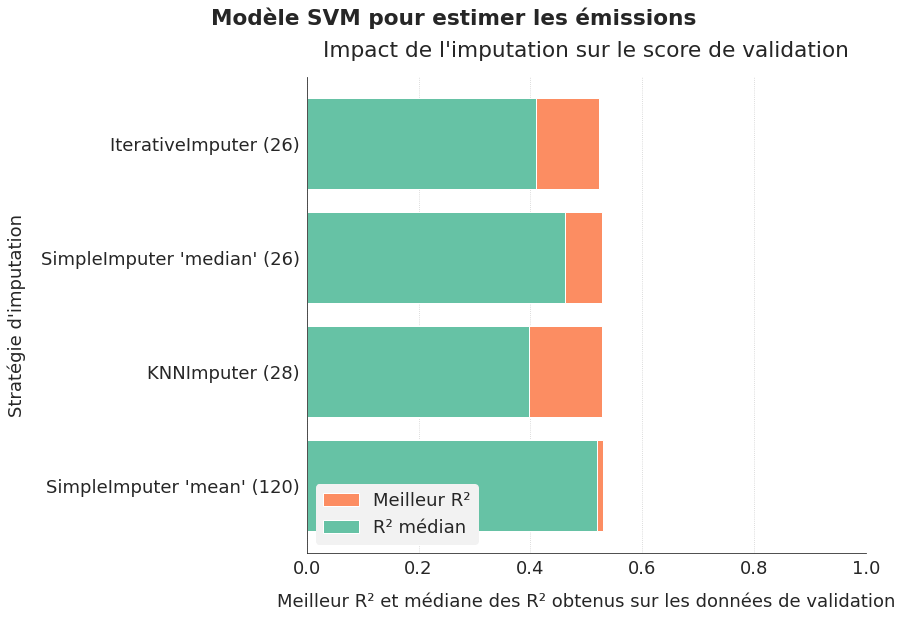

In [ ]:
fig, ax = graph_analyse_imputers(svm_second_emissions, "SVM", "les émissions")
plt.show()

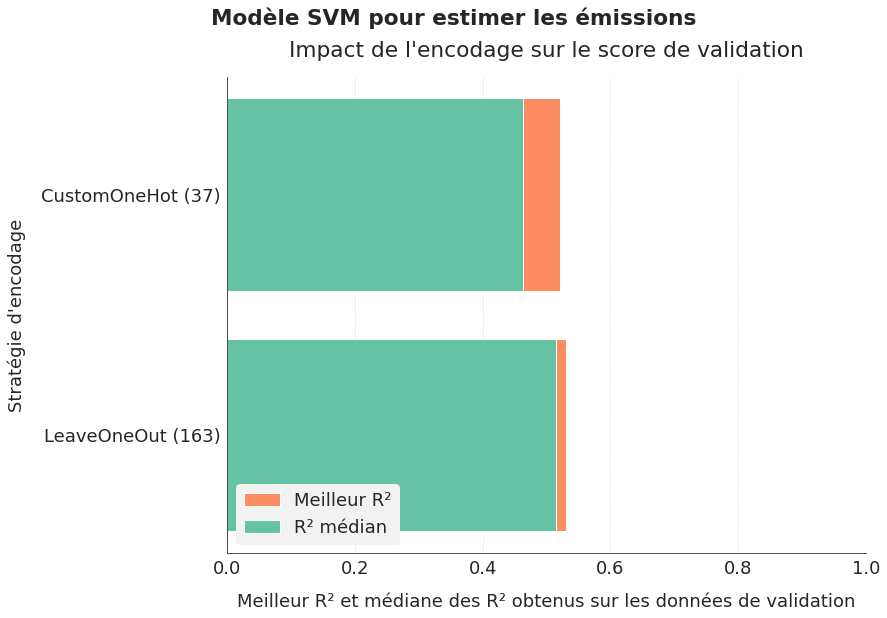

In [ ]:
fig, ax = graph_analyse_encoders(svm_second_emissions, "SVM", "les émissions")
plt.show()

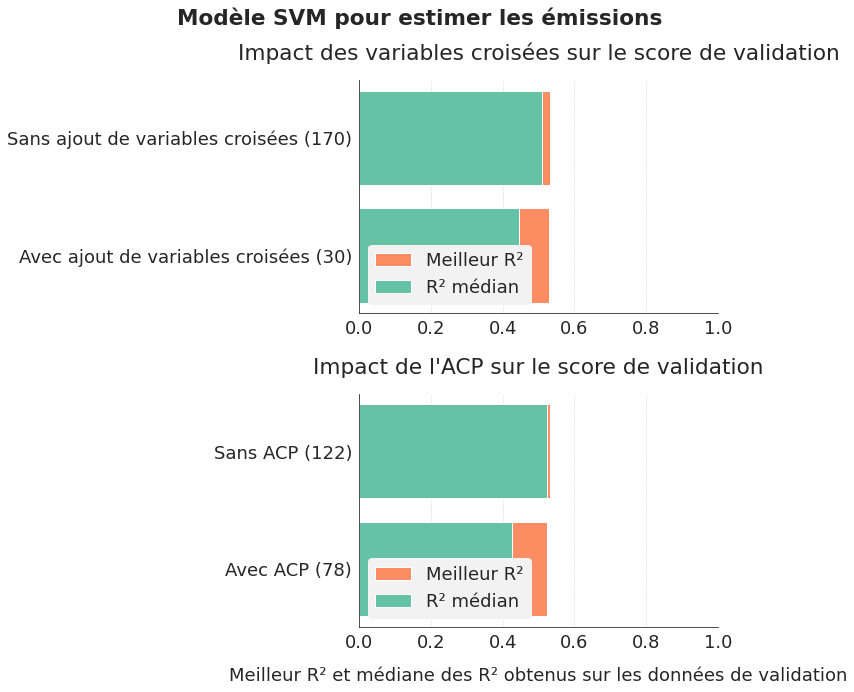

In [ ]:
fig, ax = graph_analyse_others(svm_second_emissions, "SVM", "les émissions")
plt.show()

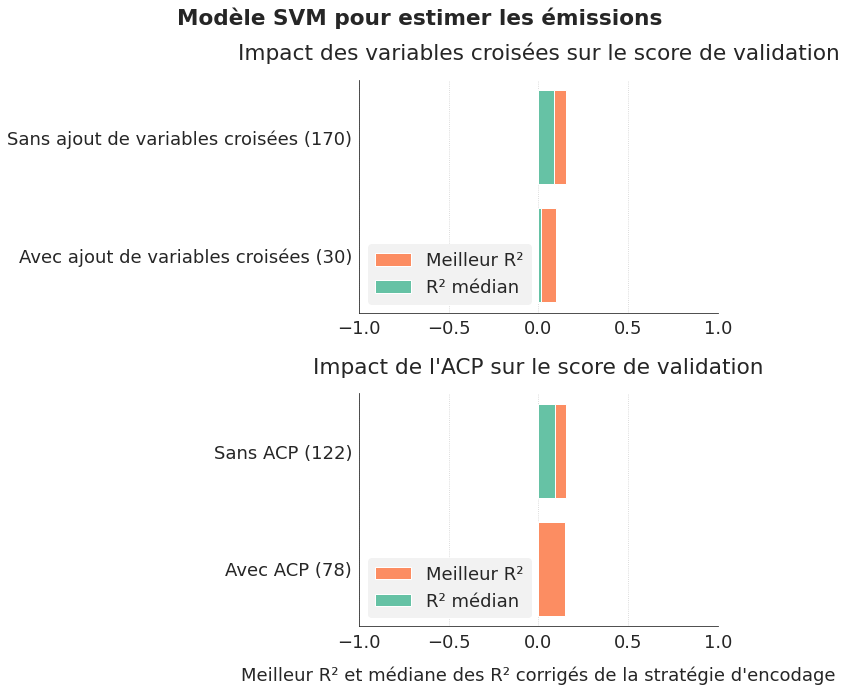

In [ ]:
fig, ax = graph_analyse_others(svm_second_emissions, "SVM", "les émissions", corrected=True)
plt.show()

**Analyse groupée des temps de calcul**

In [ ]:
ext_second_emissions["model"] = "Extra Trees"
xgb_second_emissions["model"] = "XGBoost"
rf_second_emissions["model"] = "Random Forest"
ridge_second_emissions["model"] = "Ridge"
en_second_emissions["model"] = "Elastic Net"
lr_second_emissions["model"] = "Linear Regression"
svm_second_emissions["model"] = "SVM"

In [ ]:
second_emissions_grouped = pd.concat([ext_second_emissions, xgb_second_emissions, rf_second_emissions, ridge_second_emissions,
                                      en_second_emissions, lr_second_emissions, svm_second_emissions], ignore_index=True)

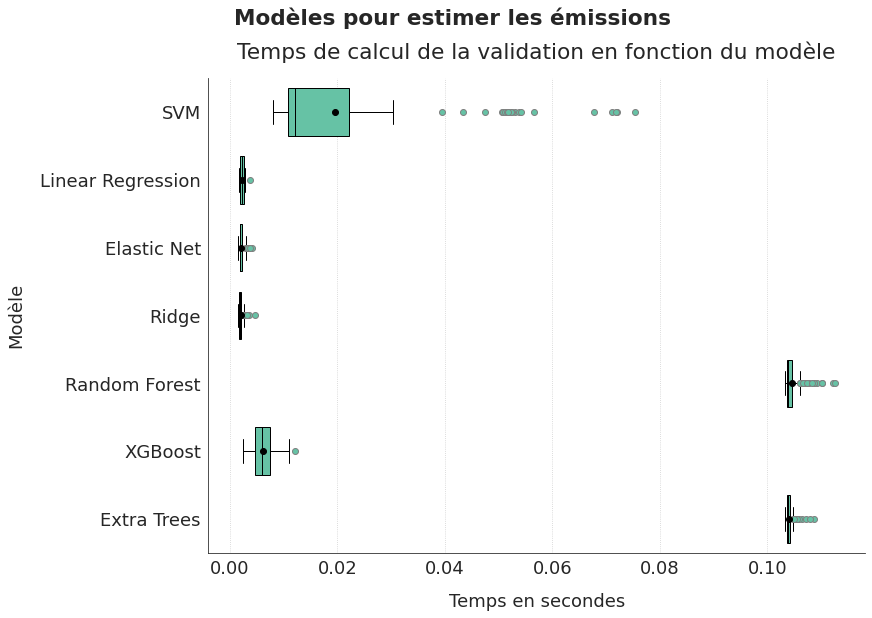

In [ ]:
fig, ax = graph_model_validtime(second_emissions_grouped, "les émissions")
plt.show()

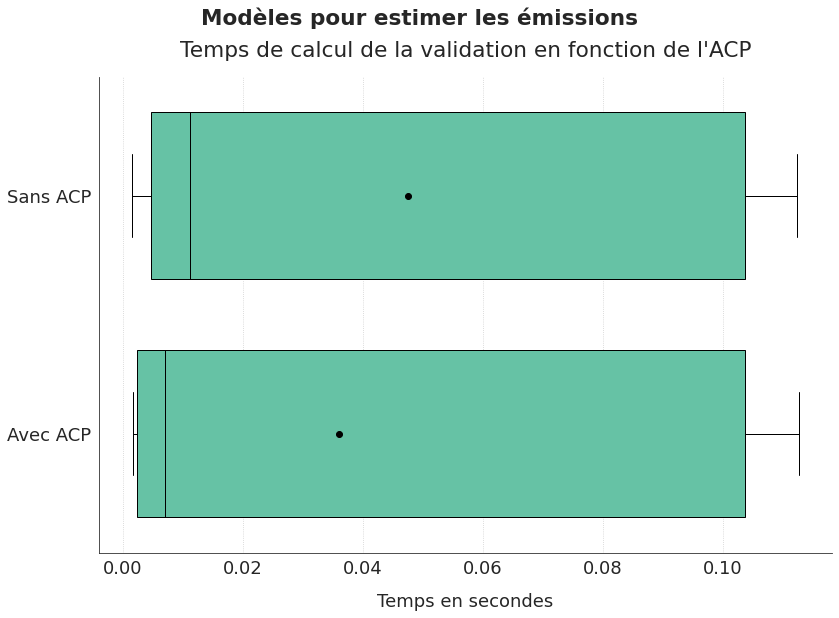

In [ ]:
fig, ax = graph_acp_validtime(second_emissions_grouped, "les émissions")
plt.show()

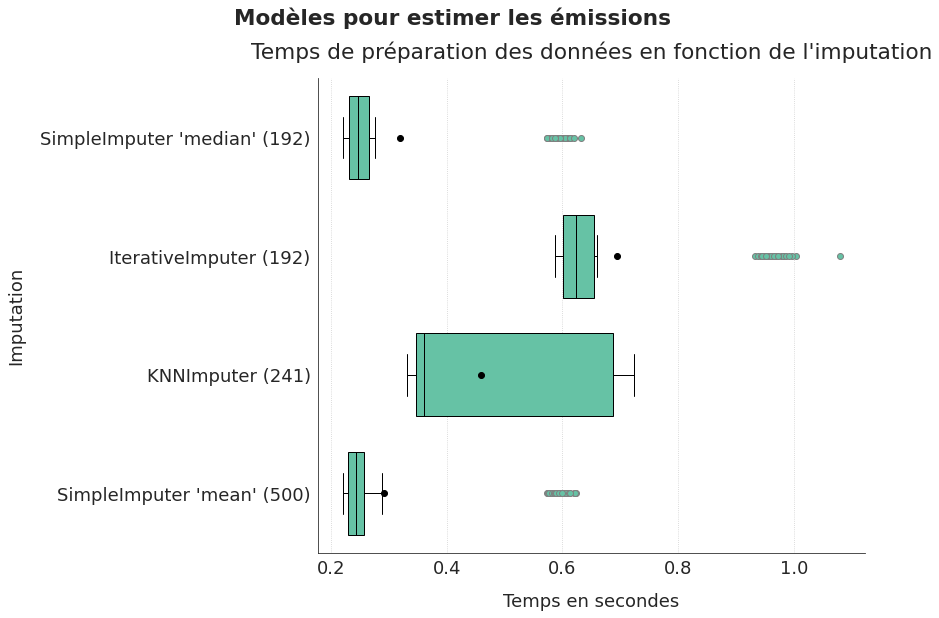

In [ ]:
fig, ax = graph_imputer_preparetime(second_emissions_grouped, "les émissions")
plt.show()

L'imputation par Miss Forest est efficace mais prend beaucoup de temps. Selon l'importance portée au temps de calcul, on utilisera Miss Forest ou une alternative proche en performance mais plus rapide.

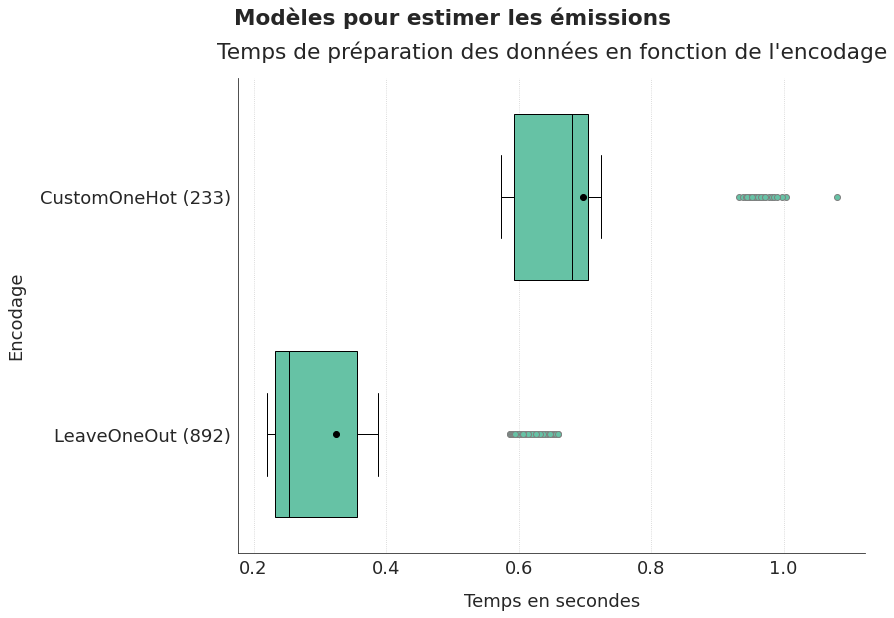

In [ ]:
fig, ax = graph_encoder_preparetime(second_emissions_grouped, "les émissions")
plt.show()

**A retenir**

Les deux modèles les plus prometteurs sont l'ExtraTrees et le XGBoost. Ces deux modèles obtiennent leur meilleure performance avec le même traitement des données : imputation par simple imputer mean pour les variables numériques et simple imputer most frequent pour les variables catégorielles, encodage par Leave One Out, avec d'ajout de variables croisées (en gardant toutes les variables) et pas d'ACP.

In [ ]:
second_emissions_best_results.to_csv("emissions_second_summary.csv")
second_emissions_grouped.to_csv("emissions_grouped_second_summary.csv")

<a id='5_5'></a>

### 5.5. Optimisation des hyperparamètres sur les deux estimateurs retenus

J'effectue une recherche plus approfondie sur les deux modèles qui ont obtenu les meilleurs score : ExtraTrees et XGBoost.

**Définition de la fonction objective et de la fonction d'appel d'hyperopt**

In [ ]:
def objective_emissions(params, n_folds=N_FOLDS):
    global ITERATION, OUT_FILE
    ITERATION += 1
    
    params_reg = {k:v for (k,v) in params.items()}
    reg_pipeline.set_params(**params_reg)
    
    start_time = timer()
    transformed_data = emissions_pipeline.fit_transform(X_train_emissions, ln_y_train_emissions)
    transformed_data = transformed_data.astype(np.number)
    data_transfo_time = timer() - start_time
    
    myshuffle = KFold(n_splits=n_folds, shuffle=True, random_state=42)
    cv_results = cross_validate(reg_pipeline, transformed_data, ln_y_train_emissions, cv=myshuffle, scoring='r2', return_train_score=True, n_jobs=-1)
    
    valid_score = cv_results['test_score']   #r2 between 0 and 1
    if np.any(np.isnan(valid_score)):
        valid_score = np.array([-1.0 for i in range(n_folds)])  # any error in score calculation gives a -1 score
    valid_score_mean = valid_score.mean()
    valid_score_std = valid_score.std()
    
    train_score = cv_results['train_score']   #r2 between 0 and 1
    if np.any(np.isnan(train_score)):
        train_score = np.array([-1.0 for i in range(n_folds)])  # any error in score calculation gives a -1 score
    train_score_mean = train_score.mean()
    train_score_std = train_score.std()

    valid_time = cv_results['score_time']
    if np.any(np.isnan(valid_time)):
        valid_time_mean = 1000
    else:
        valid_time_mean = valid_time.mean()
    
    train_time = cv_results['fit_time']
    if np.any(np.isnan(train_time)):
        train_time_mean = 1000
    else:
        train_time_mean = train_time.mean()

    of_connection = open(OUT_FILE, 'a')  # Write to the csv file ('a' means append)
    writer = csv.writer(of_connection)
    writer.writerow([valid_score_mean, valid_score_std, valid_time_mean, train_score_mean, train_score_std, train_time_mean,
                     data_transfo_time, reg_pipeline['estimator'], ITERATION])
    of_connection.close()
    
    loss = -valid_score_mean
    return {'loss': loss, 'valid_score_std': valid_score_std, 'valid_time_mean': valid_time_mean,
            'train_score_mean': train_score_mean, 'train_score_std': train_score_std, 'train_time_mean': train_time_mean,
            'data_transfo_time': data_transfo_time, 
            'params_reg': params_reg, 'iteration': ITERATION, 'status': STATUS_OK}

In [ ]:
def run_emissions_optimization(n_folds=5, max_evals=100, keep_nresults=10, prefix='final1', estimator_name='xgboost'):
    global OUT_FILE
    OUT_FILE = 'hyperopt_emissions_{}_{}.csv'.format(estimator_name, prefix)
    of_connection = open(OUT_FILE, 'w')  # Write the headers to the file
    writer = csv.writer(of_connection)
    writer.writerow(['valid_score_mean', 'valid_score_std', 'valid_time_mean',
                     'train_score_mean', 'train_score_std', 'train_time_mean', 'data_transfo_time',
                     'estimator', 'iteration'])
    of_connection.close()
    
    global N_FOLDS, ITERATION
    N_FOLDS = n_folds
    ITERATION = 0
    
    trials = Trials()
    
    best_param = fmin(objective_emissions, space, algo=tpe.suggest, trials=trials, max_evals=max_evals, rstate=np.random.RandomState(42))
    
    list_losses = [t['result']['loss'] for t in trials.trials]
    idx_min = np.argmin(list_losses)
    if keep_nresults <= 1:
        list_best_results.append(trials.trials[idx_min]['result'])
    else:
        list_idx = np.argsort(list_losses)[:keep_nresults]
        for idx in list_idx:
            list_best_results.append(trials.trials[idx]['result'])
    
    print("Estimateur : {} - Done".format(estimator_name))
    print("Best cross-validation mean score = {}".format(-trials.trials[idx_min]['result']['loss']))
    print("Associated standard deviation = {}".format(trials.trials[idx_min]['result']['valid_score_std']))
    print("Calculation time = {}".format(trials.trials[idx_min]['result']['valid_time_mean']))
    print("Data preparation time = {}".format(trials.trials[idx_min]['result']['data_transfo_time']))
    print("Best cv score obtained after {} iterations".format(trials.trials[idx_min]['result']['iteration']))
    print("")

<a id='5_5_1'></a>

#### 5.5.1. ExtraTrees : Première étape

J'optimise les hyperparamètres liés aux arbres de décision : max_depth, min_samples_split, min_samples_leaf, max_features et max_samples.

In [ ]:
# emissions_pipeline for ExtraTrees
emissions_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_mean), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1)),
    ('data_encoders', FitToPandas(encoder_leaveoneout, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=True, keep_all=True)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler()))
])
reg_pipeline = Pipeline([('estimator', ExtraTreesRegressor(n_jobs=-1, random_state=42))])

In [ ]:
space = {
    'estimator__max_depth': hp.choice('estimator__max_depth', np.arange(2, 16, 1, dtype=int)),
    'estimator__min_samples_split': hp.choice('estimator__min_samples_split', np.arange(2, 21, 2, dtype=int)),
    'estimator__min_samples_leaf': hp.choice('estimator__min_samples_leaf', np.arange(1, 11, 1, dtype=int)),
    'estimator__max_features': hp.uniform('RandomForestRegressor__max_features', 0.5, 1),
    'estimator__bootstrap': True,
    'estimator__max_samples': hp.uniform('estimator__max_samples', 0.5, 1)
}

In [ ]:
list_best_results = []

In [ ]:
estimator_name = 'extratrees'
step = 'final1a'
run_emissions_optimization(max_evals=600, prefix=step, estimator_name=estimator_name)

100%|██████████| 600/600 [19:46<00:00,  1.98s/it, best loss: -0.5551425813460044]
Estimateur : extratrees - Done
Best cross-validation mean score = 0.5551425813460044
Associated standard deviation = 0.04176954400105142
Calculation time = 0.10354027748107911
Data preparation time = 0.25030263300141087
Best cv score obtained after 152 iterations



In [ ]:
extratrees_emissions_first_step = pd.read_csv("hyperopt_emissions_extratrees_final1a.csv")
extratrees_emissions_first_step.head()

,valid_score_mean,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,data_transfo_time,estimator,iteration
0,0.528618,0.041190,0.103452,0.638861,0.008266,0.347053,0.254817,"ExtraTreesRegressor(bootstrap=True, ccp_alpha=...",1
1,0.536698,0.038797,0.103461,0.672408,0.008677,0.345676,0.251987,"ExtraTreesRegressor(bootstrap=True, ccp_alpha=...",2
2,0.540488,0.038779,0.103340,0.714939,0.008476,0.365970,0.258295,"ExtraTreesRegressor(bootstrap=True, ccp_alpha=...",3
3,0.524334,0.038242,0.103421,0.632606,0.010094,0.346251,0.250760,"ExtraTreesRegressor(bootstrap=True, ccp_alpha=...",4
4,0.482968,0.034818,0.103389,0.515842,0.011925,0.267829,0.261044,"ExtraTreesRegressor(bootstrap=True, ccp_alpha=...",5


In [ ]:
extratrees_emissions_first_step = remove_negative_scores(extratrees_emissions_first_step)
inter_str = [inter[inter.find('max_depth')+10:] for inter in extratrees_emissions_first_step.estimator]
extratrees_emissions_first_step["extratrees_max_depth"] = [np.int(inter[:inter.find(',')]) for inter in inter_str]
inter_str = [inter[inter.find('min_samples_split')+18:] for inter in extratrees_emissions_first_step.estimator]
extratrees_emissions_first_step["extratrees_min_samples_split"] = [np.int(inter[:inter.find(',')]) for inter in inter_str]
inter_str = [inter[inter.find('min_samples_leaf')+17:] for inter in extratrees_emissions_first_step.estimator]
extratrees_emissions_first_step["extratrees_min_samples_leaf"] = [np.int(inter[:inter.find(',')]) for inter in inter_str]
inter_str = [inter[inter.find('max_features')+13:] for inter in extratrees_emissions_first_step.estimator]
extratrees_emissions_first_step["extratrees_max_features"] = [np.around(np.float(inter[:inter.find(',')]),2) for inter in inter_str]
inter_str = [inter[inter.find('max_samples')+12:] for inter in extratrees_emissions_first_step.estimator]
extratrees_emissions_first_step["extratrees_max_samples"] = [np.around(np.float(inter[:inter.find(',')]),2) for inter in inter_str]
extratrees_emissions_first_step["total_time"] = extratrees_emissions_first_step.valid_time_mean + extratrees_emissions_first_step.data_transfo_time

In [ ]:
extratrees_emissions_first_step[["valid_score_mean", "train_score_mean", "iteration", "extratrees_max_depth",
                                 "extratrees_min_samples_split", "extratrees_min_samples_leaf", "extratrees_max_features",
                                 "extratrees_max_samples"]].sort_values("valid_score_mean", ascending=False).head(10)

,valid_score_mean,train_score_mean,iteration,extratrees_max_depth,extratrees_min_samples_split,extratrees_min_samples_leaf,extratrees_max_features,extratrees_max_samples
151,0.555143,0.815668,152,15,8,1,0.95,0.96
401,0.554932,0.878872,402,14,4,1,0.98,0.98
23,0.554608,0.853722,24,15,6,1,1.00,1.00
258,0.553869,0.881428,259,14,4,1,0.97,0.99
134,0.553711,0.882417,135,15,4,1,1.00,0.94
559,0.553620,0.875832,560,14,4,1,1.00,0.95
465,0.553516,0.832493,466,12,4,1,0.92,0.84
25,0.553452,0.852166,26,13,4,1,0.95,0.88
228,0.553411,0.875799,229,14,4,1,0.90,0.98
410,0.553353,0.875074,411,14,4,1,1.00,0.95


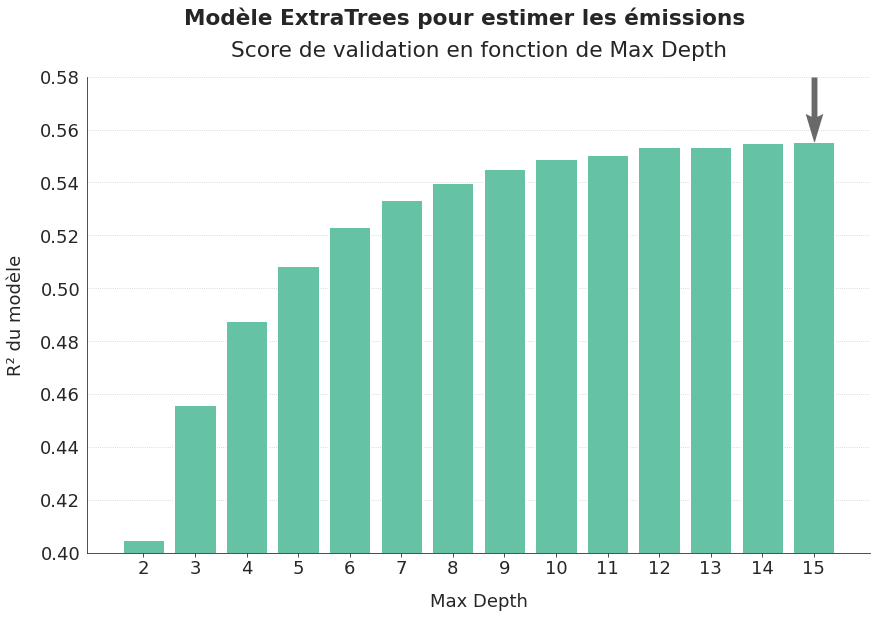

In [ ]:
fig, ax = graph_modele_score(extratrees_emissions_first_step, "extratrees_max_depth", "ExtraTrees", "Max Depth",
                             "les émissions", ymin=0.4, ymax=0.58)
plt.show()

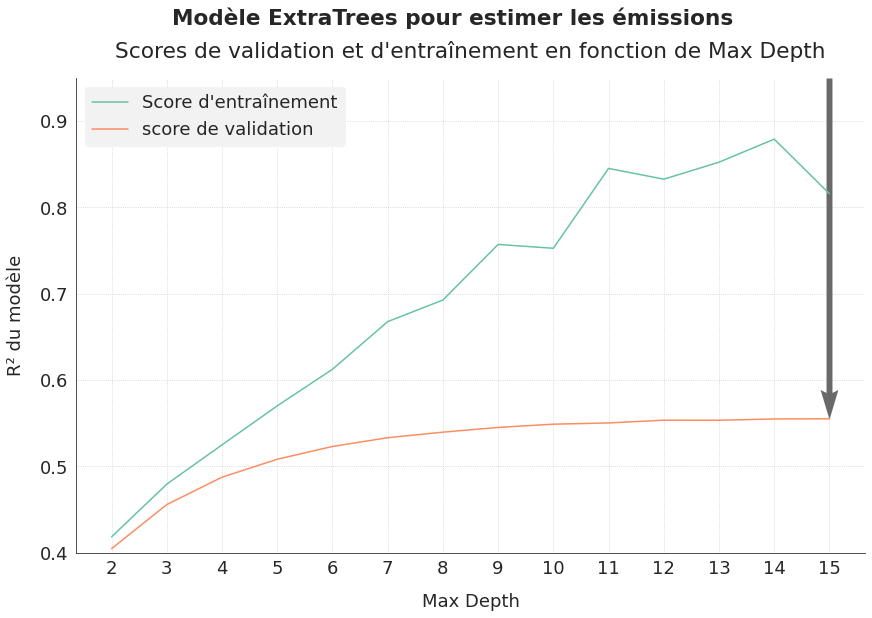

In [ ]:
fig, ax = graph_compar_train_valid(extratrees_emissions_first_step, "extratrees_max_depth", "ExtraTrees", "Max Depth",
                                   "les émissions", ymin=0.4, ymax=0.95)
plt.show()

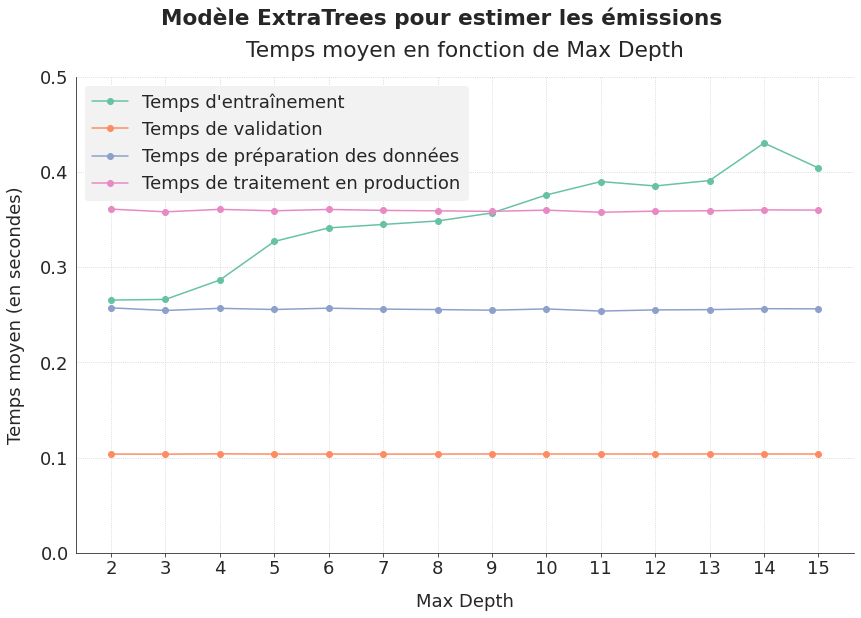

In [ ]:
fig, ax = graph_modele_time(extratrees_emissions_first_step, "extratrees_max_depth", "ExtraTrees", "Max Depth",
                                   "les émissions", ymin=0.0, ymax=0.5)
plt.show()

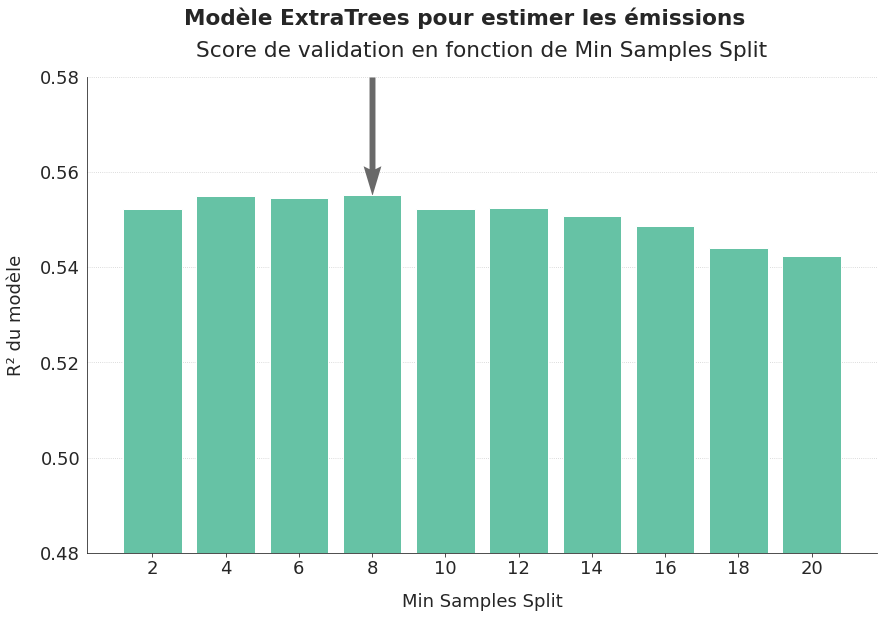

In [ ]:
fig, ax = graph_modele_score(extratrees_emissions_first_step, "extratrees_min_samples_split", "ExtraTrees", "Min Samples Split",
                                   "les émissions", ymin=0.48, ymax=0.58)
plt.show()

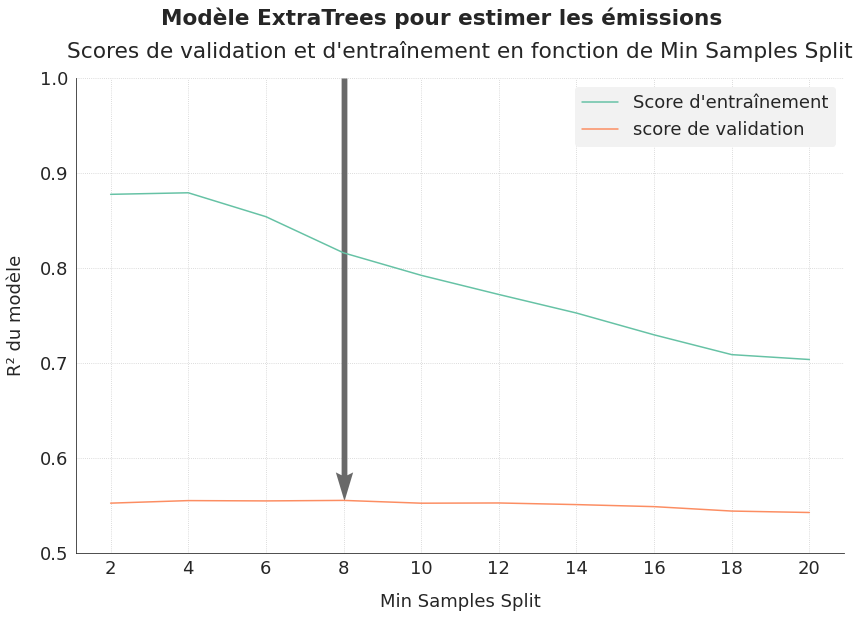

In [ ]:
fig, ax = graph_compar_train_valid(extratrees_emissions_first_step, "extratrees_min_samples_split", "ExtraTrees", "Min Samples Split",
                                   "les émissions", ymin=0.5, ymax=1)
plt.show()

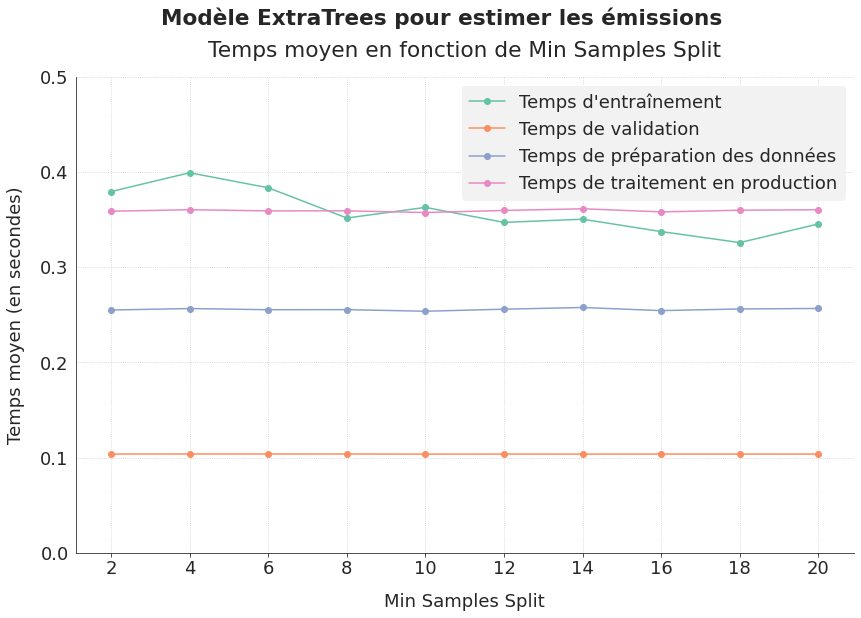

In [ ]:
fig, ax = graph_modele_time(extratrees_emissions_first_step, "extratrees_min_samples_split", "ExtraTrees", "Min Samples Split",
                                   "les émissions", ymin=0.0, ymax=0.5)
plt.show()

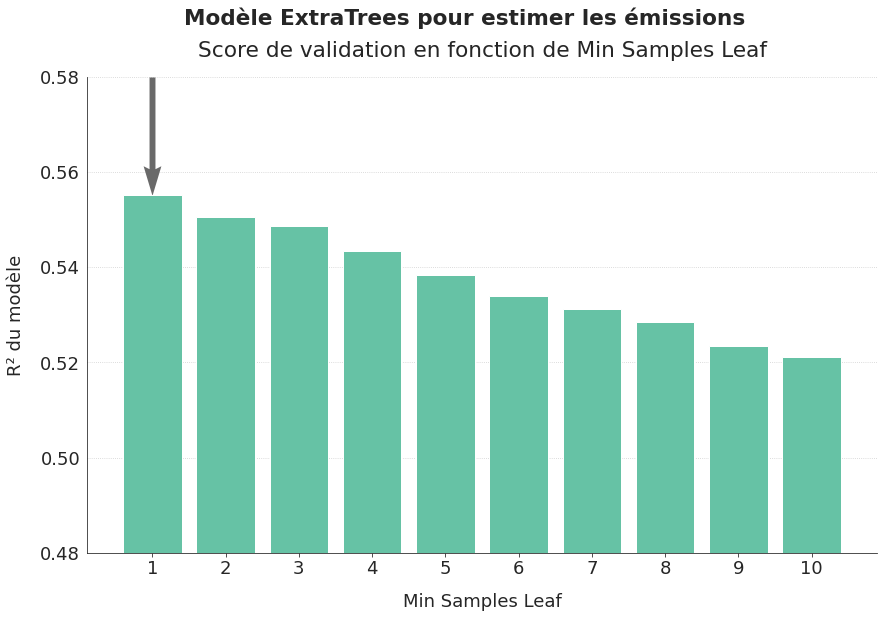

In [ ]:
fig, ax = graph_modele_score(extratrees_emissions_first_step, "extratrees_min_samples_leaf", "ExtraTrees", "Min Samples Leaf",
                                   "les émissions", ymin=0.48, ymax=0.58)
plt.show()

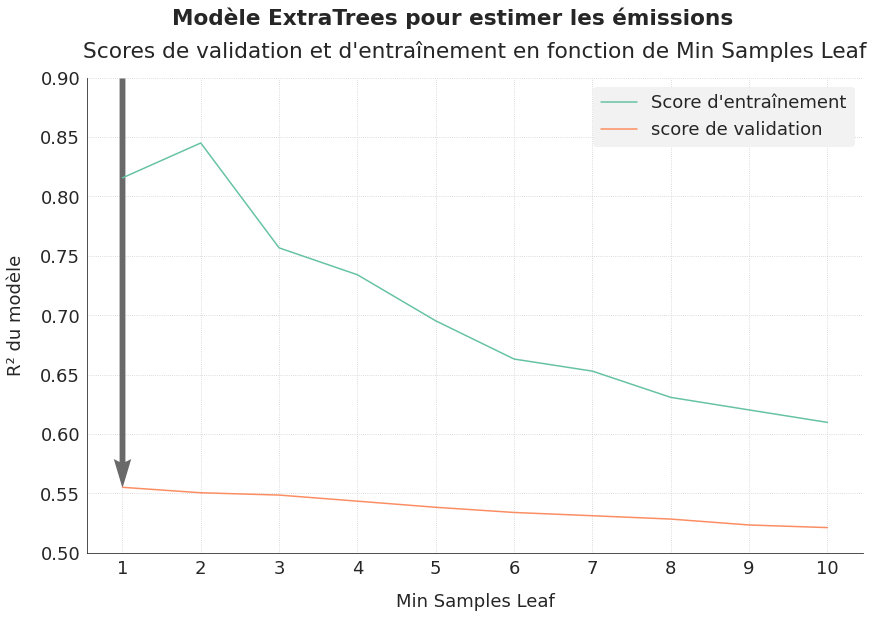

In [ ]:
fig, ax = graph_compar_train_valid(extratrees_emissions_first_step, "extratrees_min_samples_leaf", "ExtraTrees", "Min Samples Leaf",
                                   "les émissions", ymin=0.5, ymax=0.90)
plt.show()

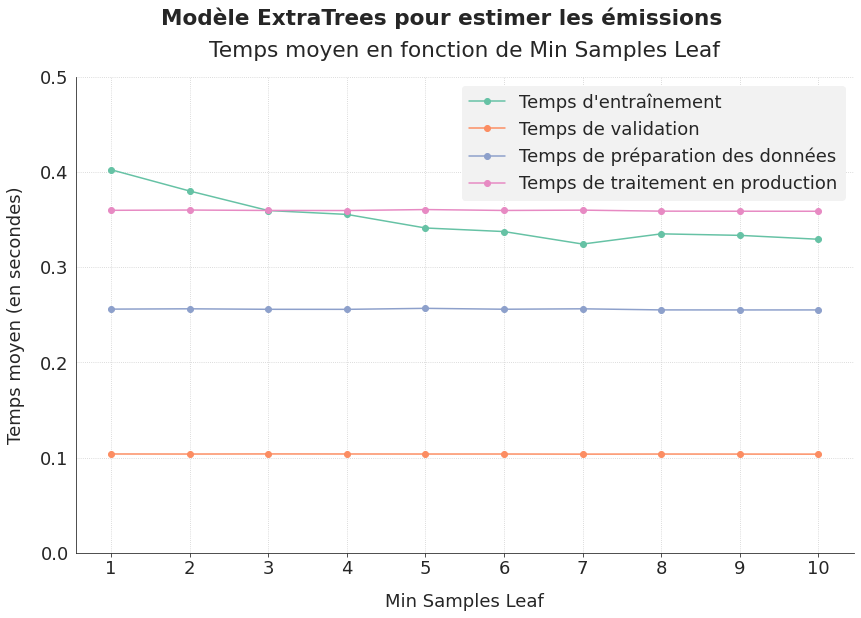

In [ ]:
fig, ax = graph_modele_time(extratrees_emissions_first_step, "extratrees_min_samples_leaf", "ExtraTrees", "Min Samples Leaf",
                                   "les émissions", ymin=0.0, ymax=0.5)
plt.show()

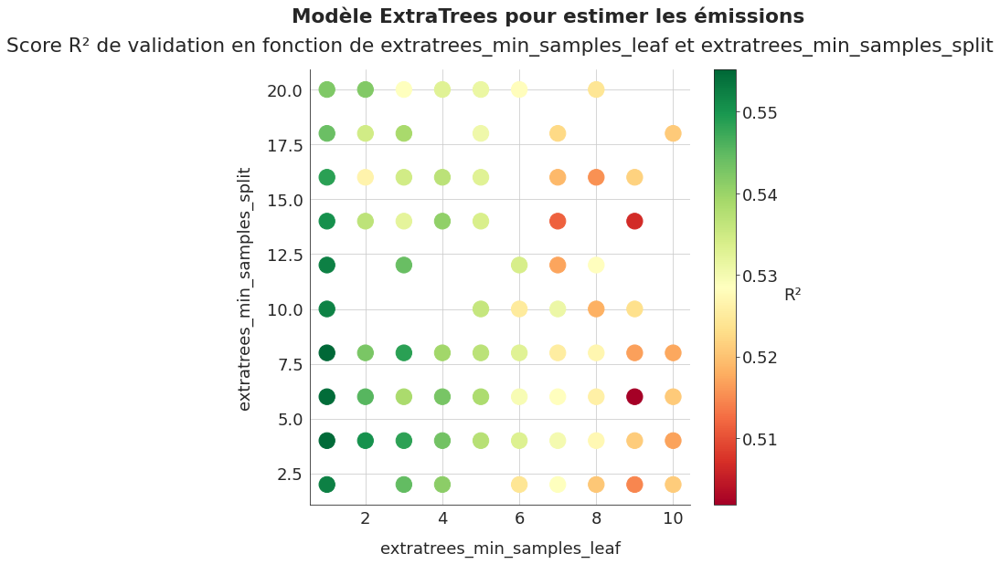

In [ ]:
fig, ax = graph_cross_score(extratrees_emissions_first_step, "extratrees_min_samples_leaf", "extratrees_min_samples_split",
                            "ExtraTrees", "les émissions", vmin=0.5, size=300, figsize=(12,8))

Je recommance la recherche en élargissant l'intervalle pour max_depth.

In [ ]:
# emissions_pipeline for ExtraTrees
emissions_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_mean), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1)),
    ('data_encoders', FitToPandas(encoder_leaveoneout, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=True, keep_all=True)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler()))
])
reg_pipeline = Pipeline([('estimator', ExtraTreesRegressor(n_jobs=-1, random_state=42))])

In [ ]:
space = {
    'estimator__max_depth': hp.choice('estimator__max_depth', np.arange(2, 21, 1, dtype=int)),
    'estimator__min_samples_split': hp.choice('estimator__min_samples_split', np.arange(2, 21, 2, dtype=int)),
    'estimator__min_samples_leaf': hp.choice('estimator__min_samples_leaf', np.arange(1, 11, 1, dtype=int)),
    'estimator__max_features': hp.uniform('estimator__max_features', 0.5, 1),
    'estimator__bootstrap': True,
    'estimator__max_samples': hp.uniform('estimator__max_samples', 0.5, 1)
}

In [ ]:
list_best_results = []

In [ ]:
estimator_name = 'extratrees'
step = 'final1b'
run_emissions_optimization(max_evals=600, prefix=step, estimator_name=estimator_name)

100%|██████████| 600/600 [19:47<00:00,  1.98s/it, best loss: -0.5555657016563582]
Estimateur : extratrees - Done
Best cross-validation mean score = 0.5555657016563582
Associated standard deviation = 0.042182090259685674
Calculation time = 0.10395793914794922
Data preparation time = 0.24699303899978986
Best cv score obtained after 586 iterations



In [ ]:
extratrees_emissions_first_stepb = pd.read_csv("hyperopt_emissions_extratrees_final1b.csv")
extratrees_emissions_first_stepb.head()

,valid_score_mean,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,data_transfo_time,estimator,iteration
0,0.528724,0.040986,0.104766,0.634465,0.007002,0.348028,0.261641,"ExtraTreesRegressor(bootstrap=True, ccp_alpha=...",1
1,0.518530,0.039631,0.103863,0.599034,0.010599,0.347008,0.254124,"ExtraTreesRegressor(bootstrap=True, ccp_alpha=...",2
2,0.542774,0.041712,0.103471,0.692202,0.008848,0.344629,0.257010,"ExtraTreesRegressor(bootstrap=True, ccp_alpha=...",3
3,0.503504,0.038254,0.103797,0.563994,0.010916,0.264459,0.265918,"ExtraTreesRegressor(bootstrap=True, ccp_alpha=...",4
4,0.495814,0.037550,0.103195,0.538849,0.013018,0.300500,0.253389,"ExtraTreesRegressor(bootstrap=True, ccp_alpha=...",5


In [ ]:
extratrees_emissions_first_stepb = remove_negative_scores(extratrees_emissions_first_stepb)
inter_str = [inter[inter.find('max_depth')+10:] for inter in extratrees_emissions_first_stepb.estimator]
extratrees_emissions_first_stepb["extratrees_max_depth"] = [np.int(inter[:inter.find(',')]) for inter in inter_str]
inter_str = [inter[inter.find('min_samples_split')+18:] for inter in extratrees_emissions_first_stepb.estimator]
extratrees_emissions_first_stepb["extratrees_min_samples_split"] = [np.int(inter[:inter.find(',')]) for inter in inter_str]
inter_str = [inter[inter.find('min_samples_leaf')+17:] for inter in extratrees_emissions_first_stepb.estimator]
extratrees_emissions_first_stepb["extratrees_min_samples_leaf"] = [np.int(inter[:inter.find(',')]) for inter in inter_str]
inter_str = [inter[inter.find('max_features')+13:] for inter in extratrees_emissions_first_stepb.estimator]
extratrees_emissions_first_stepb["extratrees_max_features"] = [np.around(np.float(inter[:inter.find(',')]),2) for inter in inter_str]
inter_str = [inter[inter.find('max_samples')+12:] for inter in extratrees_emissions_first_stepb.estimator]
extratrees_emissions_first_stepb["extratrees_max_samples"] = [np.around(np.float(inter[:inter.find(',')]),2) for inter in inter_str]
extratrees_emissions_first_stepb["total_time"] = extratrees_emissions_first_stepb.valid_time_mean + extratrees_emissions_first_stepb.data_transfo_time

In [ ]:
extratrees_emissions_first_stepb[["valid_score_mean", "train_score_mean", "iteration", "extratrees_max_depth",
                                 "extratrees_min_samples_split", "extratrees_min_samples_leaf", "extratrees_max_features",
                                 "extratrees_max_samples"]].sort_values("valid_score_mean", ascending=False).head(10)

,valid_score_mean,train_score_mean,iteration,extratrees_max_depth,extratrees_min_samples_split,extratrees_min_samples_leaf,extratrees_max_features,extratrees_max_samples
585,0.555566,0.795343,586,18,10,1,0.95,0.94
146,0.555333,0.834878,147,14,6,1,0.99,0.90
84,0.555274,0.844947,85,16,6,1,1.00,0.88
429,0.554947,0.809838,430,12,6,1,0.90,0.92
308,0.554878,0.852152,309,17,6,1,0.95,0.92
580,0.554832,0.795817,581,18,10,1,0.98,0.94
262,0.554679,0.845134,263,14,6,1,0.99,0.98
405,0.554573,0.844403,406,14,6,1,0.99,0.97
344,0.554532,0.795936,345,18,10,1,0.99,0.93
589,0.554532,0.795936,590,18,10,1,0.95,0.93


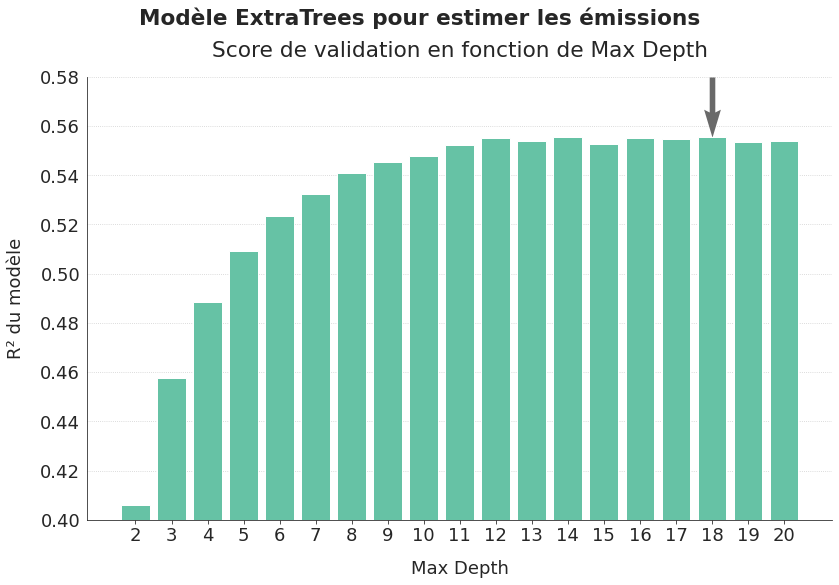

In [ ]:
fig, ax = graph_modele_score(extratrees_emissions_first_stepb, "extratrees_max_depth", "ExtraTrees", "Max Depth",
                             "les émissions", ymin=0.4, ymax=0.58)
save_fig("ml03_2_41_ext1a")
plt.show()

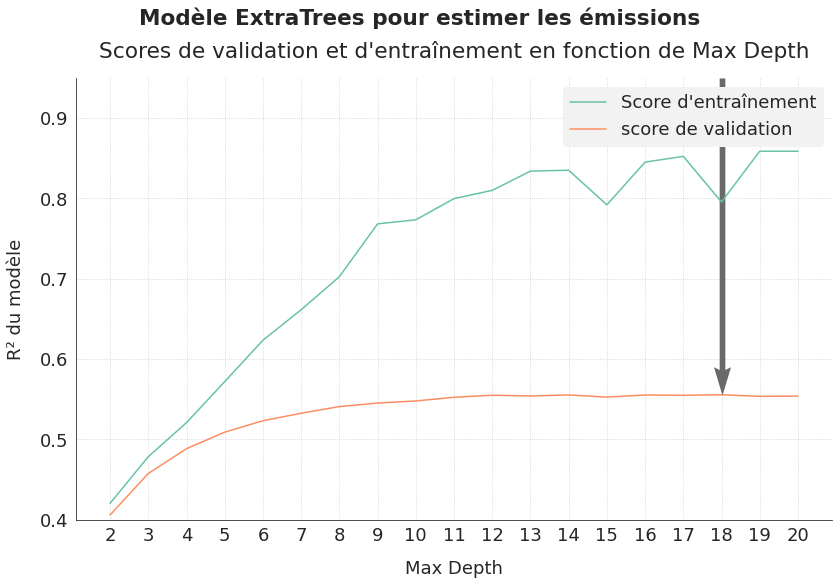

In [ ]:
fig, ax = graph_compar_train_valid(extratrees_emissions_first_stepb, "extratrees_max_depth", "ExtraTrees", "Max Depth",
                                   "les émissions", ymin=0.4, ymax=0.95)
save_fig("ml03_2_41_ext1b")
plt.show()

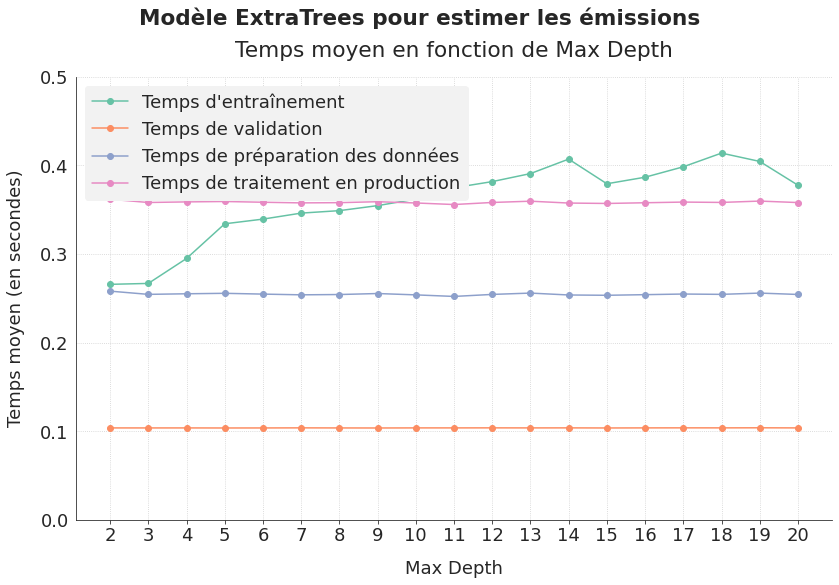

In [ ]:
fig, ax = graph_modele_time(extratrees_emissions_first_stepb, "extratrees_max_depth", "ExtraTrees", "Max Depth",
                                   "les émissions", ymin=0.0, ymax=0.5)
save_fig("ml03_2_41_ext1c")
plt.show()

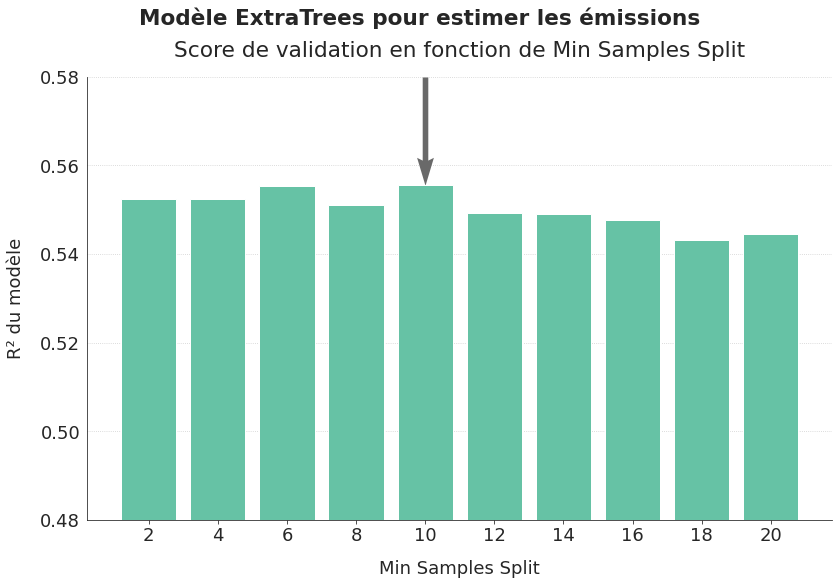

In [ ]:
fig, ax = graph_modele_score(extratrees_emissions_first_stepb, "extratrees_min_samples_split", "ExtraTrees", "Min Samples Split",
                                   "les émissions", ymin=0.48, ymax=0.58)
save_fig("ml03_2_42_ext2a")
plt.show()

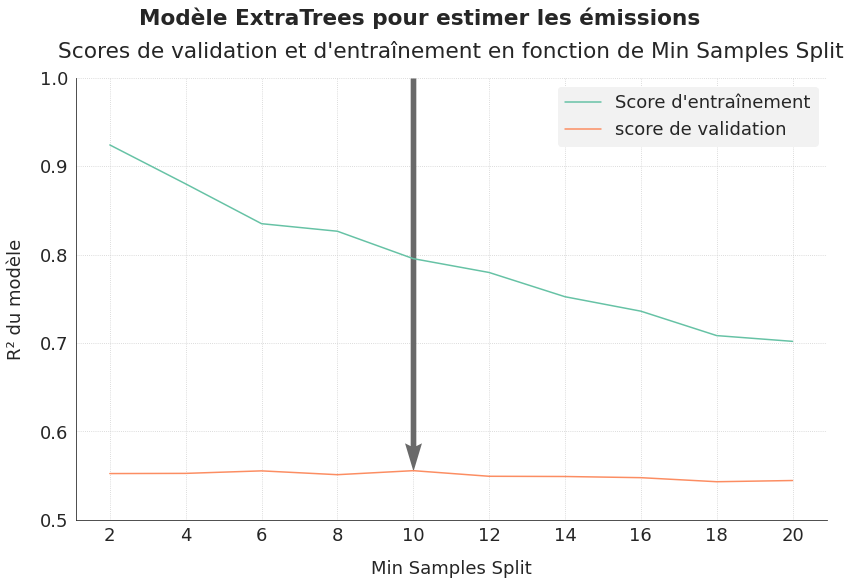

In [ ]:
fig, ax = graph_compar_train_valid(extratrees_emissions_first_stepb, "extratrees_min_samples_split", "ExtraTrees", "Min Samples Split",
                                   "les émissions", ymin=0.5, ymax=1)
save_fig("ml03_2_42_ext2b")
plt.show()

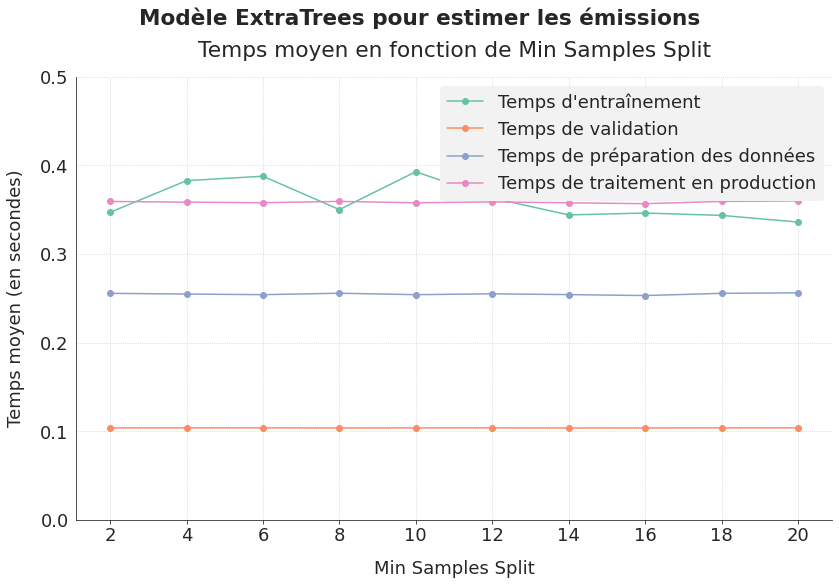

In [ ]:
fig, ax = graph_modele_time(extratrees_emissions_first_stepb, "extratrees_min_samples_split", "ExtraTrees", "Min Samples Split",
                                   "les émissions", ymin=0.0, ymax=0.5)
save_fig("ml03_2_42_ext2c")
plt.show()

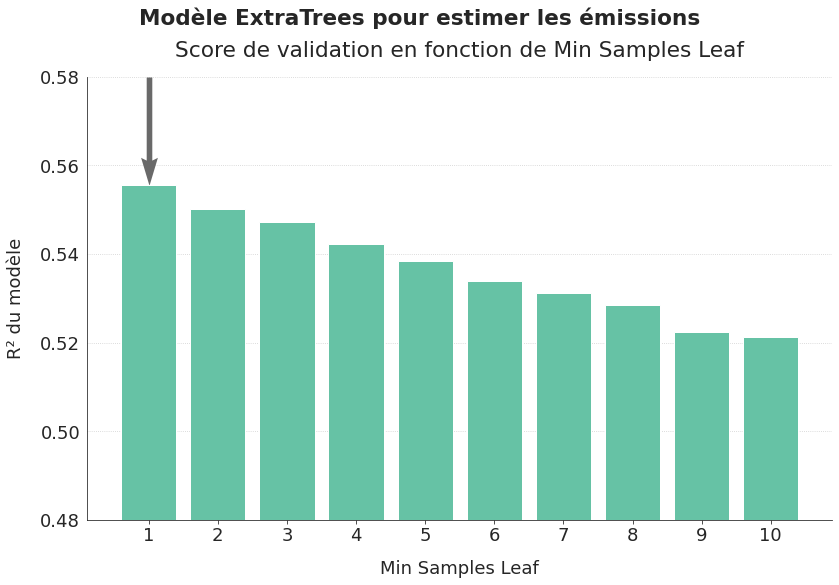

In [ ]:
fig, ax = graph_modele_score(extratrees_emissions_first_stepb, "extratrees_min_samples_leaf", "ExtraTrees", "Min Samples Leaf",
                                   "les émissions", ymin=0.48, ymax=0.58)
save_fig("ml03_2_43_ext3a")
plt.show()

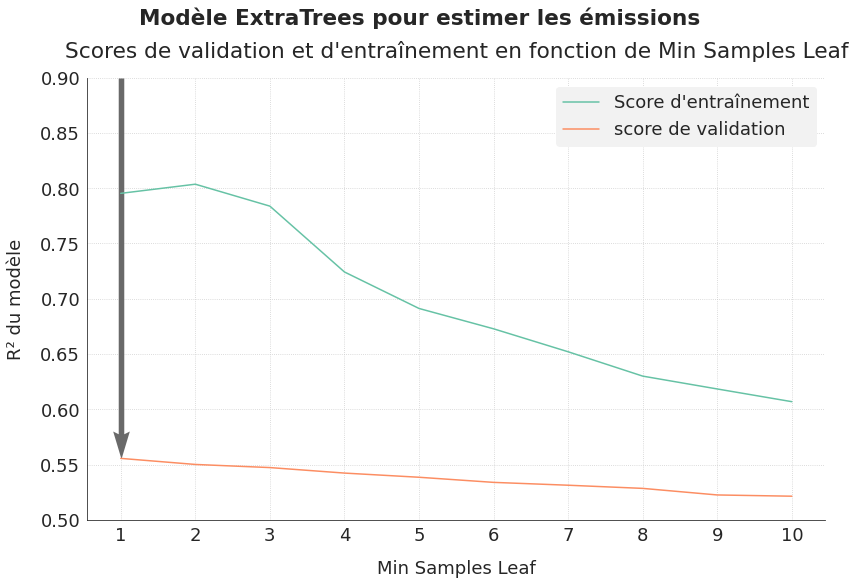

In [ ]:
fig, ax = graph_compar_train_valid(extratrees_emissions_first_stepb, "extratrees_min_samples_leaf", "ExtraTrees", "Min Samples Leaf",
                                   "les émissions", ymin=0.5, ymax=0.90)
save_fig("ml03_2_43_ext3b")
plt.show()

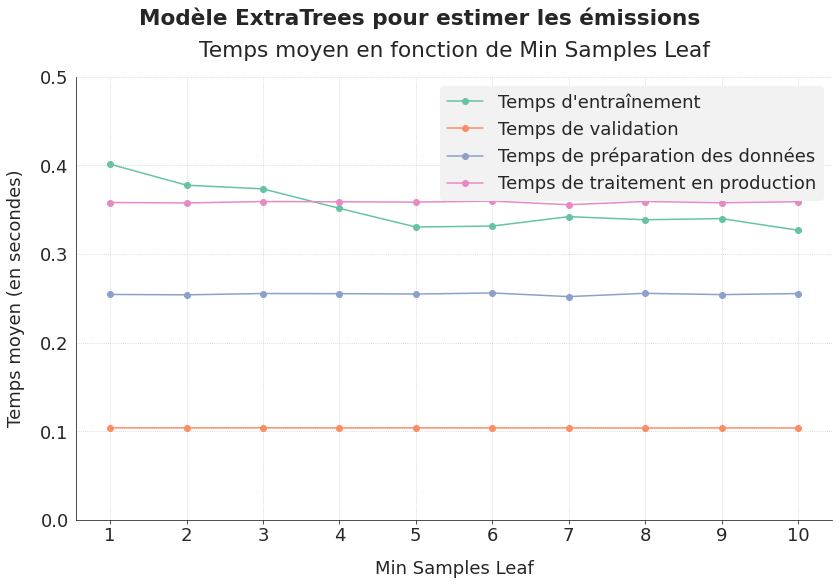

In [ ]:
fig, ax = graph_modele_time(extratrees_emissions_first_stepb, "extratrees_min_samples_leaf", "ExtraTrees", "Min Samples Leaf",
                                   "les émissions", ymin=0.0, ymax=0.5)
save_fig("ml03_2_43_ext3c")
plt.show()

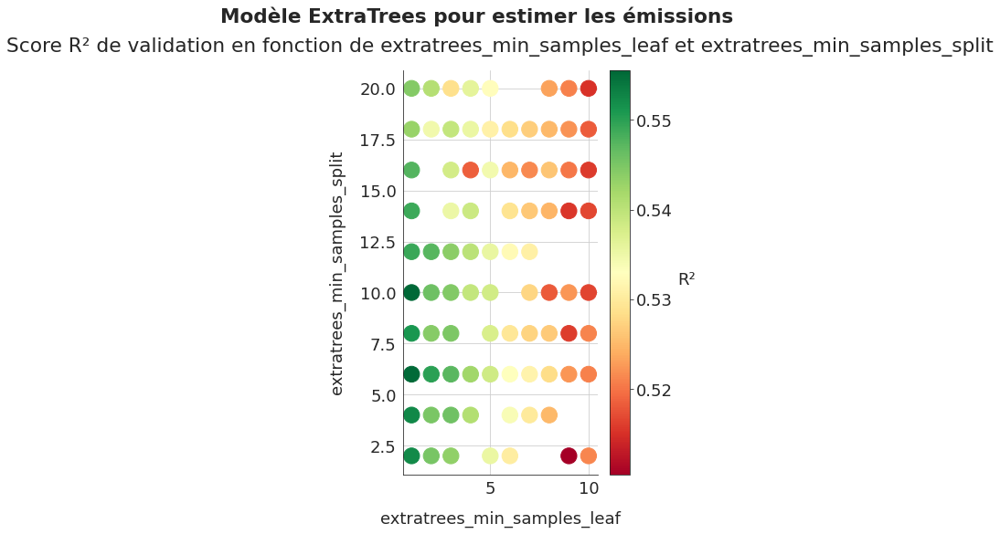

In [ ]:
fig, ax = graph_cross_score(extratrees_emissions_first_stepb, "extratrees_min_samples_leaf", "extratrees_min_samples_split",
                            "ExtraTrees", "les émissions", vmin=0.5, size=300, figsize=(12,8))
save_fig("ml03_2_43_ext3d")
plt.show()

Possibilité de monter min_samples_split à 8 ou 10 pour diminuer overfitting sans affecter significativement la performance.

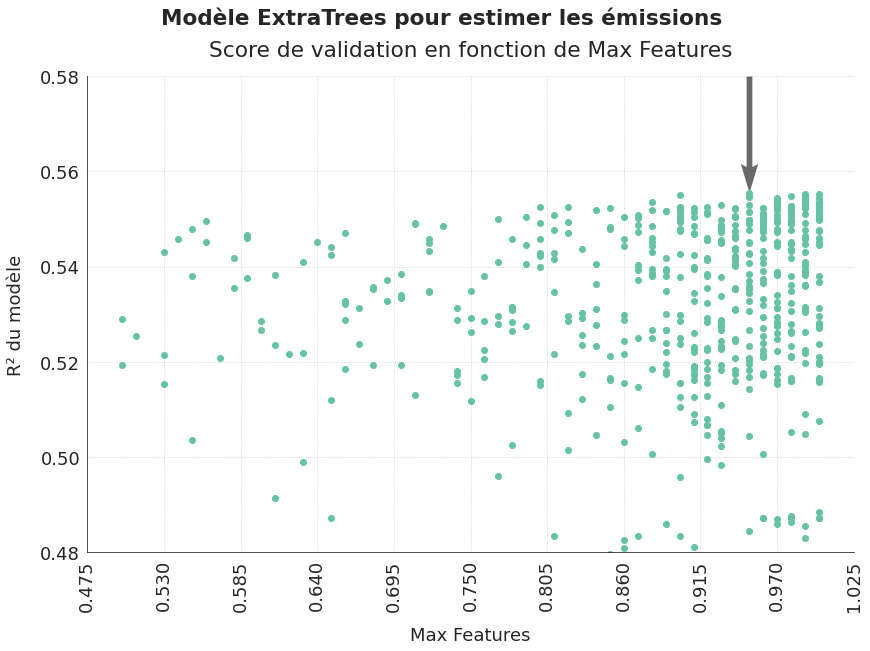

In [ ]:
fig, ax = graph_continu_preview(extratrees_emissions_first_stepb, "extratrees_max_features", "ExtraTrees", "Max Features",
                             "les émissions", ymin=0.48, ymax=0.58, rotation=90)
plt.show()

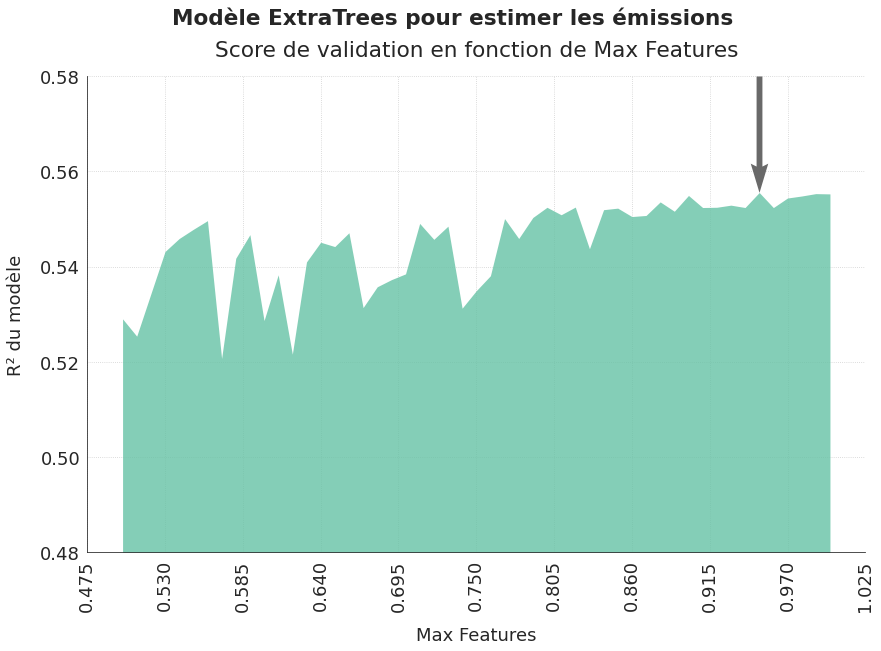

In [ ]:
fig, ax = graph_continu_score(extratrees_emissions_first_stepb, "extratrees_max_features", "ExtraTrees", "Max Features",
                             "les émissions", ymin=0.48, ymax=0.58, rotation=90)
plt.show()

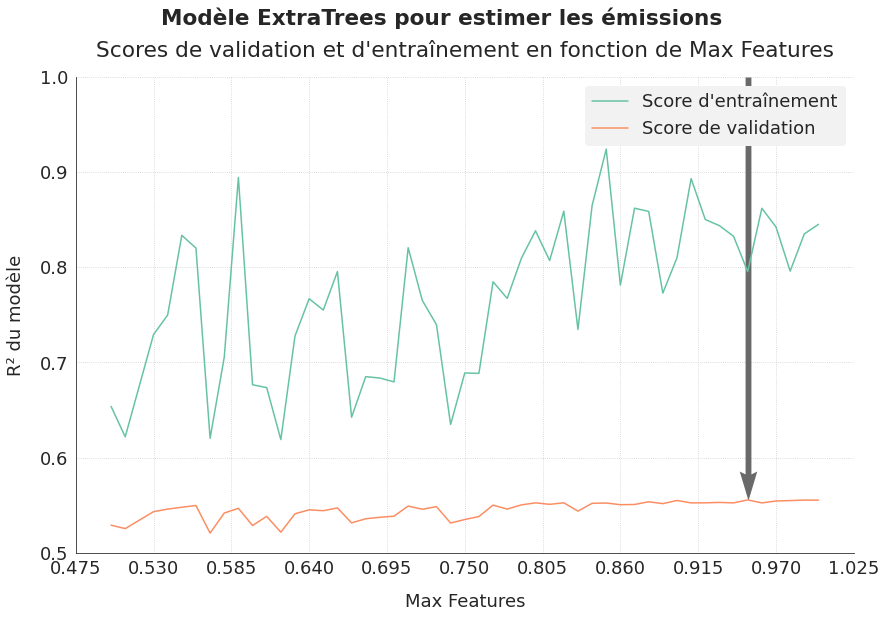

In [ ]:
fig, ax = graph_compar_continu(extratrees_emissions_first_stepb, "extratrees_max_features", "ExtraTrees", "Max Features",
                                   "les émissions", ymin=0.5, ymax=1.00)
plt.show()

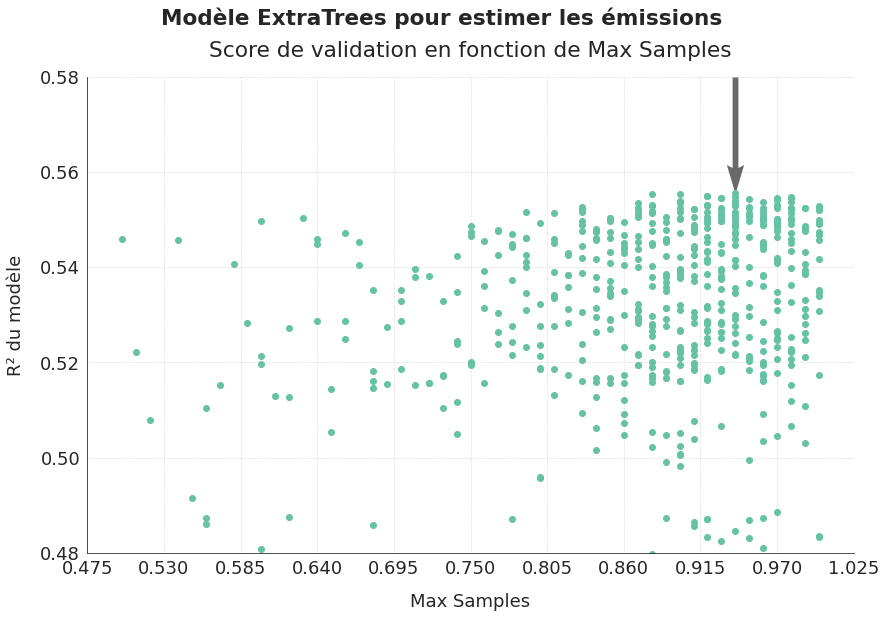

In [ ]:
fig, ax = graph_continu_preview(extratrees_emissions_first_stepb, "extratrees_max_samples", "ExtraTrees", "Max Samples",
                                   "les émissions", ymin=0.48, ymax=0.58)
plt.show()

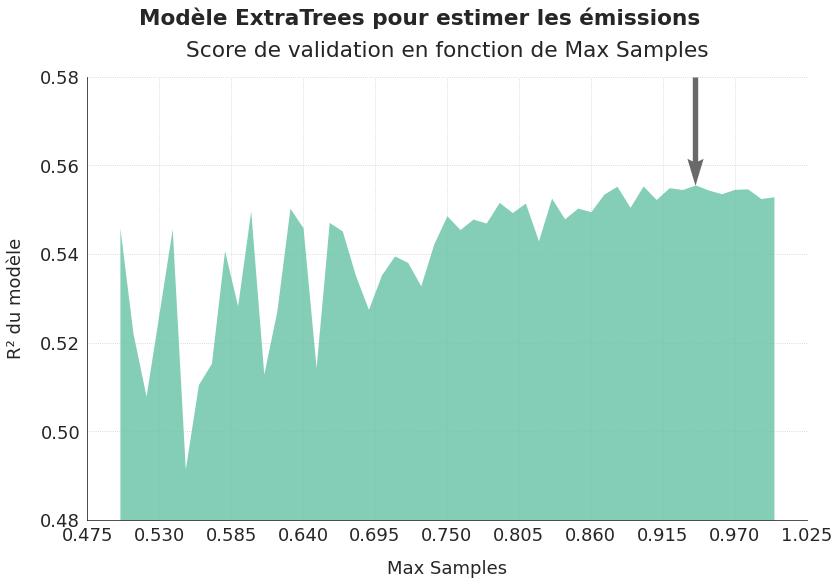

In [ ]:
fig, ax = graph_continu_score(extratrees_emissions_first_stepb, "extratrees_max_samples", "ExtraTrees", "Max Samples",
                                   "les émissions", ymin=0.48, ymax=0.58)
save_fig("ml03_2_44_ext4a")
plt.show()

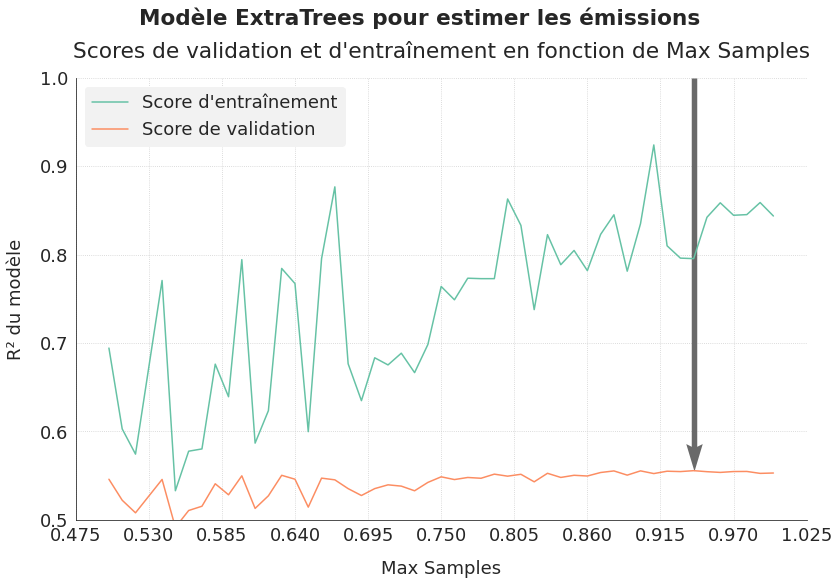

In [ ]:
fig, ax = graph_compar_continu(extratrees_emissions_first_stepb, "extratrees_max_samples", "ExtraTrees", "Max Samples",
                                   "les émissions", ymin=0.5, ymax=1)
save_fig("ml03_2_44_ext4b")
plt.show()

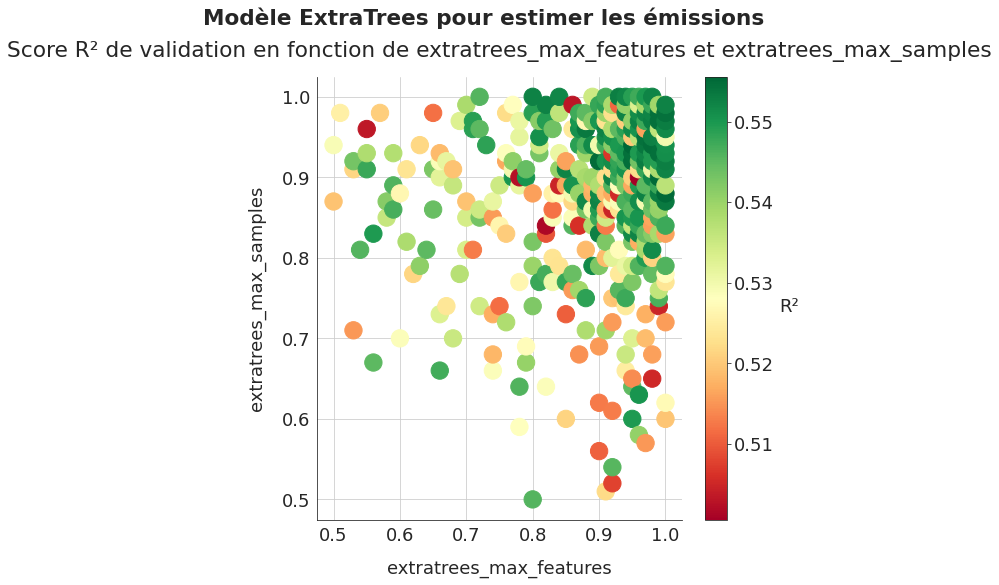

In [ ]:
fig, ax = graph_cross_score(extratrees_emissions_first_stepb, "extratrees_max_features", "extratrees_max_samples",
                            "ExtraTrees", "les émissions", vmin=0.5, size=300, figsize=(12,8))
save_fig("ml03_2_45_ext5d")
plt.show()

Je précise la recherhce pour max_features. Je regarde également si augmenter légèrement min_samples_split permet de diminuer l'overfitting tout en conservant une performance similaire.

In [ ]:
# emissions_pipeline for ExtraTrees
emissions_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_mean), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1)),
    ('data_encoders', FitToPandas(encoder_leaveoneout, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=True, keep_all=True)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler()))
])
reg_pipeline = Pipeline([('estimator', ExtraTreesRegressor(n_jobs=-1, random_state=42))])

In [ ]:
space = {
    'estimator__max_depth': 18,
    'estimator__min_samples_split': hp.choice('estimator__min_samples_split', np.arange(6, 11, 2, dtype=int)),
    'estimator__min_samples_leaf': 1,
    'estimator__max_features': hp.choice('estimator__max_features', np.arange(0.8, 1.01, 0.01)),
    'estimator__bootstrap': True
}

In [ ]:
list_best_results = []

In [ ]:
estimator_name = 'extratrees'
step = 'final2'
run_emissions_optimization(max_evals=40, prefix=step, estimator_name=estimator_name)

100%|██████████| 40/40 [01:29<00:00,  2.23s/it, best loss: -0.5554694847403956]
Estimateur : extratrees - Done
Best cross-validation mean score = 0.5554694847403956
Associated standard deviation = 0.044611119400197206
Calculation time = 0.10400652885437012
Data preparation time = 0.26201276299980236
Best cv score obtained after 16 iterations



In [ ]:
extratrees_emissions_second_step = pd.read_csv("hyperopt_emissions_extratrees_final2.csv")
extratrees_emissions_second_step.head()

,valid_score_mean,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,data_transfo_time,estimator,iteration
0,0.551832,0.039625,0.103377,0.827982,0.004167,0.446554,0.269263,"ExtraTreesRegressor(bootstrap=True, ccp_alpha=...",1
1,0.550584,0.041455,0.103591,0.802655,0.006254,0.448458,0.254459,"ExtraTreesRegressor(bootstrap=True, ccp_alpha=...",2
2,0.552726,0.042101,0.103730,0.801212,0.003997,0.444937,0.252763,"ExtraTreesRegressor(bootstrap=True, ccp_alpha=...",3
3,0.554892,0.043719,0.103310,0.858983,0.004640,0.446074,0.250637,"ExtraTreesRegressor(bootstrap=True, ccp_alpha=...",4
4,0.551832,0.039625,0.103402,0.827982,0.004167,0.445365,0.256568,"ExtraTreesRegressor(bootstrap=True, ccp_alpha=...",5


In [ ]:
extratrees_emissions_second_step = remove_negative_scores(extratrees_emissions_second_step)
inter_str = [inter[inter.find('max_depth')+10:] for inter in extratrees_emissions_second_step.estimator]
extratrees_emissions_second_step["extratrees_max_depth"] = [np.int(inter[:inter.find(',')]) for inter in inter_str]
inter_str = [inter[inter.find('min_samples_split')+18:] for inter in extratrees_emissions_second_step.estimator]
extratrees_emissions_second_step["extratrees_min_samples_split"] = [np.int(inter[:inter.find(',')]) for inter in inter_str]
inter_str = [inter[inter.find('min_samples_leaf')+17:] for inter in extratrees_emissions_second_step.estimator]
extratrees_emissions_second_step["extratrees_min_samples_leaf"] = [np.int(inter[:inter.find(',')]) for inter in inter_str]
inter_str = [inter[inter.find('max_features')+13:] for inter in extratrees_emissions_second_step.estimator]
extratrees_emissions_second_step["extratrees_max_features"] = [np.around(np.float(inter[:inter.find(',')]),2) for inter in inter_str]
extratrees_emissions_second_step["total_time"] = extratrees_emissions_second_step.valid_time_mean + extratrees_emissions_second_step.data_transfo_time

In [ ]:
extratrees_emissions_second_step[["valid_score_mean", "train_score_mean", "iteration", "extratrees_max_depth",
                                 "extratrees_min_samples_split", "extratrees_min_samples_leaf",
                                  "extratrees_max_features"]].sort_values("valid_score_mean", ascending=False).head(10)

,valid_score_mean,train_score_mean,iteration,extratrees_max_depth,extratrees_min_samples_split,extratrees_min_samples_leaf,extratrees_max_features
20,0.555469,0.865197,21,18,6,1,1.00
15,0.555469,0.865197,16,18,6,1,1.00
22,0.555469,0.865197,23,18,6,1,1.00
21,0.555469,0.865197,22,18,6,1,1.00
27,0.555469,0.865197,28,18,6,1,1.00
31,0.555469,0.865197,32,18,6,1,1.00
25,0.554892,0.858983,26,18,6,1,0.83
23,0.554892,0.858983,24,18,6,1,0.81
3,0.554892,0.858983,4,18,6,1,0.85
34,0.554892,0.858983,35,18,6,1,0.85


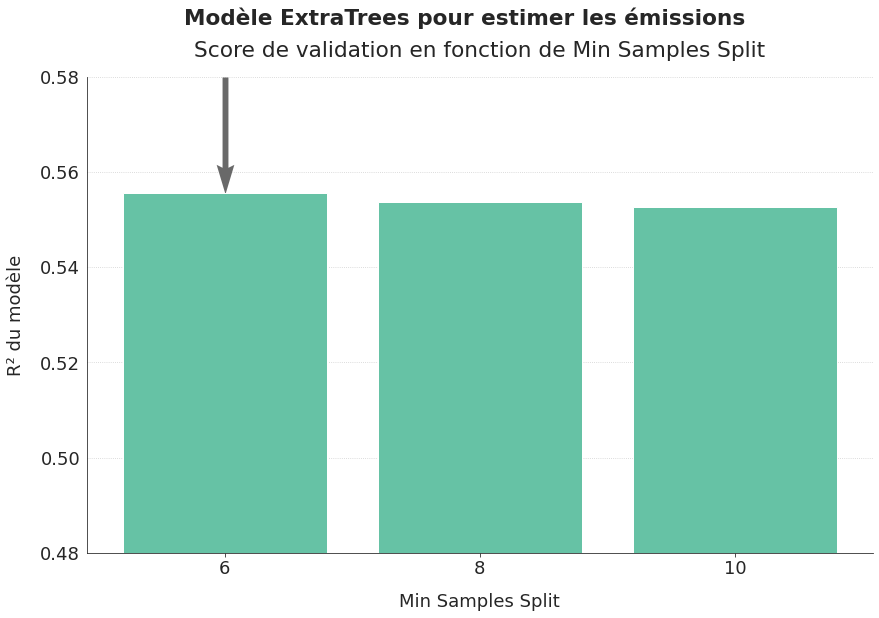

In [ ]:
fig, ax = graph_modele_score(extratrees_emissions_second_step, "extratrees_min_samples_split", "ExtraTrees", "Min Samples Split",
                             "les émissions", ymin=0.48, ymax=0.58)
plt.show()

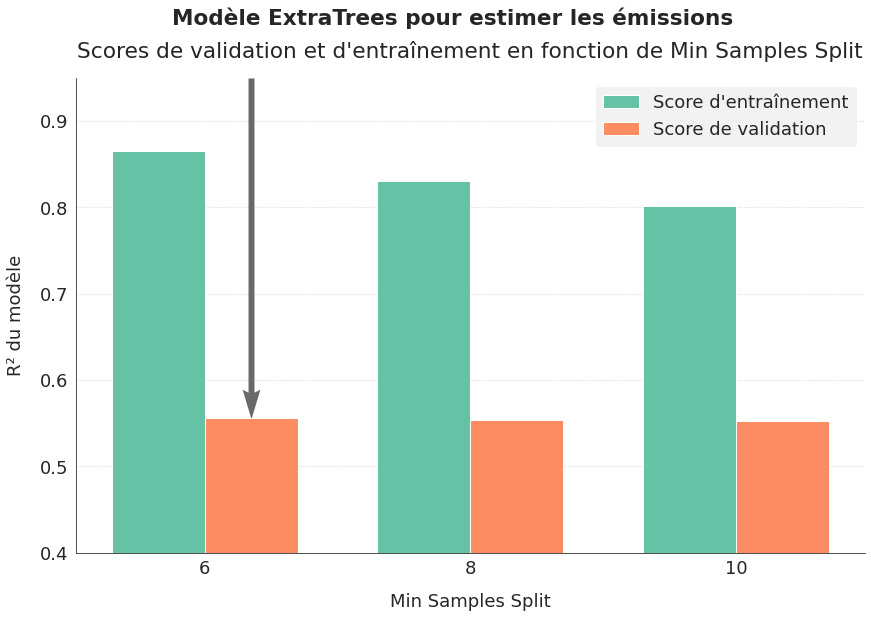

In [ ]:
fig, ax = graph_compar_train_valid(extratrees_emissions_second_step, "extratrees_min_samples_split", "ExtraTrees", "Min Samples Split",
                                   "les émissions", ymin=0.4, ymax=0.95, with_bars=True)
plt.show()

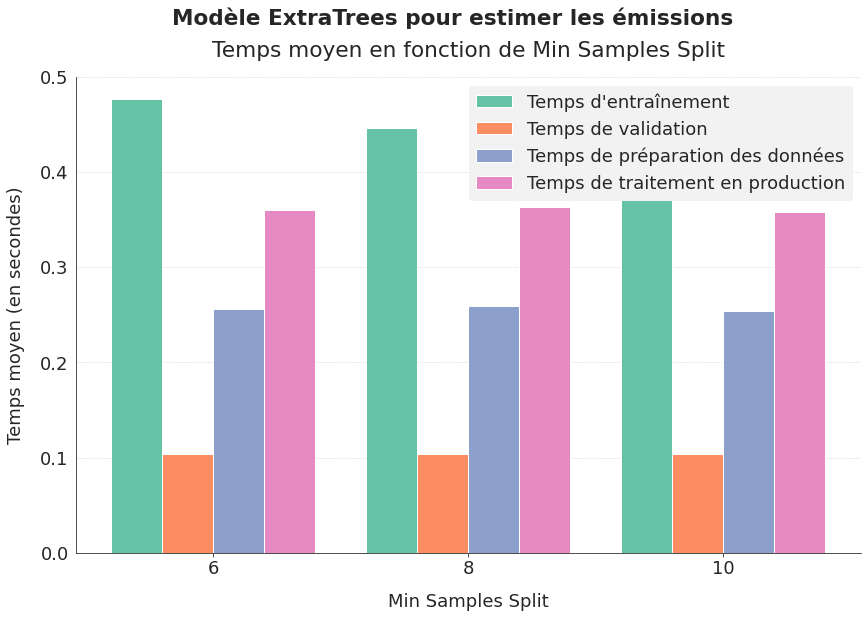

In [ ]:
fig, ax = graph_modele_time(extratrees_emissions_second_step,  "extratrees_min_samples_split", "ExtraTrees", "Min Samples Split",
                                   "les émissions", ymin=0.0, ymax=0.5, with_bars=True)
plt.show()

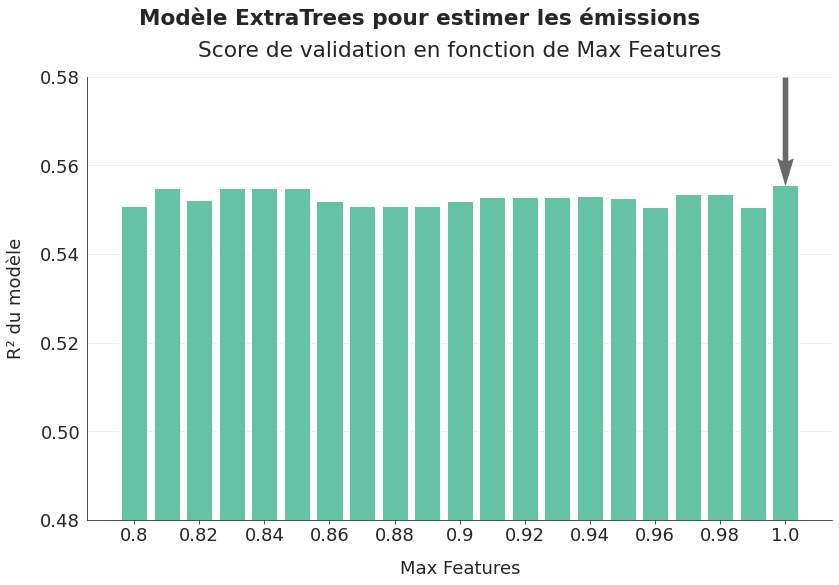

In [ ]:
fig, ax = graph_modele_score(extratrees_emissions_second_step, "extratrees_max_features", "ExtraTrees", "Max Features",
                                   "les émissions", ymin=0.48, ymax=0.58, tick_step=2)
save_fig("ml03_2_45_ext5a")
plt.show()

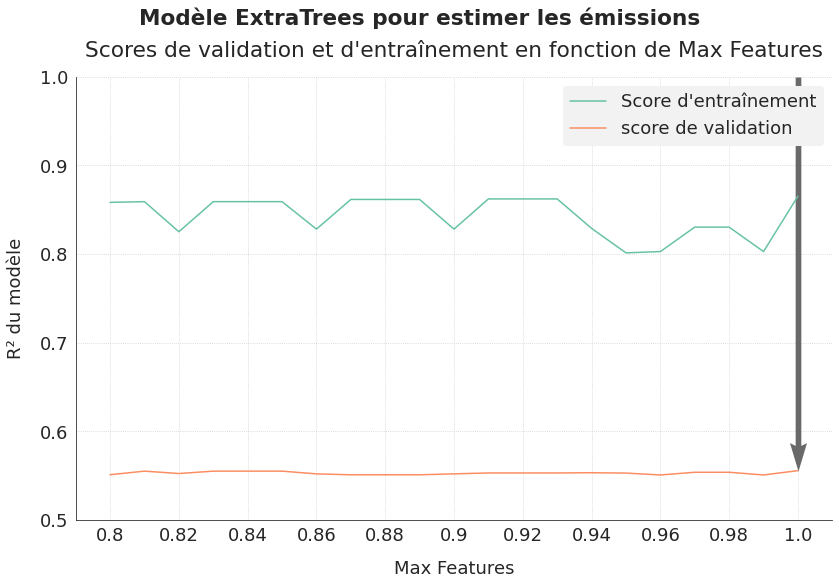

In [ ]:
fig, ax = graph_compar_train_valid(extratrees_emissions_second_step, "extratrees_max_features", "ExtraTrees", "Max Features",
                                   "les émissions", ymin=0.5, ymax=1, tick_step=2)
save_fig("ml03_2_45_ext5b")
plt.show()

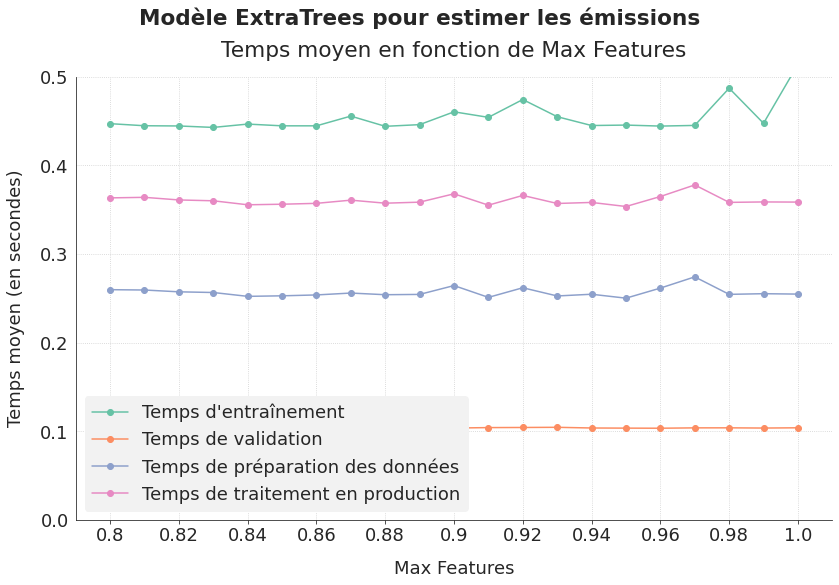

In [ ]:
fig, ax = graph_modele_time(extratrees_emissions_second_step, "extratrees_max_features", "ExtraTrees", "Max Features",
                                   "les émissions", ymin=0.0, ymax=0.5, tick_step=2)
save_fig("ml03_2_45_ext5c")
plt.show()

<a id='5_5_2'></a>

#### 5.5.2. ExtraTrees : Feature importances

In [ ]:
# emissions_pipeline for ExtraTrees
emissions_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_mean), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1)),
    ('data_encoders', FitToPandas(encoder_leaveoneout, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=True, keep_all=True)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler()))
])
reg_pipeline = Pipeline([('estimator', ExtraTreesRegressor(n_jobs=-1, random_state=42))])

In [ ]:
space = {
    'estimator__max_depth': 18,
    'estimator__min_samples_split': 6,
    'estimator__min_samples_leaf': 1,
    'estimator__max_features': 1.0,
    'estimator__bootstrap': True
}

In [ ]:
list_best_results = []

In [ ]:
estimator_name = 'extratrees'
step = 'finalverif'
run_emissions_optimization(max_evals=1, prefix=step, estimator_name=estimator_name)

100%|██████████| 1/1 [00:02<00:00,  2.42s/it, best loss: -0.5554694847403956]
Estimateur : extratrees - Done
Best cross-validation mean score = 0.5554694847403956
Associated standard deviation = 0.04461111940019722
Calculation time = 0.10382180213928223
Data preparation time = 0.27469824900254025
Best cv score obtained after 1 iterations



In [ ]:
extratrees_emissions_second_step = pd.read_csv("hyperopt_emissions_extratrees_finalverif.csv")
extratrees_emissions_second_step.head()

,valid_score_mean,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,data_transfo_time,estimator,iteration
0,0.555469,0.044611,0.103822,0.865197,0.003589,0.528696,0.274698,"ExtraTreesRegressor(bootstrap=True, ccp_alpha=...",1


**Importance des variables calculée par permutation aléatoire des données**

In [ ]:
# emissions_pipeline for ExtraTrees
emissions_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_mean), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1)),
    ('data_encoders', FitToPandas(encoder_leaveoneout, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=True, keep_all=True)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler()))
])
reg = ExtraTreesRegressor(n_jobs=-1, random_state=42,
                          max_depth=18, min_samples_split=6, min_samples_leaf=1,
                          max_features=1.0, bootstrap=True)

In [ ]:
feat_imp3 = eval_feature_importance(emissions_pipeline, reg, X_train_emissions, ln_y_train_emissions)
feat_imp3.describe()

,importance,importance_stability
count,21.000000,21.000000
mean,0.061135,0.002447
std,0.067420,0.002324
min,0.000265,0.000028
25%,0.017381,0.000878
50%,0.032148,0.001614
75%,0.093227,0.003790
max,0.273205,0.008992


In [ ]:
feat_imp3.sort_values("importance", ascending=False)

,importance,importance_stability
ln_CrossPropertyType,0.273205,0.008992
PrimaryPropertyType,0.161056,0.006273
LargestPropertyUseType,0.141393,0.004599
ENERGYSTARScore,0.119397,0.003790
ln_PropertyGFABuilding(s),0.099650,0.003328
ln_CrossLargestUse,0.093227,0.005485
ln_PropertyGFATotal,0.076701,0.003819
insulation_age,0.047811,0.002101
ln_LargestPropertyUseTypeGFA,0.039764,0.002065
ln_NumberofFloors,0.039739,0.000932


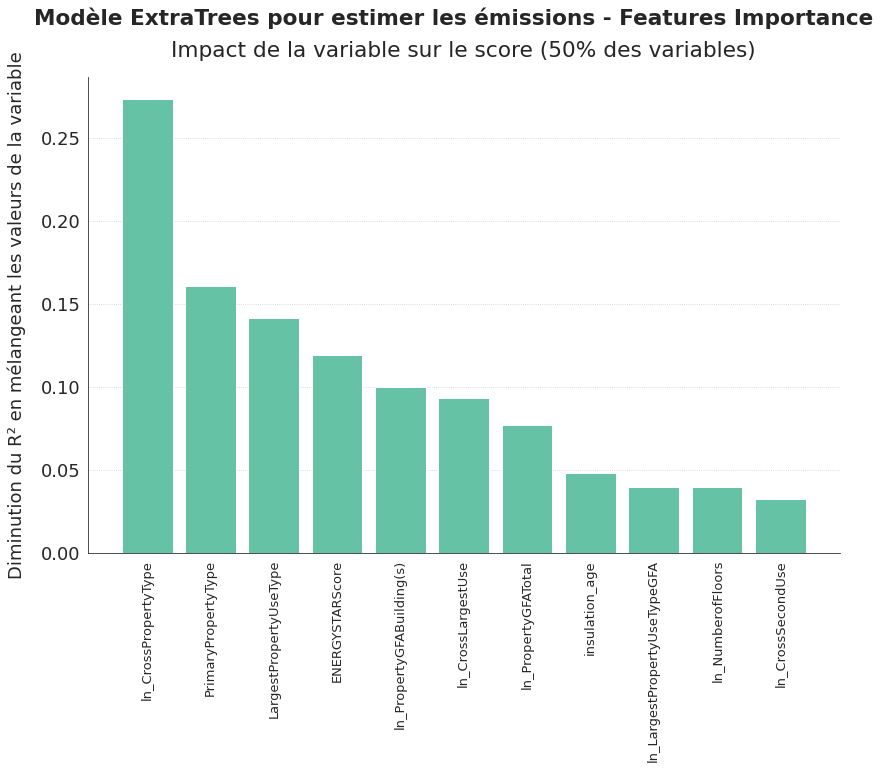

In [ ]:
fig, ax = graph_importance(feat_imp3, "importance", "Impact de la variable sur le score", "ExtraTrees", 
                           "les émissions", horizontal=False, fontsize=13)
ax[0].set_ylabel("Diminution du R² en mélangeant les valeurs de la variable")
plt.show()

**Importance des variables calculée par le modèle ExtraTrees**

Elle correspond à la contribution de chaque variable à la réduction totale de la perte. Leur somme est égale à 1.

In [ ]:
transformed_data = emissions_pipeline.fit_transform(X_train_emissions, ln_y_train_emissions)
feat_imp = pd.DataFrame({'importance': reg.feature_importances_}, index=transformed_data.columns)
feat_imp.sort_values("importance", ascending=False)

,importance
ln_CrossPropertyType,0.204715
ln_CrossLargestUse,0.109359
PrimaryPropertyType,0.105545
ln_PropertyGFABuilding(s),0.095362
LargestPropertyUseType,0.090738
ln_PropertyGFATotal,0.085272
ENERGYSTARScore,0.059112
ln_LargestPropertyUseTypeGFA,0.041592
insulation_age,0.033854
ln_NumberofFloors,0.028007


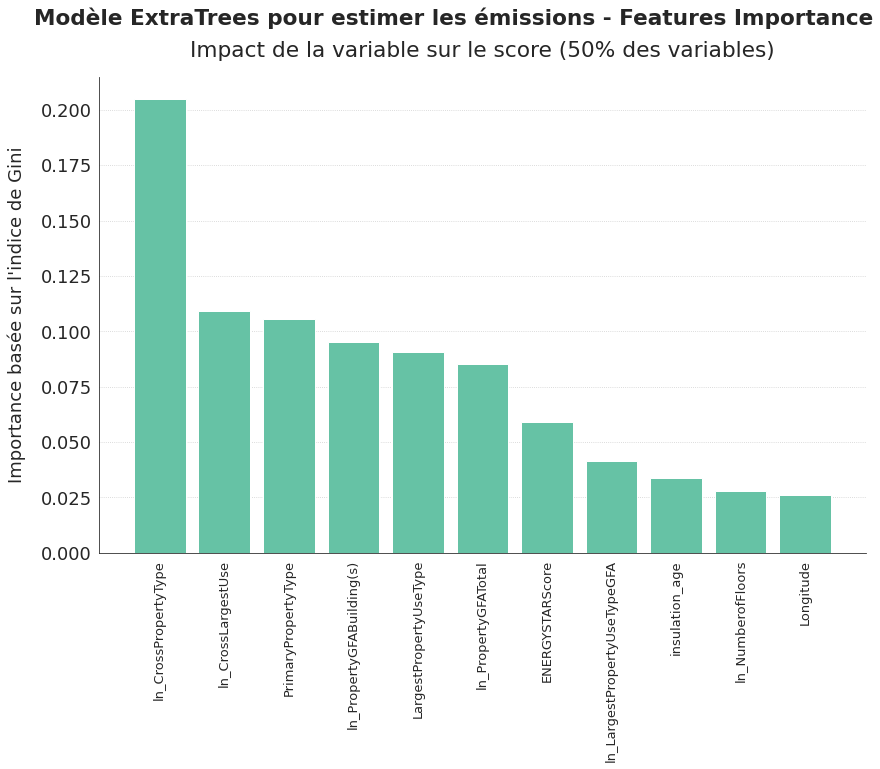

In [ ]:
fig, ax = graph_importance(feat_imp, "importance", "Impact de la variable sur le score", "ExtraTrees", 
                           "les émissions", horizontal=False, fontsize=13)
ax[0].set_ylabel("Importance basée sur l'indice de Gini")
plt.show()

<a id='5_5_3'></a>

#### 5.5.3. ExtraTrees : Affiner le nombre d'estimateurs

Est-ce que je peux améliorer le score en augmentant le nombre d'estimateurs, sans trop pénaliser le temps d'entraînement ?  
Exceptionnellement, j'utilise un gridsearch avec validation croisée pour cette recherche.

In [ ]:
# emissions_pipeline for ExtraTrees
emissions_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_mean), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1)),
    ('data_encoders', FitToPandas(encoder_leaveoneout, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=True, keep_all=True)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler()))
])
ext = ExtraTreesRegressor(n_jobs=-1, random_state=42,
                          max_depth=18, min_samples_split=6, min_samples_leaf=1,
                          max_features=1.0, bootstrap=True)

In [ ]:
param_grid = {'n_estimators' : np.arange(50, 501, 10, dtype=int)}
myshuffle = KFold(n_splits=5, shuffle=True, random_state=42)
gridsearch = GridSearchCV(ext, param_grid, scoring='r2', n_jobs=-1, cv=myshuffle, return_train_score=True)

In [ ]:
start_time = timer()
transformed_data = emissions_pipeline.fit_transform(X_train_emissions, ln_y_train_emissions)
transformed_data = transformed_data.astype(np.number)
transfo_time = timer() - start_time

In [ ]:
gridsearch.fit(transformed_data, ln_y_train_emissions)

GridSearchCV(cv=KFold(n_splits=5, random_state=42, shuffle=True),
             error_score=nan,
             estimator=ExtraTreesRegressor(bootstrap=True, ccp_alpha=0.0,
                                           criterion='mse', max_depth=18,
                                           max_features=1.0,
                                           max_leaf_nodes=None,
                                           max_samples=None,
                                           min_impurity_decrease=0.0,
                                           min_impurity_split=None,
                                           min_samples_leaf=1,
                                           min_samples_split=6,
                                           min_weight_fraction_leaf=0.0,
                                           n_estimator...
                                           verbose=0, warm_start=False),
             iid='deprecated', n_jobs=-1,
             param_grid={'n_estimators': array([ 50,  60,  

In [ ]:
gridsearch.best_score_

0.557859145836565

In [ ]:
gridsearch.best_params_

{'n_estimators': 130}

In [ ]:
cv_results = pd.DataFrame(gridsearch.cv_results_)
cv_results.head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_estimators,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,0.338802,0.003272,0.103643,0.000405,50,{'n_estimators': 50},0.509291,0.538628,0.630917,0.506016,0.557982,0.548567,0.045436,46,0.865246,0.863513,0.853168,0.865886,0.863525,0.862267,0.004646
1,0.340600,0.013435,0.103407,0.000082,60,{'n_estimators': 60},0.517562,0.543814,0.636706,0.508500,0.562749,0.553866,0.045647,44,0.866790,0.862435,0.854759,0.866737,0.864060,0.862956,0.004420
2,0.342420,0.018103,0.106483,0.003186,70,{'n_estimators': 70},0.520961,0.537994,0.637028,0.506857,0.563848,0.553338,0.045954,45,0.867396,0.863206,0.856544,0.867092,0.863358,0.863519,0.003913
3,0.348973,0.010338,0.104889,0.001342,80,{'n_estimators': 80},0.523030,0.542064,0.637642,0.509991,0.562959,0.555137,0.044963,43,0.868190,0.864173,0.856512,0.868243,0.864927,0.864409,0.004282
4,0.355194,0.011451,0.106015,0.001697,90,{'n_estimators': 90},0.528554,0.545676,0.637930,0.507528,0.562485,0.556435,0.044639,39,0.868919,0.864839,0.858249,0.868797,0.865472,0.865255,0.003880


In [ ]:
cv_results.columns = cv_results.columns.str.replace("mean_test_score", "valid_score_mean")
cv_results.columns = cv_results.columns.str.replace("mean_train_score", "train_score_mean")
cv_results.columns = cv_results.columns.str.replace("mean_fit_time", "train_time_mean")
cv_results.columns = cv_results.columns.str.replace("mean_score_time", "valid_time_mean")
cv_results["data_transfo_time"] = transfo_time
cv_results["total_time"] = cv_results.data_transfo_time + cv_results.valid_time_mean
cv_results.head()

,train_time_mean,std_fit_time,valid_time_mean,std_score_time,param_n_estimators,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,valid_score_mean,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,train_score_mean,std_train_score,data_transfo_time,total_time
0,0.338802,0.003272,0.103643,0.000405,50,{'n_estimators': 50},0.509291,0.538628,0.630917,0.506016,0.557982,0.548567,0.045436,46,0.865246,0.863513,0.853168,0.865886,0.863525,0.862267,0.004646,0.267231,0.370875
1,0.340600,0.013435,0.103407,0.000082,60,{'n_estimators': 60},0.517562,0.543814,0.636706,0.508500,0.562749,0.553866,0.045647,44,0.866790,0.862435,0.854759,0.866737,0.864060,0.862956,0.004420,0.267231,0.370639
2,0.342420,0.018103,0.106483,0.003186,70,{'n_estimators': 70},0.520961,0.537994,0.637028,0.506857,0.563848,0.553338,0.045954,45,0.867396,0.863206,0.856544,0.867092,0.863358,0.863519,0.003913,0.267231,0.373715
3,0.348973,0.010338,0.104889,0.001342,80,{'n_estimators': 80},0.523030,0.542064,0.637642,0.509991,0.562959,0.555137,0.044963,43,0.868190,0.864173,0.856512,0.868243,0.864927,0.864409,0.004282,0.267231,0.372120
4,0.355194,0.011451,0.106015,0.001697,90,{'n_estimators': 90},0.528554,0.545676,0.637930,0.507528,0.562485,0.556435,0.044639,39,0.868919,0.864839,0.858249,0.868797,0.865472,0.865255,0.003880,0.267231,0.373246


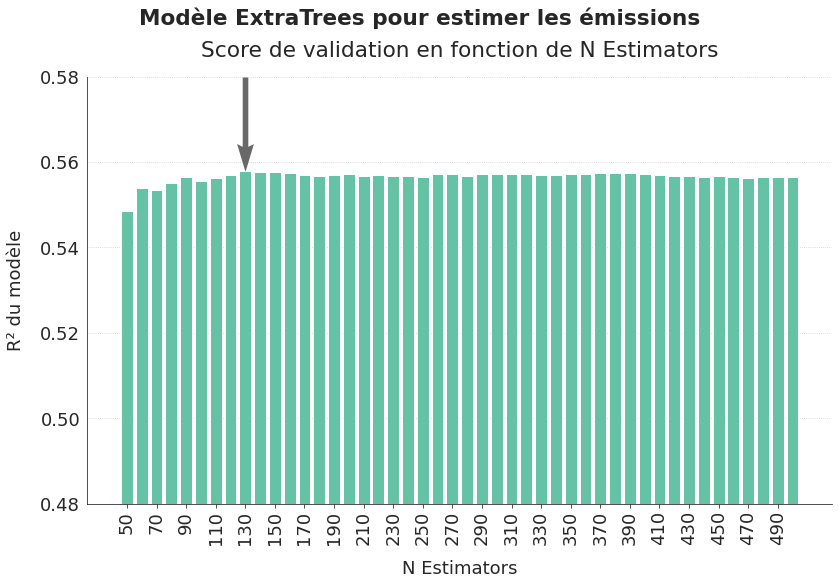

In [ ]:
fig, ax = graph_modele_score(cv_results, "param_n_estimators", "ExtraTrees", "N Estimators",
                                   "les émissions", ymin=0.48, ymax=0.58, tick_step=2, rotation=90)
save_fig("ml03_2_46_ext6a")
plt.show()

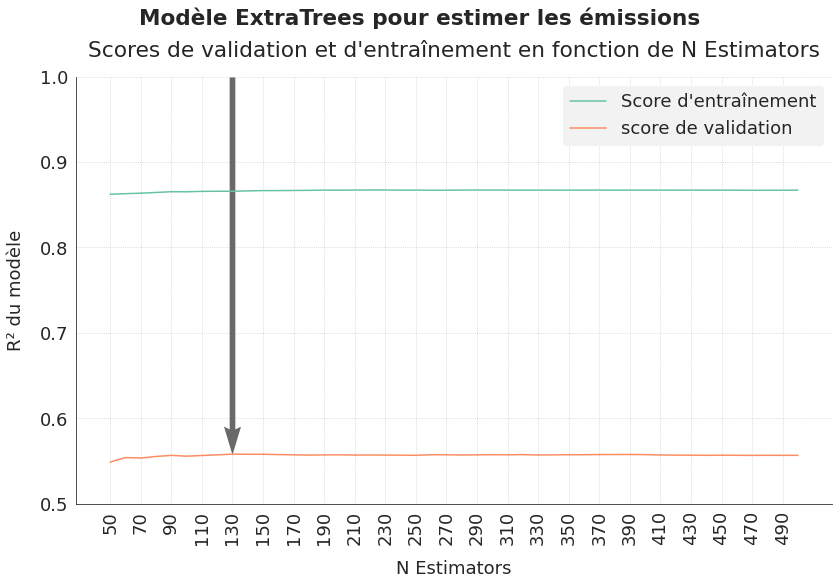

In [ ]:
fig, ax = graph_compar_train_valid(cv_results, "param_n_estimators", "ExtraTrees", "N Estimators",
                                   "les émissions", ymin=0.5, ymax=1, tick_step=2, rotation=90)
save_fig("ml03_2_46_ext6b")
plt.show()

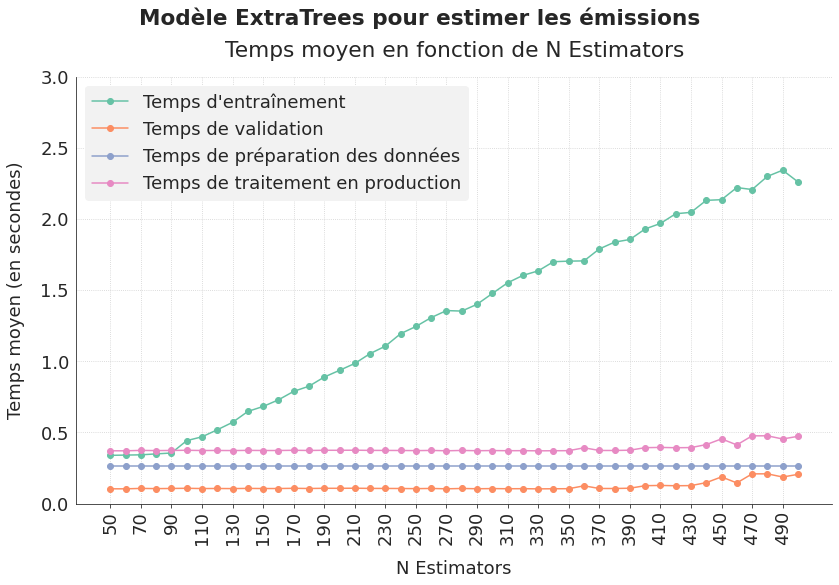

In [ ]:
fig, ax = graph_modele_time(cv_results, "param_n_estimators", "ExtraTrees", "N Estimators",
                                   "les émissions", ymin=0.0, ymax=3, tick_step=2, rotation=90)
save_fig("ml03_2_46_ext6c")
plt.show()

Mon modèle finale d'ExtraTrees comporte 130 estimateurs.

<a id='5_5_4'></a>

#### 5.5.4. XGBoost : première étape

Pour commencer, je cherche à optimiser les hyperparamètres de XGBoost liés à la descente de gradient (objective, n_estimators et learning_rate).

In [ ]:
# emissions_pipeline for XGBRegressor
emissions_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_mean), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1)),
    ('data_encoders', FitToPandas(encoder_leaveoneout, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=True, keep_all=True)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler()))
])
reg_pipeline = Pipeline([('estimator', XGBRegressor(n_jobs=-1, random_state=42))])

In [ ]:
space = {
    'estimator__objective': hp.choice('estimator__objective', ['reg:squarederror','reg:gamma','reg:tweedie']),
    'estimator__n_estimators': hp.choice('estimator__n_estimators', np.arange(10, 201, 10, dtype=int)),
    'estimator__learning_rate': hp.choice('estimator__learning_rate', np.arange(0.05, 0.31, 0.01))
}

In [ ]:
list_best_results = []

In [ ]:
estimator_name = 'xgboost'
step = 'final1a'
run_emissions_optimization(max_evals=400, prefix=step, estimator_name=estimator_name)

100%|██████████| 400/400 [05:29<00:00,  1.21it/s, best loss: -0.5531093377646519]
Estimateur : xgboost - Done
Best cross-validation mean score = 0.5531093377646519
Associated standard deviation = 0.055937801216089496
Calculation time = 0.004306793212890625
Data preparation time = 0.2516859530005604
Best cv score obtained after 108 iterations



In [ ]:
xgb_emissions_first_stepa = pd.read_csv("hyperopt_emissions_xgboost_final1a.csv")
xgb_emissions_first_stepa.head()

,valid_score_mean,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,data_transfo_time,estimator,iteration
0,-1.000000,0.000000,0.000000,-1.00000,0.000000,0.008280,0.268650,"XGBRegressor(base_score=0.5, booster='gbtree',...",1
1,-1.000000,0.000000,0.000000,-1.00000,0.000000,0.006722,0.247255,"XGBRegressor(base_score=0.5, booster='gbtree',...",2
2,-1.000000,0.000000,0.000000,-1.00000,0.000000,0.006574,0.251586,"XGBRegressor(base_score=0.5, booster='gbtree',...",3
3,0.536878,0.061342,0.003231,0.78982,0.007517,0.129470,0.258169,"XGBRegressor(base_score=0.5, booster='gbtree',...",4
4,-1.000000,0.000000,0.000000,-1.00000,0.000000,0.006652,0.250449,"XGBRegressor(base_score=0.5, booster='gbtree',...",5


In [ ]:
xgb_emissions_first_stepa = remove_negative_scores(xgb_emissions_first_stepa)
inter_str = [inter[inter.find('objective')+11:] for inter in xgb_emissions_first_stepa.estimator]
xgb_emissions_first_stepa["xgb_objective"] = [inter[:inter.find(',')-1] for inter in inter_str]
inter_str = [inter[inter.find('n_estimators')+13:] for inter in xgb_emissions_first_stepa.estimator]
xgb_emissions_first_stepa["xgb_n_estimators"] = [np.int(inter[:inter.find(',')]) for inter in inter_str]
inter_str = [inter[inter.find('learning_rate')+14:] for inter in xgb_emissions_first_stepa.estimator]
xgb_emissions_first_stepa["xgb_learning_rate"] = [np.around(np.float(inter[:inter.find(',')]),2) for inter in inter_str]
xgb_emissions_first_stepa["total_time"] = xgb_emissions_first_stepa.valid_time_mean + xgb_emissions_first_stepa.data_transfo_time

In [ ]:
xgb_emissions_first_stepa[["valid_score_mean","train_score_mean","iteration",
                      "xgb_objective","xgb_n_estimators","xgb_learning_rate","total_time"]].\
                    sort_values("valid_score_mean", ascending=False).head(10)

,valid_score_mean,train_score_mean,iteration,xgb_objective,xgb_n_estimators,xgb_learning_rate,total_time
155,0.553109,0.727396,156,reg:squarederror,150,0.07,0.253759
161,0.553109,0.727396,162,reg:squarederror,150,0.07,0.252483
260,0.553109,0.727396,261,reg:squarederror,150,0.07,0.256853
259,0.553109,0.727396,260,reg:squarederror,150,0.07,0.259527
258,0.553109,0.727396,259,reg:squarederror,150,0.07,0.251437
257,0.553109,0.727396,258,reg:squarederror,150,0.07,0.255833
385,0.553109,0.727396,386,reg:squarederror,150,0.07,0.247915
249,0.553109,0.727396,250,reg:squarederror,150,0.07,0.249852
210,0.553109,0.727396,211,reg:squarederror,150,0.07,0.258501
190,0.553109,0.727396,191,reg:squarederror,150,0.07,0.252769


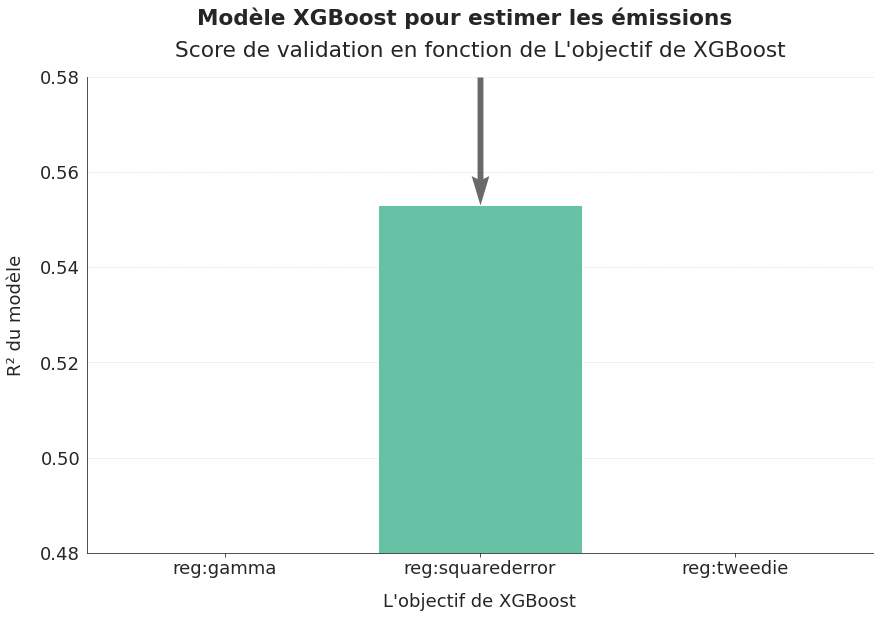

In [ ]:
fig, ax = graph_modele_score(xgb_emissions_first_stepa, "xgb_objective", "XGBoost", "L'objectif de XGBoost",
                             "les émissions", ymin=0.48, ymax=0.58)
plt.show()

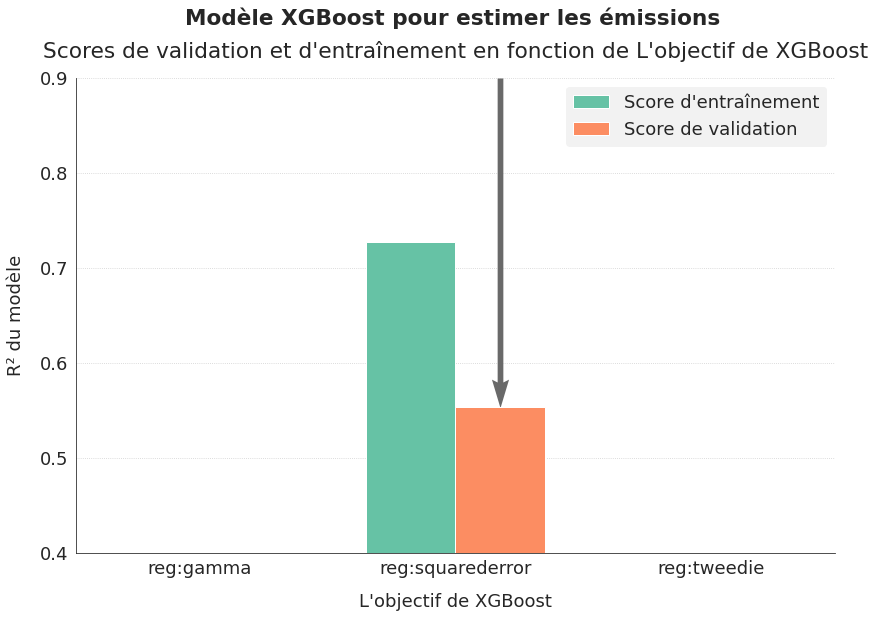

In [ ]:
fig, ax = graph_compar_train_valid(xgb_emissions_first_stepa, "xgb_objective", "XGBoost", "L'objectif de XGBoost", 
                                   "les émissions", ymin=0.4, ymax=0.9, rotation=0, with_bars=True)
plt.show()

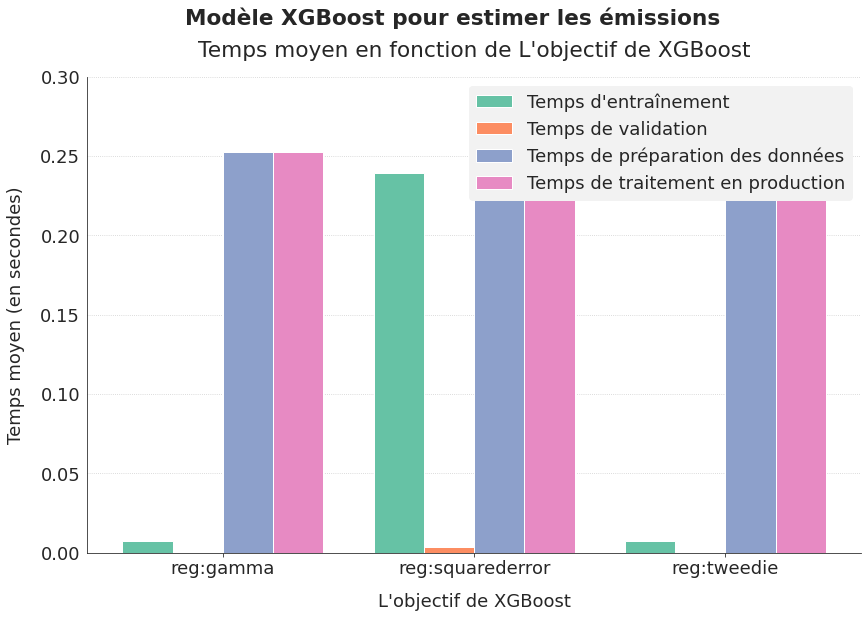

In [ ]:
fig, ax = graph_modele_time(xgb_emissions_first_stepa, "xgb_objective", "XGBoost", "L'objectif de XGBoost", 
                           "les émissions", ymax=0.3, with_bars=True)
plt.show()

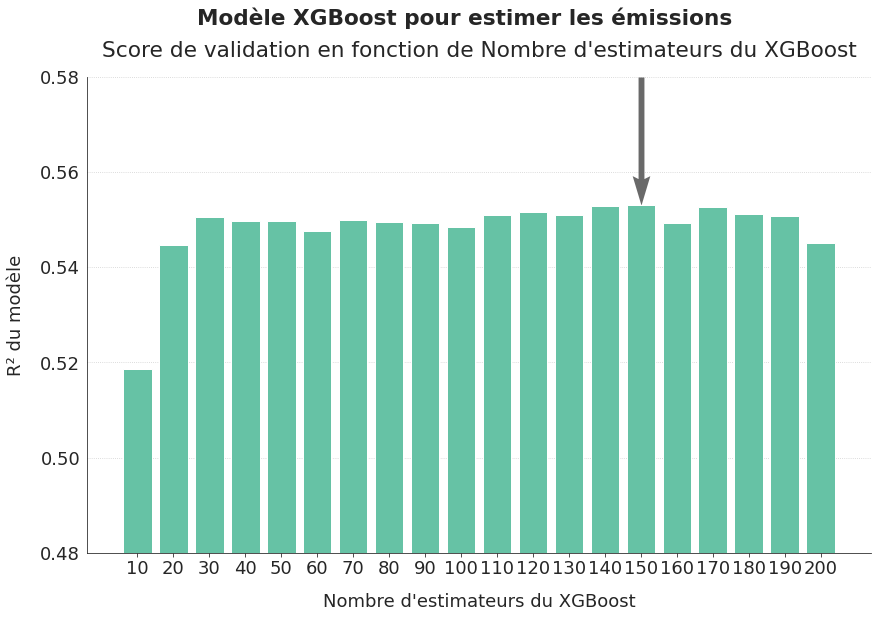

In [ ]:
fig, ax = graph_modele_score(xgb_emissions_first_stepa, "xgb_n_estimators", "XGBoost", "Nombre d'estimateurs du XGBoost",
                             "les émissions", ymin=0.48, ymax=0.58)
plt.show()

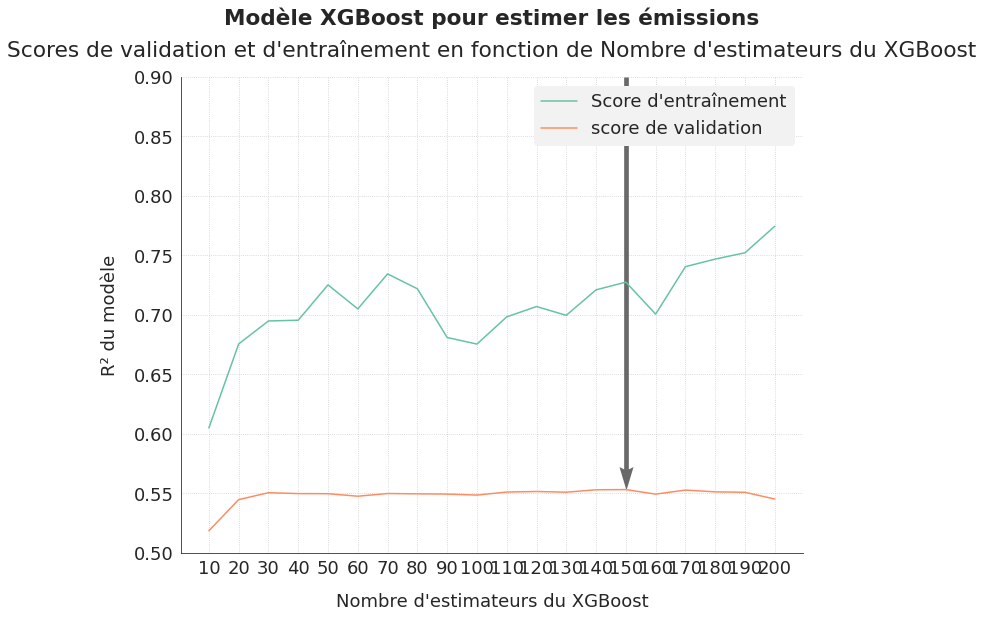

In [ ]:
fig, ax = graph_compar_train_valid(xgb_emissions_first_stepa, "xgb_n_estimators", "XGBoost", "Nombre d'estimateurs du XGBoost", 
                                   "les émissions", ymin=0.5, ymax=0.9, rotation=0)
plt.show()

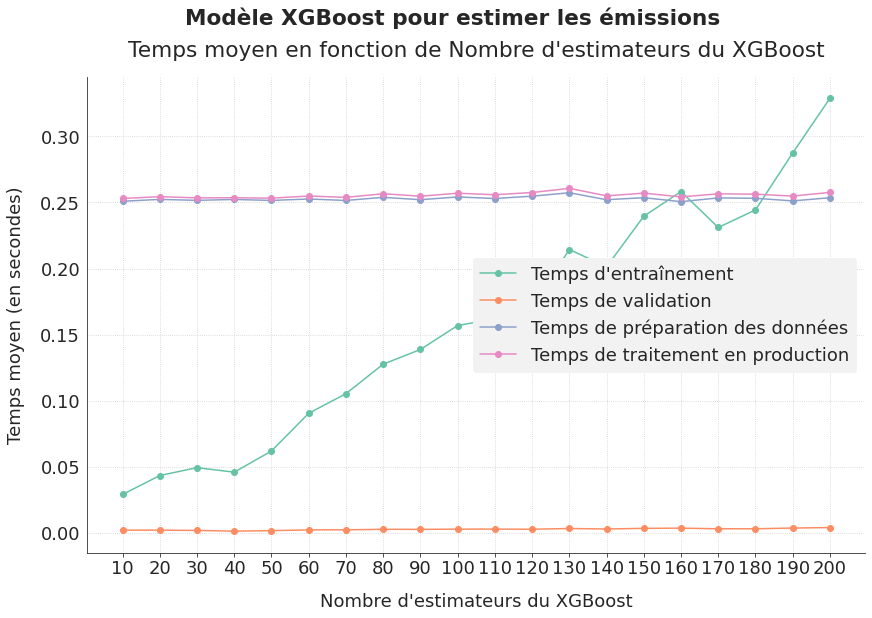

In [ ]:
fig, ax = graph_modele_time(xgb_emissions_first_stepa, "xgb_n_estimators", "XGBoost", "Nombre d'estimateurs du XGBoost",
                            "les émissions")
plt.show()

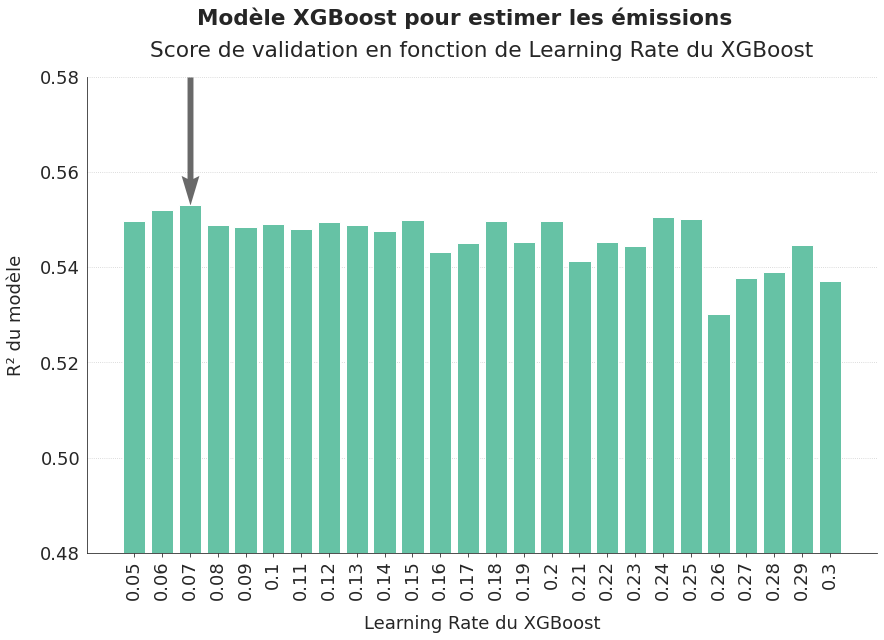

In [ ]:
fig, ax = graph_modele_score(xgb_emissions_first_stepa, "xgb_learning_rate", "XGBoost", "Learning Rate du XGBoost",
                             "les émissions", ymin=0.48, ymax=0.58, rotation=90)
plt.show()

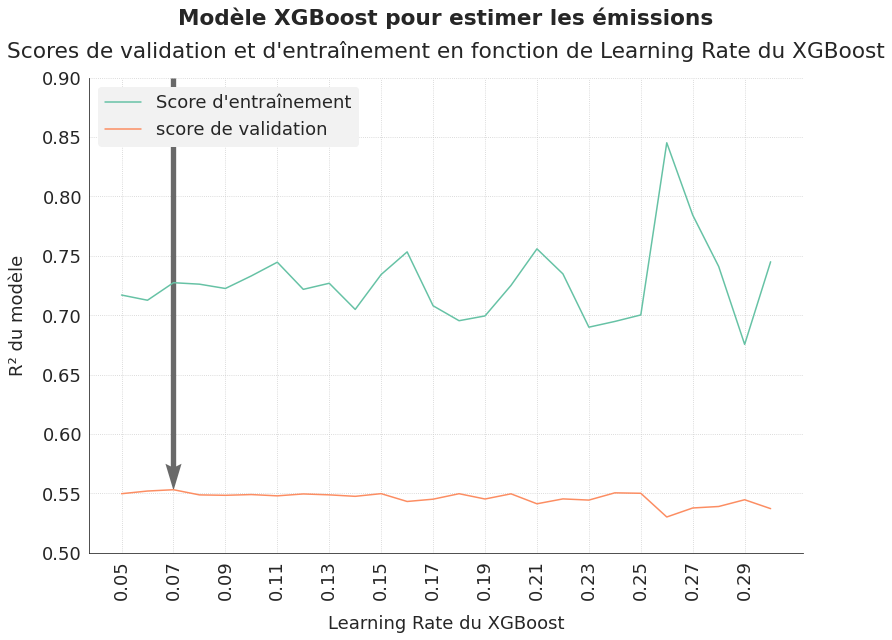

In [ ]:
fig, ax = graph_compar_train_valid(xgb_emissions_first_stepa, "xgb_learning_rate", "XGBoost", "Learning Rate du XGBoost", 
                                   "les émissions", ymin=0.5, ymax=0.9, tick_step=2, rotation=90)
plt.show()

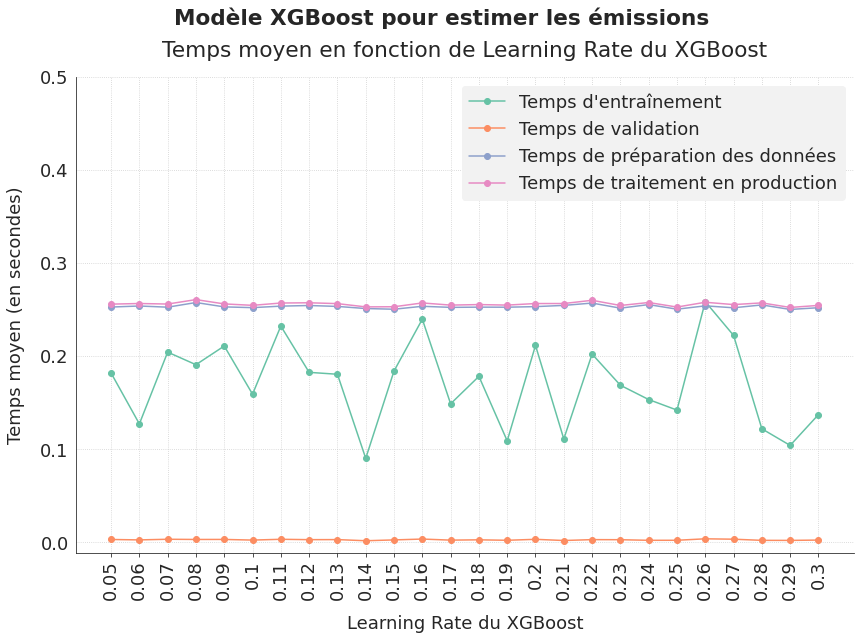

In [ ]:
fig, ax = graph_modele_time(xgb_emissions_first_stepa, "xgb_learning_rate", "XGBoost", "Learning Rate du XGBoost", 
                           "les émissions", ymax=0.5, rotation=90)
plt.show()

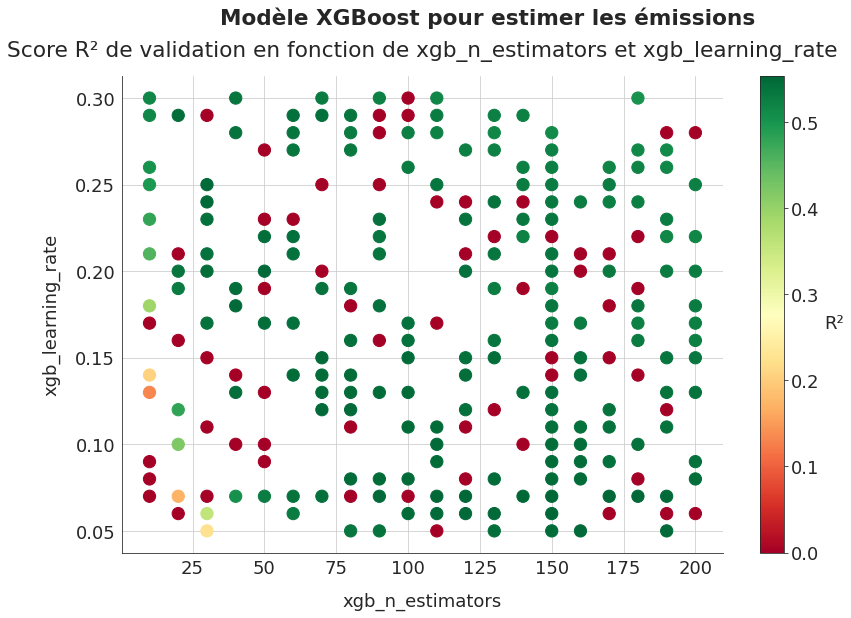

In [ ]:
fig, ax = graph_cross_score(xgb_emissions_first_stepa, "xgb_n_estimators", "xgb_learning_rate", "XGBoost",
                            "les émissions", size=150)

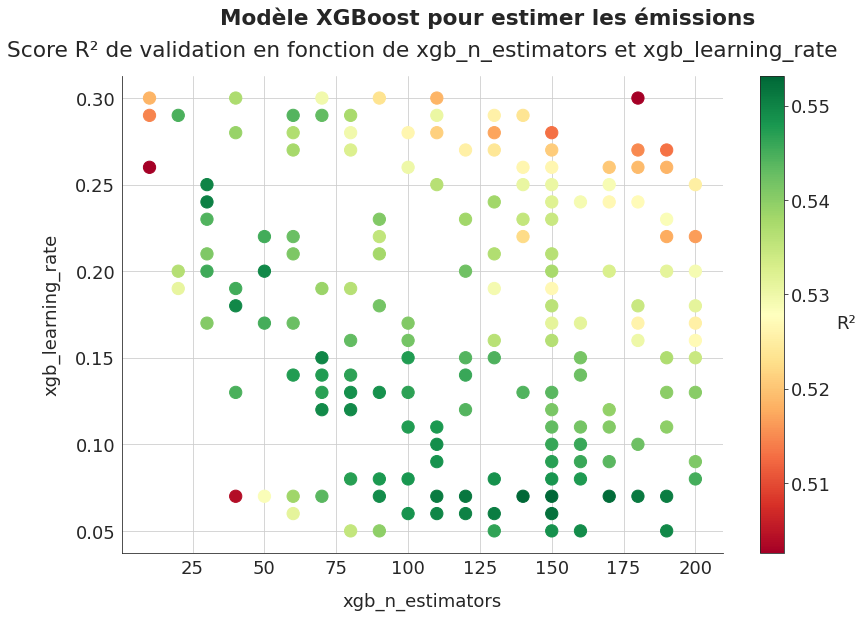

In [ ]:
fig, ax = graph_cross_score(xgb_emissions_first_stepa, "xgb_n_estimators", "xgb_learning_rate", "XGBoost",
                            "les émissions", size=150, vmin=0.5)

<a id='5_5_5'></a>

#### 5.5.5. XGBoost : deuxième étape

J'optimise les hyperparamètres de XGBoost liés aux arbres de décision : max_depth, min_child_weight, colsample_bytree, subsample et gamma.

In [ ]:
# emissions_pipeline for XGBRegressor
emissions_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_mean), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1)),
    ('data_encoders', FitToPandas(encoder_leaveoneout, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=True, keep_all=True)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler()))
])
reg_pipeline = Pipeline([('estimator', XGBRegressor(n_jobs=-1, random_state=42))])

In [ ]:
space = {
    'estimator__objective': 'reg:squarederror',
    'estimator__n_estimators': 150,
    'estimator__learning_rate': 0.07,
    'estimator__max_depth': hp.choice('estimator__max_depth', np.arange(3, 16, 1, dtype=int)),
    'estimator__min_child_weight': hp.choice('estimator__min_child_weight', np.arange(0, 11, 1, dtype=int)),
    'estimator__colsample_bytree': hp.uniform('estimator__colsample_bytree', 0.3, 1),
    'estimator__subsample': hp.uniform('estimator__subsample', 0.5, 1),
    'estimator__gamma': hp.uniform('estimator__gamma', 0.0, 0.5)
}

In [ ]:
list_best_results = []

In [ ]:
estimator_name = 'xgboost'
step = 'final2a'
run_emissions_optimization(max_evals=400, prefix=step, estimator_name=estimator_name)

100%|██████████| 400/400 [11:40<00:00,  1.75s/it, best loss: -0.5628762576359299]
Estimateur : xgboost - Done
Best cross-validation mean score = 0.5628762576359299
Associated standard deviation = 0.05158417674209297
Calculation time = 0.004378414154052735
Data preparation time = 0.24766436999925645
Best cv score obtained after 201 iterations



In [ ]:
xgb_emissions_second_stepa = pd.read_csv("hyperopt_emissions_xgboost_final2a.csv")
xgb_emissions_second_stepa.head()

,valid_score_mean,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,data_transfo_time,estimator,iteration
0,0.531668,0.053841,0.009047,0.966095,0.000881,0.672010,0.250151,"XGBRegressor(base_score=0.5, booster='gbtree',...",1
1,0.531726,0.053802,0.007951,0.965774,0.001307,0.629234,0.268919,"XGBRegressor(base_score=0.5, booster='gbtree',...",2
2,0.516563,0.057692,0.007992,0.989257,0.000391,1.082271,0.246005,"XGBRegressor(base_score=0.5, booster='gbtree',...",3
3,0.534837,0.046772,0.008991,0.979979,0.000555,0.625632,0.248810,"XGBRegressor(base_score=0.5, booster='gbtree',...",4
4,0.512333,0.062368,0.008312,0.979221,0.000750,1.026806,0.253748,"XGBRegressor(base_score=0.5, booster='gbtree',...",5


In [ ]:
xgb_emissions_second_stepa = remove_negative_scores(xgb_emissions_second_stepa)
inter_str = [inter[inter.find('max_depth')+10:] for inter in xgb_emissions_second_stepa.estimator]
xgb_emissions_second_stepa["xgb_max_depth"] = [np.int(inter[:inter.find(',')]) for inter in inter_str]
inter_str = [inter[inter.find('child_weight')+13:] for inter in xgb_emissions_second_stepa.estimator]
xgb_emissions_second_stepa["xgb_min_child_weight"] = [np.int(inter[:inter.find(',')]) for inter in inter_str]
inter_str = [inter[inter.find('colsample_bytree')+17:] for inter in xgb_emissions_second_stepa.estimator]
xgb_emissions_second_stepa["xgb_colsample_bytree"] = [np.around(np.float(inter[:inter.find(',')]),5) for inter in inter_str]
inter_str = [inter[inter.find('subsample')+10:] for inter in xgb_emissions_second_stepa.estimator]
xgb_emissions_second_stepa["xgb_subsample"] = [np.around(np.float(inter[:inter.find(',')]),5) for inter in inter_str]
inter_str = [inter[inter.find('gamma')+6:] for inter in xgb_emissions_second_stepa.estimator]
xgb_emissions_second_stepa["xgb_gamma"] = [np.around(np.float(inter[:inter.find(',')]),5) for inter in inter_str]
xgb_emissions_second_stepa["total_time"] = xgb_emissions_second_stepa.valid_time_mean + xgb_emissions_second_stepa.data_transfo_time

In [ ]:
xgb_emissions_second_stepa[["valid_score_mean","train_score_mean","iteration", "xgb_max_depth",
                       "xgb_min_child_weight","xgb_colsample_bytree","xgb_subsample","xgb_gamma","total_time"]].\
                    sort_values("valid_score_mean", ascending=False).head(10)

,valid_score_mean,train_score_mean,iteration,xgb_max_depth,xgb_min_child_weight,xgb_colsample_bytree,xgb_subsample,xgb_gamma,total_time
200,0.562876,0.708491,201,3,10,0.41068,0.65941,0.07140,0.252043
149,0.562406,0.716298,150,3,8,0.46271,0.67930,0.19113,0.259243
132,0.562054,0.715207,133,3,10,0.56359,0.66947,0.12874,0.254970
128,0.561666,0.718423,129,3,10,0.61557,0.70683,0.10057,0.254385
136,0.561656,0.720531,137,3,8,0.56152,0.66241,0.16535,0.252065
115,0.561575,0.717314,116,3,10,0.54304,0.76677,0.12024,0.254670
349,0.560672,0.718532,350,3,9,0.52654,0.72037,0.30297,0.249707
383,0.560595,0.723458,384,3,7,0.53329,0.70931,0.37636,0.261418
148,0.560392,0.719629,149,3,10,0.67060,0.66514,0.09873,0.250376
252,0.559994,0.719469,253,3,10,0.67956,0.67825,0.22993,0.269018


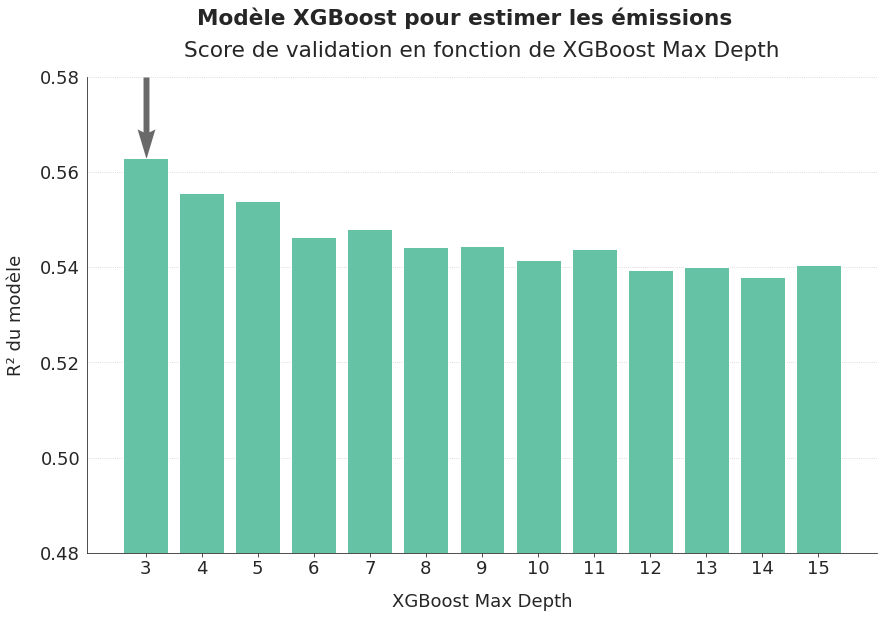

In [ ]:
fig, ax = graph_modele_score(xgb_emissions_second_stepa, "xgb_max_depth", "XGBoost", "XGBoost Max Depth",
                             "les émissions", ymin=0.48, ymax=0.58)
plt.show()

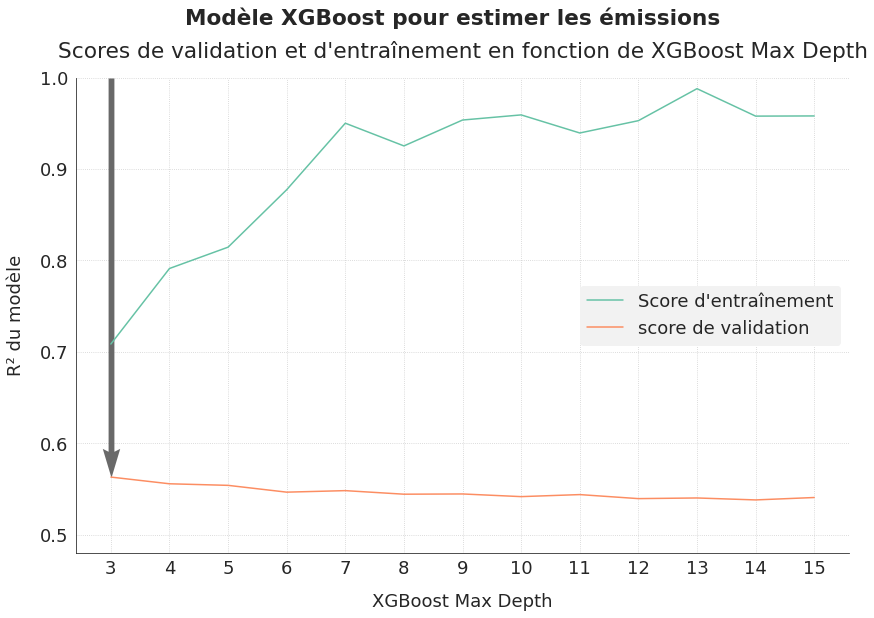

In [ ]:
fig, ax = graph_compar_train_valid(xgb_emissions_second_stepa, "xgb_max_depth", "XGBoost", "XGBoost Max Depth", 
                                   "les émissions", ymin=0.48, rotation=0)
plt.show()

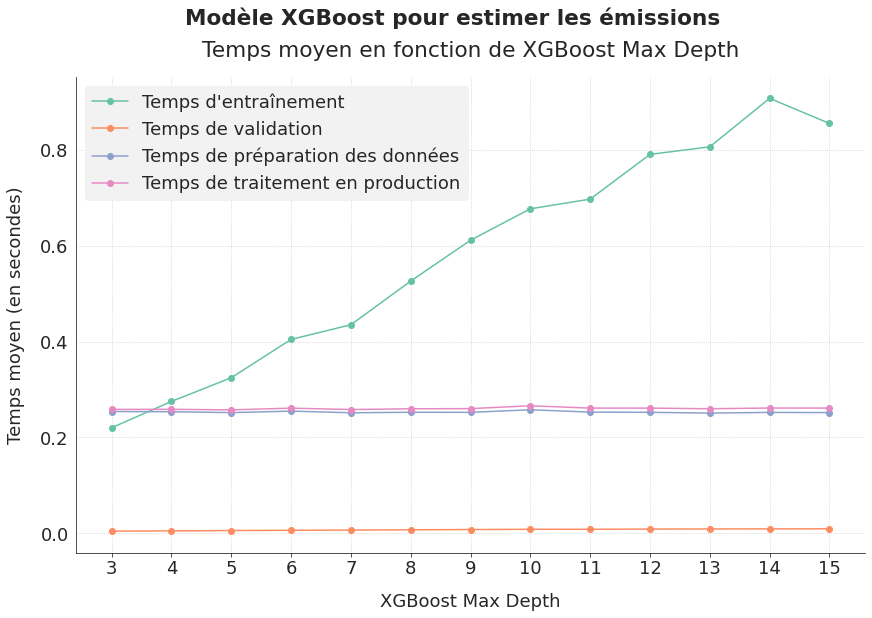

In [ ]:
fig, ax = graph_modele_time(xgb_emissions_second_stepa, "xgb_max_depth", "XGBoost", "XGBoost Max Depth", 
                           "les émissions")
plt.show()

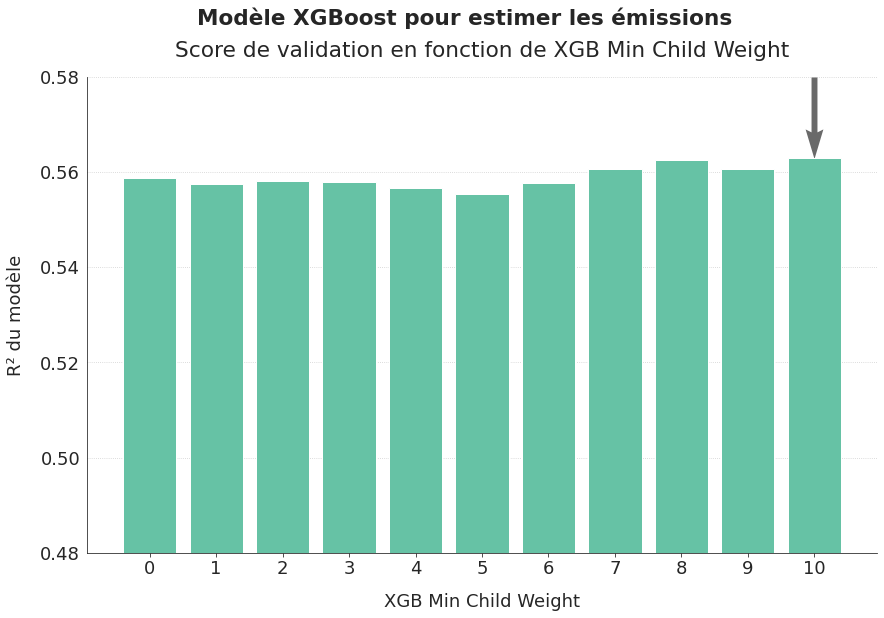

In [ ]:
fig, ax = graph_modele_score(xgb_emissions_second_stepa, "xgb_min_child_weight", "XGBoost", "XGB Min Child Weight",
                             "les émissions", ymin=0.48, ymax=0.58)
plt.show()

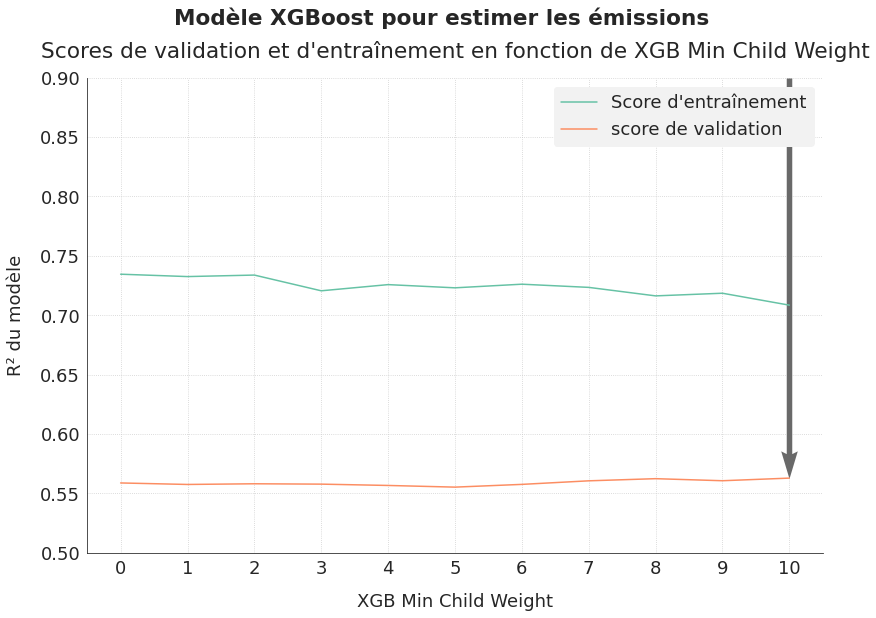

In [ ]:
fig, ax = graph_compar_train_valid(xgb_emissions_second_stepa, "xgb_min_child_weight", "XGBoost", "XGB Min Child Weight", 
                                   "les émissions", ymin=0.5, ymax=0.9, rotation=0)
plt.show()

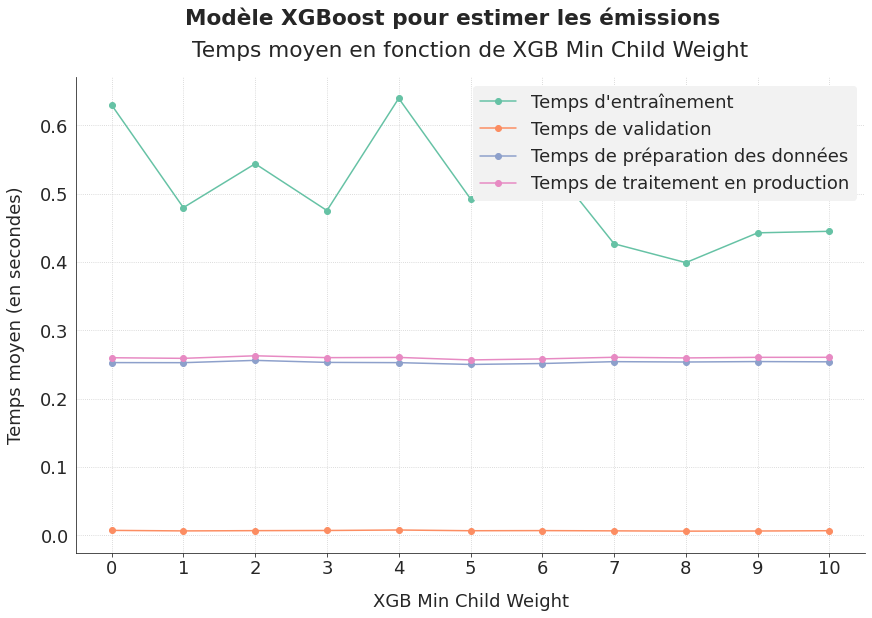

In [ ]:
fig, ax = graph_modele_time(xgb_emissions_second_stepa, "xgb_min_child_weight", "XGBoost", "XGB Min Child Weight", 
                           "les émissions", )
plt.show()

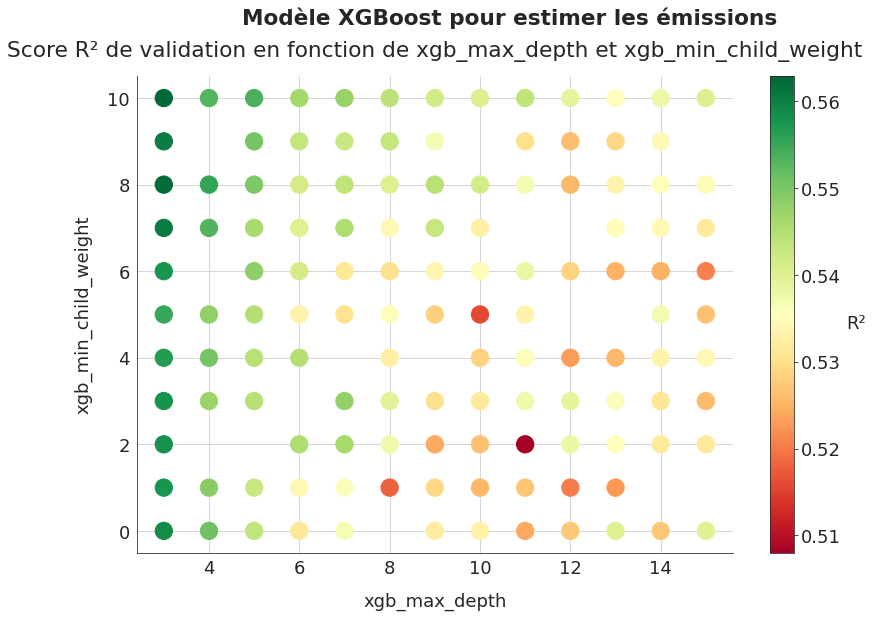

In [ ]:
fig, ax = graph_cross_score(xgb_emissions_second_stepa, "xgb_max_depth", "xgb_min_child_weight", "XGBoost",
                            "les émissions", size=300)

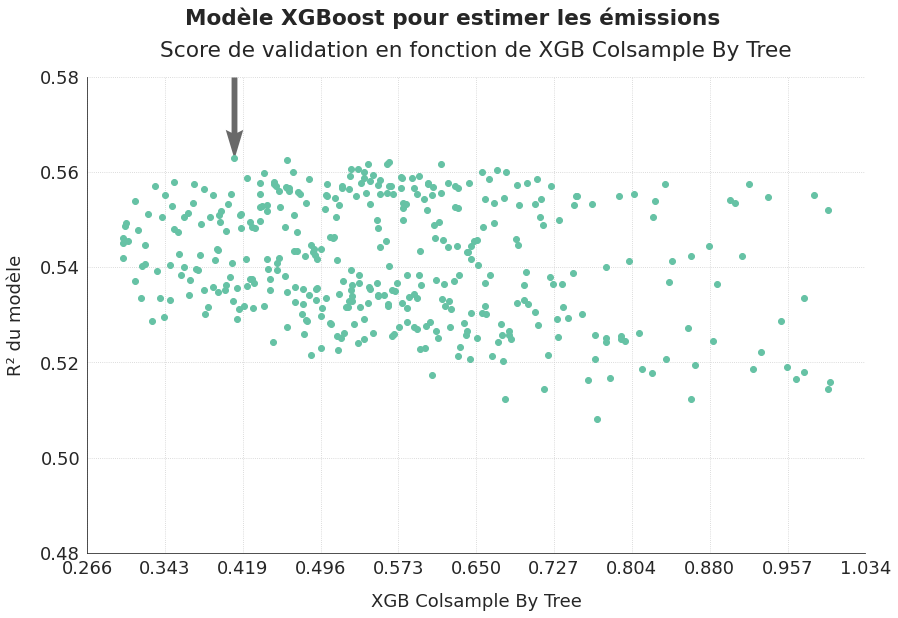

In [ ]:
fig, ax = graph_continu_preview(xgb_emissions_second_stepa, "xgb_colsample_bytree", "XGBoost", "XGB Colsample By Tree",
                              "les émissions", ymin=0.48, ymax=0.58)
plt.show()

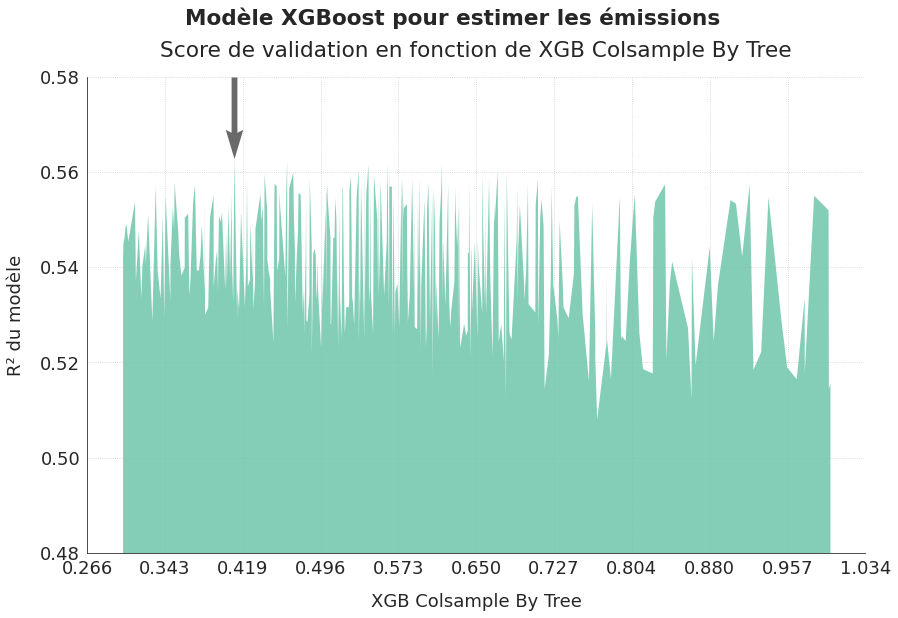

In [ ]:
fig, ax = graph_continu_score(xgb_emissions_second_stepa, "xgb_colsample_bytree", "XGBoost", "XGB Colsample By Tree",
                              "les émissions", ymin=0.48, ymax=0.58)
plt.show()

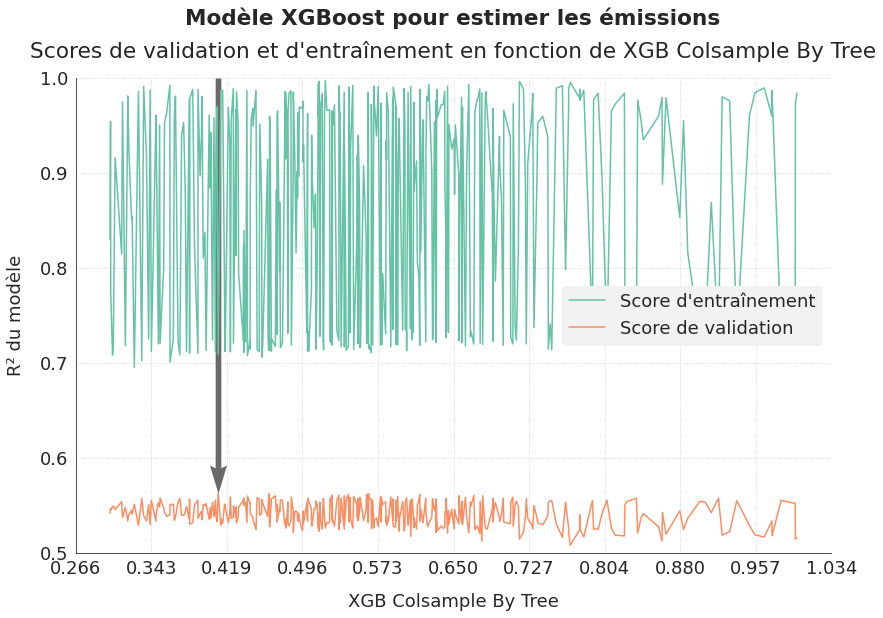

In [ ]:
fig, ax = graph_compar_continu(xgb_emissions_second_stepa, "xgb_colsample_bytree", "XGBoost", "XGB Colsample By Tree",
                                "les émissions", ymin=0.5)
plt.show()

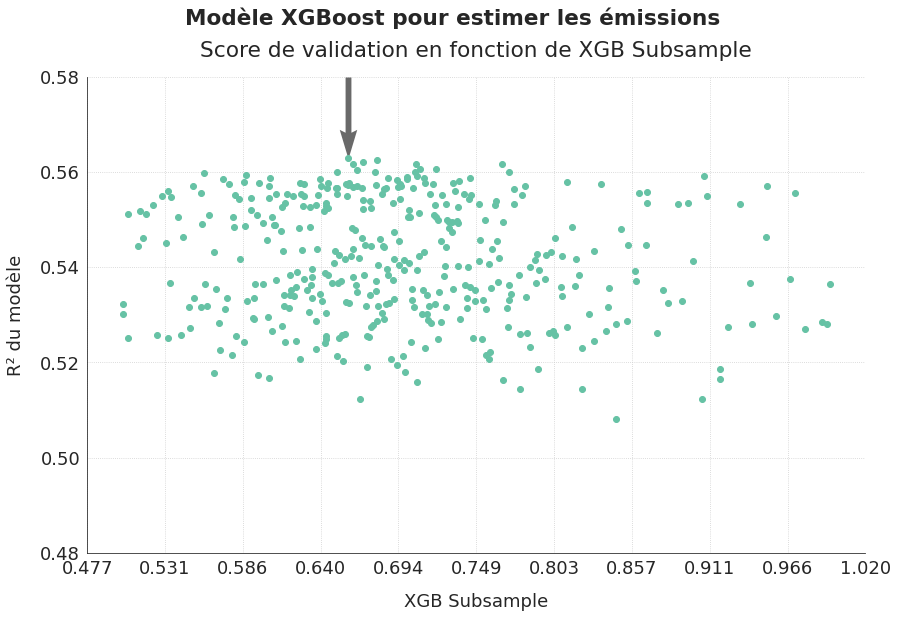

In [ ]:
fig, ax = graph_continu_preview(xgb_emissions_second_stepa, "xgb_subsample", "XGBoost", "XGB Subsample",
                              "les émissions", ymin=0.48, ymax=0.58)
plt.show()

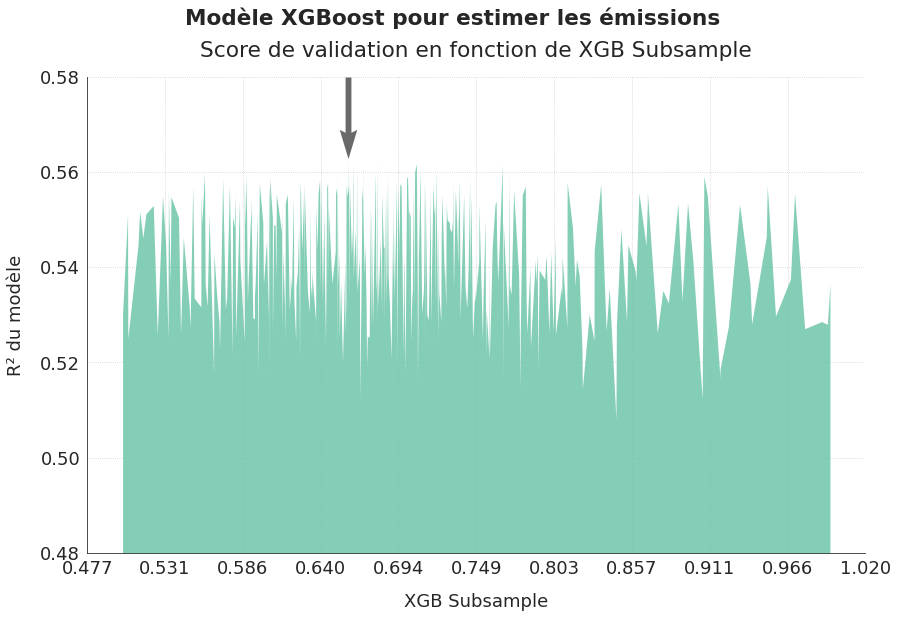

In [ ]:
fig, ax = graph_continu_score(xgb_emissions_second_stepa, "xgb_subsample", "XGBoost", "XGB Subsample",
                              "les émissions", ymin=0.48, ymax=0.58)
plt.show()

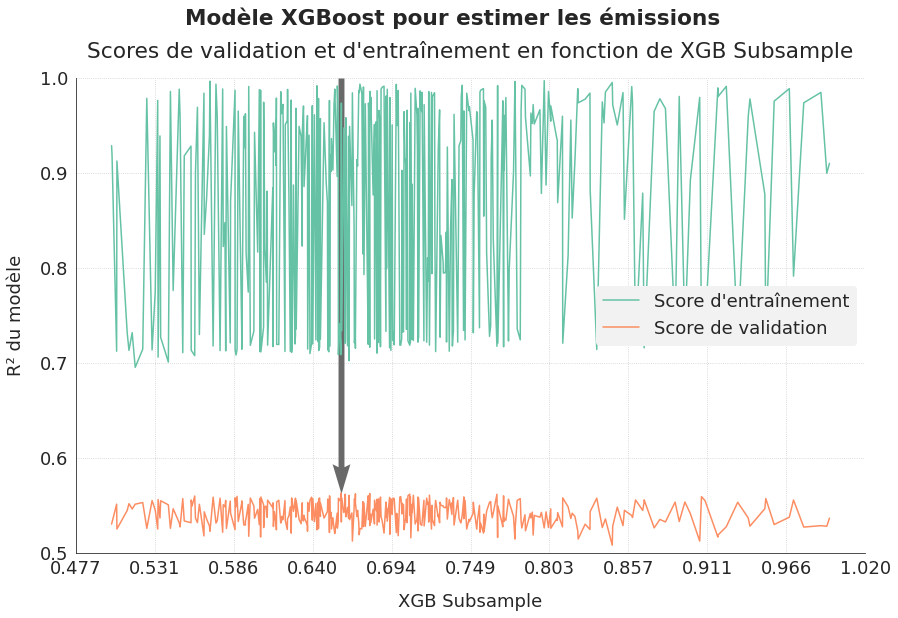

In [ ]:
fig, ax = graph_compar_continu(xgb_emissions_second_stepa, "xgb_subsample", "XGBoost", "XGB Subsample",
                               "les émissions", ymin=0.5)
plt.show()

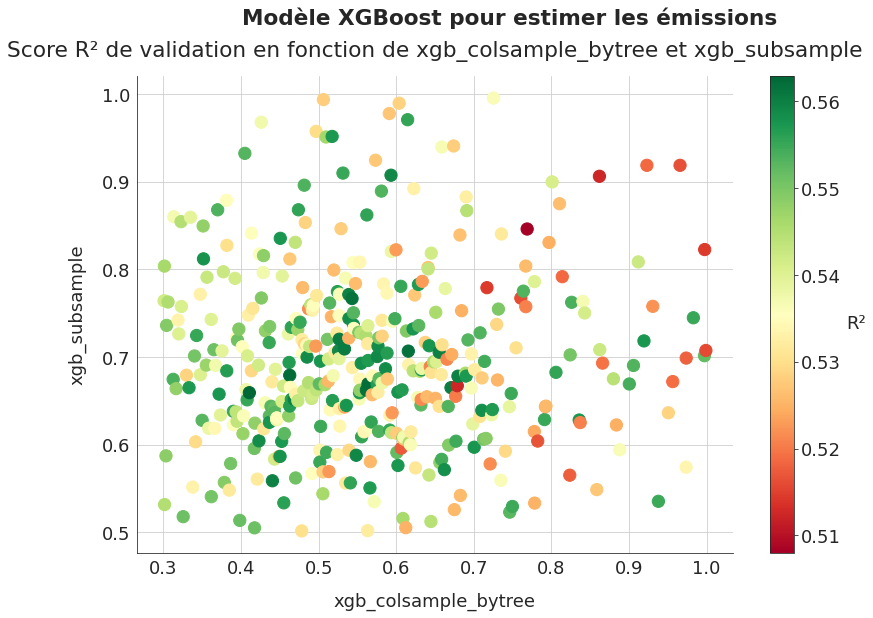

In [ ]:
fig, ax = graph_cross_score(xgb_emissions_second_stepa, "xgb_colsample_bytree", "xgb_subsample", "XGBoost",
                            "les émissions", size=150)

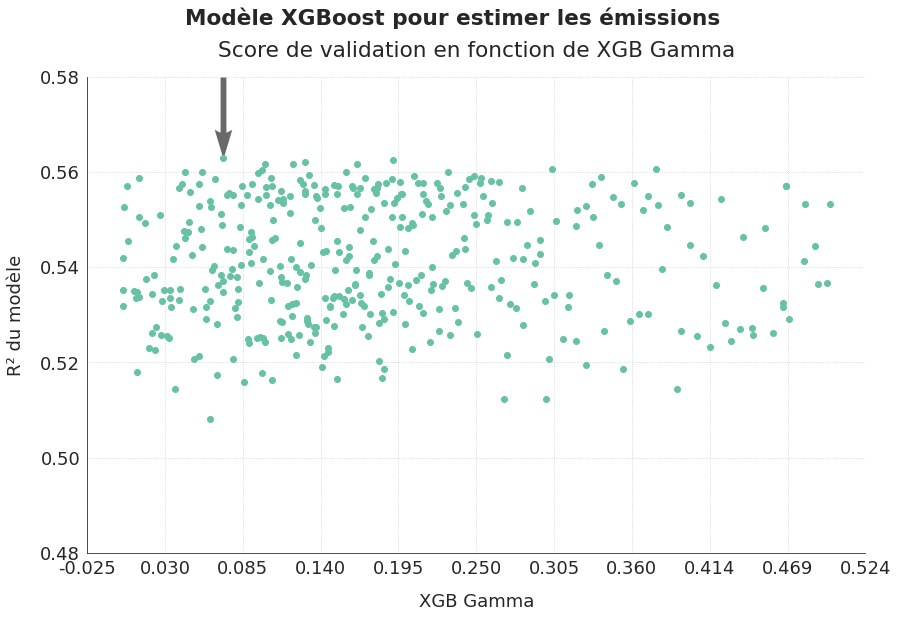

In [ ]:
fig, ax = graph_continu_preview(xgb_emissions_second_stepa, "xgb_gamma", "XGBoost", "XGB Gamma",
                              "les émissions", ymin=0.48, ymax=0.58)
plt.show()

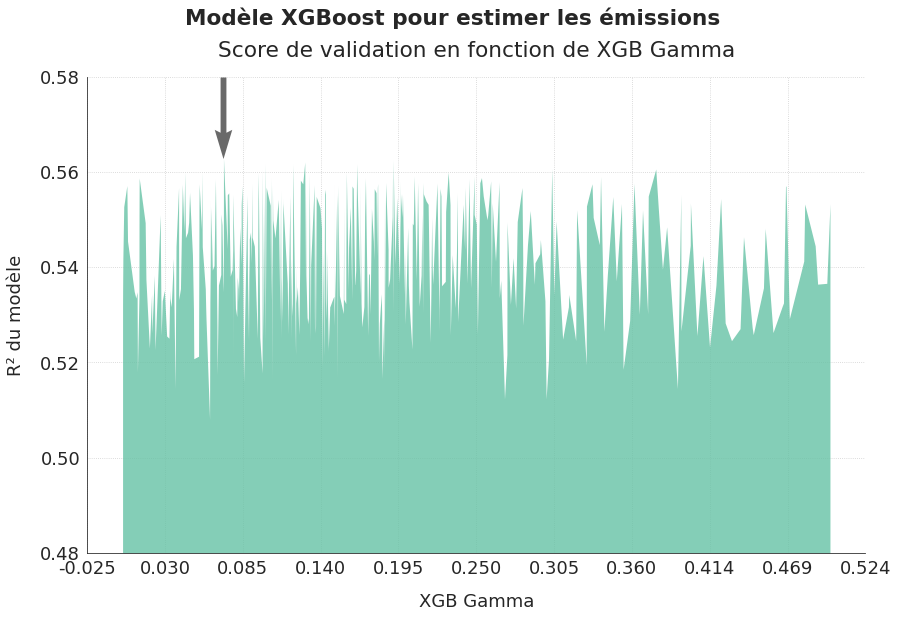

In [ ]:
fig, ax = graph_continu_score(xgb_emissions_second_stepa, "xgb_gamma", "XGBoost", "XGB Gamma",
                              "les émissions", ymin=0.48, ymax=0.58)
plt.show()

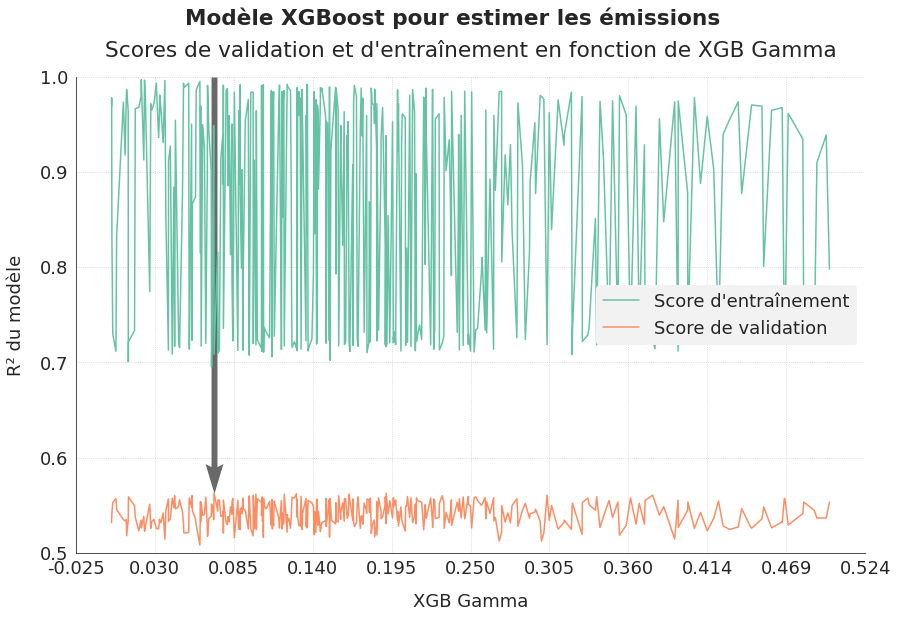

In [ ]:
fig, ax = graph_compar_continu(xgb_emissions_second_stepa, "xgb_gamma", "XGBoost", "XGB Gamma",
                               "les émissions", ymin=0.5)
plt.show()

J'élargis le champs des recherches pour max_depth (en descendant jusqu'à 1).

In [ ]:
# emissions_pipeline for XGBRegressor
emissions_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_mean), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1)),
    ('data_encoders', FitToPandas(encoder_leaveoneout, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=True, keep_all=True)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler()))
])
reg_pipeline = Pipeline([('estimator', XGBRegressor(n_jobs=-1, random_state=42))])

In [ ]:
space = {
    'estimator__objective': 'reg:squarederror',
    'estimator__n_estimators': 150,
    'estimator__learning_rate': 0.07,
    'estimator__max_depth': hp.choice('estimator__max_depth', np.arange(1, 16, 1, dtype=int)),
    'estimator__min_child_weight': hp.choice('estimator__min_child_weight', np.arange(0, 16, 1, dtype=int)),
    'estimator__colsample_bytree': hp.uniform('estimator__colsample_bytree', 0.3, 1),
    'estimator__subsample': hp.uniform('estimator__subsample', 0.5, 1),
    'estimator__gamma': hp.uniform('estimator__gamma', 0.0, 0.5)
}

In [ ]:
list_best_results = []

In [ ]:
estimator_name = 'xgboost'
step = 'final2b'
run_emissions_optimization(max_evals=400, prefix=step, estimator_name=estimator_name)

100%|██████████| 400/400 [10:43<00:00,  1.61s/it, best loss: -0.5661555260152118]
Estimateur : xgboost - Done
Best cross-validation mean score = 0.5661555260152118
Associated standard deviation = 0.05183082142976961
Calculation time = 0.004293489456176758
Data preparation time = 0.2584161820013833
Best cv score obtained after 314 iterations



In [ ]:
xgb_emissions_second_stepb = pd.read_csv("hyperopt_emissions_xgboost_final2b.csv")
xgb_emissions_second_stepb.head()

,valid_score_mean,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,data_transfo_time,estimator,iteration
0,0.532727,0.050568,0.008262,0.956925,0.001644,0.603298,0.258835,"XGBRegressor(base_score=0.5, booster='gbtree',...",1
1,0.527440,0.050247,0.007133,0.953917,0.000922,0.509187,0.250578,"XGBRegressor(base_score=0.5, booster='gbtree',...",2
2,0.510957,0.050390,0.007693,0.981828,0.000250,0.854580,0.258381,"XGBRegressor(base_score=0.5, booster='gbtree',...",3
3,0.530669,0.045989,0.008401,0.972260,0.000985,0.550081,0.253266,"XGBRegressor(base_score=0.5, booster='gbtree',...",4
4,0.513470,0.061945,0.007946,0.973781,0.000559,0.869977,0.257032,"XGBRegressor(base_score=0.5, booster='gbtree',...",5


In [ ]:
xgb_emissions_second_stepb = remove_negative_scores(xgb_emissions_second_stepb)
inter_str = [inter[inter.find('max_depth')+10:] for inter in xgb_emissions_second_stepb.estimator]
xgb_emissions_second_stepb["xgb_max_depth"] = [np.int(inter[:inter.find(',')]) for inter in inter_str]
inter_str = [inter[inter.find('child_weight')+13:] for inter in xgb_emissions_second_stepb.estimator]
xgb_emissions_second_stepb["xgb_min_child_weight"] = [np.int(inter[:inter.find(',')]) for inter in inter_str]
inter_str = [inter[inter.find('colsample_bytree')+17:] for inter in xgb_emissions_second_stepb.estimator]
xgb_emissions_second_stepb["xgb_colsample_bytree"] = [np.around(np.float(inter[:inter.find(',')]),5) for inter in inter_str]
inter_str = [inter[inter.find('subsample')+10:] for inter in xgb_emissions_second_stepb.estimator]
xgb_emissions_second_stepb["xgb_subsample"] = [np.around(np.float(inter[:inter.find(',')]),5) for inter in inter_str]
inter_str = [inter[inter.find('gamma')+6:] for inter in xgb_emissions_second_stepb.estimator]
xgb_emissions_second_stepb["xgb_gamma"] = [np.around(np.float(inter[:inter.find(',')]),5) for inter in inter_str]
xgb_emissions_second_stepb["total_time"] = xgb_emissions_second_stepb.valid_time_mean + xgb_emissions_second_stepb.data_transfo_time

In [ ]:
xgb_emissions_second_stepb[["valid_score_mean","train_score_mean","iteration", "xgb_max_depth",
                       "xgb_min_child_weight","xgb_colsample_bytree","xgb_subsample","xgb_gamma","total_time"]].\
                    sort_values("valid_score_mean", ascending=False).head(10)

,valid_score_mean,train_score_mean,iteration,xgb_max_depth,xgb_min_child_weight,xgb_colsample_bytree,xgb_subsample,xgb_gamma,total_time
313,0.566156,0.708710,314,3,13,0.46709,0.75618,0.14478,0.262710
111,0.566121,0.715523,112,3,12,0.61577,0.92088,0.36030,0.261177
104,0.565472,0.708279,105,3,15,0.52932,0.89253,0.03128,0.249792
146,0.565346,0.709588,147,3,15,0.62020,0.92275,0.34480,0.250273
203,0.564847,0.707217,204,3,15,0.56179,0.77639,0.43258,0.253083
249,0.564274,0.708454,250,3,15,0.59270,0.83399,0.30750,0.258847
296,0.564267,0.712583,297,3,14,0.56754,0.92978,0.33430,0.262291
257,0.563691,0.709152,258,3,15,0.58977,0.78535,0.30187,0.254663
288,0.563669,0.709501,289,3,15,0.59554,0.76215,0.35149,0.262181
260,0.563595,0.708904,261,3,15,0.59107,0.85184,0.34320,0.251273


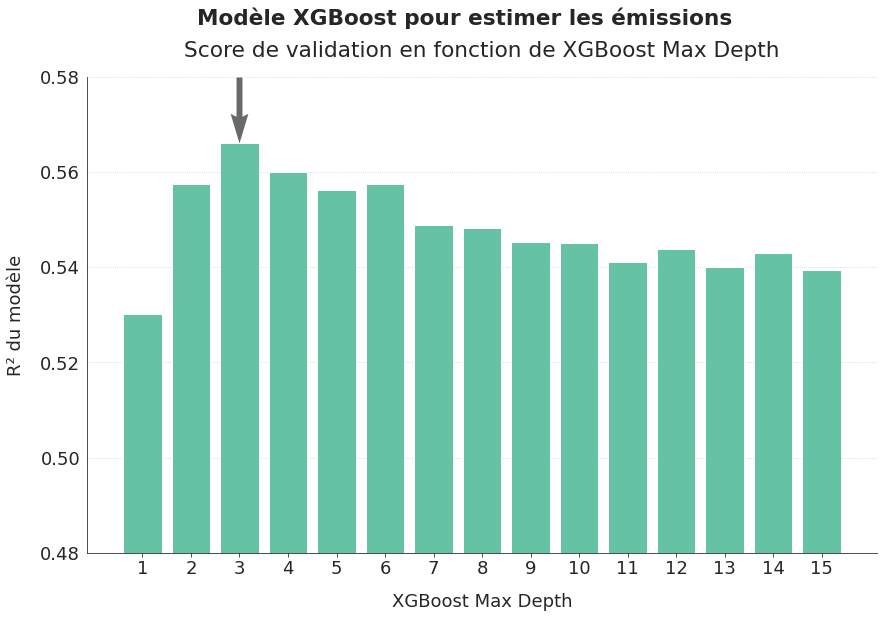

In [ ]:
fig, ax = graph_modele_score(xgb_emissions_second_stepb, "xgb_max_depth", "XGBoost", "XGBoost Max Depth",
                             "les émissions", ymin=0.48, ymax=0.58)
plt.show()

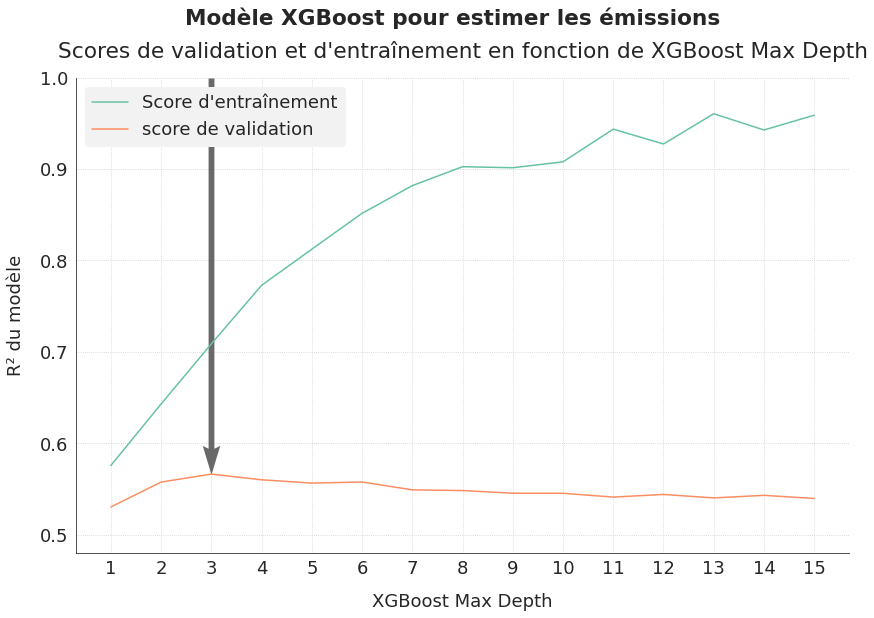

In [ ]:
fig, ax = graph_compar_train_valid(xgb_emissions_second_stepb, "xgb_max_depth", "XGBoost", "XGBoost Max Depth", 
                                   "les émissions", ymin=0.48, rotation=0)
plt.show()

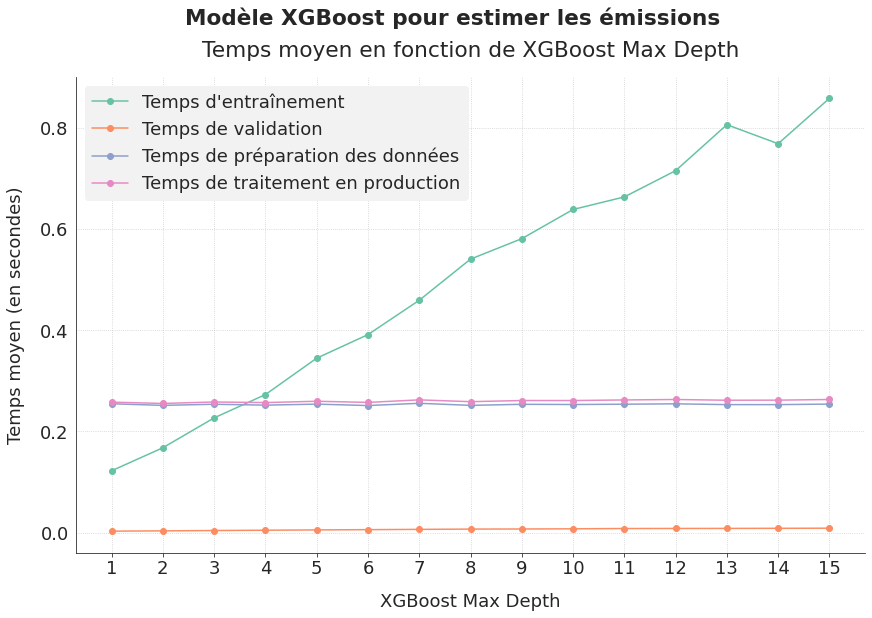

In [ ]:
fig, ax = graph_modele_time(xgb_emissions_second_stepb, "xgb_max_depth", "XGBoost", "XGBoost Max Depth", 
                           "les émissions")
plt.show()

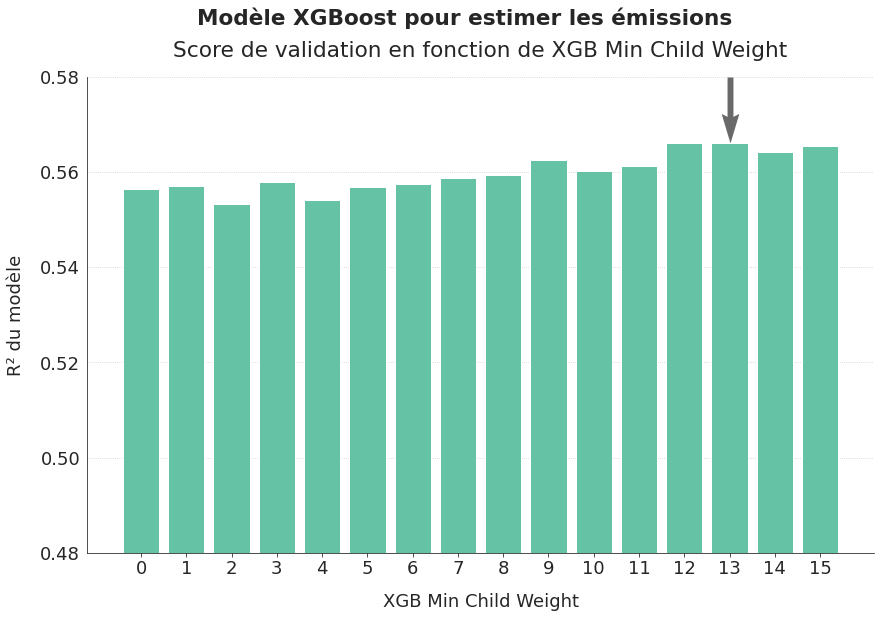

In [ ]:
fig, ax = graph_modele_score(xgb_emissions_second_stepb, "xgb_min_child_weight", "XGBoost", "XGB Min Child Weight",
                             "les émissions", ymin=0.48, ymax=0.58)
plt.show()

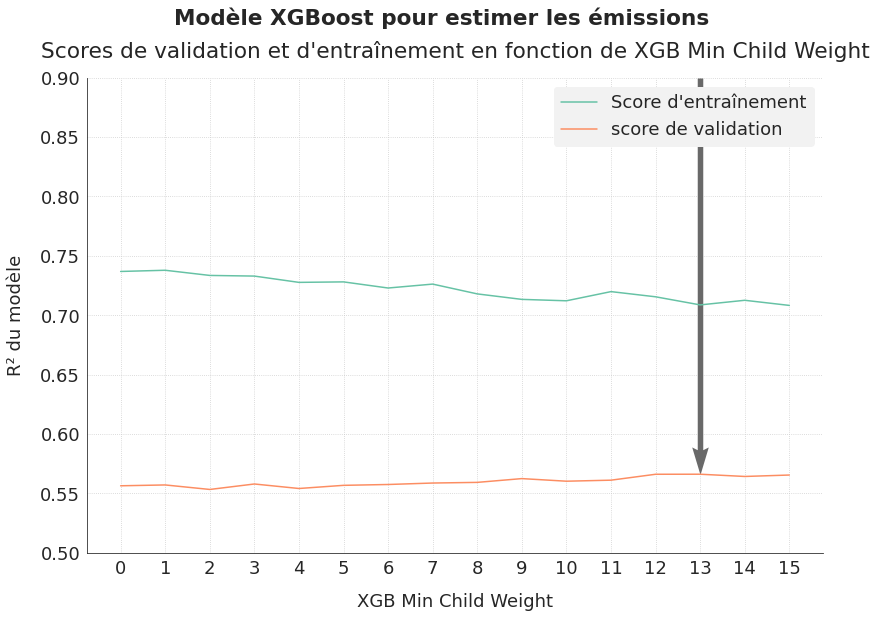

In [ ]:
fig, ax = graph_compar_train_valid(xgb_emissions_second_stepb, "xgb_min_child_weight", "XGBoost", "XGB Min Child Weight", 
                                   "les émissions", ymin=0.5, ymax=0.9, rotation=0)
plt.show()

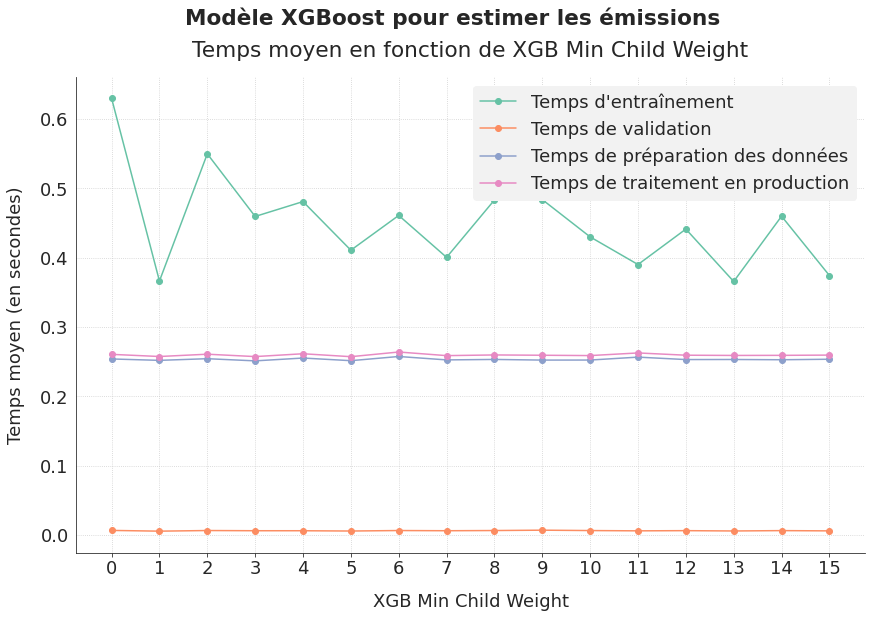

In [ ]:
fig, ax = graph_modele_time(xgb_emissions_second_stepb, "xgb_min_child_weight", "XGBoost", "XGB Min Child Weight", 
                           "les émissions", )
plt.show()

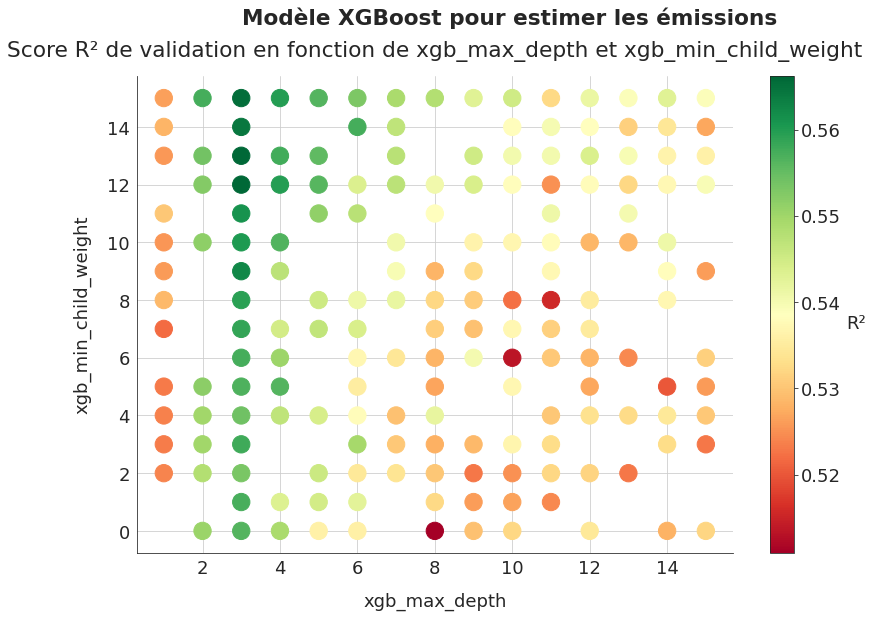

In [ ]:
fig, ax = graph_cross_score(xgb_emissions_second_stepb, "xgb_max_depth", "xgb_min_child_weight", "XGBoost",
                            "les émissions", size=300)

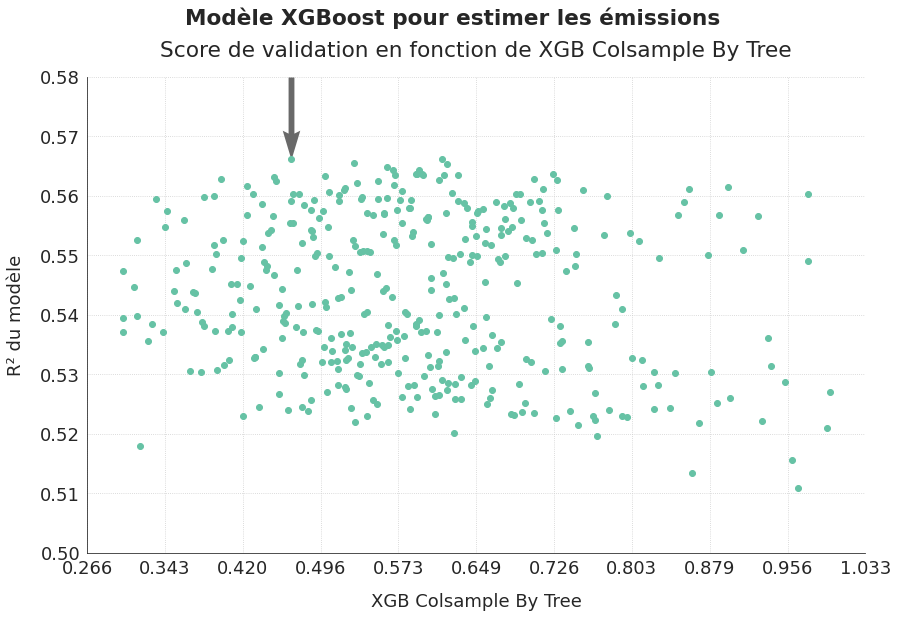

In [ ]:
fig, ax = graph_continu_preview(xgb_emissions_second_stepb, "xgb_colsample_bytree", "XGBoost", "XGB Colsample By Tree",
                              "les émissions", ymin=0.50, ymax=0.58)
plt.show()

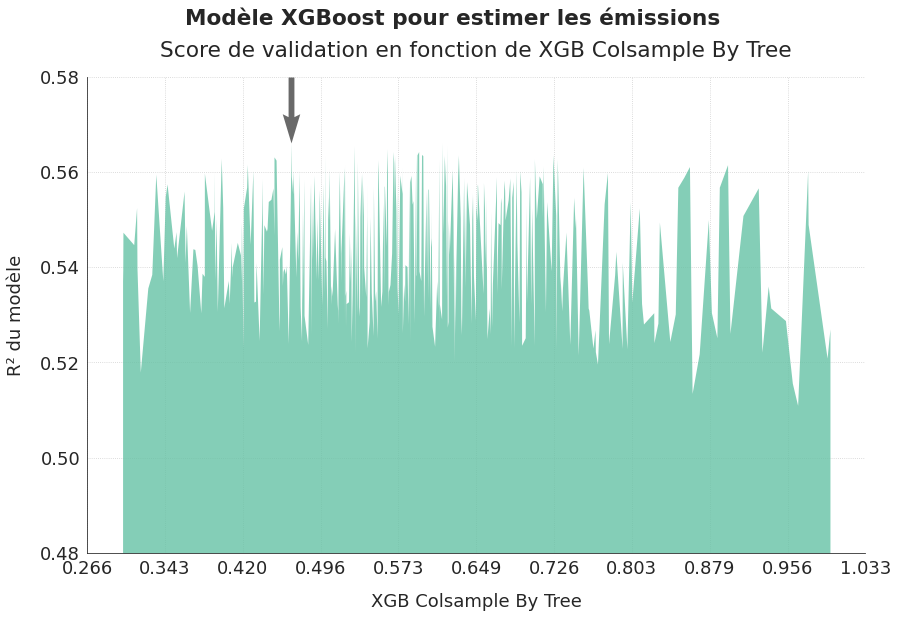

In [ ]:
fig, ax = graph_continu_score(xgb_emissions_second_stepb, "xgb_colsample_bytree", "XGBoost", "XGB Colsample By Tree",
                              "les émissions", ymin=0.48, ymax=0.58)
plt.show()

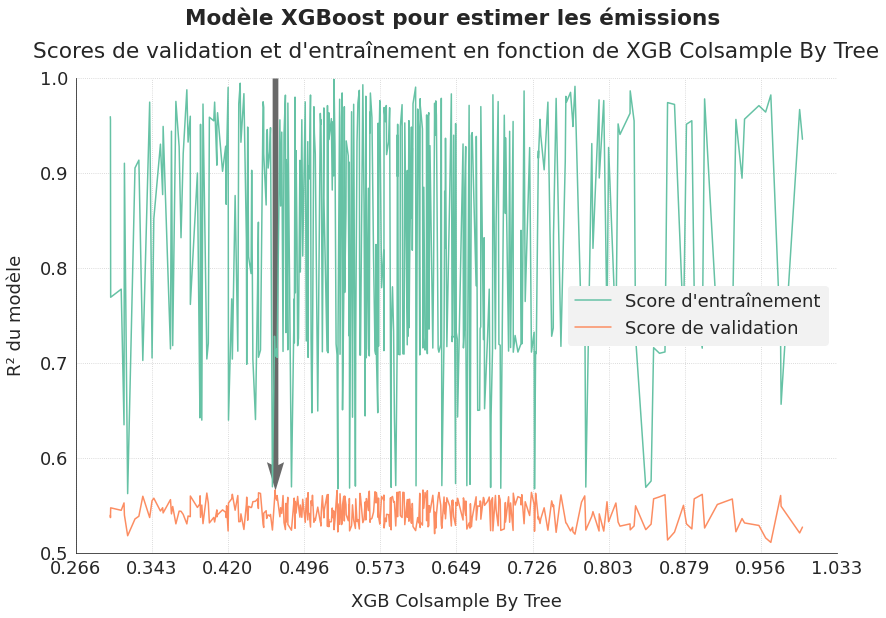

In [ ]:
fig, ax = graph_compar_continu(xgb_emissions_second_stepb, "xgb_colsample_bytree", "XGBoost", "XGB Colsample By Tree",
                                "les émissions", ymin=0.5)
plt.show()

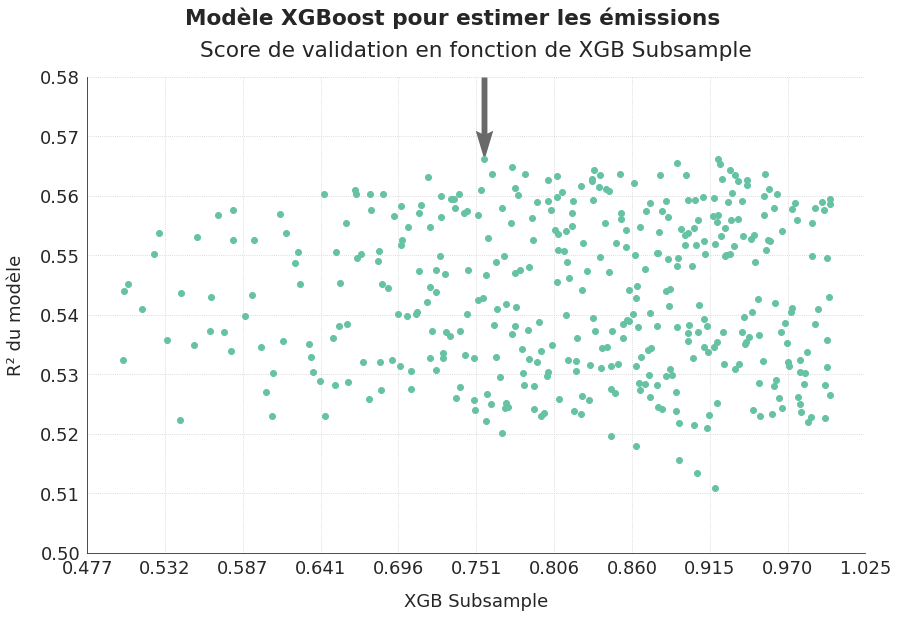

In [ ]:
fig, ax = graph_continu_preview(xgb_emissions_second_stepb, "xgb_subsample", "XGBoost", "XGB Subsample",
                              "les émissions", ymin=0.50, ymax=0.58)
plt.show()

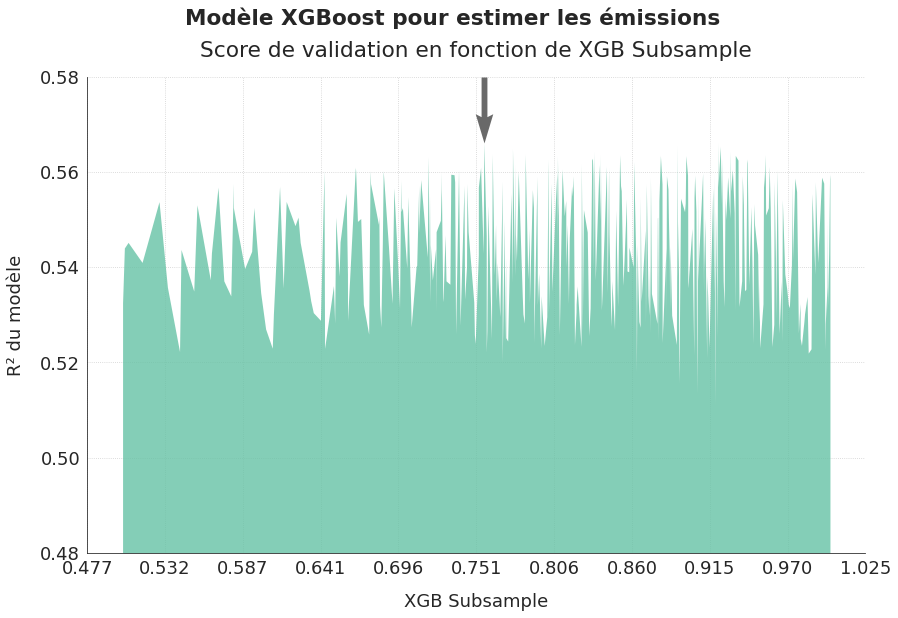

In [ ]:
fig, ax = graph_continu_score(xgb_emissions_second_stepb, "xgb_subsample", "XGBoost", "XGB Subsample",
                              "les émissions", ymin=0.48, ymax=0.58)
plt.show()

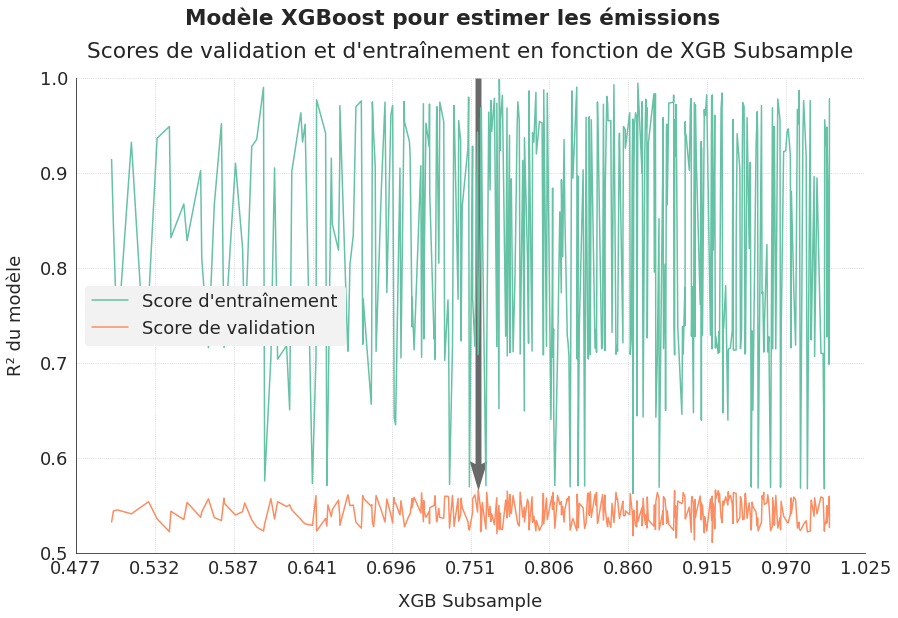

In [ ]:
fig, ax = graph_compar_continu(xgb_emissions_second_stepb, "xgb_subsample", "XGBoost", "XGB Subsample",
                               "les émissions", ymin=0.5)
plt.show()

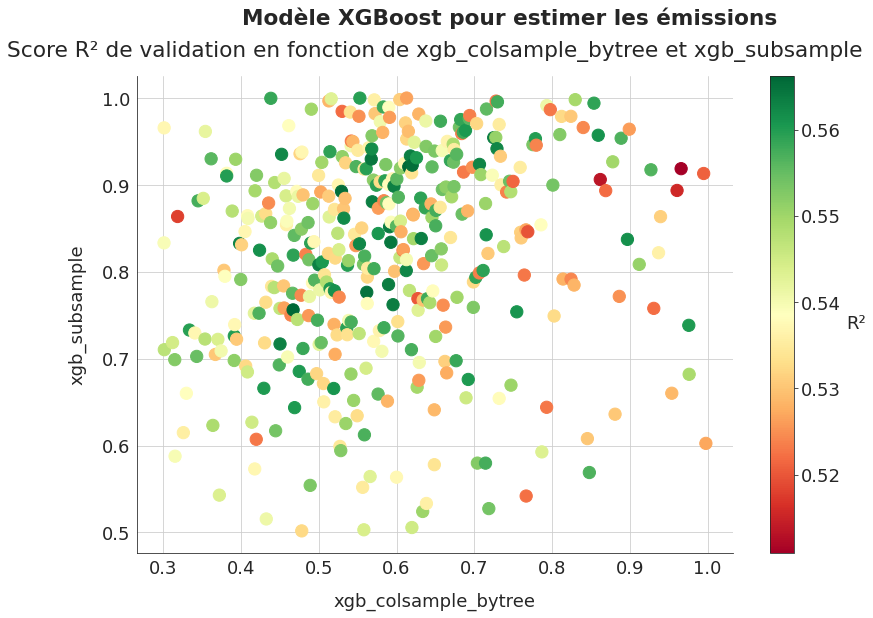

In [ ]:
fig, ax = graph_cross_score(xgb_emissions_second_stepb, "xgb_colsample_bytree", "xgb_subsample", "XGBoost",
                            "les émissions", size=150)

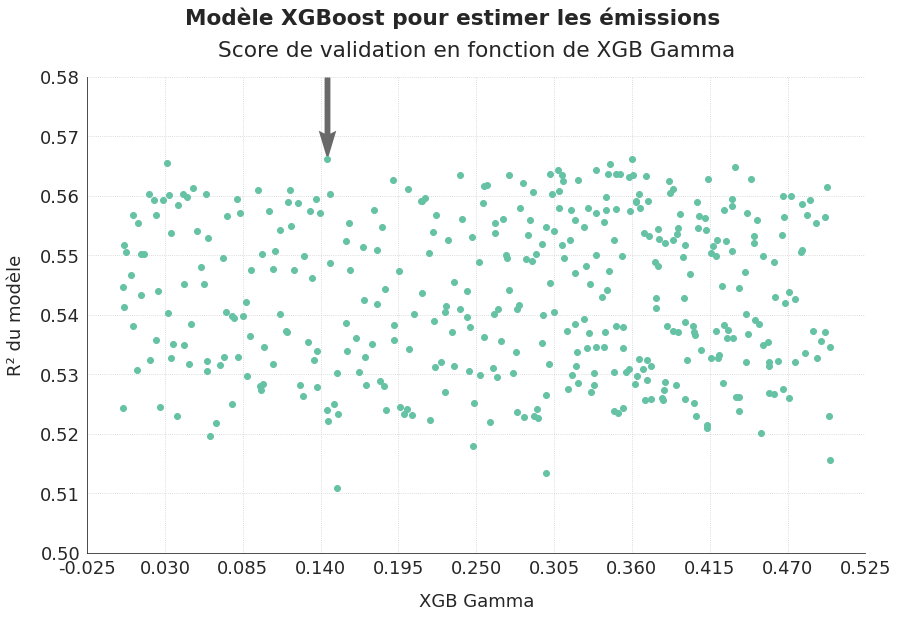

In [ ]:
fig, ax = graph_continu_preview(xgb_emissions_second_stepb, "xgb_gamma", "XGBoost", "XGB Gamma",
                              "les émissions", ymin=0.50, ymax=0.58)
plt.show()

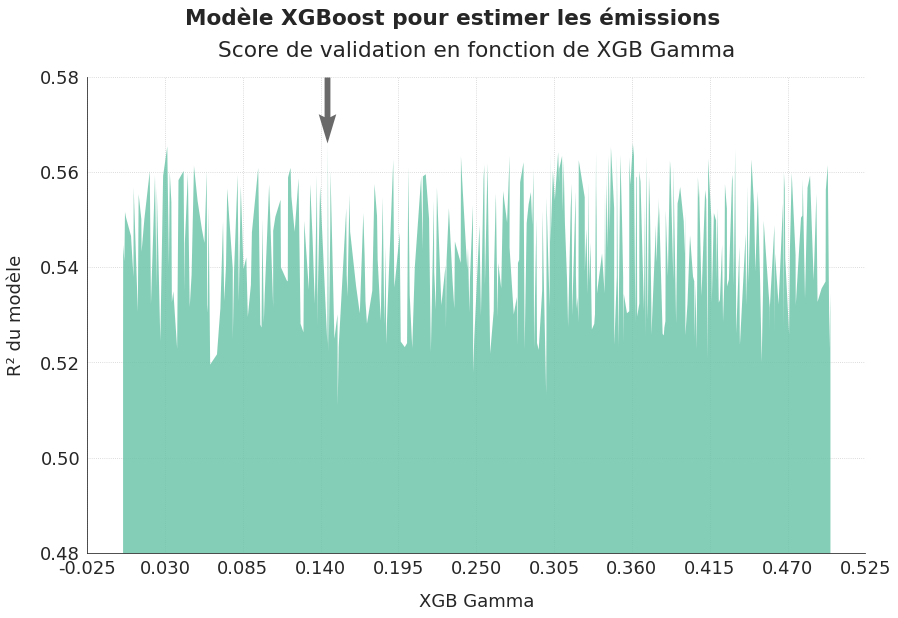

In [ ]:
fig, ax = graph_continu_score(xgb_emissions_second_stepb, "xgb_gamma", "XGBoost", "XGB Gamma",
                              "les émissions", ymin=0.48, ymax=0.58)
plt.show()

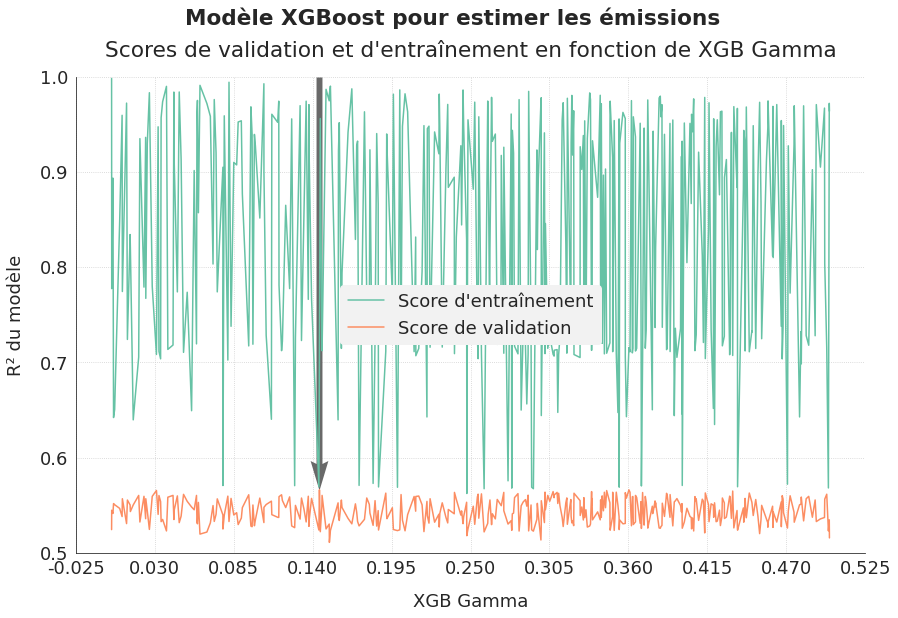

In [ ]:
fig, ax = graph_compar_continu(xgb_emissions_second_stepb, "xgb_gamma", "XGBoost", "XGB Gamma",
                               "les émissions", ymin=0.5)
plt.show()

J'affine la recherche pour les hyperparamètres colsample_bytree, subsample et gamma.

In [ ]:
# emissions_pipeline for XGBRegressor
emissions_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_mean), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1)),
    ('data_encoders', FitToPandas(encoder_leaveoneout, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=True, keep_all=True)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler()))
])
reg_pipeline = Pipeline([('estimator', XGBRegressor(n_jobs=-1, random_state=42))])


In [ ]:
space = {
    'estimator__objective': 'reg:squarederror',
    'estimator__n_estimators': 150,
    'estimator__learning_rate': 0.07,
    'estimator__max_depth': 3,
    'estimator__min_child_weight': 13,
    'estimator__colsample_bytree': hp.choice('estimator__colsample_bytree', np.arange(0.4, 0.7, 0.01)),
    'estimator__subsample': hp.choice('estimator__subsample', np.arange(0.7, 1.0, 0.01)),
    'estimator__gamma': hp.choice('estimator__gamma', np.arange(0.0, 0.4, 0.01))
}

In [ ]:
list_best_results = []

In [ ]:
estimator_name = 'xgboost'
step = 'final2c'
run_emissions_optimization(max_evals=400, prefix=step, estimator_name=estimator_name)

100%|██████████| 400/400 [06:20<00:00,  1.05it/s, best loss: -0.567003281457781]
Estimateur : xgboost - Done
Best cross-validation mean score = 0.567003281457781
Associated standard deviation = 0.04887597960197815
Calculation time = 0.004376125335693359
Data preparation time = 0.25196044000040274
Best cv score obtained after 68 iterations



In [ ]:
xgb_emissions_second_stepc = pd.read_csv("hyperopt_emissions_xgboost_final2c.csv")
xgb_emissions_second_stepc.head()

,valid_score_mean,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,data_transfo_time,estimator,iteration
0,0.560225,0.047847,0.004593,0.708063,0.009883,0.211351,0.261548,"XGBRegressor(base_score=0.5, booster='gbtree',...",1
1,0.560137,0.051146,0.005637,0.712169,0.008703,0.227123,0.251007,"XGBRegressor(base_score=0.5, booster='gbtree',...",2
2,0.561834,0.053474,0.004306,0.708705,0.009697,0.195113,0.250847,"XGBRegressor(base_score=0.5, booster='gbtree',...",3
3,0.562321,0.051661,0.004762,0.713449,0.009409,0.239648,0.270718,"XGBRegressor(base_score=0.5, booster='gbtree',...",4
4,0.558339,0.053633,0.004546,0.706002,0.008806,0.197156,0.271971,"XGBRegressor(base_score=0.5, booster='gbtree',...",5


In [ ]:
xgb_emissions_second_stepc = remove_negative_scores(xgb_emissions_second_stepc)
inter_str = [inter[inter.find('max_depth')+10:] for inter in xgb_emissions_second_stepc.estimator]
xgb_emissions_second_stepc["xgb_max_depth"] = [np.int(inter[:inter.find(',')]) for inter in inter_str]
inter_str = [inter[inter.find('child_weight')+13:] for inter in xgb_emissions_second_stepc.estimator]
xgb_emissions_second_stepc["xgb_min_child_weight"] = [np.int(inter[:inter.find(',')]) for inter in inter_str]
inter_str = [inter[inter.find('colsample_bytree')+17:] for inter in xgb_emissions_second_stepc.estimator]
xgb_emissions_second_stepc["xgb_colsample_bytree"] = [np.around(np.float(inter[:inter.find(',')]),5) for inter in inter_str]
inter_str = [inter[inter.find('subsample')+10:] for inter in xgb_emissions_second_stepc.estimator]
xgb_emissions_second_stepc["xgb_subsample"] = [np.around(np.float(inter[:inter.find(',')]),5) for inter in inter_str]
inter_str = [inter[inter.find('gamma')+6:] for inter in xgb_emissions_second_stepc.estimator]
xgb_emissions_second_stepc["xgb_gamma"] = [np.around(np.float(inter[:inter.find(',')]),5) for inter in inter_str]
xgb_emissions_second_stepc["total_time"] = xgb_emissions_second_stepc.valid_time_mean + xgb_emissions_second_stepc.data_transfo_time

In [ ]:
xgb_emissions_second_stepc[["valid_score_mean","train_score_mean","iteration", "xgb_max_depth",
                       "xgb_min_child_weight","xgb_colsample_bytree","xgb_subsample","xgb_gamma","total_time"]].\
                    sort_values("valid_score_mean", ascending=False).head(10)

,valid_score_mean,train_score_mean,iteration,xgb_max_depth,xgb_min_child_weight,xgb_colsample_bytree,xgb_subsample,xgb_gamma,total_time
151,0.567003,0.708783,152,3,13,0.48,0.73,0.34,0.262981
385,0.567003,0.708783,386,3,13,0.52,0.73,0.34,0.256509
67,0.567003,0.708783,68,3,13,0.48,0.73,0.34,0.256337
294,0.567003,0.708783,295,3,13,0.48,0.73,0.34,0.259942
293,0.567003,0.708783,294,3,13,0.48,0.73,0.34,0.255124
199,0.566986,0.710419,200,3,13,0.53,0.73,0.01,0.263356
268,0.566781,0.708613,269,3,13,0.48,0.73,0.39,0.277419
257,0.566781,0.708613,258,3,13,0.48,0.73,0.36,0.258094
37,0.566781,0.708613,38,3,13,0.48,0.73,0.39,0.257722
38,0.566781,0.708613,39,3,13,0.48,0.73,0.39,0.261779


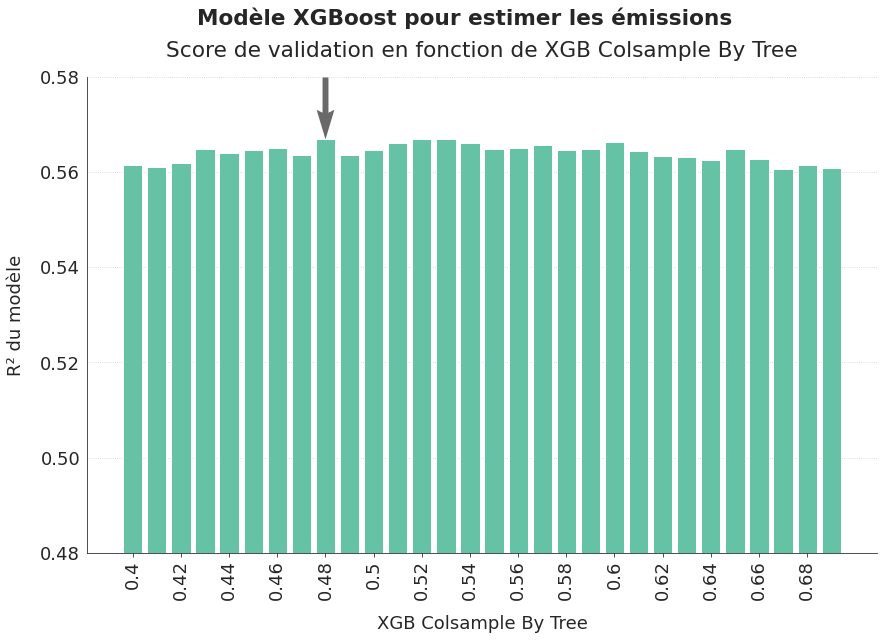

In [ ]:
fig, ax = graph_modele_score(xgb_emissions_second_stepc, "xgb_colsample_bytree", "XGBoost", "XGB Colsample By Tree",
                              "les émissions", ymin=0.48, ymax=0.58, rotation=90, tick_step=2)
plt.show()

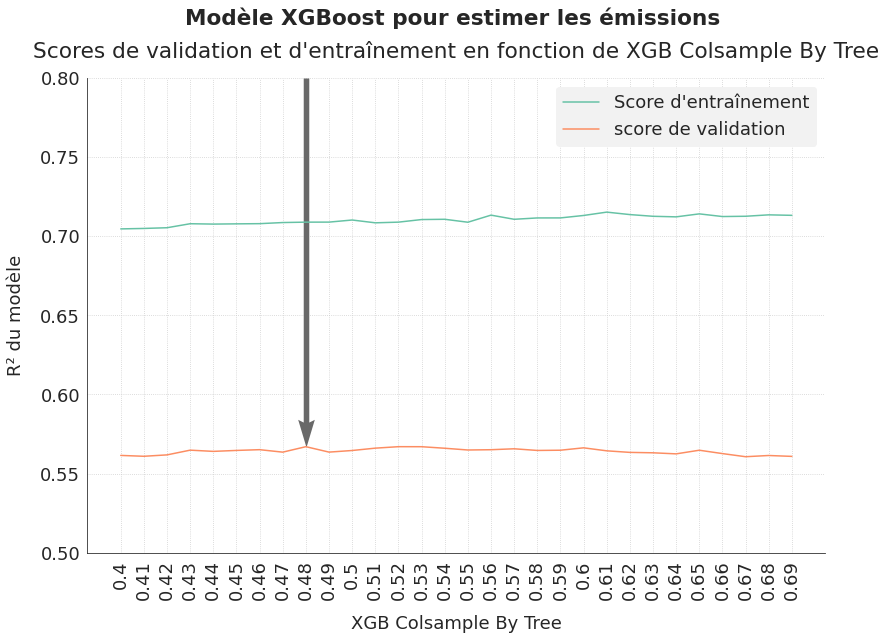

In [ ]:
fig, ax = graph_compar_train_valid(xgb_emissions_second_stepc, "xgb_colsample_bytree", "XGBoost", "XGB Colsample By Tree",
                                "les émissions", ymin=0.5, ymax=0.8, rotation=90)
plt.show()

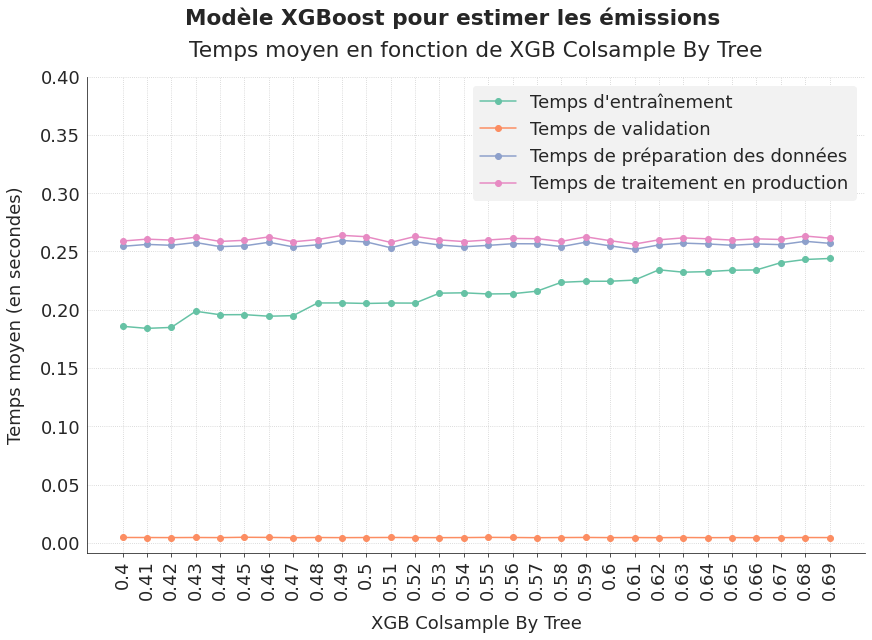

In [ ]:
fig, ax = graph_modele_time(xgb_emissions_second_stepc, "xgb_colsample_bytree", "XGBoost", "XGB Colsample By Tree",
                                "les émissions", ymax=0.4, rotation=90)
plt.show()

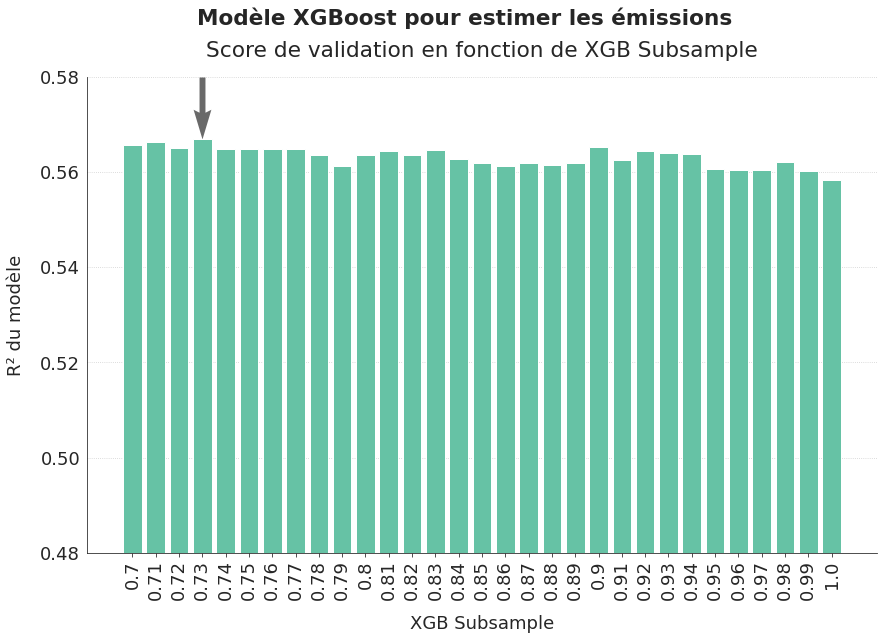

In [ ]:
fig, ax = graph_modele_score(xgb_emissions_second_stepc, "xgb_subsample", "XGBoost", "XGB Subsample",
                              "les émissions", ymin=0.48, ymax=0.58, rotation=90)
plt.show()

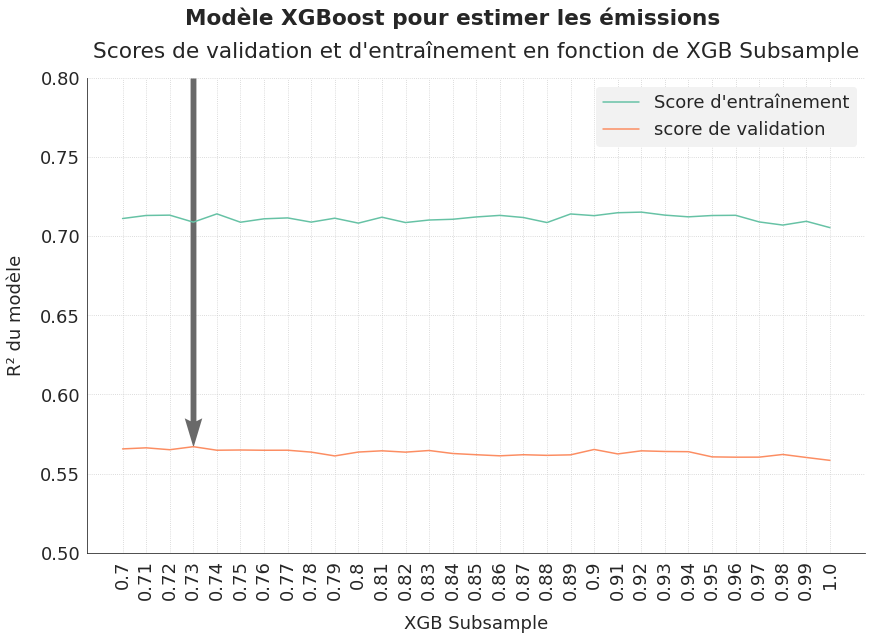

In [ ]:
fig, ax = graph_compar_train_valid(xgb_emissions_second_stepc, "xgb_subsample", "XGBoost", "XGB Subsample",
                               "les émissions", ymin=0.5, ymax=0.8, rotation=90)
plt.show()

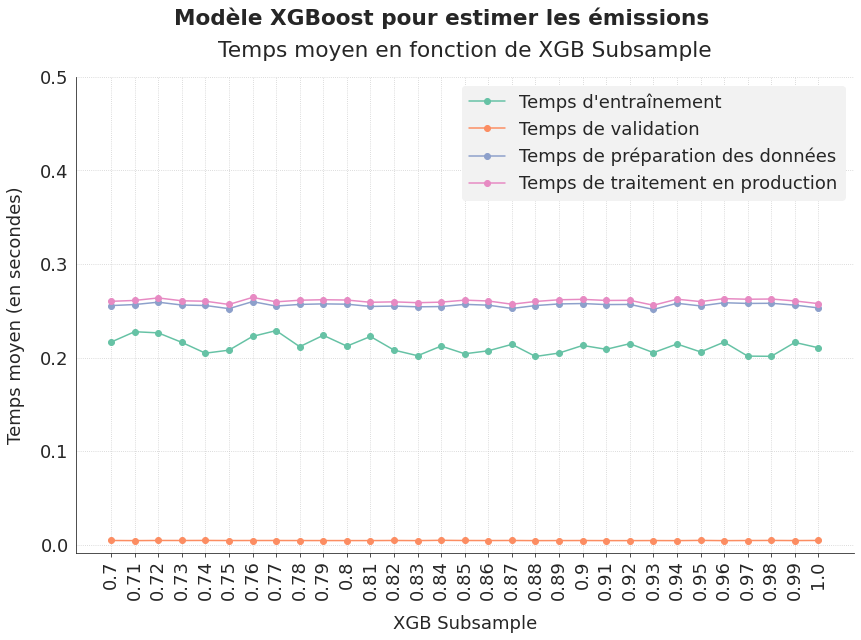

In [ ]:
fig, ax = graph_modele_time(xgb_emissions_second_stepc, "xgb_subsample", "XGBoost", "XGB Subsample",
                                "les émissions", ymax=0.5, rotation=90)
plt.show()

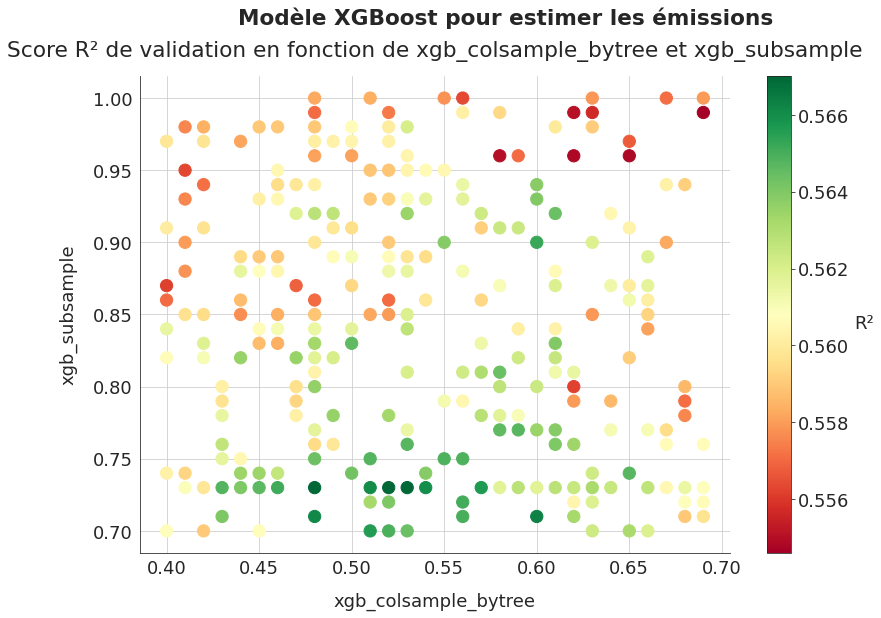

In [ ]:
fig, ax = graph_cross_score(xgb_emissions_second_stepc, "xgb_colsample_bytree", "xgb_subsample", "XGBoost",
                            "les émissions", size=150)

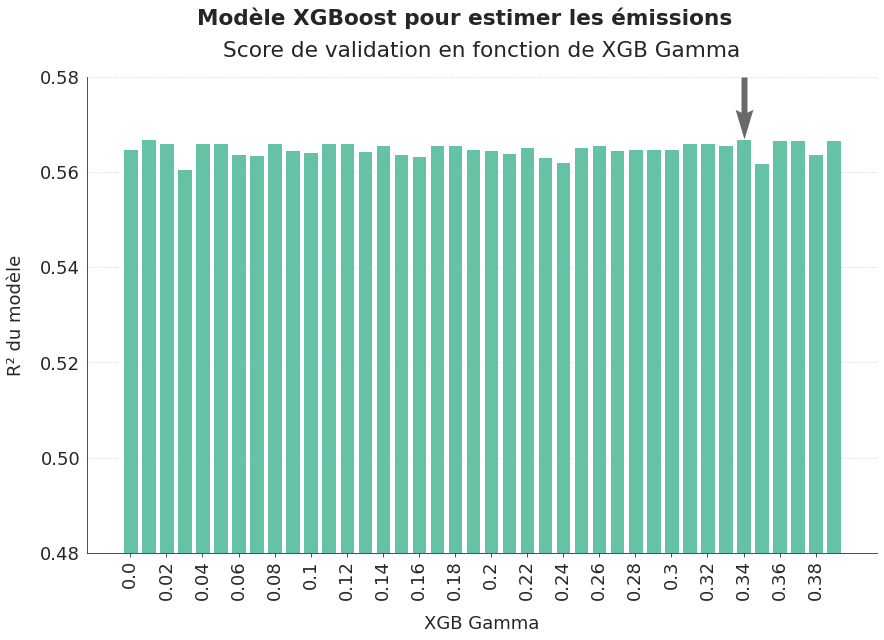

In [ ]:
fig, ax = graph_modele_score(xgb_emissions_second_stepc, "xgb_gamma", "XGBoost", "XGB Gamma",
                              "les émissions", ymin=0.48, ymax=0.58, rotation=90, tick_step=2)
plt.show()

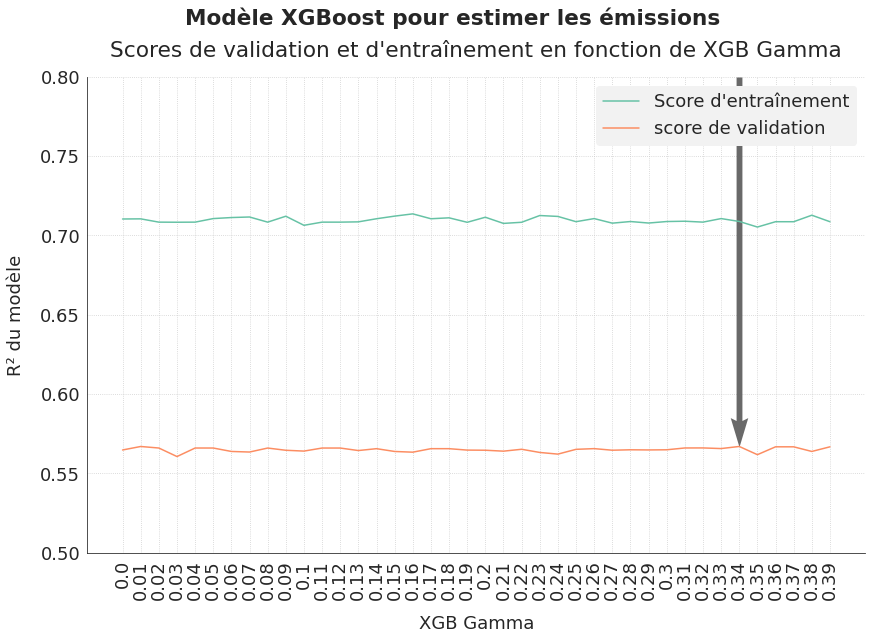

In [ ]:
fig, ax = graph_compar_train_valid(xgb_emissions_second_stepc, "xgb_gamma", "XGBoost", "XGB Gamma",
                               "les émissions", ymin=0.5, ymax=0.8, rotation=90)
plt.show()

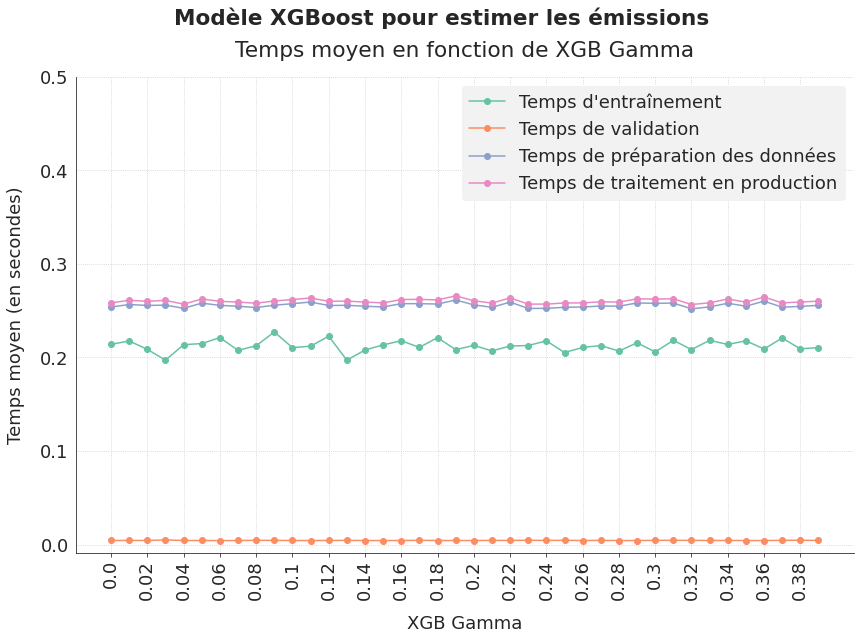

In [ ]:
fig, ax = graph_modele_time(xgb_emissions_second_stepc, "xgb_gamma", "XGBoost", "XGB Gamma",
                                "les émissions", ymax=0.5, rotation=90, tick_step=2)
plt.show()

<a id='5_5_6'></a>

#### 5.5.6. XGBoost : troisième étape

J'optimise les hyperparamètres de XGBoost liés à la régularisation : reg_alpha et reg_lambda.

In [ ]:
# emissions_pipeline for XGBRegressor
emissions_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_mean), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1)),
    ('data_encoders', FitToPandas(encoder_leaveoneout, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=True, keep_all=True)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler()))
])
reg_pipeline = Pipeline([('estimator', XGBRegressor(n_jobs=-1, random_state=42))])

In [ ]:
space = {
    'estimator__objective': 'reg:squarederror',
    'estimator__n_estimators': 150,
    'estimator__learning_rate': 0.07,
    'estimator__max_depth': 3,
    'estimator__min_child_weight': 13,
    'estimator__colsample_bytree': 0.48,
    'estimator__subsample': 0.73,
    'estimator__gamma': 0.34,
    'estimator__reg_alpha': hp.choice('estimator__reg_alpha', np.arange(0.0, 2.0, 0.1)),
    'estimator__reg_lambda': hp.choice('estimator__reg_lambda', np.arange(0.0, 2.0, 0.1))
}

In [ ]:
list_best_results = []

In [ ]:
estimator_name = 'xgboost'
step = 'final3a'
run_emissions_optimization(max_evals=200, prefix=step, estimator_name=estimator_name)

100%|██████████| 200/200 [03:07<00:00,  1.07it/s, best loss: -0.5676569944158958]
Estimateur : xgboost - Done
Best cross-validation mean score = 0.5676569944158958
Associated standard deviation = 0.04910680569931045
Calculation time = 0.0045454978942871095
Data preparation time = 0.2536659170000348
Best cv score obtained after 69 iterations



In [ ]:
xgb_emissions_third_stepa = pd.read_csv("hyperopt_emissions_xgboost_final3a.csv")
xgb_emissions_third_stepa.head()

,valid_score_mean,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,data_transfo_time,estimator,iteration
0,0.562744,0.046973,0.004454,0.705279,0.006949,0.211883,0.255558,"XGBRegressor(base_score=0.5, booster='gbtree',...",1
1,0.561162,0.047875,0.004427,0.698938,0.008948,0.211059,0.249407,"XGBRegressor(base_score=0.5, booster='gbtree',...",2
2,0.565738,0.048121,0.005351,0.707692,0.006968,0.222644,0.258688,"XGBRegressor(base_score=0.5, booster='gbtree',...",3
3,0.561994,0.049903,0.004321,0.711744,0.006993,0.207797,0.252187,"XGBRegressor(base_score=0.5, booster='gbtree',...",4
4,0.567179,0.045814,0.004468,0.705548,0.008790,0.217068,0.252870,"XGBRegressor(base_score=0.5, booster='gbtree',...",5


In [ ]:
xgb_emissions_third_stepa = remove_negative_scores(xgb_emissions_third_stepa)
inter_str = [inter[inter.find('reg_alpha')+10:] for inter in xgb_emissions_third_stepa.estimator]
xgb_emissions_third_stepa["xgb_reg_alpha"] = [np.around(np.float(inter[:inter.find(',')]),2) for inter in inter_str]
inter_str = [inter[inter.find('reg_lambda')+11:] for inter in xgb_emissions_third_stepa.estimator]
xgb_emissions_third_stepa["xgb_reg_lambda"] = [np.around(np.float(inter[:inter.find(',')]),2) for inter in inter_str]
xgb_emissions_third_stepa["total_time"] = xgb_emissions_third_stepa.valid_time_mean + xgb_emissions_third_stepa.data_transfo_time

In [ ]:
xgb_emissions_third_stepa[["valid_score_mean","train_score_mean","iteration", 
                      "xgb_reg_alpha","xgb_reg_lambda","total_time"]].\
                    sort_values("valid_score_mean", ascending=False).head(10)

,valid_score_mean,train_score_mean,iteration,xgb_reg_alpha,xgb_reg_lambda,total_time
84,0.567657,0.707209,85,0.2,1.3,0.258663
148,0.567657,0.707209,149,0.2,1.3,0.259758
149,0.567657,0.707209,150,0.2,1.3,0.262091
164,0.567657,0.707209,165,0.2,1.3,0.260473
68,0.567657,0.707209,69,0.2,1.3,0.258211
191,0.567657,0.707209,192,0.2,1.3,0.258359
139,0.567657,0.707209,140,0.2,1.3,0.285840
80,0.567657,0.707209,81,0.2,1.3,0.260214
147,0.567657,0.707209,148,0.2,1.3,0.258552
146,0.567657,0.707209,147,0.2,1.3,0.256412


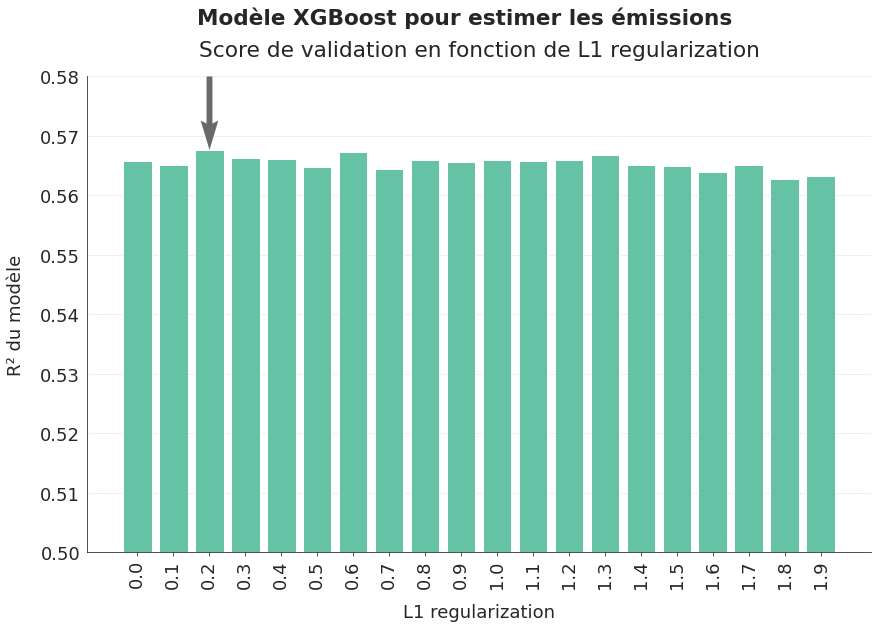

In [ ]:
fig, ax = graph_modele_score(xgb_emissions_third_stepa, "xgb_reg_alpha", "XGBoost", "L1 regularization",
                             "les émissions", ymin=0.5, ymax=0.58, rotation=90)
plt.show()

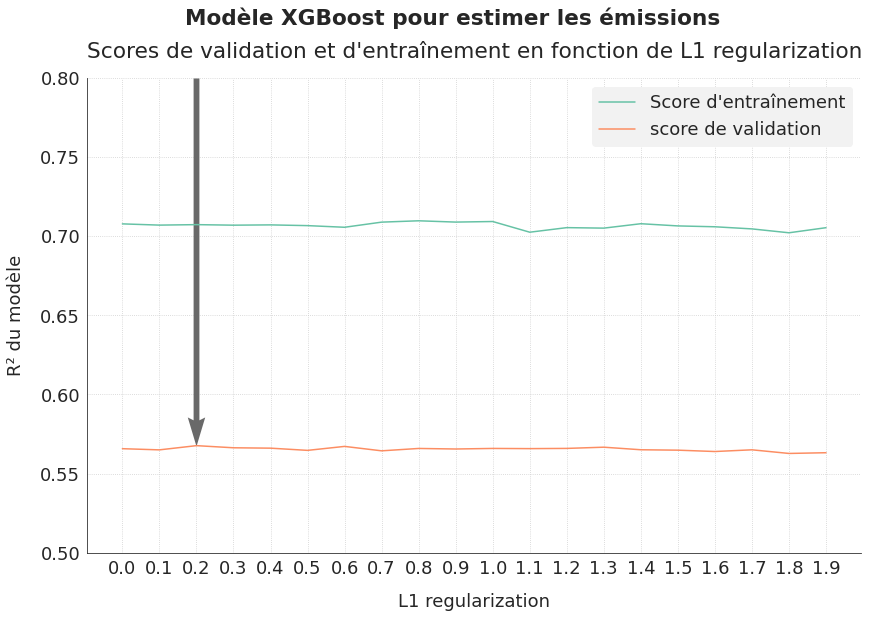

In [ ]:
fig, ax = graph_compar_train_valid(xgb_emissions_third_stepa, "xgb_reg_alpha", "XGBoost", "L1 regularization", 
                                   "les émissions", ymin=0.5, ymax=0.8, rotation=0)
plt.show()

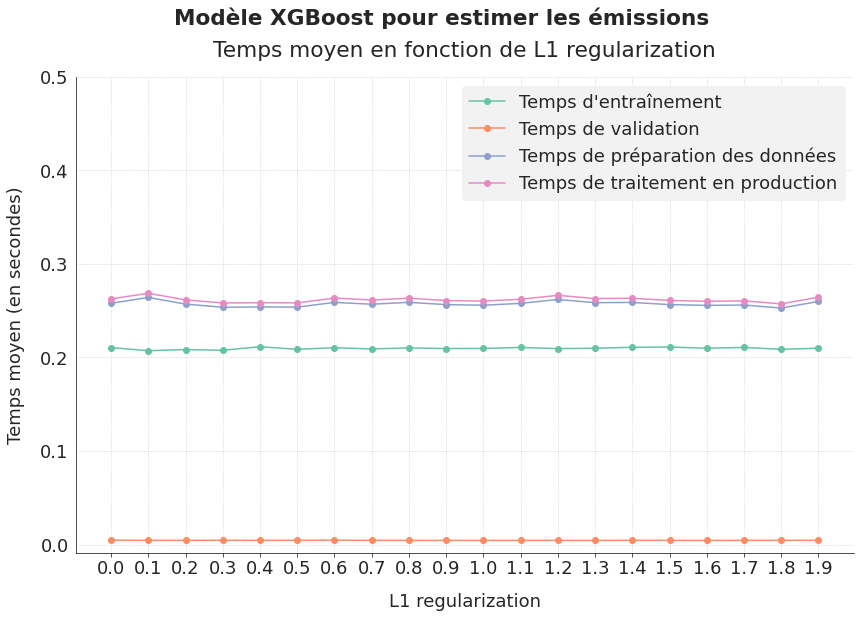

In [ ]:
fig, ax = graph_modele_time(xgb_emissions_third_stepa, "xgb_reg_alpha", "XGBoost", "L1 regularization", 
                           "les émissions", ymax=0.50, rotation=0)
plt.show()

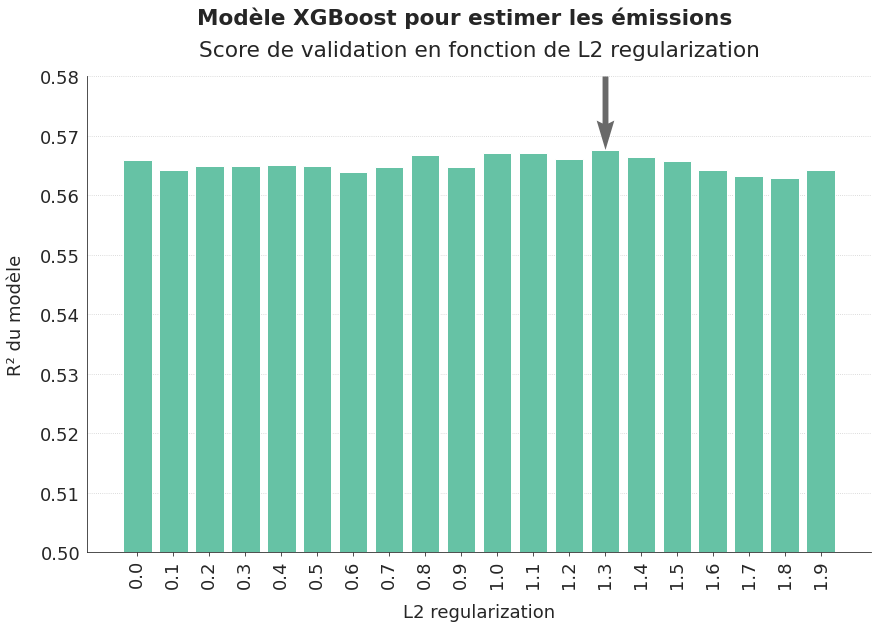

In [ ]:
fig, ax = graph_modele_score(xgb_emissions_third_stepa, "xgb_reg_lambda", "XGBoost", "L2 regularization",
                             "les émissions", ymin=0.5, ymax=0.58, rotation=90)
plt.show()

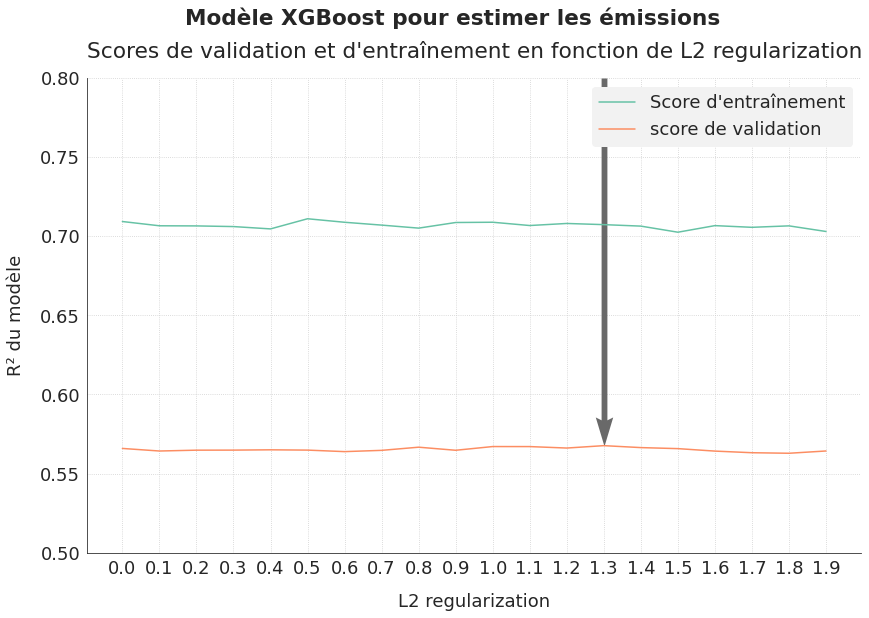

In [ ]:
fig, ax = graph_compar_train_valid(xgb_emissions_third_stepa, "xgb_reg_lambda", "XGBoost", "L2 regularization", 
                                   "les émissions", ymin=0.5, ymax=0.8, rotation=0)
plt.show()

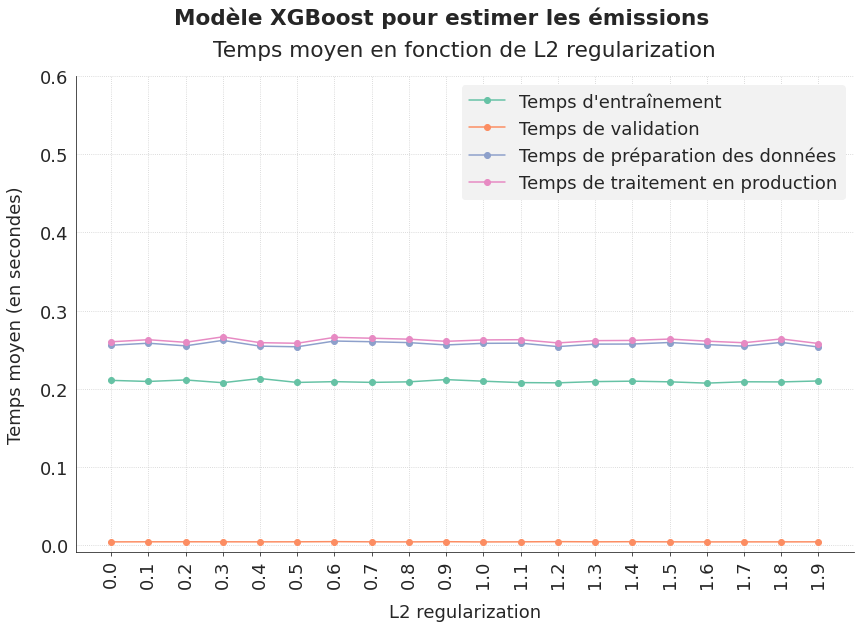

In [ ]:
fig, ax = graph_modele_time(xgb_emissions_third_stepa, "xgb_reg_lambda", "XGBoost", "L2 regularization", 
                           "les émissions", ymax=0.60, rotation=90)
plt.show()

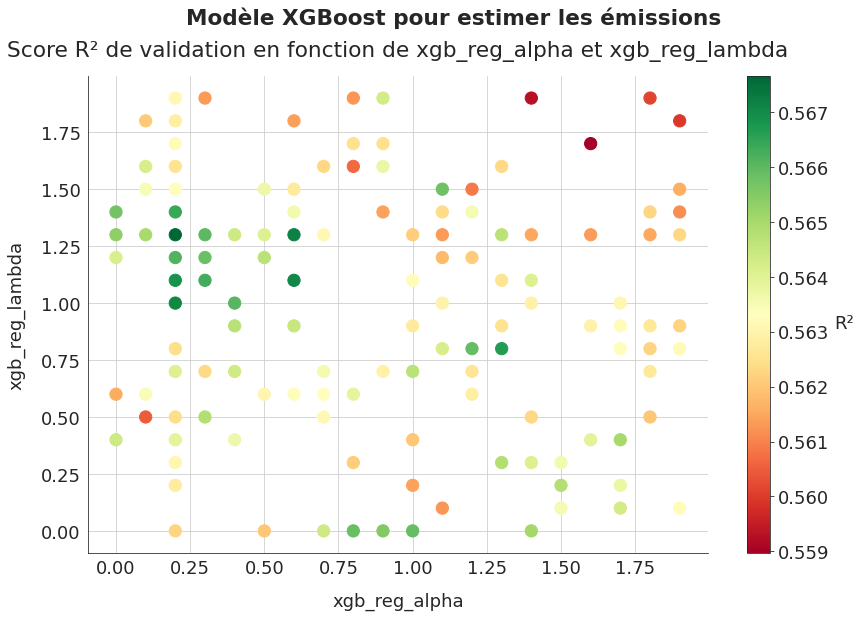

In [ ]:
fig, ax = graph_cross_score(xgb_emissions_third_stepa, "xgb_reg_alpha", "xgb_reg_lambda", "XGBoost",
                            "les émissions", size=150)

<a id='5_5_7'></a>

#### 5.5.7. XGBoost : feature importances

In [ ]:
# emissions_pipeline for XGBRegressor
emissions_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_mean), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1)),
    ('data_encoders', FitToPandas(encoder_leaveoneout, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=True, keep_all=True)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler()))
])
reg_pipeline = Pipeline([('estimator', XGBRegressor(n_jobs=-1, random_state=42))])

In [ ]:
space = {
    'estimator__objective': 'reg:squarederror',
    'estimator__n_estimators': 150,
    'estimator__learning_rate': 0.07,
    'estimator__max_depth': 3,
    'estimator__min_child_weight': 13,
    'estimator__colsample_bytree': 0.48,
    'estimator__subsample': 0.73,
    'estimator__gamma': 0.34,
    'estimator__reg_alpha': 0.2,
    'estimator__reg_lambda': 1.3
}

In [ ]:
list_best_results = []

In [ ]:
estimator_name = 'xgboost'
step = 'finalverif'
run_emissions_optimization(max_evals=1, prefix=step, estimator_name=estimator_name)

100%|██████████| 1/1 [00:00<00:00,  1.08it/s, best loss: -0.5676569944158958]
Estimateur : xgboost - Done
Best cross-validation mean score = 0.5676569944158958
Associated standard deviation = 0.04910680569931045
Calculation time = 0.004397058486938476
Data preparation time = 0.2633929029980209
Best cv score obtained after 1 iterations



In [ ]:
xgb_final_step = pd.read_csv("hyperopt_emissions_xgboost_finalverif.csv")
xgb_final_step

,valid_score_mean,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,data_transfo_time,estimator,iteration
0,0.567657,0.049107,0.004397,0.707209,0.007021,0.205188,0.263393,"XGBRegressor(base_score=0.5, booster='gbtree',...",1


**Importance des variables calculée par permutation aléatoire des données**

In [ ]:
# emissions_pipeline for XGBRegressor
emissions_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_mean), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1)),
    ('data_encoders', FitToPandas(encoder_leaveoneout, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=True, keep_all=True)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler()))
])
reg = XGBRegressor(n_jobs=-1, random_state=42,
                    objective='reg:squarederror', n_estimators=150, learning_rate=0.07,
                    max_depth=3, min_child_weight=13, colsample_bytree=0.48, subsample=0.73, gamma=0.34,
                    estimator__reg_alpha=0.2, estimator__reg_lambda=1.3)

In [ ]:
feat_imp3 = eval_feature_importance(emissions_pipeline, reg, X_train_emissions, ln_y_train_emissions)
feat_imp3.describe()

,importance,importance_stability
count,21.000000,21.000000
mean,0.031985,0.002193
std,0.045008,0.002287
min,0.000000,0.000000
25%,0.004491,0.000626
50%,0.009962,0.001276
75%,0.034330,0.002648
max,0.156463,0.008029


In [ ]:
feat_imp3.sort_values("importance", ascending=False)

,importance,importance_stability
ln_CrossPropertyType,0.156463,0.008029
ln_PropertyGFABuilding(s),0.111939,0.007177
LargestPropertyUseType,0.105007,0.003558
ENERGYSTARScore,0.095881,0.005614
PrimaryPropertyType,0.040420,0.002648
ln_CrossLargestUse,0.034330,0.004208
insulation_age,0.031171,0.002273
Longitude,0.014916,0.000626
ln_PropertyGFATotal,0.014628,0.001873
Latitude,0.014438,0.001845


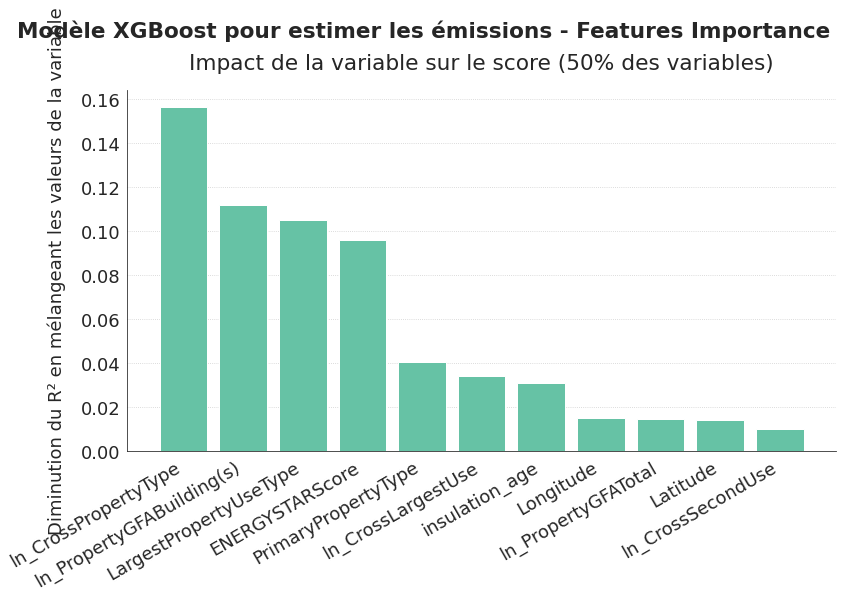

In [ ]:
fig, ax = graph_importance(feat_imp3, "importance", "Impact de la variable sur le score", "XGBoost", 
                           "les émissions", horizontal=False, rotation=30, ha='right')
ax[0].set_ylabel("Diminution du R² en mélangeant les valeurs de la variable")
save_fig("ml03_2_63_emissions3a")
plt.show()

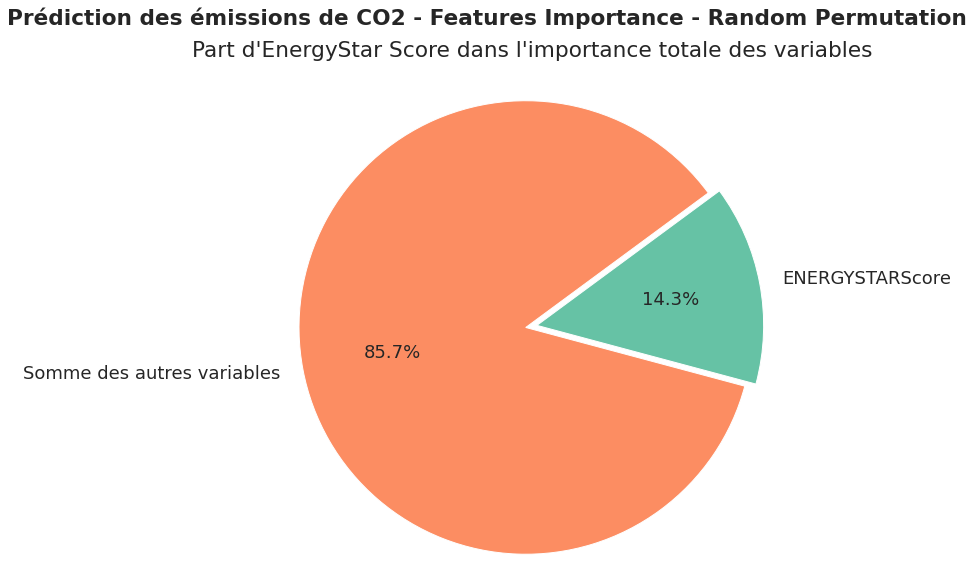

In [ ]:
sum_importances = feat_imp3.importance.sum()
values = [feat_imp3[feat_imp3.index == "ENERGYSTARScore"].importance / sum_importances,
          feat_imp3[feat_imp3.index != "ENERGYSTARScore"].importance.sum() / sum_importances]
labels = ["ENERGYSTARScore", "Somme des autres variables"]
graph = sfg.MyGraph("Prédiction des émissions de CO2 - Features Importance - Random Permutation")
graph.add_pie(values, labels, startangle=-15, explodes=(0.05,0),
              subtitle="Part d'EnergyStar Score dans l'importance totale des variables")
fig, ax = graph.fig, graph.ax
save_fig("ml03_2_63_emissions3b")
plt.show()

**Importance des variables calculée par XGBoost (gain moyen)**

In [ ]:
# emissions_pipeline for XGBRegressor
emissions_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_mean), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1)),
    ('data_encoders', FitToPandas(encoder_leaveoneout, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=True, keep_all=True)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler()))
])
reg = XGBRegressor(n_jobs=-1, random_state=42,
                    objective='reg:squarederror', n_estimators=150, learning_rate=0.07,
                    max_depth=3, min_child_weight=13, colsample_bytree=0.48, subsample=0.73, gamma=0.34,
                    estimator__reg_alpha=0.2, estimator__reg_lambda=1.3)

In [ ]:
transformed_data = emissions_pipeline.fit_transform(X_train_emissions, ln_y_train_emissions)
reg.fit(transformed_data, ln_y_train_emissions)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=0.48,
             estimator__reg_alpha=0.2, estimator__reg_lambda=1.3, gamma=0.34,
             importance_type='gain', learning_rate=0.07, max_delta_step=0,
             max_depth=3, min_child_weight=13, missing=None, n_estimators=150,
             n_jobs=-1, nthread=None, objective='reg:squarederror',
             random_state=42, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
             seed=None, silent=None, subsample=0.73, verbosity=1)

In [ ]:
boost = reg.get_booster()

In [ ]:
feature_importance = pd.DataFrame({'weight': boost.get_score(importance_type='weight'),
                                   'gain': boost.get_score(importance_type='gain'),
                                   'total_gain': boost.get_score(importance_type='total_gain')},
                                  index = transformed_data.columns)
feature_importance.head()

,weight,gain,total_gain
BuildingType,11.0,9.806327,107.869595
PrimaryPropertyType,43.0,25.077225,1078.320658
LargestPropertyUseType,82.0,17.796676,1459.327439
SecondLargestPropertyUseType,20.0,5.230775,104.615490
ThirdLargestPropertyUseType,18.0,5.144875,92.607756


In [ ]:
feature_importance.describe()

,weight,gain,total_gain
count,20.000000,20.000000,20.000000
mean,42.950000,12.019679,673.922437
std,29.009028,11.570783,900.657312
min,10.000000,2.758888,30.670751
25%,17.000000,4.954354,101.613557
50%,42.500000,5.530221,249.998042
75%,67.500000,12.291633,1034.121206
max,98.000000,42.270081,3254.796200


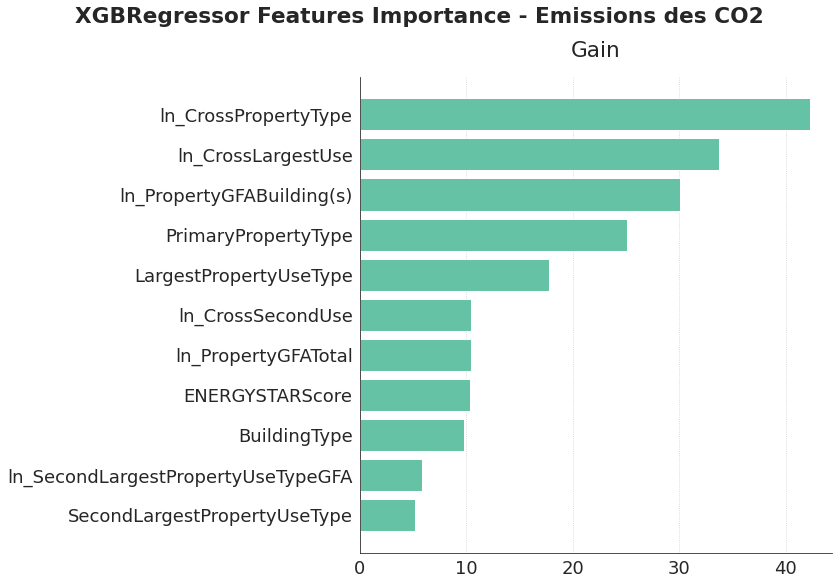

In [ ]:
feat = feature_importance[feature_importance.gain>5.150].sort_values("gain")
graph = sfg.MyGraph("XGBRegressor Features Importance - Emissions des CO2", figsize=(12,8))
graph.add_barh(feat.index, feat.gain, subtitle='Gain')
fig, ax = graph.fig, graph.ax
ax[0].tick_params(axis="y")
save_fig("ml03_2_63_emissions3c")
plt.show()

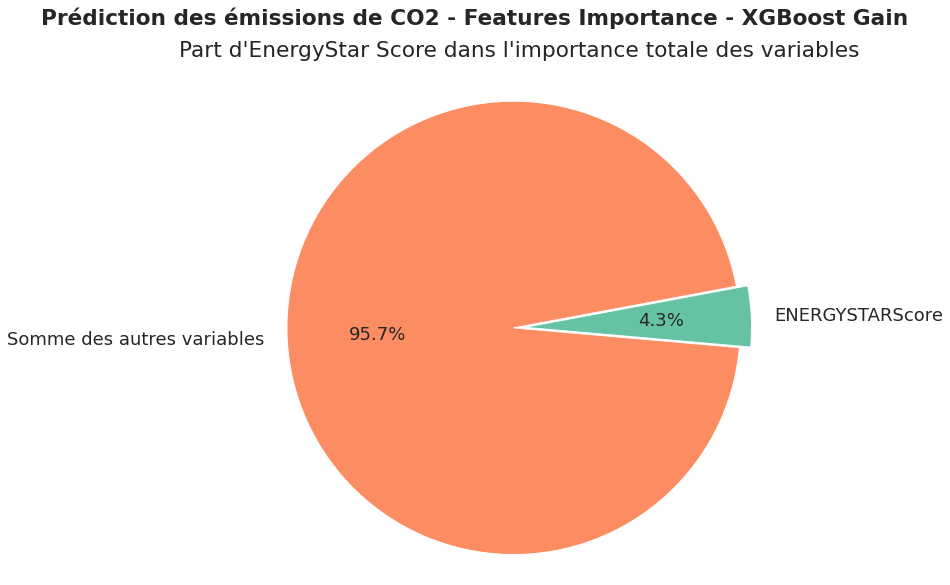

In [ ]:
sum_gains = feature_importance.gain.sum()
values = [feature_importance[feature_importance.index == "ENERGYSTARScore"].gain / sum_gains,
          feature_importance[feature_importance.index != "ENERGYSTARScore"].gain.sum() / sum_gains]
labels = ["ENERGYSTARScore", "Somme des autres variables"]
graph = sfg.MyGraph("Prédiction des émissions de CO2 - Features Importance - XGBoost Gain")
graph.add_pie(values, labels, startangle=-5, explodes=(0.05,0),
              subtitle="Part d'EnergyStar Score dans l'importance totale des variables")
fig, ax = graph.fig, graph.ax
save_fig("ml03_2_63_emissions3d")
plt.show()

<a id='5_6'></a>

### 5.6. Choix du modèle pour estimer les émissions

In [ ]:
xgb_final_step = pd.read_csv("hyperopt_emissions_xgboost_finalverif.csv")
xgb_final_step

,valid_score_mean,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,data_transfo_time,estimator,iteration
0,0.567657,0.049107,0.004397,0.707209,0.007021,0.205188,0.263393,"XGBRegressor(base_score=0.5, booster='gbtree',...",1


In [ ]:
extratrees_final_step = pd.read_csv("hyperopt_emissions_extratrees_finalverif.csv")
extratrees_final_step.head()

,valid_score_mean,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,data_transfo_time,estimator,iteration
0,0.555469,0.044611,0.103822,0.865197,0.003589,0.528696,0.274698,"ExtraTreesRegressor(bootstrap=True, ccp_alpha=...",1


In [ ]:
emissions_compar_final = pd.concat([xgb_final_step, extratrees_final_step], ignore_index=True)
emissions_compar_final["total_time"] = emissions_compar_final.valid_time_mean + emissions_compar_final.data_transfo_time
emissions_compar_final["estimator"] = [inter[:inter.find('(')] for inter in emissions_compar_final["estimator"]]
emissions_compar_final

,valid_score_mean,valid_score_std,valid_time_mean,train_score_mean,train_score_std,train_time_mean,data_transfo_time,estimator,iteration,total_time
0,0.567657,0.049107,0.004397,0.707209,0.007021,0.205188,0.263393,XGBRegressor,1,0.26779
1,0.555469,0.044611,0.103822,0.865197,0.003589,0.528696,0.274698,ExtraTreesRegressor,1,0.37852


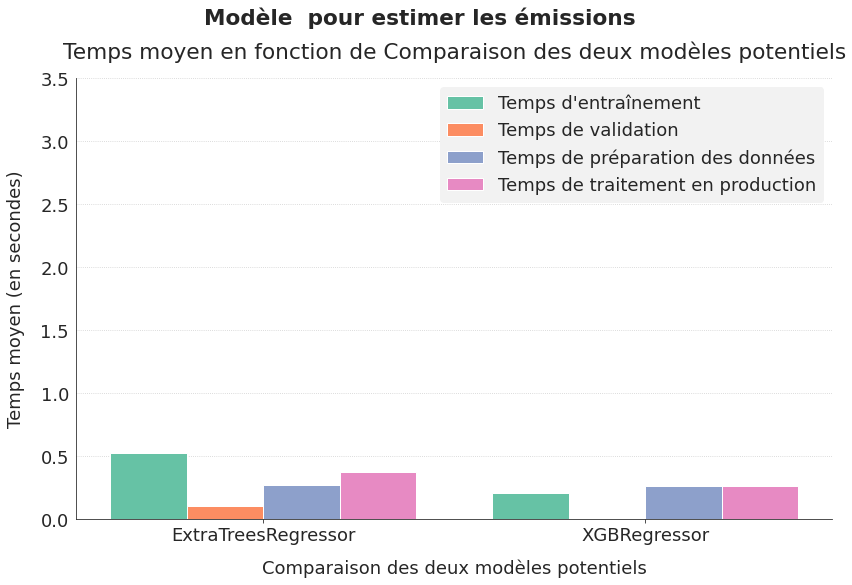

In [ ]:
fig, ax = graph_modele_time(emissions_compar_final, "estimator", "", "Comparaison des deux modèles potentiels", 
                            "les émissions", ymax=3.5, with_bars=True)
save_fig("ml03_2_61_emissions1a")
plt.show()

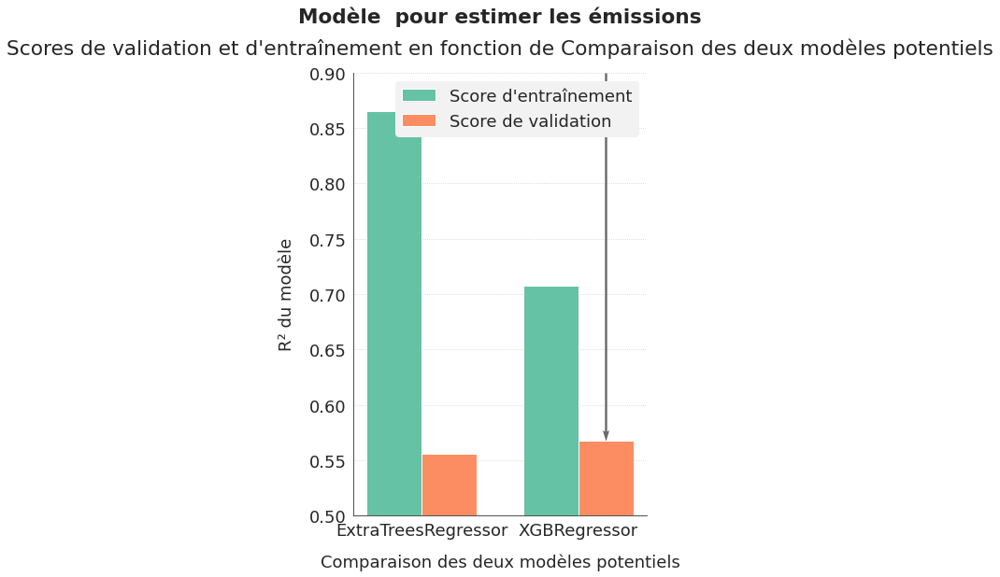

In [ ]:
fig, ax = graph_compar_train_valid(emissions_compar_final, "estimator", "", "Comparaison des deux modèles potentiels", 
                                   "les émissions", ymin=0.5, ymax=0.9, with_bars=True)
save_fig("ml03_2_61_emissions1b", tight_layout=False)
plt.show()

Le modèle XGBoost est légèrement plus rapide, obtient un meilleur score de validation et présente moins d'overfitting. Je vais donc privilégier ce modèle.

<a id='5_7'></a>

### 5.7. Evaluation du modèle retenu : XGBoost

In [ ]:
# emissions XGBRegressor final
emissions_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_mean), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1)),
    ('data_encoders', FitToPandas(encoder_leaveoneout, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=True, keep_all=True)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler()))
])
reg = XGBRegressor(n_jobs=-1, random_state=42,
                    objective='reg:squarederror', n_estimators=150, learning_rate=0.07,
                    max_depth=3, min_child_weight=13, colsample_bytree=0.48, subsample=0.73, gamma=0.34,
                    estimator__reg_alpha=0.2, estimator__reg_lambda=1.3)

**Performance de validation sur les données d'entraînement**

In [ ]:
df_analysis, df_scores = get_regmodel_analysis(emissions_pipeline, reg, X_train_emissions, ln_y_train_emissions, inverse_transfo_y='exp',
                                          xdesc=desc_train_emissions)
df_analysis = add_outliers_flag(df_analysis, inverse_transfo_y=True)
df_analysis.head()

,OSEBuildingID,DataYear,PropertyName,CouncilDistrictCode,Neighborhood,Outlier,true_values,crossed_predictions,train_predictions,transfo_true_values,transfo_crossed_predictions,transfo_train_predictions,flag_outlier,flag_transfo_outlier
2015_1,1,2015,Mayflower Park Hotel,7,Downtown,Inlier,5.519178,5.496422,5.637461,249.43,243.817947,280.748901,False,False
2015_2,2,2015,Paramount Hotel,7,Downtown,Inlier,5.574091,5.013309,5.329084,263.51,150.401657,206.248947,False,False
2015_3,3,2015,Westin Hotel,7,Downtown,Inlier,7.631179,6.866699,7.806078,2061.48,959.774841,2455.482178,False,True
2015_5,5,2015,Hotel Max,7,Downtown,High Outlier,7.568555,5.928672,6.344857,1936.34,375.655243,569.556030,False,True
2015_9,9,2015,West Precinct (Seattle Police),7,Downtown,Inlier,5.719065,4.530293,4.705631,304.62,92.785744,110.568062,False,True


In [ ]:
print("Validation croisée sur le log des émissions :")
print(get_reg_scores(df_scores, cv=True, inverse_transfo_y=False))

Validation croisée sur le log des émissions :
Scores

 R² = 57.00% 
 RMSE = 0.975 
 Mean AE = 0.746 
 Median AE = 0.589 


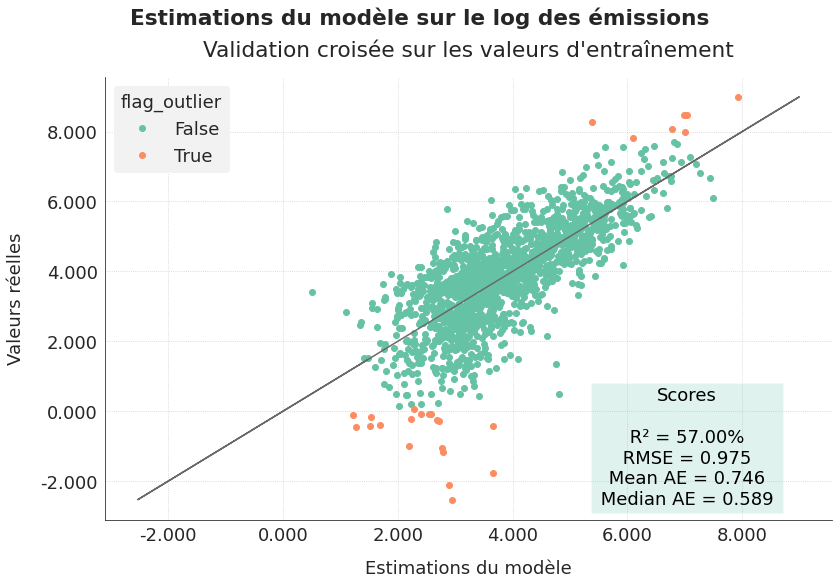

In [ ]:
fig, ax = graph_verif_estimations(df_analysis, df_scores, cv=True, inverse_transfo_y=False, ticks_format=':.3f',
                                  hue='flag_outlier', title="Estimations du modèle sur le log des émissions")
save_fig("ml03_2_62_emissions2a")
plt.show()

**Performance de validation sur les données d'entraînement, sans les outliers**

In [ ]:
outliers = get_outliers(ln_y_train_emissions)
xtrain = X_train_emissions[~outliers].copy()
ytrain = ln_y_train_emissions[~outliers].copy()
xdesc = desc_train_emissions[~outliers].copy()

In [ ]:
df_analysis_corrected, df_scores_corrected = get_regmodel_analysis(emissions_pipeline, reg, xtrain, ytrain,
                                                              inverse_transfo_y='exp', xdesc=xdesc)
df_analysis_corrected = add_outliers_flag(df_analysis_corrected, inverse_transfo_y=True)
df_analysis_corrected.head()

,OSEBuildingID,DataYear,PropertyName,CouncilDistrictCode,Neighborhood,Outlier,true_values,crossed_predictions,train_predictions,transfo_true_values,transfo_crossed_predictions,transfo_train_predictions,flag_outlier,flag_transfo_outlier
2015_1,1,2015,Mayflower Park Hotel,7,Downtown,Inlier,5.519178,5.626552,5.617180,249.43,277.702972,275.112427,False,False
2015_2,2,2015,Paramount Hotel,7,Downtown,Inlier,5.574091,5.209654,5.217564,263.51,183.030777,184.484161,False,False
2015_3,3,2015,Westin Hotel,7,Downtown,Inlier,7.631179,7.042078,7.451642,2061.48,1143.761353,1722.689575,False,True
2015_5,5,2015,Hotel Max,7,Downtown,High Outlier,7.568555,6.005608,6.142349,1936.34,405.697601,465.145020,False,True
2015_9,9,2015,West Precinct (Seattle Police),7,Downtown,Inlier,5.719065,4.342060,4.710522,304.62,76.865730,111.110161,False,True


In [ ]:
print("Validation croisée sur le log des émissions - Sans les outliers:")
print(get_reg_scores(df_scores_corrected, cv=True, inverse_transfo_y=False))

Validation croisée sur le log des émissions - Sans les outliers:
Scores

 R² = 56.41% 
 RMSE = 0.907 
 Mean AE = 0.711 
 Median AE = 0.576 


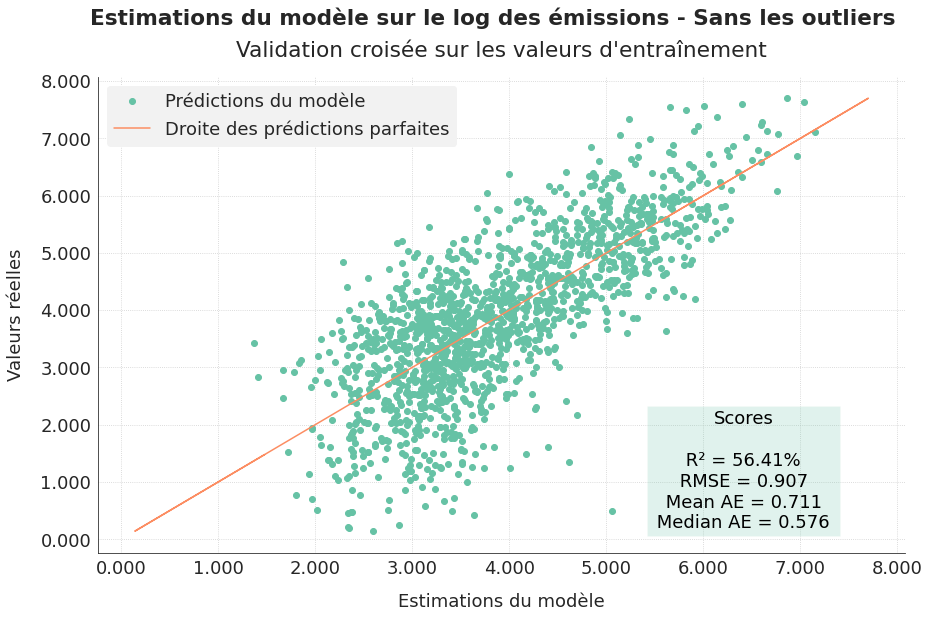

In [ ]:
fig, ax = graph_verif_estimations(df_analysis_corrected, df_scores_corrected, cv=True, inverse_transfo_y=False, ticks_format=':.3f',
                                  title="Estimations du modèle sur le log des émissions - Sans les outliers")
plt.show()

**Performance de généralisation sur les données de test**

In [ ]:
desc_test_emissions = data_test[data_test[y_emissions].notna()][desc_columns].copy()
X_test_emissions = data_test[data_test[y_emissions].notna()][X_columns].copy()
y_test_emissions = data_test[data_test[y_emissions].notna()][y_emissions].copy()
ln_y_test_emissions = np.log(y_test_emissions)

In [ ]:
# emissions XGBRegressor final
emissions_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_mean), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1)),
    ('data_encoders', FitToPandas(encoder_leaveoneout, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=True, keep_all=True)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler()))
])
reg = XGBRegressor(n_jobs=-1, random_state=42,
                    objective='reg:squarederror', n_estimators=150, learning_rate=0.07,
                    max_depth=3, min_child_weight=13, colsample_bytree=0.48, subsample=0.73, gamma=0.34,
                    estimator__reg_alpha=0.2, estimator__reg_lambda=1.3)

In [ ]:
test_analysis, test_scores = get_regtest_analysis(emissions_pipeline, reg, X_train_emissions, ln_y_train_emissions, X_test_emissions,
                                              ln_y_test_emissions, inverse_transfo_y='exp', xdesc=desc_test_emissions)
test_analysis = add_outliers_flag(test_analysis, inverse_transfo_y=True)
test_analysis.head()

,OSEBuildingID,DataYear,PropertyName,CouncilDistrictCode,Neighborhood,Outlier,true_values,predictions,transfo_true_values,transfo_predictions,flag_outlier,flag_transfo_outlier
2016_1,1,2016,Mayflower Park Hotel,7,Downtown,NaN,5.521381,5.735130,249.98,309.553162,False,False
2016_2,2,2016,Paramount Hotel,7,Downtown,NaN,5.689886,5.281911,295.86,196.745483,False,False
2016_3,3,2016,5673-The Westin Seattle,7,Downtown,NaN,7.644575,7.585552,2089.28,1969.533936,False,True
2016_5,5,2016,Hotel Max,7,Downtown,NaN,5.657494,5.670590,286.43,290.205811,False,False
2016_8,8,2016,Warwick Seattle Hotel (Id8),7,Downtown,NaN,6.224578,5.163030,505.01,174.692917,False,True


In [ ]:
print("Généralisation du modèle sur les données de test - log des émissions :")
print(get_test_scores(test_scores, inverse_transfo_y=False))

Généralisation du modèle sur les données de test - log des émissions :
Scores

 R² = 66.26% 
 RMSE = 0.857 
 Mean AE = 0.658 
 Median AE = 0.521 


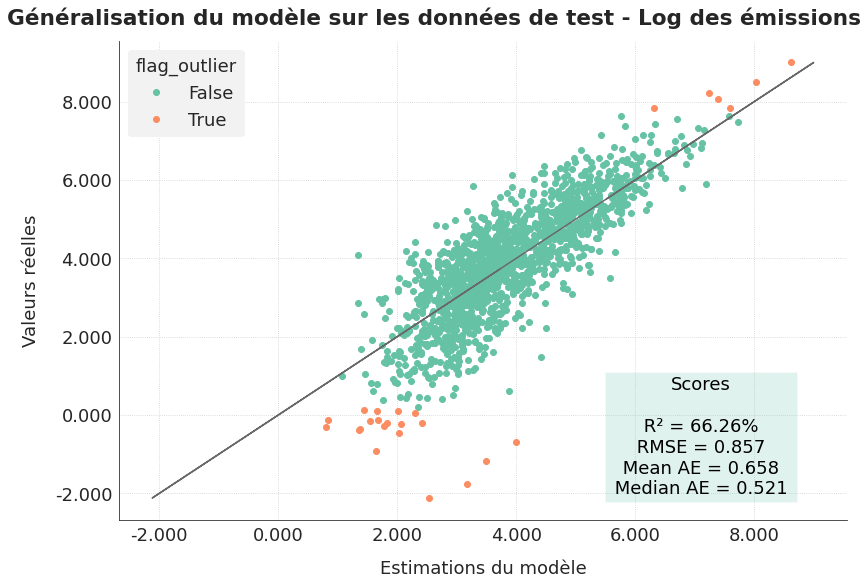

In [ ]:
fig, ax = graph_verif_test(test_analysis, test_scores, inverse_transfo_y=False, ticks_format=':.3f', hue='flag_outlier',
                           title="Généralisation du modèle sur les données de test - Log des émissions")
save_fig("ml03_2_62_emissions2b")
plt.show()

**Performance de généralisation sur les données de test, sans les outliers**

In [ ]:
outliers = get_outliers(ln_y_test_emissions)
xtest = X_test_emissions[~outliers].copy()
ytest = ln_y_test_emissions[~outliers].copy()
xdesc = desc_test_emissions[~outliers].copy()

In [ ]:
df_analysis_corrected, df_scores_corrected = get_regtest_analysis(emissions_pipeline, reg, xtrain, ytrain, xtest, ytest,
                                                              inverse_transfo_y='exp', xdesc=xdesc)
df_analysis_corrected = add_outliers_flag(df_analysis_corrected, inverse_transfo_y=True)
df_analysis_corrected.head()

,OSEBuildingID,DataYear,PropertyName,CouncilDistrictCode,Neighborhood,Outlier,true_values,predictions,transfo_true_values,transfo_predictions,flag_outlier,flag_transfo_outlier
2016_1,1,2016,Mayflower Park Hotel,7,Downtown,NaN,5.521381,5.591872,249.98,268.237335,False,False
2016_2,2,2016,Paramount Hotel,7,Downtown,NaN,5.689886,5.221736,295.86,185.255493,False,False
2016_3,3,2016,5673-The Westin Seattle,7,Downtown,NaN,7.644575,7.069204,2089.28,1175.212036,False,True
2016_5,5,2016,Hotel Max,7,Downtown,NaN,5.657494,5.547907,286.43,256.699799,False,False
2016_8,8,2016,Warwick Seattle Hotel (Id8),7,Downtown,NaN,6.224578,5.248596,505.01,190.298843,False,True


In [ ]:
print("Généralisation du modèle sur les données de test - Log des émissions - Sans les outliers :")
print(get_test_scores(df_scores_corrected, inverse_transfo_y=False))

Généralisation du modèle sur les données de test - Log des émissions - Sans les outliers :
Scores

 R² = 66.42% 
 RMSE = 0.794 
 Mean AE = 0.626 
 Median AE = 0.512 


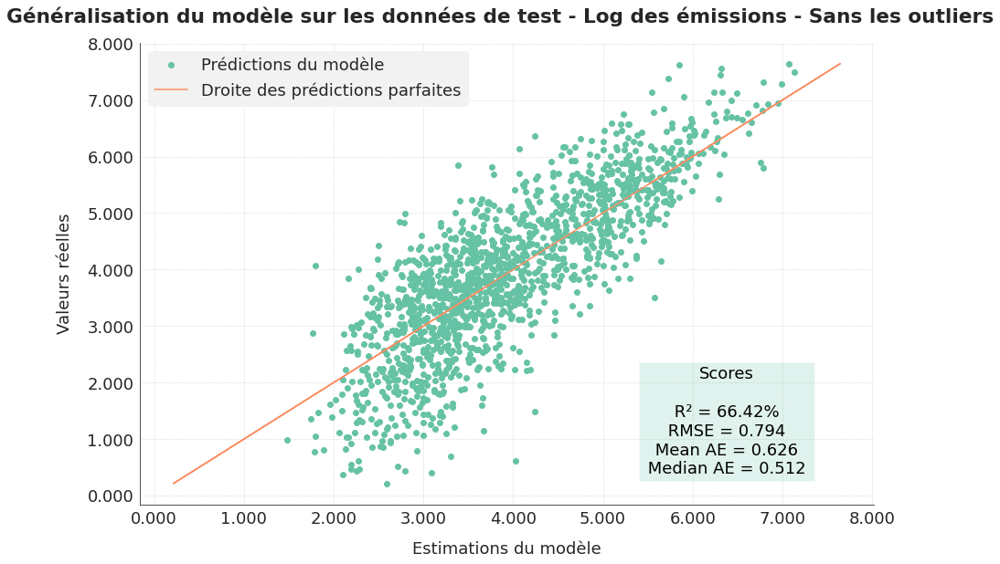

In [ ]:
fig, ax = graph_verif_test(df_analysis_corrected, df_scores_corrected, inverse_transfo_y=False, ticks_format=':.3f',
                      title="Généralisation du modèle sur les données de test - Log des émissions - Sans les outliers")
plt.show()

**Comparaison de la généralisation de la performance sur les différents groupes de type principal de propriété**

In [ ]:
propertytype_analysis, propertytype_scores = get_regtest_analysis(emissions_pipeline, reg, X_train_emissions, ln_y_train_emissions,
                                                                  X_test_emissions, ln_y_test_emissions, inverse_transfo_y='exp', 
                                                                  xdesc=desc_test_emissions, hue="PrimaryPropertyType")
propertytype_analysis = add_outliers_flag(propertytype_analysis, inverse_transfo_y=True)
propertytype_analysis.head()

,OSEBuildingID,DataYear,PropertyName,CouncilDistrictCode,Neighborhood,Outlier,true_values,predictions,transfo_true_values,transfo_predictions,PrimaryPropertyType,flag_outlier,flag_transfo_outlier
2016_1,1,2016,Mayflower Park Hotel,7,Downtown,NaN,5.521381,5.735130,249.98,309.553162,Hotel,False,False
2016_2,2,2016,Paramount Hotel,7,Downtown,NaN,5.689886,5.281911,295.86,196.745483,Hotel,False,False
2016_3,3,2016,5673-The Westin Seattle,7,Downtown,NaN,7.644575,7.585552,2089.28,1969.533936,Hotel,False,True
2016_5,5,2016,Hotel Max,7,Downtown,NaN,5.657494,5.670590,286.43,290.205811,Hotel,False,False
2016_8,8,2016,Warwick Seattle Hotel (Id8),7,Downtown,NaN,6.224578,5.163030,505.01,174.692917,Hotel,False,True


In [ ]:
print("Généralisation du modèle sur les données de test - log des émissions :")
indexes = propertytype_scores.index.str.startswith("transfo") == False
print(propertytype_scores[indexes])

Généralisation du modèle sur les données de test - log des émissions :
                                         R²      RMSE   Mean AE  Median AE
Hotel (68)                         0.791677  0.521615  0.387940   0.307871
Other (221)                        0.518165  1.057730  0.769279   0.594484
Mixed Use Property (111)           0.545353  0.990980  0.766236   0.653959
K-12 School (124)                  0.632808  0.596579  0.458271   0.326092
University (22)                    0.636477  1.049598  0.875859   0.789163
Small- and Mid-Sized Office (255)  0.391107  0.788468  0.611153   0.471857
Self-Storage Facility (28)         0.286429  1.287055  1.119294   1.134239
Large Office (158)                 0.608790  0.573555  0.480343   0.440081
Senior Care Community (35)         0.367197  0.710497  0.570516   0.481418
Medical Office (31)                0.782582  0.641581  0.552032   0.490471
Residence Hall (17)                0.470175  0.942244  0.870979   0.814141
Retail Store (81)            

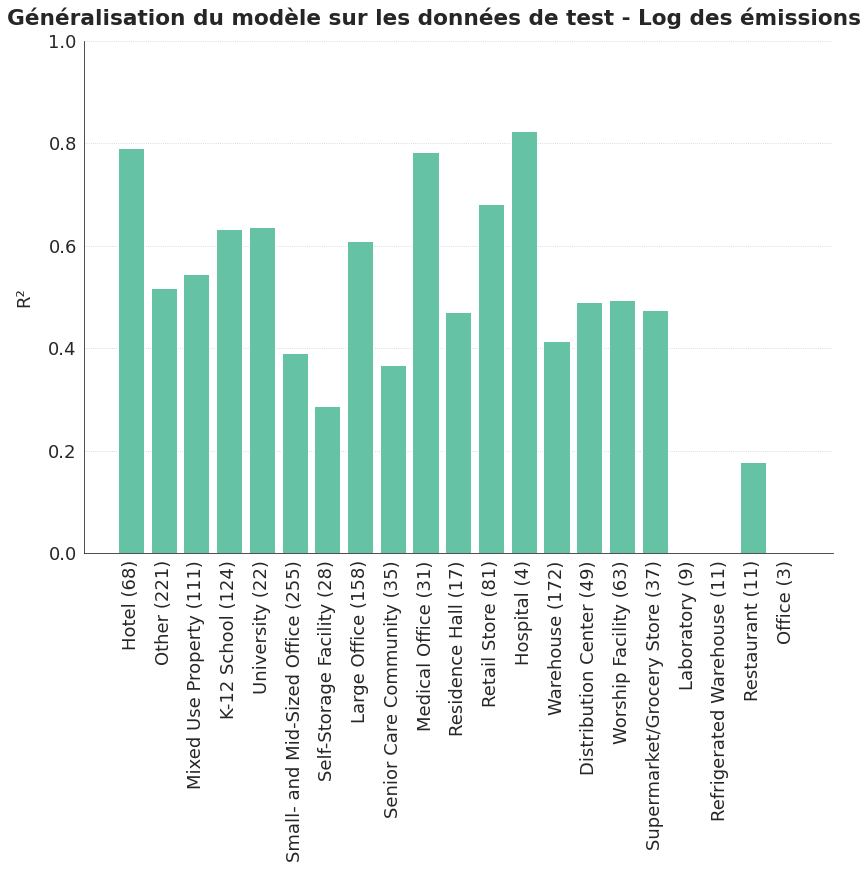

In [ ]:
fig, ax = graph_generalisation_hue(propertytype_scores, score=0, inverse_transfo_y=False, ticks_format=None, 
                                   title="Généralisation du modèle sur les données de test - Log des émissions",
                                   ymin=0, ymax=1, rotation=90)
save_fig("ml03_2_62_emissions2c", tight_layout=False)
plt.show()

**Comparaison de la performance de généralisation entre les propriétés déjà présentes en 2015 et les nouvelles propriétés de 2016**

In [ ]:
index2015 = desc_train_emissions["OSEBuildingID"]
samebuilding_index = desc_test_emissions.OSEBuildingID.isin(index2015)

In [ ]:
xtest = X_test_emissions[samebuilding_index].copy()
ytest = ln_y_test_emissions[samebuilding_index].copy()
xdesc = desc_test_emissions[samebuilding_index].copy()

In [ ]:
samebuilding_analysis, samebuilding_scores = get_regtest_analysis(emissions_pipeline, reg, X_train_emissions, ln_y_train_emissions,
                                                                  xtest, ytest, xdesc=xdesc)

In [ ]:
print("Généralisation du modèle sur les données de test - Log des émissions - Mêmes buildings qu'en 2015 :")
print(get_test_scores(samebuilding_scores, inverse_transfo_y=False))

Généralisation du modèle sur les données de test - Log des émissions - Mêmes buildings qu'en 2015 :
Scores

 R² = 67.56% 
 RMSE = 0.840 
 Mean AE = 0.650 
 Median AE = 0.520 


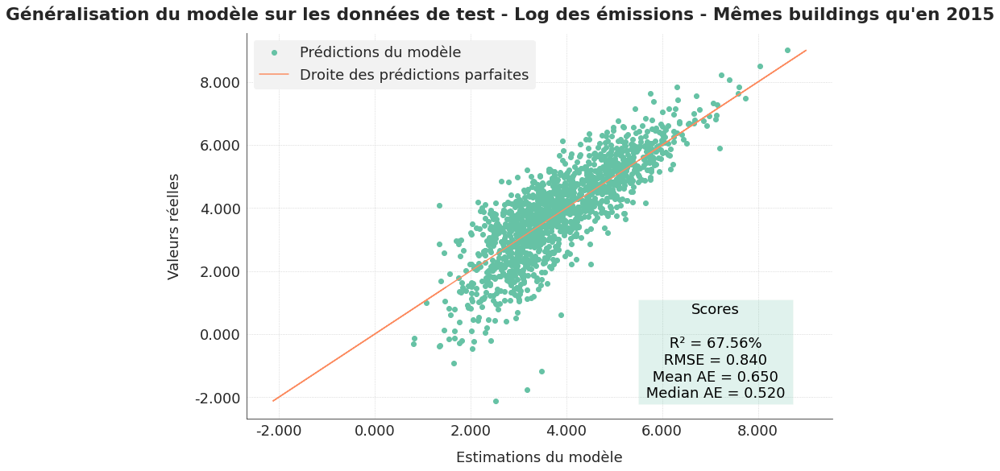

In [ ]:
fig, ax = graph_verif_test(samebuilding_analysis, samebuilding_scores, inverse_transfo_y=False, ticks_format=':.3f',
              title="Généralisation du modèle sur les données de test - Log des émissions - Mêmes buildings qu'en 2015")
save_fig("ml03_2_62_emissions2d")
plt.show()

In [ ]:
xtest = X_test_emissions[samebuilding_index==False].copy()
ytest = ln_y_test_emissions[samebuilding_index==False].copy()
xdesc = desc_test_emissions[samebuilding_index==False].copy()

In [ ]:
newbuilding_analysis, newbuilding_scores = get_regtest_analysis(emissions_pipeline, reg, X_train_emissions, ln_y_train_emissions,
                                                                  xtest, ytest, xdesc=xdesc)

In [ ]:
print("Généralisation du modèle sur les données de test - Log des émissions - Nouveaux buildings :")
print(get_test_scores(newbuilding_scores, inverse_transfo_y=False))

Généralisation du modèle sur les données de test - Log des émissions - Nouveaux buildings :
Scores

 R² = 33.90% 
 RMSE = 1.223 
 Mean AE = 0.875 
 Median AE = 0.553 


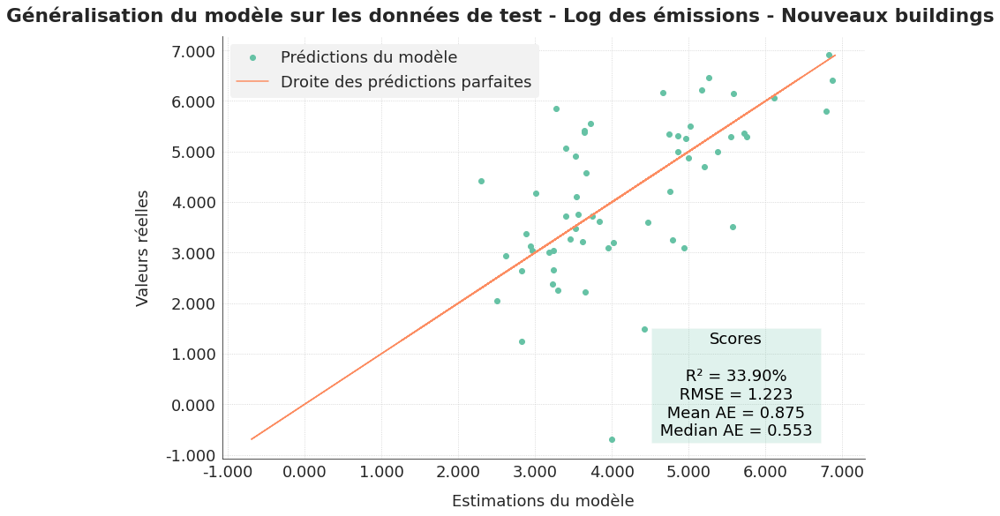

In [ ]:
fig, ax = graph_verif_test(newbuilding_analysis, newbuilding_scores, inverse_transfo_y=False, ticks_format=':.3f',
              title="Généralisation du modèle sur les données de test - Log des émissions - Nouveaux buildings")
save_fig("ml03_2_62_emissions2e")
plt.show()

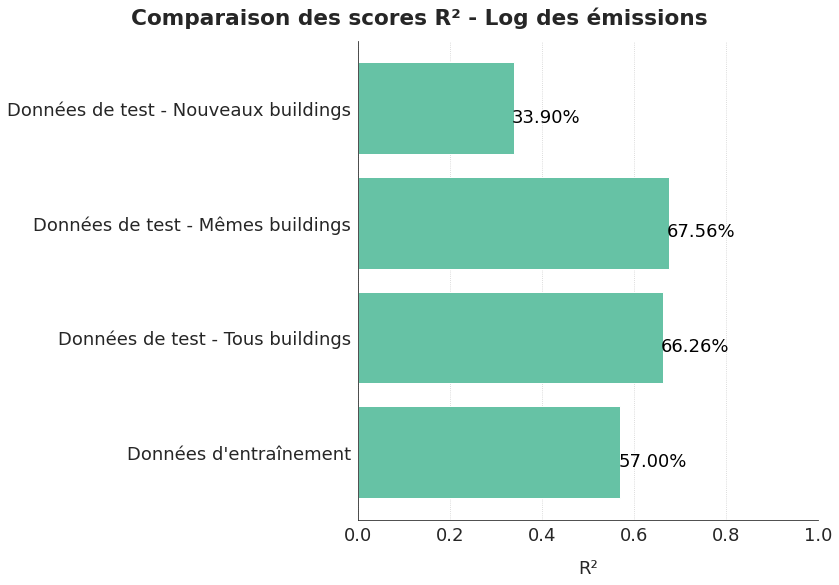

In [ ]:
labels = ["Données d'entraînement", "Données de test - Tous buildings",
                "Données de test - Mêmes buildings", "Données de test - Nouveaux buildings"]
values = [0.5700, 0.6626, 0.6756, 0.3390]
graph = sfg.MyGraph("Comparaison des scores R² - Log des émissions")
graph.add_barh(labels, values)
for i, v in enumerate(values):
    graph.add_text(v+0.07, i, "{:.2%}".format(v), backgroundalpha=0)
graph.set_axe_x(label="R²", tick_min=0, tick_max=1)
fig, ax = graph.fig, graph.ax
save_fig("ml03_2_62_emissions2f")
plt.show()

Toutes les performances de validation et de généralisation sont moins bonnes pour les émissions, par rapport aux performances obtenues pour l'estimation de la consommation.  
Elles sont mêmes médiocres pour la généralisation à de nouvelles propriétés.

<a id='5_8'></a>

### 5.8. Amélioration du modèle en ajoutant la consommation estimée

J'utilise le modèle XGBoost que je viens d'optimiser, et j'ajoute une colonne qui comporte les estimations de la consommation que nous avons calculé avec le modèle choisi pour l'estimation de la consommation.

In [ ]:
num_col = ["DataYear", "Latitude", "Longitude", "YearBuilt", "NumberofBuildings", "NumberofFloors",
           "PropertyGFATotal", "PropertyGFAParking", "PropertyGFABuilding(s)",
           "LargestPropertyUseTypeGFA", "SecondLargestPropertyUseTypeGFA",
           "ThirdLargestPropertyUseTypeGFA", "ENERGYSTARScore", "consommation_estimate"]

In [ ]:
X_new_train_emissions = X_train_emissions.merge(estimate_conso_train, how='left', left_index=True, right_index=True)

In [ ]:
# emissions XGBRegressor final
emissions_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_mean), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1)),
    ('data_encoders', FitToPandas(encoder_leaveoneout, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=True, keep_all=True)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler()))
])
reg = XGBRegressor(n_jobs=-1, random_state=42,
                    objective='reg:squarederror', n_estimators=150, learning_rate=0.07,
                    max_depth=3, min_child_weight=13, colsample_bytree=0.48, subsample=0.73, gamma=0.34,
                    estimator__reg_alpha=0.2, estimator__reg_lambda=1.3)

In [ ]:
df_analysis, df_scores = get_regmodel_analysis(emissions_pipeline, reg, X_new_train_emissions, ln_y_train_emissions,
                                               inverse_transfo_y='exp', xdesc=desc_train_emissions)
df_analysis = add_outliers_flag(df_analysis, inverse_transfo_y=True)
df_analysis.head()

,OSEBuildingID,DataYear,PropertyName,CouncilDistrictCode,Neighborhood,Outlier,true_values,crossed_predictions,train_predictions,transfo_true_values,transfo_crossed_predictions,transfo_train_predictions,flag_outlier,flag_transfo_outlier
2015_1,1,2015,Mayflower Park Hotel,7,Downtown,Inlier,5.519178,5.622772,5.664732,249.43,276.655151,288.510651,False,False
2015_2,2,2015,Paramount Hotel,7,Downtown,Inlier,5.574091,5.005021,5.098728,263.51,149.160156,163.813354,False,False
2015_3,3,2015,Westin Hotel,7,Downtown,Inlier,7.631179,7.018770,7.579598,2061.48,1117.411011,1957.842651,False,True
2015_5,5,2015,Hotel Max,7,Downtown,High Outlier,7.568555,5.693655,5.945302,1936.34,296.977234,381.954712,False,True
2015_9,9,2015,West Precinct (Seattle Police),7,Downtown,Inlier,5.719065,4.508510,4.784282,304.62,90.786453,119.615417,False,True


In [ ]:
print("Validation croisée sur le log des émissions :")
print(get_reg_scores(df_scores, cv=True, inverse_transfo_y=False))

Validation croisée sur le log des émissions :
Scores

 R² = 59.33% 
 RMSE = 0.948 
 Mean AE = 0.727 
 Median AE = 0.590 


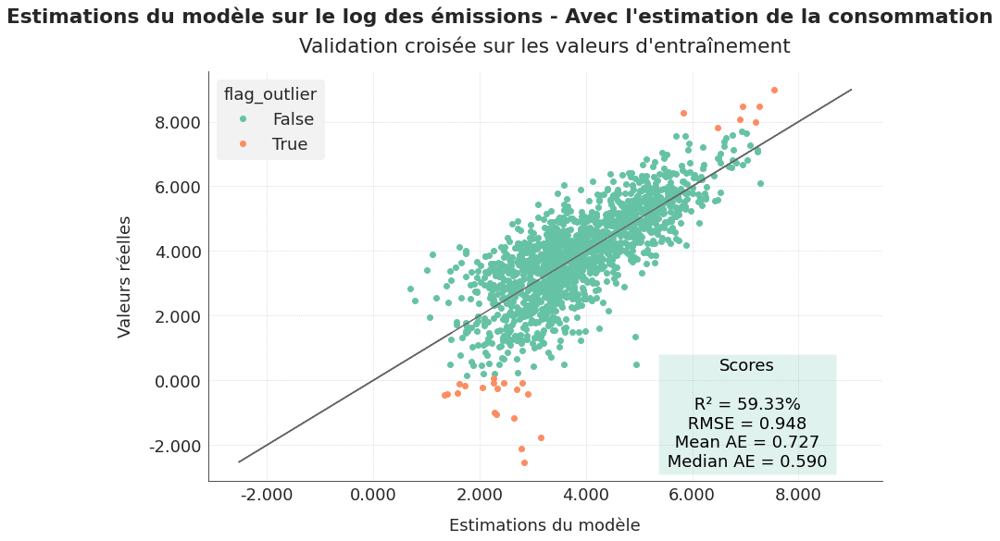

In [ ]:
fig, ax = graph_verif_estimations(df_analysis, df_scores, cv=True, inverse_transfo_y=False, ticks_format=':.3f',
                                  hue='flag_outlier',
                              title="Estimations du modèle sur le log des émissions - Avec l'estimation de la consommation")
save_fig("ml03_2_71_emissions1a")
plt.show()

In [ ]:
X_new_test_emissions = X_test_emissions.merge(estimate_conso_test, how='left', left_index=True, right_index=True)

In [ ]:
# emissions XGBRegressor final
emissions_pipeline = Pipeline([
    ('data_init_tranfo', InitListCols(transfo_col, num_col, categ_col, log_col, log1p_col)),
    ('data_propertyuse_imputer', PropertyUseImputer()),
    ('data_imputers', PandasColumnTransformer(transfo_col, [
            ('num_imputer', FitToPandas(imputer_mean), 'num'),
            ('categ_imputer', FitToPandas(imputer_mostfrequent), 'categ')], n_jobs=-1)),
    ('data_encoders', FitToPandas(encoder_leaveoneout, transfo_col, 'categ')),
    ('data_transfo_categ', UpdateTransfoCols(transfo_col, 'transfo_categ')),
    ('data_add_features', AddFeatures(transfo_col, add_cross=True, keep_all=True)),
    ('data_log_transfo', TransformFeatures(transfo_col, 'log')),
    ('data_log1p_transfo', TransformFeatures(transfo_col, 'log1p')),
    ('data_transfo_num', UpdateTransfoCols(transfo_col, 'transfo_num')),
    ('data_scalers', FitToPandas(StandardScaler()))
])
reg = XGBRegressor(n_jobs=-1, random_state=42,
                    objective='reg:squarederror', n_estimators=150, learning_rate=0.07,
                    max_depth=3, min_child_weight=13, colsample_bytree=0.48, subsample=0.73, gamma=0.34,
                    estimator__reg_alpha=0.2, estimator__reg_lambda=1.3)

In [ ]:
test_analysis, test_scores = get_regtest_analysis(emissions_pipeline, reg, X_new_train_emissions, ln_y_train_emissions,
                                                  X_new_test_emissions, ln_y_test_emissions, 
                                                  inverse_transfo_y='exp', xdesc=desc_test_emissions)
test_analysis = add_outliers_flag(test_analysis, inverse_transfo_y=True)
test_analysis.head()

,OSEBuildingID,DataYear,PropertyName,CouncilDistrictCode,Neighborhood,Outlier,true_values,predictions,transfo_true_values,transfo_predictions,flag_outlier,flag_transfo_outlier
2016_1,1,2016,Mayflower Park Hotel,7,Downtown,NaN,5.521381,5.714629,249.98,303.271576,False,False
2016_2,2,2016,Paramount Hotel,7,Downtown,NaN,5.689886,5.018089,295.86,151.122208,False,False
2016_3,3,2016,5673-The Westin Seattle,7,Downtown,NaN,7.644575,7.533444,2089.28,1869.533813,False,True
2016_5,5,2016,Hotel Max,7,Downtown,NaN,5.657494,5.208228,286.43,182.769928,False,False
2016_8,8,2016,Warwick Seattle Hotel (Id8),7,Downtown,NaN,6.224578,4.907082,505.01,135.244141,False,True


In [ ]:
print("Généralisation du modèle sur les données de test - log des émissions :")
print(get_test_scores(test_scores, inverse_transfo_y=False))

Généralisation du modèle sur les données de test - log des émissions :
Scores

 R² = 69.19% 
 RMSE = 0.819 
 Mean AE = 0.641 
 Median AE = 0.520 


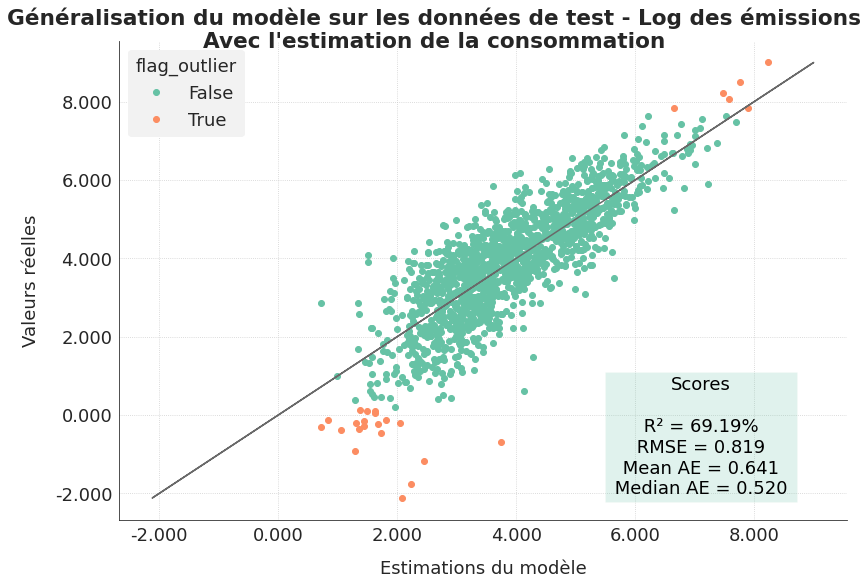

In [ ]:
fig, ax = graph_verif_test(test_analysis, test_scores, inverse_transfo_y=False, ticks_format=':.3f', hue='flag_outlier',
           title="Généralisation du modèle sur les données de test - Log des émissions\nAvec l'estimation de la consommation")
save_fig("ml03_2_71_emissions1b")
plt.show()

In [ ]:
index2015 = desc_train_emissions["OSEBuildingID"]
samebuilding_index = desc_test_emissions.OSEBuildingID.isin(index2015)

In [ ]:
xtest = X_new_test_emissions[samebuilding_index].copy()
ytest = ln_y_test_emissions[samebuilding_index].copy()
xdesc = desc_test_emissions[samebuilding_index].copy()

In [ ]:
samebuilding_analysis, samebuilding_scores = get_regtest_analysis(emissions_pipeline, reg, X_new_train_emissions, 
                                                                  ln_y_train_emissions, xtest, ytest, xdesc=xdesc)

In [ ]:
print("Généralisation du modèle sur les données de test - Log des émissions - Mêmes buildings qu'en 2015 :")
print(get_test_scores(samebuilding_scores, inverse_transfo_y=False))

Généralisation du modèle sur les données de test - Log des émissions - Mêmes buildings qu'en 2015 :
Scores

 R² = 70.40% 
 RMSE = 0.802 
 Mean AE = 0.633 
 Median AE = 0.519 


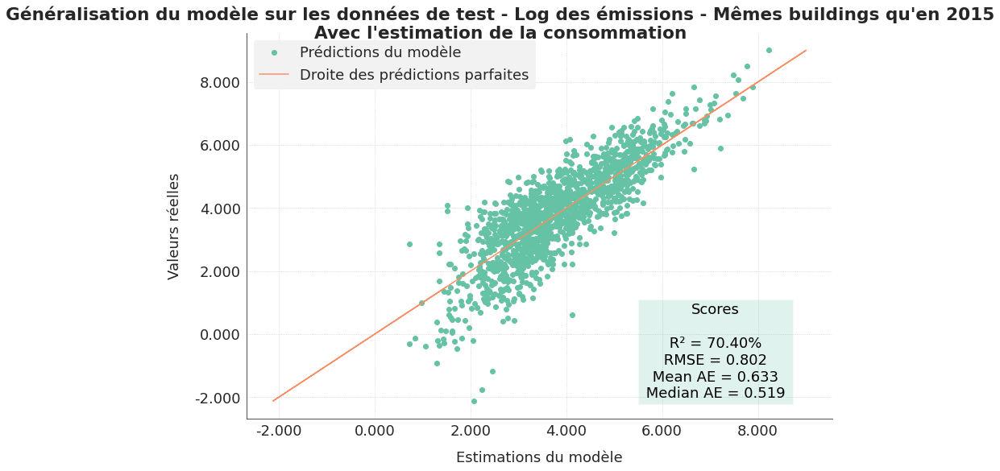

In [ ]:
fig, ax = graph_verif_test(samebuilding_analysis, samebuilding_scores, inverse_transfo_y=False, ticks_format=':.3f',
              title="Généralisation du modèle sur les données de test - Log des émissions - Mêmes buildings qu'en 2015\nAvec l'estimation de la consommation")
save_fig("ml03_2_71_emissions1c")
plt.show()

In [ ]:
xtest = X_new_test_emissions[samebuilding_index==False].copy()
ytest = ln_y_test_emissions[samebuilding_index==False].copy()
xdesc = desc_test_emissions[samebuilding_index==False].copy()

In [ ]:
newbuilding_analysis, newbuilding_scores = get_regtest_analysis(emissions_pipeline, reg, X_new_train_emissions,
                                                                ln_y_train_emissions, xtest, ytest, xdesc=xdesc)

In [ ]:
print("Généralisation du modèle sur les données de test - Log des émissions - Nouveaux buildings :")
print(get_test_scores(newbuilding_scores, inverse_transfo_y=False))

Généralisation du modèle sur les données de test - Log des émissions - Nouveaux buildings :
Scores

 R² = 39.10% 
 RMSE = 1.174 
 Mean AE = 0.838 
 Median AE = 0.577 


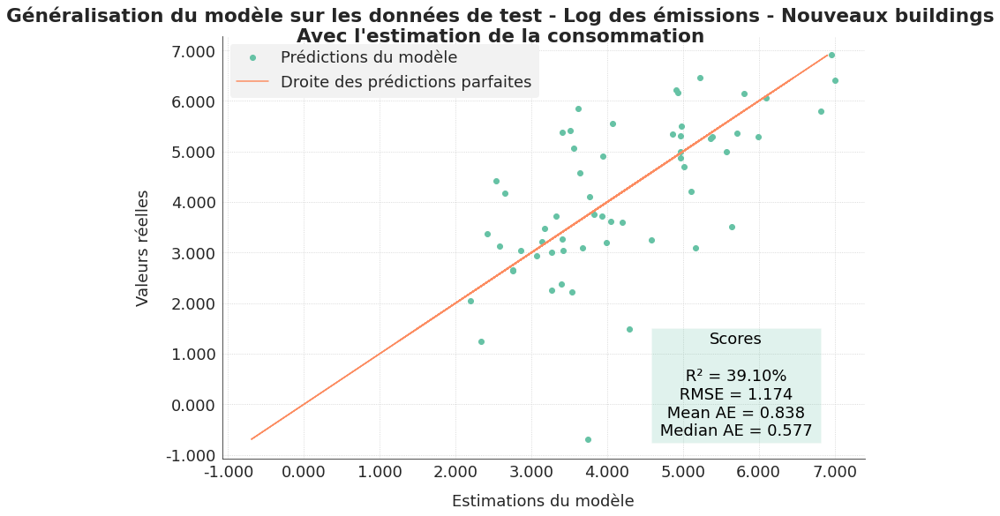

In [ ]:
fig, ax = graph_verif_test(newbuilding_analysis, newbuilding_scores, inverse_transfo_y=False, ticks_format=':.3f',
              title="Généralisation du modèle sur les données de test - Log des émissions - Nouveaux buildings\nAvec l'estimation de la consommation")
save_fig("ml03_2_71_emissions1d")
plt.show()

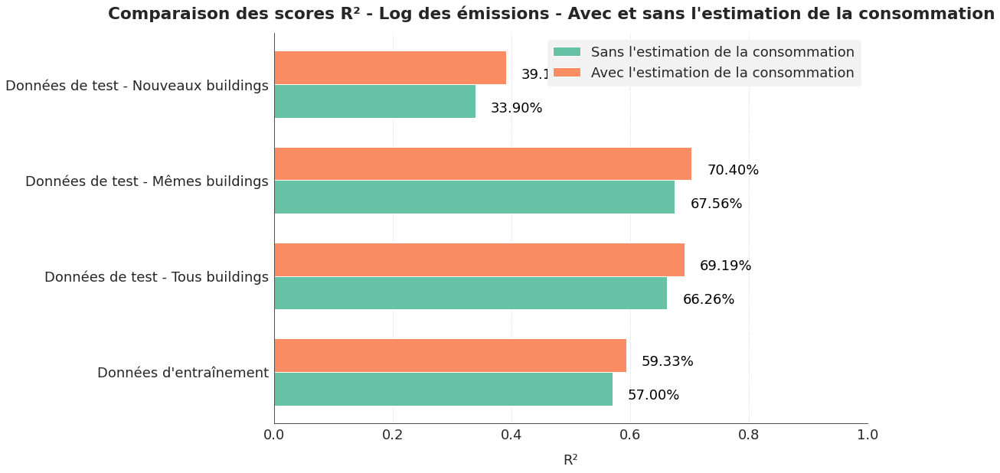

In [ ]:
labels = ["Données d'entraînement", "Données de test - Tous buildings",
                "Données de test - Mêmes buildings", "Données de test - Nouveaux buildings"]
values_sans = [0.5700, 0.6626, 0.6756, 0.3390]
values_avec = [0.5933, 0.6919, 0.7040, 0.3910]
barheight = 0.35
graph = sfg.MyGraph("Comparaison des scores R² - Log des émissions - Avec et sans l'estimation de la consommation")
graph.add_barh(np.arange(len(labels))-(barheight/2), values_sans,
               label="Sans l'estimation de la consommation", bar_height=barheight)
graph.add_barh(np.arange(len(labels))+(barheight/2), values_avec,
               label="Avec l'estimation de la consommation", bar_height=barheight, legend=True)
for i, v in enumerate(values_sans):
    graph.add_text(v+0.07, i-(barheight/2), "{:.2%}".format(v), backgroundalpha=0)
for i, v in enumerate(values_avec):
    graph.add_text(v+0.07, i+(barheight/2), "{:.2%}".format(v), backgroundalpha=0)
graph.set_axe_x(label="R²", tick_min=0, tick_max=1)
graph.set_axe_y(tick_min=0, tick_max=3, tick_step=1, tick_labels=labels)
fig, ax = graph.fig, graph.ax
save_fig("ml03_2_71_emissions1e", tight_layout=False)
plt.show()

L'ajout des estimations estimées comme feature améliore un peu le modèle d'estimation des émissions, aussi bien au niveau des performances de validation que des performances de généralisation.

<a id='6_0'></a>

## 6. Conclusion finale

Les deux modèles semblent concerner par un problème d'obsolescence : leur généralisation aux nouvelles propriétés n'est pas très bonne.  
L'estimation de la consommation est plus performante que celle des émissions.  
Si le but est d'avoir une estimation assez précises de la consommation et des émissions bâtiment par bâtiment, les modèles ne sont pas satisfaisants.  
Si l'objectif est d'avoir une estimation globale au niveau de la ville de Seattle, les modèles peuvent être utilisés. Je m'attends à ce que l'erreur globale soit moindre que les erreurs individuelles car beaucoup d'erreurs vont se compenser.